### GAN's in Pytorch

Based around code from:

Generative Adversarial Networks with PyTorch 1.0 Cookbook, published by Packt

In [36]:
import argparse
import os

import matplotlib.pyplot as plt
import numpy as np

from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision as tv
from torch.utils.data import DataLoader

In [2]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [3]:
is_cuda=False
if torch.cuda.is_available():
    is_cuda = True
is_cuda

True

### config / hyperparameters

In [55]:
gpu_num=0
num_workers=4
batch_size=32
#Number of latent space units
z_dim=10
#lr for discriminator
lr_d=0.0001
#lr for generatator
lr_g=0.001
momentum=0.9
epochs=100

In [5]:
class Generator(nn.Module):
    def __init__(self, z_dim=10):
        super().__init__()
        self._fc1 = nn.Linear(z_dim, 150, bias=False)
        self._fc2 = nn.Linear(150, 784, bias=False)

        nn.init.normal_(self._fc1.weight, mean=0, std=0.1)
        nn.init.normal_(self._fc2.weight, mean=0, std=0.1)

    def forward(self, x):
        x = F.relu( self._fc1(x) )
        x = torch.sigmoid( self._fc2(x) )
        x = x.view(-1, 1, 28, 28)
        return x

In [6]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self._fc1 = nn.Linear(784, 150, bias=False)
        self._fc2 = nn.Linear(150, 1, bias=False)

        nn.init.normal_(self._fc1.weight, mean=0, std=0.1)
        nn.init.normal_(self._fc2.weight, mean=0, std=0.1)

    def forward(self, x):
        x = x.view(-1, 784)
        x = F.relu( self._fc1(x) )
        x = torch.sigmoid( self._fc2(x) )
        return x


In [7]:
class DeepGenerator(nn.Module):
    def __init__(self, z_dim=10):
        super().__init__()
        self._fc1 = nn.Linear(z_dim, 20)
        self._fc2 = nn.Linear(20, 150)
        self._fc3 = nn.Linear(150, 784)
        self._bn1 = nn.BatchNorm1d(150)

        nn.init.normal_(self._fc1.weight, mean=0, std=0.1)
        nn.init.normal_(self._fc2.weight, mean=0, std=0.1)

    def forward(self, x):
        x = F.relu( self._fc1(x) )
        x = F.relu( self._fc2(x) )
        x = self._bn1(x)
        x = torch.sigmoid(x)
        x = x.view(-1, 1, 28, 28)
        return x

In [8]:
class DeepDiscriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self._bn1 = nn.BatchNorm1d(150)
        self._fc1 = nn.Linear(784, 150)
        self._fc2 = nn.Linear(150, 20)
        self._fc3 = nn.Linear(20, 1)

        nn.init.normal_(self._fc1.weight, mean=0, std=0.1)
        nn.init.normal_(self._fc2.weight, mean=0, std=0.1)

    def forward(self, x):
        x = x.view(-1, 784)
        x = self._bn1(x) 
        x = F.relu( self._fc1(x) )
        x = F.relu( self._fc2(x) )
        x = F.relu( self._fc3(x) )
#        x = self._bn1(x)
        x = torch.sigmoid( x )
        return x

In [15]:
def get_loaders(batch_size, num_workers):
    train_loader = DataLoader(
            tv.datasets.MNIST("../mnist_data/pytorch/data", train=True, download=False,
                transform=tv.transforms.ToTensor()),
            batch_size=batch_size,
            shuffle=True,
            num_workers=num_workers)
    test_loader = DataLoader(
            tv.datasets.MNIST("../mnist_data/pytorch/data", train=False,
                transform=tv.transforms.ToTensor()),
            batch_size=batch_size,
            shuffle=True, 
            num_workers=num_workers)
    return train_loader,test_loader

In [16]:
def z_sampler(batch_size, z_dim, gpu_num):
    if gpu_num >= 0:
        z = torch.cuda.FloatTensor(batch_size, z_dim).normal_(0.0,1.0)
    else:
        z = torch.FloatTensor(batch_size, z_dim).normal_(0.0,1.0)
    return z

In [47]:
def save_sample_images(m_gen, epoch, batch_size, z_dim, gpu_num, img_prefix):
    z = z_sampler(batch_size,z_dim, gpu_num)
    xhat = m_gen(z)
    xhat = F.interpolate(xhat, scale_factor=(5.0, 5.0))
    tv.utils.save_image(xhat, f"images/{img_prefix}_{epoch:03}.png")

In [48]:
def train(m_gen, m_disc, train_loader, test_loader, optimizers, img_prefix):
    optD,optG = optimizers
    d_criterion = lambda yhat,y : -torch.mean( y*torch.log(yhat) \
            + (1-y)*torch.log(1-yhat) )
    g_criterion = lambda yhat : -torch.mean( torch.log(yhat) )
    criterion = nn.BCELoss()
    for epoch in range(epochs):
        for i,(real_x,_) in enumerate(train_loader):
            real_labels = torch.ones(batch_size).cuda(gpu_num)
            fake_labels = torch.zeros(batch_size).cuda(gpu_num)
            if gpu_num >= 0:
                real_x = real_x.cuda(gpu_num)
                real_labels = real_labels.cuda(gpu_num)
                fake_labels = fake_labels.cuda(gpu_num)
                labels = torch.cat((torch.ones(batch_size), 
                    torch.zeros(batch_size))).cuda(gpu_num)
            z = z_sampler(batch_size, z_dim, gpu_num)

            optD.zero_grad()
            fake_x = m_gen(z)
            d_fake_loss = criterion(m_disc(fake_x), fake_labels)
            d_real_loss = criterion(m_disc(real_x), real_labels)
            d_loss = d_fake_loss + d_real_loss

            d_loss.backward()
            optD.step()

            optG.zero_grad()
            fake_x2 = m_gen( z_sampler(batch_size, z_dim, gpu_num) )
            g_loss = criterion(m_disc(fake_x2), real_labels)
            g_loss.backward()
            optG.step()

            print("Generator Loss: %.4f, Discrininator LossReal: %.4f, Discrininator LossFake: %.4f, " \
                    % (g_loss.item(), d_real_loss.item(), d_fake_loss.item()))
            
#            preds = m_disc(x)
#            binary_preds = preds > 0.5
#            d_real_acc = 100.0 * torch.mean((binary_preds[:batch_size] \
#                    == labels[:batch_size].byte()).float())
#            d_fake_acc = 100.0 * torch.mean((binary_preds[batch_size:] \
#                    == labels[batch_size:].byte()).float())
#            d_real_preds = torch.mean(binary_preds[:batch_size].float())
#            d_fake_preds = torch.mean(binary_preds[batch_size:].float())
#            d_loss = d_criterion(preds, labels)
#            d_loss.backward(retain_graph=True)
#
#            if i % 10 == 9:
#                print("LossG: %.4f, lossD: %.4f, Real accD: %.1f, " \
#                        "Fake accD: %.1f, Real preds: %.4f, Fake preds: %.4f" \
#                        %(d_loss.item(), g_loss.item(), d_real_acc, d_fake_acc,
#                            d_real_preds, d_fake_preds))
        save_sample_images(m_gen, epoch, batch_size, z_dim, gpu_num, img_prefix)

In [49]:
def workflow():
    img_prefix = 'gan'
    train_loader,test_loader = get_loaders(batch_size, num_workers)
    m_gen = Generator(z_dim)
    m_disc = Discriminator()
    if gpu_num >= 0:
        m_gen.cuda(gpu_num)
        m_disc.cuda(gpu_num)
    optG = torch.optim.SGD([{"params" : m_gen.parameters()}], lr=lr_g,
        momentum=momentum)
    optD = torch.optim.SGD([{"params" : m_disc.parameters()}], lr=lr_d,
        momentum=momentum)
    train(m_gen, m_disc, train_loader, test_loader, (optD, optG), img_prefix)

In [50]:
def deep_workflow():
    img_prefix = 'deeper_gan'
    train_loader,test_loader = get_loaders(batch_size, num_workers)
    m_gen = Generator(z_dim)
    m_disc = Discriminator()
    if gpu_num >= 0:
        m_gen.cuda(gpu_num)
        m_disc.cuda(gpu_num)
    optG = torch.optim.SGD([{"params" : m_gen.parameters()}], lr=lr_g,
        momentum=momentum)
    optD = torch.optim.SGD([{"params" : m_disc.parameters()}], lr=lr_d,
        momentum=momentum)
    train(m_gen, m_disc, train_loader, test_loader, (optD, optG), img_prefix)

In [51]:
if __name__ == "__main__":
    #workflow()
    deep_workflow()

Generator Loss: 0.2683, Discrininator LossReal: 0.6842, Discrininator LossFake: 1.4452, 
Generator Loss: 0.2886, Discrininator LossReal: 0.6639, Discrininator LossFake: 1.4139, 
Generator Loss: 0.2870, Discrininator LossReal: 0.7195, Discrininator LossFake: 1.4275, 
Generator Loss: 0.3010, Discrininator LossReal: 0.6314, Discrininator LossFake: 1.3765, 
Generator Loss: 0.3135, Discrininator LossReal: 0.6344, Discrininator LossFake: 1.3819, 
Generator Loss: 0.3174, Discrininator LossReal: 0.6598, Discrininator LossFake: 1.3547, 
Generator Loss: 0.3382, Discrininator LossReal: 0.7166, Discrininator LossFake: 1.3185, 
Generator Loss: 0.3482, Discrininator LossReal: 0.7194, Discrininator LossFake: 1.2382, 
Generator Loss: 0.3766, Discrininator LossReal: 0.6530, Discrininator LossFake: 1.2004, 
Generator Loss: 0.3780, Discrininator LossReal: 0.6858, Discrininator LossFake: 1.1800, 
Generator Loss: 0.4032, Discrininator LossReal: 0.6759, Discrininator LossFake: 1.1182, 
Generator Loss: 0.440

Generator Loss: 2.1130, Discrininator LossReal: 0.2964, Discrininator LossFake: 0.1298, 
Generator Loss: 2.1507, Discrininator LossReal: 0.3113, Discrininator LossFake: 0.1350, 
Generator Loss: 2.1281, Discrininator LossReal: 0.2850, Discrininator LossFake: 0.1206, 
Generator Loss: 2.2064, Discrininator LossReal: 0.2818, Discrininator LossFake: 0.1181, 
Generator Loss: 2.1466, Discrininator LossReal: 0.2574, Discrininator LossFake: 0.1236, 
Generator Loss: 2.1110, Discrininator LossReal: 0.3105, Discrininator LossFake: 0.1196, 
Generator Loss: 2.1300, Discrininator LossReal: 0.2982, Discrininator LossFake: 0.1333, 
Generator Loss: 2.2213, Discrininator LossReal: 0.2954, Discrininator LossFake: 0.1101, 
Generator Loss: 2.0821, Discrininator LossReal: 0.2997, Discrininator LossFake: 0.1185, 
Generator Loss: 2.2128, Discrininator LossReal: 0.2495, Discrininator LossFake: 0.1179, 
Generator Loss: 2.2138, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.1149, 
Generator Loss: 2.164

Generator Loss: 2.5689, Discrininator LossReal: 0.1948, Discrininator LossFake: 0.1038, 
Generator Loss: 2.4465, Discrininator LossReal: 0.1721, Discrininator LossFake: 0.0824, 
Generator Loss: 2.3655, Discrininator LossReal: 0.1953, Discrininator LossFake: 0.1515, 
Generator Loss: 2.5618, Discrininator LossReal: 0.1955, Discrininator LossFake: 0.1239, 
Generator Loss: 2.4199, Discrininator LossReal: 0.1811, Discrininator LossFake: 0.1061, 
Generator Loss: 2.4042, Discrininator LossReal: 0.1638, Discrininator LossFake: 0.1416, 
Generator Loss: 2.4244, Discrininator LossReal: 0.1686, Discrininator LossFake: 0.1291, 
Generator Loss: 2.3173, Discrininator LossReal: 0.2043, Discrininator LossFake: 0.0890, 
Generator Loss: 2.3631, Discrininator LossReal: 0.1992, Discrininator LossFake: 0.1321, 
Generator Loss: 2.3012, Discrininator LossReal: 0.1553, Discrininator LossFake: 0.1013, 
Generator Loss: 2.3620, Discrininator LossReal: 0.1470, Discrininator LossFake: 0.0967, 
Generator Loss: 2.473

Generator Loss: 2.4223, Discrininator LossReal: 0.1298, Discrininator LossFake: 0.1080, 
Generator Loss: 2.7627, Discrininator LossReal: 0.1954, Discrininator LossFake: 0.1532, 
Generator Loss: 2.3237, Discrininator LossReal: 0.1713, Discrininator LossFake: 0.1761, 
Generator Loss: 2.7738, Discrininator LossReal: 0.1611, Discrininator LossFake: 0.1135, 
Generator Loss: 2.5512, Discrininator LossReal: 0.1610, Discrininator LossFake: 0.1479, 
Generator Loss: 2.5381, Discrininator LossReal: 0.1310, Discrininator LossFake: 0.0764, 
Generator Loss: 2.8201, Discrininator LossReal: 0.1497, Discrininator LossFake: 0.1193, 
Generator Loss: 2.6959, Discrininator LossReal: 0.1808, Discrininator LossFake: 0.1165, 
Generator Loss: 2.7561, Discrininator LossReal: 0.1516, Discrininator LossFake: 0.1552, 
Generator Loss: 2.4572, Discrininator LossReal: 0.1597, Discrininator LossFake: 0.1432, 
Generator Loss: 2.5963, Discrininator LossReal: 0.1556, Discrininator LossFake: 0.2033, 
Generator Loss: 2.537

Generator Loss: 2.2983, Discrininator LossReal: 0.2311, Discrininator LossFake: 0.1771, 
Generator Loss: 2.5985, Discrininator LossReal: 0.1741, Discrininator LossFake: 0.2076, 
Generator Loss: 2.8739, Discrininator LossReal: 0.1846, Discrininator LossFake: 0.2517, 
Generator Loss: 2.8478, Discrininator LossReal: 0.2163, Discrininator LossFake: 0.1302, 
Generator Loss: 2.5222, Discrininator LossReal: 0.2231, Discrininator LossFake: 0.1557, 
Generator Loss: 2.7937, Discrininator LossReal: 0.1717, Discrininator LossFake: 0.1252, 
Generator Loss: 2.9308, Discrininator LossReal: 0.2167, Discrininator LossFake: 0.2885, 
Generator Loss: 2.7775, Discrininator LossReal: 0.1978, Discrininator LossFake: 0.1955, 
Generator Loss: 2.7131, Discrininator LossReal: 0.1637, Discrininator LossFake: 0.1012, 
Generator Loss: 2.6436, Discrininator LossReal: 0.1767, Discrininator LossFake: 0.1636, 
Generator Loss: 2.7507, Discrininator LossReal: 0.1854, Discrininator LossFake: 0.2306, 
Generator Loss: 2.964

Generator Loss: 2.6318, Discrininator LossReal: 0.2258, Discrininator LossFake: 0.1468, 
Generator Loss: 2.2769, Discrininator LossReal: 0.2309, Discrininator LossFake: 0.2200, 
Generator Loss: 2.7986, Discrininator LossReal: 0.2132, Discrininator LossFake: 0.1772, 
Generator Loss: 2.1361, Discrininator LossReal: 0.1880, Discrininator LossFake: 0.1701, 
Generator Loss: 2.6549, Discrininator LossReal: 0.2288, Discrininator LossFake: 0.1828, 
Generator Loss: 2.5136, Discrininator LossReal: 0.2191, Discrininator LossFake: 0.2031, 
Generator Loss: 2.9064, Discrininator LossReal: 0.2556, Discrininator LossFake: 0.3646, 
Generator Loss: 2.8446, Discrininator LossReal: 0.2384, Discrininator LossFake: 0.3704, 
Generator Loss: 2.5019, Discrininator LossReal: 0.1836, Discrininator LossFake: 0.2822, 
Generator Loss: 2.9031, Discrininator LossReal: 0.2392, Discrininator LossFake: 0.3679, 
Generator Loss: 2.4125, Discrininator LossReal: 0.2488, Discrininator LossFake: 0.2793, 
Generator Loss: 2.757

Generator Loss: 2.9737, Discrininator LossReal: 0.2350, Discrininator LossFake: 0.2022, 
Generator Loss: 2.6880, Discrininator LossReal: 0.2099, Discrininator LossFake: 0.2475, 
Generator Loss: 2.9042, Discrininator LossReal: 0.1900, Discrininator LossFake: 0.2713, 
Generator Loss: 2.5627, Discrininator LossReal: 0.2310, Discrininator LossFake: 0.2033, 
Generator Loss: 2.9816, Discrininator LossReal: 0.1936, Discrininator LossFake: 0.3173, 
Generator Loss: 3.2078, Discrininator LossReal: 0.2234, Discrininator LossFake: 0.1474, 
Generator Loss: 3.2486, Discrininator LossReal: 0.2186, Discrininator LossFake: 0.2259, 
Generator Loss: 2.6333, Discrininator LossReal: 0.2317, Discrininator LossFake: 0.1945, 
Generator Loss: 2.8299, Discrininator LossReal: 0.2013, Discrininator LossFake: 0.1631, 
Generator Loss: 2.2470, Discrininator LossReal: 0.1864, Discrininator LossFake: 0.2346, 
Generator Loss: 2.6139, Discrininator LossReal: 0.2262, Discrininator LossFake: 0.1986, 
Generator Loss: 2.759

Generator Loss: 2.6632, Discrininator LossReal: 0.2369, Discrininator LossFake: 0.2390, 
Generator Loss: 2.5551, Discrininator LossReal: 0.2412, Discrininator LossFake: 0.2281, 
Generator Loss: 2.7329, Discrininator LossReal: 0.2531, Discrininator LossFake: 0.2863, 
Generator Loss: 2.9783, Discrininator LossReal: 0.1941, Discrininator LossFake: 0.2834, 
Generator Loss: 2.6374, Discrininator LossReal: 0.2125, Discrininator LossFake: 0.2148, 
Generator Loss: 2.9170, Discrininator LossReal: 0.1797, Discrininator LossFake: 0.2235, 
Generator Loss: 2.9436, Discrininator LossReal: 0.2318, Discrininator LossFake: 0.3048, 
Generator Loss: 3.0096, Discrininator LossReal: 0.2227, Discrininator LossFake: 0.2655, 
Generator Loss: 2.5111, Discrininator LossReal: 0.2471, Discrininator LossFake: 0.1475, 
Generator Loss: 2.8258, Discrininator LossReal: 0.1984, Discrininator LossFake: 0.1420, 
Generator Loss: 2.4524, Discrininator LossReal: 0.2187, Discrininator LossFake: 0.2605, 
Generator Loss: 2.910

Generator Loss: 2.7411, Discrininator LossReal: 0.2306, Discrininator LossFake: 0.2069, 
Generator Loss: 2.6220, Discrininator LossReal: 0.2995, Discrininator LossFake: 0.1928, 
Generator Loss: 2.9110, Discrininator LossReal: 0.2299, Discrininator LossFake: 0.2314, 
Generator Loss: 2.8210, Discrininator LossReal: 0.2460, Discrininator LossFake: 0.2090, 
Generator Loss: 2.7486, Discrininator LossReal: 0.2960, Discrininator LossFake: 0.1674, 
Generator Loss: 2.2293, Discrininator LossReal: 0.1865, Discrininator LossFake: 0.2179, 
Generator Loss: 2.9332, Discrininator LossReal: 0.1926, Discrininator LossFake: 0.1843, 
Generator Loss: 2.7483, Discrininator LossReal: 0.2011, Discrininator LossFake: 0.2481, 
Generator Loss: 2.8871, Discrininator LossReal: 0.1780, Discrininator LossFake: 0.1522, 
Generator Loss: 3.0054, Discrininator LossReal: 0.2480, Discrininator LossFake: 0.2653, 
Generator Loss: 2.0517, Discrininator LossReal: 0.2367, Discrininator LossFake: 0.2593, 
Generator Loss: 2.828

Generator Loss: 1.8660, Discrininator LossReal: 0.2797, Discrininator LossFake: 0.2495, 
Generator Loss: 2.6142, Discrininator LossReal: 0.2374, Discrininator LossFake: 0.2230, 
Generator Loss: 2.1075, Discrininator LossReal: 0.2202, Discrininator LossFake: 0.3135, 
Generator Loss: 2.4113, Discrininator LossReal: 0.1784, Discrininator LossFake: 0.2330, 
Generator Loss: 2.3063, Discrininator LossReal: 0.2381, Discrininator LossFake: 0.2729, 
Generator Loss: 2.5788, Discrininator LossReal: 0.2172, Discrininator LossFake: 0.2369, 
Generator Loss: 2.4363, Discrininator LossReal: 0.1915, Discrininator LossFake: 0.1316, 
Generator Loss: 2.6287, Discrininator LossReal: 0.1853, Discrininator LossFake: 0.1832, 
Generator Loss: 2.3280, Discrininator LossReal: 0.2175, Discrininator LossFake: 0.2076, 
Generator Loss: 2.3223, Discrininator LossReal: 0.1823, Discrininator LossFake: 0.1986, 
Generator Loss: 2.2847, Discrininator LossReal: 0.2274, Discrininator LossFake: 0.1915, 
Generator Loss: 2.830

Generator Loss: 2.6779, Discrininator LossReal: 0.2639, Discrininator LossFake: 0.2258, 
Generator Loss: 2.5294, Discrininator LossReal: 0.2596, Discrininator LossFake: 0.2362, 
Generator Loss: 2.4304, Discrininator LossReal: 0.1562, Discrininator LossFake: 0.2167, 
Generator Loss: 2.8362, Discrininator LossReal: 0.2056, Discrininator LossFake: 0.2254, 
Generator Loss: 2.0643, Discrininator LossReal: 0.2663, Discrininator LossFake: 0.2178, 
Generator Loss: 2.6607, Discrininator LossReal: 0.2358, Discrininator LossFake: 0.1700, 
Generator Loss: 2.4702, Discrininator LossReal: 0.1723, Discrininator LossFake: 0.2521, 
Generator Loss: 2.3481, Discrininator LossReal: 0.1943, Discrininator LossFake: 0.1814, 
Generator Loss: 2.6308, Discrininator LossReal: 0.2371, Discrininator LossFake: 0.2071, 
Generator Loss: 2.0496, Discrininator LossReal: 0.2078, Discrininator LossFake: 0.1840, 
Generator Loss: 2.2570, Discrininator LossReal: 0.3423, Discrininator LossFake: 0.2121, 
Generator Loss: 2.362

Generator Loss: 2.4613, Discrininator LossReal: 0.2795, Discrininator LossFake: 0.1941, 
Generator Loss: 2.4448, Discrininator LossReal: 0.1594, Discrininator LossFake: 0.1948, 
Generator Loss: 2.2266, Discrininator LossReal: 0.2701, Discrininator LossFake: 0.2740, 
Generator Loss: 2.7114, Discrininator LossReal: 0.2277, Discrininator LossFake: 0.1926, 
Generator Loss: 2.3825, Discrininator LossReal: 0.1862, Discrininator LossFake: 0.1846, 
Generator Loss: 2.1016, Discrininator LossReal: 0.2245, Discrininator LossFake: 0.2722, 
Generator Loss: 2.1791, Discrininator LossReal: 0.3417, Discrininator LossFake: 0.2111, 
Generator Loss: 2.1786, Discrininator LossReal: 0.1849, Discrininator LossFake: 0.2240, 
Generator Loss: 2.5395, Discrininator LossReal: 0.2282, Discrininator LossFake: 0.2439, 
Generator Loss: 2.2650, Discrininator LossReal: 0.1941, Discrininator LossFake: 0.1828, 
Generator Loss: 1.9264, Discrininator LossReal: 0.2347, Discrininator LossFake: 0.1863, 
Generator Loss: 2.276

Generator Loss: 2.5687, Discrininator LossReal: 0.2002, Discrininator LossFake: 0.1997, 
Generator Loss: 2.2746, Discrininator LossReal: 0.1936, Discrininator LossFake: 0.1191, 
Generator Loss: 2.4071, Discrininator LossReal: 0.2035, Discrininator LossFake: 0.2171, 
Generator Loss: 1.9475, Discrininator LossReal: 0.2432, Discrininator LossFake: 0.1754, 
Generator Loss: 2.2313, Discrininator LossReal: 0.3250, Discrininator LossFake: 0.1699, 
Generator Loss: 2.6890, Discrininator LossReal: 0.2426, Discrininator LossFake: 0.1475, 
Generator Loss: 2.2099, Discrininator LossReal: 0.2046, Discrininator LossFake: 0.1977, 
Generator Loss: 2.6396, Discrininator LossReal: 0.1794, Discrininator LossFake: 0.2047, 
Generator Loss: 2.6627, Discrininator LossReal: 0.2098, Discrininator LossFake: 0.1967, 
Generator Loss: 2.4465, Discrininator LossReal: 0.1718, Discrininator LossFake: 0.2068, 
Generator Loss: 2.7544, Discrininator LossReal: 0.2186, Discrininator LossFake: 0.1837, 
Generator Loss: 2.209

Generator Loss: 2.7653, Discrininator LossReal: 0.1711, Discrininator LossFake: 0.1631, 
Generator Loss: 2.2801, Discrininator LossReal: 0.2383, Discrininator LossFake: 0.1310, 
Generator Loss: 2.3100, Discrininator LossReal: 0.2119, Discrininator LossFake: 0.1575, 
Generator Loss: 3.1264, Discrininator LossReal: 0.1499, Discrininator LossFake: 0.1510, 
Generator Loss: 2.5440, Discrininator LossReal: 0.1894, Discrininator LossFake: 0.1375, 
Generator Loss: 2.7981, Discrininator LossReal: 0.1908, Discrininator LossFake: 0.1528, 
Generator Loss: 2.8630, Discrininator LossReal: 0.1449, Discrininator LossFake: 0.1750, 
Generator Loss: 2.5279, Discrininator LossReal: 0.1833, Discrininator LossFake: 0.1404, 
Generator Loss: 2.6553, Discrininator LossReal: 0.1796, Discrininator LossFake: 0.1586, 
Generator Loss: 2.5567, Discrininator LossReal: 0.1936, Discrininator LossFake: 0.1833, 
Generator Loss: 2.7117, Discrininator LossReal: 0.1715, Discrininator LossFake: 0.1317, 
Generator Loss: 2.404

Generator Loss: 2.5228, Discrininator LossReal: 0.1610, Discrininator LossFake: 0.1890, 
Generator Loss: 2.3435, Discrininator LossReal: 0.1620, Discrininator LossFake: 0.1427, 
Generator Loss: 2.2399, Discrininator LossReal: 0.1822, Discrininator LossFake: 0.1979, 
Generator Loss: 2.7688, Discrininator LossReal: 0.1908, Discrininator LossFake: 0.1636, 
Generator Loss: 2.8399, Discrininator LossReal: 0.1754, Discrininator LossFake: 0.1892, 
Generator Loss: 2.9523, Discrininator LossReal: 0.1207, Discrininator LossFake: 0.1625, 
Generator Loss: 2.1504, Discrininator LossReal: 0.1130, Discrininator LossFake: 0.1285, 
Generator Loss: 2.7138, Discrininator LossReal: 0.1691, Discrininator LossFake: 0.1792, 
Generator Loss: 2.9294, Discrininator LossReal: 0.1268, Discrininator LossFake: 0.1610, 
Generator Loss: 2.6708, Discrininator LossReal: 0.1655, Discrininator LossFake: 0.1789, 
Generator Loss: 2.7945, Discrininator LossReal: 0.2081, Discrininator LossFake: 0.1298, 
Generator Loss: 2.889

Generator Loss: 3.0144, Discrininator LossReal: 0.2594, Discrininator LossFake: 0.1577, 
Generator Loss: 2.4626, Discrininator LossReal: 0.1858, Discrininator LossFake: 0.1700, 
Generator Loss: 2.7186, Discrininator LossReal: 0.1954, Discrininator LossFake: 0.1838, 
Generator Loss: 2.3989, Discrininator LossReal: 0.2150, Discrininator LossFake: 0.1296, 
Generator Loss: 2.5179, Discrininator LossReal: 0.2156, Discrininator LossFake: 0.1801, 
Generator Loss: 2.4509, Discrininator LossReal: 0.1514, Discrininator LossFake: 0.1192, 
Generator Loss: 2.7255, Discrininator LossReal: 0.2164, Discrininator LossFake: 0.1708, 
Generator Loss: 2.3507, Discrininator LossReal: 0.2281, Discrininator LossFake: 0.1797, 
Generator Loss: 2.1854, Discrininator LossReal: 0.2171, Discrininator LossFake: 0.1768, 
Generator Loss: 2.7963, Discrininator LossReal: 0.1731, Discrininator LossFake: 0.1428, 
Generator Loss: 2.8908, Discrininator LossReal: 0.1887, Discrininator LossFake: 0.1463, 
Generator Loss: 2.742

Generator Loss: 2.7123, Discrininator LossReal: 0.1605, Discrininator LossFake: 0.1623, 
Generator Loss: 2.8140, Discrininator LossReal: 0.1633, Discrininator LossFake: 0.1890, 
Generator Loss: 2.3228, Discrininator LossReal: 0.2139, Discrininator LossFake: 0.1502, 
Generator Loss: 2.4839, Discrininator LossReal: 0.1523, Discrininator LossFake: 0.1494, 
Generator Loss: 1.9105, Discrininator LossReal: 0.2424, Discrininator LossFake: 0.1605, 
Generator Loss: 2.7329, Discrininator LossReal: 0.2084, Discrininator LossFake: 0.2096, 
Generator Loss: 3.0074, Discrininator LossReal: 0.3111, Discrininator LossFake: 0.1340, 
Generator Loss: 2.5648, Discrininator LossReal: 0.2443, Discrininator LossFake: 0.1725, 
Generator Loss: 2.7617, Discrininator LossReal: 0.2591, Discrininator LossFake: 0.1685, 
Generator Loss: 2.8711, Discrininator LossReal: 0.2899, Discrininator LossFake: 0.1398, 
Generator Loss: 2.4269, Discrininator LossReal: 0.2967, Discrininator LossFake: 0.1791, 
Generator Loss: 2.337

Generator Loss: 2.4293, Discrininator LossReal: 0.1643, Discrininator LossFake: 0.1755, 
Generator Loss: 2.6206, Discrininator LossReal: 0.1854, Discrininator LossFake: 0.1643, 
Generator Loss: 2.3172, Discrininator LossReal: 0.2557, Discrininator LossFake: 0.1155, 
Generator Loss: 2.5892, Discrininator LossReal: 0.2627, Discrininator LossFake: 0.1618, 
Generator Loss: 2.5443, Discrininator LossReal: 0.2582, Discrininator LossFake: 0.1519, 
Generator Loss: 2.6602, Discrininator LossReal: 0.1368, Discrininator LossFake: 0.1241, 
Generator Loss: 2.4719, Discrininator LossReal: 0.2361, Discrininator LossFake: 0.1293, 
Generator Loss: 2.3679, Discrininator LossReal: 0.2437, Discrininator LossFake: 0.1687, 
Generator Loss: 2.4272, Discrininator LossReal: 0.2299, Discrininator LossFake: 0.2177, 
Generator Loss: 2.7320, Discrininator LossReal: 0.2035, Discrininator LossFake: 0.1761, 
Generator Loss: 2.1717, Discrininator LossReal: 0.3948, Discrininator LossFake: 0.2209, 
Generator Loss: 2.083

Generator Loss: 2.1208, Discrininator LossReal: 0.2732, Discrininator LossFake: 0.1971, 
Generator Loss: 2.3493, Discrininator LossReal: 0.1907, Discrininator LossFake: 0.1839, 
Generator Loss: 2.7290, Discrininator LossReal: 0.1998, Discrininator LossFake: 0.1781, 
Generator Loss: 2.1962, Discrininator LossReal: 0.2281, Discrininator LossFake: 0.2108, 
Generator Loss: 2.4172, Discrininator LossReal: 0.3107, Discrininator LossFake: 0.1417, 
Generator Loss: 2.6771, Discrininator LossReal: 0.2147, Discrininator LossFake: 0.1567, 
Generator Loss: 2.7433, Discrininator LossReal: 0.2027, Discrininator LossFake: 0.1412, 
Generator Loss: 2.4357, Discrininator LossReal: 0.2321, Discrininator LossFake: 0.1460, 
Generator Loss: 2.2692, Discrininator LossReal: 0.2050, Discrininator LossFake: 0.1336, 
Generator Loss: 2.7144, Discrininator LossReal: 0.2541, Discrininator LossFake: 0.1426, 
Generator Loss: 2.6687, Discrininator LossReal: 0.2009, Discrininator LossFake: 0.1909, 
Generator Loss: 2.093

Generator Loss: 2.2911, Discrininator LossReal: 0.1961, Discrininator LossFake: 0.1588, 
Generator Loss: 2.1414, Discrininator LossReal: 0.2810, Discrininator LossFake: 0.1361, 
Generator Loss: 2.4015, Discrininator LossReal: 0.2408, Discrininator LossFake: 0.1691, 
Generator Loss: 2.4016, Discrininator LossReal: 0.2226, Discrininator LossFake: 0.1600, 
Generator Loss: 2.1429, Discrininator LossReal: 0.1964, Discrininator LossFake: 0.1420, 
Generator Loss: 2.3613, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.1686, 
Generator Loss: 2.3686, Discrininator LossReal: 0.2309, Discrininator LossFake: 0.1588, 
Generator Loss: 2.1395, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.1786, 
Generator Loss: 2.3605, Discrininator LossReal: 0.2306, Discrininator LossFake: 0.1688, 
Generator Loss: 2.4579, Discrininator LossReal: 0.2700, Discrininator LossFake: 0.1293, 
Generator Loss: 2.9627, Discrininator LossReal: 0.3060, Discrininator LossFake: 0.1852, 
Generator Loss: 2.373

Generator Loss: 2.0630, Discrininator LossReal: 0.2370, Discrininator LossFake: 0.1856, 
Generator Loss: 2.1118, Discrininator LossReal: 0.2913, Discrininator LossFake: 0.1661, 
Generator Loss: 2.5551, Discrininator LossReal: 0.1456, Discrininator LossFake: 0.1828, 
Generator Loss: 2.0115, Discrininator LossReal: 0.3011, Discrininator LossFake: 0.1794, 
Generator Loss: 2.0251, Discrininator LossReal: 0.3280, Discrininator LossFake: 0.1741, 
Generator Loss: 2.3879, Discrininator LossReal: 0.3228, Discrininator LossFake: 0.1410, 
Generator Loss: 2.2725, Discrininator LossReal: 0.3633, Discrininator LossFake: 0.1162, 
Generator Loss: 2.2408, Discrininator LossReal: 0.2729, Discrininator LossFake: 0.1667, 
Generator Loss: 2.3788, Discrininator LossReal: 0.2426, Discrininator LossFake: 0.1724, 
Generator Loss: 2.7966, Discrininator LossReal: 0.1784, Discrininator LossFake: 0.1569, 
Generator Loss: 2.2244, Discrininator LossReal: 0.2472, Discrininator LossFake: 0.1894, 
Generator Loss: 2.801

Generator Loss: 2.1076, Discrininator LossReal: 0.2323, Discrininator LossFake: 0.1324, 
Generator Loss: 2.2442, Discrininator LossReal: 0.3433, Discrininator LossFake: 0.1661, 
Generator Loss: 2.1967, Discrininator LossReal: 0.2582, Discrininator LossFake: 0.1938, 
Generator Loss: 2.3304, Discrininator LossReal: 0.2715, Discrininator LossFake: 0.1805, 
Generator Loss: 1.9139, Discrininator LossReal: 0.1493, Discrininator LossFake: 0.1678, 
Generator Loss: 2.2156, Discrininator LossReal: 0.2101, Discrininator LossFake: 0.1879, 
Generator Loss: 2.1934, Discrininator LossReal: 0.3184, Discrininator LossFake: 0.1669, 
Generator Loss: 2.0858, Discrininator LossReal: 0.2352, Discrininator LossFake: 0.1696, 
Generator Loss: 2.1765, Discrininator LossReal: 0.3305, Discrininator LossFake: 0.1484, 
Generator Loss: 2.1425, Discrininator LossReal: 0.2635, Discrininator LossFake: 0.1306, 
Generator Loss: 2.1409, Discrininator LossReal: 0.3465, Discrininator LossFake: 0.1540, 
Generator Loss: 2.429

Generator Loss: 2.0436, Discrininator LossReal: 0.3045, Discrininator LossFake: 0.1770, 
Generator Loss: 2.2257, Discrininator LossReal: 0.2682, Discrininator LossFake: 0.1740, 
Generator Loss: 2.2345, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.1716, 
Generator Loss: 1.9975, Discrininator LossReal: 0.1320, Discrininator LossFake: 0.1738, 
Generator Loss: 2.2090, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.1290, 
Generator Loss: 2.0049, Discrininator LossReal: 0.3355, Discrininator LossFake: 0.1379, 
Generator Loss: 2.0801, Discrininator LossReal: 0.2323, Discrininator LossFake: 0.1441, 
Generator Loss: 2.0810, Discrininator LossReal: 0.3531, Discrininator LossFake: 0.1753, 
Generator Loss: 2.2003, Discrininator LossReal: 0.2571, Discrininator LossFake: 0.1697, 
Generator Loss: 2.2552, Discrininator LossReal: 0.2405, Discrininator LossFake: 0.1895, 
Generator Loss: 2.2135, Discrininator LossReal: 0.2377, Discrininator LossFake: 0.1860, 
Generator Loss: 2.125

Generator Loss: 2.0944, Discrininator LossReal: 0.1758, Discrininator LossFake: 0.1403, 
Generator Loss: 2.1270, Discrininator LossReal: 0.1936, Discrininator LossFake: 0.1389, 
Generator Loss: 2.1103, Discrininator LossReal: 0.2914, Discrininator LossFake: 0.1476, 
Generator Loss: 2.1507, Discrininator LossReal: 0.1719, Discrininator LossFake: 0.1938, 
Generator Loss: 1.9122, Discrininator LossReal: 0.2217, Discrininator LossFake: 0.1717, 
Generator Loss: 2.0237, Discrininator LossReal: 0.2000, Discrininator LossFake: 0.1864, 
Generator Loss: 2.5177, Discrininator LossReal: 0.2835, Discrininator LossFake: 0.1648, 
Generator Loss: 2.1601, Discrininator LossReal: 0.1596, Discrininator LossFake: 0.1834, 
Generator Loss: 2.4446, Discrininator LossReal: 0.2234, Discrininator LossFake: 0.1416, 
Generator Loss: 2.0799, Discrininator LossReal: 0.2754, Discrininator LossFake: 0.1724, 
Generator Loss: 2.4661, Discrininator LossReal: 0.1938, Discrininator LossFake: 0.1702, 
Generator Loss: 2.124

Generator Loss: 1.9237, Discrininator LossReal: 0.2473, Discrininator LossFake: 0.1845, 
Generator Loss: 2.1623, Discrininator LossReal: 0.2154, Discrininator LossFake: 0.1497, 
Generator Loss: 1.9815, Discrininator LossReal: 0.2312, Discrininator LossFake: 0.1621, 
Generator Loss: 2.1568, Discrininator LossReal: 0.2717, Discrininator LossFake: 0.1657, 
Generator Loss: 2.0745, Discrininator LossReal: 0.2856, Discrininator LossFake: 0.1624, 
Generator Loss: 1.8276, Discrininator LossReal: 0.2629, Discrininator LossFake: 0.2271, 
Generator Loss: 1.9672, Discrininator LossReal: 0.2739, Discrininator LossFake: 0.1869, 
Generator Loss: 1.8728, Discrininator LossReal: 0.2047, Discrininator LossFake: 0.1544, 
Generator Loss: 2.0381, Discrininator LossReal: 0.2106, Discrininator LossFake: 0.1806, 
Generator Loss: 2.2417, Discrininator LossReal: 0.2414, Discrininator LossFake: 0.1851, 
Generator Loss: 1.9681, Discrininator LossReal: 0.3114, Discrininator LossFake: 0.1905, 
Generator Loss: 1.981

Generator Loss: 1.9693, Discrininator LossReal: 0.3603, Discrininator LossFake: 0.2059, 
Generator Loss: 2.1074, Discrininator LossReal: 0.2975, Discrininator LossFake: 0.1788, 
Generator Loss: 1.9533, Discrininator LossReal: 0.2784, Discrininator LossFake: 0.2027, 
Generator Loss: 1.9107, Discrininator LossReal: 0.3266, Discrininator LossFake: 0.2160, 
Generator Loss: 1.8370, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.2370, 
Generator Loss: 1.7057, Discrininator LossReal: 0.3451, Discrininator LossFake: 0.2031, 
Generator Loss: 1.7858, Discrininator LossReal: 0.1686, Discrininator LossFake: 0.1975, 
Generator Loss: 1.7941, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.2266, 
Generator Loss: 2.4070, Discrininator LossReal: 0.2762, Discrininator LossFake: 0.2388, 
Generator Loss: 1.8717, Discrininator LossReal: 0.3945, Discrininator LossFake: 0.2190, 
Generator Loss: 1.8073, Discrininator LossReal: 0.3012, Discrininator LossFake: 0.2190, 
Generator Loss: 2.184

Generator Loss: 1.8712, Discrininator LossReal: 0.3358, Discrininator LossFake: 0.3046, 
Generator Loss: 1.9981, Discrininator LossReal: 0.3570, Discrininator LossFake: 0.2454, 
Generator Loss: 1.6583, Discrininator LossReal: 0.2657, Discrininator LossFake: 0.2485, 
Generator Loss: 1.9572, Discrininator LossReal: 0.3485, Discrininator LossFake: 0.2804, 
Generator Loss: 1.9762, Discrininator LossReal: 0.3322, Discrininator LossFake: 0.2548, 
Generator Loss: 1.6007, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.2194, 
Generator Loss: 1.9938, Discrininator LossReal: 0.2979, Discrininator LossFake: 0.2361, 
Generator Loss: 1.9847, Discrininator LossReal: 0.4126, Discrininator LossFake: 0.2751, 
Generator Loss: 2.0281, Discrininator LossReal: 0.3111, Discrininator LossFake: 0.2802, 
Generator Loss: 1.9803, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.2146, 
Generator Loss: 1.5774, Discrininator LossReal: 0.2328, Discrininator LossFake: 0.2514, 
Generator Loss: 1.893

Generator Loss: 1.6517, Discrininator LossReal: 0.3292, Discrininator LossFake: 0.2268, 
Generator Loss: 1.7734, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.2401, 
Generator Loss: 1.9309, Discrininator LossReal: 0.3405, Discrininator LossFake: 0.2507, 
Generator Loss: 1.8166, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.2106, 
Generator Loss: 1.8095, Discrininator LossReal: 0.3672, Discrininator LossFake: 0.2400, 
Generator Loss: 1.7984, Discrininator LossReal: 0.2983, Discrininator LossFake: 0.2650, 
Generator Loss: 1.9118, Discrininator LossReal: 0.2972, Discrininator LossFake: 0.2552, 
Generator Loss: 1.6202, Discrininator LossReal: 0.2529, Discrininator LossFake: 0.2455, 
Generator Loss: 1.7746, Discrininator LossReal: 0.3144, Discrininator LossFake: 0.2331, 
Generator Loss: 1.7880, Discrininator LossReal: 0.3080, Discrininator LossFake: 0.2604, 
Generator Loss: 1.7760, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.2467, 
Generator Loss: 1.720

Generator Loss: 1.7785, Discrininator LossReal: 0.3751, Discrininator LossFake: 0.2156, 
Generator Loss: 1.8365, Discrininator LossReal: 0.3114, Discrininator LossFake: 0.1771, 
Generator Loss: 2.0559, Discrininator LossReal: 0.3022, Discrininator LossFake: 0.1686, 
Generator Loss: 1.8561, Discrininator LossReal: 0.2725, Discrininator LossFake: 0.2075, 
Generator Loss: 1.9514, Discrininator LossReal: 0.2224, Discrininator LossFake: 0.1990, 
Generator Loss: 1.8302, Discrininator LossReal: 0.2742, Discrininator LossFake: 0.2046, 
Generator Loss: 1.9434, Discrininator LossReal: 0.3199, Discrininator LossFake: 0.1999, 
Generator Loss: 1.9536, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.2264, 
Generator Loss: 1.9321, Discrininator LossReal: 0.2408, Discrininator LossFake: 0.2545, 
Generator Loss: 1.7073, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.2188, 
Generator Loss: 1.7673, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.2275, 
Generator Loss: 2.211

Generator Loss: 1.8083, Discrininator LossReal: 0.6544, Discrininator LossFake: 0.2616, 
Generator Loss: 1.6813, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.3764, 
Generator Loss: 1.6559, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.3277, 
Generator Loss: 1.6463, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.2691, 
Generator Loss: 1.8779, Discrininator LossReal: 0.2965, Discrininator LossFake: 0.3637, 
Generator Loss: 1.5937, Discrininator LossReal: 0.3264, Discrininator LossFake: 0.2850, 
Generator Loss: 1.4736, Discrininator LossReal: 0.3543, Discrininator LossFake: 0.2666, 
Generator Loss: 1.7844, Discrininator LossReal: 0.3804, Discrininator LossFake: 0.3237, 
Generator Loss: 1.5510, Discrininator LossReal: 0.3735, Discrininator LossFake: 0.3249, 
Generator Loss: 1.4290, Discrininator LossReal: 0.3251, Discrininator LossFake: 0.3005, 
Generator Loss: 1.6368, Discrininator LossReal: 0.3875, Discrininator LossFake: 0.2755, 
Generator Loss: 1.766

Generator Loss: 1.9342, Discrininator LossReal: 0.3358, Discrininator LossFake: 0.2331, 
Generator Loss: 1.7402, Discrininator LossReal: 0.3741, Discrininator LossFake: 0.1960, 
Generator Loss: 1.6476, Discrininator LossReal: 0.3808, Discrininator LossFake: 0.2027, 
Generator Loss: 1.8912, Discrininator LossReal: 0.2871, Discrininator LossFake: 0.2367, 
Generator Loss: 1.8718, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.2288, 
Generator Loss: 1.6022, Discrininator LossReal: 0.3025, Discrininator LossFake: 0.1966, 
Generator Loss: 1.8295, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.2565, 
Generator Loss: 1.8045, Discrininator LossReal: 0.3250, Discrininator LossFake: 0.1831, 
Generator Loss: 1.9326, Discrininator LossReal: 0.2725, Discrininator LossFake: 0.1892, 
Generator Loss: 1.6881, Discrininator LossReal: 0.3750, Discrininator LossFake: 0.2701, 
Generator Loss: 2.0392, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.2392, 
Generator Loss: 1.901

Generator Loss: 1.3142, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.3961, 
Generator Loss: 1.4438, Discrininator LossReal: 0.5646, Discrininator LossFake: 0.3486, 
Generator Loss: 1.6609, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.3376, 
Generator Loss: 1.3604, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.3001, 
Generator Loss: 1.3596, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.3504, 
Generator Loss: 1.4815, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.3172, 
Generator Loss: 1.3786, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.4243, 
Generator Loss: 1.2702, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.3795, 
Generator Loss: 1.3439, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.4429, 
Generator Loss: 1.4882, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.3532, 
Generator Loss: 1.3705, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.3938, 
Generator Loss: 1.450

Generator Loss: 1.4144, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.3568, 
Generator Loss: 1.4090, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.3498, 
Generator Loss: 1.3555, Discrininator LossReal: 0.5915, Discrininator LossFake: 0.3693, 
Generator Loss: 1.4036, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.3198, 
Generator Loss: 1.5011, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.3221, 
Generator Loss: 1.2425, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.3544, 
Generator Loss: 1.7327, Discrininator LossReal: 0.3214, Discrininator LossFake: 0.3894, 
Generator Loss: 1.4533, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.3236, 
Generator Loss: 1.3878, Discrininator LossReal: 0.4003, Discrininator LossFake: 0.3406, 
Generator Loss: 1.6535, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.3877, 
Generator Loss: 1.2814, Discrininator LossReal: 0.3518, Discrininator LossFake: 0.3737, 
Generator Loss: 1.398

Generator Loss: 1.5449, Discrininator LossReal: 0.3495, Discrininator LossFake: 0.2757, 
Generator Loss: 1.4495, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.2825, 
Generator Loss: 1.5469, Discrininator LossReal: 0.3743, Discrininator LossFake: 0.3063, 
Generator Loss: 1.6146, Discrininator LossReal: 0.3812, Discrininator LossFake: 0.3125, 
Generator Loss: 1.4862, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.2975, 
Generator Loss: 1.7651, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.3027, 
Generator Loss: 1.3738, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.2839, 
Generator Loss: 1.5575, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.2722, 
Generator Loss: 1.5470, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.3469, 
Generator Loss: 1.5134, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.3422, 
Generator Loss: 1.4262, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.3159, 
Generator Loss: 1.586

Generator Loss: 1.6671, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.2758, 
Generator Loss: 1.5958, Discrininator LossReal: 0.2891, Discrininator LossFake: 0.2989, 
Generator Loss: 1.6533, Discrininator LossReal: 0.2657, Discrininator LossFake: 0.2658, 
Generator Loss: 1.8246, Discrininator LossReal: 0.2886, Discrininator LossFake: 0.2362, 
Generator Loss: 1.5958, Discrininator LossReal: 0.3364, Discrininator LossFake: 0.2390, 
Generator Loss: 1.6434, Discrininator LossReal: 0.3640, Discrininator LossFake: 0.2767, 
Generator Loss: 1.7488, Discrininator LossReal: 0.2848, Discrininator LossFake: 0.2284, 
Generator Loss: 1.7192, Discrininator LossReal: 0.3832, Discrininator LossFake: 0.2375, 
Generator Loss: 1.7492, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.2064, 
Generator Loss: 1.6859, Discrininator LossReal: 0.2793, Discrininator LossFake: 0.2452, 
Generator Loss: 1.8758, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.2364, 
Generator Loss: 1.810

Generator Loss: 1.5885, Discrininator LossReal: 0.3646, Discrininator LossFake: 0.2105, 
Generator Loss: 1.6797, Discrininator LossReal: 0.2064, Discrininator LossFake: 0.2557, 
Generator Loss: 1.7851, Discrininator LossReal: 0.3711, Discrininator LossFake: 0.2473, 
Generator Loss: 1.8429, Discrininator LossReal: 0.2256, Discrininator LossFake: 0.2373, 
Generator Loss: 1.7071, Discrininator LossReal: 0.2892, Discrininator LossFake: 0.2258, 
Generator Loss: 1.6583, Discrininator LossReal: 0.3173, Discrininator LossFake: 0.2399, 
Generator Loss: 1.5949, Discrininator LossReal: 0.3123, Discrininator LossFake: 0.2626, 
Generator Loss: 1.5386, Discrininator LossReal: 0.2592, Discrininator LossFake: 0.2474, 
Generator Loss: 1.5310, Discrininator LossReal: 0.2727, Discrininator LossFake: 0.2309, 
Generator Loss: 1.6832, Discrininator LossReal: 0.2620, Discrininator LossFake: 0.2449, 
Generator Loss: 1.6367, Discrininator LossReal: 0.2301, Discrininator LossFake: 0.2557, 
Generator Loss: 1.517

Generator Loss: 1.7477, Discrininator LossReal: 0.2175, Discrininator LossFake: 0.2931, 
Generator Loss: 1.7403, Discrininator LossReal: 0.3451, Discrininator LossFake: 0.2406, 
Generator Loss: 1.8117, Discrininator LossReal: 0.3492, Discrininator LossFake: 0.2603, 
Generator Loss: 1.6785, Discrininator LossReal: 0.3769, Discrininator LossFake: 0.2356, 
Generator Loss: 1.5912, Discrininator LossReal: 0.3524, Discrininator LossFake: 0.2817, 
Generator Loss: 1.6531, Discrininator LossReal: 0.3317, Discrininator LossFake: 0.2977, 
Generator Loss: 1.7214, Discrininator LossReal: 0.2585, Discrininator LossFake: 0.2423, 
Generator Loss: 1.6586, Discrininator LossReal: 0.2566, Discrininator LossFake: 0.2358, 
Generator Loss: 1.7024, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.2362, 
Generator Loss: 1.8383, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.2388, 
Generator Loss: 1.8145, Discrininator LossReal: 0.3071, Discrininator LossFake: 0.2250, 
Generator Loss: 1.740

Generator Loss: 1.5961, Discrininator LossReal: 0.3791, Discrininator LossFake: 0.2516, 
Generator Loss: 1.4926, Discrininator LossReal: 0.2680, Discrininator LossFake: 0.2560, 
Generator Loss: 1.5019, Discrininator LossReal: 0.2648, Discrininator LossFake: 0.3057, 
Generator Loss: 1.6030, Discrininator LossReal: 0.5596, Discrininator LossFake: 0.2783, 
Generator Loss: 1.6413, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.2918, 
Generator Loss: 1.6550, Discrininator LossReal: 0.3138, Discrininator LossFake: 0.2477, 
Generator Loss: 1.5370, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.2739, 
Generator Loss: 1.5438, Discrininator LossReal: 0.3867, Discrininator LossFake: 0.2850, 
Generator Loss: 1.4768, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.2914, 
Generator Loss: 1.5457, Discrininator LossReal: 0.5991, Discrininator LossFake: 0.3114, 
Generator Loss: 1.5321, Discrininator LossReal: 0.3364, Discrininator LossFake: 0.3238, 
Generator Loss: 1.661

Generator Loss: 1.4380, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.2738, 
Generator Loss: 1.6729, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.2847, 
Generator Loss: 1.4769, Discrininator LossReal: 0.3245, Discrininator LossFake: 0.2901, 
Generator Loss: 1.4814, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.2544, 
Generator Loss: 1.4867, Discrininator LossReal: 0.2742, Discrininator LossFake: 0.2983, 
Generator Loss: 1.7846, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.2535, 
Generator Loss: 1.5962, Discrininator LossReal: 0.3647, Discrininator LossFake: 0.3044, 
Generator Loss: 1.4125, Discrininator LossReal: 0.3734, Discrininator LossFake: 0.3055, 
Generator Loss: 1.5443, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.2540, 
Generator Loss: 1.5035, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.2869, 
Generator Loss: 1.5332, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.2954, 
Generator Loss: 1.528

Generator Loss: 1.5726, Discrininator LossReal: 0.3188, Discrininator LossFake: 0.2954, 
Generator Loss: 1.5774, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.3362, 
Generator Loss: 1.7331, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.2820, 
Generator Loss: 1.4884, Discrininator LossReal: 0.3702, Discrininator LossFake: 0.3235, 
Generator Loss: 1.4207, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.2759, 
Generator Loss: 1.4733, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.2820, 
Generator Loss: 1.6608, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.3176, 
Generator Loss: 1.5096, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.2867, 
Generator Loss: 1.5208, Discrininator LossReal: 0.3056, Discrininator LossFake: 0.3022, 
Generator Loss: 1.4642, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.3368, 
Generator Loss: 1.6022, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.2903, 
Generator Loss: 1.561

Generator Loss: 1.4285, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.3879, 
Generator Loss: 1.3434, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.3681, 
Generator Loss: 1.5169, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.3620, 
Generator Loss: 1.3550, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.3493, 
Generator Loss: 1.4068, Discrininator LossReal: 0.3650, Discrininator LossFake: 0.3767, 
Generator Loss: 1.2336, Discrininator LossReal: 0.3216, Discrininator LossFake: 0.3431, 
Generator Loss: 1.3113, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.3289, 
Generator Loss: 1.3364, Discrininator LossReal: 0.7518, Discrininator LossFake: 0.3458, 
Generator Loss: 1.2883, Discrininator LossReal: 0.3036, Discrininator LossFake: 0.3590, 
Generator Loss: 1.3594, Discrininator LossReal: 0.3653, Discrininator LossFake: 0.3813, 
Generator Loss: 1.3902, Discrininator LossReal: 0.3474, Discrininator LossFake: 0.3127, 
Generator Loss: 1.504

Generator Loss: 1.2048, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.3142, 
Generator Loss: 1.4262, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.3880, 
Generator Loss: 1.3350, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.3447, 
Generator Loss: 1.3475, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.3176, 
Generator Loss: 1.4490, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.2905, 
Generator Loss: 1.4748, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.3024, 
Generator Loss: 1.3220, Discrininator LossReal: 0.3327, Discrininator LossFake: 0.3431, 
Generator Loss: 1.4054, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.3465, 
Generator Loss: 1.3736, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.2902, 
Generator Loss: 1.3830, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.3219, 
Generator Loss: 1.3044, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.3218, 
Generator Loss: 1.476

Generator Loss: 1.5908, Discrininator LossReal: 0.3563, Discrininator LossFake: 0.3288, 
Generator Loss: 1.4900, Discrininator LossReal: 0.3428, Discrininator LossFake: 0.3685, 
Generator Loss: 1.6375, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.3370, 
Generator Loss: 1.5243, Discrininator LossReal: 0.3489, Discrininator LossFake: 0.2931, 
Generator Loss: 1.5959, Discrininator LossReal: 0.3783, Discrininator LossFake: 0.3324, 
Generator Loss: 1.4989, Discrininator LossReal: 0.3300, Discrininator LossFake: 0.3473, 
Generator Loss: 1.5497, Discrininator LossReal: 0.3265, Discrininator LossFake: 0.2843, 
Generator Loss: 1.4221, Discrininator LossReal: 0.3321, Discrininator LossFake: 0.2943, 
Generator Loss: 1.6100, Discrininator LossReal: 0.3088, Discrininator LossFake: 0.3293, 
Generator Loss: 1.5650, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.3838, 
Generator Loss: 1.4242, Discrininator LossReal: 0.2885, Discrininator LossFake: 0.3124, 
Generator Loss: 1.498

Generator Loss: 1.2851, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.3803, 
Generator Loss: 1.2650, Discrininator LossReal: 0.3162, Discrininator LossFake: 0.4211, 
Generator Loss: 1.3608, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.3634, 
Generator Loss: 1.2262, Discrininator LossReal: 0.3362, Discrininator LossFake: 0.4187, 
Generator Loss: 1.4722, Discrininator LossReal: 0.3942, Discrininator LossFake: 0.3786, 
Generator Loss: 1.1276, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.3770, 
Generator Loss: 1.3241, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.3579, 
Generator Loss: 1.3581, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.3768, 
Generator Loss: 1.3099, Discrininator LossReal: 0.3837, Discrininator LossFake: 0.3442, 
Generator Loss: 1.4267, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.3642, 
Generator Loss: 1.4280, Discrininator LossReal: 0.6077, Discrininator LossFake: 0.3225, 
Generator Loss: 1.323

Generator Loss: 1.3291, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.4347, 
Generator Loss: 1.3004, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.3445, 
Generator Loss: 1.1713, Discrininator LossReal: 0.4020, Discrininator LossFake: 0.3437, 
Generator Loss: 1.4279, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.3574, 
Generator Loss: 1.3847, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.3800, 
Generator Loss: 1.2755, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.3666, 
Generator Loss: 1.3614, Discrininator LossReal: 0.5824, Discrininator LossFake: 0.4087, 
Generator Loss: 1.3436, Discrininator LossReal: 0.3642, Discrininator LossFake: 0.3959, 
Generator Loss: 1.2872, Discrininator LossReal: 0.3037, Discrininator LossFake: 0.3951, 
Generator Loss: 1.2866, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.4268, 
Generator Loss: 1.4871, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.3558, 
Generator Loss: 1.276

Generator Loss: 1.3316, Discrininator LossReal: 0.2807, Discrininator LossFake: 0.3257, 
Generator Loss: 1.3292, Discrininator LossReal: 0.3133, Discrininator LossFake: 0.2664, 
Generator Loss: 1.4271, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.3383, 
Generator Loss: 1.4078, Discrininator LossReal: 0.2549, Discrininator LossFake: 0.2950, 
Generator Loss: 1.5074, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.3680, 
Generator Loss: 1.4986, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.2820, 
Generator Loss: 1.4336, Discrininator LossReal: 0.2748, Discrininator LossFake: 0.2958, 
Generator Loss: 1.5852, Discrininator LossReal: 0.3748, Discrininator LossFake: 0.3337, 
Generator Loss: 1.5460, Discrininator LossReal: 0.3258, Discrininator LossFake: 0.3495, 
Generator Loss: 1.4259, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.2407, 
Generator Loss: 1.5388, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.3260, 
Generator Loss: 1.351

Generator Loss: 1.5810, Discrininator LossReal: 0.3584, Discrininator LossFake: 0.2707, 
Generator Loss: 1.5698, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.3070, 
Generator Loss: 1.4700, Discrininator LossReal: 0.3094, Discrininator LossFake: 0.2925, 
Generator Loss: 1.4564, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.2755, 
Generator Loss: 1.6495, Discrininator LossReal: 0.3240, Discrininator LossFake: 0.2497, 
Generator Loss: 1.4155, Discrininator LossReal: 0.3087, Discrininator LossFake: 0.3018, 
Generator Loss: 1.5576, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.3468, 
Generator Loss: 1.5515, Discrininator LossReal: 0.3380, Discrininator LossFake: 0.3044, 
Generator Loss: 1.4940, Discrininator LossReal: 0.2651, Discrininator LossFake: 0.3621, 
Generator Loss: 1.4542, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.2990, 
Generator Loss: 1.4501, Discrininator LossReal: 0.2964, Discrininator LossFake: 0.2813, 
Generator Loss: 1.587

Generator Loss: 1.2724, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.3625, 
Generator Loss: 1.3041, Discrininator LossReal: 0.3586, Discrininator LossFake: 0.3938, 
Generator Loss: 1.2362, Discrininator LossReal: 0.5812, Discrininator LossFake: 0.3920, 
Generator Loss: 1.3965, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.3778, 
Generator Loss: 1.1893, Discrininator LossReal: 0.3253, Discrininator LossFake: 0.4182, 
Generator Loss: 1.0900, Discrininator LossReal: 0.3607, Discrininator LossFake: 0.3920, 
Generator Loss: 1.3076, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.4039, 
Generator Loss: 1.1413, Discrininator LossReal: 0.3332, Discrininator LossFake: 0.4522, 
Generator Loss: 1.2149, Discrininator LossReal: 0.3433, Discrininator LossFake: 0.3365, 
Generator Loss: 1.2545, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.4016, 
Generator Loss: 1.1845, Discrininator LossReal: 0.2728, Discrininator LossFake: 0.3363, 
Generator Loss: 1.204

Generator Loss: 1.3201, Discrininator LossReal: 0.2765, Discrininator LossFake: 0.4775, 
Generator Loss: 1.2053, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.3843, 
Generator Loss: 1.2680, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.3534, 
Generator Loss: 1.1812, Discrininator LossReal: 0.3452, Discrininator LossFake: 0.5059, 
Generator Loss: 1.2830, Discrininator LossReal: 0.2826, Discrininator LossFake: 0.4488, 
Generator Loss: 1.2103, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.4302, 
Generator Loss: 1.1725, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.4270, 
Generator Loss: 1.3169, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.3882, 
Generator Loss: 1.1425, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.3346, 
Generator Loss: 1.1158, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.4271, 
Generator Loss: 1.1408, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.4291, 
Generator Loss: 1.364

Generator Loss: 1.2955, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.4373, 
Generator Loss: 1.3035, Discrininator LossReal: 0.3460, Discrininator LossFake: 0.3950, 
Generator Loss: 1.2879, Discrininator LossReal: 0.2866, Discrininator LossFake: 0.4518, 
Generator Loss: 1.1034, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.4061, 
Generator Loss: 1.2726, Discrininator LossReal: 0.2576, Discrininator LossFake: 0.4432, 
Generator Loss: 1.2750, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.4108, 
Generator Loss: 1.3005, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.4224, 
Generator Loss: 1.1858, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.4097, 
Generator Loss: 1.3848, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.3867, 
Generator Loss: 1.3224, Discrininator LossReal: 0.3586, Discrininator LossFake: 0.3869, 
Generator Loss: 1.2848, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.3854, 
Generator Loss: 1.149

Generator Loss: 1.4081, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.3212, 
Generator Loss: 1.2808, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.3229, 
Generator Loss: 1.3328, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.3678, 
Generator Loss: 1.3231, Discrininator LossReal: 0.2919, Discrininator LossFake: 0.3515, 
Generator Loss: 1.5138, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.4366, 
Generator Loss: 1.3495, Discrininator LossReal: 0.5494, Discrininator LossFake: 0.3754, 
Generator Loss: 1.2831, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.4272, 
Generator Loss: 1.2639, Discrininator LossReal: 0.3237, Discrininator LossFake: 0.3357, 
Generator Loss: 1.3637, Discrininator LossReal: 0.2686, Discrininator LossFake: 0.4049, 
Generator Loss: 1.3100, Discrininator LossReal: 0.3723, Discrininator LossFake: 0.3007, 
Generator Loss: 1.5233, Discrininator LossReal: 0.3502, Discrininator LossFake: 0.4132, 
Generator Loss: 1.245

Generator Loss: 1.2109, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.3787, 
Generator Loss: 1.1613, Discrininator LossReal: 0.3566, Discrininator LossFake: 0.3873, 
Generator Loss: 1.2255, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.4479, 
Generator Loss: 1.0859, Discrininator LossReal: 0.3477, Discrininator LossFake: 0.4712, 
Generator Loss: 1.2038, Discrininator LossReal: 0.3366, Discrininator LossFake: 0.4186, 
Generator Loss: 1.2451, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.4208, 
Generator Loss: 1.2131, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.4181, 
Generator Loss: 1.1196, Discrininator LossReal: 0.3713, Discrininator LossFake: 0.4586, 
Generator Loss: 1.2624, Discrininator LossReal: 0.7018, Discrininator LossFake: 0.4311, 
Generator Loss: 1.3491, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.4286, 
Generator Loss: 1.2031, Discrininator LossReal: 0.3605, Discrininator LossFake: 0.4290, 
Generator Loss: 1.272

Generator Loss: 1.3557, Discrininator LossReal: 0.3675, Discrininator LossFake: 0.4182, 
Generator Loss: 1.2329, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.4343, 
Generator Loss: 1.1028, Discrininator LossReal: 0.3794, Discrininator LossFake: 0.4381, 
Generator Loss: 1.2406, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.3963, 
Generator Loss: 1.4344, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.3987, 
Generator Loss: 1.1573, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.3768, 
Generator Loss: 1.2828, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.4044, 
Generator Loss: 1.2253, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.3828, 
Generator Loss: 1.2832, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.4097, 
Generator Loss: 1.1318, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.3709, 
Generator Loss: 1.3242, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.3961, 
Generator Loss: 1.239

Generator Loss: 1.0484, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.4005, 
Generator Loss: 1.2308, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.4838, 
Generator Loss: 1.0743, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.4301, 
Generator Loss: 1.1843, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.4061, 
Generator Loss: 1.1850, Discrininator LossReal: 0.3294, Discrininator LossFake: 0.4189, 
Generator Loss: 1.1744, Discrininator LossReal: 0.3792, Discrininator LossFake: 0.4299, 
Generator Loss: 1.2375, Discrininator LossReal: 0.3274, Discrininator LossFake: 0.4229, 
Generator Loss: 1.1509, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.4708, 
Generator Loss: 1.2017, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.4477, 
Generator Loss: 1.1784, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.4401, 
Generator Loss: 1.0920, Discrininator LossReal: 0.3139, Discrininator LossFake: 0.4479, 
Generator Loss: 1.231

Generator Loss: 0.9872, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.5759, 
Generator Loss: 0.8643, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.5477, 
Generator Loss: 0.9476, Discrininator LossReal: 0.7200, Discrininator LossFake: 0.6824, 
Generator Loss: 0.9576, Discrininator LossReal: 0.6568, Discrininator LossFake: 0.5275, 
Generator Loss: 0.8862, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.5509, 
Generator Loss: 1.0331, Discrininator LossReal: 0.5717, Discrininator LossFake: 0.5845, 
Generator Loss: 0.8815, Discrininator LossReal: 0.6222, Discrininator LossFake: 0.5927, 
Generator Loss: 0.9524, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.5872, 
Generator Loss: 0.8807, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.6191, 
Generator Loss: 1.0172, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.5731, 
Generator Loss: 0.8307, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.5797, 
Generator Loss: 0.898

Generator Loss: 0.9897, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.5180, 
Generator Loss: 0.9950, Discrininator LossReal: 0.5816, Discrininator LossFake: 0.6062, 
Generator Loss: 0.9577, Discrininator LossReal: 0.6623, Discrininator LossFake: 0.5493, 
Generator Loss: 0.9585, Discrininator LossReal: 0.6128, Discrininator LossFake: 0.5780, 
Generator Loss: 1.0004, Discrininator LossReal: 0.6323, Discrininator LossFake: 0.6135, 
Generator Loss: 0.8778, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.6202, 
Generator Loss: 0.9325, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.6410, 
Generator Loss: 0.8592, Discrininator LossReal: 0.7896, Discrininator LossFake: 0.6339, 
Generator Loss: 0.8245, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.5586, 
Generator Loss: 0.9524, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.6482, 
Generator Loss: 0.9553, Discrininator LossReal: 0.6776, Discrininator LossFake: 0.6234, 
Generator Loss: 1.160

Generator Loss: 0.9831, Discrininator LossReal: 0.3962, Discrininator LossFake: 0.4423, 
Generator Loss: 1.0773, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.5352, 
Generator Loss: 1.2221, Discrininator LossReal: 0.3857, Discrininator LossFake: 0.4472, 
Generator Loss: 1.1189, Discrininator LossReal: 0.2821, Discrininator LossFake: 0.5013, 
Generator Loss: 1.1339, Discrininator LossReal: 0.3412, Discrininator LossFake: 0.4839, 
Generator Loss: 1.3750, Discrininator LossReal: 0.3696, Discrininator LossFake: 0.4439, 
Generator Loss: 1.1728, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.4896, 
Generator Loss: 1.1674, Discrininator LossReal: 0.4048, Discrininator LossFake: 0.4379, 
Generator Loss: 1.1128, Discrininator LossReal: 0.3148, Discrininator LossFake: 0.5520, 
Generator Loss: 0.9338, Discrininator LossReal: 0.3372, Discrininator LossFake: 0.5380, 
Generator Loss: 1.0412, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.4940, 
Generator Loss: 1.127

Generator Loss: 0.9772, Discrininator LossReal: 0.3509, Discrininator LossFake: 0.4915, 
Generator Loss: 1.1712, Discrininator LossReal: 0.3544, Discrininator LossFake: 0.5229, 
Generator Loss: 1.3691, Discrininator LossReal: 0.3651, Discrininator LossFake: 0.5128, 
Generator Loss: 1.1809, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.4816, 
Generator Loss: 1.2603, Discrininator LossReal: 0.3870, Discrininator LossFake: 0.4707, 
Generator Loss: 0.9934, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.4854, 
Generator Loss: 1.0265, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.5131, 
Generator Loss: 1.0462, Discrininator LossReal: 0.3404, Discrininator LossFake: 0.5247, 
Generator Loss: 1.0981, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.4558, 
Generator Loss: 1.1573, Discrininator LossReal: 0.3514, Discrininator LossFake: 0.5002, 
Generator Loss: 1.0422, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.5016, 
Generator Loss: 1.083

Generator Loss: 1.0867, Discrininator LossReal: 0.3421, Discrininator LossFake: 0.4852, 
Generator Loss: 1.0243, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.5131, 
Generator Loss: 1.1549, Discrininator LossReal: 0.3010, Discrininator LossFake: 0.5115, 
Generator Loss: 1.1689, Discrininator LossReal: 0.3472, Discrininator LossFake: 0.4662, 
Generator Loss: 1.1250, Discrininator LossReal: 0.2129, Discrininator LossFake: 0.4395, 
Generator Loss: 0.9697, Discrininator LossReal: 0.2617, Discrininator LossFake: 0.4861, 
Generator Loss: 1.0646, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.4581, 
Generator Loss: 1.0165, Discrininator LossReal: 0.4100, Discrininator LossFake: 0.4708, 
Generator Loss: 1.2802, Discrininator LossReal: 0.2154, Discrininator LossFake: 0.5563, 
Generator Loss: 1.1417, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.4446, 
Generator Loss: 0.9803, Discrininator LossReal: 0.3393, Discrininator LossFake: 0.4603, 
Generator Loss: 1.012

Generator Loss: 1.1399, Discrininator LossReal: 0.2133, Discrininator LossFake: 0.4750, 
Generator Loss: 1.0609, Discrininator LossReal: 0.3692, Discrininator LossFake: 0.4667, 
Generator Loss: 0.9303, Discrininator LossReal: 0.2385, Discrininator LossFake: 0.4626, 
Generator Loss: 0.9662, Discrininator LossReal: 0.2369, Discrininator LossFake: 0.5238, 
Generator Loss: 0.9534, Discrininator LossReal: 0.2682, Discrininator LossFake: 0.5138, 
Generator Loss: 0.9401, Discrininator LossReal: 0.3193, Discrininator LossFake: 0.5024, 
Generator Loss: 1.0373, Discrininator LossReal: 0.2710, Discrininator LossFake: 0.5519, 
Generator Loss: 1.1047, Discrininator LossReal: 0.3545, Discrininator LossFake: 0.4792, 
Generator Loss: 1.2089, Discrininator LossReal: 0.3426, Discrininator LossFake: 0.4749, 
Generator Loss: 0.9796, Discrininator LossReal: 0.2993, Discrininator LossFake: 0.5310, 
Generator Loss: 1.1793, Discrininator LossReal: 0.3431, Discrininator LossFake: 0.5211, 
Generator Loss: 1.000

Generator Loss: 1.2699, Discrininator LossReal: 0.3224, Discrininator LossFake: 0.5493, 
Generator Loss: 1.1466, Discrininator LossReal: 0.2449, Discrininator LossFake: 0.6054, 
Generator Loss: 0.9469, Discrininator LossReal: 0.2724, Discrininator LossFake: 0.4306, 
Generator Loss: 1.0730, Discrininator LossReal: 0.3701, Discrininator LossFake: 0.4899, 
Generator Loss: 1.0896, Discrininator LossReal: 0.1915, Discrininator LossFake: 0.4916, 
Generator Loss: 1.1339, Discrininator LossReal: 0.3288, Discrininator LossFake: 0.4653, 
Generator Loss: 0.9350, Discrininator LossReal: 0.3592, Discrininator LossFake: 0.4784, 
Generator Loss: 1.0229, Discrininator LossReal: 0.2791, Discrininator LossFake: 0.4860, 
Generator Loss: 0.9903, Discrininator LossReal: 0.3603, Discrininator LossFake: 0.4575, 
Generator Loss: 1.0975, Discrininator LossReal: 0.3157, Discrininator LossFake: 0.4107, 
Generator Loss: 0.9992, Discrininator LossReal: 0.2743, Discrininator LossFake: 0.4875, 
Generator Loss: 1.011

Generator Loss: 1.0158, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.5888, 
Generator Loss: 0.9604, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.5440, 
Generator Loss: 0.9592, Discrininator LossReal: 0.3444, Discrininator LossFake: 0.5218, 
Generator Loss: 1.0683, Discrininator LossReal: 0.3160, Discrininator LossFake: 0.5522, 
Generator Loss: 0.9630, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.5864, 
Generator Loss: 0.8591, Discrininator LossReal: 0.2998, Discrininator LossFake: 0.5834, 
Generator Loss: 1.0435, Discrininator LossReal: 0.2611, Discrininator LossFake: 0.6003, 
Generator Loss: 0.8792, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.6365, 
Generator Loss: 0.9159, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.6453, 
Generator Loss: 0.9018, Discrininator LossReal: 0.2507, Discrininator LossFake: 0.6726, 
Generator Loss: 0.7987, Discrininator LossReal: 0.2800, Discrininator LossFake: 0.5626, 
Generator Loss: 0.924

Generator Loss: 1.0064, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.5267, 
Generator Loss: 1.0055, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.6880, 
Generator Loss: 1.1076, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.5066, 
Generator Loss: 1.0424, Discrininator LossReal: 0.2472, Discrininator LossFake: 0.6152, 
Generator Loss: 0.9483, Discrininator LossReal: 0.3572, Discrininator LossFake: 0.5537, 
Generator Loss: 0.9095, Discrininator LossReal: 0.3163, Discrininator LossFake: 0.5900, 
Generator Loss: 0.8890, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.6194, 
Generator Loss: 0.9602, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.5877, 
Generator Loss: 1.0202, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.5789, 
Generator Loss: 0.9414, Discrininator LossReal: 0.3733, Discrininator LossFake: 0.4966, 
Generator Loss: 0.8985, Discrininator LossReal: 0.3434, Discrininator LossFake: 0.5875, 
Generator Loss: 0.956

Generator Loss: 1.0355, Discrininator LossReal: 0.3098, Discrininator LossFake: 0.5030, 
Generator Loss: 1.0436, Discrininator LossReal: 0.3298, Discrininator LossFake: 0.4562, 
Generator Loss: 1.0366, Discrininator LossReal: 0.3676, Discrininator LossFake: 0.5527, 
Generator Loss: 0.9988, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.4914, 
Generator Loss: 1.1040, Discrininator LossReal: 0.3929, Discrininator LossFake: 0.5860, 
Generator Loss: 1.0535, Discrininator LossReal: 0.3233, Discrininator LossFake: 0.5213, 
Generator Loss: 1.1365, Discrininator LossReal: 0.3641, Discrininator LossFake: 0.5157, 
Generator Loss: 1.1039, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.4884, 
Generator Loss: 1.1189, Discrininator LossReal: 0.2523, Discrininator LossFake: 0.4863, 
Generator Loss: 1.1127, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.5066, 
Generator Loss: 1.0382, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.5082, 
Generator Loss: 1.107

Generator Loss: 1.0221, Discrininator LossReal: 0.3286, Discrininator LossFake: 0.5672, 
Generator Loss: 0.8849, Discrininator LossReal: 0.3341, Discrininator LossFake: 0.5224, 
Generator Loss: 0.8090, Discrininator LossReal: 0.1788, Discrininator LossFake: 0.4815, 
Generator Loss: 1.0240, Discrininator LossReal: 0.3449, Discrininator LossFake: 0.6559, 
Generator Loss: 0.9089, Discrininator LossReal: 0.3542, Discrininator LossFake: 0.5411, 
Generator Loss: 0.9306, Discrininator LossReal: 0.2119, Discrininator LossFake: 0.5805, 
Generator Loss: 1.0114, Discrininator LossReal: 0.2511, Discrininator LossFake: 0.6128, 
Generator Loss: 0.9349, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.5805, 
Generator Loss: 0.8983, Discrininator LossReal: 0.1778, Discrininator LossFake: 0.6612, 
Generator Loss: 1.0378, Discrininator LossReal: 0.3177, Discrininator LossFake: 0.5551, 
Generator Loss: 0.9773, Discrininator LossReal: 0.2329, Discrininator LossFake: 0.5864, 
Generator Loss: 0.880

Generator Loss: 0.8511, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.6558, 
Generator Loss: 0.9028, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.6607, 
Generator Loss: 0.8322, Discrininator LossReal: 0.3348, Discrininator LossFake: 0.5871, 
Generator Loss: 0.7750, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.5476, 
Generator Loss: 0.9002, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.6662, 
Generator Loss: 0.8995, Discrininator LossReal: 0.5958, Discrininator LossFake: 0.5558, 
Generator Loss: 0.8106, Discrininator LossReal: 0.2660, Discrininator LossFake: 0.7417, 
Generator Loss: 0.8360, Discrininator LossReal: 0.3218, Discrininator LossFake: 0.6559, 
Generator Loss: 0.7875, Discrininator LossReal: 0.5913, Discrininator LossFake: 0.6844, 
Generator Loss: 0.8668, Discrininator LossReal: 0.3031, Discrininator LossFake: 0.5625, 
Generator Loss: 0.7696, Discrininator LossReal: 0.3230, Discrininator LossFake: 0.6665, 
Generator Loss: 0.637

Generator Loss: 0.9070, Discrininator LossReal: 0.3253, Discrininator LossFake: 0.7067, 
Generator Loss: 0.8335, Discrininator LossReal: 0.3620, Discrininator LossFake: 0.6838, 
Generator Loss: 0.8170, Discrininator LossReal: 0.3663, Discrininator LossFake: 0.6602, 
Generator Loss: 0.8616, Discrininator LossReal: 0.2552, Discrininator LossFake: 0.7917, 
Generator Loss: 0.8319, Discrininator LossReal: 0.2569, Discrininator LossFake: 0.7563, 
Generator Loss: 0.8700, Discrininator LossReal: 0.3747, Discrininator LossFake: 0.6491, 
Generator Loss: 0.7770, Discrininator LossReal: 0.3830, Discrininator LossFake: 0.6677, 
Generator Loss: 0.7970, Discrininator LossReal: 0.2884, Discrininator LossFake: 0.7286, 
Generator Loss: 0.9680, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.6636, 
Generator Loss: 0.7722, Discrininator LossReal: 0.2472, Discrininator LossFake: 0.8485, 
Generator Loss: 0.8535, Discrininator LossReal: 0.3305, Discrininator LossFake: 0.6627, 
Generator Loss: 0.831

Generator Loss: 0.7342, Discrininator LossReal: 0.3548, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6885, Discrininator LossReal: 0.2777, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6937, Discrininator LossReal: 0.2752, Discrininator LossFake: 0.7494, 
Generator Loss: 0.7793, Discrininator LossReal: 0.3107, Discrininator LossFake: 0.8352, 
Generator Loss: 0.6358, Discrininator LossReal: 0.3544, Discrininator LossFake: 0.7672, 
Generator Loss: 0.7348, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7259, 
Generator Loss: 0.8204, Discrininator LossReal: 0.3294, Discrininator LossFake: 0.8259, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6106, Discrininator LossReal: 0.2994, Discrininator LossFake: 0.7265, 
Generator Loss: 0.8996, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6727, Discrininator LossReal: 0.2108, Discrininator LossFake: 0.7940, 
Generator Loss: 0.622

Generator Loss: 0.7635, Discrininator LossReal: 0.2945, Discrininator LossFake: 0.7495, 
Generator Loss: 0.7900, Discrininator LossReal: 0.2649, Discrininator LossFake: 0.6389, 
Generator Loss: 0.7250, Discrininator LossReal: 0.3758, Discrininator LossFake: 0.8124, 
Generator Loss: 0.7497, Discrininator LossReal: 0.3127, Discrininator LossFake: 0.7348, 
Generator Loss: 0.8734, Discrininator LossReal: 0.3325, Discrininator LossFake: 0.6757, 
Generator Loss: 0.8076, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7723, 
Generator Loss: 0.8608, Discrininator LossReal: 0.3051, Discrininator LossFake: 0.5949, 
Generator Loss: 0.8086, Discrininator LossReal: 0.2866, Discrininator LossFake: 0.6688, 
Generator Loss: 0.8650, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.6177, 
Generator Loss: 0.7911, Discrininator LossReal: 0.3216, Discrininator LossFake: 0.7716, 
Generator Loss: 0.8214, Discrininator LossReal: 0.2523, Discrininator LossFake: 0.6851, 
Generator Loss: 0.823

Generator Loss: 0.8163, Discrininator LossReal: 0.2695, Discrininator LossFake: 0.6162, 
Generator Loss: 0.8669, Discrininator LossReal: 0.2760, Discrininator LossFake: 0.6666, 
Generator Loss: 0.9262, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.6871, 
Generator Loss: 0.8839, Discrininator LossReal: 0.4153, Discrininator LossFake: 0.6531, 
Generator Loss: 0.7390, Discrininator LossReal: 0.3444, Discrininator LossFake: 0.6297, 
Generator Loss: 0.8738, Discrininator LossReal: 0.2226, Discrininator LossFake: 0.6287, 
Generator Loss: 0.8887, Discrininator LossReal: 0.2864, Discrininator LossFake: 0.6950, 
Generator Loss: 0.9273, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.7164, 
Generator Loss: 0.9374, Discrininator LossReal: 0.2930, Discrininator LossFake: 0.6188, 
Generator Loss: 0.9598, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.7288, 
Generator Loss: 0.8322, Discrininator LossReal: 0.2385, Discrininator LossFake: 0.5968, 
Generator Loss: 0.827

Generator Loss: 1.0138, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.6035, 
Generator Loss: 0.9096, Discrininator LossReal: 0.3404, Discrininator LossFake: 0.5632, 
Generator Loss: 0.9882, Discrininator LossReal: 0.3482, Discrininator LossFake: 0.6562, 
Generator Loss: 0.8927, Discrininator LossReal: 0.2944, Discrininator LossFake: 0.6690, 
Generator Loss: 0.8888, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.5989, 
Generator Loss: 0.9253, Discrininator LossReal: 0.3487, Discrininator LossFake: 0.5532, 
Generator Loss: 0.9645, Discrininator LossReal: 0.3048, Discrininator LossFake: 0.6418, 
Generator Loss: 0.9016, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.5016, 
Generator Loss: 0.8717, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.5665, 
Generator Loss: 1.0000, Discrininator LossReal: 0.2505, Discrininator LossFake: 0.6409, 
Generator Loss: 0.9500, Discrininator LossReal: 0.3217, Discrininator LossFake: 0.5773, 
Generator Loss: 0.958

Generator Loss: 0.8560, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7207, 
Generator Loss: 0.7640, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7231, 
Generator Loss: 0.8509, Discrininator LossReal: 0.6383, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6988, Discrininator LossReal: 0.2257, Discrininator LossFake: 0.7163, 
Generator Loss: 0.7958, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.6529, 
Generator Loss: 0.9037, Discrininator LossReal: 0.3259, Discrininator LossFake: 0.6298, 
Generator Loss: 0.8173, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.6576, 
Generator Loss: 0.8291, Discrininator LossReal: 0.2962, Discrininator LossFake: 0.6123, 
Generator Loss: 0.8184, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7167, 
Generator Loss: 0.7177, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.6533, 
Generator Loss: 0.9021, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.6536, 
Generator Loss: 0.795

Generator Loss: 0.8367, Discrininator LossReal: 0.6743, Discrininator LossFake: 0.6107, 
Generator Loss: 0.9522, Discrininator LossReal: 0.3476, Discrininator LossFake: 0.6459, 
Generator Loss: 0.8019, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.6678, 
Generator Loss: 0.8146, Discrininator LossReal: 0.4095, Discrininator LossFake: 0.6405, 
Generator Loss: 0.8100, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.6790, 
Generator Loss: 0.8277, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.7278, 
Generator Loss: 0.7680, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.6465, 
Generator Loss: 0.7428, Discrininator LossReal: 0.3354, Discrininator LossFake: 0.7167, 
Generator Loss: 0.8177, Discrininator LossReal: 0.2691, Discrininator LossFake: 0.6173, 
Generator Loss: 0.8541, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.6569, 
Generator Loss: 0.7909, Discrininator LossReal: 0.3341, Discrininator LossFake: 0.5867, 
Generator Loss: 0.815

Generator Loss: 0.9504, Discrininator LossReal: 0.2827, Discrininator LossFake: 0.5495, 
Generator Loss: 0.8880, Discrininator LossReal: 0.3503, Discrininator LossFake: 0.5409, 
Generator Loss: 0.8965, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.5731, 
Generator Loss: 0.9357, Discrininator LossReal: 0.3338, Discrininator LossFake: 0.6205, 
Generator Loss: 0.8665, Discrininator LossReal: 0.2163, Discrininator LossFake: 0.5804, 
Generator Loss: 1.0444, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.5791, 
Generator Loss: 0.8182, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.6120, 
Generator Loss: 0.9043, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.6206, 
Generator Loss: 0.9695, Discrininator LossReal: 0.3034, Discrininator LossFake: 0.5838, 
Generator Loss: 0.8852, Discrininator LossReal: 0.2650, Discrininator LossFake: 0.6539, 
Generator Loss: 0.9011, Discrininator LossReal: 0.3589, Discrininator LossFake: 0.5377, 
Generator Loss: 0.933

Generator Loss: 0.9232, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.6264, 
Generator Loss: 0.8545, Discrininator LossReal: 0.2180, Discrininator LossFake: 0.6270, 
Generator Loss: 0.8937, Discrininator LossReal: 0.3346, Discrininator LossFake: 0.5897, 
Generator Loss: 0.9119, Discrininator LossReal: 0.3680, Discrininator LossFake: 0.6038, 
Generator Loss: 0.8129, Discrininator LossReal: 0.2582, Discrininator LossFake: 0.5921, 
Generator Loss: 0.7897, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.6236, 
Generator Loss: 0.8868, Discrininator LossReal: 0.3471, Discrininator LossFake: 0.6108, 
Generator Loss: 0.7713, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.5922, 
Generator Loss: 0.8434, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.6641, 
Generator Loss: 0.8805, Discrininator LossReal: 0.3677, Discrininator LossFake: 0.6224, 
Generator Loss: 0.9286, Discrininator LossReal: 0.2878, Discrininator LossFake: 0.5336, 
Generator Loss: 0.783

Generator Loss: 0.8389, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.6512, 
Generator Loss: 0.7931, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.6307, 
Generator Loss: 0.8427, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.6887, 
Generator Loss: 0.9529, Discrininator LossReal: 0.3244, Discrininator LossFake: 0.6327, 
Generator Loss: 0.8082, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.6086, 
Generator Loss: 0.7580, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7108, 
Generator Loss: 0.7607, Discrininator LossReal: 0.3191, Discrininator LossFake: 0.6866, 
Generator Loss: 0.8308, Discrininator LossReal: 0.2912, Discrininator LossFake: 0.6102, 
Generator Loss: 0.8216, Discrininator LossReal: 0.4013, Discrininator LossFake: 0.7040, 
Generator Loss: 0.7914, Discrininator LossReal: 0.3677, Discrininator LossFake: 0.7518, 
Generator Loss: 0.7992, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.6291, 
Generator Loss: 0.750

Generator Loss: 0.7667, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.6874, 
Generator Loss: 0.8140, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.6963, 
Generator Loss: 0.8087, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.6643, 
Generator Loss: 0.7783, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.6715, 
Generator Loss: 0.8304, Discrininator LossReal: 0.2860, Discrininator LossFake: 0.6768, 
Generator Loss: 0.7614, Discrininator LossReal: 0.3586, Discrininator LossFake: 0.6774, 
Generator Loss: 0.6995, Discrininator LossReal: 0.2331, Discrininator LossFake: 0.7013, 
Generator Loss: 0.7792, Discrininator LossReal: 0.3943, Discrininator LossFake: 0.7337, 
Generator Loss: 0.7511, Discrininator LossReal: 0.2407, Discrininator LossFake: 0.6317, 
Generator Loss: 0.7644, Discrininator LossReal: 0.2524, Discrininator LossFake: 0.7073, 
Generator Loss: 0.7905, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.6576, 
Generator Loss: 0.804

Generator Loss: 0.8156, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.6388, 
Generator Loss: 0.8240, Discrininator LossReal: 0.3102, Discrininator LossFake: 0.6691, 
Generator Loss: 0.9024, Discrininator LossReal: 0.2906, Discrininator LossFake: 0.6566, 
Generator Loss: 0.8723, Discrininator LossReal: 0.2313, Discrininator LossFake: 0.6193, 
Generator Loss: 0.8804, Discrininator LossReal: 0.3170, Discrininator LossFake: 0.5963, 
Generator Loss: 0.9092, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.5322, 
Generator Loss: 0.8612, Discrininator LossReal: 0.2900, Discrininator LossFake: 0.5932, 
Generator Loss: 0.9176, Discrininator LossReal: 0.3269, Discrininator LossFake: 0.5865, 
Generator Loss: 0.7673, Discrininator LossReal: 0.2612, Discrininator LossFake: 0.6178, 
Generator Loss: 0.8820, Discrininator LossReal: 0.3778, Discrininator LossFake: 0.5760, 
Generator Loss: 0.8727, Discrininator LossReal: 0.3272, Discrininator LossFake: 0.6061, 
Generator Loss: 0.822

Generator Loss: 0.8617, Discrininator LossReal: 0.2880, Discrininator LossFake: 0.5928, 
Generator Loss: 0.9096, Discrininator LossReal: 0.2167, Discrininator LossFake: 0.6128, 
Generator Loss: 0.9387, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.6521, 
Generator Loss: 0.8619, Discrininator LossReal: 0.3549, Discrininator LossFake: 0.5887, 
Generator Loss: 0.8960, Discrininator LossReal: 0.2981, Discrininator LossFake: 0.6028, 
Generator Loss: 0.8571, Discrininator LossReal: 0.2365, Discrininator LossFake: 0.5397, 
Generator Loss: 0.7923, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.6045, 
Generator Loss: 0.8230, Discrininator LossReal: 0.3837, Discrininator LossFake: 0.6858, 
Generator Loss: 0.7753, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.6728, 
Generator Loss: 0.8446, Discrininator LossReal: 0.2051, Discrininator LossFake: 0.6469, 
Generator Loss: 0.8213, Discrininator LossReal: 0.3201, Discrininator LossFake: 0.6655, 
Generator Loss: 0.864

Generator Loss: 0.8531, Discrininator LossReal: 0.3683, Discrininator LossFake: 0.5489, 
Generator Loss: 0.8660, Discrininator LossReal: 0.3346, Discrininator LossFake: 0.5813, 
Generator Loss: 0.8408, Discrininator LossReal: 0.3017, Discrininator LossFake: 0.6721, 
Generator Loss: 0.8104, Discrininator LossReal: 0.2941, Discrininator LossFake: 0.5770, 
Generator Loss: 0.8694, Discrininator LossReal: 0.2234, Discrininator LossFake: 0.5780, 
Generator Loss: 0.8117, Discrininator LossReal: 0.3082, Discrininator LossFake: 0.5297, 
Generator Loss: 0.9053, Discrininator LossReal: 0.3147, Discrininator LossFake: 0.5966, 
Generator Loss: 0.8759, Discrininator LossReal: 0.3689, Discrininator LossFake: 0.5991, 
Generator Loss: 0.8754, Discrininator LossReal: 0.2449, Discrininator LossFake: 0.5930, 
Generator Loss: 1.0181, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.6244, 
Generator Loss: 0.8838, Discrininator LossReal: 0.3212, Discrininator LossFake: 0.7138, 
Generator Loss: 0.943

Generator Loss: 0.8722, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.5361, 
Generator Loss: 0.8193, Discrininator LossReal: 0.3500, Discrininator LossFake: 0.6626, 
Generator Loss: 0.8665, Discrininator LossReal: 0.2970, Discrininator LossFake: 0.6246, 
Generator Loss: 0.8819, Discrininator LossReal: 0.2729, Discrininator LossFake: 0.6137, 
Generator Loss: 0.8058, Discrininator LossReal: 0.3436, Discrininator LossFake: 0.6274, 
Generator Loss: 0.8829, Discrininator LossReal: 0.3442, Discrininator LossFake: 0.6153, 
Generator Loss: 0.8983, Discrininator LossReal: 0.3146, Discrininator LossFake: 0.5799, 
Generator Loss: 0.8691, Discrininator LossReal: 0.2937, Discrininator LossFake: 0.6459, 
Generator Loss: 0.8817, Discrininator LossReal: 0.3168, Discrininator LossFake: 0.6353, 
Generator Loss: 0.8137, Discrininator LossReal: 0.3368, Discrininator LossFake: 0.6012, 
Generator Loss: 0.8845, Discrininator LossReal: 0.3187, Discrininator LossFake: 0.6416, 
Generator Loss: 0.940

Generator Loss: 0.7552, Discrininator LossReal: 0.2963, Discrininator LossFake: 0.6608, 
Generator Loss: 0.7113, Discrininator LossReal: 0.3742, Discrininator LossFake: 0.6847, 
Generator Loss: 0.7927, Discrininator LossReal: 0.1994, Discrininator LossFake: 0.6186, 
Generator Loss: 0.7818, Discrininator LossReal: 0.3754, Discrininator LossFake: 0.6267, 
Generator Loss: 0.8565, Discrininator LossReal: 0.4010, Discrininator LossFake: 0.6963, 
Generator Loss: 0.7598, Discrininator LossReal: 0.3150, Discrininator LossFake: 0.6914, 
Generator Loss: 0.7844, Discrininator LossReal: 0.3126, Discrininator LossFake: 0.6401, 
Generator Loss: 0.6882, Discrininator LossReal: 0.3200, Discrininator LossFake: 0.7173, 
Generator Loss: 0.7407, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.6289, 
Generator Loss: 0.7729, Discrininator LossReal: 0.3701, Discrininator LossFake: 0.6876, 
Generator Loss: 0.8115, Discrininator LossReal: 0.2601, Discrininator LossFake: 0.6704, 
Generator Loss: 0.753

Generator Loss: 0.6964, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7198, 
Generator Loss: 0.7037, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.7109, 
Generator Loss: 0.7234, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.6662, 
Generator Loss: 0.7242, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6895, Discrininator LossReal: 0.2554, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.7192, 
Generator Loss: 0.7385, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6898, Discrininator LossReal: 0.3047, Discrininator LossFake: 0.7767, 
Generator Loss: 0.8021, Discrininator LossReal: 0.3900, Discrininator LossFake: 0.7585, 
Generator Loss: 0.7079, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6727, Discrininator LossReal: 0.3701, Discrininator LossFake: 0.6333, 
Generator Loss: 0.688

Generator Loss: 0.7949, Discrininator LossReal: 0.2619, Discrininator LossFake: 0.6646, 
Generator Loss: 0.8594, Discrininator LossReal: 0.2893, Discrininator LossFake: 0.6480, 
Generator Loss: 0.7587, Discrininator LossReal: 0.2829, Discrininator LossFake: 0.6321, 
Generator Loss: 0.7831, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.6150, 
Generator Loss: 0.7893, Discrininator LossReal: 0.2989, Discrininator LossFake: 0.6403, 
Generator Loss: 0.8497, Discrininator LossReal: 0.2677, Discrininator LossFake: 0.6176, 
Generator Loss: 0.8264, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.6148, 
Generator Loss: 0.7787, Discrininator LossReal: 0.3841, Discrininator LossFake: 0.5892, 
Generator Loss: 0.7769, Discrininator LossReal: 0.2911, Discrininator LossFake: 0.6357, 
Generator Loss: 0.8130, Discrininator LossReal: 0.3011, Discrininator LossFake: 0.6397, 
Generator Loss: 0.8064, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.5763, 
Generator Loss: 0.800

Generator Loss: 0.8780, Discrininator LossReal: 0.3120, Discrininator LossFake: 0.6781, 
Generator Loss: 0.8201, Discrininator LossReal: 0.3031, Discrininator LossFake: 0.6156, 
Generator Loss: 0.8135, Discrininator LossReal: 0.2735, Discrininator LossFake: 0.6838, 
Generator Loss: 0.7458, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7040, 
Generator Loss: 0.8109, Discrininator LossReal: 0.2501, Discrininator LossFake: 0.6694, 
Generator Loss: 0.8317, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.6401, 
Generator Loss: 0.8544, Discrininator LossReal: 0.3439, Discrininator LossFake: 0.6238, 
Generator Loss: 0.7546, Discrininator LossReal: 0.3402, Discrininator LossFake: 0.6339, 
Generator Loss: 0.7909, Discrininator LossReal: 0.3567, Discrininator LossFake: 0.6285, 
Generator Loss: 0.8416, Discrininator LossReal: 0.2299, Discrininator LossFake: 0.6190, 
Generator Loss: 0.8113, Discrininator LossReal: 0.3827, Discrininator LossFake: 0.6406, 
Generator Loss: 0.762

Generator Loss: 0.7309, Discrininator LossReal: 0.3128, Discrininator LossFake: 0.6781, 
Generator Loss: 0.8176, Discrininator LossReal: 0.4047, Discrininator LossFake: 0.6197, 
Generator Loss: 0.7601, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.5788, 
Generator Loss: 0.7724, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.6375, 
Generator Loss: 0.7463, Discrininator LossReal: 0.3265, Discrininator LossFake: 0.6850, 
Generator Loss: 0.8022, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.7327, 
Generator Loss: 0.7159, Discrininator LossReal: 0.2816, Discrininator LossFake: 0.7070, 
Generator Loss: 0.7569, Discrininator LossReal: 0.3226, Discrininator LossFake: 0.5904, 
Generator Loss: 0.7260, Discrininator LossReal: 0.3744, Discrininator LossFake: 0.6570, 
Generator Loss: 0.8178, Discrininator LossReal: 0.3716, Discrininator LossFake: 0.6321, 
Generator Loss: 0.7408, Discrininator LossReal: 0.3247, Discrininator LossFake: 0.6273, 
Generator Loss: 0.806

Generator Loss: 0.8548, Discrininator LossReal: 0.3943, Discrininator LossFake: 0.5979, 
Generator Loss: 0.7985, Discrininator LossReal: 0.2523, Discrininator LossFake: 0.5901, 
Generator Loss: 0.7361, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.6558, 
Generator Loss: 0.8030, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.6156, 
Generator Loss: 0.8391, Discrininator LossReal: 0.3557, Discrininator LossFake: 0.6463, 
Generator Loss: 0.7224, Discrininator LossReal: 0.3051, Discrininator LossFake: 0.7243, 
Generator Loss: 0.8082, Discrininator LossReal: 0.3116, Discrininator LossFake: 0.6730, 
Generator Loss: 0.8031, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.6334, 
Generator Loss: 0.7898, Discrininator LossReal: 0.2731, Discrininator LossFake: 0.6792, 
Generator Loss: 0.7534, Discrininator LossReal: 0.3392, Discrininator LossFake: 0.6718, 
Generator Loss: 0.8481, Discrininator LossReal: 0.2817, Discrininator LossFake: 0.6525, 
Generator Loss: 0.858

Generator Loss: 0.7427, Discrininator LossReal: 0.3177, Discrininator LossFake: 0.6373, 
Generator Loss: 0.7381, Discrininator LossReal: 0.3245, Discrininator LossFake: 0.5589, 
Generator Loss: 0.8300, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.6182, 
Generator Loss: 0.8549, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.6589, 
Generator Loss: 0.8279, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.6253, 
Generator Loss: 0.8272, Discrininator LossReal: 0.2788, Discrininator LossFake: 0.6220, 
Generator Loss: 0.8172, Discrininator LossReal: 0.3009, Discrininator LossFake: 0.6073, 
Generator Loss: 0.8425, Discrininator LossReal: 0.3458, Discrininator LossFake: 0.6237, 
Generator Loss: 0.8456, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.5932, 
Generator Loss: 0.8563, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.6168, 
Generator Loss: 0.8491, Discrininator LossReal: 0.3476, Discrininator LossFake: 0.5846, 
Generator Loss: 0.819

Generator Loss: 0.9516, Discrininator LossReal: 0.3068, Discrininator LossFake: 0.5049, 
Generator Loss: 0.9106, Discrininator LossReal: 0.3082, Discrininator LossFake: 0.5393, 
Generator Loss: 0.9340, Discrininator LossReal: 0.3489, Discrininator LossFake: 0.5540, 
Generator Loss: 0.9558, Discrininator LossReal: 0.3292, Discrininator LossFake: 0.4682, 
Generator Loss: 0.9241, Discrininator LossReal: 0.2555, Discrininator LossFake: 0.5602, 
Generator Loss: 0.8795, Discrininator LossReal: 0.2679, Discrininator LossFake: 0.5389, 
Generator Loss: 0.9067, Discrininator LossReal: 0.3514, Discrininator LossFake: 0.5876, 
Generator Loss: 1.0035, Discrininator LossReal: 0.3493, Discrininator LossFake: 0.5731, 
Generator Loss: 0.9524, Discrininator LossReal: 0.3073, Discrininator LossFake: 0.5113, 
Generator Loss: 0.9146, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.5991, 
Generator Loss: 0.9160, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.5350, 
Generator Loss: 0.956

Generator Loss: 0.8821, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.6013, 
Generator Loss: 0.8291, Discrininator LossReal: 0.3744, Discrininator LossFake: 0.6123, 
Generator Loss: 0.9536, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.6248, 
Generator Loss: 0.8770, Discrininator LossReal: 0.2131, Discrininator LossFake: 0.6287, 
Generator Loss: 0.9192, Discrininator LossReal: 0.2727, Discrininator LossFake: 0.6418, 
Generator Loss: 0.8742, Discrininator LossReal: 0.3583, Discrininator LossFake: 0.5691, 
Generator Loss: 1.0235, Discrininator LossReal: 0.3572, Discrininator LossFake: 0.5394, 
Generator Loss: 0.8699, Discrininator LossReal: 0.3721, Discrininator LossFake: 0.5531, 
Generator Loss: 0.8887, Discrininator LossReal: 0.3901, Discrininator LossFake: 0.6484, 
Generator Loss: 0.8241, Discrininator LossReal: 0.3358, Discrininator LossFake: 0.6256, 
Generator Loss: 0.7545, Discrininator LossReal: 0.2829, Discrininator LossFake: 0.6106, 
Generator Loss: 0.967

Generator Loss: 0.7701, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.5880, 
Generator Loss: 0.9143, Discrininator LossReal: 0.2536, Discrininator LossFake: 0.5467, 
Generator Loss: 0.8839, Discrininator LossReal: 0.2491, Discrininator LossFake: 0.6350, 
Generator Loss: 0.9963, Discrininator LossReal: 0.3645, Discrininator LossFake: 0.5995, 
Generator Loss: 0.9133, Discrininator LossReal: 0.3766, Discrininator LossFake: 0.5625, 
Generator Loss: 0.8620, Discrininator LossReal: 0.3897, Discrininator LossFake: 0.6677, 
Generator Loss: 0.7958, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.5994, 
Generator Loss: 0.8567, Discrininator LossReal: 0.3344, Discrininator LossFake: 0.6015, 
Generator Loss: 0.8773, Discrininator LossReal: 0.3446, Discrininator LossFake: 0.5938, 
Generator Loss: 0.8984, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.6122, 
Generator Loss: 0.9645, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.5558, 
Generator Loss: 0.873

Generator Loss: 0.7461, Discrininator LossReal: 0.3640, Discrininator LossFake: 0.6471, 
Generator Loss: 0.8564, Discrininator LossReal: 0.2458, Discrininator LossFake: 0.6178, 
Generator Loss: 0.8981, Discrininator LossReal: 0.2577, Discrininator LossFake: 0.5658, 
Generator Loss: 0.8322, Discrininator LossReal: 0.3184, Discrininator LossFake: 0.6321, 
Generator Loss: 0.8746, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.5476, 
Generator Loss: 0.8054, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.6229, 
Generator Loss: 0.8829, Discrininator LossReal: 0.3370, Discrininator LossFake: 0.6511, 
Generator Loss: 0.8709, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.5159, 
Generator Loss: 0.8521, Discrininator LossReal: 0.3530, Discrininator LossFake: 0.5407, 
Generator Loss: 0.8101, Discrininator LossReal: 0.3838, Discrininator LossFake: 0.6197, 
Generator Loss: 0.8069, Discrininator LossReal: 0.3417, Discrininator LossFake: 0.6250, 
Generator Loss: 0.835

Generator Loss: 0.7756, Discrininator LossReal: 0.3760, Discrininator LossFake: 0.6940, 
Generator Loss: 0.8229, Discrininator LossReal: 0.3671, Discrininator LossFake: 0.6592, 
Generator Loss: 0.7921, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.6508, 
Generator Loss: 0.8200, Discrininator LossReal: 0.3714, Discrininator LossFake: 0.6341, 
Generator Loss: 0.8080, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.6514, 
Generator Loss: 0.7728, Discrininator LossReal: 0.3338, Discrininator LossFake: 0.5981, 
Generator Loss: 0.8135, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.6921, 
Generator Loss: 0.8158, Discrininator LossReal: 0.3803, Discrininator LossFake: 0.6950, 
Generator Loss: 0.8426, Discrininator LossReal: 0.2259, Discrininator LossFake: 0.6259, 
Generator Loss: 0.8201, Discrininator LossReal: 0.3931, Discrininator LossFake: 0.5744, 
Generator Loss: 0.8056, Discrininator LossReal: 0.3229, Discrininator LossFake: 0.5996, 
Generator Loss: 0.730

Generator Loss: 0.7915, Discrininator LossReal: 0.3522, Discrininator LossFake: 0.7210, 
Generator Loss: 0.7930, Discrininator LossReal: 0.2363, Discrininator LossFake: 0.7137, 
Generator Loss: 0.7248, Discrininator LossReal: 0.2552, Discrininator LossFake: 0.6351, 
Generator Loss: 0.7533, Discrininator LossReal: 0.2528, Discrininator LossFake: 0.6178, 
Generator Loss: 0.8091, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.6593, 
Generator Loss: 0.7277, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.6851, 
Generator Loss: 0.7629, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7135, 
Generator Loss: 0.7443, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.6449, 
Generator Loss: 0.8198, Discrininator LossReal: 0.2354, Discrininator LossFake: 0.7252, 
Generator Loss: 0.7323, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7207, 
Generator Loss: 0.7796, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.5885, 
Generator Loss: 0.727

Generator Loss: 0.7442, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.6556, 
Generator Loss: 0.8360, Discrininator LossReal: 0.3421, Discrininator LossFake: 0.6482, 
Generator Loss: 0.8947, Discrininator LossReal: 0.3157, Discrininator LossFake: 0.6253, 
Generator Loss: 0.8495, Discrininator LossReal: 0.3687, Discrininator LossFake: 0.6612, 
Generator Loss: 0.7422, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.6158, 
Generator Loss: 0.8410, Discrininator LossReal: 0.2984, Discrininator LossFake: 0.6068, 
Generator Loss: 0.8122, Discrininator LossReal: 0.2577, Discrininator LossFake: 0.6469, 
Generator Loss: 0.7869, Discrininator LossReal: 0.3185, Discrininator LossFake: 0.5865, 
Generator Loss: 0.8838, Discrininator LossReal: 0.2975, Discrininator LossFake: 0.6298, 
Generator Loss: 0.8349, Discrininator LossReal: 0.3675, Discrininator LossFake: 0.6329, 
Generator Loss: 0.7726, Discrininator LossReal: 0.3304, Discrininator LossFake: 0.6834, 
Generator Loss: 0.833

Generator Loss: 0.7337, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.6712, 
Generator Loss: 0.8126, Discrininator LossReal: 0.2502, Discrininator LossFake: 0.6769, 
Generator Loss: 0.8003, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.5895, 
Generator Loss: 0.7995, Discrininator LossReal: 0.3057, Discrininator LossFake: 0.6269, 
Generator Loss: 0.8742, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.6694, 
Generator Loss: 0.7483, Discrininator LossReal: 0.3107, Discrininator LossFake: 0.6114, 
Generator Loss: 0.8020, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.6433, 
Generator Loss: 0.8490, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.5970, 
Generator Loss: 0.7326, Discrininator LossReal: 0.2810, Discrininator LossFake: 0.6213, 
Generator Loss: 0.8805, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.5879, 
Generator Loss: 0.8726, Discrininator LossReal: 0.3232, Discrininator LossFake: 0.6198, 
Generator Loss: 0.756

Generator Loss: 0.9047, Discrininator LossReal: 0.2664, Discrininator LossFake: 0.4742, 
Generator Loss: 0.8932, Discrininator LossReal: 0.3707, Discrininator LossFake: 0.5451, 
Generator Loss: 0.9594, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.4664, 
Generator Loss: 0.8965, Discrininator LossReal: 0.2385, Discrininator LossFake: 0.4856, 
Generator Loss: 0.9350, Discrininator LossReal: 0.3116, Discrininator LossFake: 0.5417, 
Generator Loss: 0.9459, Discrininator LossReal: 0.2860, Discrininator LossFake: 0.4903, 
Generator Loss: 0.9692, Discrininator LossReal: 0.2950, Discrininator LossFake: 0.5428, 
Generator Loss: 0.9002, Discrininator LossReal: 0.3919, Discrininator LossFake: 0.5603, 
Generator Loss: 0.9670, Discrininator LossReal: 0.2673, Discrininator LossFake: 0.5411, 
Generator Loss: 0.9954, Discrininator LossReal: 0.2677, Discrininator LossFake: 0.5026, 
Generator Loss: 0.9785, Discrininator LossReal: 0.2905, Discrininator LossFake: 0.5467, 
Generator Loss: 0.978

Generator Loss: 0.9931, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.5354, 
Generator Loss: 0.9261, Discrininator LossReal: 0.3331, Discrininator LossFake: 0.5705, 
Generator Loss: 0.9532, Discrininator LossReal: 0.2428, Discrininator LossFake: 0.4897, 
Generator Loss: 0.9394, Discrininator LossReal: 0.2597, Discrininator LossFake: 0.5565, 
Generator Loss: 0.9584, Discrininator LossReal: 0.3346, Discrininator LossFake: 0.5483, 
Generator Loss: 0.9763, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.5665, 
Generator Loss: 0.9241, Discrininator LossReal: 0.3052, Discrininator LossFake: 0.4539, 
Generator Loss: 0.9262, Discrininator LossReal: 0.2760, Discrininator LossFake: 0.5800, 
Generator Loss: 1.0017, Discrininator LossReal: 0.2625, Discrininator LossFake: 0.4983, 
Generator Loss: 0.9755, Discrininator LossReal: 0.2601, Discrininator LossFake: 0.5097, 
Generator Loss: 0.9384, Discrininator LossReal: 0.3218, Discrininator LossFake: 0.5619, 
Generator Loss: 0.996

Generator Loss: 0.9253, Discrininator LossReal: 0.3389, Discrininator LossFake: 0.5190, 
Generator Loss: 0.8505, Discrininator LossReal: 0.2766, Discrininator LossFake: 0.5789, 
Generator Loss: 0.8486, Discrininator LossReal: 0.3909, Discrininator LossFake: 0.5673, 
Generator Loss: 0.9128, Discrininator LossReal: 0.2896, Discrininator LossFake: 0.5034, 
Generator Loss: 0.8899, Discrininator LossReal: 0.3233, Discrininator LossFake: 0.5797, 
Generator Loss: 0.9021, Discrininator LossReal: 0.2536, Discrininator LossFake: 0.6320, 
Generator Loss: 0.8473, Discrininator LossReal: 0.3201, Discrininator LossFake: 0.6270, 
Generator Loss: 0.9277, Discrininator LossReal: 0.3109, Discrininator LossFake: 0.5702, 
Generator Loss: 0.8742, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.5419, 
Generator Loss: 0.8993, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.5233, 
Generator Loss: 0.8609, Discrininator LossReal: 0.3684, Discrininator LossFake: 0.5238, 
Generator Loss: 0.972

Generator Loss: 0.8109, Discrininator LossReal: 0.3089, Discrininator LossFake: 0.6298, 
Generator Loss: 0.8947, Discrininator LossReal: 0.3074, Discrininator LossFake: 0.6655, 
Generator Loss: 0.7799, Discrininator LossReal: 0.2684, Discrininator LossFake: 0.6132, 
Generator Loss: 0.8014, Discrininator LossReal: 0.2289, Discrininator LossFake: 0.5863, 
Generator Loss: 0.8705, Discrininator LossReal: 0.3408, Discrininator LossFake: 0.6405, 
Generator Loss: 0.7812, Discrininator LossReal: 0.2803, Discrininator LossFake: 0.6877, 
Generator Loss: 0.8527, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.6855, 
Generator Loss: 0.8249, Discrininator LossReal: 0.3699, Discrininator LossFake: 0.6576, 
Generator Loss: 0.7885, Discrininator LossReal: 0.2966, Discrininator LossFake: 0.5963, 
Generator Loss: 0.7809, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.7124, 
Generator Loss: 0.8004, Discrininator LossReal: 0.2835, Discrininator LossFake: 0.6860, 
Generator Loss: 0.828

Generator Loss: 0.7224, Discrininator LossReal: 0.2985, Discrininator LossFake: 0.7802, 
Generator Loss: 0.7236, Discrininator LossReal: 0.2638, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7588, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7283, 
Generator Loss: 0.7698, Discrininator LossReal: 0.2070, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6807, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6886, Discrininator LossReal: 0.2761, Discrininator LossFake: 0.7550, 
Generator Loss: 0.7959, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.6733, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7631, 
Generator Loss: 0.7463, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7672, 
Generator Loss: 0.7346, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.7626, 
Generator Loss: 0.708

Generator Loss: 0.8461, Discrininator LossReal: 0.2900, Discrininator LossFake: 0.6146, 
Generator Loss: 0.7600, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.8078, 
Generator Loss: 0.8511, Discrininator LossReal: 0.3180, Discrininator LossFake: 0.6238, 
Generator Loss: 0.7948, Discrininator LossReal: 0.2363, Discrininator LossFake: 0.7073, 
Generator Loss: 0.8320, Discrininator LossReal: 0.3726, Discrininator LossFake: 0.6930, 
Generator Loss: 0.8152, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.6857, 
Generator Loss: 0.7645, Discrininator LossReal: 0.3270, Discrininator LossFake: 0.6725, 
Generator Loss: 0.8212, Discrininator LossReal: 0.3400, Discrininator LossFake: 0.6435, 
Generator Loss: 0.8186, Discrininator LossReal: 0.3609, Discrininator LossFake: 0.6226, 
Generator Loss: 0.8418, Discrininator LossReal: 0.3637, Discrininator LossFake: 0.6292, 
Generator Loss: 0.8549, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.6884, 
Generator Loss: 0.806

Generator Loss: 0.8736, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.6251, 
Generator Loss: 0.9631, Discrininator LossReal: 0.3385, Discrininator LossFake: 0.5858, 
Generator Loss: 0.7544, Discrininator LossReal: 0.2851, Discrininator LossFake: 0.5894, 
Generator Loss: 0.9581, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.5578, 
Generator Loss: 0.7271, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.6283, 
Generator Loss: 0.8765, Discrininator LossReal: 0.3708, Discrininator LossFake: 0.5864, 
Generator Loss: 0.8844, Discrininator LossReal: 0.3602, Discrininator LossFake: 0.5810, 
Generator Loss: 0.8477, Discrininator LossReal: 0.3479, Discrininator LossFake: 0.6752, 
Generator Loss: 0.8652, Discrininator LossReal: 0.3820, Discrininator LossFake: 0.6051, 
Generator Loss: 0.8929, Discrininator LossReal: 0.3104, Discrininator LossFake: 0.5887, 
Generator Loss: 0.8905, Discrininator LossReal: 0.3554, Discrininator LossFake: 0.5862, 
Generator Loss: 0.949

Generator Loss: 0.9950, Discrininator LossReal: 0.3302, Discrininator LossFake: 0.5265, 
Generator Loss: 0.9666, Discrininator LossReal: 0.3100, Discrininator LossFake: 0.4932, 
Generator Loss: 0.8543, Discrininator LossReal: 0.3551, Discrininator LossFake: 0.5457, 
Generator Loss: 0.9432, Discrininator LossReal: 0.2348, Discrininator LossFake: 0.5652, 
Generator Loss: 1.0191, Discrininator LossReal: 0.3230, Discrininator LossFake: 0.5478, 
Generator Loss: 0.8301, Discrininator LossReal: 0.3163, Discrininator LossFake: 0.5778, 
Generator Loss: 0.8587, Discrininator LossReal: 0.2655, Discrininator LossFake: 0.5922, 
Generator Loss: 0.8819, Discrininator LossReal: 0.3039, Discrininator LossFake: 0.5197, 
Generator Loss: 0.9557, Discrininator LossReal: 0.2680, Discrininator LossFake: 0.5664, 
Generator Loss: 1.0579, Discrininator LossReal: 0.3184, Discrininator LossFake: 0.6031, 
Generator Loss: 1.0016, Discrininator LossReal: 0.3040, Discrininator LossFake: 0.5163, 
Generator Loss: 1.013

Generator Loss: 0.8809, Discrininator LossReal: 0.3004, Discrininator LossFake: 0.5778, 
Generator Loss: 0.8472, Discrininator LossReal: 0.2658, Discrininator LossFake: 0.6180, 
Generator Loss: 0.8764, Discrininator LossReal: 0.3319, Discrininator LossFake: 0.6614, 
Generator Loss: 0.9109, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.6172, 
Generator Loss: 0.9190, Discrininator LossReal: 0.3186, Discrininator LossFake: 0.5754, 
Generator Loss: 0.8468, Discrininator LossReal: 0.2497, Discrininator LossFake: 0.6118, 
Generator Loss: 0.8754, Discrininator LossReal: 0.2885, Discrininator LossFake: 0.6801, 
Generator Loss: 0.7624, Discrininator LossReal: 0.3232, Discrininator LossFake: 0.6138, 
Generator Loss: 0.8983, Discrininator LossReal: 0.3141, Discrininator LossFake: 0.7363, 
Generator Loss: 0.8808, Discrininator LossReal: 0.2581, Discrininator LossFake: 0.6324, 
Generator Loss: 0.9038, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.5827, 
Generator Loss: 0.749

Generator Loss: 0.7148, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.6542, 
Generator Loss: 0.7777, Discrininator LossReal: 0.3610, Discrininator LossFake: 0.7615, 
Generator Loss: 0.7047, Discrininator LossReal: 0.3834, Discrininator LossFake: 0.7912, 
Generator Loss: 0.7503, Discrininator LossReal: 0.3663, Discrininator LossFake: 0.6646, 
Generator Loss: 0.8030, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.6630, 
Generator Loss: 0.7317, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7129, 
Generator Loss: 0.7186, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.6491, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.6390, 
Generator Loss: 0.7187, Discrininator LossReal: 0.2823, Discrininator LossFake: 0.7319, 
Generator Loss: 0.7427, Discrininator LossReal: 0.2931, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7797, Discrininator LossReal: 0.2495, Discrininator LossFake: 0.6958, 
Generator Loss: 0.711

Generator Loss: 0.8568, Discrininator LossReal: 0.3500, Discrininator LossFake: 0.6181, 
Generator Loss: 0.8248, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.6907, 
Generator Loss: 0.8437, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.5799, 
Generator Loss: 0.8408, Discrininator LossReal: 0.3724, Discrininator LossFake: 0.6177, 
Generator Loss: 0.7867, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.6307, 
Generator Loss: 0.8754, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.6365, 
Generator Loss: 0.7715, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.6410, 
Generator Loss: 0.8529, Discrininator LossReal: 0.3306, Discrininator LossFake: 0.6158, 
Generator Loss: 0.8484, Discrininator LossReal: 0.2903, Discrininator LossFake: 0.6171, 
Generator Loss: 0.8168, Discrininator LossReal: 0.4040, Discrininator LossFake: 0.6317, 
Generator Loss: 0.8696, Discrininator LossReal: 0.3966, Discrininator LossFake: 0.6256, 
Generator Loss: 0.848

Generator Loss: 0.9101, Discrininator LossReal: 0.3414, Discrininator LossFake: 0.5496, 
Generator Loss: 0.8278, Discrininator LossReal: 0.3160, Discrininator LossFake: 0.6150, 
Generator Loss: 0.8555, Discrininator LossReal: 0.2395, Discrininator LossFake: 0.6289, 
Generator Loss: 0.8305, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.5620, 
Generator Loss: 0.8766, Discrininator LossReal: 0.4035, Discrininator LossFake: 0.5997, 
Generator Loss: 0.7581, Discrininator LossReal: 0.2209, Discrininator LossFake: 0.5940, 
Generator Loss: 0.8756, Discrininator LossReal: 0.2559, Discrininator LossFake: 0.6152, 
Generator Loss: 0.8963, Discrininator LossReal: 0.2954, Discrininator LossFake: 0.6139, 
Generator Loss: 0.8511, Discrininator LossReal: 0.3426, Discrininator LossFake: 0.5741, 
Generator Loss: 0.8746, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.5760, 
Generator Loss: 0.8713, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.6348, 
Generator Loss: 0.862

Generator Loss: 0.8802, Discrininator LossReal: 0.4037, Discrininator LossFake: 0.6117, 
Generator Loss: 0.8042, Discrininator LossReal: 0.2728, Discrininator LossFake: 0.6590, 
Generator Loss: 0.8727, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7223, 
Generator Loss: 0.8431, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.6627, 
Generator Loss: 0.8523, Discrininator LossReal: 0.3610, Discrininator LossFake: 0.6193, 
Generator Loss: 0.8469, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.5705, 
Generator Loss: 0.7835, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.6407, 
Generator Loss: 0.8342, Discrininator LossReal: 0.3495, Discrininator LossFake: 0.5720, 
Generator Loss: 0.8351, Discrininator LossReal: 0.3297, Discrininator LossFake: 0.6166, 
Generator Loss: 0.8702, Discrininator LossReal: 0.3318, Discrininator LossFake: 0.6123, 
Generator Loss: 0.7742, Discrininator LossReal: 0.4408, Discrininator LossFake: 0.7062, 
Generator Loss: 0.824

Generator Loss: 0.8127, Discrininator LossReal: 0.3259, Discrininator LossFake: 0.7042, 
Generator Loss: 0.7682, Discrininator LossReal: 0.3409, Discrininator LossFake: 0.6229, 
Generator Loss: 0.7487, Discrininator LossReal: 0.2652, Discrininator LossFake: 0.6681, 
Generator Loss: 0.7494, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.7224, 
Generator Loss: 0.8379, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.6575, 
Generator Loss: 0.8538, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.6478, 
Generator Loss: 0.8225, Discrininator LossReal: 0.3010, Discrininator LossFake: 0.6264, 
Generator Loss: 0.8420, Discrininator LossReal: 0.2896, Discrininator LossFake: 0.5994, 
Generator Loss: 0.7909, Discrininator LossReal: 0.3295, Discrininator LossFake: 0.6465, 
Generator Loss: 0.8452, Discrininator LossReal: 0.3095, Discrininator LossFake: 0.6098, 
Generator Loss: 0.8609, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.6913, 
Generator Loss: 0.871

Generator Loss: 0.7156, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7585, 
Generator Loss: 0.7000, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6667, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.7104, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.8033, 
Generator Loss: 0.7180, Discrininator LossReal: 0.2931, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7357, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.8550, 
Generator Loss: 0.7518, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.6833, 
Generator Loss: 0.7143, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7415, 
Generator Loss: 0.7639, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.6385, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7489, 
Generator Loss: 0.7224, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.7346, 
Generator Loss: 0.753

Generator Loss: 0.8018, Discrininator LossReal: 0.5961, Discrininator LossFake: 0.6577, 
Generator Loss: 0.8068, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.6008, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7020, 
Generator Loss: 0.8227, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.6516, 
Generator Loss: 0.7639, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7157, 
Generator Loss: 0.7645, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7358, 
Generator Loss: 0.7126, Discrininator LossReal: 0.6695, Discrininator LossFake: 0.8008, 
Generator Loss: 0.7685, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.6164, 
Generator Loss: 0.8806, Discrininator LossReal: 0.3422, Discrininator LossFake: 0.6762, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.6919, 
Generator Loss: 0.8127, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.7148, 
Generator Loss: 0.751

Generator Loss: 0.7709, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7687, 
Generator Loss: 0.7132, Discrininator LossReal: 0.6179, Discrininator LossFake: 0.6746, 
Generator Loss: 0.7945, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.6616, 
Generator Loss: 0.7345, Discrininator LossReal: 0.3451, Discrininator LossFake: 0.8208, 
Generator Loss: 0.7094, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.6108, 
Generator Loss: 0.7417, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.6352, 
Generator Loss: 0.8050, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.6930, 
Generator Loss: 0.7318, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.6747, 
Generator Loss: 0.7770, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.6673, 
Generator Loss: 0.7775, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.6816, 
Generator Loss: 0.7886, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.6716, 
Generator Loss: 0.760

Generator Loss: 0.7877, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.6828, 
Generator Loss: 0.7950, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.6380, 
Generator Loss: 0.8372, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.6414, 
Generator Loss: 0.7744, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7342, 
Generator Loss: 0.7562, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.6492, 
Generator Loss: 0.8463, Discrininator LossReal: 0.6240, Discrininator LossFake: 0.7504, 
Generator Loss: 0.7102, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7000, 
Generator Loss: 0.7346, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.6337, 
Generator Loss: 0.8224, Discrininator LossReal: 0.3013, Discrininator LossFake: 0.6719, 
Generator Loss: 0.8228, Discrininator LossReal: 0.3746, Discrininator LossFake: 0.6618, 
Generator Loss: 0.8355, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.6915, 
Generator Loss: 0.829

Generator Loss: 0.7753, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.6657, 
Generator Loss: 0.7759, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.6604, 
Generator Loss: 0.8123, Discrininator LossReal: 0.3009, Discrininator LossFake: 0.6643, 
Generator Loss: 0.8228, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.6264, 
Generator Loss: 0.8416, Discrininator LossReal: 0.3725, Discrininator LossFake: 0.6732, 
Generator Loss: 0.7694, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.6767, 
Generator Loss: 0.8596, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.6414, 
Generator Loss: 0.7208, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.6234, 
Generator Loss: 0.8085, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7054, 
Generator Loss: 0.8328, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.6288, 
Generator Loss: 0.8773, Discrininator LossReal: 0.5725, Discrininator LossFake: 0.6379, 
Generator Loss: 0.776

Generator Loss: 0.7832, Discrininator LossReal: 0.3648, Discrininator LossFake: 0.7676, 
Generator Loss: 0.7705, Discrininator LossReal: 0.3360, Discrininator LossFake: 0.6710, 
Generator Loss: 0.7876, Discrininator LossReal: 0.3875, Discrininator LossFake: 0.6952, 
Generator Loss: 0.8087, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.6460, 
Generator Loss: 0.7754, Discrininator LossReal: 0.2661, Discrininator LossFake: 0.6089, 
Generator Loss: 0.8359, Discrininator LossReal: 0.3251, Discrininator LossFake: 0.6193, 
Generator Loss: 0.8299, Discrininator LossReal: 0.2886, Discrininator LossFake: 0.6923, 
Generator Loss: 0.9262, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.6565, 
Generator Loss: 0.7279, Discrininator LossReal: 0.2566, Discrininator LossFake: 0.6360, 
Generator Loss: 0.8406, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.7330, 
Generator Loss: 0.9295, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.6377, 
Generator Loss: 0.779

Generator Loss: 0.7295, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.6410, 
Generator Loss: 0.7538, Discrininator LossReal: 0.3830, Discrininator LossFake: 0.6125, 
Generator Loss: 0.7408, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.7158, 
Generator Loss: 0.7786, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.6977, 
Generator Loss: 0.7308, Discrininator LossReal: 0.5722, Discrininator LossFake: 0.7258, 
Generator Loss: 0.8364, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7025, 
Generator Loss: 0.8001, Discrininator LossReal: 0.3594, Discrininator LossFake: 0.7295, 
Generator Loss: 0.7456, Discrininator LossReal: 0.3518, Discrininator LossFake: 0.6973, 
Generator Loss: 0.6998, Discrininator LossReal: 0.3719, Discrininator LossFake: 0.7789, 
Generator Loss: 0.7143, Discrininator LossReal: 0.3769, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7992, Discrininator LossReal: 0.3511, Discrininator LossFake: 0.7489, 
Generator Loss: 0.647

Generator Loss: 0.7081, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.6936, 
Generator Loss: 0.7316, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.6173, 
Generator Loss: 0.7437, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.6960, 
Generator Loss: 0.7623, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.6809, 
Generator Loss: 0.8111, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.6424, 
Generator Loss: 0.7658, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.7123, 
Generator Loss: 0.7338, Discrininator LossReal: 0.3630, Discrininator LossFake: 0.6271, 
Generator Loss: 0.7677, Discrininator LossReal: 0.2968, Discrininator LossFake: 0.6902, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.6265, 
Generator Loss: 0.8827, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7034, 
Generator Loss: 0.7936, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7127, 
Generator Loss: 0.780

Generator Loss: 0.7663, Discrininator LossReal: 0.3860, Discrininator LossFake: 0.7007, 
Generator Loss: 0.7096, Discrininator LossReal: 0.3755, Discrininator LossFake: 0.6622, 
Generator Loss: 0.7763, Discrininator LossReal: 0.3197, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7395, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.6837, 
Generator Loss: 0.7541, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.6775, 
Generator Loss: 0.7892, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.6911, 
Generator Loss: 0.7374, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.6678, 
Generator Loss: 0.7126, Discrininator LossReal: 0.3708, Discrininator LossFake: 0.7215, 
Generator Loss: 0.7717, Discrininator LossReal: 0.3586, Discrininator LossFake: 0.6515, 
Generator Loss: 0.7219, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7274, Discrininator LossReal: 0.3070, Discrininator LossFake: 0.6977, 
Generator Loss: 0.740

Generator Loss: 0.6544, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7114, 
Generator Loss: 0.7918, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7439, 
Generator Loss: 0.7035, Discrininator LossReal: 0.3468, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7429, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.6893, 
Generator Loss: 0.7556, Discrininator LossReal: 0.6219, Discrininator LossFake: 0.7014, 
Generator Loss: 0.6998, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.8291, 
Generator Loss: 0.7340, Discrininator LossReal: 0.4037, Discrininator LossFake: 0.7075, 
Generator Loss: 0.7580, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7559, 
Generator Loss: 0.699

Generator Loss: 0.9049, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7751, 
Generator Loss: 0.8253, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.7047, 
Generator Loss: 0.8969, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.6843, 
Generator Loss: 0.7488, Discrininator LossReal: 0.6192, Discrininator LossFake: 0.6035, 
Generator Loss: 0.8260, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7303, 
Generator Loss: 0.8105, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.6911, 
Generator Loss: 0.7418, Discrininator LossReal: 0.2618, Discrininator LossFake: 0.6440, 
Generator Loss: 0.7663, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.6773, 
Generator Loss: 0.7436, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7441, 
Generator Loss: 0.7310, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.6327, 
Generator Loss: 0.7825, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7806, 
Generator Loss: 0.828

Generator Loss: 0.7550, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7653, 
Generator Loss: 0.7392, Discrininator LossReal: 0.4040, Discrininator LossFake: 0.7891, 
Generator Loss: 0.7392, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7027, 
Generator Loss: 0.7652, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.6866, 
Generator Loss: 0.7549, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.6782, 
Generator Loss: 0.6996, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7328, 
Generator Loss: 0.8185, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7454, 
Generator Loss: 0.7731, Discrininator LossReal: 0.6443, Discrininator LossFake: 0.6848, 
Generator Loss: 0.7610, Discrininator LossReal: 0.3323, Discrininator LossFake: 0.7502, 
Generator Loss: 0.719

Generator Loss: 0.6497, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.6888, 
Generator Loss: 0.7289, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7731, 
Generator Loss: 0.7216, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6881, Discrininator LossReal: 0.3605, Discrininator LossFake: 0.7580, 
Generator Loss: 0.7720, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7977, 
Generator Loss: 0.7538, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6547, Discrininator LossReal: 0.3995, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7329, 
Generator Loss: 0.7219, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7703, 
Generator Loss: 0.669

Generator Loss: 0.6809, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.9365, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7648, 
Generator Loss: 0.7500, Discrininator LossReal: 0.6460, Discrininator LossFake: 0.8549, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3455, Discrininator LossFake: 0.8278, 
Generator Loss: 0.5899, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.8461, 
Generator Loss: 0.6274, Discrininator LossReal: 0.3708, Discrininator LossFake: 0.8240, 
Generator Loss: 0.6354, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.8273, 
Generator Loss: 0.5904, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.8412, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.8668, 
Generator Loss: 0.5854, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.8596, 
Generator Loss: 0.620

Generator Loss: 0.6678, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3458, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6443, Discrininator LossReal: 0.6374, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6484, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.7395, 
Generator Loss: 0.7122, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5903, Discrininator LossFake: 0.8303, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8461, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7362, 
Generator Loss: 0.7525, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.7793, 
Generator Loss: 0.7042, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.6976, 
Generator Loss: 0.760

Generator Loss: 0.6935, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7193, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.8202, 
Generator Loss: 0.8302, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.6980, 
Generator Loss: 0.7838, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7620, 
Generator Loss: 0.8123, Discrininator LossReal: 0.5795, Discrininator LossFake: 0.7179, 
Generator Loss: 0.8186, Discrininator LossReal: 0.3217, Discrininator LossFake: 0.6658, 
Generator Loss: 0.7362, Discrininator LossReal: 0.3984, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7522, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7209, 
Generator Loss: 0.7959, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.6748, 
Generator Loss: 0.7430, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.6322, 
Generator Loss: 0.7967, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.6531, 
Generator Loss: 0.812

Generator Loss: 0.8305, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.6537, 
Generator Loss: 0.8073, Discrininator LossReal: 0.3909, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7771, 
Generator Loss: 0.7761, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7408, 
Generator Loss: 0.7039, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.6902, 
Generator Loss: 0.7128, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7130, 
Generator Loss: 0.7252, Discrininator LossReal: 0.5677, Discrininator LossFake: 0.6871, 
Generator Loss: 0.7714, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7505, Discrininator LossReal: 0.3858, Discrininator LossFake: 0.7658, 
Generator Loss: 0.8170, Discrininator LossReal: 0.3944, Discrininator LossFake: 0.7207, 
Generator Loss: 0.8139, Discrininator LossReal: 0.5566, Discrininator LossFake: 0.7763, 
Generator Loss: 0.786

Generator Loss: 0.7718, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.6748, 
Generator Loss: 0.7119, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.8226, 
Generator Loss: 0.7288, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7711, 
Generator Loss: 0.7540, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7023, 
Generator Loss: 0.7690, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7392, 
Generator Loss: 0.7552, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.7372, 
Generator Loss: 0.7487, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7153, Discrininator LossReal: 0.5868, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7184, 
Generator Loss: 0.7543, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.6919, 
Generator Loss: 0.718

Generator Loss: 0.7616, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7377, 
Generator Loss: 0.7956, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7086, 
Generator Loss: 0.7714, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7644, 
Generator Loss: 0.7651, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.6760, 
Generator Loss: 0.7616, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.7031, 
Generator Loss: 0.7896, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7403, 
Generator Loss: 0.7574, Discrininator LossReal: 0.3844, Discrininator LossFake: 0.6608, 
Generator Loss: 0.7486, Discrininator LossReal: 0.3601, Discrininator LossFake: 0.7268, 
Generator Loss: 0.7551, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7021, 
Generator Loss: 0.7095, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.7069, 
Generator Loss: 0.7534, Discrininator LossReal: 0.3703, Discrininator LossFake: 0.7615, 
Generator Loss: 0.739

Generator Loss: 0.8344, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.6651, 
Generator Loss: 0.7966, Discrininator LossReal: 0.5754, Discrininator LossFake: 0.6451, 
Generator Loss: 0.8200, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.6828, 
Generator Loss: 0.7195, Discrininator LossReal: 0.5722, Discrininator LossFake: 0.7324, 
Generator Loss: 0.7118, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.6842, 
Generator Loss: 0.7991, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.6769, 
Generator Loss: 0.7969, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.6187, 
Generator Loss: 0.7342, Discrininator LossReal: 0.3486, Discrininator LossFake: 0.6855, 
Generator Loss: 0.7563, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7089, 
Generator Loss: 0.8013, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7074, 
Generator Loss: 0.7912, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.6568, 
Generator Loss: 0.863

Generator Loss: 0.7459, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.6458, 
Generator Loss: 0.7354, Discrininator LossReal: 0.6418, Discrininator LossFake: 0.6648, 
Generator Loss: 0.7558, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7541, 
Generator Loss: 0.8162, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7414, 
Generator Loss: 0.7886, Discrininator LossReal: 0.3905, Discrininator LossFake: 0.6911, 
Generator Loss: 0.7333, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.6962, 
Generator Loss: 0.7309, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.6738, 
Generator Loss: 0.7553, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7532, 
Generator Loss: 0.7307, Discrininator LossReal: 0.5920, Discrininator LossFake: 0.7996, 
Generator Loss: 0.692

Generator Loss: 0.6971, Discrininator LossReal: 0.6050, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6990, Discrininator LossReal: 0.6144, Discrininator LossFake: 0.6716, 
Generator Loss: 0.6861, Discrininator LossReal: 0.5590, Discrininator LossFake: 0.7247, 
Generator Loss: 0.7165, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7215, 
Generator Loss: 0.7104, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.6856, 
Generator Loss: 0.7540, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7569, 
Generator Loss: 0.7339, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.6828, 
Generator Loss: 0.7627, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7543, 
Generator Loss: 0.7681, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.6495, 
Generator Loss: 0.7909, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7471, 
Generator Loss: 0.7677, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7489, 
Generator Loss: 0.769

Generator Loss: 0.7522, Discrininator LossReal: 0.5737, Discrininator LossFake: 0.7053, 
Generator Loss: 0.7278, Discrininator LossReal: 0.6031, Discrininator LossFake: 0.6607, 
Generator Loss: 0.8722, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.6653, 
Generator Loss: 0.7780, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.6300, 
Generator Loss: 0.8459, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7315, 
Generator Loss: 0.8170, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.6803, 
Generator Loss: 0.8234, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7777, Discrininator LossReal: 0.6170, Discrininator LossFake: 0.7502, 
Generator Loss: 0.7980, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.6697, 
Generator Loss: 0.8598, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.6640, 
Generator Loss: 0.8509, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.6721, 
Generator Loss: 0.799

Generator Loss: 0.7277, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.7159, 
Generator Loss: 0.7794, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7524, 
Generator Loss: 0.8376, Discrininator LossReal: 0.5522, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.6645, 
Generator Loss: 0.6976, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.6148, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7018, 
Generator Loss: 0.8009, Discrininator LossReal: 0.6075, Discrininator LossFake: 0.6603, 
Generator Loss: 0.7906, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7111, 
Generator Loss: 0.7303, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7360, 
Generator Loss: 0.7418, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7200, 
Generator Loss: 0.771

Generator Loss: 0.7336, Discrininator LossReal: 0.6335, Discrininator LossFake: 0.6662, 
Generator Loss: 0.7322, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7762, 
Generator Loss: 0.8280, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6574, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7028, 
Generator Loss: 0.7593, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7311, 
Generator Loss: 0.7058, Discrininator LossReal: 0.3746, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7805, Discrininator LossReal: 0.5748, Discrininator LossFake: 0.7464, 
Generator Loss: 0.7215, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7220, 
Generator Loss: 0.7366, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.8056, 
Generator Loss: 0.7012, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7168, 
Generator Loss: 0.7133, Discrininator LossReal: 0.6025, Discrininator LossFake: 0.7117, 
Generator Loss: 0.781

Generator Loss: 0.7708, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7104, 
Generator Loss: 0.7245, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.6923, 
Generator Loss: 0.7645, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7090, 
Generator Loss: 0.8184, Discrininator LossReal: 0.6973, Discrininator LossFake: 0.7089, 
Generator Loss: 0.8788, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.6142, 
Generator Loss: 0.8200, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7106, 
Generator Loss: 0.8272, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.8095, 
Generator Loss: 0.7541, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.6712, 
Generator Loss: 0.8249, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.5829, 
Generator Loss: 0.8249, Discrininator LossReal: 0.3366, Discrininator LossFake: 0.7330, 
Generator Loss: 0.8182, Discrininator LossReal: 0.3673, Discrininator LossFake: 0.6454, 
Generator Loss: 0.822

Generator Loss: 0.7901, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.5982, 
Generator Loss: 0.8733, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7820, 
Generator Loss: 0.7443, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.7046, 
Generator Loss: 0.7467, Discrininator LossReal: 0.4026, Discrininator LossFake: 0.6466, 
Generator Loss: 0.8191, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.6050, 
Generator Loss: 0.8432, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.6496, 
Generator Loss: 0.7809, Discrininator LossReal: 0.7100, Discrininator LossFake: 0.6356, 
Generator Loss: 0.7634, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.6439, 
Generator Loss: 0.6927, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.6721, 
Generator Loss: 0.7246, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.7008, 
Generator Loss: 0.8399, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7021, 
Generator Loss: 0.820

Generator Loss: 0.7914, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.6182, 
Generator Loss: 0.7091, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.6225, 
Generator Loss: 0.7948, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.7373, 
Generator Loss: 0.8112, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.6661, 
Generator Loss: 0.8042, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.6602, 
Generator Loss: 0.7462, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7252, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.6532, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.8169, 
Generator Loss: 0.7869, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.6977, 
Generator Loss: 0.7388, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.6954, 
Generator Loss: 0.7327, Discrininator LossReal: 0.3849, Discrininator LossFake: 0.7459, 
Generator Loss: 0.660

Generator Loss: 0.7930, Discrininator LossReal: 0.6486, Discrininator LossFake: 0.7628, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.6565, 
Generator Loss: 0.7495, Discrininator LossReal: 0.7456, Discrininator LossFake: 0.7055, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6741, Discrininator LossReal: 0.6539, Discrininator LossFake: 0.7091, 
Generator Loss: 0.7320, Discrininator LossReal: 0.5815, Discrininator LossFake: 0.6972, 
Generator Loss: 0.7943, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6897, Discrininator LossReal: 0.5815, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6893, Discrininator LossReal: 0.6269, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.6833, 
Generator Loss: 0.655

Generator Loss: 0.7316, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7782, 
Generator Loss: 0.7548, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7400, 
Generator Loss: 0.7533, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.6885, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.8229, 
Generator Loss: 0.7164, Discrininator LossReal: 0.5518, Discrininator LossFake: 0.8812, 
Generator Loss: 0.7594, Discrininator LossReal: 0.5891, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.8318, 
Generator Loss: 0.7899, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7560, 
Generator Loss: 0.730

Generator Loss: 0.6711, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.8682, 
Generator Loss: 0.6413, Discrininator LossReal: 0.3900, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6096, Discrininator LossReal: 0.7470, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5903, Discrininator LossFake: 0.8360, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.8123, 
Generator Loss: 0.7423, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8401, 
Generator Loss: 0.7369, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7788, 
Generator Loss: 0.5997, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.8320, 
Generator Loss: 0.6429, Discrininator LossReal: 0.7541, Discrininator LossFake: 0.7168, 
Generator Loss: 0.6791, Discrininator LossReal: 0.6698, Discrininator LossFake: 0.7757, 
Generator Loss: 0.651

Generator Loss: 0.6826, Discrininator LossReal: 0.6722, Discrininator LossFake: 0.6692, 
Generator Loss: 0.6689, Discrininator LossReal: 0.6869, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6144, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.8162, 
Generator Loss: 0.5650, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.8303, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7417, 
Generator Loss: 0.7239, Discrininator LossReal: 0.6383, Discrininator LossFake: 0.8514, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5884, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6882, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7958, 
Generator Loss: 0.711

Generator Loss: 0.7232, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.6530, 
Generator Loss: 0.8249, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.6344, 
Generator Loss: 0.7248, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.6938, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.6865, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.6626, 
Generator Loss: 0.7416, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7178, 
Generator Loss: 0.7518, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7631, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7518, 
Generator Loss: 0.7344, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.6956, 
Generator Loss: 0.7505, Discrininator LossReal: 0.5757, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6908, Discrininator LossReal: 0.6186, Discrininator LossFake: 0.6938, 
Generator Loss: 0.834

Generator Loss: 0.7033, Discrininator LossReal: 0.5715, Discrininator LossFake: 0.7605, 
Generator Loss: 0.7278, Discrininator LossReal: 0.5875, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7083, 
Generator Loss: 0.7165, Discrininator LossReal: 0.6866, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.7338, 
Generator Loss: 0.7253, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6854, Discrininator LossReal: 0.6212, Discrininator LossFake: 0.8190, 
Generator Loss: 0.7336, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.8514, 
Generator Loss: 0.6994, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7962, 
Generator Loss: 0.7460, Discrininator LossReal: 0.6479, Discrininator LossFake: 0.7358, 
Generator Loss: 0.7179, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.6965, 
Generator Loss: 0.747

Generator Loss: 0.7114, Discrininator LossReal: 0.7129, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6622, Discrininator LossReal: 0.6683, Discrininator LossFake: 0.7427, 
Generator Loss: 0.7273, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6098, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7393, 
Generator Loss: 0.7715, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.7859, 
Generator Loss: 0.7654, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6573, Discrininator LossReal: 0.7566, Discrininator LossFake: 0.6841, 
Generator Loss: 0.7162, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7765, 
Generator Loss: 0.7025, Discrininator LossReal: 0.7279, Discrininator LossFake: 0.7735, 
Generator Loss: 0.800

Generator Loss: 0.6751, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.6144, 
Generator Loss: 0.6344, Discrininator LossReal: 0.6820, Discrininator LossFake: 0.7737, 
Generator Loss: 0.7624, Discrininator LossReal: 0.7185, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6892, Discrininator LossReal: 0.6282, Discrininator LossFake: 0.6543, 
Generator Loss: 0.7661, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7013, 
Generator Loss: 0.7932, Discrininator LossReal: 0.6314, Discrininator LossFake: 0.7548, 
Generator Loss: 0.7436, Discrininator LossReal: 0.5517, Discrininator LossFake: 0.7838, 
Generator Loss: 0.7418, Discrininator LossReal: 0.5745, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6957, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.6793, 
Generator Loss: 0.7112, Discrininator LossReal: 0.5895, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5494, Discrininator LossFake: 0.7721, 
Generator Loss: 0.723

Generator Loss: 0.7677, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7774, 
Generator Loss: 0.7026, Discrininator LossReal: 0.6231, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6586, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.6880, 
Generator Loss: 0.6488, Discrininator LossReal: 0.5879, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6274, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.7308, 
Generator Loss: 0.7412, Discrininator LossReal: 0.6250, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6171, Discrininator LossReal: 0.6019, Discrininator LossFake: 0.7113, 
Generator Loss: 0.612

Generator Loss: 0.7134, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7404, 
Generator Loss: 0.7270, Discrininator LossReal: 0.6975, Discrininator LossFake: 0.8257, 
Generator Loss: 0.7259, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.6831, 
Generator Loss: 0.6449, Discrininator LossReal: 0.6086, Discrininator LossFake: 0.7524, 
Generator Loss: 0.7068, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7033, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6345, Discrininator LossReal: 0.6542, Discrininator LossFake: 0.6718, 
Generator Loss: 0.6812, Discrininator LossReal: 0.6386, Discrininator LossFake: 0.6698, 
Generator Loss: 0.6823, Discrininator LossReal: 0.6452, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6845, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.6756, 
Generator Loss: 0.795

Generator Loss: 0.6714, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7466, 
Generator Loss: 0.7156, Discrininator LossReal: 0.6521, Discrininator LossFake: 0.8034, 
Generator Loss: 0.7403, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.8538, 
Generator Loss: 0.6533, Discrininator LossReal: 0.6280, Discrininator LossFake: 0.8269, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.8467, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.8878, 
Generator Loss: 0.6739, Discrininator LossReal: 0.6931, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6290, Discrininator LossReal: 0.7246, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6663, Discrininator LossReal: 0.7140, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6541, Discrininator LossReal: 0.6347, Discrininator LossFake: 0.8130, 
Generator Loss: 0.654

Generator Loss: 0.6849, Discrininator LossReal: 0.7504, Discrininator LossFake: 0.8063, 
Generator Loss: 0.5357, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.9262, 
Generator Loss: 0.7290, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7817, 
Generator Loss: 0.5622, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6769, Discrininator LossReal: 0.7091, Discrininator LossFake: 0.8805, 
Generator Loss: 0.6013, Discrininator LossReal: 0.6449, Discrininator LossFake: 0.8385, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5724, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6378, Discrininator LossReal: 0.7953, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6043, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.8186, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7281, 
Generator Loss: 0.615

Generator Loss: 0.7304, Discrininator LossReal: 0.5976, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6642, Discrininator LossReal: 0.6050, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6613, Discrininator LossReal: 0.6578, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6764, Discrininator LossReal: 0.7151, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6616, Discrininator LossReal: 0.6697, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6760, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.8481, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5856, Discrininator LossFake: 0.7382, 
Generator Loss: 0.7760, Discrininator LossReal: 0.7285, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7793, 
Generator Loss: 0.7162, Discrininator LossReal: 0.6422, Discrininator LossFake: 0.6612, 
Generator Loss: 0.7407, Discrininator LossReal: 0.6309, Discrininator LossFake: 0.7774, 
Generator Loss: 0.638

Generator Loss: 0.6198, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.8043, 
Generator Loss: 0.7288, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7785, 
Generator Loss: 0.7030, Discrininator LossReal: 0.5995, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6674, Discrininator LossReal: 0.8541, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6891, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.9214, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.8550, 
Generator Loss: 0.7337, Discrininator LossReal: 0.6069, Discrininator LossFake: 0.8614, 
Generator Loss: 0.6214, Discrininator LossReal: 0.7122, Discrininator LossFake: 0.6614, 
Generator Loss: 0.6580, Discrininator LossReal: 0.7336, Discrininator LossFake: 0.8360, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.6879, 
Generator Loss: 0.639

Generator Loss: 0.6797, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7751, 
Generator Loss: 0.7426, Discrininator LossReal: 0.5737, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6771, Discrininator LossReal: 0.6777, Discrininator LossFake: 0.6889, 
Generator Loss: 0.7142, Discrininator LossReal: 0.6631, Discrininator LossFake: 0.8584, 
Generator Loss: 0.6925, Discrininator LossReal: 0.7368, Discrininator LossFake: 0.7166, 
Generator Loss: 0.7072, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.6774, 
Generator Loss: 0.7365, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.6782, 
Generator Loss: 0.7791, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7645, 
Generator Loss: 0.7194, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.7437, 
Generator Loss: 0.769

Generator Loss: 0.6933, Discrininator LossReal: 0.6450, Discrininator LossFake: 0.6875, 
Generator Loss: 0.7854, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.8118, 
Generator Loss: 0.7209, Discrininator LossReal: 0.6588, Discrininator LossFake: 0.8056, 
Generator Loss: 0.7203, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7006, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7866, 
Generator Loss: 0.7079, Discrininator LossReal: 0.8247, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6414, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.8249, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5941, Discrininator LossFake: 0.7074, 
Generator Loss: 0.7747, Discrininator LossReal: 0.5392, Discrininator LossFake: 0.7320, 
Generator Loss: 0.650

Generator Loss: 0.7346, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.8489, 
Generator Loss: 0.5934, Discrininator LossReal: 0.5645, Discrininator LossFake: 0.8400, 
Generator Loss: 0.6938, Discrininator LossReal: 0.6875, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6425, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.8271, 
Generator Loss: 0.7334, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.8884, 
Generator Loss: 0.6347, Discrininator LossReal: 0.6045, Discrininator LossFake: 0.8209, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.8560, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5849, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6358, Discrininator LossReal: 0.6416, Discrininator LossFake: 0.6807, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6918, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.8012, 
Generator Loss: 0.620

Generator Loss: 0.6877, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.8358, 
Generator Loss: 0.7067, Discrininator LossReal: 0.8275, Discrininator LossFake: 0.8448, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5575, Discrininator LossFake: 0.8636, 
Generator Loss: 0.7028, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.8248, 
Generator Loss: 0.5852, Discrininator LossReal: 0.6172, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6689, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.8365, 
Generator Loss: 0.5399, Discrininator LossReal: 0.6480, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6400, Discrininator LossReal: 0.6852, Discrininator LossFake: 0.8331, 
Generator Loss: 0.6575, Discrininator LossReal: 0.7399, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7283, 
Generator Loss: 0.636

Generator Loss: 0.6581, Discrininator LossReal: 0.6560, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6011, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.8587, 
Generator Loss: 0.6152, Discrininator LossReal: 0.6218, Discrininator LossFake: 0.9077, 
Generator Loss: 0.6472, Discrininator LossReal: 0.6447, Discrininator LossFake: 0.8384, 
Generator Loss: 0.5870, Discrininator LossReal: 0.5811, Discrininator LossFake: 0.9072, 
Generator Loss: 0.5662, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5900, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.8462, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.8607, 
Generator Loss: 0.5563, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.8219, 
Generator Loss: 0.673

Generator Loss: 0.6574, Discrininator LossReal: 0.6083, Discrininator LossFake: 0.8182, 
Generator Loss: 0.6897, Discrininator LossReal: 0.6045, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6701, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7893, 
Generator Loss: 0.5837, Discrininator LossReal: 0.7019, Discrininator LossFake: 0.7659, 
Generator Loss: 0.5895, Discrininator LossReal: 0.6785, Discrininator LossFake: 0.8422, 
Generator Loss: 0.6009, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7802, 
Generator Loss: 0.7111, Discrininator LossReal: 0.6656, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.8844, 
Generator Loss: 0.6194, Discrininator LossReal: 0.6520, Discrininator LossFake: 0.8213, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.8030, 
Generator Loss: 0.6857, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.7614, 
Generator Loss: 0.647

Generator Loss: 0.6264, Discrininator LossReal: 0.5865, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5734, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6822, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.7483, 
Generator Loss: 0.5846, Discrininator LossReal: 0.5938, Discrininator LossFake: 0.8595, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8410, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7558, 
Generator Loss: 0.658

Generator Loss: 0.7031, Discrininator LossReal: 0.5884, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6144, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6909, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7753, 
Generator Loss: 0.5982, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.8445, 
Generator Loss: 0.7010, Discrininator LossReal: 0.6134, Discrininator LossFake: 0.7430, 
Generator Loss: 0.7318, Discrininator LossReal: 0.5955, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6975, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.8064, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7942, 
Generator Loss: 0.600

Generator Loss: 0.5989, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.8317, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.8051, 
Generator Loss: 0.5577, Discrininator LossReal: 0.6662, Discrininator LossFake: 0.8555, 
Generator Loss: 0.5980, Discrininator LossReal: 0.5864, Discrininator LossFake: 0.9101, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6159, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.9063, 
Generator Loss: 0.4925, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.8912, 
Generator Loss: 0.5502, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.9237, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.8561, 
Generator Loss: 0.5969, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.8462, 
Generator Loss: 0.6168, Discrininator LossReal: 0.5568, Discrininator LossFake: 0.7867, 
Generator Loss: 0.547

Generator Loss: 0.5577, Discrininator LossReal: 0.5770, Discrininator LossFake: 0.9583, 
Generator Loss: 0.5345, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.9587, 
Generator Loss: 0.5310, Discrininator LossReal: 0.8110, Discrininator LossFake: 0.9853, 
Generator Loss: 0.5338, Discrininator LossReal: 0.7487, Discrininator LossFake: 0.8407, 
Generator Loss: 0.5240, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.9425, 
Generator Loss: 0.5527, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.9467, 
Generator Loss: 0.5142, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.9116, 
Generator Loss: 0.5470, Discrininator LossReal: 0.6545, Discrininator LossFake: 0.8184, 
Generator Loss: 0.5730, Discrininator LossReal: 0.6921, Discrininator LossFake: 0.9329, 
Generator Loss: 0.5045, Discrininator LossReal: 0.6301, Discrininator LossFake: 0.9312, 
Generator Loss: 0.5577, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.9897, 
Generator Loss: 0.616

Generator Loss: 0.5995, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.8700, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5607, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6155, Discrininator LossReal: 0.6449, Discrininator LossFake: 0.8131, 
Generator Loss: 0.5862, Discrininator LossReal: 0.6804, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6238, Discrininator LossReal: 0.6214, Discrininator LossFake: 0.8582, 
Generator Loss: 0.5904, Discrininator LossReal: 0.6560, Discrininator LossFake: 0.8907, 
Generator Loss: 0.5640, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.8757, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7865, 
Generator Loss: 0.5924, Discrininator LossReal: 0.5969, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6134, Discrininator LossReal: 0.6098, Discrininator LossFake: 0.8754, 
Generator Loss: 0.5971, Discrininator LossReal: 0.5810, Discrininator LossFake: 0.7925, 
Generator Loss: 0.680

Generator Loss: 0.5807, Discrininator LossReal: 0.7069, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6860, Discrininator LossReal: 0.6443, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6079, Discrininator LossReal: 0.5761, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6079, Discrininator LossReal: 0.6310, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6100, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6097, Discrininator LossReal: 0.6049, Discrininator LossFake: 0.7309, 
Generator Loss: 0.5990, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.8196, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.8470, 
Generator Loss: 0.5970, Discrininator LossReal: 0.5574, Discrininator LossFake: 0.7470, 
Generator Loss: 0.688

Generator Loss: 0.6634, Discrininator LossReal: 0.5653, Discrininator LossFake: 0.7390, 
Generator Loss: 0.5872, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.8210, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.8401, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7964, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5923, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.8582, 
Generator Loss: 0.6790, Discrininator LossReal: 0.5869, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6887, Discrininator LossReal: 0.6599, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5804, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6162, Discrininator LossReal: 0.5878, Discrininator LossFake: 0.7341, 
Generator Loss: 0.627

Generator Loss: 0.6297, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6994, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.7515, 
Generator Loss: 0.5860, Discrininator LossReal: 0.5483, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5861, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6918, Discrininator LossReal: 0.7081, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6455, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6875, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7517, 
Generator Loss: 0.5801, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.8506, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.9202, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7264, 
Generator Loss: 0.618

Generator Loss: 0.5134, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.8825, 
Generator Loss: 0.5956, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7905, 
Generator Loss: 0.5974, Discrininator LossReal: 0.5896, Discrininator LossFake: 0.8597, 
Generator Loss: 0.5609, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7824, 
Generator Loss: 0.5509, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.8427, 
Generator Loss: 0.5856, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.8805, 
Generator Loss: 0.5616, Discrininator LossReal: 0.5997, Discrininator LossFake: 0.8182, 
Generator Loss: 0.5807, Discrininator LossReal: 0.6553, Discrininator LossFake: 0.8801, 
Generator Loss: 0.5492, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6087, Discrininator LossReal: 0.6452, Discrininator LossFake: 0.8459, 
Generator Loss: 0.5718, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.9493, 
Generator Loss: 0.611

Generator Loss: 0.6124, Discrininator LossReal: 0.7399, Discrininator LossFake: 0.9046, 
Generator Loss: 0.5787, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.8246, 
Generator Loss: 0.5694, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.8753, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6360, Discrininator LossFake: 0.8273, 
Generator Loss: 0.6082, Discrininator LossReal: 0.5555, Discrininator LossFake: 0.8496, 
Generator Loss: 0.5767, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.8715, 
Generator Loss: 0.6381, Discrininator LossReal: 0.6849, Discrininator LossFake: 0.8333, 
Generator Loss: 0.6169, Discrininator LossReal: 0.6792, Discrininator LossFake: 0.8459, 
Generator Loss: 0.6360, Discrininator LossReal: 0.7115, Discrininator LossFake: 0.8514, 
Generator Loss: 0.6244, Discrininator LossReal: 0.6124, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6543, Discrininator LossReal: 0.6437, Discrininator LossFake: 0.9192, 
Generator Loss: 0.616

Generator Loss: 0.6573, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.8357, 
Generator Loss: 0.5909, Discrininator LossReal: 0.6819, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6345, Discrininator LossReal: 0.6659, Discrininator LossFake: 0.7412, 
Generator Loss: 0.7018, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6254, Discrininator LossReal: 0.6195, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6502, Discrininator LossReal: 0.6162, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6764, Discrininator LossReal: 0.6679, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7412, 
Generator Loss: 0.696

Generator Loss: 0.6859, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7215, 
Generator Loss: 0.7321, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7210, 
Generator Loss: 0.7224, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7436, 
Generator Loss: 0.7275, Discrininator LossReal: 0.5730, Discrininator LossFake: 0.6724, 
Generator Loss: 0.7097, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6925, Discrininator LossReal: 0.5996, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7441, 
Generator Loss: 0.7470, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5938, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6882, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7230, 
Generator Loss: 0.671

Generator Loss: 0.6579, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7177, 
Generator Loss: 0.7096, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7288, 
Generator Loss: 0.7260, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7744, 
Generator Loss: 0.7054, Discrininator LossReal: 0.6078, Discrininator LossFake: 0.7495, 
Generator Loss: 0.7969, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7043, 
Generator Loss: 0.7342, Discrininator LossReal: 0.6341, Discrininator LossFake: 0.7199, 
Generator Loss: 0.7007, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.6733, 
Generator Loss: 0.7472, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7624, 
Generator Loss: 0.760

Generator Loss: 0.7059, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6261, Discrininator LossReal: 0.6945, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8569, 
Generator Loss: 0.6283, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6390, Discrininator LossReal: 0.8220, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.8414, 
Generator Loss: 0.6308, Discrininator LossReal: 0.6290, Discrininator LossFake: 0.8098, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6990, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.8347, 
Generator Loss: 0.625

Generator Loss: 0.6299, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.8491, 
Generator Loss: 0.6381, Discrininator LossReal: 0.6029, Discrininator LossFake: 0.8313, 
Generator Loss: 0.6286, Discrininator LossReal: 0.6498, Discrininator LossFake: 0.8325, 
Generator Loss: 0.7221, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6388, Discrininator LossReal: 0.7631, Discrininator LossFake: 0.7246, 
Generator Loss: 0.5984, Discrininator LossReal: 0.7432, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6014, Discrininator LossReal: 0.7849, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6190, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.8125, 
Generator Loss: 0.6075, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6499, Discrininator LossReal: 0.6230, Discrininator LossFake: 0.8774, 
Generator Loss: 0.680

Generator Loss: 0.6243, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.8197, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6298, Discrininator LossReal: 0.6231, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6037, Discrininator LossReal: 0.6992, Discrininator LossFake: 0.7187, 
Generator Loss: 0.5652, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.8059, 
Generator Loss: 0.7100, Discrininator LossReal: 0.7104, Discrininator LossFake: 0.7689, 
Generator Loss: 0.5673, Discrininator LossReal: 0.7562, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6143, Discrininator LossReal: 0.6311, Discrininator LossFake: 0.8371, 
Generator Loss: 0.6459, Discrininator LossReal: 0.6244, Discrininator LossFake: 0.8993, 
Generator Loss: 0.5908, Discrininator LossReal: 0.6209, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.8756, 
Generator Loss: 0.624

Generator Loss: 0.6168, Discrininator LossReal: 0.7079, Discrininator LossFake: 0.8497, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.9009, 
Generator Loss: 0.5438, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.8478, 
Generator Loss: 0.5351, Discrininator LossReal: 0.7329, Discrininator LossFake: 0.7934, 
Generator Loss: 0.5956, Discrininator LossReal: 0.5815, Discrininator LossFake: 0.8482, 
Generator Loss: 0.5989, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7950, 
Generator Loss: 0.5880, Discrininator LossReal: 0.7684, Discrininator LossFake: 0.8444, 
Generator Loss: 0.5619, Discrininator LossReal: 0.6882, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.8582, 
Generator Loss: 0.5994, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.8492, 
Generator Loss: 0.5713, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.8967, 
Generator Loss: 0.678

Generator Loss: 0.6591, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.8596, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5739, Discrininator LossFake: 0.9150, 
Generator Loss: 0.5763, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.8461, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.8439, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5946, Discrininator LossFake: 0.8033, 
Generator Loss: 0.5665, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.8444, 
Generator Loss: 0.6190, Discrininator LossReal: 0.7078, Discrininator LossFake: 0.8451, 
Generator Loss: 0.5930, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.9184, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5670, Discrininator LossFake: 0.8475, 
Generator Loss: 0.5274, Discrininator LossReal: 0.6165, Discrininator LossFake: 0.8436, 
Generator Loss: 0.5947, Discrininator LossReal: 0.5603, Discrininator LossFake: 0.8526, 
Generator Loss: 0.604

Generator Loss: 0.5964, Discrininator LossReal: 0.6108, Discrininator LossFake: 0.8450, 
Generator Loss: 0.6317, Discrininator LossReal: 0.7565, Discrininator LossFake: 0.8680, 
Generator Loss: 0.5638, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.8804, 
Generator Loss: 0.6061, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.8674, 
Generator Loss: 0.5980, Discrininator LossReal: 0.6407, Discrininator LossFake: 0.8413, 
Generator Loss: 0.5629, Discrininator LossReal: 0.6231, Discrininator LossFake: 0.8216, 
Generator Loss: 0.5394, Discrininator LossReal: 0.6420, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6094, Discrininator LossReal: 0.5929, Discrininator LossFake: 0.8708, 
Generator Loss: 0.5491, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.8203, 
Generator Loss: 0.5383, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7773, 
Generator Loss: 0.5699, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.8289, 
Generator Loss: 0.584

Generator Loss: 0.5950, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.8295, 
Generator Loss: 0.5949, Discrininator LossReal: 0.6101, Discrininator LossFake: 0.9212, 
Generator Loss: 0.5957, Discrininator LossReal: 0.5796, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6110, Discrininator LossReal: 0.6096, Discrininator LossFake: 0.8490, 
Generator Loss: 0.5765, Discrininator LossReal: 0.5989, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6029, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.8212, 
Generator Loss: 0.5649, Discrininator LossReal: 0.6824, Discrininator LossFake: 0.8462, 
Generator Loss: 0.6378, Discrininator LossReal: 0.5921, Discrininator LossFake: 0.8727, 
Generator Loss: 0.5852, Discrininator LossReal: 0.7212, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6453, Discrininator LossReal: 0.6660, Discrininator LossFake: 0.7945, 
Generator Loss: 0.5472, Discrininator LossReal: 0.6125, Discrininator LossFake: 0.8765, 
Generator Loss: 0.590

Generator Loss: 0.5966, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.9157, 
Generator Loss: 0.5726, Discrininator LossReal: 0.7253, Discrininator LossFake: 0.8571, 
Generator Loss: 0.5884, Discrininator LossReal: 0.6503, Discrininator LossFake: 0.8907, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.8084, 
Generator Loss: 0.5360, Discrininator LossReal: 0.5531, Discrininator LossFake: 0.9496, 
Generator Loss: 0.6397, Discrininator LossReal: 0.6013, Discrininator LossFake: 0.8623, 
Generator Loss: 0.5947, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.8699, 
Generator Loss: 0.5735, Discrininator LossReal: 0.6487, Discrininator LossFake: 0.9035, 
Generator Loss: 0.5645, Discrininator LossReal: 0.6593, Discrininator LossFake: 0.8680, 
Generator Loss: 0.5879, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.8242, 
Generator Loss: 0.5904, Discrininator LossReal: 0.6624, Discrininator LossFake: 0.8506, 
Generator Loss: 0.538

Generator Loss: 0.6527, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8019, 
Generator Loss: 0.5466, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.8705, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5748, Discrininator LossFake: 0.8490, 
Generator Loss: 0.5477, Discrininator LossReal: 0.5959, Discrininator LossFake: 0.8670, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.8580, 
Generator Loss: 0.6204, Discrininator LossReal: 0.6017, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6120, Discrininator LossReal: 0.5997, Discrininator LossFake: 0.9303, 
Generator Loss: 0.5900, Discrininator LossReal: 0.7859, Discrininator LossFake: 0.8196, 
Generator Loss: 0.6272, Discrininator LossReal: 0.7899, Discrininator LossFake: 0.8290, 
Generator Loss: 0.5407, Discrininator LossReal: 0.6543, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6539, Discrininator LossReal: 0.6635, Discrininator LossFake: 0.7982, 
Generator Loss: 0.559

Generator Loss: 0.6478, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6511, Discrininator LossReal: 0.6244, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.8160, 
Generator Loss: 0.6182, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6467, Discrininator LossReal: 0.7860, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6263, Discrininator LossReal: 0.6249, Discrininator LossFake: 0.7646, 
Generator Loss: 0.5562, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6562, Discrininator LossReal: 0.6614, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6377, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.8631, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6969, Discrininator LossReal: 0.6381, Discrininator LossFake: 0.8414, 
Generator Loss: 0.688

Generator Loss: 0.7096, Discrininator LossReal: 0.6287, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6939, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6609, Discrininator LossReal: 0.6188, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6439, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5993, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5955, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6835, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6095, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7362, 
Generator Loss: 0.673

Generator Loss: 0.6706, Discrininator LossReal: 0.6323, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6162, Discrininator LossReal: 0.6159, Discrininator LossFake: 0.8560, 
Generator Loss: 0.6142, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.8398, 
Generator Loss: 0.5403, Discrininator LossReal: 0.6822, Discrininator LossFake: 0.8283, 
Generator Loss: 0.6189, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5653, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6008, Discrininator LossReal: 0.5566, Discrininator LossFake: 0.7804, 
Generator Loss: 0.5552, Discrininator LossReal: 0.6660, Discrininator LossFake: 0.8625, 
Generator Loss: 0.6156, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6100, Discrininator LossReal: 0.5870, Discrininator LossFake: 0.8298, 
Generator Loss: 0.6153, Discrininator LossReal: 0.6425, Discrininator LossFake: 0.8091, 
Generator Loss: 0.550

Generator Loss: 0.6593, Discrininator LossReal: 0.6165, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6220, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.8435, 
Generator Loss: 0.5662, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.9599, 
Generator Loss: 0.5731, Discrininator LossReal: 0.5818, Discrininator LossFake: 0.7892, 
Generator Loss: 0.5875, Discrininator LossReal: 0.6606, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6004, Discrininator LossReal: 0.6058, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.8403, 
Generator Loss: 0.6420, Discrininator LossReal: 0.6737, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6497, Discrininator LossReal: 0.6149, Discrininator LossFake: 0.8742, 
Generator Loss: 0.5418, Discrininator LossReal: 0.6668, Discrininator LossFake: 0.8129, 
Generator Loss: 0.6239, Discrininator LossReal: 0.6172, Discrininator LossFake: 0.8271, 
Generator Loss: 0.628

Generator Loss: 0.6186, Discrininator LossReal: 0.7625, Discrininator LossFake: 0.8240, 
Generator Loss: 0.5698, Discrininator LossReal: 0.6045, Discrininator LossFake: 0.8547, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5802, Discrininator LossFake: 0.9190, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.9223, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5920, Discrininator LossFake: 0.8904, 
Generator Loss: 0.5971, Discrininator LossReal: 0.6865, Discrininator LossFake: 0.8025, 
Generator Loss: 0.5663, Discrininator LossReal: 0.5836, Discrininator LossFake: 0.8474, 
Generator Loss: 0.5693, Discrininator LossReal: 0.5703, Discrininator LossFake: 0.7810, 
Generator Loss: 0.5624, Discrininator LossReal: 0.5672, Discrininator LossFake: 0.8410, 
Generator Loss: 0.6395, Discrininator LossReal: 0.6468, Discrininator LossFake: 0.9717, 
Generator Loss: 0.5938, Discrininator LossReal: 0.5852, Discrininator LossFake: 0.9108, 
Generator Loss: 0.617

Generator Loss: 0.6021, Discrininator LossReal: 0.6688, Discrininator LossFake: 0.8258, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5976, Discrininator LossFake: 0.8611, 
Generator Loss: 0.5649, Discrininator LossReal: 0.7671, Discrininator LossFake: 0.8738, 
Generator Loss: 0.5161, Discrininator LossReal: 0.6430, Discrininator LossFake: 0.8117, 
Generator Loss: 0.5683, Discrininator LossReal: 0.6443, Discrininator LossFake: 0.8327, 
Generator Loss: 0.6442, Discrininator LossReal: 0.5932, Discrininator LossFake: 0.8814, 
Generator Loss: 0.5812, Discrininator LossReal: 0.6103, Discrininator LossFake: 0.8058, 
Generator Loss: 0.5821, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.8352, 
Generator Loss: 0.5907, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8931, 
Generator Loss: 0.5565, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.8430, 
Generator Loss: 0.5611, Discrininator LossReal: 0.6683, Discrininator LossFake: 0.8263, 
Generator Loss: 0.585

Generator Loss: 0.6833, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6457, Discrininator LossReal: 0.6822, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6092, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6880, Discrininator LossReal: 0.6161, Discrininator LossFake: 0.8179, 
Generator Loss: 0.6584, Discrininator LossReal: 0.6776, Discrininator LossFake: 0.8370, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.8032, 
Generator Loss: 0.6756, Discrininator LossReal: 0.6835, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6062, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6068, Discrininator LossReal: 0.5959, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6984, Discrininator LossReal: 0.6208, Discrininator LossFake: 0.7484, 
Generator Loss: 0.5992, Discrininator LossReal: 0.6011, Discrininator LossFake: 0.7642, 
Generator Loss: 0.598

Generator Loss: 0.7030, Discrininator LossReal: 0.6584, Discrininator LossFake: 0.6446, 
Generator Loss: 0.7634, Discrininator LossReal: 0.6558, Discrininator LossFake: 0.6809, 
Generator Loss: 0.7397, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.6949, 
Generator Loss: 0.7552, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7077, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.6544, 
Generator Loss: 0.7097, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7499, 
Generator Loss: 0.7048, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7374, 
Generator Loss: 0.7545, Discrininator LossReal: 0.6433, Discrininator LossFake: 0.7101, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7243, 
Generator Loss: 0.7889, Discrininator LossReal: 0.6806, Discrininator LossFake: 0.7284, 
Generator Loss: 0.711

Generator Loss: 0.7601, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.6881, 
Generator Loss: 0.7104, Discrininator LossReal: 0.5849, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.6592, 
Generator Loss: 0.7314, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.6898, 
Generator Loss: 0.7383, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.6910, 
Generator Loss: 0.7291, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6731, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7257, 
Generator Loss: 0.706

Generator Loss: 0.7652, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.6526, 
Generator Loss: 0.7153, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.6968, 
Generator Loss: 0.7058, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.6948, 
Generator Loss: 0.6935, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6580, Discrininator LossReal: 0.6037, Discrininator LossFake: 0.6978, 
Generator Loss: 0.7076, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6930, Discrininator LossReal: 0.5901, Discrininator LossFake: 0.7293, 
Generator Loss: 0.7308, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7343, 
Generator Loss: 0.8477, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.6641, 
Generator Loss: 0.6902, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7519, 
Generator Loss: 0.705

Generator Loss: 0.6441, Discrininator LossReal: 0.5286, Discrininator LossFake: 0.7448, 
Generator Loss: 0.7532, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7703, 
Generator Loss: 0.7448, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6550, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.6807, 
Generator Loss: 0.6647, Discrininator LossReal: 0.6714, Discrininator LossFake: 0.7144, 
Generator Loss: 0.7005, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.6753, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.6812, 
Generator Loss: 0.7162, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7175, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7514, 
Generator Loss: 0.693

Generator Loss: 0.6737, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6625, Discrininator LossReal: 0.6727, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7125, Discrininator LossReal: 0.6576, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5994, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6616, Discrininator LossReal: 0.6328, Discrininator LossFake: 0.7729, 
Generator Loss: 0.7189, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6515, Discrininator LossReal: 0.5932, Discrininator LossFake: 0.7086, 
Generator Loss: 0.660

Generator Loss: 0.5951, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6316, Discrininator LossReal: 0.6343, Discrininator LossFake: 0.7381, 
Generator Loss: 0.5643, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.8041, 
Generator Loss: 0.6791, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.7329, 
Generator Loss: 0.5515, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.8222, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6005, Discrininator LossReal: 0.5894, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5860, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.8350, 
Generator Loss: 0.6626, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.8346, 
Generator Loss: 0.587

Generator Loss: 0.6232, Discrininator LossReal: 0.6349, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6357, Discrininator LossReal: 0.6670, Discrininator LossFake: 0.8997, 
Generator Loss: 0.6493, Discrininator LossReal: 0.6581, Discrininator LossFake: 0.8378, 
Generator Loss: 0.5828, Discrininator LossReal: 0.6595, Discrininator LossFake: 0.8319, 
Generator Loss: 0.5762, Discrininator LossReal: 0.6476, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6138, Discrininator LossReal: 0.6454, Discrininator LossFake: 0.7900, 
Generator Loss: 0.5481, Discrininator LossReal: 0.7293, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6052, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.8542, 
Generator Loss: 0.5270, Discrininator LossReal: 0.5943, Discrininator LossFake: 0.8201, 
Generator Loss: 0.6207, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.8615, 
Generator Loss: 0.5551, Discrininator LossReal: 0.5975, Discrininator LossFake: 0.8102, 
Generator Loss: 0.610

Generator Loss: 0.5941, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.8191, 
Generator Loss: 0.5815, Discrininator LossReal: 0.6204, Discrininator LossFake: 0.8359, 
Generator Loss: 0.6121, Discrininator LossReal: 0.6073, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6185, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6791, Discrininator LossReal: 0.6255, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6069, Discrininator LossReal: 0.6299, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6166, Discrininator LossReal: 0.7249, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6644, Discrininator LossReal: 0.6699, Discrininator LossFake: 0.7488, 
Generator Loss: 0.5940, Discrininator LossReal: 0.6268, Discrininator LossFake: 0.8702, 
Generator Loss: 0.6438, Discrininator LossReal: 0.7030, Discrininator LossFake: 0.8304, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.8656, 
Generator Loss: 0.587

Generator Loss: 0.5518, Discrininator LossReal: 0.6111, Discrininator LossFake: 0.7981, 
Generator Loss: 0.5495, Discrininator LossReal: 0.5899, Discrininator LossFake: 0.8904, 
Generator Loss: 0.5842, Discrininator LossReal: 0.6455, Discrininator LossFake: 0.8224, 
Generator Loss: 0.6393, Discrininator LossReal: 0.6258, Discrininator LossFake: 0.8177, 
Generator Loss: 0.5951, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6451, Discrininator LossReal: 0.6645, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6640, Discrininator LossReal: 0.6581, Discrininator LossFake: 0.8349, 
Generator Loss: 0.5974, Discrininator LossReal: 0.5936, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6291, Discrininator LossReal: 0.6147, Discrininator LossFake: 0.8360, 
Generator Loss: 0.6405, Discrininator LossReal: 0.6918, Discrininator LossFake: 0.7917, 
Generator Loss: 0.572

Generator Loss: 0.6499, Discrininator LossReal: 0.7264, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6745, Discrininator LossReal: 0.7082, Discrininator LossFake: 0.8415, 
Generator Loss: 0.6698, Discrininator LossReal: 0.6612, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6989, Discrininator LossReal: 0.6647, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6096, Discrininator LossReal: 0.6876, Discrininator LossFake: 0.8544, 
Generator Loss: 0.6149, Discrininator LossReal: 0.6449, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6912, Discrininator LossReal: 0.6340, Discrininator LossFake: 0.8017, 
Generator Loss: 0.611

Generator Loss: 0.7026, Discrininator LossReal: 0.6420, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6340, Discrininator LossReal: 0.6043, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7537, 
Generator Loss: 0.7537, Discrininator LossReal: 0.5796, Discrininator LossFake: 0.7054, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7619, 
Generator Loss: 0.7275, Discrininator LossReal: 0.6141, Discrininator LossFake: 0.7261, 
Generator Loss: 0.693

Generator Loss: 0.6624, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6856, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6880, Discrininator LossReal: 0.6499, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5917, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7413, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5471, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5765, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5968, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7566, 
Generator Loss: 0.672

Generator Loss: 0.6057, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.7859, 
Generator Loss: 0.5624, Discrininator LossReal: 0.6491, Discrininator LossFake: 0.8489, 
Generator Loss: 0.6105, Discrininator LossReal: 0.6176, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6069, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.8280, 
Generator Loss: 0.6066, Discrininator LossReal: 0.6387, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6354, Discrininator LossReal: 0.6069, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.8318, 
Generator Loss: 0.5798, Discrininator LossReal: 0.7184, Discrininator LossFake: 0.8370, 
Generator Loss: 0.5790, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.8082, 
Generator Loss: 0.571

Generator Loss: 0.6086, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.8618, 
Generator Loss: 0.6131, Discrininator LossReal: 0.6577, Discrininator LossFake: 0.8892, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5815, Discrininator LossFake: 0.9305, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5859, Discrininator LossFake: 0.8634, 
Generator Loss: 0.5707, Discrininator LossReal: 0.6384, Discrininator LossFake: 0.8189, 
Generator Loss: 0.5874, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.8958, 
Generator Loss: 0.5743, Discrininator LossReal: 0.6231, Discrininator LossFake: 0.8803, 
Generator Loss: 0.5818, Discrininator LossReal: 0.7316, Discrininator LossFake: 0.8443, 
Generator Loss: 0.5908, Discrininator LossReal: 0.6782, Discrininator LossFake: 0.8447, 
Generator Loss: 0.5602, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.8858, 
Generator Loss: 0.5612, Discrininator LossReal: 0.5980, Discrininator LossFake: 0.8334, 
Generator Loss: 0.556

Generator Loss: 0.6282, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.8573, 
Generator Loss: 0.5672, Discrininator LossReal: 0.6423, Discrininator LossFake: 0.8370, 
Generator Loss: 0.5694, Discrininator LossReal: 0.6055, Discrininator LossFake: 0.8554, 
Generator Loss: 0.6052, Discrininator LossReal: 0.6592, Discrininator LossFake: 0.8282, 
Generator Loss: 0.5794, Discrininator LossReal: 0.6561, Discrininator LossFake: 0.8120, 
Generator Loss: 0.5704, Discrininator LossReal: 0.6279, Discrininator LossFake: 0.8269, 
Generator Loss: 0.5908, Discrininator LossReal: 0.6235, Discrininator LossFake: 0.8432, 
Generator Loss: 0.4941, Discrininator LossReal: 0.6657, Discrininator LossFake: 0.8343, 
Generator Loss: 0.6104, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.8169, 
Generator Loss: 0.5740, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.8737, 
Generator Loss: 0.5536, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.8485, 
Generator Loss: 0.599

Generator Loss: 0.5965, Discrininator LossReal: 0.6025, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5499, Discrininator LossFake: 0.8266, 
Generator Loss: 0.5815, Discrininator LossReal: 0.6076, Discrininator LossFake: 0.8322, 
Generator Loss: 0.6424, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5873, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6178, Discrininator LossReal: 0.5625, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6064, Discrininator LossReal: 0.5878, Discrininator LossFake: 0.8347, 
Generator Loss: 0.6162, Discrininator LossReal: 0.5496, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6106, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.8176, 
Generator Loss: 0.6191, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7743, 
Generator Loss: 0.636

Generator Loss: 0.6309, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7739, 
Generator Loss: 0.5912, Discrininator LossReal: 0.6594, Discrininator LossFake: 0.7903, 
Generator Loss: 0.5664, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.8161, 
Generator Loss: 0.6108, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6958, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6124, Discrininator LossReal: 0.5974, Discrininator LossFake: 0.8793, 
Generator Loss: 0.5929, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6081, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.8041, 
Generator Loss: 0.631

Generator Loss: 0.6181, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6254, Discrininator LossReal: 0.6056, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6301, Discrininator LossReal: 0.6690, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6379, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6205, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5849, Discrininator LossFake: 0.8115, 
Generator Loss: 0.635

Generator Loss: 0.6546, Discrininator LossReal: 0.6188, Discrininator LossFake: 0.8169, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6307, Discrininator LossReal: 0.6246, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5482, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6158, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6128, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5977, Discrininator LossFake: 0.7529, 
Generator Loss: 0.5961, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7948, 
Generator Loss: 0.640

Generator Loss: 0.6552, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6142, Discrininator LossReal: 0.6027, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6486, Discrininator LossReal: 0.6047, Discrininator LossFake: 0.7512, 
Generator Loss: 0.660

Generator Loss: 0.6489, Discrininator LossReal: 0.5950, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.8088, 
Generator Loss: 0.5906, Discrininator LossReal: 0.5888, Discrininator LossFake: 0.8169, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7062, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.8441, 
Generator Loss: 0.6428, Discrininator LossReal: 0.6104, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7825, 
Generator Loss: 0.613

Generator Loss: 0.5855, Discrininator LossReal: 0.6131, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.8090, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5960, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6599, Discrininator LossReal: 0.7413, Discrininator LossFake: 0.8240, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.8228, 
Generator Loss: 0.610

Generator Loss: 0.6022, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.8306, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.8139, 
Generator Loss: 0.6028, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5686, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6263, Discrininator LossReal: 0.5557, Discrininator LossFake: 0.7772, 
Generator Loss: 0.5982, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.8372, 
Generator Loss: 0.6080, Discrininator LossReal: 0.6392, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6162, Discrininator LossReal: 0.6084, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6547, Discrininator LossReal: 0.6209, Discrininator LossFake: 0.8271, 
Generator Loss: 0.620

Generator Loss: 0.5357, Discrininator LossReal: 0.5705, Discrininator LossFake: 0.8388, 
Generator Loss: 0.5855, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.8307, 
Generator Loss: 0.6098, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.8267, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6026, Discrininator LossReal: 0.6015, Discrininator LossFake: 0.8340, 
Generator Loss: 0.5945, Discrininator LossReal: 0.6093, Discrininator LossFake: 0.8559, 
Generator Loss: 0.6233, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8167, 
Generator Loss: 0.6185, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.8266, 
Generator Loss: 0.6059, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.8332, 
Generator Loss: 0.5841, Discrininator LossReal: 0.6033, Discrininator LossFake: 0.8009, 
Generator Loss: 0.610

Generator Loss: 0.5683, Discrininator LossReal: 0.6282, Discrininator LossFake: 0.8358, 
Generator Loss: 0.5699, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7880, 
Generator Loss: 0.5830, Discrininator LossReal: 0.5854, Discrininator LossFake: 0.8331, 
Generator Loss: 0.5970, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6057, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.8626, 
Generator Loss: 0.5804, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.8636, 
Generator Loss: 0.6258, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.8041, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5758, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6084, Discrininator LossReal: 0.6092, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6223, Discrininator LossReal: 0.6093, Discrininator LossFake: 0.8323, 
Generator Loss: 0.6334, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.8306, 
Generator Loss: 0.616

Generator Loss: 0.6031, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8555, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6163, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.8355, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5919, Discrininator LossFake: 0.7704, 
Generator Loss: 0.5720, Discrininator LossReal: 0.6253, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.8257, 
Generator Loss: 0.6288, Discrininator LossReal: 0.6298, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6193, Discrininator LossReal: 0.6760, Discrininator LossFake: 0.8397, 
Generator Loss: 0.5789, Discrininator LossReal: 0.5788, Discrininator LossFake: 0.8529, 
Generator Loss: 0.6334, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.8813, 
Generator Loss: 0.590

Generator Loss: 0.6060, Discrininator LossReal: 0.7003, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6008, Discrininator LossReal: 0.5747, Discrininator LossFake: 0.8114, 
Generator Loss: 0.5887, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.8512, 
Generator Loss: 0.6063, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7994, 
Generator Loss: 0.5951, Discrininator LossReal: 0.6336, Discrininator LossFake: 0.8427, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.8065, 
Generator Loss: 0.5857, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.8376, 
Generator Loss: 0.6596, Discrininator LossReal: 0.6036, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.8426, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7870, 
Generator Loss: 0.639

Generator Loss: 0.6298, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.8829, 
Generator Loss: 0.5860, Discrininator LossReal: 0.6415, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.8766, 
Generator Loss: 0.5746, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5536, Discrininator LossFake: 0.7655, 
Generator Loss: 0.5590, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.8164, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8375, 
Generator Loss: 0.5899, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.8117, 
Generator Loss: 0.614

Generator Loss: 0.6806, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6084, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6091, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6009, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.8188, 
Generator Loss: 0.5909, Discrininator LossReal: 0.7340, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7793, 
Generator Loss: 0.5623, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6229, Discrininator LossReal: 0.6541, Discrininator LossFake: 0.7974, 
Generator Loss: 0.603

Generator Loss: 0.6258, Discrininator LossReal: 0.6034, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6399, Discrininator LossReal: 0.6654, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.8187, 
Generator Loss: 0.6107, Discrininator LossReal: 0.6326, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6128, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7964, 
Generator Loss: 0.5975, Discrininator LossReal: 0.5643, Discrininator LossFake: 0.7873, 
Generator Loss: 0.5681, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5838, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6197, Discrininator LossReal: 0.6062, Discrininator LossFake: 0.7881, 
Generator Loss: 0.658

Generator Loss: 0.5506, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.8306, 
Generator Loss: 0.5683, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.8294, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6757, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.8412, 
Generator Loss: 0.5854, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.8126, 
Generator Loss: 0.5552, Discrininator LossReal: 0.6011, Discrininator LossFake: 0.8308, 
Generator Loss: 0.6054, Discrininator LossReal: 0.6374, Discrininator LossFake: 0.8103, 
Generator Loss: 0.5453, Discrininator LossReal: 0.6077, Discrininator LossFake: 0.8176, 
Generator Loss: 0.5936, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.8244, 
Generator Loss: 0.581

Generator Loss: 0.5764, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.8492, 
Generator Loss: 0.5729, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.8582, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.8670, 
Generator Loss: 0.5607, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.8547, 
Generator Loss: 0.5809, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.9187, 
Generator Loss: 0.6029, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.8099, 
Generator Loss: 0.5737, Discrininator LossReal: 0.6124, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.8877, 
Generator Loss: 0.5575, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8852, 
Generator Loss: 0.5902, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.8358, 
Generator Loss: 0.5940, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.7834, 
Generator Loss: 0.601

Generator Loss: 0.5833, Discrininator LossReal: 0.6421, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5604, Discrininator LossFake: 0.8850, 
Generator Loss: 0.5769, Discrininator LossReal: 0.5808, Discrininator LossFake: 0.8707, 
Generator Loss: 0.6531, Discrininator LossReal: 0.6043, Discrininator LossFake: 0.8596, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.8217, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5770, Discrininator LossFake: 0.8288, 
Generator Loss: 0.5610, Discrininator LossReal: 0.5630, Discrininator LossFake: 0.8651, 
Generator Loss: 0.5332, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.8246, 
Generator Loss: 0.5566, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7851, 
Generator Loss: 0.5734, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.8292, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.8497, 
Generator Loss: 0.595

Generator Loss: 0.6542, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7990, 
Generator Loss: 0.5965, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.8346, 
Generator Loss: 0.6292, Discrininator LossReal: 0.6031, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6327, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.7767, 
Generator Loss: 0.5958, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.8354, 
Generator Loss: 0.6345, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8016, 
Generator Loss: 0.5915, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.8484, 
Generator Loss: 0.6094, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7407, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.8362, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7344, 
Generator Loss: 0.641

Generator Loss: 0.6425, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6214, Discrininator LossReal: 0.6422, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6617, Discrininator LossReal: 0.6998, Discrininator LossFake: 0.8339, 
Generator Loss: 0.5930, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.8335, 
Generator Loss: 0.7216, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7959, 
Generator Loss: 0.6015, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5876, Discrininator LossFake: 0.8076, 
Generator Loss: 0.5936, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6033, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7965, 
Generator Loss: 0.631

Generator Loss: 0.6086, Discrininator LossReal: 0.6174, Discrininator LossFake: 0.8752, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.8687, 
Generator Loss: 0.5939, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.8803, 
Generator Loss: 0.6056, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.8709, 
Generator Loss: 0.5821, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.8187, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5534, Discrininator LossFake: 0.8426, 
Generator Loss: 0.6280, Discrininator LossReal: 0.6144, Discrininator LossFake: 0.8834, 
Generator Loss: 0.5909, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.8500, 
Generator Loss: 0.5910, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7908, 
Generator Loss: 0.5735, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.8293, 
Generator Loss: 0.601

Generator Loss: 0.5794, Discrininator LossReal: 0.5694, Discrininator LossFake: 0.8480, 
Generator Loss: 0.5928, Discrininator LossReal: 0.5594, Discrininator LossFake: 0.8675, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.8556, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5753, Discrininator LossFake: 0.8798, 
Generator Loss: 0.5519, Discrininator LossReal: 0.3808, Discrininator LossFake: 0.8593, 
Generator Loss: 0.5808, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.8299, 
Generator Loss: 0.5829, Discrininator LossReal: 0.6144, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.8340, 
Generator Loss: 0.5876, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6071, Discrininator LossReal: 0.5609, Discrininator LossFake: 0.8225, 
Generator Loss: 0.547

Generator Loss: 0.5984, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6062, Discrininator LossReal: 0.6112, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6084, Discrininator LossReal: 0.5998, Discrininator LossFake: 0.8367, 
Generator Loss: 0.6424, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.8173, 
Generator Loss: 0.5963, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.8695, 
Generator Loss: 0.6142, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.8328, 
Generator Loss: 0.5886, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.8093, 
Generator Loss: 0.5689, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.8395, 
Generator Loss: 0.5791, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.8039, 
Generator Loss: 0.5968, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.8499, 
Generator Loss: 0.586

Generator Loss: 0.6754, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.8393, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6712, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6514, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5896, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6143, Discrininator LossReal: 0.6244, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6706, Discrininator LossReal: 0.6181, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6997, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.7399, 
Generator Loss: 0.633

Generator Loss: 0.6011, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7630, 
Generator Loss: 0.5920, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6590, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.8044, 
Generator Loss: 0.5937, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7572, 
Generator Loss: 0.576

Generator Loss: 0.6423, Discrininator LossReal: 0.5879, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.8433, 
Generator Loss: 0.6188, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6179, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6221, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.8204, 
Generator Loss: 0.5881, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6367, Discrininator LossReal: 0.6419, Discrininator LossFake: 0.8550, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.8152, 
Generator Loss: 0.6208, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.7743, 
Generator Loss: 0.5915, Discrininator LossReal: 0.5942, Discrininator LossFake: 0.8376, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.8236, 
Generator Loss: 0.585

Generator Loss: 0.6070, Discrininator LossReal: 0.5471, Discrininator LossFake: 0.8087, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6232, Discrininator LossReal: 0.6044, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7996, 
Generator Loss: 0.5868, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.8185, 
Generator Loss: 0.5503, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.8519, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5645, Discrininator LossFake: 0.8062, 
Generator Loss: 0.5979, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.8572, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.8098, 
Generator Loss: 0.601

Generator Loss: 0.6122, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.8793, 
Generator Loss: 0.6183, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7907, 
Generator Loss: 0.5852, Discrininator LossReal: 0.6008, Discrininator LossFake: 0.8746, 
Generator Loss: 0.6034, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.8274, 
Generator Loss: 0.6153, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.9249, 
Generator Loss: 0.5967, Discrininator LossReal: 0.6411, Discrininator LossFake: 0.8470, 
Generator Loss: 0.6109, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6068, Discrininator LossReal: 0.5802, Discrininator LossFake: 0.8509, 
Generator Loss: 0.6180, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.8084, 
Generator Loss: 0.624

Generator Loss: 0.5860, Discrininator LossReal: 0.5865, Discrininator LossFake: 0.8537, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6605, Discrininator LossReal: 0.6105, Discrininator LossFake: 0.9015, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.8310, 
Generator Loss: 0.6048, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.8376, 
Generator Loss: 0.5932, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6283, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.8495, 
Generator Loss: 0.5823, Discrininator LossReal: 0.6690, Discrininator LossFake: 0.8421, 
Generator Loss: 0.6233, Discrininator LossReal: 0.6144, Discrininator LossFake: 0.8829, 
Generator Loss: 0.5829, Discrininator LossReal: 0.6327, Discrininator LossFake: 0.7813, 
Generator Loss: 0.596

Generator Loss: 0.6331, Discrininator LossReal: 0.6649, Discrininator LossFake: 0.8245, 
Generator Loss: 0.6458, Discrininator LossReal: 0.6598, Discrininator LossFake: 0.8218, 
Generator Loss: 0.5782, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6081, Discrininator LossReal: 0.6401, Discrininator LossFake: 0.7264, 
Generator Loss: 0.5581, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8450, 
Generator Loss: 0.5976, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6211, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6157, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6334, Discrininator LossReal: 0.6706, Discrininator LossFake: 0.7755, 
Generator Loss: 0.5805, Discrininator LossReal: 0.6019, Discrininator LossFake: 0.7700, 
Generator Loss: 0.590

Generator Loss: 0.5541, Discrininator LossReal: 0.5924, Discrininator LossFake: 0.8118, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5690, Discrininator LossFake: 0.8162, 
Generator Loss: 0.5938, Discrininator LossReal: 0.5613, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.8474, 
Generator Loss: 0.5949, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7989, 
Generator Loss: 0.5890, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.8033, 
Generator Loss: 0.5674, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.8275, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5953, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6042, Discrininator LossReal: 0.5947, Discrininator LossFake: 0.7731, 
Generator Loss: 0.5765, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.8102, 
Generator Loss: 0.5898, Discrininator LossReal: 0.6020, Discrininator LossFake: 0.8301, 
Generator Loss: 0.553

Generator Loss: 0.6469, Discrininator LossReal: 0.5963, Discrininator LossFake: 0.8281, 
Generator Loss: 0.5786, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6047, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.8113, 
Generator Loss: 0.6047, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.7782, 
Generator Loss: 0.5847, Discrininator LossReal: 0.6023, Discrininator LossFake: 0.8344, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.7967, 
Generator Loss: 0.5561, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.8532, 
Generator Loss: 0.6024, Discrininator LossReal: 0.5990, Discrininator LossFake: 0.8388, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.8458, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.8280, 
Generator Loss: 0.581

Generator Loss: 0.6309, Discrininator LossReal: 0.5505, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6223, Discrininator LossReal: 0.6055, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6427, Discrininator LossReal: 0.5984, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5733, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7331, 
Generator Loss: 0.624

Generator Loss: 0.6565, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5998, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6687, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6035, Discrininator LossReal: 0.6253, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6605, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7611, 
Generator Loss: 0.645

Generator Loss: 0.6683, Discrininator LossReal: 0.5959, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7719, 
Generator Loss: 0.5982, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.8209, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.8224, 
Generator Loss: 0.5892, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6011, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7730, 
Generator Loss: 0.655

Generator Loss: 0.5772, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.8328, 
Generator Loss: 0.5492, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.8389, 
Generator Loss: 0.6133, Discrininator LossReal: 0.6176, Discrininator LossFake: 0.8400, 
Generator Loss: 0.5653, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.8201, 
Generator Loss: 0.5886, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.8398, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7779, 
Generator Loss: 0.5820, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7991, 
Generator Loss: 0.5494, Discrininator LossReal: 0.5957, Discrininator LossFake: 0.8297, 
Generator Loss: 0.5656, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6022, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.8319, 
Generator Loss: 0.566

Generator Loss: 0.5830, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.8506, 
Generator Loss: 0.5763, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7666, 
Generator Loss: 0.5833, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.8453, 
Generator Loss: 0.5893, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.8475, 
Generator Loss: 0.5784, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.8670, 
Generator Loss: 0.5566, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.8126, 
Generator Loss: 0.5605, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.8394, 
Generator Loss: 0.6030, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.8741, 
Generator Loss: 0.5928, Discrininator LossReal: 0.6240, Discrininator LossFake: 0.7793, 
Generator Loss: 0.5778, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.8098, 
Generator Loss: 0.5805, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.8918, 
Generator Loss: 0.588

Generator Loss: 0.6239, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.8037, 
Generator Loss: 0.5780, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.8578, 
Generator Loss: 0.5727, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.8404, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.8470, 
Generator Loss: 0.5548, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.8454, 
Generator Loss: 0.5654, Discrininator LossReal: 0.6341, Discrininator LossFake: 0.8372, 
Generator Loss: 0.5885, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.8594, 
Generator Loss: 0.5663, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.8570, 
Generator Loss: 0.5767, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.8838, 
Generator Loss: 0.5740, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.8268, 
Generator Loss: 0.5913, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.8350, 
Generator Loss: 0.617

Generator Loss: 0.5794, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.8720, 
Generator Loss: 0.5913, Discrininator LossReal: 0.5930, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6155, Discrininator LossReal: 0.6449, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7946, 
Generator Loss: 0.5895, Discrininator LossReal: 0.5917, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.8231, 
Generator Loss: 0.5602, Discrininator LossReal: 0.5907, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.8192, 
Generator Loss: 0.5909, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.8692, 
Generator Loss: 0.5608, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.8910, 
Generator Loss: 0.5822, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.8136, 
Generator Loss: 0.574

Generator Loss: 0.6082, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7509, 
Generator Loss: 0.5897, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.7857, 
Generator Loss: 0.5658, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7973, 
Generator Loss: 0.5650, Discrininator LossReal: 0.5542, Discrininator LossFake: 0.8339, 
Generator Loss: 0.5778, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.8540, 
Generator Loss: 0.6121, Discrininator LossReal: 0.5784, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8471, 
Generator Loss: 0.5970, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.8291, 
Generator Loss: 0.5836, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6016, Discrininator LossReal: 0.5964, Discrininator LossFake: 0.8064, 
Generator Loss: 0.5765, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.8348, 
Generator Loss: 0.589

Generator Loss: 0.6445, Discrininator LossReal: 0.6248, Discrininator LossFake: 0.8042, 
Generator Loss: 0.6090, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.8054, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.8761, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.8762, 
Generator Loss: 0.5757, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.8798, 
Generator Loss: 0.5801, Discrininator LossReal: 0.5907, Discrininator LossFake: 0.8273, 
Generator Loss: 0.5999, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.8328, 
Generator Loss: 0.5875, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.8393, 
Generator Loss: 0.6053, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7804, 
Generator Loss: 0.5772, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.8656, 
Generator Loss: 0.5923, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.8316, 
Generator Loss: 0.567

Generator Loss: 0.5965, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.9022, 
Generator Loss: 0.6123, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.8301, 
Generator Loss: 0.6154, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.8173, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6033, Discrininator LossReal: 0.5871, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6031, Discrininator LossReal: 0.5804, Discrininator LossFake: 0.8096, 
Generator Loss: 0.5967, Discrininator LossReal: 0.5990, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6008, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.8343, 
Generator Loss: 0.5466, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6004, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.8593, 
Generator Loss: 0.5932, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7801, 
Generator Loss: 0.606

Generator Loss: 0.6307, Discrininator LossReal: 0.5570, Discrininator LossFake: 0.7777, 
Generator Loss: 0.5869, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6197, Discrininator LossReal: 0.6437, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6198, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.8452, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7766, 
Generator Loss: 0.5768, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.8072, 
Generator Loss: 0.5973, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.8541, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6232, Discrininator LossReal: 0.5897, Discrininator LossFake: 0.8428, 
Generator Loss: 0.6119, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.8222, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7566, 
Generator Loss: 0.586

Generator Loss: 0.6491, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5884, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6161, Discrininator LossReal: 0.6580, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6280, Discrininator LossReal: 0.6042, Discrininator LossFake: 0.7944, 
Generator Loss: 0.683

Generator Loss: 0.5902, Discrininator LossReal: 0.5536, Discrininator LossFake: 0.8629, 
Generator Loss: 0.5405, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.8562, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.8233, 
Generator Loss: 0.5752, Discrininator LossReal: 0.5672, Discrininator LossFake: 0.8695, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.8589, 
Generator Loss: 0.5626, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.8735, 
Generator Loss: 0.5815, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.8237, 
Generator Loss: 0.5795, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.8047, 
Generator Loss: 0.5588, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.8512, 
Generator Loss: 0.5962, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.8098, 
Generator Loss: 0.5718, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.8447, 
Generator Loss: 0.570

Generator Loss: 0.5367, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.8439, 
Generator Loss: 0.5495, Discrininator LossReal: 0.6024, Discrininator LossFake: 0.8659, 
Generator Loss: 0.5692, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.9116, 
Generator Loss: 0.5652, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.9327, 
Generator Loss: 0.5347, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.8705, 
Generator Loss: 0.5216, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.9003, 
Generator Loss: 0.5569, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.8905, 
Generator Loss: 0.5456, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.8487, 
Generator Loss: 0.5879, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.8460, 
Generator Loss: 0.5547, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.9285, 
Generator Loss: 0.5435, Discrininator LossReal: 0.6009, Discrininator LossFake: 0.9307, 
Generator Loss: 0.506

Generator Loss: 0.6032, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.8534, 
Generator Loss: 0.5539, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.8304, 
Generator Loss: 0.5936, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.8691, 
Generator Loss: 0.6110, Discrininator LossReal: 0.6121, Discrininator LossFake: 0.8334, 
Generator Loss: 0.5967, Discrininator LossReal: 0.5986, Discrininator LossFake: 0.8678, 
Generator Loss: 0.6071, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.8491, 
Generator Loss: 0.5835, Discrininator LossReal: 0.6042, Discrininator LossFake: 0.8733, 
Generator Loss: 0.5867, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.8536, 
Generator Loss: 0.5951, Discrininator LossReal: 0.6527, Discrininator LossFake: 0.8693, 
Generator Loss: 0.5866, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8135, 
Generator Loss: 0.5602, Discrininator LossReal: 0.6225, Discrininator LossFake: 0.8536, 
Generator Loss: 0.581

Generator Loss: 0.5987, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6025, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7644, 
Generator Loss: 0.5827, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.8019, 
Generator Loss: 0.5566, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6181, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.8344, 
Generator Loss: 0.5704, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.8514, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7985, 
Generator Loss: 0.5971, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.8295, 
Generator Loss: 0.600

Generator Loss: 0.6097, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7845, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6033, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6044, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7300, 
Generator Loss: 0.643

Generator Loss: 0.6754, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7581, 
Generator Loss: 0.7248, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6965, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6904, Discrininator LossReal: 0.5683, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5517, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5557, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6999, Discrininator LossReal: 0.6484, Discrininator LossFake: 0.7066, 
Generator Loss: 0.664

Generator Loss: 0.6452, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7420, 
Generator Loss: 0.7023, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6830, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7475, 
Generator Loss: 0.7162, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7134, 
Generator Loss: 0.6661, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7723, 
Generator Loss: 0.689

Generator Loss: 0.6713, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.8302, 
Generator Loss: 0.5976, Discrininator LossReal: 0.6327, Discrininator LossFake: 0.8596, 
Generator Loss: 0.6279, Discrininator LossReal: 0.6248, Discrininator LossFake: 0.7731, 
Generator Loss: 0.5867, Discrininator LossReal: 0.5948, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6021, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.8256, 
Generator Loss: 0.6428, Discrininator LossReal: 0.6163, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6504, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.8137, 
Generator Loss: 0.5892, Discrininator LossReal: 0.6237, Discrininator LossFake: 0.7862, 
Generator Loss: 0.5597, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.8027, 
Generator Loss: 0.5928, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.8137, 
Generator Loss: 0.645

Generator Loss: 0.6354, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6363, Discrininator LossReal: 0.6008, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6101, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6198, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.8709, 
Generator Loss: 0.6633, Discrininator LossReal: 0.6001, Discrininator LossFake: 0.8517, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.8281, 
Generator Loss: 0.5474, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7946, 
Generator Loss: 0.5878, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.8120, 
Generator Loss: 0.5666, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.8214, 
Generator Loss: 0.636

Generator Loss: 0.6564, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7988, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5690, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6943, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4198, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7418, 
Generator Loss: 0.638

Generator Loss: 0.6187, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7692, 
Generator Loss: 0.5803, Discrininator LossReal: 0.6173, Discrininator LossFake: 0.7596, 
Generator Loss: 0.5972, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6096, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.8198, 
Generator Loss: 0.6033, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.8279, 
Generator Loss: 0.6382, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.8267, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.8408, 
Generator Loss: 0.6286, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6128, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.7902, 
Generator Loss: 0.622

Generator Loss: 0.6618, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6121, Discrininator LossReal: 0.6011, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6052, Discrininator LossReal: 0.6056, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6337, Discrininator LossReal: 0.6545, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6250, Discrininator LossReal: 0.5823, Discrininator LossFake: 0.7877, 
Generator Loss: 0.5961, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.8574, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.8237, 
Generator Loss: 0.5860, Discrininator LossReal: 0.6016, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6476, Discrininator LossReal: 0.6197, Discrininator LossFake: 0.8496, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.7316, 
Generator Loss: 0.621

Generator Loss: 0.5898, Discrininator LossReal: 0.6109, Discrininator LossFake: 0.8286, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.8477, 
Generator Loss: 0.6161, Discrininator LossReal: 0.6599, Discrininator LossFake: 0.8396, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.8242, 
Generator Loss: 0.5688, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7839, 
Generator Loss: 0.5994, Discrininator LossReal: 0.6198, Discrininator LossFake: 0.8240, 
Generator Loss: 0.5866, Discrininator LossReal: 0.6335, Discrininator LossFake: 0.8138, 
Generator Loss: 0.5782, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.8206, 
Generator Loss: 0.5858, Discrininator LossReal: 0.6203, Discrininator LossFake: 0.8621, 
Generator Loss: 0.5968, Discrininator LossReal: 0.6265, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.8033, 
Generator Loss: 0.589

Generator Loss: 0.5893, Discrininator LossReal: 0.6077, Discrininator LossFake: 0.8441, 
Generator Loss: 0.5753, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.8398, 
Generator Loss: 0.5695, Discrininator LossReal: 0.6076, Discrininator LossFake: 0.8550, 
Generator Loss: 0.6117, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.8472, 
Generator Loss: 0.5872, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.8821, 
Generator Loss: 0.6027, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.8355, 
Generator Loss: 0.5512, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.8121, 
Generator Loss: 0.5792, Discrininator LossReal: 0.5981, Discrininator LossFake: 0.8315, 
Generator Loss: 0.5958, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6035, Discrininator LossReal: 0.5869, Discrininator LossFake: 0.8099, 
Generator Loss: 0.557

Generator Loss: 0.6043, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6286, Discrininator LossReal: 0.6012, Discrininator LossFake: 0.7253, 
Generator Loss: 0.5800, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6751, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.8056, 
Generator Loss: 0.5816, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7945, 
Generator Loss: 0.5862, Discrininator LossReal: 0.5844, Discrininator LossFake: 0.8751, 
Generator Loss: 0.6130, Discrininator LossReal: 0.5912, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6114, Discrininator LossReal: 0.6292, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6068, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.8417, 
Generator Loss: 0.5920, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7879, 
Generator Loss: 0.5808, Discrininator LossReal: 0.5851, Discrininator LossFake: 0.8202, 
Generator Loss: 0.642

Generator Loss: 0.6197, Discrininator LossReal: 0.6336, Discrininator LossFake: 0.8240, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.8162, 
Generator Loss: 0.6031, Discrininator LossReal: 0.5410, Discrininator LossFake: 0.8523, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.8057, 
Generator Loss: 0.5773, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.8374, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5982, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6108, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6081, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.8369, 
Generator Loss: 0.6071, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.8352, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7544, 
Generator Loss: 0.5905, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7913, 
Generator Loss: 0.623

Generator Loss: 0.6108, Discrininator LossReal: 0.5949, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6087, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.8279, 
Generator Loss: 0.5644, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6042, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.8444, 
Generator Loss: 0.5897, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.8177, 
Generator Loss: 0.5910, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.8194, 
Generator Loss: 0.571

Generator Loss: 0.5985, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.8374, 
Generator Loss: 0.5777, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.8388, 
Generator Loss: 0.6180, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.8049, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5985, Discrininator LossFake: 0.8520, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.8207, 
Generator Loss: 0.5624, Discrininator LossReal: 0.5550, Discrininator LossFake: 0.8273, 
Generator Loss: 0.6070, Discrininator LossReal: 0.5997, Discrininator LossFake: 0.8549, 
Generator Loss: 0.6079, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7925, 
Generator Loss: 0.5913, Discrininator LossReal: 0.6007, Discrininator LossFake: 0.8381, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5770, Discrininator LossFake: 0.7959, 
Generator Loss: 0.5882, Discrininator LossReal: 0.5894, Discrininator LossFake: 0.8138, 
Generator Loss: 0.591

Generator Loss: 0.6159, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.7959, 
Generator Loss: 0.6087, Discrininator LossReal: 0.6137, Discrininator LossFake: 0.8992, 
Generator Loss: 0.6101, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6235, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.8111, 
Generator Loss: 0.5991, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.8209, 
Generator Loss: 0.5681, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.8678, 
Generator Loss: 0.5839, Discrininator LossReal: 0.6133, Discrininator LossFake: 0.8405, 
Generator Loss: 0.5734, Discrininator LossReal: 0.6101, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.8202, 
Generator Loss: 0.5707, Discrininator LossReal: 0.5708, Discrininator LossFake: 0.8064, 
Generator Loss: 0.5637, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7783, 
Generator Loss: 0.656

Generator Loss: 0.5905, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7628, 
Generator Loss: 0.5959, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7909, 
Generator Loss: 0.5899, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.8481, 
Generator Loss: 0.5930, Discrininator LossReal: 0.6169, Discrininator LossFake: 0.7541, 
Generator Loss: 0.5831, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6122, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7804, 
Generator Loss: 0.5967, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7657, 
Generator Loss: 0.5472, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7867, 
Generator Loss: 0.5952, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7989, 
Generator Loss: 0.5883, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.8478, 
Generator Loss: 0.552

Generator Loss: 0.6128, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.8315, 
Generator Loss: 0.6484, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7982, 
Generator Loss: 0.5907, Discrininator LossReal: 0.5540, Discrininator LossFake: 0.8257, 
Generator Loss: 0.5831, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7887, 
Generator Loss: 0.5936, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.8499, 
Generator Loss: 0.6292, Discrininator LossReal: 0.6262, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6196, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.8245, 
Generator Loss: 0.6344, Discrininator LossReal: 0.6188, Discrininator LossFake: 0.8181, 
Generator Loss: 0.5942, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6037, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7596, 
Generator Loss: 0.577

Generator Loss: 0.6486, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.8245, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6158, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6101, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.8173, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5978, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6148, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7493, 
Generator Loss: 0.5998, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.8423, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7868, 
Generator Loss: 0.645

Generator Loss: 0.6553, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6666, Discrininator LossReal: 0.6401, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7485, 
Generator Loss: 0.5949, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5764, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6573, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7560, 
Generator Loss: 0.621

Generator Loss: 0.7144, Discrininator LossReal: 0.5535, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6978, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5466, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5484, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.8157, 
Generator Loss: 0.671

Generator Loss: 0.6840, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5590, Discrininator LossFake: 0.7048, 
Generator Loss: 0.7193, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7357, 
Generator Loss: 0.5973, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7045, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7083, 
Generator Loss: 0.6640, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7616, 
Generator Loss: 0.7086, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7499, 
Generator Loss: 0.646

Generator Loss: 0.6421, Discrininator LossReal: 0.5590, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6660, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.7442, 
Generator Loss: 0.5935, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7957, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7488, 
Generator Loss: 0.651

Generator Loss: 0.6284, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6200, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5598, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6424, Discrininator LossReal: 0.6342, Discrininator LossFake: 0.7952, 
Generator Loss: 0.5724, Discrininator LossReal: 0.6244, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6709, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7848, 
Generator Loss: 0.5806, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.7529, 
Generator Loss: 0.644

Generator Loss: 0.5865, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.8605, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5777, Discrininator LossFake: 0.8356, 
Generator Loss: 0.5945, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.8266, 
Generator Loss: 0.5996, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7983, 
Generator Loss: 0.5903, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.8485, 
Generator Loss: 0.6215, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8378, 
Generator Loss: 0.5996, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7903, 
Generator Loss: 0.5855, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8637, 
Generator Loss: 0.578

Generator Loss: 0.5658, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6034, Discrininator LossReal: 0.5722, Discrininator LossFake: 0.8168, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.8500, 
Generator Loss: 0.5920, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8238, 
Generator Loss: 0.5853, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7928, 
Generator Loss: 0.5807, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.8285, 
Generator Loss: 0.5552, Discrininator LossReal: 0.6782, Discrininator LossFake: 0.8145, 
Generator Loss: 0.5738, Discrininator LossReal: 0.5977, Discrininator LossFake: 0.7636, 
Generator Loss: 0.637

Generator Loss: 0.6167, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6135, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5673, Discrininator LossFake: 0.8393, 
Generator Loss: 0.6244, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6261, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.8547, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.8486, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6485, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6032, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7990, 
Generator Loss: 0.627

Generator Loss: 0.6772, Discrininator LossReal: 0.5549, Discrininator LossFake: 0.8125, 
Generator Loss: 0.5845, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6072, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.8323, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6275, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5688, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6157, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6014, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6048, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7765, 
Generator Loss: 0.634

Generator Loss: 0.6738, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6388, Discrininator LossReal: 0.5780, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6342, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6313, Discrininator LossReal: 0.5651, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7680, 
Generator Loss: 0.7056, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7832, 
Generator Loss: 0.5897, Discrininator LossReal: 0.6059, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6266, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6244, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7372, 
Generator Loss: 0.642

Generator Loss: 0.6556, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6100, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5971, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6166, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6233, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6267, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7157, 
Generator Loss: 0.5976, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.8255, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7558, 
Generator Loss: 0.574

Generator Loss: 0.6958, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6833, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.8064, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6235, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7554, 
Generator Loss: 0.5809, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7568, 
Generator Loss: 0.681

Generator Loss: 0.6366, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8249, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5720, Discrininator LossFake: 0.8129, 
Generator Loss: 0.6059, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6589, Discrininator LossReal: 0.6395, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6015, Discrininator LossReal: 0.5686, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6029, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.8058, 
Generator Loss: 0.5753, Discrininator LossReal: 0.5555, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6493, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7966, 
Generator Loss: 0.662

Generator Loss: 0.6212, Discrininator LossReal: 0.6097, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6515, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5825, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6023, Discrininator LossReal: 0.5870, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5832, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6532, Discrininator LossReal: 0.7019, Discrininator LossFake: 0.7644, 
Generator Loss: 0.640

Generator Loss: 0.6219, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6179, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6581, Discrininator LossReal: 0.5483, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6124, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6057, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6676, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6102, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.8150, 
Generator Loss: 0.672

Generator Loss: 0.6610, Discrininator LossReal: 0.5347, Discrininator LossFake: 0.7677, 
Generator Loss: 0.5945, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6530, Discrininator LossReal: 0.5531, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7940, 
Generator Loss: 0.5966, Discrininator LossReal: 0.6249, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6472, Discrininator LossReal: 0.6220, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6440, Discrininator LossReal: 0.5858, Discrininator LossFake: 0.8490, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6716, Discrininator LossReal: 0.5922, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6533, Discrininator LossReal: 0.6113, Discrininator LossFake: 0.7839, 
Generator Loss: 0.614

Generator Loss: 0.6224, Discrininator LossReal: 0.5735, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6200, Discrininator LossReal: 0.6057, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.8819, 
Generator Loss: 0.5622, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.8414, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6054, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5541, Discrininator LossFake: 0.7888, 
Generator Loss: 0.621

Generator Loss: 0.6422, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.8364, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6549, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6092, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7504, 
Generator Loss: 0.646

Generator Loss: 0.6031, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6217, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5105, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6697, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6282, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6143, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6820, Discrininator LossReal: 0.6371, Discrininator LossFake: 0.8268, 
Generator Loss: 0.607

Generator Loss: 0.6281, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.8161, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5688, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6352, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.8254, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6158, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.8063, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7566, 
Generator Loss: 0.619

Generator Loss: 0.5904, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6240, Discrininator LossReal: 0.5747, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6232, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.8450, 
Generator Loss: 0.5953, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6084, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7830, 
Generator Loss: 0.5959, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7929, 
Generator Loss: 0.5670, Discrininator LossReal: 0.6443, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.8357, 
Generator Loss: 0.629

Generator Loss: 0.6546, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.8343, 
Generator Loss: 0.5964, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6375, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6060, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5952, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6008, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6467, Discrininator LossReal: 0.6270, Discrininator LossFake: 0.8323, 
Generator Loss: 0.5876, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6182, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7667, 
Generator Loss: 0.5998, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.8112, 
Generator Loss: 0.631

Generator Loss: 0.6427, Discrininator LossReal: 0.6236, Discrininator LossFake: 0.7070, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.8040, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6753, Discrininator LossReal: 0.6083, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5835, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5926, Discrininator LossFake: 0.7587, 
Generator Loss: 0.638

Generator Loss: 0.6114, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6138, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7817, 
Generator Loss: 0.5799, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6371, Discrininator LossReal: 0.6400, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.8152, 
Generator Loss: 0.5782, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.7797, 
Generator Loss: 0.5915, Discrininator LossReal: 0.6590, Discrininator LossFake: 0.8276, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.8181, 
Generator Loss: 0.579

Generator Loss: 0.6245, Discrininator LossReal: 0.5926, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7768, 
Generator Loss: 0.5882, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7964, 
Generator Loss: 0.6110, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.8447, 
Generator Loss: 0.6253, Discrininator LossReal: 0.5765, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6375, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6041, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.8745, 
Generator Loss: 0.6228, Discrininator LossReal: 0.6154, Discrininator LossFake: 0.8495, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7830, 
Generator Loss: 0.590

Generator Loss: 0.5934, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.8582, 
Generator Loss: 0.6015, Discrininator LossReal: 0.6383, Discrininator LossFake: 0.8102, 
Generator Loss: 0.5780, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6307, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5884, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6307, Discrininator LossReal: 0.6076, Discrininator LossFake: 0.8394, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6368, Discrininator LossReal: 0.6091, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5542, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5466, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.8184, 
Generator Loss: 0.621

Generator Loss: 0.6455, Discrininator LossReal: 0.5774, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6189, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6250, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6249, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6359, Discrininator LossReal: 0.6006, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6170, Discrininator LossReal: 0.6119, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6550, Discrininator LossReal: 0.5676, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.7877, 
Generator Loss: 0.648

Generator Loss: 0.6607, Discrininator LossReal: 0.5843, Discrininator LossFake: 0.7023, 
Generator Loss: 0.6998, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6991, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5781, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.7226, 
Generator Loss: 0.7095, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6905, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7382, 
Generator Loss: 0.689

Generator Loss: 0.6525, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7568, 
Generator Loss: 0.7110, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6866, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7548, 
Generator Loss: 0.7242, Discrininator LossReal: 0.5936, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7755, 
Generator Loss: 0.7182, Discrininator LossReal: 0.5788, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5778, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6822, Discrininator LossReal: 0.6050, Discrininator LossFake: 0.6778, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5841, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5552, Discrininator LossFake: 0.7124, 
Generator Loss: 0.726

Generator Loss: 0.6404, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.6986, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6753, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7575, 
Generator Loss: 0.684

Generator Loss: 0.7170, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5735, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.7357, 
Generator Loss: 0.7023, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7338, 
Generator Loss: 0.7052, Discrininator LossReal: 0.5883, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5505, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6746, Discrininator LossReal: 0.6070, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.6717, 
Generator Loss: 0.7007, Discrininator LossReal: 0.5673, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7085, 
Generator Loss: 0.668

Generator Loss: 0.6362, Discrininator LossReal: 0.6111, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6062, Discrininator LossReal: 0.5725, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7421, 
Generator Loss: 0.678

Generator Loss: 0.6216, Discrininator LossReal: 0.5764, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5522, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6290, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5713, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6181, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6734, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6005, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7415, 
Generator Loss: 0.5892, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7910, 
Generator Loss: 0.5993, Discrininator LossReal: 0.5962, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6417, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7918, 
Generator Loss: 0.615

Generator Loss: 0.6462, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5839, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6166, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.8094, 
Generator Loss: 0.5928, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.8169, 
Generator Loss: 0.6043, Discrininator LossReal: 0.6174, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6134, Discrininator LossReal: 0.5410, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7646, 
Generator Loss: 0.613

Generator Loss: 0.6210, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.8236, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.8407, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.8451, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6033, Discrininator LossReal: 0.6010, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6232, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6304, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6261, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.8492, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.8034, 
Generator Loss: 0.602

Generator Loss: 0.6001, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6322, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.8301, 
Generator Loss: 0.6227, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7936, 
Generator Loss: 0.5951, Discrininator LossReal: 0.6200, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6419, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6096, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5932, Discrininator LossFake: 0.7830, 
Generator Loss: 0.649

Generator Loss: 0.6583, Discrininator LossReal: 0.6117, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6427, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6286, Discrininator LossReal: 0.6519, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6481, Discrininator LossReal: 0.6329, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7597, 
Generator Loss: 0.697

Generator Loss: 0.6591, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6332, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6091, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6052, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8386, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7202, 
Generator Loss: 0.642

Generator Loss: 0.6572, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6327, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6890, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7311, 
Generator Loss: 0.7031, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6202, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.7716, 
Generator Loss: 0.5957, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.7609, 
Generator Loss: 0.636

Generator Loss: 0.6236, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6002, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6176, Discrininator LossReal: 0.6171, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5776, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6198, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6211, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5844, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.8282, 
Generator Loss: 0.590

Generator Loss: 0.6498, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6098, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5843, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6111, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7670, 
Generator Loss: 0.631

Generator Loss: 0.5841, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.8467, 
Generator Loss: 0.5993, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6414, Discrininator LossReal: 0.5919, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6017, Discrininator LossReal: 0.6047, Discrininator LossFake: 0.8210, 
Generator Loss: 0.5707, Discrininator LossReal: 0.5832, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6210, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7674, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6111, Discrininator LossReal: 0.6207, Discrininator LossFake: 0.7838, 
Generator Loss: 0.5933, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.8431, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.7993, 
Generator Loss: 0.641

Generator Loss: 0.6492, Discrininator LossReal: 0.5706, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7059, 
Generator Loss: 0.5999, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6104, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6332, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5483, Discrininator LossFake: 0.7916, 
Generator Loss: 0.648

Generator Loss: 0.6726, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6819, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7445, 
Generator Loss: 0.7114, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6709, Discrininator LossReal: 0.5690, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6251, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5607, Discrininator LossFake: 0.6677, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6905, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.6959, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7332, 
Generator Loss: 0.673

Generator Loss: 0.6879, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6646, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.7023, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6801, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.7518, 
Generator Loss: 0.7122, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6769, Discrininator LossReal: 0.6021, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7478, 
Generator Loss: 0.684

Generator Loss: 0.6910, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.6797, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7203, 
Generator Loss: 0.655

Generator Loss: 0.6848, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6561, Discrininator LossReal: 0.5907, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5882, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7832, 
Generator Loss: 0.7021, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6989, Discrininator LossReal: 0.6150, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7644, 
Generator Loss: 0.645

Generator Loss: 0.6626, Discrininator LossReal: 0.5923, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6979, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.8309, 
Generator Loss: 0.5998, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7672, 
Generator Loss: 0.5970, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7813, 
Generator Loss: 0.7009, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6085, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6037, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7648, 
Generator Loss: 0.617

Generator Loss: 0.6259, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.8709, 
Generator Loss: 0.6484, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.8072, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5870, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5953, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6637, Discrininator LossReal: 0.6007, Discrininator LossFake: 0.7991, 
Generator Loss: 0.633

Generator Loss: 0.6349, Discrininator LossReal: 0.5781, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6575, Discrininator LossReal: 0.6052, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6048, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6514, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6674, Discrininator LossReal: 0.6038, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6882, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7925, 
Generator Loss: 0.5889, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.8215, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7383, 
Generator Loss: 0.628

Generator Loss: 0.6575, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6271, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6106, Discrininator LossReal: 0.6078, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.8198, 
Generator Loss: 0.6191, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5965, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6961, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6598, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7590, 
Generator Loss: 0.642

Generator Loss: 0.6758, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6262, Discrininator LossReal: 0.6016, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.6834, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7101, 
Generator Loss: 0.674

Generator Loss: 0.6355, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6935, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5585, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5472, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7288, 
Generator Loss: 0.7179, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7538, 
Generator Loss: 0.699

Generator Loss: 0.6343, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6956, Discrininator LossReal: 0.6401, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7563, 
Generator Loss: 0.654

Generator Loss: 0.6372, Discrininator LossReal: 0.5471, Discrininator LossFake: 0.7729, 
Generator Loss: 0.5998, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.8302, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6336, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.8126, 
Generator Loss: 0.5932, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7759, 
Generator Loss: 0.5794, Discrininator LossReal: 0.5991, Discrininator LossFake: 0.7986, 
Generator Loss: 0.5974, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6131, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6163, Discrininator LossReal: 0.5773, Discrininator LossFake: 0.7439, 
Generator Loss: 0.648

Generator Loss: 0.6368, Discrininator LossReal: 0.4925, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.8119, 
Generator Loss: 0.5749, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6049, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.8358, 
Generator Loss: 0.5930, Discrininator LossReal: 0.5941, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.8617, 
Generator Loss: 0.625

Generator Loss: 0.5938, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.8094, 
Generator Loss: 0.5915, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.8209, 
Generator Loss: 0.5876, Discrininator LossReal: 0.6193, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7980, 
Generator Loss: 0.5825, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8283, 
Generator Loss: 0.6114, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.8271, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.8333, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7828, 
Generator Loss: 0.621

Generator Loss: 0.5919, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.8362, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.8540, 
Generator Loss: 0.6026, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8371, 
Generator Loss: 0.5830, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.8137, 
Generator Loss: 0.6138, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.8164, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.8664, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.7881, 
Generator Loss: 0.5886, Discrininator LossReal: 0.5894, Discrininator LossFake: 0.8198, 
Generator Loss: 0.606

Generator Loss: 0.5950, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6342, Discrininator LossReal: 0.6079, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5833, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6185, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6629, Discrininator LossReal: 0.6272, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6188, Discrininator LossReal: 0.6590, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6005, Discrininator LossReal: 0.5869, Discrininator LossFake: 0.7877, 
Generator Loss: 0.630

Generator Loss: 0.6318, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6225, Discrininator LossReal: 0.6236, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.8162, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7740, 
Generator Loss: 0.7054, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5966, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7450, 
Generator Loss: 0.653

Generator Loss: 0.6256, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7630, 
Generator Loss: 0.7227, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6233, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7635, 
Generator Loss: 0.7095, Discrininator LossReal: 0.5832, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5558, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5954, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.7557, 
Generator Loss: 0.685

Generator Loss: 0.6755, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.7004, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5922, Discrininator LossFake: 0.7236, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6599, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7698, 
Generator Loss: 0.5858, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7872, 
Generator Loss: 0.665

Generator Loss: 0.6754, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.8137, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.8273, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5912, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6802, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7746, 
Generator Loss: 0.648

Generator Loss: 0.6561, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6898, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.6631, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5646, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7824, 
Generator Loss: 0.673

Generator Loss: 0.6317, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6450, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7522, 
Generator Loss: 0.685

Generator Loss: 0.6410, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7312, 
Generator Loss: 0.7089, Discrininator LossReal: 0.5817, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7217, 
Generator Loss: 0.7031, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.6738, 
Generator Loss: 0.7000, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7130, 
Generator Loss: 0.7027, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7641, 
Generator Loss: 0.7026, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7295, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.7506, 
Generator Loss: 0.710

Generator Loss: 0.6947, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.6881, 
Generator Loss: 0.6321, Discrininator LossReal: 0.6012, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7515, 
Generator Loss: 0.652

Generator Loss: 0.6165, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6177, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6114, Discrininator LossReal: 0.5851, Discrininator LossFake: 0.7733, 
Generator Loss: 0.612

Generator Loss: 0.6325, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6814, Discrininator LossReal: 0.6206, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6044, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6841, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.8003, 
Generator Loss: 0.6232, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6003, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6554, Discrininator LossReal: 0.6007, Discrininator LossFake: 0.8217, 
Generator Loss: 0.6393, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7972, 
Generator Loss: 0.666

Generator Loss: 0.5974, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.8307, 
Generator Loss: 0.6212, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6115, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7833, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7585, 
Generator Loss: 0.657

Generator Loss: 0.5989, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6184, Discrininator LossReal: 0.6555, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6495, Discrininator LossReal: 0.6406, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6337, Discrininator LossReal: 0.6526, Discrininator LossFake: 0.6977, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6573, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6014, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7998, 
Generator Loss: 0.636

Generator Loss: 0.6612, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6763, Discrininator LossReal: 0.5967, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6116, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7621, 
Generator Loss: 0.676

Generator Loss: 0.6638, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6024, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6124, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6417, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6275, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5921, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7377, 
Generator Loss: 0.618

Generator Loss: 0.6424, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6092, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6261, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7513, 
Generator Loss: 0.7467, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.7030, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6498, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7865, 
Generator Loss: 0.5951, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7489, 
Generator Loss: 0.7017, Discrininator LossReal: 0.6177, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7438, 
Generator Loss: 0.705

Generator Loss: 0.6860, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.7445, 
Generator Loss: 0.7427, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.8132, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6977, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.8558, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7677, 
Generator Loss: 0.613

Generator Loss: 0.5849, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.8071, 
Generator Loss: 0.5944, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.8340, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7818, 
Generator Loss: 0.7165, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6364, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6200, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.7767, 
Generator Loss: 0.634

Generator Loss: 0.7252, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5660, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7162, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6467, Discrininator LossReal: 0.6125, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5791, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6354, Discrininator LossReal: 0.5730, Discrininator LossFake: 0.7943, 
Generator Loss: 0.751

Generator Loss: 0.6865, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6997, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6194, Discrininator LossReal: 0.6064, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6124, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6086, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.7908, 
Generator Loss: 0.667

Generator Loss: 0.6496, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6119, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6579, Discrininator LossReal: 0.6587, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5793, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.8095, 
Generator Loss: 0.7297, Discrininator LossReal: 0.5729, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5542, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7215, 
Generator Loss: 0.678

Generator Loss: 0.6738, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6894, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6046, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6891, Discrininator LossReal: 0.5922, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7521, 
Generator Loss: 0.645

Generator Loss: 0.6984, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6199, Discrininator LossReal: 0.6603, Discrininator LossFake: 0.6739, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6893, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7253, 
Generator Loss: 0.647

Generator Loss: 0.6641, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6820, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7661, 
Generator Loss: 0.7058, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5739, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6763, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6249, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.7747, 
Generator Loss: 0.661

Generator Loss: 0.6623, Discrininator LossReal: 0.5802, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6194, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6378, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.8325, 
Generator Loss: 0.6305, Discrininator LossReal: 0.6307, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6100, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7812, 
Generator Loss: 0.706

Generator Loss: 0.6115, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6009, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5651, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5968, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5940, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6156, Discrininator LossReal: 0.5563, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7372, 
Generator Loss: 0.663

Generator Loss: 0.6627, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6294, Discrininator LossReal: 0.5953, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6543, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6339, Discrininator LossReal: 0.6086, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6335, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5724, Discrininator LossFake: 0.7563, 
Generator Loss: 0.675

Generator Loss: 0.6416, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6318, Discrininator LossReal: 0.6035, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.6944, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7680, 
Generator Loss: 0.7231, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7898, 
Generator Loss: 0.659

Generator Loss: 0.6313, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6530, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7113, 
Generator Loss: 0.5966, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6287, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5819, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6134, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7428, 
Generator Loss: 0.601

Generator Loss: 0.6322, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6048, Discrininator LossReal: 0.6453, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6952, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.7820, 
Generator Loss: 0.5741, Discrininator LossReal: 0.5757, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5913, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6750, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7900, 
Generator Loss: 0.665

Generator Loss: 0.6758, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6069, Discrininator LossReal: 0.6079, Discrininator LossFake: 0.8162, 
Generator Loss: 0.6000, Discrininator LossReal: 0.6162, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6671, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6638, Discrininator LossReal: 0.6221, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.8559, 
Generator Loss: 0.5817, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7830, 
Generator Loss: 0.577

Generator Loss: 0.6057, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.7963, 
Generator Loss: 0.5921, Discrininator LossReal: 0.6326, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6050, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.8061, 
Generator Loss: 0.5562, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7434, 
Generator Loss: 0.5931, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6279, Discrininator LossReal: 0.5578, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6025, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.8423, 
Generator Loss: 0.6131, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.8172, 
Generator Loss: 0.616

Generator Loss: 0.6819, Discrininator LossReal: 0.5834, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.8331, 
Generator Loss: 0.6448, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6255, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7548, 
Generator Loss: 0.5987, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6590, Discrininator LossReal: 0.6258, Discrininator LossFake: 0.7697, 
Generator Loss: 0.616

Generator Loss: 0.6702, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.8045, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.8185, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5780, Discrininator LossFake: 0.7950, 
Generator Loss: 0.665

Generator Loss: 0.6318, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7743, 
Generator Loss: 0.5892, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.8233, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6895, Discrininator LossReal: 0.5499, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6253, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6133, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7479, 
Generator Loss: 0.598

Generator Loss: 0.6605, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.8093, 
Generator Loss: 0.6009, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5909, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6143, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6047, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7456, 
Generator Loss: 0.650

Generator Loss: 0.6760, Discrininator LossReal: 0.5557, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5972, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6355, Discrininator LossReal: 0.6157, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5791, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7472, 
Generator Loss: 0.629

Generator Loss: 0.6389, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6460, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.8241, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6436, Discrininator LossReal: 0.6111, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6173, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7542, 
Generator Loss: 0.624

Generator Loss: 0.6412, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6591, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7600, 
Generator Loss: 0.7017, Discrininator LossReal: 0.5625, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6880, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.6841, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7496, 
Generator Loss: 0.7083, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7670, 
Generator Loss: 0.656

Generator Loss: 0.6417, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6940, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7176, 
Generator Loss: 0.7064, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6864, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7237, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7710, 
Generator Loss: 0.715

Generator Loss: 0.6828, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6993, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7174, 
Generator Loss: 0.7224, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7322, 
Generator Loss: 0.7363, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.6832, 
Generator Loss: 0.6596, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7087, 
Generator Loss: 0.7381, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5445, Discrininator LossFake: 0.7333, 
Generator Loss: 0.7415, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7224, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.7103, 
Generator Loss: 0.700

Generator Loss: 0.6903, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7340, 
Generator Loss: 0.7145, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7322, 
Generator Loss: 0.7278, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7443, 
Generator Loss: 0.7152, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7462, 
Generator Loss: 0.7238, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6363, Discrininator LossReal: 0.6279, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7233, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4634, Discrininator LossFake: 0.7409, 
Generator Loss: 0.679

Generator Loss: 0.5937, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7002, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6983, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7563, 
Generator Loss: 0.657

Generator Loss: 0.6730, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6048, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7354, 
Generator Loss: 0.5793, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.8446, 
Generator Loss: 0.547

Generator Loss: 0.5401, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.8721, 
Generator Loss: 0.5267, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.9464, 
Generator Loss: 0.5503, Discrininator LossReal: 0.6156, Discrininator LossFake: 0.8703, 
Generator Loss: 0.5236, Discrininator LossReal: 0.5811, Discrininator LossFake: 0.9252, 
Generator Loss: 0.5389, Discrininator LossReal: 0.5948, Discrininator LossFake: 0.8888, 
Generator Loss: 0.5665, Discrininator LossReal: 0.6280, Discrininator LossFake: 0.8582, 
Generator Loss: 0.5641, Discrininator LossReal: 0.5651, Discrininator LossFake: 0.9054, 
Generator Loss: 0.5679, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.9506, 
Generator Loss: 0.5235, Discrininator LossReal: 0.7307, Discrininator LossFake: 0.9323, 
Generator Loss: 0.5313, Discrininator LossReal: 0.6153, Discrininator LossFake: 0.8657, 
Generator Loss: 0.5105, Discrininator LossReal: 0.6284, Discrininator LossFake: 0.9062, 
Generator Loss: 0.565

Generator Loss: 0.5403, Discrininator LossReal: 0.6342, Discrininator LossFake: 0.7856, 
Generator Loss: 0.5427, Discrininator LossReal: 0.5580, Discrininator LossFake: 0.8820, 
Generator Loss: 0.5486, Discrininator LossReal: 0.6547, Discrininator LossFake: 0.8604, 
Generator Loss: 0.5663, Discrininator LossReal: 0.6552, Discrininator LossFake: 0.8568, 
Generator Loss: 0.5545, Discrininator LossReal: 0.7397, Discrininator LossFake: 0.9018, 
Generator Loss: 0.5563, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.8490, 
Generator Loss: 0.5724, Discrininator LossReal: 0.5653, Discrininator LossFake: 0.8353, 
Generator Loss: 0.5326, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.9285, 
Generator Loss: 0.5916, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.8618, 
Generator Loss: 0.5788, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.8875, 
Generator Loss: 0.5579, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.9229, 
Generator Loss: 0.542

Generator Loss: 0.5567, Discrininator LossReal: 0.6651, Discrininator LossFake: 0.8510, 
Generator Loss: 0.5521, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8507, 
Generator Loss: 0.5911, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.8559, 
Generator Loss: 0.5961, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.8569, 
Generator Loss: 0.5900, Discrininator LossReal: 0.6336, Discrininator LossFake: 0.8474, 
Generator Loss: 0.5834, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.9040, 
Generator Loss: 0.5429, Discrininator LossReal: 0.5544, Discrininator LossFake: 0.8641, 
Generator Loss: 0.5520, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.8896, 
Generator Loss: 0.5802, Discrininator LossReal: 0.6267, Discrininator LossFake: 0.8379, 
Generator Loss: 0.6192, Discrininator LossReal: 0.6716, Discrininator LossFake: 0.8788, 
Generator Loss: 0.5774, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.8827, 
Generator Loss: 0.559

Generator Loss: 0.6030, Discrininator LossReal: 0.5942, Discrininator LossFake: 0.8415, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.8687, 
Generator Loss: 0.5471, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8623, 
Generator Loss: 0.5782, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8374, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5793, Discrininator LossFake: 0.8075, 
Generator Loss: 0.5935, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7810, 
Generator Loss: 0.5649, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.8392, 
Generator Loss: 0.5689, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.8690, 
Generator Loss: 0.5912, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.8886, 
Generator Loss: 0.5954, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.8021, 
Generator Loss: 0.580

Generator Loss: 0.6261, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.8042, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7916, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5563, Discrininator LossFake: 0.7148, 
Generator Loss: 0.5787, Discrininator LossReal: 0.6853, Discrininator LossFake: 0.8396, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5838, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8133, 
Generator Loss: 0.5887, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5972, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6290, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.7553, 
Generator Loss: 0.590

Generator Loss: 0.6540, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6915, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.6797, 
Generator Loss: 0.6889, Discrininator LossReal: 0.5861, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6710, Discrininator LossReal: 0.6825, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6661, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6613, Discrininator LossReal: 0.6098, Discrininator LossFake: 0.8313, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.8019, 
Generator Loss: 0.677

Generator Loss: 0.7467, Discrininator LossReal: 0.5792, Discrininator LossFake: 0.6708, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.6763, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.6941, 
Generator Loss: 0.7108, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.6894, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7085, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.7021, 
Generator Loss: 0.6674, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.6761, 
Generator Loss: 0.7222, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.6531, 
Generator Loss: 0.7578, Discrininator LossReal: 0.5477, Discrininator LossFake: 0.6748, 
Generator Loss: 0.724

Generator Loss: 0.8062, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.6225, 
Generator Loss: 0.8575, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.6320, 
Generator Loss: 0.7672, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.6491, 
Generator Loss: 0.7637, Discrininator LossReal: 0.5607, Discrininator LossFake: 0.6477, 
Generator Loss: 0.7738, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.6262, 
Generator Loss: 0.7647, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.5715, 
Generator Loss: 0.7531, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.5968, 
Generator Loss: 0.7855, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.6367, 
Generator Loss: 0.7877, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.6310, 
Generator Loss: 0.7799, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.6867, 
Generator Loss: 0.7358, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.5959, 
Generator Loss: 0.758

Generator Loss: 0.7429, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.6587, 
Generator Loss: 0.7377, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.6825, 
Generator Loss: 0.7283, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.6760, 
Generator Loss: 0.7011, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.6391, 
Generator Loss: 0.7267, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7029, 
Generator Loss: 0.7082, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.6824, 
Generator Loss: 0.7445, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7089, 
Generator Loss: 0.7239, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.6420, 
Generator Loss: 0.7559, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.6840, 
Generator Loss: 0.699

Generator Loss: 0.6926, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.6827, 
Generator Loss: 0.7430, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.7193, 
Generator Loss: 0.7065, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.6699, 
Generator Loss: 0.7456, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.6934, 
Generator Loss: 0.7224, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.6568, 
Generator Loss: 0.7340, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.6375, 
Generator Loss: 0.7307, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.6922, 
Generator Loss: 0.7484, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.6820, 
Generator Loss: 0.7443, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.6693, 
Generator Loss: 0.7401, Discrininator LossReal: 0.5651, Discrininator LossFake: 0.6749, 
Generator Loss: 0.7265, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.6559, 
Generator Loss: 0.769

Generator Loss: 0.7513, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.6988, 
Generator Loss: 0.7493, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.6716, 
Generator Loss: 0.7311, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.6967, 
Generator Loss: 0.7639, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.6297, 
Generator Loss: 0.7098, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.6634, 
Generator Loss: 0.7524, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.6596, 
Generator Loss: 0.7532, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7163, 
Generator Loss: 0.7097, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.6711, 
Generator Loss: 0.7161, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.6949, 
Generator Loss: 0.7645, Discrininator LossReal: 0.3851, Discrininator LossFake: 0.6907, 
Generator Loss: 0.7044, Discrininator LossReal: 0.5634, Discrininator LossFake: 0.7189, 
Generator Loss: 0.700

Generator Loss: 0.7035, Discrininator LossReal: 0.5772, Discrininator LossFake: 0.7010, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5843, Discrininator LossFake: 0.6870, 
Generator Loss: 0.7043, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7704, 
Generator Loss: 0.7070, Discrininator LossReal: 0.5399, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5906, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6965, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6920, Discrininator LossReal: 0.5797, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7112, 
Generator Loss: 0.7275, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7231, 
Generator Loss: 0.7154, Discrininator LossReal: 0.5820, Discrininator LossFake: 0.7051, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.6919, 
Generator Loss: 0.647

Generator Loss: 0.6617, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6402, Discrininator LossReal: 0.6134, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6111, Discrininator LossReal: 0.6102, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6619, Discrininator LossReal: 0.6114, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6646, Discrininator LossReal: 0.6400, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5541, Discrininator LossFake: 0.7813, 
Generator Loss: 0.673

Generator Loss: 0.6222, Discrininator LossReal: 0.6248, Discrininator LossFake: 0.8841, 
Generator Loss: 0.5416, Discrininator LossReal: 0.6084, Discrininator LossFake: 0.8338, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6046, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5778, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.8233, 
Generator Loss: 0.6362, Discrininator LossReal: 0.6570, Discrininator LossFake: 0.8396, 
Generator Loss: 0.5795, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5940, Discrininator LossFake: 0.8251, 
Generator Loss: 0.629

Generator Loss: 0.6259, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6374, Discrininator LossReal: 0.6213, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7913, 
Generator Loss: 0.5661, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5683, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6039, Discrininator LossReal: 0.5583, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6017, Discrininator LossReal: 0.6022, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6955, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.7823, 
Generator Loss: 0.625

Generator Loss: 0.7031, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5820, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6798, Discrininator LossReal: 0.6024, Discrininator LossFake: 0.7808, 
Generator Loss: 0.7029, Discrininator LossReal: 0.6645, Discrininator LossFake: 0.6936, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6419, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.7069, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7434, 
Generator Loss: 0.646

Generator Loss: 0.6723, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6823, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.6994, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6608, Discrininator LossReal: 0.5706, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7380, 
Generator Loss: 0.7006, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7606, 
Generator Loss: 0.641

Generator Loss: 0.6802, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7224, 
Generator Loss: 0.7386, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6924, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6913, Discrininator LossReal: 0.5833, Discrininator LossFake: 0.7318, 
Generator Loss: 0.7211, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6992, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5972, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5482, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7399, 
Generator Loss: 0.663

Generator Loss: 0.6587, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6992, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.7056, 
Generator Loss: 0.7094, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7652, 
Generator Loss: 0.7180, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6671, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6793, Discrininator LossReal: 0.5860, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6841, Discrininator LossReal: 0.5998, Discrininator LossFake: 0.7724, 
Generator Loss: 0.7153, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7198, 
Generator Loss: 0.7217, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7331, 
Generator Loss: 0.689

Generator Loss: 0.6270, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6926, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6763, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6160, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6748, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.8308, 
Generator Loss: 0.6622, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6393, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.7262, 
Generator Loss: 0.706

Generator Loss: 0.6096, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6076, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6375, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5623, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6078, Discrininator LossReal: 0.6296, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6751, Discrininator LossReal: 0.5986, Discrininator LossFake: 0.7534, 
Generator Loss: 0.7060, Discrininator LossReal: 0.6532, Discrininator LossFake: 0.7031, 
Generator Loss: 0.666

Generator Loss: 0.6065, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6290, Discrininator LossReal: 0.5466, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6574, Discrininator LossReal: 0.6320, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6069, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5804, Discrininator LossFake: 0.7835, 
Generator Loss: 0.5959, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7995, 
Generator Loss: 0.632

Generator Loss: 0.6222, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6002, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.8143, 
Generator Loss: 0.6286, Discrininator LossReal: 0.5389, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6008, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6209, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.8015, 
Generator Loss: 0.633

Generator Loss: 0.6693, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.8093, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7190, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5984, Discrininator LossFake: 0.7521, 
Generator Loss: 0.662

Generator Loss: 0.6394, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6445, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6309, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.6901, 
Generator Loss: 0.6832, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7313, 
Generator Loss: 0.648

Generator Loss: 0.6428, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6371, Discrininator LossReal: 0.5810, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6057, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6181, Discrininator LossReal: 0.5870, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6364, Discrininator LossReal: 0.6170, Discrininator LossFake: 0.7715, 
Generator Loss: 0.5847, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7880, 
Generator Loss: 0.625

Generator Loss: 0.6348, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7857, 
Generator Loss: 0.5919, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.7914, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.8294, 
Generator Loss: 0.6212, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6150, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.8896, 
Generator Loss: 0.6374, Discrininator LossReal: 0.6186, Discrininator LossFake: 0.8361, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.8404, 
Generator Loss: 0.6343, Discrininator LossReal: 0.6202, Discrininator LossFake: 0.7865, 
Generator Loss: 0.636

Generator Loss: 0.6761, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7719, 
Generator Loss: 0.5994, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6386, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.8199, 
Generator Loss: 0.5818, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.8341, 
Generator Loss: 0.6104, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6007, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6279, Discrininator LossReal: 0.5457, Discrininator LossFake: 0.8194, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.8074, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7739, 
Generator Loss: 0.567

Generator Loss: 0.5935, Discrininator LossReal: 0.6334, Discrininator LossFake: 0.7643, 
Generator Loss: 0.5964, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6245, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.8089, 
Generator Loss: 0.5909, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7637, 
Generator Loss: 0.5788, Discrininator LossReal: 0.5817, Discrininator LossFake: 0.7775, 
Generator Loss: 0.5882, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6071, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6199, Discrininator LossReal: 0.6007, Discrininator LossFake: 0.8548, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7836, 
Generator Loss: 0.607

Generator Loss: 0.6146, Discrininator LossReal: 0.5993, Discrininator LossFake: 0.8110, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7668, 
Generator Loss: 0.5949, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5742, Discrininator LossFake: 0.8160, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6080, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6493, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7839, 
Generator Loss: 0.5877, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.8410, 
Generator Loss: 0.6157, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7406, 
Generator Loss: 0.626

Generator Loss: 0.6239, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7402, 
Generator Loss: 0.5946, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6310, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7777, 
Generator Loss: 0.5996, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7550, 
Generator Loss: 0.627

Generator Loss: 0.6322, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6354, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7856, 
Generator Loss: 0.6550, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5991, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7266, 
Generator Loss: 0.667

Generator Loss: 0.6993, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6811, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6476, Discrininator LossReal: 0.6050, Discrininator LossFake: 0.6829, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.8167, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7759, 
Generator Loss: 0.646

Generator Loss: 0.6539, Discrininator LossReal: 0.5926, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6471, Discrininator LossReal: 0.6213, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8290, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6320, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.8371, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6720, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6174, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.8097, 
Generator Loss: 0.687

Generator Loss: 0.6087, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6319, Discrininator LossReal: 0.5761, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6731, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5556, Discrininator LossFake: 0.7242, 
Generator Loss: 0.7063, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6425, Discrininator LossReal: 0.6689, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6235, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5911, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5879, Discrininator LossFake: 0.7526, 
Generator Loss: 0.634

Generator Loss: 0.6454, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6064, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5989, Discrininator LossFake: 0.7614, 
Generator Loss: 0.5953, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.8029, 
Generator Loss: 0.5991, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6832, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7965, 
Generator Loss: 0.636

Generator Loss: 0.6690, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6176, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6420, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7626, 
Generator Loss: 0.7091, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6599, Discrininator LossReal: 0.5689, Discrininator LossFake: 0.7072, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7984, 
Generator Loss: 0.704

Generator Loss: 0.6205, Discrininator LossReal: 0.5797, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4180, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6151, Discrininator LossReal: 0.5634, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.8109, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.7407, 
Generator Loss: 0.651

Generator Loss: 0.6389, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6924, Discrininator LossReal: 0.5874, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5715, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5555, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.8003, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5713, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6327, Discrininator LossReal: 0.6170, Discrininator LossFake: 0.7564, 
Generator Loss: 0.5780, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7810, 
Generator Loss: 0.660

Generator Loss: 0.6744, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6290, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6089, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.7289, 
Generator Loss: 0.5746, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5613, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7757, 
Generator Loss: 0.632

Generator Loss: 0.6762, Discrininator LossReal: 0.5943, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5879, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6512, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.6782, 
Generator Loss: 0.662

Generator Loss: 0.7088, Discrininator LossReal: 0.5822, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7102, 
Generator Loss: 0.7546, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5672, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.6615, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7085, 
Generator Loss: 0.686

Generator Loss: 0.6895, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6853, Discrininator LossReal: 0.5708, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.8045, 
Generator Loss: 0.6397, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7705, 
Generator Loss: 0.7143, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6750, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.8280, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6897, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7272, 
Generator Loss: 0.647

Generator Loss: 0.6656, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4634, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6572, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.8288, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6068, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7840, 
Generator Loss: 0.5875, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6010, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6498, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.8357, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7996, 
Generator Loss: 0.625

Generator Loss: 0.6215, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5688, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6010, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7983, 
Generator Loss: 0.5771, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7804, 
Generator Loss: 0.616

Generator Loss: 0.6926, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6610, Discrininator LossReal: 0.5894, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5946, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7748, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7493, 
Generator Loss: 0.7087, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.7676, 
Generator Loss: 0.635

Generator Loss: 0.6871, Discrininator LossReal: 0.5863, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6970, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7697, 
Generator Loss: 0.7121, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.7582, 
Generator Loss: 0.7253, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7384, 
Generator Loss: 0.651

Generator Loss: 0.6097, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.8137, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6037, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6969, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7460, 
Generator Loss: 0.670

Generator Loss: 0.6646, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6365, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6801, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5770, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.8028, 
Generator Loss: 0.629

Generator Loss: 0.6436, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6861, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6147, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.8158, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7714, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6062, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.7526, 
Generator Loss: 0.5859, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6763, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7721, 
Generator Loss: 0.585

Generator Loss: 0.6556, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6596, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6135, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6364, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7789, 
Generator Loss: 0.658

Generator Loss: 0.5806, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6268, Discrininator LossReal: 0.6129, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6007, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7994, 
Generator Loss: 0.669

Generator Loss: 0.6072, Discrininator LossReal: 0.5643, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7127, 
Generator Loss: 0.6258, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7597, 
Generator Loss: 0.5981, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6177, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6095, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6630, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6735, Discrininator LossReal: 0.6442, Discrininator LossFake: 0.8220, 
Generator Loss: 0.6206, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.8069, 
Generator Loss: 0.577

Generator Loss: 0.6212, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6253, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.8224, 
Generator Loss: 0.6049, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7846, 
Generator Loss: 0.5786, Discrininator LossReal: 0.5947, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.8442, 
Generator Loss: 0.6271, Discrininator LossReal: 0.6146, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6799, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7728, 
Generator Loss: 0.5876, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7132, 
Generator Loss: 0.602

Generator Loss: 0.5635, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.8251, 
Generator Loss: 0.5933, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.8716, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5670, Discrininator LossFake: 0.8234, 
Generator Loss: 0.5752, Discrininator LossReal: 0.5517, Discrininator LossFake: 0.8542, 
Generator Loss: 0.5921, Discrininator LossReal: 0.6419, Discrininator LossFake: 0.8255, 
Generator Loss: 0.5566, Discrininator LossReal: 0.6308, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6089, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.8191, 
Generator Loss: 0.5610, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.8311, 
Generator Loss: 0.6093, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6207, Discrininator LossReal: 0.5914, Discrininator LossFake: 0.8447, 
Generator Loss: 0.5850, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.8019, 
Generator Loss: 0.629

Generator Loss: 0.5847, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6047, Discrininator LossReal: 0.5766, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7408, 
Generator Loss: 0.5981, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6122, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.8442, 
Generator Loss: 0.6301, Discrininator LossReal: 0.6360, Discrininator LossFake: 0.8187, 
Generator Loss: 0.6502, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6154, Discrininator LossReal: 0.6113, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6172, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7747, 
Generator Loss: 0.5963, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7889, 
Generator Loss: 0.639

Generator Loss: 0.6687, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6206, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6250, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6185, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6056, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.8469, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7781, 
Generator Loss: 0.635

Generator Loss: 0.6371, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6150, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7044, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7723, 
Generator Loss: 0.7177, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7281, 
Generator Loss: 0.677

Generator Loss: 0.6917, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7713, 
Generator Loss: 0.7145, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7354, 
Generator Loss: 0.7162, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6820, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.6938, 
Generator Loss: 0.7152, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7519, 
Generator Loss: 0.7131, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6970, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7289, 
Generator Loss: 0.672

Generator Loss: 0.6568, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6397, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6522, Discrininator LossReal: 0.5836, Discrininator LossFake: 0.7649, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6622, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6397, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7168, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.7717, 
Generator Loss: 0.664

Generator Loss: 0.6796, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6154, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.8194, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.7852, 
Generator Loss: 0.7101, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6559, Discrininator LossReal: 0.6000, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7466, 
Generator Loss: 0.611

Generator Loss: 0.6475, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6104, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6762, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7421, 
Generator Loss: 0.656

Generator Loss: 0.6607, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6950, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6893, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.7346, 
Generator Loss: 0.7155, Discrininator LossReal: 0.5629, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6646, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7108, 
Generator Loss: 0.7018, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7351, 
Generator Loss: 0.672

Generator Loss: 0.6485, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7205, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6495, Discrininator LossReal: 0.6230, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6919, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7150, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6785, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7255, 
Generator Loss: 0.7093, Discrininator LossReal: 0.6175, Discrininator LossFake: 0.7445, 
Generator Loss: 0.655

Generator Loss: 0.6834, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7166, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7125, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.7196, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7027, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.6567, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7544, 
Generator Loss: 0.669

Generator Loss: 0.6544, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6955, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6092, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6232, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7557, 
Generator Loss: 0.692

Generator Loss: 0.6862, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6322, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.6864, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5522, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7144, 
Generator Loss: 0.646

Generator Loss: 0.6364, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7603, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.6918, 
Generator Loss: 0.7122, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6877, Discrininator LossReal: 0.6188, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7651, 
Generator Loss: 0.7152, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6669, Discrininator LossReal: 0.6306, Discrininator LossFake: 0.7257, 
Generator Loss: 0.706

Generator Loss: 0.7014, Discrininator LossReal: 0.5754, Discrininator LossFake: 0.7026, 
Generator Loss: 0.7544, Discrininator LossReal: 0.4232, Discrininator LossFake: 0.7026, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6533, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6631, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6920, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7023, 
Generator Loss: 0.7334, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7333, 
Generator Loss: 0.7064, Discrininator LossReal: 0.6084, Discrininator LossFake: 0.7678, 
Generator Loss: 0.685

Generator Loss: 0.6664, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4925, Discrininator LossFake: 0.7070, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6970, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.7155, 
Generator Loss: 0.7327, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7507, 
Generator Loss: 0.7422, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7577, 
Generator Loss: 0.674

Generator Loss: 0.7108, Discrininator LossReal: 0.5465, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.8140, 
Generator Loss: 0.6139, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7699, 
Generator Loss: 0.658

Generator Loss: 0.6058, Discrininator LossReal: 0.5539, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5594, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7778, 
Generator Loss: 0.5786, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5920, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7628, 
Generator Loss: 0.603

Generator Loss: 0.6047, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6147, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6676, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6358, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6596, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6572, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7455, 
Generator Loss: 0.669

Generator Loss: 0.6795, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5494, Discrininator LossFake: 0.6960, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.6933, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5580, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6976, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6668, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7552, 
Generator Loss: 0.691

Generator Loss: 0.7318, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6966, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7471, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.6937, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6645, Discrininator LossReal: 0.6167, Discrininator LossFake: 0.6959, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5556, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.6787, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5816, Discrininator LossFake: 0.6566, 
Generator Loss: 0.673

Generator Loss: 0.6783, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.6709, 
Generator Loss: 0.6561, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6966, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6877, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7532, 
Generator Loss: 0.7237, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5619, Discrininator LossFake: 0.7065, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.6879, 
Generator Loss: 0.7220, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7089, 
Generator Loss: 0.697

Generator Loss: 0.7154, Discrininator LossReal: 0.5741, Discrininator LossFake: 0.7088, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.6963, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.6840, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7578, 
Generator Loss: 0.7601, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6862, Discrininator LossReal: 0.5892, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6705, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7128, 
Generator Loss: 0.717

Generator Loss: 0.6649, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6238, Discrininator LossReal: 0.5689, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7290, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.6791, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7664, 
Generator Loss: 0.705

Generator Loss: 0.6268, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6660, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.6892, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5563, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5903, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5570, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5955, Discrininator LossFake: 0.8175, 
Generator Loss: 0.7211, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7197, 
Generator Loss: 0.652

Generator Loss: 0.6452, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5471, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7103, 
Generator Loss: 0.5966, Discrininator LossReal: 0.6849, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6239, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6992, Discrininator LossReal: 0.6038, Discrininator LossFake: 0.7263, 
Generator Loss: 0.650

Generator Loss: 0.6410, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5705, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7786, 
Generator Loss: 0.680

Generator Loss: 0.6072, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6887, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6798, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.7166, 
Generator Loss: 0.6139, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.8594, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6440, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7986, 
Generator Loss: 0.677

Generator Loss: 0.6379, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6674, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6651, Discrininator LossReal: 0.6278, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6941, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6798, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6455, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7704, 
Generator Loss: 0.658

Generator Loss: 0.6326, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6856, Discrininator LossReal: 0.5815, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6877, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5534, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5922, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7435, 
Generator Loss: 0.684

Generator Loss: 0.6831, Discrininator LossReal: 0.5566, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.6733, 
Generator Loss: 0.6798, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6515, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5792, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6700, Discrininator LossReal: 0.3877, Discrininator LossFake: 0.7542, 
Generator Loss: 0.7094, Discrininator LossReal: 0.5640, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7086, 
Generator Loss: 0.720

Generator Loss: 0.6483, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6843, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.6791, 
Generator Loss: 0.6913, Discrininator LossReal: 0.6114, Discrininator LossFake: 0.7389, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5782, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6909, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.7703, 
Generator Loss: 0.7066, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7379, 
Generator Loss: 0.647

Generator Loss: 0.6470, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7168, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7262, 
Generator Loss: 0.7023, Discrininator LossReal: 0.5610, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6502, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7814, 
Generator Loss: 0.658

Generator Loss: 0.7489, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7764, 
Generator Loss: 0.7121, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7040, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6973, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7066, 
Generator Loss: 0.6669, Discrininator LossReal: 0.3805, Discrininator LossFake: 0.7551, 
Generator Loss: 0.676

Generator Loss: 0.6893, Discrininator LossReal: 0.5873, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6913, Discrininator LossReal: 0.5609, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.6669, 
Generator Loss: 0.6755, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.6907, 
Generator Loss: 0.7196, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7280, 
Generator Loss: 0.7262, Discrininator LossReal: 0.5777, Discrininator LossFake: 0.7109, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5852, Discrininator LossFake: 0.6897, 
Generator Loss: 0.727

Generator Loss: 0.6636, Discrininator LossReal: 0.6106, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7562, 
Generator Loss: 0.7134, Discrininator LossReal: 0.6312, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.6888, 
Generator Loss: 0.7128, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6571, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7326, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.7656, 
Generator Loss: 0.698

Generator Loss: 0.6864, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6573, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.6897, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7238, 
Generator Loss: 0.7489, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7157, 
Generator Loss: 0.7180, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.6939, 
Generator Loss: 0.6816, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7347, 
Generator Loss: 0.687

Generator Loss: 0.6858, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7017, 
Generator Loss: 0.7335, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6954, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7094, 
Generator Loss: 0.7115, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.6927, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.6935, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7258, 
Generator Loss: 0.737

Generator Loss: 0.7099, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6986, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7721, 
Generator Loss: 0.7251, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.7421, 
Generator Loss: 0.7181, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6878, Discrininator LossReal: 0.6033, Discrininator LossFake: 0.7547, 
Generator Loss: 0.7011, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7579, 
Generator Loss: 0.7262, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.6758, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6446, Discrininator LossReal: 0.5917, Discrininator LossFake: 0.7332, 
Generator Loss: 0.728

Generator Loss: 0.6371, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5794, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5594, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6442, Discrininator LossReal: 0.5628, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.6881, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6976, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7880, 
Generator Loss: 0.637

Generator Loss: 0.6252, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.6983, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5966, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6919, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7860, 
Generator Loss: 0.675

Generator Loss: 0.6704, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7388, 
Generator Loss: 0.7143, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7226, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6835, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5610, Discrininator LossFake: 0.7172, 
Generator Loss: 0.674

Generator Loss: 0.7067, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6789, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7200, 
Generator Loss: 0.7350, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7301, 
Generator Loss: 0.7231, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.6971, 
Generator Loss: 0.7463, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.6897, 
Generator Loss: 0.696

Generator Loss: 0.6612, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5852, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6969, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7141, 
Generator Loss: 0.7397, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7375, 
Generator Loss: 0.646

Generator Loss: 0.6260, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6275, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.8140, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7146, 
Generator Loss: 0.662

Generator Loss: 0.6518, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6961, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7255, 
Generator Loss: 0.7242, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6423, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7828, 
Generator Loss: 0.5904, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6621, Discrininator LossReal: 0.3803, Discrininator LossFake: 0.7411, 
Generator Loss: 0.670

Generator Loss: 0.6434, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6911, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.7774, 
Generator Loss: 0.7388, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.8216, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7695, 
Generator Loss: 0.665

Generator Loss: 0.6119, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6313, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6899, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6745, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.6901, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7707, 
Generator Loss: 0.655

Generator Loss: 0.6527, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6139, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7812, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4037, Discrininator LossFake: 0.7379, 
Generator Loss: 0.7231, Discrininator LossReal: 0.5977, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6530, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6980, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7348, 
Generator Loss: 0.7032, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.7426, 
Generator Loss: 0.666

Generator Loss: 0.7087, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4056, Discrininator LossFake: 0.7546, 
Generator Loss: 0.7193, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7837, 
Generator Loss: 0.7192, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7606, 
Generator Loss: 0.634

Generator Loss: 0.6181, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6866, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7686, 
Generator Loss: 0.7147, Discrininator LossReal: 0.5814, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6899, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6842, Discrininator LossReal: 0.6169, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.6915, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7187, 
Generator Loss: 0.709

Generator Loss: 0.6998, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.6799, 
Generator Loss: 0.7183, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7019, 
Generator Loss: 0.7253, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.7625, 
Generator Loss: 0.7352, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7222, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6993, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6905, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7144, 
Generator Loss: 0.7156, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.7083, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7103, 
Generator Loss: 0.717

Generator Loss: 0.6465, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6904, Discrininator LossReal: 0.5818, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6709, Discrininator LossReal: 0.6285, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7226, 
Generator Loss: 0.668

Generator Loss: 0.6470, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6294, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7557, 
Generator Loss: 0.624

Generator Loss: 0.6523, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6484, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5853, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6664, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6893, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7309, 
Generator Loss: 0.676

Generator Loss: 0.7091, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6800, Discrininator LossReal: 0.5482, Discrininator LossFake: 0.6967, 
Generator Loss: 0.7692, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6963, Discrininator LossReal: 0.5816, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7313, 
Generator Loss: 0.7043, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.7563, 
Generator Loss: 0.625

Generator Loss: 0.6184, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.6817, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.6852, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7022, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6954, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6914, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6831, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.7243, 
Generator Loss: 0.7004, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7159, 
Generator Loss: 0.637

Generator Loss: 0.6554, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7140, 
Generator Loss: 0.7025, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6873, Discrininator LossReal: 0.5976, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7662, 
Generator Loss: 0.700

Generator Loss: 0.6257, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5566, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6929, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7501, 
Generator Loss: 0.7581, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7546, 
Generator Loss: 0.668

Generator Loss: 0.6727, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7317, 
Generator Loss: 0.7344, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6986, Discrininator LossReal: 0.5568, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6387, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7053, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7804, 
Generator Loss: 0.7113, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7397, 
Generator Loss: 0.707

Generator Loss: 0.6479, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5612, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.6999, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5953, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7638, 
Generator Loss: 0.7087, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7339, 
Generator Loss: 0.662

Generator Loss: 0.6108, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6079, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7529, 
Generator Loss: 0.7209, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7295, 
Generator Loss: 0.652

Generator Loss: 0.6557, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6304, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6574, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7802, 
Generator Loss: 0.639

Generator Loss: 0.6730, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6352, Discrininator LossReal: 0.6255, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6572, Discrininator LossReal: 0.5692, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6397, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7659, 
Generator Loss: 0.697

Generator Loss: 0.6511, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.6774, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7270, 
Generator Loss: 0.7241, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6891, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7123, 
Generator Loss: 0.663

Generator Loss: 0.6419, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7127, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6757, Discrininator LossReal: 0.6200, Discrininator LossFake: 0.6922, 
Generator Loss: 0.7030, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7270, 
Generator Loss: 0.7085, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6930, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7105, 
Generator Loss: 0.696

Generator Loss: 0.6543, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7059, Discrininator LossReal: 0.6391, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7537, 
Generator Loss: 0.652

Generator Loss: 0.6616, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6563, Discrininator LossReal: 0.6115, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6621, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7839, 
Generator Loss: 0.7051, Discrininator LossReal: 0.5484, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6872, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7125, 
Generator Loss: 0.6515, Discrininator LossReal: 0.5930, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7583, 
Generator Loss: 0.648

Generator Loss: 0.6393, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7504, 
Generator Loss: 0.5952, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5974, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6488, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7645, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7922, 
Generator Loss: 0.7177, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7944, 
Generator Loss: 0.651

Generator Loss: 0.6431, Discrininator LossReal: 0.5935, Discrininator LossFake: 0.7287, 
Generator Loss: 0.7030, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5969, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.6992, 
Generator Loss: 0.7271, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5359, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6836, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7995, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7465, 
Generator Loss: 0.636

Generator Loss: 0.6410, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5717, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6991, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.8218, 
Generator Loss: 0.6037, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7474, 
Generator Loss: 0.689

Generator Loss: 0.6604, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7327, 
Generator Loss: 0.7041, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6959, Discrininator LossReal: 0.6002, Discrininator LossFake: 0.6536, 
Generator Loss: 0.7294, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6321, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.6804, 
Generator Loss: 0.6952, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.6948, 
Generator Loss: 0.6860, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7282, Discrininator LossReal: 0.5359, Discrininator LossFake: 0.7136, 
Generator Loss: 0.7093, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7137, 
Generator Loss: 0.7134, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7556, 
Generator Loss: 0.690

Generator Loss: 0.7226, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6762, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6980, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6304, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7173, 
Generator Loss: 0.7254, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7529, 
Generator Loss: 0.680

Generator Loss: 0.7026, Discrininator LossReal: 0.5673, Discrininator LossFake: 0.7623, 
Generator Loss: 0.7249, Discrininator LossReal: 0.5940, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6245, Discrininator LossReal: 0.3993, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.8302, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7619, 
Generator Loss: 0.690

Generator Loss: 0.5859, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7858, 
Generator Loss: 0.5951, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.8293, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.8077, 
Generator Loss: 0.5934, Discrininator LossReal: 0.6129, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6084, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7939, 
Generator Loss: 0.5795, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.8296, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.8871, 
Generator Loss: 0.6003, Discrininator LossReal: 0.5777, Discrininator LossFake: 0.8874, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7567, 
Generator Loss: 0.667

Generator Loss: 0.6004, Discrininator LossReal: 0.6369, Discrininator LossFake: 0.8801, 
Generator Loss: 0.5661, Discrininator LossReal: 0.6324, Discrininator LossFake: 0.8995, 
Generator Loss: 0.5604, Discrininator LossReal: 0.5944, Discrininator LossFake: 0.8950, 
Generator Loss: 0.5816, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.8057, 
Generator Loss: 0.5919, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.8538, 
Generator Loss: 0.6018, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.7896, 
Generator Loss: 0.5686, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.8384, 
Generator Loss: 0.5662, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.8545, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.8418, 
Generator Loss: 0.6213, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.9010, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.9894, 
Generator Loss: 0.591

Generator Loss: 0.6065, Discrininator LossReal: 0.6464, Discrininator LossFake: 0.8923, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.8383, 
Generator Loss: 0.6115, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.9028, 
Generator Loss: 0.5964, Discrininator LossReal: 0.5808, Discrininator LossFake: 0.8152, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6340, Discrininator LossReal: 0.6065, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6878, Discrininator LossReal: 0.6213, Discrininator LossFake: 0.8455, 
Generator Loss: 0.6288, Discrininator LossReal: 0.6878, Discrininator LossFake: 0.8984, 
Generator Loss: 0.5922, Discrininator LossReal: 0.5703, Discrininator LossFake: 0.8377, 
Generator Loss: 0.6068, Discrininator LossReal: 0.5812, Discrininator LossFake: 0.8216, 
Generator Loss: 0.5752, Discrininator LossReal: 0.6385, Discrininator LossFake: 0.7996, 
Generator Loss: 0.609

Generator Loss: 0.6571, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6890, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7227, 
Generator Loss: 0.7267, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6332, Discrininator LossReal: 0.6565, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6471, Discrininator LossReal: 0.6149, Discrininator LossFake: 0.8351, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6131, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6317, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.8087, 
Generator Loss: 0.607

Generator Loss: 0.6529, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6997, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6189, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6228, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7967, 
Generator Loss: 0.5903, Discrininator LossReal: 0.5398, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6541, Discrininator LossReal: 0.6112, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6956, Discrininator LossReal: 0.5902, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7743, 
Generator Loss: 0.648

Generator Loss: 0.6514, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.8046, 
Generator Loss: 0.7177, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7025, 
Generator Loss: 0.6845, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5552, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6920, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.7548, 
Generator Loss: 0.7038, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7333, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7275, 
Generator Loss: 0.682

Generator Loss: 0.6220, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7503, 
Generator Loss: 0.7272, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5550, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7112, 
Generator Loss: 0.5829, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6796, Discrininator LossReal: 0.6057, Discrininator LossFake: 0.7303, 
Generator Loss: 0.673

Generator Loss: 0.6833, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.7206, 
Generator Loss: 0.7320, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7445, 
Generator Loss: 0.7513, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6821, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7242, 
Generator Loss: 0.7112, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.6498, 
Generator Loss: 0.6860, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7052, 
Generator Loss: 0.7107, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.6740, 
Generator Loss: 0.7462, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7366, 
Generator Loss: 0.7266, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7056, 
Generator Loss: 0.713

Generator Loss: 0.6673, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7119, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7066, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7069, 
Generator Loss: 0.7387, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.6915, 
Generator Loss: 0.7171, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7092, 
Generator Loss: 0.7406, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7685, 
Generator Loss: 0.7187, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.6755, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.6710, 
Generator Loss: 0.6989, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.6912, 
Generator Loss: 0.689

Generator Loss: 0.6197, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7500, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7564, 
Generator Loss: 0.7238, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6983, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7074, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.6516, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.6915, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7083, 
Generator Loss: 0.7161, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.6977, 
Generator Loss: 0.700

Generator Loss: 0.6463, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.6905, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5809, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6821, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.6884, 
Generator Loss: 0.7248, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6856, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7619, 
Generator Loss: 0.622

Generator Loss: 0.7178, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7181, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7387, 
Generator Loss: 0.7198, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7050, 
Generator Loss: 0.679

Generator Loss: 0.6481, Discrininator LossReal: 0.6083, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6590, Discrininator LossReal: 0.6084, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.6990, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5484, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6420, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6074, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6898, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7468, 
Generator Loss: 0.7227, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6994, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.7838, 
Generator Loss: 0.645

Generator Loss: 0.6401, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.6939, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5458, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6784, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6383, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6962, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7708, 
Generator Loss: 0.649

Generator Loss: 0.7121, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6581, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6652, Discrininator LossReal: 0.6380, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7601, 
Generator Loss: 0.648

Generator Loss: 0.6215, Discrininator LossReal: 0.5518, Discrininator LossFake: 0.8297, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7462, 
Generator Loss: 0.7097, Discrininator LossReal: 0.5789, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8294, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6352, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6088, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7806, 
Generator Loss: 0.697

Generator Loss: 0.6610, Discrininator LossReal: 0.4193, Discrininator LossFake: 0.7341, 
Generator Loss: 0.7159, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6250, Discrininator LossReal: 0.5826, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6310, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.8162, 
Generator Loss: 0.7084, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.8257, 
Generator Loss: 0.642

Generator Loss: 0.6338, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6397, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7031, 
Generator Loss: 0.669

Generator Loss: 0.7101, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6841, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5570, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.6937, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5608, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6491, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6680, Discrininator LossReal: 0.6452, Discrininator LossFake: 0.7291, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7961, 
Generator Loss: 0.663

Generator Loss: 0.6705, Discrininator LossReal: 0.5777, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7647, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7253, 
Generator Loss: 0.7002, Discrininator LossReal: 0.5575, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6873, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5029, Discrininator LossFake: 0.7262, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5755, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.7432, 
Generator Loss: 0.635

Generator Loss: 0.6214, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.6940, 
Generator Loss: 0.6099, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.8507, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7578, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.8511, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.8186, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.7720, 
Generator Loss: 0.661

Generator Loss: 0.6509, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6821, Discrininator LossReal: 0.5866, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6523, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6164, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6191, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6001, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7789, 
Generator Loss: 0.640

Generator Loss: 0.6713, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8109, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.6912, 
Generator Loss: 0.6191, Discrininator LossReal: 0.6296, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6623, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7150, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6212, Discrininator LossReal: 0.6077, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7624, 
Generator Loss: 0.664

Generator Loss: 0.6946, Discrininator LossReal: 0.6171, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.6964, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.6918, 
Generator Loss: 0.689

Generator Loss: 0.6925, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6689, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6860, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.7857, 
Generator Loss: 0.7284, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6967, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.6800, 
Generator Loss: 0.721

Generator Loss: 0.6786, Discrininator LossReal: 0.6041, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7062, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7575, 
Generator Loss: 0.7265, Discrininator LossReal: 0.6035, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5465, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6466, Discrininator LossReal: 0.6107, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7488, 
Generator Loss: 0.7159, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7994, 
Generator Loss: 0.642

Generator Loss: 0.6386, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8590, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.8353, 
Generator Loss: 0.6455, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6202, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7732, 
Generator Loss: 0.689

Generator Loss: 0.6703, Discrininator LossReal: 0.6353, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.8109, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.8278, 
Generator Loss: 0.5572, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6245, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.8056, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7946, 
Generator Loss: 0.5921, Discrininator LossReal: 0.6044, Discrininator LossFake: 0.8351, 
Generator Loss: 0.636

Generator Loss: 0.6253, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7861, 
Generator Loss: 0.7164, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.8364, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7010, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5665, Discrininator LossFake: 0.7206, 
Generator Loss: 0.7525, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7193, 
Generator Loss: 0.645

Generator Loss: 0.6670, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6911, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.6851, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.6652, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5608, Discrininator LossFake: 0.7774, 
Generator Loss: 0.7144, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7706, 
Generator Loss: 0.7084, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.7274, 
Generator Loss: 0.659

Generator Loss: 0.6841, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6570, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7023, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.6929, 
Generator Loss: 0.6998, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6827, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.6877, 
Generator Loss: 0.7566, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7728, 
Generator Loss: 0.7063, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6971, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7022, 
Generator Loss: 0.658

Generator Loss: 0.7198, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.6930, 
Generator Loss: 0.6610, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7311, 
Generator Loss: 0.7043, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7176, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.6966, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.6693, 
Generator Loss: 0.688

Generator Loss: 0.6772, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6980, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7268, 
Generator Loss: 0.7143, Discrininator LossReal: 0.5392, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5893, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.6813, 
Generator Loss: 0.739

Generator Loss: 0.7140, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6665, Discrininator LossReal: 0.6132, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7522, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7343, 
Generator Loss: 0.7350, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6927, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7401, 
Generator Loss: 0.7321, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.7054, 
Generator Loss: 0.7231, Discrininator LossReal: 0.5544, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.6909, 
Generator Loss: 0.7024, Discrininator LossReal: 0.5598, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7214, 
Generator Loss: 0.656

Generator Loss: 0.6609, Discrininator LossReal: 0.5501, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6905, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.6769, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.6905, 
Generator Loss: 0.7587, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7356, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.6995, 
Generator Loss: 0.7020, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6114, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.6808, 
Generator Loss: 0.7347, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.6790, 
Generator Loss: 0.640

Generator Loss: 0.7056, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.6976, 
Generator Loss: 0.7241, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7514, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6917, Discrininator LossReal: 0.5881, Discrininator LossFake: 0.7282, 
Generator Loss: 0.664

Generator Loss: 0.6782, Discrininator LossReal: 0.6066, Discrininator LossFake: 0.7116, 
Generator Loss: 0.7350, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7274, 
Generator Loss: 0.7182, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7392, 
Generator Loss: 0.7508, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6697, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6992, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7532, 
Generator Loss: 0.646

Generator Loss: 0.7006, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6989, Discrininator LossReal: 0.6178, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6785, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7293, 
Generator Loss: 0.7066, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6780, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.7002, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7387, 
Generator Loss: 0.646

Generator Loss: 0.7022, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5169, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6786, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5885, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6865, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6813, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7690, 
Generator Loss: 0.691

Generator Loss: 0.6790, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6863, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.6772, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7350, 
Generator Loss: 0.643

Generator Loss: 0.7031, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.6987, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5686, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7357, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7011, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7177, 
Generator Loss: 0.696

Generator Loss: 0.7063, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7200, 
Generator Loss: 0.7326, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7414, 
Generator Loss: 0.7077, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.6822, 
Generator Loss: 0.7019, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.6832, 
Generator Loss: 0.6873, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7447, 
Generator Loss: 0.687

Generator Loss: 0.6693, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.6675, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7290, 
Generator Loss: 0.7004, Discrininator LossReal: 0.5913, Discrininator LossFake: 0.7973, 
Generator Loss: 0.7173, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6730, Discrininator LossReal: 0.6302, Discrininator LossFake: 0.6760, 
Generator Loss: 0.6798, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.6901, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6884, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.6777, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7382, 
Generator Loss: 0.681

Generator Loss: 0.6656, Discrininator LossReal: 0.5505, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6324, Discrininator LossReal: 0.3515, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.7312, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4087, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7390, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7268, 
Generator Loss: 0.665

Generator Loss: 0.6248, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6228, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7577, 
Generator Loss: 0.658

Generator Loss: 0.6796, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7998, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7083, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7381, 
Generator Loss: 0.7019, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7248, 
Generator Loss: 0.5961, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6893, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7300, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.8054, 
Generator Loss: 0.666

Generator Loss: 0.6713, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.6847, 
Generator Loss: 0.6964, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7283, 
Generator Loss: 0.7188, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7359, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7485, 
Generator Loss: 0.7957, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7106, 
Generator Loss: 0.7088, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5873, Discrininator LossFake: 0.7557, 
Generator Loss: 0.7237, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.7191, 
Generator Loss: 0.742

Generator Loss: 0.6327, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7609, 
Generator Loss: 0.7160, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6994, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7710, 
Generator Loss: 0.7297, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.6884, 
Generator Loss: 0.7148, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7149, 
Generator Loss: 0.7027, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6802, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.7364, 
Generator Loss: 0.7026, Discrininator LossReal: 0.5863, Discrininator LossFake: 0.7038, 
Generator Loss: 0.6792, Discrininator LossReal: 0.6001, Discrininator LossFake: 0.7384, 
Generator Loss: 0.673

Generator Loss: 0.7041, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7120, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6571, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.6911, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7013, 
Generator Loss: 0.7221, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6914, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7210, 
Generator Loss: 0.7026, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.6923, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7058, 
Generator Loss: 0.683

Generator Loss: 0.7009, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.6642, 
Generator Loss: 0.7110, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7673, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6933, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7524, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.6677, 
Generator Loss: 0.7439, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7738, 
Generator Loss: 0.7010, Discrininator LossReal: 0.3651, Discrininator LossFake: 0.7567, 
Generator Loss: 0.706

Generator Loss: 0.6621, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6210, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6847, Discrininator LossReal: 0.6244, Discrininator LossFake: 0.7331, 
Generator Loss: 0.7077, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.6854, 
Generator Loss: 0.7442, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7771, 
Generator Loss: 0.671

Generator Loss: 0.6925, Discrininator LossReal: 0.6278, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5951, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6571, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7150, 
Generator Loss: 0.7262, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6905, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7739, 
Generator Loss: 0.667

Generator Loss: 0.6859, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.8283, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6427, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.6916, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7332, 
Generator Loss: 0.7059, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.6977, 
Generator Loss: 0.7010, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7276, 
Generator Loss: 0.680

Generator Loss: 0.6578, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8231, 
Generator Loss: 0.6367, Discrininator LossReal: 0.6202, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6191, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.8389, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5886, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6820, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6418, Discrininator LossReal: 0.6121, Discrininator LossFake: 0.7381, 
Generator Loss: 0.628

Generator Loss: 0.6560, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4244, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5820, Discrininator LossFake: 0.7369, 
Generator Loss: 0.7395, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6841, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7551, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6115, Discrininator LossReal: 0.5766, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7138, 
Generator Loss: 0.634

Generator Loss: 0.6560, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8249, 
Generator Loss: 0.5957, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.8225, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7051, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6493, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6561, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7275, 
Generator Loss: 0.630

Generator Loss: 0.6613, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7807, 
Generator Loss: 0.7133, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7581, 
Generator Loss: 0.7002, Discrininator LossReal: 0.6174, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6996, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7161, 
Generator Loss: 0.676

Generator Loss: 0.6194, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6205, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6975, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6701, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5629, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.6908, 
Generator Loss: 0.6881, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.6960, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7364, 
Generator Loss: 0.704

Generator Loss: 0.6721, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7647, 
Generator Loss: 0.7147, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6742, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5552, Discrininator LossFake: 0.6998, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7633, 
Generator Loss: 0.661

Generator Loss: 0.6351, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6436, Discrininator LossReal: 0.3939, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5910, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7480, 
Generator Loss: 0.5929, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7657, 
Generator Loss: 0.613

Generator Loss: 0.6861, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7373, 
Generator Loss: 0.678

Generator Loss: 0.6685, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5410, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7590, 
Generator Loss: 0.7083, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7383, 
Generator Loss: 0.7120, Discrininator LossReal: 0.4323, Discrininator LossFake: 0.7511, 
Generator Loss: 0.7236, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7134, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7079, 
Generator Loss: 0.702

Generator Loss: 0.6886, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6596, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6944, Discrininator LossReal: 0.3856, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6310, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7344, 
Generator Loss: 0.7114, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7171, 
Generator Loss: 0.679

Generator Loss: 0.6861, Discrininator LossReal: 0.5896, Discrininator LossFake: 0.7146, 
Generator Loss: 0.7184, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7354, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7001, 
Generator Loss: 0.6788, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5824, Discrininator LossFake: 0.7778, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.6651, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7255, 
Generator Loss: 0.757

Generator Loss: 0.6476, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.6974, 
Generator Loss: 0.7002, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.6826, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7285, 
Generator Loss: 0.5873, Discrininator LossReal: 0.3854, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.6887, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7240, 
Generator Loss: 0.7293, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7422, 
Generator Loss: 0.708

Generator Loss: 0.7022, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7119, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.6701, 
Generator Loss: 0.7051, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6596, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.6775, 
Generator Loss: 0.7342, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7786, 
Generator Loss: 0.7237, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6973, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6857, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7380, 
Generator Loss: 0.686

Generator Loss: 0.6753, Discrininator LossReal: 0.6134, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.8049, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7344, 
Generator Loss: 0.7607, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6743, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7685, 
Generator Loss: 0.7176, Discrininator LossReal: 0.5286, Discrininator LossFake: 0.7318, 
Generator Loss: 0.725

Generator Loss: 0.6801, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.6992, 
Generator Loss: 0.7538, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.6698, 
Generator Loss: 0.6862, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7387, 
Generator Loss: 0.7010, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7970, 
Generator Loss: 0.7438, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.6946, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.6855, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6751, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7464, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.6935, 
Generator Loss: 0.707

Generator Loss: 0.7481, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.6874, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.6931, 
Generator Loss: 0.7176, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.6770, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6960, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.7162, 
Generator Loss: 0.7147, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6573, Discrininator LossReal: 0.3860, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6875, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7499, 
Generator Loss: 0.691

Generator Loss: 0.7094, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6914, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.6794, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5846, Discrininator LossFake: 0.6765, 
Generator Loss: 0.6967, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7372, 
Generator Loss: 0.652

Generator Loss: 0.6529, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.8031, 
Generator Loss: 0.7276, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7386, 
Generator Loss: 0.7329, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7072, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.6745, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.6322, 
Generator Loss: 0.7608, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5995, Discrininator LossFake: 0.6998, 
Generator Loss: 0.7031, Discrininator LossReal: 0.5674, Discrininator LossFake: 0.7054, 
Generator Loss: 0.651

Generator Loss: 0.6236, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7526, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.6898, 
Generator Loss: 0.6647, Discrininator LossReal: 0.3943, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7577, 
Generator Loss: 0.7028, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6042, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7343, 
Generator Loss: 0.7169, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6827, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6946, Discrininator LossReal: 0.3521, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7203, 
Generator Loss: 0.655

Generator Loss: 0.6410, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7459, 
Generator Loss: 0.7400, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7410, 
Generator Loss: 0.7325, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.6852, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6897, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7537, 
Generator Loss: 0.7123, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.6852, 
Generator Loss: 0.6550, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.7010, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.6948, 
Generator Loss: 0.622

Generator Loss: 0.7088, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7604, 
Generator Loss: 0.7063, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6693, Discrininator LossReal: 0.3822, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.6864, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.6933, 
Generator Loss: 0.683

Generator Loss: 0.6559, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7058, 
Generator Loss: 0.7001, Discrininator LossReal: 0.5825, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.6861, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7326, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7283, 
Generator Loss: 0.704

Generator Loss: 0.7042, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6924, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7054, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7301, 
Generator Loss: 0.7484, Discrininator LossReal: 0.5827, Discrininator LossFake: 0.6912, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7023, 
Generator Loss: 0.7370, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.6687, 
Generator Loss: 0.6970, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.6915, 
Generator Loss: 0.6945, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7412, 
Generator Loss: 0.714

Generator Loss: 0.6610, Discrininator LossReal: 0.5596, Discrininator LossFake: 0.7719, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6570, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5540, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6995, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.6986, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.6915, 
Generator Loss: 0.683

Generator Loss: 0.6308, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4183, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.7685, 
Generator Loss: 0.5873, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6045, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6074, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7918, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.7922, 
Generator Loss: 0.654

Generator Loss: 0.6269, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7885, 
Generator Loss: 0.5806, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.8950, 
Generator Loss: 0.5772, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6157, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.8177, 
Generator Loss: 0.5661, Discrininator LossReal: 0.6534, Discrininator LossFake: 0.8192, 
Generator Loss: 0.5958, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8233, 
Generator Loss: 0.5786, Discrininator LossReal: 0.5836, Discrininator LossFake: 0.8710, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.7939, 
Generator Loss: 0.5832, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.8178, 
Generator Loss: 0.593

Generator Loss: 0.6000, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6181, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7961, 
Generator Loss: 0.5939, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.8539, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6522, Discrininator LossReal: 0.5347, Discrininator LossFake: 0.8104, 
Generator Loss: 0.6219, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.8063, 
Generator Loss: 0.576

Generator Loss: 0.7139, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6114, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.8361, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6534, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6872, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6157, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7514, 
Generator Loss: 0.682

Generator Loss: 0.6513, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.6929, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6200, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6263, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7599, 
Generator Loss: 0.7007, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6140, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6921, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7551, 
Generator Loss: 0.639

Generator Loss: 0.6939, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.6943, 
Generator Loss: 0.7035, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.6732, 
Generator Loss: 0.6936, Discrininator LossReal: 0.5702, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.6684, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5954, Discrininator LossFake: 0.7581, 
Generator Loss: 0.7415, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.6959, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.6815, 
Generator Loss: 0.7152, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.6799, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.6923, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7089, 
Generator Loss: 0.701

Generator Loss: 0.7118, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7049, 
Generator Loss: 0.7107, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.6809, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.7605, 
Generator Loss: 0.7313, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.6914, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.6738, 
Generator Loss: 0.7201, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7218, 
Generator Loss: 0.7706, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.6929, 
Generator Loss: 0.736

Generator Loss: 0.6612, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5676, Discrininator LossFake: 0.7037, 
Generator Loss: 0.7260, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7326, 
Generator Loss: 0.7232, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7515, 
Generator Loss: 0.7166, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7017, 
Generator Loss: 0.7041, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7125, 
Generator Loss: 0.7803, Discrininator LossReal: 0.3980, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7307, 
Generator Loss: 0.688

Generator Loss: 0.7182, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7098, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7360, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6548, Discrininator LossReal: 0.6082, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7440, 
Generator Loss: 0.7348, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7833, 
Generator Loss: 0.7438, Discrininator LossReal: 0.5853, Discrininator LossFake: 0.7920, 
Generator Loss: 0.7292, Discrininator LossReal: 0.5968, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7246, 
Generator Loss: 0.685

Generator Loss: 0.6799, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7757, 
Generator Loss: 0.7205, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6604, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7972, 
Generator Loss: 0.688

Generator Loss: 0.6130, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.8408, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7468, 
Generator Loss: 0.5866, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7767, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6135, Discrininator LossReal: 0.5640, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6266, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6028, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7922, 
Generator Loss: 0.5968, Discrininator LossReal: 0.6008, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6162, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.8624, 
Generator Loss: 0.6738, Discrininator LossReal: 0.3733, Discrininator LossFake: 0.8411, 
Generator Loss: 0.604

Generator Loss: 0.6070, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.8527, 
Generator Loss: 0.5763, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.8555, 
Generator Loss: 0.5653, Discrininator LossReal: 0.5817, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6210, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.8979, 
Generator Loss: 0.6630, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.8217, 
Generator Loss: 0.5452, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8462, 
Generator Loss: 0.5444, Discrininator LossReal: 0.6572, Discrininator LossFake: 0.8302, 
Generator Loss: 0.6149, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.8237, 
Generator Loss: 0.5495, Discrininator LossReal: 0.7296, Discrininator LossFake: 0.8698, 
Generator Loss: 0.5740, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.8061, 
Generator Loss: 0.5387, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.9148, 
Generator Loss: 0.595

Generator Loss: 0.6198, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.8432, 
Generator Loss: 0.6424, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6637, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6229, Discrininator LossReal: 0.3593, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7869, 
Generator Loss: 0.652

Generator Loss: 0.7311, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.6660, 
Generator Loss: 0.7204, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7579, 
Generator Loss: 0.7204, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7259, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.6915, 
Generator Loss: 0.7149, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7622, 
Generator Loss: 0.7273, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7173, 
Generator Loss: 0.7180, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7052, 
Generator Loss: 0.7298, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.6529, 
Generator Loss: 0.737

Generator Loss: 0.7572, Discrininator LossReal: 0.3580, Discrininator LossFake: 0.6849, 
Generator Loss: 0.7641, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.6378, 
Generator Loss: 0.7423, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.6304, 
Generator Loss: 0.7315, Discrininator LossReal: 0.3722, Discrininator LossFake: 0.6753, 
Generator Loss: 0.6994, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7212, 
Generator Loss: 0.7286, Discrininator LossReal: 0.3614, Discrininator LossFake: 0.7067, 
Generator Loss: 0.7363, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.6767, 
Generator Loss: 0.7714, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.6818, 
Generator Loss: 0.7916, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.6849, 
Generator Loss: 0.7355, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.6602, 
Generator Loss: 0.7413, Discrininator LossReal: 0.3319, Discrininator LossFake: 0.7093, 
Generator Loss: 0.723

Generator Loss: 0.6866, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.7154, 
Generator Loss: 0.7077, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.6849, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.6842, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.6859, 
Generator Loss: 0.7161, Discrininator LossReal: 0.3814, Discrininator LossFake: 0.6674, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.6898, 
Generator Loss: 0.7256, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.6830, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.6931, 
Generator Loss: 0.7041, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7321, 
Generator Loss: 0.7700, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.6544, 
Generator Loss: 0.702

Generator Loss: 0.6708, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3447, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7421, 
Generator Loss: 0.699

Generator Loss: 0.6264, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7617, 
Generator Loss: 0.7108, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6516, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.7904, 
Generator Loss: 0.715

Generator Loss: 0.6763, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7582, 
Generator Loss: 0.7562, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6792, Discrininator LossReal: 0.3972, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6968, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.6943, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7388, 
Generator Loss: 0.7142, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7200, 
Generator Loss: 0.724

Generator Loss: 0.6794, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.6845, 
Generator Loss: 0.7120, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.6823, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5814, Discrininator LossFake: 0.7193, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7035, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5590, Discrininator LossFake: 0.6800, 
Generator Loss: 0.7027, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7236, 
Generator Loss: 0.7053, Discrininator LossReal: 0.5865, Discrininator LossFake: 0.7127, 
Generator Loss: 0.7091, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7418, 
Generator Loss: 0.7139, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.6471, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7647, 
Generator Loss: 0.690

Generator Loss: 0.6951, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7383, 
Generator Loss: 0.7142, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.6805, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7401, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.6515, 
Generator Loss: 0.7441, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5283, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.6819, 
Generator Loss: 0.683

Generator Loss: 0.6435, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7131, 
Generator Loss: 0.7113, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7954, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7301, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6841, Discrininator LossReal: 0.3704, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7609, 
Generator Loss: 0.652

Generator Loss: 0.6790, Discrininator LossReal: 0.3689, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.8114, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.6873, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6039, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7647, 
Generator Loss: 0.639

Generator Loss: 0.6329, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6630, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.6805, 
Generator Loss: 0.6828, Discrininator LossReal: 0.6658, Discrininator LossFake: 0.7963, 
Generator Loss: 0.7264, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.6937, 
Generator Loss: 0.6190, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6755, Discrininator LossReal: 0.3882, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5499, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7573, 
Generator Loss: 0.7259, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7418, 
Generator Loss: 0.669

Generator Loss: 0.6203, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7899, 
Generator Loss: 0.5708, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6523, Discrininator LossReal: 0.5792, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.6877, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6908, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7585, 
Generator Loss: 0.5612, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.7882, 
Generator Loss: 0.635

Generator Loss: 0.6238, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.6745, 
Generator Loss: 0.7397, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.8366, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7618, 
Generator Loss: 0.7087, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7640, 
Generator Loss: 0.606

Generator Loss: 0.6961, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.8261, 
Generator Loss: 0.676

Generator Loss: 0.6534, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6115, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6255, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7961, 
Generator Loss: 0.5943, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7695, 
Generator Loss: 0.5830, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6790, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6548, Discrininator LossReal: 0.6167, Discrininator LossFake: 0.7908, 
Generator Loss: 0.5951, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7656, 
Generator Loss: 0.608

Generator Loss: 0.6009, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.8110, 
Generator Loss: 0.5900, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.8702, 
Generator Loss: 0.6258, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7682, 
Generator Loss: 0.5634, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7487, 
Generator Loss: 0.676

Generator Loss: 0.6559, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7454, 
Generator Loss: 0.7309, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.6830, 
Generator Loss: 0.6811, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7257, 
Generator Loss: 0.7470, Discrininator LossReal: 0.3330, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7147, 
Generator Loss: 0.5796, Discrininator LossReal: 0.6497, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7192, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7660, 
Generator Loss: 0.7122, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7746, 
Generator Loss: 0.665

Generator Loss: 0.7378, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.6831, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7063, 
Generator Loss: 0.7118, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7582, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7726, 
Generator Loss: 0.7060, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.6953, 
Generator Loss: 0.7097, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.7996, 
Generator Loss: 0.7014, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.6688, 
Generator Loss: 0.7163, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7408, 
Generator Loss: 0.7577, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6991, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.6648, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7531, 
Generator Loss: 0.656

Generator Loss: 0.6581, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5864, Discrininator LossFake: 0.7434, 
Generator Loss: 0.7168, Discrininator LossReal: 0.3674, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.6913, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.6970, 
Generator Loss: 0.6409, Discrininator LossReal: 0.3426, Discrininator LossFake: 0.7091, 
Generator Loss: 0.7429, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6618, Discrininator LossReal: 0.3528, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6981, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7834, 
Generator Loss: 0.612

Generator Loss: 0.7388, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.6952, 
Generator Loss: 0.6640, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7344, 
Generator Loss: 0.7193, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7496, 
Generator Loss: 0.7242, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7466, 
Generator Loss: 0.7097, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7180, 
Generator Loss: 0.7098, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6761, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.6864, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7532, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7250, 
Generator Loss: 0.7238, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7477, 
Generator Loss: 0.703

Generator Loss: 0.6487, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.6895, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.6832, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7330, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6621, Discrininator LossReal: 0.3791, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7275, 
Generator Loss: 0.7139, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7561, 
Generator Loss: 0.672

Generator Loss: 0.6697, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.6952, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.7588, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7586, 
Generator Loss: 0.640

Generator Loss: 0.6974, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6511, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7754, 
Generator Loss: 0.7022, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.8004, 
Generator Loss: 0.7406, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7416, 
Generator Loss: 0.5984, Discrininator LossReal: 0.3834, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6594, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7691, 
Generator Loss: 0.666

Generator Loss: 0.6298, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6818, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6573, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7577, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7375, 
Generator Loss: 0.7222, Discrininator LossReal: 0.5556, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6772, Discrininator LossReal: 0.3875, Discrininator LossFake: 0.7473, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7296, 
Generator Loss: 0.677

Generator Loss: 0.6643, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6424, Discrininator LossReal: 0.6414, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8041, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6381, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7663, 
Generator Loss: 0.5888, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7813, 
Generator Loss: 0.676

Generator Loss: 0.6392, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6121, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7679, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.6937, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6555, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7640, 
Generator Loss: 0.7154, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.8485, 
Generator Loss: 0.654

Generator Loss: 0.6793, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7812, 
Generator Loss: 0.7116, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4054, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6447, Discrininator LossReal: 0.3821, Discrininator LossFake: 0.7168, 
Generator Loss: 0.691

Generator Loss: 0.6987, Discrininator LossReal: 0.3898, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6831, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7088, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.6948, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.8075, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7992, 
Generator Loss: 0.7104, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6726, Discrininator LossReal: 0.6032, Discrininator LossFake: 0.7630, 
Generator Loss: 0.637

Generator Loss: 0.7277, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.8348, 
Generator Loss: 0.7348, Discrininator LossReal: 0.5169, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6444, Discrininator LossReal: 0.3868, Discrininator LossFake: 0.6776, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.6979, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.7663, 
Generator Loss: 0.717

Generator Loss: 0.7143, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.6772, 
Generator Loss: 0.7060, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6798, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6596, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7198, 
Generator Loss: 0.7036, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7715, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.6733, 
Generator Loss: 0.667

Generator Loss: 0.6673, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.6896, 
Generator Loss: 0.6445, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7014, 
Generator Loss: 0.7205, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.6802, 
Generator Loss: 0.6283, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7234, Discrininator LossReal: 0.3768, Discrininator LossFake: 0.7079, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.7793, 
Generator Loss: 0.667

Generator Loss: 0.6391, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.6629, 
Generator Loss: 0.6872, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.6748, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.6890, 
Generator Loss: 0.6530, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.6983, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7801, 
Generator Loss: 0.639

Generator Loss: 0.6545, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7345, 
Generator Loss: 0.7112, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7102, 
Generator Loss: 0.7225, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7356, 
Generator Loss: 0.649

Generator Loss: 0.7228, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.8058, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7045, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6805, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.7584, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7564, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7192, 
Generator Loss: 0.684

Generator Loss: 0.6349, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.6922, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7544, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6606, Discrininator LossReal: 0.3978, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6315, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6559, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7258, 
Generator Loss: 0.651

Generator Loss: 0.6402, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.8849, 
Generator Loss: 0.6022, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.8152, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7486, 
Generator Loss: 0.5987, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6022, Discrininator LossReal: 0.3851, Discrininator LossFake: 0.7963, 
Generator Loss: 0.7126, Discrininator LossReal: 0.3462, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.8049, 
Generator Loss: 0.661

Generator Loss: 0.6693, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6190, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8482, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6181, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6604, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6242, Discrininator LossReal: 0.3680, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7970, 
Generator Loss: 0.621

Generator Loss: 0.6225, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.8110, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6414, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6026, Discrininator LossReal: 0.3945, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6596, Discrininator LossReal: 0.5392, Discrininator LossFake: 0.7582, 
Generator Loss: 0.609

Generator Loss: 0.6631, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7007, Discrininator LossReal: 0.3517, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7151, 
Generator Loss: 0.7294, Discrininator LossReal: 0.5921, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7258, 
Generator Loss: 0.7002, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5797, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6947, Discrininator LossReal: 0.3710, Discrininator LossFake: 0.7393, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7125, 
Generator Loss: 0.6779, Discrininator LossReal: 0.3896, Discrininator LossFake: 0.7549, 
Generator Loss: 0.643

Generator Loss: 0.7147, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7020, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.6700, 
Generator Loss: 0.7338, Discrininator LossReal: 0.3664, Discrininator LossFake: 0.7036, 
Generator Loss: 0.7247, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7207, 
Generator Loss: 0.7380, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7346, 
Generator Loss: 0.7135, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.6671, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.6831, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.6946, 
Generator Loss: 0.7037, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7227, 
Generator Loss: 0.697

Generator Loss: 0.6906, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.6966, 
Generator Loss: 0.7051, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.6646, 
Generator Loss: 0.7546, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.6435, 
Generator Loss: 0.8112, Discrininator LossReal: 0.3801, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.6955, 
Generator Loss: 0.7446, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7134, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.6808, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.7807, 
Generator Loss: 0.670

Generator Loss: 0.6507, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.7674, 
Generator Loss: 0.7067, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.6960, 
Generator Loss: 0.6760, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5585, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6323, Discrininator LossReal: 0.3739, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6808, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.8144, 
Generator Loss: 0.709

Generator Loss: 0.6667, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.6804, 
Generator Loss: 0.6983, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6729, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6375, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.6737, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.8349, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7545, 
Generator Loss: 0.713

Generator Loss: 0.6899, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6547, Discrininator LossReal: 0.3673, Discrininator LossFake: 0.6860, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7687, 
Generator Loss: 0.7467, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.6794, 
Generator Loss: 0.6701, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.6997, 
Generator Loss: 0.7244, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7143, 
Generator Loss: 0.7278, Discrininator LossReal: 0.4115, Discrininator LossFake: 0.6821, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7322, 
Generator Loss: 0.684

Generator Loss: 0.6103, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.6644, 
Generator Loss: 0.7130, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7746, 
Generator Loss: 0.7470, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7554, 
Generator Loss: 0.7042, Discrininator LossReal: 0.3379, Discrininator LossFake: 0.6620, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6869, Discrininator LossReal: 0.3378, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.6664, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.6598, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7158, 
Generator Loss: 0.613

Generator Loss: 0.7025, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7251, 
Generator Loss: 0.7412, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7688, 
Generator Loss: 0.7376, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.6920, 
Generator Loss: 0.7074, Discrininator LossReal: 0.3135, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6945, Discrininator LossReal: 0.3727, Discrininator LossFake: 0.7131, 
Generator Loss: 0.693

Generator Loss: 0.6853, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6827, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7161, 
Generator Loss: 0.7165, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7370, 
Generator Loss: 0.7004, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7238, 
Generator Loss: 0.7018, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.6702, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7894, 
Generator Loss: 0.663

Generator Loss: 0.6479, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7686, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7732, 
Generator Loss: 0.7091, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6931, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6274, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6117, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.8152, 
Generator Loss: 0.659

Generator Loss: 0.6693, Discrininator LossReal: 0.4153, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6447, Discrininator LossReal: 0.3653, Discrininator LossFake: 0.6895, 
Generator Loss: 0.5864, Discrininator LossReal: 0.5607, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5086, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6607, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7587, 
Generator Loss: 0.641

Generator Loss: 0.6656, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.6972, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.8404, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.8173, 
Generator Loss: 0.8069, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.8113, 
Generator Loss: 0.7547, Discrininator LossReal: 0.4173, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6745, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7936, 
Generator Loss: 0.646

Generator Loss: 0.6964, Discrininator LossReal: 0.3790, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6950, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7553, 
Generator Loss: 0.7189, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6789, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6939, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6117, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.8181, 
Generator Loss: 0.7249, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7459, 
Generator Loss: 0.712

Generator Loss: 0.6917, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7056, 
Generator Loss: 0.7199, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.6729, 
Generator Loss: 0.7021, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6734, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6777, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6693, Discrininator LossReal: 0.3869, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7352, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7330, 
Generator Loss: 0.665

Generator Loss: 0.6617, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4051, Discrininator LossFake: 0.7156, 
Generator Loss: 0.7132, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4164, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6950, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5792, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6907, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6374, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7083, 
Generator Loss: 0.719

Generator Loss: 0.6363, Discrininator LossReal: 0.4035, Discrininator LossFake: 0.7550, 
Generator Loss: 0.7029, Discrininator LossReal: 0.5466, Discrininator LossFake: 0.8151, 
Generator Loss: 0.7028, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.8486, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6514, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6091, Discrininator LossReal: 0.6178, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.8141, 
Generator Loss: 0.642

Generator Loss: 0.5950, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6729, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6304, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6360, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3718, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.8143, 
Generator Loss: 0.5944, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.8133, 
Generator Loss: 0.659

Generator Loss: 0.6679, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6886, Discrininator LossReal: 0.6041, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.6985, 
Generator Loss: 0.6834, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7859, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7399, 
Generator Loss: 0.627

Generator Loss: 0.7118, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8354, 
Generator Loss: 0.6790, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7071, 
Generator Loss: 0.7166, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.8129, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6991, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7667, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7978, 
Generator Loss: 0.703

Generator Loss: 0.6359, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6253, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.6979, 
Generator Loss: 0.6432, Discrininator LossReal: 0.3536, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6763, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.7502, 
Generator Loss: 0.682

Generator Loss: 0.6576, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6662, Discrininator LossReal: 0.3512, Discrininator LossFake: 0.6895, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6913, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7309, 
Generator Loss: 0.684

Generator Loss: 0.6441, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7632, 
Generator Loss: 0.5819, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.8120, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7521, 
Generator Loss: 0.623

Generator Loss: 0.6197, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7431, 
Generator Loss: 0.5959, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.8173, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8243, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.8886, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.8642, 
Generator Loss: 0.7284, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7507, 
Generator Loss: 0.624

Generator Loss: 0.6223, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6253, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.8431, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7919, 
Generator Loss: 0.5968, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.8343, 
Generator Loss: 0.650

Generator Loss: 0.6952, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6231, Discrininator LossReal: 0.3604, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4177, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6964, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7665, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6506, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6957, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.7303, 
Generator Loss: 0.709

Generator Loss: 0.6966, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.6618, 
Generator Loss: 0.6202, Discrininator LossReal: 0.3987, Discrininator LossFake: 0.6959, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5856, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6598, Discrininator LossReal: 0.5522, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7687, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7590, 
Generator Loss: 0.7031, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7452, 
Generator Loss: 0.7099, Discrininator LossReal: 0.5630, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6962, Discrininator LossReal: 0.3262, Discrininator LossFake: 0.7772, 
Generator Loss: 0.7343, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7544, 
Generator Loss: 0.694

Generator Loss: 0.6188, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6073, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6944, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7741, 
Generator Loss: 0.694

Generator Loss: 0.6741, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7715, 
Generator Loss: 0.7109, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.6908, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7324, 
Generator Loss: 0.7307, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6812, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7928, 
Generator Loss: 0.7124, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.6970, 
Generator Loss: 0.7497, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6176, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7195, 
Generator Loss: 0.700

Generator Loss: 0.6894, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6406, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.6862, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7822, 
Generator Loss: 0.7525, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.6958, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6151, Discrininator LossReal: 0.4015, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6962, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7030, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.6929, 
Generator Loss: 0.677

Generator Loss: 0.6512, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6150, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6396, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.8286, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6093, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.8209, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.8392, 
Generator Loss: 0.5987, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7776, 
Generator Loss: 0.611

Generator Loss: 0.6535, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7600, 
Generator Loss: 0.5653, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.7752, 
Generator Loss: 0.5961, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.8334, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6981, Discrininator LossReal: 0.5825, Discrininator LossFake: 0.7488, 
Generator Loss: 0.681

Generator Loss: 0.6306, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5782, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6112, Discrininator LossReal: 0.3876, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7919, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6066, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6893, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7718, 
Generator Loss: 0.618

Generator Loss: 0.7469, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7816, 
Generator Loss: 0.7124, Discrininator LossReal: 0.3722, Discrininator LossFake: 0.6815, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6847, Discrininator LossReal: 0.5286, Discrininator LossFake: 0.7401, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7530, 
Generator Loss: 0.695

Generator Loss: 0.6238, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.8294, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5703, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5570, Discrininator LossFake: 0.8359, 
Generator Loss: 0.637

Generator Loss: 0.6291, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.8197, 
Generator Loss: 0.5814, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7551, 
Generator Loss: 0.5860, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.8667, 
Generator Loss: 0.5938, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7317, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.8597, 
Generator Loss: 0.6366, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6004, Discrininator LossReal: 0.5445, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7458, 
Generator Loss: 0.633

Generator Loss: 0.6386, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7855, 
Generator Loss: 0.5977, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.8380, 
Generator Loss: 0.6253, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5795, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6037, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6024, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6285, Discrininator LossReal: 0.6039, Discrininator LossFake: 0.8049, 
Generator Loss: 0.640

Generator Loss: 0.6688, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7758, 
Generator Loss: 0.7282, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6332, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5760, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7422, 
Generator Loss: 0.673

Generator Loss: 0.6773, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.6811, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7407, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6978, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7734, 
Generator Loss: 0.7378, Discrininator LossReal: 0.5676, Discrininator LossFake: 0.7298, 
Generator Loss: 0.7387, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.6899, 
Generator Loss: 0.6860, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.7300, 
Generator Loss: 0.7402, Discrininator LossReal: 0.3757, Discrininator LossFake: 0.7080, 
Generator Loss: 0.700

Generator Loss: 0.7278, Discrininator LossReal: 0.5660, Discrininator LossFake: 0.6842, 
Generator Loss: 0.6961, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.6703, 
Generator Loss: 0.7164, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.6966, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.6677, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.6915, 
Generator Loss: 0.7133, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.6671, 
Generator Loss: 0.7031, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.6726, 
Generator Loss: 0.7271, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.7505, 
Generator Loss: 0.7510, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7153, 
Generator Loss: 0.712

Generator Loss: 0.7353, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.6890, 
Generator Loss: 0.7071, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.7236, 
Generator Loss: 0.7020, Discrininator LossReal: 0.3781, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6785, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7630, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6856, Discrininator LossReal: 0.3361, Discrininator LossFake: 0.6887, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.7300, 
Generator Loss: 0.636

Generator Loss: 0.6817, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.6779, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6258, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7226, 
Generator Loss: 0.7180, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7729, 
Generator Loss: 0.7011, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7299, 
Generator Loss: 0.7152, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.6985, 
Generator Loss: 0.693

Generator Loss: 0.6934, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6742, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6215, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.6860, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.6967, 
Generator Loss: 0.6638, Discrininator LossReal: 0.3628, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6899, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.6927, 
Generator Loss: 0.6778, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7773, 
Generator Loss: 0.7000, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7646, 
Generator Loss: 0.653

Generator Loss: 0.7020, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7324, 
Generator Loss: 0.7076, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6959, Discrininator LossReal: 0.3538, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7482, 
Generator Loss: 0.653

Generator Loss: 0.6418, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6057, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8461, 
Generator Loss: 0.633

Generator Loss: 0.6401, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.8340, 
Generator Loss: 0.7335, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7591, 
Generator Loss: 0.5784, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5809, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.8385, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.8324, 
Generator Loss: 0.648

Generator Loss: 0.6412, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.8309, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6110, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.8040, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6142, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7644, 
Generator Loss: 0.5994, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7088, 
Generator Loss: 0.5862, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6098, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6235, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7588, 
Generator Loss: 0.683

Generator Loss: 0.6023, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.8087, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5936, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5540, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.8292, 
Generator Loss: 0.6119, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5828, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.8383, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3638, Discrininator LossFake: 0.7830, 
Generator Loss: 0.655

Generator Loss: 0.6125, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6375, Discrininator LossReal: 0.6893, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6309, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7049, 
Generator Loss: 0.673

Generator Loss: 0.7170, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.8272, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6694, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7272, 
Generator Loss: 0.7118, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7233, 
Generator Loss: 0.7473, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.6679, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.6637, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6819, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7385, 
Generator Loss: 0.7156, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7187, 
Generator Loss: 0.726

Generator Loss: 0.6863, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.6944, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4120, Discrininator LossFake: 0.6997, 
Generator Loss: 0.6953, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6921, Discrininator LossReal: 0.3721, Discrininator LossFake: 0.7360, 
Generator Loss: 0.7121, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.6940, 
Generator Loss: 0.7123, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6750, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.6965, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7457, 
Generator Loss: 0.7519, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7104, 
Generator Loss: 0.708

Generator Loss: 0.6718, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7018, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.6798, 
Generator Loss: 0.6664, Discrininator LossReal: 0.5849, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6095, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7348, 
Generator Loss: 0.7233, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6371, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7028, 
Generator Loss: 0.5861, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7400, 
Generator Loss: 0.618

Generator Loss: 0.6497, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7721, 
Generator Loss: 0.7083, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.8351, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.6812, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4051, Discrininator LossFake: 0.7479, 
Generator Loss: 0.7119, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7165, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4055, Discrininator LossFake: 0.6951, 
Generator Loss: 0.663

Generator Loss: 0.6413, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6320, Discrininator LossReal: 0.6400, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6294, Discrininator LossReal: 0.6298, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.6814, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7304, 
Generator Loss: 0.7226, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.6750, 
Generator Loss: 0.657

Generator Loss: 0.6971, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7003, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7893, 
Generator Loss: 0.7066, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7278, 
Generator Loss: 0.5978, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6793, Discrininator LossReal: 0.3939, Discrininator LossFake: 0.7701, 
Generator Loss: 0.7193, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7357, 
Generator Loss: 0.677

Generator Loss: 0.5888, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6950, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6772, Discrininator LossReal: 0.3784, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6227, Discrininator LossReal: 0.3834, Discrininator LossFake: 0.7350, 
Generator Loss: 0.731

Generator Loss: 0.6224, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7399, 
Generator Loss: 0.7196, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6604, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4041, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6612, Discrininator LossReal: 0.3831, Discrininator LossFake: 0.6920, 
Generator Loss: 0.729

Generator Loss: 0.6318, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6255, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4013, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6508, Discrininator LossReal: 0.3608, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4012, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6382, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.8014, 
Generator Loss: 0.701

Generator Loss: 0.6189, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6152, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.7771, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7639, 
Generator Loss: 0.690

Generator Loss: 0.6069, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6415, Discrininator LossReal: 0.3360, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6172, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7431, 
Generator Loss: 0.5824, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5747, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.8401, 
Generator Loss: 0.684

Generator Loss: 0.6355, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7067, Discrininator LossReal: 0.3779, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5651, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7263, 
Generator Loss: 0.7325, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6997, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4164, Discrininator LossFake: 0.7280, 
Generator Loss: 0.7029, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6895, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7033, 
Generator Loss: 0.661

Generator Loss: 0.6494, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7620, 
Generator Loss: 0.7244, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6258, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.6800, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.6972, 
Generator Loss: 0.6858, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6214, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6774, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7428, 
Generator Loss: 0.658

Generator Loss: 0.7177, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6862, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6590, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.6414, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6849, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7784, 
Generator Loss: 0.5993, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7995, 
Generator Loss: 0.676

Generator Loss: 0.6911, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.8331, 
Generator Loss: 0.6188, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3774, Discrininator LossFake: 0.8289, 
Generator Loss: 0.6083, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7532, 
Generator Loss: 0.632

Generator Loss: 0.6596, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.8032, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6301, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6200, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.9022, 
Generator Loss: 0.651

Generator Loss: 0.5931, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.8265, 
Generator Loss: 0.7008, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6610, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.8236, 
Generator Loss: 0.6806, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6286, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6434, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6153, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8312, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.8236, 
Generator Loss: 0.607

Generator Loss: 0.6467, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.8428, 
Generator Loss: 0.6561, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6096, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.8247, 
Generator Loss: 0.5967, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6921, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6111, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6157, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7459, 
Generator Loss: 0.684

Generator Loss: 0.6592, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6550, Discrininator LossReal: 0.3382, Discrininator LossFake: 0.7521, 
Generator Loss: 0.5841, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6282, Discrininator LossReal: 0.3859, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.8444, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7549, 
Generator Loss: 0.654

Generator Loss: 0.6551, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.6917, 
Generator Loss: 0.7185, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.6889, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6962, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7997, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7289, 
Generator Loss: 0.629

Generator Loss: 0.6350, Discrininator LossReal: 0.5810, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.8341, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6053, Discrininator LossReal: 0.6344, Discrininator LossFake: 0.8499, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6596, Discrininator LossReal: 0.3928, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7491, 
Generator Loss: 0.651

Generator Loss: 0.6679, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6252, Discrininator LossReal: 0.6091, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6979, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.8235, 
Generator Loss: 0.5913, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6035, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.8302, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6150, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6062, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7354, 
Generator Loss: 0.639

Generator Loss: 0.6544, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6003, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6712, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7840, 
Generator Loss: 0.5962, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.7761, 
Generator Loss: 0.5760, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.8105, 
Generator Loss: 0.5998, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6681, Discrininator LossReal: 0.6070, Discrininator LossFake: 0.7585, 
Generator Loss: 0.637

Generator Loss: 0.6553, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6680, Discrininator LossReal: 0.6574, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.6933, 
Generator Loss: 0.6781, Discrininator LossReal: 0.6004, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7839, 
Generator Loss: 0.667

Generator Loss: 0.7161, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6946, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6667, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.6977, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7657, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7020, 
Generator Loss: 0.712

Generator Loss: 0.6877, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7093, 
Generator Loss: 0.7063, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.6736, 
Generator Loss: 0.6994, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7056, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7349, 
Generator Loss: 0.662

Generator Loss: 0.6637, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5986, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7385, 
Generator Loss: 0.7242, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.7402, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.6967, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7407, 
Generator Loss: 0.675

Generator Loss: 0.6632, Discrininator LossReal: 0.3830, Discrininator LossFake: 0.7461, 
Generator Loss: 0.7181, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5928, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6832, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7612, 
Generator Loss: 0.666

Generator Loss: 0.6747, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6077, Discrininator LossReal: 0.6582, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6957, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.6998, 
Generator Loss: 0.7043, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5843, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7169, 
Generator Loss: 0.5973, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6320, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7117, 
Generator Loss: 0.619

Generator Loss: 0.6694, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.8706, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6393, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.8108, 
Generator Loss: 0.5996, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7611, 
Generator Loss: 0.657

Generator Loss: 0.6395, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7370, 
Generator Loss: 0.7037, Discrininator LossReal: 0.4051, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6661, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6158, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.8571, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6219, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6319, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.8370, 
Generator Loss: 0.611

Generator Loss: 0.6328, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6230, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.8256, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.8452, 
Generator Loss: 0.591

Generator Loss: 0.6173, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.8994, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7432, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5634, Discrininator LossFake: 0.8145, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7982, 
Generator Loss: 0.644

Generator Loss: 0.6637, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.8223, 
Generator Loss: 0.7085, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4048, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.6925, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5970, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7399, 
Generator Loss: 0.687

Generator Loss: 0.6513, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6861, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7123, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.6881, 
Generator Loss: 0.7143, Discrininator LossReal: 0.5749, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6865, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.7479, 
Generator Loss: 0.618

Generator Loss: 0.6579, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6175, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5836, Discrininator LossFake: 0.8433, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7974, 
Generator Loss: 0.5933, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.8399, 
Generator Loss: 0.6385, Discrininator LossReal: 0.5970, Discrininator LossFake: 0.8356, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5686, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.8621, 
Generator Loss: 0.686

Generator Loss: 0.6144, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7486, 
Generator Loss: 0.7171, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6861, Discrininator LossReal: 0.5859, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7287, 
Generator Loss: 0.648

Generator Loss: 0.6395, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7469, 
Generator Loss: 0.7201, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6895, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.6744, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.6961, 
Generator Loss: 0.7133, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7114, 
Generator Loss: 0.7558, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.6894, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6769, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7550, 
Generator Loss: 0.707

Generator Loss: 0.6616, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6887, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7672, 
Generator Loss: 0.7184, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.6947, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7056, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7537, 
Generator Loss: 0.7118, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.6865, 
Generator Loss: 0.670

Generator Loss: 0.6399, Discrininator LossReal: 0.5786, Discrininator LossFake: 0.6854, 
Generator Loss: 0.7094, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7477, 
Generator Loss: 0.5992, Discrininator LossReal: 0.5381, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.6912, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6792, Discrininator LossReal: 0.5607, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7759, 
Generator Loss: 0.7129, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.8127, 
Generator Loss: 0.644

Generator Loss: 0.6541, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6839, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7385, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6813, Discrininator LossReal: 0.5819, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6800, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5836, Discrininator LossFake: 0.8032, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7646, 
Generator Loss: 0.7018, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7908, 
Generator Loss: 0.689

Generator Loss: 0.6385, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6354, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6907, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7107, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7881, 
Generator Loss: 0.5866, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7392, 
Generator Loss: 0.7471, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7249, 
Generator Loss: 0.645

Generator Loss: 0.6608, Discrininator LossReal: 0.3710, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6185, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6367, Discrininator LossReal: 0.6201, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6150, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7861, 
Generator Loss: 0.645

Generator Loss: 0.6431, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6045, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7643, 
Generator Loss: 0.7165, Discrininator LossReal: 0.5613, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5950, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6094, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7584, 
Generator Loss: 0.626

Generator Loss: 0.7179, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6706, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6866, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7234, 
Generator Loss: 0.653

Generator Loss: 0.7371, Discrininator LossReal: 0.4010, Discrininator LossFake: 0.7086, 
Generator Loss: 0.7194, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7367, 
Generator Loss: 0.7295, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.6423, 
Generator Loss: 0.7268, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.6899, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.6580, 
Generator Loss: 0.7547, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.6843, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6830, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7450, 
Generator Loss: 0.711

Generator Loss: 0.6490, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.6933, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6667, Discrininator LossReal: 0.5380, Discrininator LossFake: 0.7845, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7347, 
Generator Loss: 0.7635, Discrininator LossReal: 0.3607, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6513, Discrininator LossReal: 0.3841, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7173, 
Generator Loss: 0.7295, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.6844, 
Generator Loss: 0.7315, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7023, 
Generator Loss: 0.753

Generator Loss: 0.7005, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6975, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.7099, 
Generator Loss: 0.7389, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7181, 
Generator Loss: 0.7201, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7388, 
Generator Loss: 0.7060, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7764, 
Generator Loss: 0.671

Generator Loss: 0.6783, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6954, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6113, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5735, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.8261, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6146, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7580, 
Generator Loss: 0.639

Generator Loss: 0.7546, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7394, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7127, 
Generator Loss: 0.7255, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6458, Discrininator LossReal: 0.3919, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6893, Discrininator LossReal: 0.3923, Discrininator LossFake: 0.7278, 
Generator Loss: 0.621

Generator Loss: 0.6888, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6956, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7011, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4048, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6649, Discrininator LossReal: 0.3443, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.6908, 
Generator Loss: 0.670

Generator Loss: 0.6906, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6851, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5689, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6435, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7055, 
Generator Loss: 0.7156, Discrininator LossReal: 0.3998, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.6673, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.6707, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7595, 
Generator Loss: 0.721

Generator Loss: 0.6524, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6567, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5940, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6608, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6871, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7123, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6608, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6972, Discrininator LossReal: 0.5737, Discrininator LossFake: 0.7960, 
Generator Loss: 0.613

Generator Loss: 0.6286, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6015, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6640, Discrininator LossReal: 0.6388, Discrininator LossFake: 0.8220, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8283, 
Generator Loss: 0.5929, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6027, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7544, 
Generator Loss: 0.5927, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.8331, 
Generator Loss: 0.604

Generator Loss: 0.5565, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.8688, 
Generator Loss: 0.5963, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.8542, 
Generator Loss: 0.5774, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8459, 
Generator Loss: 0.5984, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.8948, 
Generator Loss: 0.5719, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.9159, 
Generator Loss: 0.5577, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7997, 
Generator Loss: 0.5652, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.8711, 
Generator Loss: 0.6012, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.8378, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.8717, 
Generator Loss: 0.5924, Discrininator LossReal: 0.5445, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6003, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.8743, 
Generator Loss: 0.566

Generator Loss: 0.5746, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.8199, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.8247, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.8417, 
Generator Loss: 0.5754, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5109, Discrininator LossFake: 0.8647, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.8533, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.8240, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.8439, 
Generator Loss: 0.6018, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.8439, 
Generator Loss: 0.593

Generator Loss: 0.6737, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6718, Discrininator LossReal: 0.6103, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7084, 
Generator Loss: 0.7058, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6475, Discrininator LossReal: 0.6108, Discrininator LossFake: 0.6896, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6207, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7069, 
Generator Loss: 0.652

Generator Loss: 0.7525, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.6454, 
Generator Loss: 0.7612, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.6787, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.6818, 
Generator Loss: 0.6775, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.6936, 
Generator Loss: 0.8119, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.6821, 
Generator Loss: 0.7113, Discrininator LossReal: 0.3874, Discrininator LossFake: 0.6672, 
Generator Loss: 0.7610, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.6736, 
Generator Loss: 0.7645, Discrininator LossReal: 0.5854, Discrininator LossFake: 0.7497, 
Generator Loss: 0.7228, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.6864, 
Generator Loss: 0.7668, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.6858, 
Generator Loss: 0.728

Generator Loss: 0.7742, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7233, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.6611, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.6671, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7894, 
Generator Loss: 0.7452, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7486, 
Generator Loss: 0.7287, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.6862, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.6907, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7158, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.6327, 
Generator Loss: 0.7412, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.5996, 
Generator Loss: 0.7609, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.6811, 
Generator Loss: 0.767

Generator Loss: 0.6853, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7568, 
Generator Loss: 0.7139, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7122, 
Generator Loss: 0.7005, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.6876, 
Generator Loss: 0.7031, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6848, Discrininator LossReal: 0.3984, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7496, 
Generator Loss: 0.7106, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7473, 
Generator Loss: 0.7291, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.6895, 
Generator Loss: 0.7409, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7569, 
Generator Loss: 0.7385, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.8228, 
Generator Loss: 0.687

Generator Loss: 0.6523, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.6687, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.8078, 
Generator Loss: 0.7064, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.8088, 
Generator Loss: 0.7480, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7245, 
Generator Loss: 0.7151, Discrininator LossReal: 0.6523, Discrininator LossFake: 0.7082, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5855, Discrininator LossFake: 0.7154, 
Generator Loss: 0.7103, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7885, 
Generator Loss: 0.672

Generator Loss: 0.6780, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.8104, 
Generator Loss: 0.7016, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6338, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6951, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7059, 
Generator Loss: 0.7187, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.6741, 
Generator Loss: 0.6792, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.6703, 
Generator Loss: 0.6798, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7819, 
Generator Loss: 0.642

Generator Loss: 0.6373, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6512, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.6888, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7077, 
Generator Loss: 0.7499, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6245, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.7710, 
Generator Loss: 0.667

Generator Loss: 0.6366, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6028, Discrininator LossReal: 0.6039, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6131, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6759, Discrininator LossReal: 0.6387, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6674, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.8066, 
Generator Loss: 0.593

Generator Loss: 0.6897, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.8332, 
Generator Loss: 0.7301, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5744, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7264, 
Generator Loss: 0.632

Generator Loss: 0.6625, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6278, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.7223, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6874, Discrininator LossReal: 0.3264, Discrininator LossFake: 0.7121, 
Generator Loss: 0.7105, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5954, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6952, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7369, 
Generator Loss: 0.658

Generator Loss: 0.6330, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7376, 
Generator Loss: 0.7290, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6746, Discrininator LossReal: 0.5469, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7773, 
Generator Loss: 0.660

Generator Loss: 0.6193, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6120, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7888, 
Generator Loss: 0.7122, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7631, 
Generator Loss: 0.7151, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.8325, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6146, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7948, 
Generator Loss: 0.635

Generator Loss: 0.6177, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.8306, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6388, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7769, 
Generator Loss: 0.5934, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7430, 
Generator Loss: 0.5810, Discrininator LossReal: 0.5549, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6016, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6091, Discrininator LossReal: 0.6202, Discrininator LossFake: 0.8193, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5853, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.8122, 
Generator Loss: 0.645

Generator Loss: 0.6318, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6079, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7036, 
Generator Loss: 0.5877, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6491, Discrininator LossReal: 0.3924, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7608, 
Generator Loss: 0.628

Generator Loss: 0.6482, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4086, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7901, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7700, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.6962, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.8039, 
Generator Loss: 0.688

Generator Loss: 0.6672, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7415, 
Generator Loss: 0.7110, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7396, 
Generator Loss: 0.7058, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7433, 
Generator Loss: 0.7083, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7503, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6843, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7027, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.6968, 
Generator Loss: 0.7126, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7734, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7171, 
Generator Loss: 0.677

Generator Loss: 0.6579, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7398, 
Generator Loss: 0.7257, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.6828, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.7129, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7374, 
Generator Loss: 0.7094, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7467, 
Generator Loss: 0.7390, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.6920, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6844, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.7070, 
Generator Loss: 0.721

Generator Loss: 0.6880, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6983, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6020, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7064, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7458, 
Generator Loss: 0.677

Generator Loss: 0.6509, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.8576, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.8299, 
Generator Loss: 0.6830, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6994, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7802, 
Generator Loss: 0.681

Generator Loss: 0.6669, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.8336, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6846, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.7850, 
Generator Loss: 0.687

Generator Loss: 0.6811, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6848, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6991, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6792, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6776, Discrininator LossReal: 0.6087, Discrininator LossFake: 0.7462, 
Generator Loss: 0.588

Generator Loss: 0.6863, Discrininator LossReal: 0.6445, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6001, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.8422, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.8041, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6364, Discrininator LossReal: 0.5645, Discrininator LossFake: 0.7201, 
Generator Loss: 0.622

Generator Loss: 0.6093, Discrininator LossReal: 0.6171, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6068, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6122, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.8044, 
Generator Loss: 0.5840, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.8169, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6566, Discrininator LossReal: 0.6294, Discrininator LossFake: 0.8385, 
Generator Loss: 0.623

Generator Loss: 0.6811, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6247, Discrininator LossReal: 0.3740, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6716, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6972, Discrininator LossReal: 0.5922, Discrininator LossFake: 0.7251, 
Generator Loss: 0.679

Generator Loss: 0.6285, Discrininator LossReal: 0.4055, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6794, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7085, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.8059, 
Generator Loss: 0.678

Generator Loss: 0.6716, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7290, 
Generator Loss: 0.7247, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.6985, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7318, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7462, 
Generator Loss: 0.682

Generator Loss: 0.6604, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7765, 
Generator Loss: 0.5985, Discrininator LossReal: 0.3477, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.8063, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.6846, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6911, Discrininator LossReal: 0.5734, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6659, Discrininator LossReal: 0.3663, Discrininator LossFake: 0.7825, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7752, 
Generator Loss: 0.7007, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7496, 
Generator Loss: 0.659

Generator Loss: 0.6132, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7072, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7896, 
Generator Loss: 0.666

Generator Loss: 0.7021, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7361, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7379, 
Generator Loss: 0.7216, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7020, 
Generator Loss: 0.6975, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7081, 
Generator Loss: 0.677

Generator Loss: 0.6858, Discrininator LossReal: 0.3981, Discrininator LossFake: 0.6812, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7174, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.6941, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6830, Discrininator LossReal: 0.3678, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7030, 
Generator Loss: 0.6939, Discrininator LossReal: 0.6486, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7237, Discrininator LossReal: 0.5694, Discrininator LossFake: 0.7062, 
Generator Loss: 0.679

Generator Loss: 0.7002, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6826, Discrininator LossReal: 0.6291, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7164, 
Generator Loss: 0.7167, Discrininator LossReal: 0.3917, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6746, Discrininator LossReal: 0.6301, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6812, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.8042, 
Generator Loss: 0.5969, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7515, 
Generator Loss: 0.657

Generator Loss: 0.6349, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6246, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6872, Discrininator LossReal: 0.6104, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6484, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6721, Discrininator LossReal: 0.5619, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6956, Discrininator LossReal: 0.5610, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7422, 
Generator Loss: 0.642

Generator Loss: 0.6544, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6714, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6364, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6049, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.8011, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7595, 
Generator Loss: 0.7403, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7220, 
Generator Loss: 0.640

Generator Loss: 0.6597, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5888, Discrininator LossFake: 0.8251, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5750, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7744, 
Generator Loss: 0.7002, Discrininator LossReal: 0.5938, Discrininator LossFake: 0.8407, 
Generator Loss: 0.6075, Discrininator LossReal: 0.5953, Discrininator LossFake: 0.7985, 
Generator Loss: 0.7071, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7795, 
Generator Loss: 0.641

Generator Loss: 0.6441, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6460, Discrininator LossReal: 0.6277, Discrininator LossFake: 0.8441, 
Generator Loss: 0.6187, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.8358, 
Generator Loss: 0.6581, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7985, 
Generator Loss: 0.5734, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6122, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.8434, 
Generator Loss: 0.6473, Discrininator LossReal: 0.6264, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6042, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7528, 
Generator Loss: 0.5984, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7567, 
Generator Loss: 0.607

Generator Loss: 0.6729, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6174, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6460, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.8013, 
Generator Loss: 0.7035, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7348, 
Generator Loss: 0.631

Generator Loss: 0.6993, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.6890, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7777, 
Generator Loss: 0.7071, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7014, 
Generator Loss: 0.661

Generator Loss: 0.6509, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6434, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.6772, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6668, Discrininator LossReal: 0.5725, Discrininator LossFake: 0.7663, 
Generator Loss: 0.7158, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7278, 
Generator Loss: 0.668

Generator Loss: 0.6180, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6598, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6942, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6831, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7212, 
Generator Loss: 0.7025, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.7083, 
Generator Loss: 0.7319, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7299, 
Generator Loss: 0.684

Generator Loss: 0.6621, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6229, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.8331, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7800, 
Generator Loss: 0.639

Generator Loss: 0.6821, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6475, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.6585, 
Generator Loss: 0.6949, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6140, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6176, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7208, 
Generator Loss: 0.7035, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7423, 
Generator Loss: 0.641

Generator Loss: 0.6506, Discrininator LossReal: 0.4149, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.8067, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7823, 
Generator Loss: 0.613

Generator Loss: 0.7091, Discrininator LossReal: 0.5544, Discrininator LossFake: 0.8067, 
Generator Loss: 0.6973, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7073, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7888, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.6960, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7017, 
Generator Loss: 0.7205, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6880, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7480, 
Generator Loss: 0.699

Generator Loss: 0.6051, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6705, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.8171, 
Generator Loss: 0.6853, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6078, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.6684, 
Generator Loss: 0.6427, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.8099, 
Generator Loss: 0.6185, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7086, 
Generator Loss: 0.650

Generator Loss: 0.6518, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.8041, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7986, 
Generator Loss: 0.7068, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5851, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.7241, 
Generator Loss: 0.617

Generator Loss: 0.6357, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7491, 
Generator Loss: 0.5815, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6018, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7512, 
Generator Loss: 0.663

Generator Loss: 0.6074, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.8160, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6046, Discrininator LossReal: 0.4177, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7776, 
Generator Loss: 0.633

Generator Loss: 0.5868, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6937, Discrininator LossReal: 0.6150, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8031, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.8388, 
Generator Loss: 0.6047, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.8171, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7609, 
Generator Loss: 0.5741, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7739, 
Generator Loss: 0.679

Generator Loss: 0.6842, Discrininator LossReal: 0.5795, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6687, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6315, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.8475, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6955, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.6699, 
Generator Loss: 0.679

Generator Loss: 0.6994, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7707, 
Generator Loss: 0.7059, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.8039, 
Generator Loss: 0.5992, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6971, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7241, 
Generator Loss: 0.627

Generator Loss: 0.6455, Discrininator LossReal: 0.4087, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7166, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.6709, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7042, 
Generator Loss: 0.611

Generator Loss: 0.6731, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.6967, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7945, 
Generator Loss: 0.654

Generator Loss: 0.6293, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6756, Discrininator LossReal: 0.3914, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6026, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7138, 
Generator Loss: 0.7128, Discrininator LossReal: 0.3846, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7726, 
Generator Loss: 0.648

Generator Loss: 0.5964, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.6894, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.8120, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6853, Discrininator LossReal: 0.4068, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7891, 
Generator Loss: 0.609

Generator Loss: 0.6725, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6721, Discrininator LossReal: 0.3907, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6478, Discrininator LossReal: 0.6092, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6974, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7579, 
Generator Loss: 0.693

Generator Loss: 0.6529, Discrininator LossReal: 0.5952, Discrininator LossFake: 0.6895, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6205, Discrininator LossReal: 0.3537, Discrininator LossFake: 0.7554, 
Generator Loss: 0.7158, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7533, 
Generator Loss: 0.7263, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6648, Discrininator LossReal: 0.3909, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6871, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7497, 
Generator Loss: 0.677

Generator Loss: 0.6332, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6624, Discrininator LossReal: 0.3913, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6752, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.8073, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6440, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6350, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.7757, 
Generator Loss: 0.720

Generator Loss: 0.6536, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7387, 
Generator Loss: 0.5985, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6442, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.8482, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7664, 
Generator Loss: 0.612

Generator Loss: 0.5907, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.8337, 
Generator Loss: 0.5857, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.8251, 
Generator Loss: 0.5634, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.8476, 
Generator Loss: 0.5637, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.9729, 
Generator Loss: 0.5741, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6135, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.8242, 
Generator Loss: 0.5956, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.9128, 
Generator Loss: 0.6151, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.8345, 
Generator Loss: 0.5375, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.8372, 
Generator Loss: 0.623

Generator Loss: 0.5853, Discrininator LossReal: 0.5878, Discrininator LossFake: 0.7571, 
Generator Loss: 0.5589, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6067, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.8090, 
Generator Loss: 0.5953, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.8948, 
Generator Loss: 0.6009, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6066, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.8222, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.8390, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7590, 
Generator Loss: 0.5600, Discrininator LossReal: 0.6287, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6019, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.8907, 
Generator Loss: 0.628

Generator Loss: 0.6814, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7181, 
Generator Loss: 0.7285, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7503, 
Generator Loss: 0.7242, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.6983, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5424, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7246, 
Generator Loss: 0.705

Generator Loss: 0.6671, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6904, Discrininator LossReal: 0.3911, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6957, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.6450, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7392, 
Generator Loss: 0.7227, Discrininator LossReal: 0.3659, Discrininator LossFake: 0.7165, 
Generator Loss: 0.7060, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.6891, 
Generator Loss: 0.7324, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.6933, 
Generator Loss: 0.7160, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6752, Discrininator LossReal: 0.3272, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7042, 
Generator Loss: 0.696

Generator Loss: 0.6861, Discrininator LossReal: 0.3767, Discrininator LossFake: 0.6974, 
Generator Loss: 0.7291, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7891, 
Generator Loss: 0.7205, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7292, 
Generator Loss: 0.7296, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.6581, 
Generator Loss: 0.6454, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6930, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7235, 
Generator Loss: 0.7378, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7326, 
Generator Loss: 0.662

Generator Loss: 0.6828, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.6912, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6871, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7308, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6997, Discrininator LossReal: 0.3945, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7070, 
Generator Loss: 0.674

Generator Loss: 0.6772, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6160, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6871, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.6707, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7216, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6664, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6006, Discrininator LossReal: 0.4013, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7651, 
Generator Loss: 0.634

Generator Loss: 0.6431, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6756, Discrininator LossReal: 0.6162, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6820, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7997, 
Generator Loss: 0.5781, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7042, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7329, 
Generator Loss: 0.675

Generator Loss: 0.6124, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6721, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6716, Discrininator LossReal: 0.5892, Discrininator LossFake: 0.7440, 
Generator Loss: 0.7007, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6324, Discrininator LossReal: 0.3769, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5359, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6279, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.8580, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7392, 
Generator Loss: 0.664

Generator Loss: 0.6674, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.8015, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.8392, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.8060, 
Generator Loss: 0.633

Generator Loss: 0.6731, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5909, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6113, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6522, Discrininator LossReal: 0.5670, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5458, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7101, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7784, 
Generator Loss: 0.630

Generator Loss: 0.6253, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.8398, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7108, 
Generator Loss: 0.5842, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.8456, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7500, 
Generator Loss: 0.618

Generator Loss: 0.6085, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6298, Discrininator LossReal: 0.3854, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.8198, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6527, Discrininator LossReal: 0.3792, Discrininator LossFake: 0.8468, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.8218, 
Generator Loss: 0.6189, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8586, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.8368, 
Generator Loss: 0.597

Generator Loss: 0.6160, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.8030, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5980, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6646, Discrininator LossReal: 0.3607, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6331, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.8332, 
Generator Loss: 0.5989, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7496, 
Generator Loss: 0.638

Generator Loss: 0.6787, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6419, Discrininator LossReal: 0.6255, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6904, Discrininator LossReal: 0.3993, Discrininator LossFake: 0.8168, 
Generator Loss: 0.6005, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4408, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7639, 
Generator Loss: 0.5997, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7935, 
Generator Loss: 0.639

Generator Loss: 0.6350, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.8304, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.8405, 
Generator Loss: 0.6332, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6558, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7323, 
Generator Loss: 0.650

Generator Loss: 0.7256, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6348, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7553, 
Generator Loss: 0.681

Generator Loss: 0.6718, Discrininator LossReal: 0.5864, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6913, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6106, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.8621, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6538, Discrininator LossReal: 0.6076, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6419, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7589, 
Generator Loss: 0.672

Generator Loss: 0.6720, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6720, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.8417, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6762, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7655, 
Generator Loss: 0.676

Generator Loss: 0.6289, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.8011, 
Generator Loss: 0.7129, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6097, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7828, 
Generator Loss: 0.7205, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6119, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.8540, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7494, 
Generator Loss: 0.612

Generator Loss: 0.7055, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7752, 
Generator Loss: 0.7085, Discrininator LossReal: 0.5473, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6754, Discrininator LossReal: 0.6089, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6870, Discrininator LossReal: 0.5750, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7359, 
Generator Loss: 0.680

Generator Loss: 0.6310, Discrininator LossReal: 0.3666, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6264, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.6910, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6419, Discrininator LossReal: 0.3841, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6213, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4035, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7651, 
Generator Loss: 0.623

Generator Loss: 0.6879, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6687, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6139, Discrininator LossReal: 0.6995, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6310, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7464, 
Generator Loss: 0.7041, Discrininator LossReal: 0.3824, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4408, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5169, Discrininator LossFake: 0.7150, 
Generator Loss: 0.645

Generator Loss: 0.6787, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6813, Discrininator LossReal: 0.3535, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.6985, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.8143, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.8407, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5469, Discrininator LossFake: 0.7970, 
Generator Loss: 0.700

Generator Loss: 0.5785, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6315, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6144, Discrininator LossReal: 0.5727, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6184, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6345, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7735, 
Generator Loss: 0.642

Generator Loss: 0.6400, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7958, 
Generator Loss: 0.5772, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6345, Discrininator LossReal: 0.3593, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6958, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6379, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7433, 
Generator Loss: 0.653

Generator Loss: 0.6491, Discrininator LossReal: 0.4925, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7429, 
Generator Loss: 0.7155, Discrininator LossReal: 0.5086, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7760, 
Generator Loss: 0.660

Generator Loss: 0.6873, Discrininator LossReal: 0.5574, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.7230, 
Generator Loss: 0.7294, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6596, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.8160, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6084, Discrininator LossReal: 0.5483, Discrininator LossFake: 0.7753, 
Generator Loss: 0.673

Generator Loss: 0.5800, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6117, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6465, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.8043, 
Generator Loss: 0.7157, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.8422, 
Generator Loss: 0.6148, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7544, 
Generator Loss: 0.693

Generator Loss: 0.6264, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7183, 
Generator Loss: 0.7146, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.8140, 
Generator Loss: 0.6596, Discrininator LossReal: 0.5499, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6448, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7729, 
Generator Loss: 0.669

Generator Loss: 0.6400, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6610, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.6988, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6763, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5966, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7333, 
Generator Loss: 0.588

Generator Loss: 0.6261, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6143, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6971, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.6787, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5746, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6609, Discrininator LossReal: 0.6141, Discrininator LossFake: 0.7765, 
Generator Loss: 0.7192, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.8246, 
Generator Loss: 0.7112, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7737, 
Generator Loss: 0.631

Generator Loss: 0.6235, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6224, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6272, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.8336, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6405, Discrininator LossReal: 0.3741, Discrininator LossFake: 0.7458, 
Generator Loss: 0.679

Generator Loss: 0.6537, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6914, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5613, Discrininator LossFake: 0.6997, 
Generator Loss: 0.6822, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6245, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7201, 
Generator Loss: 0.7047, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.6940, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7061, 
Generator Loss: 0.7188, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5617, Discrininator LossFake: 0.7204, 
Generator Loss: 0.661

Generator Loss: 0.6482, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.6864, 
Generator Loss: 0.6233, Discrininator LossReal: 0.5833, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7651, 
Generator Loss: 0.7137, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5945, Discrininator LossFake: 0.7462, 
Generator Loss: 0.627

Generator Loss: 0.6772, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.8685, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6291, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6614, Discrininator LossReal: 0.3709, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5950, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.8034, 
Generator Loss: 0.7036, Discrininator LossReal: 0.3743, Discrininator LossFake: 0.7564, 
Generator Loss: 0.687

Generator Loss: 0.6398, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6040, Discrininator LossReal: 0.3658, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6480, Discrininator LossReal: 0.3911, Discrininator LossFake: 0.8538, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7998, 
Generator Loss: 0.5597, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6667, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7708, 
Generator Loss: 0.658

Generator Loss: 0.6598, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.8359, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.8096, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5729, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6309, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7242, 
Generator Loss: 0.627

Generator Loss: 0.6746, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7080, 
Generator Loss: 0.6682, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6453, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.7525, 
Generator Loss: 0.7059, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6567, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7658, 
Generator Loss: 0.7148, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6318, Discrininator LossReal: 0.3996, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7651, 
Generator Loss: 0.680

Generator Loss: 0.6742, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7330, 
Generator Loss: 0.7123, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7045, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6068, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.8610, 
Generator Loss: 0.686

Generator Loss: 0.6439, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7892, 
Generator Loss: 0.703

Generator Loss: 0.6688, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6591, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6894, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6523, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7881, 
Generator Loss: 0.686

Generator Loss: 0.6730, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.6796, 
Generator Loss: 0.6214, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6746, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5359, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6296, Discrininator LossReal: 0.3808, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6141, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6260, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7258, 
Generator Loss: 0.672

Generator Loss: 0.7022, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6599, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.8105, 
Generator Loss: 0.7075, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6515, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.7859, 
Generator Loss: 0.686

Generator Loss: 0.6500, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7326, 
Generator Loss: 0.5951, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7195, 
Generator Loss: 0.666

Generator Loss: 0.6219, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.7852, 
Generator Loss: 0.7051, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6060, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6388, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7440, 
Generator Loss: 0.5955, Discrininator LossReal: 0.6054, Discrininator LossFake: 0.7473, 
Generator Loss: 0.679

Generator Loss: 0.6766, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7341, 
Generator Loss: 0.7407, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7062, 
Generator Loss: 0.7231, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.8287, 
Generator Loss: 0.6645, Discrininator LossReal: 0.3804, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7412, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.6506, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7494, 
Generator Loss: 0.7124, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7095, 
Generator Loss: 0.697

Generator Loss: 0.6624, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.6871, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5742, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6981, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6897, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.8083, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7300, 
Generator Loss: 0.645

Generator Loss: 0.6577, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.6794, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.8330, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7553, 
Generator Loss: 0.646

Generator Loss: 0.6502, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6553, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7115, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6934, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6588, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.7758, 
Generator Loss: 0.622

Generator Loss: 0.7050, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6228, Discrininator LossReal: 0.3649, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6039, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6889, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6631, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.7132, 
Generator Loss: 0.677

Generator Loss: 0.6581, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6984, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.7042, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5469, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5734, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6915, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6262, Discrininator LossReal: 0.3941, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6714, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.7747, 
Generator Loss: 0.709

Generator Loss: 0.6976, Discrininator LossReal: 0.6541, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7065, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6883, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.6910, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.6795, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.7848, 
Generator Loss: 0.7169, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7174, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7135, 
Generator Loss: 0.713

Generator Loss: 0.6548, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6255, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.6787, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6621, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.7376, 
Generator Loss: 0.7231, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6473, Discrininator LossReal: 0.6105, Discrininator LossFake: 0.7755, 
Generator Loss: 0.686

Generator Loss: 0.6502, Discrininator LossReal: 0.6400, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6464, Discrininator LossReal: 0.3809, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6785, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5998, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7559, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6953, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7483, 
Generator Loss: 0.632

Generator Loss: 0.6614, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6586, Discrininator LossReal: 0.6050, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6338, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5911, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.6822, 
Generator Loss: 0.7268, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5840, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.7533, 
Generator Loss: 0.685

Generator Loss: 0.6772, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6966, Discrininator LossReal: 0.5765, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6414, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7121, 
Generator Loss: 0.689

Generator Loss: 0.6040, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6467, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6865, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.6618, 
Generator Loss: 0.669

Generator Loss: 0.6704, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5919, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6605, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.8420, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6730, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.7553, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6544, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5749, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6710, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7966, 
Generator Loss: 0.668

Generator Loss: 0.7098, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.7334, 
Generator Loss: 0.7264, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7626, 
Generator Loss: 0.7223, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.6763, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6971, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7485, 
Generator Loss: 0.7410, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6977, Discrininator LossReal: 0.5774, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6118, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7083, 
Generator Loss: 0.680

Generator Loss: 0.7003, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7955, 
Generator Loss: 0.7100, Discrininator LossReal: 0.3448, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6512, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6803, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4108, Discrininator LossFake: 0.7677, 
Generator Loss: 0.689

Generator Loss: 0.7219, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6515, Discrininator LossReal: 0.3907, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6934, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6891, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.6980, 
Generator Loss: 0.663

Generator Loss: 0.7000, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.6838, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6980, Discrininator LossReal: 0.3639, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4323, Discrininator LossFake: 0.7791, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6238, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6561, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7893, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7555, 
Generator Loss: 0.636

Generator Loss: 0.6761, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.7658, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4078, Discrininator LossFake: 0.7129, 
Generator Loss: 0.7021, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7683, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6954, Discrininator LossReal: 0.6197, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7551, 
Generator Loss: 0.651

Generator Loss: 0.7070, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7048, 
Generator Loss: 0.6189, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6979, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6010, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6591, Discrininator LossReal: 0.3996, Discrininator LossFake: 0.7919, 
Generator Loss: 0.699

Generator Loss: 0.6126, Discrininator LossReal: 0.6029, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6006, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6765, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.8185, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7351, 
Generator Loss: 0.667

Generator Loss: 0.6423, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6986, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6147, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.8306, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7466, 
Generator Loss: 0.5877, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7909, 
Generator Loss: 0.7141, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7781, 
Generator Loss: 0.7197, Discrininator LossReal: 0.5670, Discrininator LossFake: 0.8050, 
Generator Loss: 0.655

Generator Loss: 0.7043, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7895, 
Generator Loss: 0.7102, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7467, 
Generator Loss: 0.651

Generator Loss: 0.6600, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6044, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7766, 
Generator Loss: 0.5927, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.8298, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6659, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.8135, 
Generator Loss: 0.6744, Discrininator LossReal: 0.3734, Discrininator LossFake: 0.7424, 
Generator Loss: 0.605

Generator Loss: 0.6220, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8157, 
Generator Loss: 0.7075, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6424, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6104, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.8313, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5772, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7617, 
Generator Loss: 0.614

Generator Loss: 0.6764, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.8492, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7796, 
Generator Loss: 0.5955, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6360, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.8334, 
Generator Loss: 0.6327, Discrininator LossReal: 0.5812, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6163, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6242, Discrininator LossReal: 0.3636, Discrininator LossFake: 0.8175, 
Generator Loss: 0.655

Generator Loss: 0.6261, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7813, 
Generator Loss: 0.5946, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.8381, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.8761, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7145, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8151, 
Generator Loss: 0.653

Generator Loss: 0.6600, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6110, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6337, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6201, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.8409, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.8619, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7915, 
Generator Loss: 0.633

Generator Loss: 0.6693, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6902, Discrininator LossReal: 0.3664, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6103, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6069, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6944, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.8254, 
Generator Loss: 0.5800, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6590, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.7903, 
Generator Loss: 0.657

Generator Loss: 0.6550, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5321, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6839, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.8499, 
Generator Loss: 0.5963, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.8073, 
Generator Loss: 0.6235, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6029, Discrininator LossReal: 0.3555, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7724, 
Generator Loss: 0.665

Generator Loss: 0.6077, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.8215, 
Generator Loss: 0.5912, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.8056, 
Generator Loss: 0.5880, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6320, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7414, 
Generator Loss: 0.5553, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6122, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.8748, 
Generator Loss: 0.5981, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.8308, 
Generator Loss: 0.6364, Discrininator LossReal: 0.3679, Discrininator LossFake: 0.8098, 
Generator Loss: 0.615

Generator Loss: 0.5504, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6262, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.8054, 
Generator Loss: 0.5925, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.8410, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4067, Discrininator LossFake: 0.8108, 
Generator Loss: 0.5859, Discrininator LossReal: 0.5465, Discrininator LossFake: 0.8868, 
Generator Loss: 0.6045, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.7316, 
Generator Loss: 0.5968, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.8516, 
Generator Loss: 0.5939, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.8202, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.8569, 
Generator Loss: 0.596

Generator Loss: 0.6461, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6846, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.6979, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7660, 
Generator Loss: 0.7157, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.6824, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.6789, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.8100, 
Generator Loss: 0.7139, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.7455, 
Generator Loss: 0.707

Generator Loss: 0.6818, Discrininator LossReal: 0.3905, Discrininator LossFake: 0.7169, 
Generator Loss: 0.7035, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7310, 
Generator Loss: 0.7115, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7482, 
Generator Loss: 0.7029, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.6735, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.6589, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7787, 
Generator Loss: 0.7115, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.7216, 
Generator Loss: 0.682

Generator Loss: 0.6850, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.8113, 
Generator Loss: 0.7255, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6714, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6476, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6882, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7016, 
Generator Loss: 0.7054, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7460, 
Generator Loss: 0.671

Generator Loss: 0.6622, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6245, Discrininator LossReal: 0.3729, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6179, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6321, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5583, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7580, 
Generator Loss: 0.646

Generator Loss: 0.6073, Discrininator LossReal: 0.6189, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5473, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6659, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6051, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7865, 
Generator Loss: 0.7125, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7312, 
Generator Loss: 0.7482, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7338, 
Generator Loss: 0.653

Generator Loss: 0.6527, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6089, Discrininator LossReal: 0.3853, Discrininator LossFake: 0.8296, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.8770, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.8520, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5643, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6265, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6695, Discrininator LossReal: 0.3960, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7592, 
Generator Loss: 0.690

Generator Loss: 0.6330, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6453, Discrininator LossReal: 0.3879, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6847, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6201, Discrininator LossReal: 0.5665, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.8421, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.8682, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7965, 
Generator Loss: 0.650

Generator Loss: 0.6564, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.8176, 
Generator Loss: 0.5977, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6119, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6201, Discrininator LossReal: 0.3455, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.7119, 
Generator Loss: 0.661

Generator Loss: 0.6440, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.8369, 
Generator Loss: 0.6215, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7991, 
Generator Loss: 0.5876, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6326, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6099, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6249, Discrininator LossReal: 0.3917, Discrininator LossFake: 0.7476, 
Generator Loss: 0.628

Generator Loss: 0.6347, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6151, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6134, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.8336, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7593, 
Generator Loss: 0.632

Generator Loss: 0.6173, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.8612, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5717, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6181, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.8063, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6387, Discrininator LossReal: 0.3691, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6230, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7788, 
Generator Loss: 0.623

Generator Loss: 0.5990, Discrininator LossReal: 0.3996, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6039, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6138, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5696, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6390, Discrininator LossReal: 0.6457, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6686, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6712, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7704, 
Generator Loss: 0.647

Generator Loss: 0.7086, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6823, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.8452, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6184, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7015, 
Generator Loss: 0.628

Generator Loss: 0.6515, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6521, Discrininator LossReal: 0.3835, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7024, 
Generator Loss: 0.634

Generator Loss: 0.6253, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6588, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.8291, 
Generator Loss: 0.6211, Discrininator LossReal: 0.5542, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6201, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6026, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6232, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.8107, 
Generator Loss: 0.679

Generator Loss: 0.6248, Discrininator LossReal: 0.4120, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.7298, 
Generator Loss: 0.5474, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6574, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6158, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7632, 
Generator Loss: 0.659

Generator Loss: 0.6671, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6218, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6972, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5760, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7197, 
Generator Loss: 0.665

Generator Loss: 0.6180, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.8330, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6215, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6498, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7529, 
Generator Loss: 0.641

Generator Loss: 0.6411, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7572, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.6840, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7585, 
Generator Loss: 0.646

Generator Loss: 0.6481, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6192, Discrininator LossReal: 0.6234, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6266, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.7988, 
Generator Loss: 0.7338, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7997, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6074, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7508, 
Generator Loss: 0.626

Generator Loss: 0.6238, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6485, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6376, Discrininator LossReal: 0.3781, Discrininator LossFake: 0.8381, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7680, 
Generator Loss: 0.621

Generator Loss: 0.6813, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7285, 
Generator Loss: 0.7069, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6192, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6686, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6827, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.8446, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.8074, 
Generator Loss: 0.665

Generator Loss: 0.6619, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.8186, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.8386, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7894, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6129, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7583, 
Generator Loss: 0.688

Generator Loss: 0.6113, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6605, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8409, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7979, 
Generator Loss: 0.654

Generator Loss: 0.7045, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6746, Discrininator LossReal: 0.5739, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6929, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7128, 
Generator Loss: 0.683

Generator Loss: 0.6228, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5841, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6909, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7718, 
Generator Loss: 0.7488, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6944, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7013, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7360, 
Generator Loss: 0.613

Generator Loss: 0.6006, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.6969, 
Generator Loss: 0.6991, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6371, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7125, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7390, 
Generator Loss: 0.667

Generator Loss: 0.6538, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.8791, 
Generator Loss: 0.6531, Discrininator LossReal: 0.3931, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6050, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6026, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7659, 
Generator Loss: 0.635

Generator Loss: 0.6298, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7379, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6342, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5389, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7282, 
Generator Loss: 0.678

Generator Loss: 0.6825, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.8030, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.8416, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6037, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6772, Discrininator LossReal: 0.3747, Discrininator LossFake: 0.8130, 
Generator Loss: 0.698

Generator Loss: 0.6592, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.8494, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7824, 
Generator Loss: 0.649

Generator Loss: 0.6499, Discrininator LossReal: 0.4103, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5535, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6414, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6196, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.8490, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.8048, 
Generator Loss: 0.629

Generator Loss: 0.6416, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5796, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6196, Discrininator LossReal: 0.3870, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7001, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.7614, 
Generator Loss: 0.7075, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7959, 
Generator Loss: 0.6327, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7593, 
Generator Loss: 0.647

Generator Loss: 0.6757, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6642, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6515, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7135, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6345, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7389, 
Generator Loss: 0.638

Generator Loss: 0.6590, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7064, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6171, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.8338, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6498, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.8241, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7455, 
Generator Loss: 0.646

Generator Loss: 0.6565, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5258, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5398, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7736, 
Generator Loss: 0.566

Generator Loss: 0.6634, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6243, Discrininator LossReal: 0.3889, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5169, Discrininator LossFake: 0.7360, 
Generator Loss: 0.625

Generator Loss: 0.6280, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6115, Discrininator LossReal: 0.6218, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6093, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.8448, 
Generator Loss: 0.6034, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.8391, 
Generator Loss: 0.6293, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.8508, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7828, 
Generator Loss: 0.604

Generator Loss: 0.6399, Discrininator LossReal: 0.4120, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6101, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6128, Discrininator LossReal: 0.5754, Discrininator LossFake: 0.8031, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7692, 
Generator Loss: 0.5621, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.8450, 
Generator Loss: 0.642

Generator Loss: 0.6336, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6049, Discrininator LossReal: 0.6007, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.8015, 
Generator Loss: 0.5963, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7984, 
Generator Loss: 0.7042, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.8562, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7640, 
Generator Loss: 0.618

Generator Loss: 0.6320, Discrininator LossReal: 0.4115, Discrininator LossFake: 0.7990, 
Generator Loss: 0.5985, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6141, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6013, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6192, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.8054, 
Generator Loss: 0.5794, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.8365, 
Generator Loss: 0.5904, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.8292, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6448, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.8068, 
Generator Loss: 0.628

Generator Loss: 0.6069, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8341, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6332, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.8437, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6098, Discrininator LossReal: 0.3902, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6040, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.8032, 
Generator Loss: 0.622

Generator Loss: 0.6040, Discrininator LossReal: 0.4056, Discrininator LossFake: 0.8394, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.8113, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.8714, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6308, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.7438, 
Generator Loss: 0.653

Generator Loss: 0.6313, Discrininator LossReal: 0.6104, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6203, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.8604, 
Generator Loss: 0.5949, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.8510, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6505, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.8034, 
Generator Loss: 0.5972, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7603, 
Generator Loss: 0.590

Generator Loss: 0.5889, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.8110, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7481, 
Generator Loss: 0.5988, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.8276, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.8295, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.8316, 
Generator Loss: 0.632

Generator Loss: 0.6323, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7894, 
Generator Loss: 0.7054, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.8773, 
Generator Loss: 0.6235, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7492, 
Generator Loss: 0.5879, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7651, 
Generator Loss: 0.615

Generator Loss: 0.6313, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4193, Discrininator LossFake: 0.7947, 
Generator Loss: 0.5997, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.8155, 
Generator Loss: 0.6205, Discrininator LossReal: 0.3948, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6223, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.8870, 
Generator Loss: 0.5749, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.8135, 
Generator Loss: 0.6139, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.8547, 
Generator Loss: 0.608

Generator Loss: 0.6546, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.8148, 
Generator Loss: 0.5871, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6319, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6286, Discrininator LossReal: 0.5720, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6729, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6149, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7974, 
Generator Loss: 0.599

Generator Loss: 0.5746, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.8461, 
Generator Loss: 0.5675, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8021, 
Generator Loss: 0.5987, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6090, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7885, 
Generator Loss: 0.5523, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6182, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7507, 
Generator Loss: 0.634

Generator Loss: 0.6218, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.8114, 
Generator Loss: 0.5998, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.8494, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.8027, 
Generator Loss: 0.5973, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6272, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.8368, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.8288, 
Generator Loss: 0.5811, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.8563, 
Generator Loss: 0.644

Generator Loss: 0.6488, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6023, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.8865, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6545, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6223, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6217, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.8249, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6687, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6142, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7681, 
Generator Loss: 0.5629, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7969, 
Generator Loss: 0.631

Generator Loss: 0.6281, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6851, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6965, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6017, Discrininator LossReal: 0.5789, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6149, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6188, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7129, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7667, 
Generator Loss: 0.673

Generator Loss: 0.6541, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6531, Discrininator LossReal: 0.6464, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6638, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.6960, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6502, Discrininator LossReal: 0.3998, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6598, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6664, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.8115, 
Generator Loss: 0.633

Generator Loss: 0.6442, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5883, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5733, Discrininator LossFake: 0.7029, 
Generator Loss: 0.7122, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6235, Discrininator LossReal: 0.3642, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6271, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.8385, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6149, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7250, 
Generator Loss: 0.669

Generator Loss: 0.6782, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7701, 
Generator Loss: 0.7138, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.6723, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5552, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.8141, 
Generator Loss: 0.6823, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7599, 
Generator Loss: 0.607

Generator Loss: 0.6031, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6114, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6147, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6138, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.8106, 
Generator Loss: 0.5897, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.8078, 
Generator Loss: 0.589

Generator Loss: 0.6485, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6474, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.8045, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4074, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7812, 
Generator Loss: 0.670

Generator Loss: 0.6318, Discrininator LossReal: 0.3773, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6716, Discrininator LossReal: 0.3686, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6310, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6806, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.8121, 
Generator Loss: 0.622

Generator Loss: 0.6446, Discrininator LossReal: 0.3006, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6054, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7607, 
Generator Loss: 0.7431, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5531, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6120, Discrininator LossReal: 0.5966, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7481, 
Generator Loss: 0.626

Generator Loss: 0.6346, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6050, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6334, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6346, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7023, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6112, Discrininator LossReal: 0.5880, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6993, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7249, 
Generator Loss: 0.608

Generator Loss: 0.6352, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.8158, 
Generator Loss: 0.5998, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6191, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7281, 
Generator Loss: 0.5812, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.8373, 
Generator Loss: 0.6310, Discrininator LossReal: 0.3519, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6192, Discrininator LossReal: 0.3911, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6237, Discrininator LossReal: 0.3762, Discrininator LossFake: 0.8023, 
Generator Loss: 0.647

Generator Loss: 0.6679, Discrininator LossReal: 0.5765, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5541, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6377, Discrininator LossReal: 0.5760, Discrininator LossFake: 0.8285, 
Generator Loss: 0.645

Generator Loss: 0.5768, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7220, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8221, 
Generator Loss: 0.7112, Discrininator LossReal: 0.5991, Discrininator LossFake: 0.7523, 
Generator Loss: 0.625

Generator Loss: 0.6548, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7412, 
Generator Loss: 0.5984, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6306, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6962, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6209, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6120, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8194, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7382, 
Generator Loss: 0.684

Generator Loss: 0.6854, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.7410, 
Generator Loss: 0.7221, Discrininator LossReal: 0.3506, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.7939, 
Generator Loss: 0.7082, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.8160, 
Generator Loss: 0.608

Generator Loss: 0.6157, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.8217, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6370, Discrininator LossReal: 0.3823, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6142, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6470, Discrininator LossReal: 0.6009, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.8138, 
Generator Loss: 0.632

Generator Loss: 0.5921, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6027, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5534, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7062, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.7416, 
Generator Loss: 0.630

Generator Loss: 0.6194, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6524, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6373, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.8142, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.8253, 
Generator Loss: 0.682

Generator Loss: 0.6646, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6345, Discrininator LossReal: 0.5745, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7912, 
Generator Loss: 0.5839, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6105, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5399, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6869, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6134, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6266, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7982, 
Generator Loss: 0.667

Generator Loss: 0.6535, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6046, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.8371, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.8009, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6287, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.8273, 
Generator Loss: 0.6692, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.8445, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7402, 
Generator Loss: 0.631

Generator Loss: 0.6743, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5505, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7322, 
Generator Loss: 0.628

Generator Loss: 0.6871, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7223, 
Generator Loss: 0.6414, Discrininator LossReal: 0.6451, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.8400, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.8291, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7949, 
Generator Loss: 0.630

Generator Loss: 0.6278, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6198, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6055, Discrininator LossReal: 0.5029, Discrininator LossFake: 0.8219, 
Generator Loss: 0.5835, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.8567, 
Generator Loss: 0.6082, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.8233, 
Generator Loss: 0.5888, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7343, 
Generator Loss: 0.645

Generator Loss: 0.5900, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.8258, 
Generator Loss: 0.6188, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.9173, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6643, Discrininator LossReal: 0.3978, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7813, 
Generator Loss: 0.5863, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.8155, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.8365, 
Generator Loss: 0.638

Generator Loss: 0.6406, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6072, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7758, 
Generator Loss: 0.611

Generator Loss: 0.6230, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.8041, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6328, Discrininator LossReal: 0.3514, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.8348, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.8055, 
Generator Loss: 0.646

Generator Loss: 0.6115, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.8703, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6381, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.8033, 
Generator Loss: 0.5760, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.8360, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.7337, 
Generator Loss: 0.641

Generator Loss: 0.6227, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.8084, 
Generator Loss: 0.5720, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.8738, 
Generator Loss: 0.5971, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7691, 
Generator Loss: 0.5537, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7815, 
Generator Loss: 0.5881, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6117, Discrininator LossReal: 0.3694, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.8465, 
Generator Loss: 0.630

Generator Loss: 0.6261, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7722, 
Generator Loss: 0.5793, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.8177, 
Generator Loss: 0.5926, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.8217, 
Generator Loss: 0.6142, Discrininator LossReal: 0.6212, Discrininator LossFake: 0.7720, 
Generator Loss: 0.5972, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.8571, 
Generator Loss: 0.6051, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.8372, 
Generator Loss: 0.5912, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.8540, 
Generator Loss: 0.5703, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.8096, 
Generator Loss: 0.6059, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.8958, 
Generator Loss: 0.6279, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.8114, 
Generator Loss: 0.662

Generator Loss: 0.5907, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.8560, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8457, 
Generator Loss: 0.5483, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.8837, 
Generator Loss: 0.6062, Discrininator LossReal: 0.5826, Discrininator LossFake: 0.8770, 
Generator Loss: 0.5941, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.8942, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8422, 
Generator Loss: 0.5835, Discrininator LossReal: 0.6321, Discrininator LossFake: 0.8823, 
Generator Loss: 0.6130, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.8022, 
Generator Loss: 0.5869, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.8214, 
Generator Loss: 0.5788, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.8885, 
Generator Loss: 0.616

Generator Loss: 0.6673, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6149, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5993, Discrininator LossFake: 0.7898, 
Generator Loss: 0.5544, Discrininator LossReal: 0.5881, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.8108, 
Generator Loss: 0.5884, Discrininator LossReal: 0.5976, Discrininator LossFake: 0.8142, 
Generator Loss: 0.672

Generator Loss: 0.6307, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.6613, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7407, 
Generator Loss: 0.7179, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6191, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6196, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4093, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7739, 
Generator Loss: 0.692

Generator Loss: 0.6777, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6967, Discrininator LossReal: 0.3775, Discrininator LossFake: 0.7378, 
Generator Loss: 0.7189, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5629, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6877, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7256, 
Generator Loss: 0.677

Generator Loss: 0.6503, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.8047, 
Generator Loss: 0.5973, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8298, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6093, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7395, 
Generator Loss: 0.617

Generator Loss: 0.6491, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.8765, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6052, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.8249, 
Generator Loss: 0.5838, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6255, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7892, 
Generator Loss: 0.595

Generator Loss: 0.6808, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6354, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6992, Discrininator LossReal: 0.5852, Discrininator LossFake: 0.8270, 
Generator Loss: 0.6184, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6313, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.8510, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6822, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5409, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6055, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7909, 
Generator Loss: 0.607

Generator Loss: 0.6458, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.8480, 
Generator Loss: 0.6335, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6085, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4022, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.8367, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6276, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6765, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7608, 
Generator Loss: 0.633

Generator Loss: 0.6627, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6616, Discrininator LossReal: 0.3788, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7411, 
Generator Loss: 0.637

Generator Loss: 0.6807, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8120, 
Generator Loss: 0.6109, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6235, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6156, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5534, Discrininator LossFake: 0.8083, 
Generator Loss: 0.650

Generator Loss: 0.6757, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6939, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6819, Discrininator LossReal: 0.6360, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6222, Discrininator LossReal: 0.5629, Discrininator LossFake: 0.7660, 
Generator Loss: 0.631

Generator Loss: 0.6525, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6053, Discrininator LossReal: 0.4180, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5744, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7080, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6343, Discrininator LossReal: 0.6359, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6449, Discrininator LossReal: 0.6399, Discrininator LossFake: 0.7603, 
Generator Loss: 0.636

Generator Loss: 0.6763, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6701, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5570, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6836, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6377, Discrininator LossReal: 0.6588, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7388, 
Generator Loss: 0.648

Generator Loss: 0.7003, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5769, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5780, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7071, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5563, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6786, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7535, 
Generator Loss: 0.686

Generator Loss: 0.6401, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.6964, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6955, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6417, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6522, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7970, 
Generator Loss: 0.653

Generator Loss: 0.6253, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6745, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6573, Discrininator LossReal: 0.3749, Discrininator LossFake: 0.7512, 
Generator Loss: 0.689

Generator Loss: 0.6335, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7513, 
Generator Loss: 0.7115, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6377, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.6837, 
Generator Loss: 0.6077, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7172, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7640, 
Generator Loss: 0.644

Generator Loss: 0.6555, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.8300, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6557, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4177, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7211, 
Generator Loss: 0.665

Generator Loss: 0.6364, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6689, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7259, 
Generator Loss: 0.7099, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7281, 
Generator Loss: 0.714

Generator Loss: 0.6762, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7298, 
Generator Loss: 0.7192, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6660, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.8104, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7285, 
Generator Loss: 0.7272, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7420, 
Generator Loss: 0.691

Generator Loss: 0.6768, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7817, 
Generator Loss: 0.7094, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6024, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.6880, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4229, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6984, Discrininator LossReal: 0.3812, Discrininator LossFake: 0.7818, 
Generator Loss: 0.668

Generator Loss: 0.6770, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6975, Discrininator LossReal: 0.3998, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4074, Discrininator LossFake: 0.7696, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.6896, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7545, 
Generator Loss: 0.7037, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7558, 
Generator Loss: 0.673

Generator Loss: 0.6745, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.8042, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7957, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7023, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.8438, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7869, 
Generator Loss: 0.643

Generator Loss: 0.6264, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7465, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5457, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.8386, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7944, 
Generator Loss: 0.5974, Discrininator LossReal: 0.3853, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.8065, 
Generator Loss: 0.633

Generator Loss: 0.6373, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7569, 
Generator Loss: 0.5845, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7483, 
Generator Loss: 0.5986, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6454, Discrininator LossReal: 0.3858, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6558, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6171, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7281, 
Generator Loss: 0.633

Generator Loss: 0.6332, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.6744, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5924, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6387, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5660, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7294, 
Generator Loss: 0.662

Generator Loss: 0.6510, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7499, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6458, Discrininator LossReal: 0.3345, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6303, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.8278, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5847, Discrininator LossFake: 0.8090, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5484, Discrininator LossFake: 0.7712, 
Generator Loss: 0.660

Generator Loss: 0.6440, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5913, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6440, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6333, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6382, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7405, 
Generator Loss: 0.632

Generator Loss: 0.6525, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7945, 
Generator Loss: 0.5820, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6450, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6117, Discrininator LossReal: 0.4002, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6042, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.7941, 
Generator Loss: 0.628

Generator Loss: 0.6569, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.6749, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7834, 
Generator Loss: 0.7063, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6640, Discrininator LossReal: 0.5381, Discrininator LossFake: 0.7249, 
Generator Loss: 0.691

Generator Loss: 0.5913, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5557, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6249, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5585, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6862, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7536, 
Generator Loss: 0.669

Generator Loss: 0.6603, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.8214, 
Generator Loss: 0.5948, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.6903, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6463, Discrininator LossReal: 0.6702, Discrininator LossFake: 0.8239, 
Generator Loss: 0.674

Generator Loss: 0.6853, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6522, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.8218, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.8135, 
Generator Loss: 0.6887, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6346, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7910, 
Generator Loss: 0.7308, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6163, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7729, 
Generator Loss: 0.630

Generator Loss: 0.6668, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.8380, 
Generator Loss: 0.6157, Discrininator LossReal: 0.4030, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6129, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6172, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6209, Discrininator LossReal: 0.5472, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.8391, 
Generator Loss: 0.5376, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.8269, 
Generator Loss: 0.640

Generator Loss: 0.6030, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.8170, 
Generator Loss: 0.6573, Discrininator LossReal: 0.5746, Discrininator LossFake: 0.8741, 
Generator Loss: 0.5938, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.8757, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.8360, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6373, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.8303, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.8107, 
Generator Loss: 0.5809, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.8340, 
Generator Loss: 0.6115, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.8758, 
Generator Loss: 0.635

Generator Loss: 0.6113, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.8363, 
Generator Loss: 0.5635, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6177, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7502, 
Generator Loss: 0.5947, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.8621, 
Generator Loss: 0.6224, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7876, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6048, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.8199, 
Generator Loss: 0.6204, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.8706, 
Generator Loss: 0.5774, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.7463, 
Generator Loss: 0.595

Generator Loss: 0.6286, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8291, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6590, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7566, 
Generator Loss: 0.5925, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7797, 
Generator Loss: 0.5973, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7965, 
Generator Loss: 0.618

Generator Loss: 0.6606, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4164, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6943, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6819, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6591, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6959, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7444, 
Generator Loss: 0.640

Generator Loss: 0.6414, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6956, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6993, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.6673, 
Generator Loss: 0.7098, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7117, 
Generator Loss: 0.668

Generator Loss: 0.6513, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6366, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7113, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6532, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6151, Discrininator LossReal: 0.3505, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7411, 
Generator Loss: 0.630

Generator Loss: 0.6907, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7394, 
Generator Loss: 0.7259, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7541, 
Generator Loss: 0.628

Generator Loss: 0.7031, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.6839, 
Generator Loss: 0.7003, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.7284, 
Generator Loss: 0.7089, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.6951, 
Generator Loss: 0.6781, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7802, 
Generator Loss: 0.684

Generator Loss: 0.6619, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7569, 
Generator Loss: 0.7190, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.8340, 
Generator Loss: 0.6442, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6266, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7070, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7569, 
Generator Loss: 0.696

Generator Loss: 0.6252, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6044, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6168, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6239, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6423, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6417, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7876, 
Generator Loss: 0.629

Generator Loss: 0.6497, Discrininator LossReal: 0.5934, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7903, 
Generator Loss: 0.577

Generator Loss: 0.6972, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.6909, 
Generator Loss: 0.7227, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7079, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7198, 
Generator Loss: 0.668

Generator Loss: 0.6220, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.6996, 
Generator Loss: 0.7077, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6926, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.8023, 
Generator Loss: 0.7064, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6374, Discrininator LossReal: 0.5702, Discrininator LossFake: 0.7843, 
Generator Loss: 0.660

Generator Loss: 0.6641, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5877, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6710, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6589, Discrininator LossReal: 0.3875, Discrininator LossFake: 0.7533, 
Generator Loss: 0.7149, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6432, Discrininator LossReal: 0.6181, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6620, Discrininator LossReal: 0.3859, Discrininator LossFake: 0.7298, 
Generator Loss: 0.682

Generator Loss: 0.6786, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6856, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7567, 
Generator Loss: 0.602

Generator Loss: 0.6844, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5847, Discrininator LossFake: 0.7335, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7574, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6775, Discrininator LossReal: 0.3672, Discrininator LossFake: 0.8171, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.6848, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7546, 
Generator Loss: 0.7088, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.8201, 
Generator Loss: 0.6933, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.6866, 
Generator Loss: 0.665

Generator Loss: 0.7078, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7043, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7488, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6443, Discrininator LossReal: 0.6325, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7737, 
Generator Loss: 0.7597, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5951, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7189, 
Generator Loss: 0.654

Generator Loss: 0.6822, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7912, 
Generator Loss: 0.7202, Discrininator LossReal: 0.3849, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7415, 
Generator Loss: 0.7156, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7405, 
Generator Loss: 0.682

Generator Loss: 0.5920, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7482, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7394, 
Generator Loss: 0.7157, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5702, Discrininator LossFake: 0.8255, 
Generator Loss: 0.6162, Discrininator LossReal: 0.5443, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5730, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.6973, 
Generator Loss: 0.652

Generator Loss: 0.6832, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6915, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6551, Discrininator LossReal: 0.6563, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7414, 
Generator Loss: 0.656

Generator Loss: 0.7192, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.6950, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7238, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7115, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5715, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5483, Discrininator LossFake: 0.7006, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7386, 
Generator Loss: 0.7504, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7207, 
Generator Loss: 0.693

Generator Loss: 0.6241, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6386, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6213, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.8567, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7688, 
Generator Loss: 0.7279, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.8018, 
Generator Loss: 0.624

Generator Loss: 0.5949, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5542, Discrininator LossFake: 0.6813, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7871, 
Generator Loss: 0.599

Generator Loss: 0.6458, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6897, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.6882, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.6847, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7372, 
Generator Loss: 0.617

Generator Loss: 0.6491, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7693, 
Generator Loss: 0.7065, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6108, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6469, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5772, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7267, 
Generator Loss: 0.652

Generator Loss: 0.6185, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6661, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7147, 
Generator Loss: 0.5915, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7806, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5879, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.6964, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7555, 
Generator Loss: 0.658

Generator Loss: 0.5981, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5733, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7789, 
Generator Loss: 0.643

Generator Loss: 0.6645, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6114, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5748, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6263, Discrininator LossReal: 0.5841, Discrininator LossFake: 0.6976, 
Generator Loss: 0.678

Generator Loss: 0.6033, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5531, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5604, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7889, 
Generator Loss: 0.7072, Discrininator LossReal: 0.3896, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5886, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.8158, 
Generator Loss: 0.6533, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.6302, 
Generator Loss: 0.654

Generator Loss: 0.7095, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.8358, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6762, Discrininator LossReal: 0.6729, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.6963, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.7693, 
Generator Loss: 0.628

Generator Loss: 0.6569, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6358, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.8700, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6122, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7669, 
Generator Loss: 0.7111, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7334, 
Generator Loss: 0.642

Generator Loss: 0.6080, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6714, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.6857, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6978, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6760, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6974, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7202, 
Generator Loss: 0.648

Generator Loss: 0.6436, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6310, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.8478, 
Generator Loss: 0.6031, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.8295, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.8182, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7701, 
Generator Loss: 0.5702, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.8188, 
Generator Loss: 0.622

Generator Loss: 0.6644, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6320, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.8179, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6194, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4026, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.8123, 
Generator Loss: 0.662

Generator Loss: 0.6656, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.8042, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5959, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6251, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5608, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6535, Discrininator LossReal: 0.6804, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.8376, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6170, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6122, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7944, 
Generator Loss: 0.624

Generator Loss: 0.6507, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.7805, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7726, 
Generator Loss: 0.7112, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7700, 
Generator Loss: 0.7051, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7611, 
Generator Loss: 0.648

Generator Loss: 0.6555, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7780, 
Generator Loss: 0.7350, Discrininator LossReal: 0.5811, Discrininator LossFake: 0.7963, 
Generator Loss: 0.5965, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5753, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7610, 
Generator Loss: 0.5999, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7489, 
Generator Loss: 0.5904, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6068, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8175, 
Generator Loss: 0.584

Generator Loss: 0.6192, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7547, 
Generator Loss: 0.5733, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6166, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7122, 
Generator Loss: 0.7021, Discrininator LossReal: 0.5954, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.8554, 
Generator Loss: 0.5720, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7760, 
Generator Loss: 0.633

Generator Loss: 0.6108, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.7856, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7411, 
Generator Loss: 0.5982, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.8670, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6008, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7674, 
Generator Loss: 0.634

Generator Loss: 0.6184, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.8087, 
Generator Loss: 0.6345, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6617, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6099, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7796, 
Generator Loss: 0.602

Generator Loss: 0.5770, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6073, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6078, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7752, 
Generator Loss: 0.5801, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.8461, 
Generator Loss: 0.571

Generator Loss: 0.6427, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.8311, 
Generator Loss: 0.6956, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.8010, 
Generator Loss: 0.631

Generator Loss: 0.6335, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6146, Discrininator LossReal: 0.5501, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6517, Discrininator LossReal: 0.3477, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.8430, 
Generator Loss: 0.6197, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.8025, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7957, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6278, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5949, Discrininator LossFake: 0.7535, 
Generator Loss: 0.637

Generator Loss: 0.6491, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6365, Discrininator LossReal: 0.6171, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7071, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.8426, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.8286, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6112, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.7416, 
Generator Loss: 0.632

Generator Loss: 0.6437, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6275, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6200, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6007, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.6885, 
Generator Loss: 0.6223, Discrininator LossReal: 0.6106, Discrininator LossFake: 0.8346, 
Generator Loss: 0.6176, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6908, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7133, 
Generator Loss: 0.623

Generator Loss: 0.6669, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6017, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6338, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.8011, 
Generator Loss: 0.7160, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.8466, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.8088, 
Generator Loss: 0.701

Generator Loss: 0.6662, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7607, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.6958, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7733, 
Generator Loss: 0.625

Generator Loss: 0.6186, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6056, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7494, 
Generator Loss: 0.5954, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6467, Discrininator LossReal: 0.3902, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6007, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7766, 
Generator Loss: 0.644

Generator Loss: 0.6612, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6294, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.8481, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6010, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6886, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7469, 
Generator Loss: 0.644

Generator Loss: 0.6339, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8514, 
Generator Loss: 0.5968, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.6903, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6304, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6094, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7633, 
Generator Loss: 0.641

Generator Loss: 0.6351, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.8107, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6021, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7336, 
Generator Loss: 0.654

Generator Loss: 0.6168, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7285, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6359, Discrininator LossReal: 0.6434, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.8270, 
Generator Loss: 0.5986, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7947, 
Generator Loss: 0.5921, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6172, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7831, 
Generator Loss: 0.711

Generator Loss: 0.6496, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.8267, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7616, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6374, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7912, 
Generator Loss: 0.661

Generator Loss: 0.6376, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6692, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7224, 
Generator Loss: 0.651

Generator Loss: 0.6364, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6181, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6183, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7932, 
Generator Loss: 0.666

Generator Loss: 0.6214, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.6789, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7169, 
Generator Loss: 0.7133, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6283, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7276, 
Generator Loss: 0.633

Generator Loss: 0.6871, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6039, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6358, Discrininator LossReal: 0.5915, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6471, Discrininator LossReal: 0.6018, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6898, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7769, 
Generator Loss: 0.650

Generator Loss: 0.6302, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6720, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6219, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7203, 
Generator Loss: 0.614

Generator Loss: 0.6611, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.8303, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6683, Discrininator LossReal: 0.3980, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6813, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7779, 
Generator Loss: 0.633

Generator Loss: 0.6485, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5827, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6393, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6189, Discrininator LossReal: 0.3814, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6020, Discrininator LossReal: 0.3984, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6720, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7691, 
Generator Loss: 0.677

Generator Loss: 0.6560, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8189, 
Generator Loss: 0.5952, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4153, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6311, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5584, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6278, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7762, 
Generator Loss: 0.655

Generator Loss: 0.7206, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6322, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6924, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.8005, 
Generator Loss: 0.7166, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.8053, 
Generator Loss: 0.666

Generator Loss: 0.6731, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6869, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7548, 
Generator Loss: 0.5985, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7431, 
Generator Loss: 0.594

Generator Loss: 0.6454, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6596, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4103, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7697, 
Generator Loss: 0.7079, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7248, 
Generator Loss: 0.637

Generator Loss: 0.6905, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6715, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7589, 
Generator Loss: 0.7213, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6791, Discrininator LossReal: 0.5804, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.8223, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5696, Discrininator LossFake: 0.8124, 
Generator Loss: 0.660

Generator Loss: 0.6825, Discrininator LossReal: 0.5531, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6794, Discrininator LossReal: 0.3824, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6106, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6742, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7987, 
Generator Loss: 0.657

Generator Loss: 0.6543, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7710, 
Generator Loss: 0.5994, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7512, 
Generator Loss: 0.7055, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6138, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6079, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7158, 
Generator Loss: 0.610

Generator Loss: 0.6357, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6261, Discrininator LossReal: 0.6127, Discrininator LossFake: 0.7595, 
Generator Loss: 0.5886, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7867, 
Generator Loss: 0.5845, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.8287, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.8279, 
Generator Loss: 0.645

Generator Loss: 0.5997, Discrininator LossReal: 0.5919, Discrininator LossFake: 0.8454, 
Generator Loss: 0.6505, Discrininator LossReal: 0.3933, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5598, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6333, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7611, 
Generator Loss: 0.5922, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8399, 
Generator Loss: 0.6092, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6304, Discrininator LossReal: 0.3776, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6272, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6408, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7602, 
Generator Loss: 0.5940, Discrininator LossReal: 0.5625, Discrininator LossFake: 0.7961, 
Generator Loss: 0.638

Generator Loss: 0.6573, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7354, 
Generator Loss: 0.5983, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6099, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.8378, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5398, Discrininator LossFake: 0.8256, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.8572, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5944, Discrininator LossFake: 0.7900, 
Generator Loss: 0.5879, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.8256, 
Generator Loss: 0.630

Generator Loss: 0.6234, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6182, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6165, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6334, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.8445, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.8295, 
Generator Loss: 0.6102, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7737, 
Generator Loss: 0.643

Generator Loss: 0.5951, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6041, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.8119, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6993, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7211, 
Generator Loss: 0.640

Generator Loss: 0.5979, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.8243, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5713, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4232, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.8002, 
Generator Loss: 0.5988, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6164, Discrininator LossReal: 0.5347, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7761, 
Generator Loss: 0.7084, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7668, 
Generator Loss: 0.681

Generator Loss: 0.6207, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.8144, 
Generator Loss: 0.5947, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.8450, 
Generator Loss: 0.6267, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7696, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6058, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6111, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.8015, 
Generator Loss: 0.5934, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.8144, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.8180, 
Generator Loss: 0.623

Generator Loss: 0.5834, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.8420, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8606, 
Generator Loss: 0.6543, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7423, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6112, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.8269, 
Generator Loss: 0.6273, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.8162, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.8142, 
Generator Loss: 0.607

Generator Loss: 0.6280, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6313, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.8125, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7626, 
Generator Loss: 0.5871, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.8103, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6820, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6153, Discrininator LossReal: 0.6219, Discrininator LossFake: 0.8064, 
Generator Loss: 0.6064, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8115, 
Generator Loss: 0.657

Generator Loss: 0.6521, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6053, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.8094, 
Generator Loss: 0.7084, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6294, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7567, 
Generator Loss: 0.649

Generator Loss: 0.6921, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6334, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7555, 
Generator Loss: 0.7010, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7022, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8081, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7249, 
Generator Loss: 0.641

Generator Loss: 0.5984, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5754, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.7559, 
Generator Loss: 0.7170, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7648, 
Generator Loss: 0.7022, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7402, 
Generator Loss: 0.7235, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6987, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7955, 
Generator Loss: 0.648

Generator Loss: 0.6654, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7441, 
Generator Loss: 0.7148, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.6965, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7252, 
Generator Loss: 0.651

Generator Loss: 0.6557, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.6913, 
Generator Loss: 0.6291, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6423, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7205, 
Generator Loss: 0.5993, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7598, 
Generator Loss: 0.643

Generator Loss: 0.6121, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.7506, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6468, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6952, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7882, 
Generator Loss: 0.7246, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.7293, 
Generator Loss: 0.621

Generator Loss: 0.6165, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6863, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.7706, 
Generator Loss: 0.7040, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7504, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5717, Discrininator LossFake: 0.7051, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.8277, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5822, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6741, Discrininator LossReal: 0.3774, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7473, 
Generator Loss: 0.673

Generator Loss: 0.6300, Discrininator LossReal: 0.3785, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7404, 
Generator Loss: 0.5966, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5731, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.8310, 
Generator Loss: 0.670

Generator Loss: 0.6482, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5923, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6660, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.8691, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7913, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4056, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7807, 
Generator Loss: 0.623

Generator Loss: 0.5853, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6109, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.8316, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.8734, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6230, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5694, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.8225, 
Generator Loss: 0.6247, Discrininator LossReal: 0.3821, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.8118, 
Generator Loss: 0.648

Generator Loss: 0.6280, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6202, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6523, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6954, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6013, Discrininator LossReal: 0.5804, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6406, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5882, Discrininator LossFake: 0.7423, 
Generator Loss: 0.644

Generator Loss: 0.6513, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.8239, 
Generator Loss: 0.7267, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6121, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7281, 
Generator Loss: 0.7516, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7094, 
Generator Loss: 0.608

Generator Loss: 0.6681, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6110, Discrininator LossReal: 0.3856, Discrininator LossFake: 0.7988, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6348, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6198, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6767, Discrininator LossReal: 0.3931, Discrininator LossFake: 0.7698, 
Generator Loss: 0.694

Generator Loss: 0.6210, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6631, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6047, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6575, Discrininator LossReal: 0.3666, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6121, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7223, 
Generator Loss: 0.672

Generator Loss: 0.6947, Discrininator LossReal: 0.4056, Discrininator LossFake: 0.7053, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7103, 
Generator Loss: 0.7056, Discrininator LossReal: 0.5723, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6856, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5976, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7087, 
Generator Loss: 0.647

Generator Loss: 0.6609, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.6781, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6800, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6795, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6745, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6760, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7462, 
Generator Loss: 0.666

Generator Loss: 0.6906, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7853, 
Generator Loss: 0.7052, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7104, 
Generator Loss: 0.7153, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.7432, 
Generator Loss: 0.725

Generator Loss: 0.6641, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6974, Discrininator LossReal: 0.4047, Discrininator LossFake: 0.7650, 
Generator Loss: 0.7305, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6966, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7534, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5871, Discrininator LossFake: 0.7665, 
Generator Loss: 0.7207, Discrininator LossReal: 0.6314, Discrininator LossFake: 0.7569, 
Generator Loss: 0.689

Generator Loss: 0.6618, Discrininator LossReal: 0.5610, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6680, Discrininator LossReal: 0.6340, Discrininator LossFake: 0.6837, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7629, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6812, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.6796, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6240, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6493, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7423, 
Generator Loss: 0.676

Generator Loss: 0.6344, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6423, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6943, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4323, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7299, 
Generator Loss: 0.7025, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6961, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.6776, 
Generator Loss: 0.671

Generator Loss: 0.6903, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.6938, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7336, 
Generator Loss: 0.7104, Discrininator LossReal: 0.5859, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7043, 
Generator Loss: 0.7026, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.6909, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7266, 
Generator Loss: 0.640

Generator Loss: 0.6283, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6544, Discrininator LossReal: 0.3896, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6981, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.8300, 
Generator Loss: 0.6676, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.7801, 
Generator Loss: 0.672

Generator Loss: 0.7094, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.6907, 
Generator Loss: 0.6697, Discrininator LossReal: 0.5860, Discrininator LossFake: 0.7048, 
Generator Loss: 0.7184, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6064, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7363, 
Generator Loss: 0.657

Generator Loss: 0.6599, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7306, 
Generator Loss: 0.7101, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6182, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6448, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6795, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6818, Discrininator LossReal: 0.5838, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7217, 
Generator Loss: 0.694

Generator Loss: 0.6703, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.6861, 
Generator Loss: 0.7194, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6902, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6686, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7154, 
Generator Loss: 0.7220, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7625, 
Generator Loss: 0.697

Generator Loss: 0.6774, Discrininator LossReal: 0.5968, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4925, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6960, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.6953, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6998, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.7466, 
Generator Loss: 0.634

Generator Loss: 0.6785, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7553, 
Generator Loss: 0.7657, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6760, Discrininator LossReal: 0.5866, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7015, Discrininator LossReal: 0.5819, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7162, 
Generator Loss: 0.677

Generator Loss: 0.7041, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7277, 
Generator Loss: 0.5916, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6904, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7290, 
Generator Loss: 0.655

Generator Loss: 0.7190, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7033, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7361, 
Generator Loss: 0.7099, Discrininator LossReal: 0.3818, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6183, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.8521, 
Generator Loss: 0.7043, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7407, 
Generator Loss: 0.644

Generator Loss: 0.6582, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6059, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6337, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6051, Discrininator LossReal: 0.5690, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.7689, 
Generator Loss: 0.640

Generator Loss: 0.6462, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5671, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4126, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7636, 
Generator Loss: 0.665

Generator Loss: 0.8219, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6993, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6255, Discrininator LossReal: 0.6003, Discrininator LossFake: 0.7703, 
Generator Loss: 0.5914, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5610, Discrininator LossFake: 0.7939, 
Generator Loss: 0.7410, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7243, 
Generator Loss: 0.664

Generator Loss: 0.6910, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7204, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7259, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6714, Discrininator LossReal: 0.6141, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.6795, 
Generator Loss: 0.6221, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7033, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.8026, 
Generator Loss: 0.661

Generator Loss: 0.6575, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6664, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7515, 
Generator Loss: 0.7155, Discrininator LossReal: 0.5673, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6978, Discrininator LossReal: 0.5814, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.8221, 
Generator Loss: 0.649

Generator Loss: 0.6516, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.6746, 
Generator Loss: 0.6194, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.8132, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6473, Discrininator LossReal: 0.3842, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6800, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7768, 
Generator Loss: 0.673

Generator Loss: 0.6657, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.8340, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6812, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7443, 
Generator Loss: 0.672

Generator Loss: 0.6601, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.6919, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6229, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7993, 
Generator Loss: 0.602

Generator Loss: 0.6539, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.6872, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6446, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7390, 
Generator Loss: 0.614

Generator Loss: 0.6306, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6022, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7605, 
Generator Loss: 0.5973, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6200, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6234, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6658, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.8071, 
Generator Loss: 0.708

Generator Loss: 0.6614, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6165, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6067, Discrininator LossReal: 0.5502, Discrininator LossFake: 0.7797, 
Generator Loss: 0.7889, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5518, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4010, Discrininator LossFake: 0.7469, 
Generator Loss: 0.635

Generator Loss: 0.6766, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6275, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6004, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6296, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.8150, 
Generator Loss: 0.659

Generator Loss: 0.6489, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6861, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7062, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7316, 
Generator Loss: 0.7133, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7156, 
Generator Loss: 0.687

Generator Loss: 0.6758, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7891, 
Generator Loss: 0.7139, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.6782, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6836, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6964, Discrininator LossReal: 0.5469, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4244, Discrininator LossFake: 0.7554, 
Generator Loss: 0.625

Generator Loss: 0.6507, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4020, Discrininator LossFake: 0.6884, 
Generator Loss: 0.7162, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6721, Discrininator LossReal: 0.5814, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7025, 
Generator Loss: 0.703

Generator Loss: 0.6555, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.6685, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6695, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4067, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6970, Discrininator LossReal: 0.5846, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5823, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7086, 
Generator Loss: 0.659

Generator Loss: 0.6506, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5748, Discrininator LossFake: 0.8419, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6081, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6659, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7496, 
Generator Loss: 0.618

Generator Loss: 0.6666, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6073, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7562, 
Generator Loss: 0.7087, Discrininator LossReal: 0.3760, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7977, 
Generator Loss: 0.663

Generator Loss: 0.6753, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6120, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6097, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6399, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7874, 
Generator Loss: 0.638

Generator Loss: 0.5902, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.8496, 
Generator Loss: 0.6201, Discrininator LossReal: 0.5820, Discrininator LossFake: 0.8502, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.8081, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7397, 
Generator Loss: 0.664

Generator Loss: 0.6452, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.8057, 
Generator Loss: 0.5929, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.8067, 
Generator Loss: 0.6306, Discrininator LossReal: 0.5686, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.8189, 
Generator Loss: 0.5983, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7385, 
Generator Loss: 0.5781, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6079, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7652, 
Generator Loss: 0.5771, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.8468, 
Generator Loss: 0.6086, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.8122, 
Generator Loss: 0.632

Generator Loss: 0.6887, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8226, 
Generator Loss: 0.5958, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.8359, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.8008, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7374, 
Generator Loss: 0.626

Generator Loss: 0.6780, Discrininator LossReal: 0.5697, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.6788, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.8692, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7538, 
Generator Loss: 0.7263, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.7113, 
Generator Loss: 0.6173, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7934, 
Generator Loss: 0.647

Generator Loss: 0.6764, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6789, Discrininator LossReal: 0.5640, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.6870, 
Generator Loss: 0.7207, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7017, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5876, Discrininator LossFake: 0.7435, 
Generator Loss: 0.7220, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7258, 
Generator Loss: 0.7558, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6204, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7412, 
Generator Loss: 0.670

Generator Loss: 0.6746, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.6909, 
Generator Loss: 0.6467, Discrininator LossReal: 0.6083, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6822, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7787, 
Generator Loss: 0.681

Generator Loss: 0.7161, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.6878, 
Generator Loss: 0.6853, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.6727, 
Generator Loss: 0.7895, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.6700, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7259, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5665, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7405, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.6963, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7898, 
Generator Loss: 0.7187, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.6775, 
Generator Loss: 0.7340, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7010, 
Generator Loss: 0.7124, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7267, 
Generator Loss: 0.673

Generator Loss: 0.6423, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.6958, 
Generator Loss: 0.6761, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6570, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7393, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7524, 
Generator Loss: 0.7105, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6545, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.6898, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.6769, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.6880, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7005, 
Generator Loss: 0.656

Generator Loss: 0.6420, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7094, 
Generator Loss: 0.7031, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.6769, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6260, Discrininator LossReal: 0.3996, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7463, 
Generator Loss: 0.644

Generator Loss: 0.6532, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5761, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6842, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7549, 
Generator Loss: 0.5849, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7558, 
Generator Loss: 0.599

Generator Loss: 0.6139, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7445, 
Generator Loss: 0.5889, Discrininator LossReal: 0.3703, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6768, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.6921, 
Generator Loss: 0.7136, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7424, 
Generator Loss: 0.654

Generator Loss: 0.6838, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7131, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6846, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6639, Discrininator LossReal: 0.6490, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5477, Discrininator LossFake: 0.7859, 
Generator Loss: 0.667

Generator Loss: 1.9353, Discrininator LossReal: 0.6367, Discrininator LossFake: 0.1587, 
Generator Loss: 1.9640, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.1513, 
Generator Loss: 1.9246, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.1677, 
Generator Loss: 1.9326, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.1606, 
Generator Loss: 1.9153, Discrininator LossReal: 0.5880, Discrininator LossFake: 0.1652, 
Generator Loss: 1.8808, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.1499, 
Generator Loss: 1.9136, Discrininator LossReal: 0.5005, Discrininator LossFake: 0.1535, 
Generator Loss: 1.9427, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.1635, 
Generator Loss: 1.9431, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.1644, 
Generator Loss: 1.9168, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.1603, 
Generator Loss: 1.9373, Discrininator LossReal: 0.6504, Discrininator LossFake: 0.1683, 
Generator Loss: 1.910

Generator Loss: 2.2535, Discrininator LossReal: 0.2548, Discrininator LossFake: 0.1044, 
Generator Loss: 2.3928, Discrininator LossReal: 0.2570, Discrininator LossFake: 0.1118, 
Generator Loss: 2.6167, Discrininator LossReal: 0.2304, Discrininator LossFake: 0.1046, 
Generator Loss: 2.3146, Discrininator LossReal: 0.2626, Discrininator LossFake: 0.1002, 
Generator Loss: 2.4888, Discrininator LossReal: 0.2434, Discrininator LossFake: 0.1161, 
Generator Loss: 2.4075, Discrininator LossReal: 0.2598, Discrininator LossFake: 0.1070, 
Generator Loss: 2.4519, Discrininator LossReal: 0.2595, Discrininator LossFake: 0.1215, 
Generator Loss: 2.4639, Discrininator LossReal: 0.2934, Discrininator LossFake: 0.1031, 
Generator Loss: 2.4519, Discrininator LossReal: 0.3009, Discrininator LossFake: 0.1369, 
Generator Loss: 2.2251, Discrininator LossReal: 0.2977, Discrininator LossFake: 0.1095, 
Generator Loss: 2.3309, Discrininator LossReal: 0.2576, Discrininator LossFake: 0.1190, 
Generator Loss: 2.478

Generator Loss: 2.5224, Discrininator LossReal: 0.2161, Discrininator LossFake: 0.1283, 
Generator Loss: 2.7325, Discrininator LossReal: 0.1919, Discrininator LossFake: 0.1556, 
Generator Loss: 2.7136, Discrininator LossReal: 0.2084, Discrininator LossFake: 0.2219, 
Generator Loss: 2.7641, Discrininator LossReal: 0.1978, Discrininator LossFake: 0.1170, 
Generator Loss: 2.6486, Discrininator LossReal: 0.2414, Discrininator LossFake: 0.1452, 
Generator Loss: 2.9225, Discrininator LossReal: 0.2700, Discrininator LossFake: 0.1016, 
Generator Loss: 2.4476, Discrininator LossReal: 0.2056, Discrininator LossFake: 0.1458, 
Generator Loss: 2.6719, Discrininator LossReal: 0.2451, Discrininator LossFake: 0.1495, 
Generator Loss: 2.5463, Discrininator LossReal: 0.1753, Discrininator LossFake: 0.1011, 
Generator Loss: 2.4492, Discrininator LossReal: 0.2656, Discrininator LossFake: 0.2020, 
Generator Loss: 2.5778, Discrininator LossReal: 0.1950, Discrininator LossFake: 0.1385, 
Generator Loss: 2.903

Generator Loss: 2.3810, Discrininator LossReal: 0.3195, Discrininator LossFake: 0.2651, 
Generator Loss: 2.7733, Discrininator LossReal: 0.2245, Discrininator LossFake: 0.3700, 
Generator Loss: 2.8608, Discrininator LossReal: 0.2566, Discrininator LossFake: 0.1568, 
Generator Loss: 3.0782, Discrininator LossReal: 0.2974, Discrininator LossFake: 0.2790, 
Generator Loss: 3.1011, Discrininator LossReal: 0.2918, Discrininator LossFake: 0.1661, 
Generator Loss: 2.9581, Discrininator LossReal: 0.3359, Discrininator LossFake: 0.1116, 
Generator Loss: 2.9709, Discrininator LossReal: 0.2784, Discrininator LossFake: 0.2183, 
Generator Loss: 2.5252, Discrininator LossReal: 0.2943, Discrininator LossFake: 0.2532, 
Generator Loss: 2.6615, Discrininator LossReal: 0.3349, Discrininator LossFake: 0.2363, 
Generator Loss: 2.8484, Discrininator LossReal: 0.2651, Discrininator LossFake: 0.2089, 
Generator Loss: 3.0215, Discrininator LossReal: 0.2463, Discrininator LossFake: 0.3841, 
Generator Loss: 2.383

Generator Loss: 3.2763, Discrininator LossReal: 0.2907, Discrininator LossFake: 0.2433, 
Generator Loss: 2.6888, Discrininator LossReal: 0.3007, Discrininator LossFake: 0.3323, 
Generator Loss: 2.9850, Discrininator LossReal: 0.3616, Discrininator LossFake: 0.2208, 
Generator Loss: 2.5454, Discrininator LossReal: 0.2749, Discrininator LossFake: 0.4323, 
Generator Loss: 2.9857, Discrininator LossReal: 0.3314, Discrininator LossFake: 0.2186, 
Generator Loss: 2.8751, Discrininator LossReal: 0.3463, Discrininator LossFake: 0.2974, 
Generator Loss: 2.5949, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.2521, 
Generator Loss: 3.1897, Discrininator LossReal: 0.2677, Discrininator LossFake: 0.2934, 
Generator Loss: 3.0433, Discrininator LossReal: 0.2607, Discrininator LossFake: 0.2356, 
Generator Loss: 3.1726, Discrininator LossReal: 0.3470, Discrininator LossFake: 0.1992, 
Generator Loss: 2.9578, Discrininator LossReal: 0.3501, Discrininator LossFake: 0.2188, 
Generator Loss: 3.492

Generator Loss: 2.8103, Discrininator LossReal: 0.3659, Discrininator LossFake: 0.2971, 
Generator Loss: 2.6869, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.2318, 
Generator Loss: 3.4602, Discrininator LossReal: 0.3492, Discrininator LossFake: 0.2623, 
Generator Loss: 3.1838, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.2044, 
Generator Loss: 2.3395, Discrininator LossReal: 0.3644, Discrininator LossFake: 0.2604, 
Generator Loss: 2.4077, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.2012, 
Generator Loss: 2.5952, Discrininator LossReal: 0.3857, Discrininator LossFake: 0.1354, 
Generator Loss: 3.3633, Discrininator LossReal: 0.3258, Discrininator LossFake: 0.2233, 
Generator Loss: 2.1434, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.3270, 
Generator Loss: 2.9371, Discrininator LossReal: 0.3332, Discrininator LossFake: 0.2009, 
Generator Loss: 3.0598, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.3279, 
Generator Loss: 3.106

Generator Loss: 2.6867, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.2017, 
Generator Loss: 2.3700, Discrininator LossReal: 0.2942, Discrininator LossFake: 0.2399, 
Generator Loss: 2.3518, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.2314, 
Generator Loss: 2.5473, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.1955, 
Generator Loss: 3.2383, Discrininator LossReal: 0.3018, Discrininator LossFake: 0.2857, 
Generator Loss: 2.6448, Discrininator LossReal: 0.3112, Discrininator LossFake: 0.1485, 
Generator Loss: 2.5006, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.2522, 
Generator Loss: 3.2672, Discrininator LossReal: 0.3730, Discrininator LossFake: 0.2087, 
Generator Loss: 2.5088, Discrininator LossReal: 0.3320, Discrininator LossFake: 0.2818, 
Generator Loss: 2.7866, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.2653, 
Generator Loss: 2.7473, Discrininator LossReal: 0.2991, Discrininator LossFake: 0.1755, 
Generator Loss: 3.062

Generator Loss: 2.7386, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.2317, 
Generator Loss: 2.0048, Discrininator LossReal: 0.2650, Discrininator LossFake: 0.2069, 
Generator Loss: 2.9231, Discrininator LossReal: 0.3881, Discrininator LossFake: 0.2892, 
Generator Loss: 2.4540, Discrininator LossReal: 0.2121, Discrininator LossFake: 0.3176, 
Generator Loss: 2.2894, Discrininator LossReal: 0.3610, Discrininator LossFake: 0.1979, 
Generator Loss: 2.2555, Discrininator LossReal: 0.2907, Discrininator LossFake: 0.2191, 
Generator Loss: 2.8611, Discrininator LossReal: 0.2638, Discrininator LossFake: 0.2567, 
Generator Loss: 2.2165, Discrininator LossReal: 0.3798, Discrininator LossFake: 0.1717, 
Generator Loss: 2.3702, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.2733, 
Generator Loss: 2.9696, Discrininator LossReal: 0.3089, Discrininator LossFake: 0.2022, 
Generator Loss: 2.4651, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.1655, 
Generator Loss: 2.465

Generator Loss: 2.4556, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.2291, 
Generator Loss: 2.1893, Discrininator LossReal: 0.3252, Discrininator LossFake: 0.1992, 
Generator Loss: 2.8183, Discrininator LossReal: 0.3223, Discrininator LossFake: 0.2053, 
Generator Loss: 2.3908, Discrininator LossReal: 0.2912, Discrininator LossFake: 0.1514, 
Generator Loss: 2.2357, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.1635, 
Generator Loss: 2.6778, Discrininator LossReal: 0.3203, Discrininator LossFake: 0.1910, 
Generator Loss: 2.4716, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.1490, 
Generator Loss: 2.7849, Discrininator LossReal: 0.3462, Discrininator LossFake: 0.1789, 
Generator Loss: 2.0679, Discrininator LossReal: 0.2937, Discrininator LossFake: 0.1955, 
Generator Loss: 2.3040, Discrininator LossReal: 0.2912, Discrininator LossFake: 0.2232, 
Generator Loss: 2.6884, Discrininator LossReal: 0.2647, Discrininator LossFake: 0.2339, 
Generator Loss: 1.984

Generator Loss: 2.4026, Discrininator LossReal: 0.3505, Discrininator LossFake: 0.2042, 
Generator Loss: 2.0930, Discrininator LossReal: 0.2689, Discrininator LossFake: 0.1551, 
Generator Loss: 2.3550, Discrininator LossReal: 0.2053, Discrininator LossFake: 0.2234, 
Generator Loss: 2.6822, Discrininator LossReal: 0.2427, Discrininator LossFake: 0.1893, 
Generator Loss: 2.5609, Discrininator LossReal: 0.2708, Discrininator LossFake: 0.1660, 
Generator Loss: 2.5051, Discrininator LossReal: 0.2121, Discrininator LossFake: 0.2075, 
Generator Loss: 2.5429, Discrininator LossReal: 0.3010, Discrininator LossFake: 0.2105, 
Generator Loss: 2.5853, Discrininator LossReal: 0.2945, Discrininator LossFake: 0.1679, 
Generator Loss: 2.5313, Discrininator LossReal: 0.3425, Discrininator LossFake: 0.1591, 
Generator Loss: 2.7627, Discrininator LossReal: 0.1890, Discrininator LossFake: 0.1828, 
Generator Loss: 2.8768, Discrininator LossReal: 0.3273, Discrininator LossFake: 0.2640, 
Generator Loss: 2.650

Generator Loss: 2.7469, Discrininator LossReal: 0.3042, Discrininator LossFake: 0.1172, 
Generator Loss: 2.4832, Discrininator LossReal: 0.2364, Discrininator LossFake: 0.1444, 
Generator Loss: 2.7314, Discrininator LossReal: 0.2690, Discrininator LossFake: 0.1757, 
Generator Loss: 2.5224, Discrininator LossReal: 0.2449, Discrininator LossFake: 0.1624, 
Generator Loss: 1.9201, Discrininator LossReal: 0.2226, Discrininator LossFake: 0.1637, 
Generator Loss: 2.2171, Discrininator LossReal: 0.2766, Discrininator LossFake: 0.1535, 
Generator Loss: 2.7241, Discrininator LossReal: 0.2507, Discrininator LossFake: 0.1297, 
Generator Loss: 2.3829, Discrininator LossReal: 0.2354, Discrininator LossFake: 0.1587, 
Generator Loss: 2.1964, Discrininator LossReal: 0.1951, Discrininator LossFake: 0.1844, 
Generator Loss: 2.8007, Discrininator LossReal: 0.3325, Discrininator LossFake: 0.2413, 
Generator Loss: 2.1781, Discrininator LossReal: 0.2108, Discrininator LossFake: 0.1326, 
Generator Loss: 2.715

Generator Loss: 2.3867, Discrininator LossReal: 0.3746, Discrininator LossFake: 0.1546, 
Generator Loss: 2.3553, Discrininator LossReal: 0.2187, Discrininator LossFake: 0.2038, 
Generator Loss: 2.1969, Discrininator LossReal: 0.2324, Discrininator LossFake: 0.1344, 
Generator Loss: 2.3112, Discrininator LossReal: 0.2528, Discrininator LossFake: 0.1489, 
Generator Loss: 2.4411, Discrininator LossReal: 0.1682, Discrininator LossFake: 0.1768, 
Generator Loss: 2.9172, Discrininator LossReal: 0.2038, Discrininator LossFake: 0.1640, 
Generator Loss: 2.5007, Discrininator LossReal: 0.3037, Discrininator LossFake: 0.1832, 
Generator Loss: 2.3719, Discrininator LossReal: 0.2455, Discrininator LossFake: 0.1565, 
Generator Loss: 2.6182, Discrininator LossReal: 0.2201, Discrininator LossFake: 0.1124, 
Generator Loss: 2.1594, Discrininator LossReal: 0.2445, Discrininator LossFake: 0.1281, 
Generator Loss: 2.7620, Discrininator LossReal: 0.2338, Discrininator LossFake: 0.1210, 
Generator Loss: 2.085

Generator Loss: 2.3187, Discrininator LossReal: 0.1973, Discrininator LossFake: 0.1523, 
Generator Loss: 2.3674, Discrininator LossReal: 0.1998, Discrininator LossFake: 0.1248, 
Generator Loss: 2.3094, Discrininator LossReal: 0.1327, Discrininator LossFake: 0.1471, 
Generator Loss: 2.4346, Discrininator LossReal: 0.2822, Discrininator LossFake: 0.1371, 
Generator Loss: 2.2643, Discrininator LossReal: 0.2448, Discrininator LossFake: 0.1177, 
Generator Loss: 2.6242, Discrininator LossReal: 0.1830, Discrininator LossFake: 0.1356, 
Generator Loss: 2.7425, Discrininator LossReal: 0.2289, Discrininator LossFake: 0.1261, 
Generator Loss: 2.5437, Discrininator LossReal: 0.1924, Discrininator LossFake: 0.1609, 
Generator Loss: 2.6089, Discrininator LossReal: 0.1659, Discrininator LossFake: 0.1727, 
Generator Loss: 2.0410, Discrininator LossReal: 0.2101, Discrininator LossFake: 0.1540, 
Generator Loss: 2.5902, Discrininator LossReal: 0.3423, Discrininator LossFake: 0.2008, 
Generator Loss: 2.468

Generator Loss: 2.5090, Discrininator LossReal: 0.1995, Discrininator LossFake: 0.1144, 
Generator Loss: 2.7789, Discrininator LossReal: 0.2676, Discrininator LossFake: 0.1374, 
Generator Loss: 2.5461, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.1190, 
Generator Loss: 3.0821, Discrininator LossReal: 0.1522, Discrininator LossFake: 0.1609, 
Generator Loss: 2.4592, Discrininator LossReal: 0.2899, Discrininator LossFake: 0.1235, 
Generator Loss: 2.2616, Discrininator LossReal: 0.2276, Discrininator LossFake: 0.1536, 
Generator Loss: 2.4845, Discrininator LossReal: 0.1923, Discrininator LossFake: 0.1652, 
Generator Loss: 2.5565, Discrininator LossReal: 0.2221, Discrininator LossFake: 0.1717, 
Generator Loss: 2.4113, Discrininator LossReal: 0.1070, Discrininator LossFake: 0.1355, 
Generator Loss: 2.5831, Discrininator LossReal: 0.1822, Discrininator LossFake: 0.1466, 
Generator Loss: 2.1562, Discrininator LossReal: 0.2688, Discrininator LossFake: 0.1636, 
Generator Loss: 2.677

Generator Loss: 2.4858, Discrininator LossReal: 0.1648, Discrininator LossFake: 0.1421, 
Generator Loss: 2.6033, Discrininator LossReal: 0.2105, Discrininator LossFake: 0.1411, 
Generator Loss: 2.3972, Discrininator LossReal: 0.1707, Discrininator LossFake: 0.1200, 
Generator Loss: 2.3055, Discrininator LossReal: 0.1692, Discrininator LossFake: 0.1306, 
Generator Loss: 2.3052, Discrininator LossReal: 0.2101, Discrininator LossFake: 0.1310, 
Generator Loss: 2.6629, Discrininator LossReal: 0.2492, Discrininator LossFake: 0.1350, 
Generator Loss: 2.2831, Discrininator LossReal: 0.1336, Discrininator LossFake: 0.1393, 
Generator Loss: 2.6629, Discrininator LossReal: 0.2568, Discrininator LossFake: 0.1211, 
Generator Loss: 2.6871, Discrininator LossReal: 0.2123, Discrininator LossFake: 0.1028, 
Generator Loss: 2.5455, Discrininator LossReal: 0.2602, Discrininator LossFake: 0.1457, 
Generator Loss: 2.4474, Discrininator LossReal: 0.2435, Discrininator LossFake: 0.1304, 
Generator Loss: 2.474

Generator Loss: 2.6100, Discrininator LossReal: 0.1260, Discrininator LossFake: 0.1186, 
Generator Loss: 2.4542, Discrininator LossReal: 0.1885, Discrininator LossFake: 0.1333, 
Generator Loss: 2.7149, Discrininator LossReal: 0.2562, Discrininator LossFake: 0.1127, 
Generator Loss: 2.9620, Discrininator LossReal: 0.1415, Discrininator LossFake: 0.1114, 
Generator Loss: 2.2824, Discrininator LossReal: 0.1827, Discrininator LossFake: 0.1426, 
Generator Loss: 2.3367, Discrininator LossReal: 0.1851, Discrininator LossFake: 0.1083, 
Generator Loss: 3.0866, Discrininator LossReal: 0.2160, Discrininator LossFake: 0.1442, 
Generator Loss: 2.6868, Discrininator LossReal: 0.2768, Discrininator LossFake: 0.1537, 
Generator Loss: 2.4538, Discrininator LossReal: 0.1328, Discrininator LossFake: 0.1353, 
Generator Loss: 2.4085, Discrininator LossReal: 0.1998, Discrininator LossFake: 0.1289, 
Generator Loss: 2.4734, Discrininator LossReal: 0.2336, Discrininator LossFake: 0.1016, 
Generator Loss: 2.916

Generator Loss: 2.6762, Discrininator LossReal: 0.1623, Discrininator LossFake: 0.1163, 
Generator Loss: 2.6176, Discrininator LossReal: 0.2219, Discrininator LossFake: 0.1221, 
Generator Loss: 2.5458, Discrininator LossReal: 0.1502, Discrininator LossFake: 0.1452, 
Generator Loss: 2.6537, Discrininator LossReal: 0.1223, Discrininator LossFake: 0.1495, 
Generator Loss: 2.8618, Discrininator LossReal: 0.2168, Discrininator LossFake: 0.0879, 
Generator Loss: 2.5641, Discrininator LossReal: 0.3292, Discrininator LossFake: 0.0854, 
Generator Loss: 2.4616, Discrininator LossReal: 0.2549, Discrininator LossFake: 0.1455, 
Generator Loss: 2.5164, Discrininator LossReal: 0.1964, Discrininator LossFake: 0.1403, 
Generator Loss: 2.6039, Discrininator LossReal: 0.1913, Discrininator LossFake: 0.1197, 
Generator Loss: 2.4094, Discrininator LossReal: 0.1979, Discrininator LossFake: 0.1196, 
Generator Loss: 2.4039, Discrininator LossReal: 0.3247, Discrininator LossFake: 0.1231, 
Generator Loss: 2.675

Generator Loss: 2.4343, Discrininator LossReal: 0.2332, Discrininator LossFake: 0.1518, 
Generator Loss: 2.3862, Discrininator LossReal: 0.2421, Discrininator LossFake: 0.1776, 
Generator Loss: 2.2863, Discrininator LossReal: 0.2636, Discrininator LossFake: 0.1231, 
Generator Loss: 2.1232, Discrininator LossReal: 0.1659, Discrininator LossFake: 0.1777, 
Generator Loss: 2.7264, Discrininator LossReal: 0.1439, Discrininator LossFake: 0.1407, 
Generator Loss: 2.1458, Discrininator LossReal: 0.1576, Discrininator LossFake: 0.1428, 
Generator Loss: 2.3512, Discrininator LossReal: 0.1484, Discrininator LossFake: 0.1251, 
Generator Loss: 2.5358, Discrininator LossReal: 0.2521, Discrininator LossFake: 0.1596, 
Generator Loss: 2.5491, Discrininator LossReal: 0.1243, Discrininator LossFake: 0.1668, 
Generator Loss: 2.3330, Discrininator LossReal: 0.1373, Discrininator LossFake: 0.1793, 
Generator Loss: 2.3356, Discrininator LossReal: 0.1984, Discrininator LossFake: 0.1537, 
Generator Loss: 2.368

Generator Loss: 2.3361, Discrininator LossReal: 0.1557, Discrininator LossFake: 0.1255, 
Generator Loss: 2.1317, Discrininator LossReal: 0.2968, Discrininator LossFake: 0.1206, 
Generator Loss: 2.1918, Discrininator LossReal: 0.2078, Discrininator LossFake: 0.1297, 
Generator Loss: 2.2038, Discrininator LossReal: 0.2925, Discrininator LossFake: 0.1495, 
Generator Loss: 2.1425, Discrininator LossReal: 0.2688, Discrininator LossFake: 0.1203, 
Generator Loss: 2.3741, Discrininator LossReal: 0.1986, Discrininator LossFake: 0.1849, 
Generator Loss: 2.3834, Discrininator LossReal: 0.2777, Discrininator LossFake: 0.1265, 
Generator Loss: 2.2532, Discrininator LossReal: 0.1889, Discrininator LossFake: 0.1596, 
Generator Loss: 2.4862, Discrininator LossReal: 0.2778, Discrininator LossFake: 0.1716, 
Generator Loss: 2.0624, Discrininator LossReal: 0.2893, Discrininator LossFake: 0.1565, 
Generator Loss: 2.1443, Discrininator LossReal: 0.3107, Discrininator LossFake: 0.1506, 
Generator Loss: 2.603

Generator Loss: 1.8881, Discrininator LossReal: 0.2154, Discrininator LossFake: 0.1755, 
Generator Loss: 2.4207, Discrininator LossReal: 0.2442, Discrininator LossFake: 0.1582, 
Generator Loss: 2.1198, Discrininator LossReal: 0.2700, Discrininator LossFake: 0.1780, 
Generator Loss: 2.4553, Discrininator LossReal: 0.2800, Discrininator LossFake: 0.1610, 
Generator Loss: 1.9146, Discrininator LossReal: 0.2039, Discrininator LossFake: 0.1641, 
Generator Loss: 2.8388, Discrininator LossReal: 0.1602, Discrininator LossFake: 0.1845, 
Generator Loss: 2.4447, Discrininator LossReal: 0.2084, Discrininator LossFake: 0.1652, 
Generator Loss: 2.1544, Discrininator LossReal: 0.1865, Discrininator LossFake: 0.1865, 
Generator Loss: 2.0838, Discrininator LossReal: 0.2253, Discrininator LossFake: 0.1963, 
Generator Loss: 2.1037, Discrininator LossReal: 0.2631, Discrininator LossFake: 0.1884, 
Generator Loss: 2.3141, Discrininator LossReal: 0.2539, Discrininator LossFake: 0.1436, 
Generator Loss: 2.474

Generator Loss: 2.4382, Discrininator LossReal: 0.2839, Discrininator LossFake: 0.2043, 
Generator Loss: 2.2463, Discrininator LossReal: 0.1708, Discrininator LossFake: 0.1856, 
Generator Loss: 2.0397, Discrininator LossReal: 0.1874, Discrininator LossFake: 0.1293, 
Generator Loss: 2.0214, Discrininator LossReal: 0.2387, Discrininator LossFake: 0.1728, 
Generator Loss: 2.2236, Discrininator LossReal: 0.2360, Discrininator LossFake: 0.1555, 
Generator Loss: 2.3897, Discrininator LossReal: 0.2016, Discrininator LossFake: 0.1595, 
Generator Loss: 2.1966, Discrininator LossReal: 0.2234, Discrininator LossFake: 0.1689, 
Generator Loss: 2.1085, Discrininator LossReal: 0.2540, Discrininator LossFake: 0.1296, 
Generator Loss: 2.2534, Discrininator LossReal: 0.2572, Discrininator LossFake: 0.1257, 
Generator Loss: 2.1713, Discrininator LossReal: 0.3135, Discrininator LossFake: 0.1640, 
Generator Loss: 2.2604, Discrininator LossReal: 0.2928, Discrininator LossFake: 0.1397, 
Generator Loss: 2.429

Generator Loss: 2.1094, Discrininator LossReal: 0.2480, Discrininator LossFake: 0.1385, 
Generator Loss: 2.1211, Discrininator LossReal: 0.1931, Discrininator LossFake: 0.1512, 
Generator Loss: 2.2194, Discrininator LossReal: 0.2271, Discrininator LossFake: 0.1669, 
Generator Loss: 2.3126, Discrininator LossReal: 0.3248, Discrininator LossFake: 0.1261, 
Generator Loss: 2.3076, Discrininator LossReal: 0.3232, Discrininator LossFake: 0.1576, 
Generator Loss: 2.4127, Discrininator LossReal: 0.2448, Discrininator LossFake: 0.1360, 
Generator Loss: 2.3329, Discrininator LossReal: 0.1995, Discrininator LossFake: 0.1520, 
Generator Loss: 2.2740, Discrininator LossReal: 0.2491, Discrininator LossFake: 0.1591, 
Generator Loss: 2.2586, Discrininator LossReal: 0.2485, Discrininator LossFake: 0.1585, 
Generator Loss: 2.2154, Discrininator LossReal: 0.1652, Discrininator LossFake: 0.1622, 
Generator Loss: 2.1428, Discrininator LossReal: 0.2187, Discrininator LossFake: 0.1612, 
Generator Loss: 2.164

Generator Loss: 2.1717, Discrininator LossReal: 0.2798, Discrininator LossFake: 0.1426, 
Generator Loss: 2.1277, Discrininator LossReal: 0.2775, Discrininator LossFake: 0.1592, 
Generator Loss: 2.1540, Discrininator LossReal: 0.2527, Discrininator LossFake: 0.1650, 
Generator Loss: 2.1734, Discrininator LossReal: 0.2252, Discrininator LossFake: 0.1553, 
Generator Loss: 2.2204, Discrininator LossReal: 0.3026, Discrininator LossFake: 0.1694, 
Generator Loss: 2.2177, Discrininator LossReal: 0.2536, Discrininator LossFake: 0.1563, 
Generator Loss: 1.9909, Discrininator LossReal: 0.2195, Discrininator LossFake: 0.1833, 
Generator Loss: 2.1488, Discrininator LossReal: 0.1936, Discrininator LossFake: 0.1629, 
Generator Loss: 1.9689, Discrininator LossReal: 0.2071, Discrininator LossFake: 0.1734, 
Generator Loss: 2.1407, Discrininator LossReal: 0.1592, Discrininator LossFake: 0.1607, 
Generator Loss: 2.0157, Discrininator LossReal: 0.2611, Discrininator LossFake: 0.1886, 
Generator Loss: 1.970

Generator Loss: 2.1115, Discrininator LossReal: 0.2492, Discrininator LossFake: 0.2059, 
Generator Loss: 1.9139, Discrininator LossReal: 0.2793, Discrininator LossFake: 0.1368, 
Generator Loss: 2.0486, Discrininator LossReal: 0.2926, Discrininator LossFake: 0.2247, 
Generator Loss: 2.1628, Discrininator LossReal: 0.3181, Discrininator LossFake: 0.1902, 
Generator Loss: 2.1649, Discrininator LossReal: 0.3516, Discrininator LossFake: 0.1534, 
Generator Loss: 2.2795, Discrininator LossReal: 0.2879, Discrininator LossFake: 0.1614, 
Generator Loss: 1.9983, Discrininator LossReal: 0.3061, Discrininator LossFake: 0.1587, 
Generator Loss: 2.1238, Discrininator LossReal: 0.3718, Discrininator LossFake: 0.1687, 
Generator Loss: 2.0389, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.1663, 
Generator Loss: 2.2586, Discrininator LossReal: 0.3677, Discrininator LossFake: 0.1810, 
Generator Loss: 2.1325, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.1682, 
Generator Loss: 1.984

Generator Loss: 2.2895, Discrininator LossReal: 0.2814, Discrininator LossFake: 0.2362, 
Generator Loss: 1.7377, Discrininator LossReal: 0.3320, Discrininator LossFake: 0.2025, 
Generator Loss: 1.8888, Discrininator LossReal: 0.3399, Discrininator LossFake: 0.2197, 
Generator Loss: 2.1023, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.2239, 
Generator Loss: 1.7977, Discrininator LossReal: 0.3359, Discrininator LossFake: 0.1986, 
Generator Loss: 2.2265, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.2343, 
Generator Loss: 1.8387, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.1986, 
Generator Loss: 1.9467, Discrininator LossReal: 0.3406, Discrininator LossFake: 0.2507, 
Generator Loss: 2.1993, Discrininator LossReal: 0.3517, Discrininator LossFake: 0.2032, 
Generator Loss: 1.7834, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.1905, 
Generator Loss: 2.0165, Discrininator LossReal: 0.3164, Discrininator LossFake: 0.2012, 
Generator Loss: 1.870

Generator Loss: 1.8868, Discrininator LossReal: 0.3108, Discrininator LossFake: 0.1949, 
Generator Loss: 1.9183, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.2107, 
Generator Loss: 1.6270, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.1977, 
Generator Loss: 1.9021, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.1864, 
Generator Loss: 1.9410, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.2050, 
Generator Loss: 2.2650, Discrininator LossReal: 0.3644, Discrininator LossFake: 0.2072, 
Generator Loss: 1.7705, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.2087, 
Generator Loss: 1.5503, Discrininator LossReal: 0.2369, Discrininator LossFake: 0.2095, 
Generator Loss: 2.0002, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.1934, 
Generator Loss: 1.9368, Discrininator LossReal: 0.3584, Discrininator LossFake: 0.2236, 
Generator Loss: 1.8074, Discrininator LossReal: 0.3641, Discrininator LossFake: 0.2112, 
Generator Loss: 1.868

Generator Loss: 1.6040, Discrininator LossReal: 0.3217, Discrininator LossFake: 0.2820, 
Generator Loss: 1.8100, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.2510, 
Generator Loss: 1.6554, Discrininator LossReal: 0.3662, Discrininator LossFake: 0.2449, 
Generator Loss: 1.9911, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.2493, 
Generator Loss: 1.8768, Discrininator LossReal: 0.4100, Discrininator LossFake: 0.2378, 
Generator Loss: 1.7753, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.2451, 
Generator Loss: 2.0099, Discrininator LossReal: 0.3900, Discrininator LossFake: 0.2137, 
Generator Loss: 1.8249, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.2142, 
Generator Loss: 1.5763, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.2257, 
Generator Loss: 1.6837, Discrininator LossReal: 0.3793, Discrininator LossFake: 0.2616, 
Generator Loss: 1.9433, Discrininator LossReal: 0.5886, Discrininator LossFake: 0.2398, 
Generator Loss: 1.809

Generator Loss: 1.9313, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.1849, 
Generator Loss: 1.6205, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.2153, 
Generator Loss: 1.8341, Discrininator LossReal: 0.3534, Discrininator LossFake: 0.2209, 
Generator Loss: 1.8329, Discrininator LossReal: 0.3135, Discrininator LossFake: 0.1991, 
Generator Loss: 1.8061, Discrininator LossReal: 0.3509, Discrininator LossFake: 0.2110, 
Generator Loss: 2.0966, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.2165, 
Generator Loss: 1.6411, Discrininator LossReal: 0.4205, Discrininator LossFake: 0.1863, 
Generator Loss: 1.9240, Discrininator LossReal: 0.3062, Discrininator LossFake: 0.1915, 
Generator Loss: 1.7738, Discrininator LossReal: 0.3243, Discrininator LossFake: 0.1955, 
Generator Loss: 1.9725, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.2002, 
Generator Loss: 1.7802, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.1960, 
Generator Loss: 1.790

Generator Loss: 1.9158, Discrininator LossReal: 0.3580, Discrininator LossFake: 0.1880, 
Generator Loss: 1.8230, Discrininator LossReal: 0.3298, Discrininator LossFake: 0.2117, 
Generator Loss: 2.0346, Discrininator LossReal: 0.2752, Discrininator LossFake: 0.2280, 
Generator Loss: 1.8060, Discrininator LossReal: 0.3836, Discrininator LossFake: 0.2109, 
Generator Loss: 1.7434, Discrininator LossReal: 0.3325, Discrininator LossFake: 0.1842, 
Generator Loss: 1.8111, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.2514, 
Generator Loss: 1.7890, Discrininator LossReal: 0.2818, Discrininator LossFake: 0.2350, 
Generator Loss: 1.6831, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.1971, 
Generator Loss: 2.0944, Discrininator LossReal: 0.3232, Discrininator LossFake: 0.1983, 
Generator Loss: 1.6835, Discrininator LossReal: 0.3669, Discrininator LossFake: 0.2184, 
Generator Loss: 1.6581, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.2140, 
Generator Loss: 1.946

Generator Loss: 1.8153, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.2152, 
Generator Loss: 1.9270, Discrininator LossReal: 0.3407, Discrininator LossFake: 0.2109, 
Generator Loss: 1.8558, Discrininator LossReal: 0.3801, Discrininator LossFake: 0.2375, 
Generator Loss: 1.7885, Discrininator LossReal: 0.3486, Discrininator LossFake: 0.2095, 
Generator Loss: 1.6849, Discrininator LossReal: 0.3255, Discrininator LossFake: 0.2374, 
Generator Loss: 1.7381, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.1894, 
Generator Loss: 1.8317, Discrininator LossReal: 0.2966, Discrininator LossFake: 0.2000, 
Generator Loss: 1.9067, Discrininator LossReal: 0.3182, Discrininator LossFake: 0.1766, 
Generator Loss: 2.0657, Discrininator LossReal: 0.3163, Discrininator LossFake: 0.2190, 
Generator Loss: 2.0427, Discrininator LossReal: 0.3402, Discrininator LossFake: 0.2516, 
Generator Loss: 1.6570, Discrininator LossReal: 0.3827, Discrininator LossFake: 0.2329, 
Generator Loss: 1.841

Generator Loss: 1.6026, Discrininator LossReal: 0.3601, Discrininator LossFake: 0.2245, 
Generator Loss: 1.7089, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.2228, 
Generator Loss: 1.6749, Discrininator LossReal: 0.3712, Discrininator LossFake: 0.2570, 
Generator Loss: 1.6796, Discrininator LossReal: 0.3630, Discrininator LossFake: 0.2232, 
Generator Loss: 1.7246, Discrininator LossReal: 0.3382, Discrininator LossFake: 0.2368, 
Generator Loss: 1.6465, Discrininator LossReal: 0.3368, Discrininator LossFake: 0.2834, 
Generator Loss: 1.7158, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.2291, 
Generator Loss: 1.6684, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.2202, 
Generator Loss: 1.6605, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.2510, 
Generator Loss: 1.8860, Discrininator LossReal: 0.3309, Discrininator LossFake: 0.2418, 
Generator Loss: 1.8468, Discrininator LossReal: 0.3507, Discrininator LossFake: 0.2439, 
Generator Loss: 1.636

Generator Loss: 1.4865, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.3012, 
Generator Loss: 1.4528, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.2858, 
Generator Loss: 1.5704, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.2854, 
Generator Loss: 1.4524, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.3046, 
Generator Loss: 1.3835, Discrininator LossReal: 0.7843, Discrininator LossFake: 0.3235, 
Generator Loss: 1.5366, Discrininator LossReal: 0.5779, Discrininator LossFake: 0.3357, 
Generator Loss: 1.3936, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.3265, 
Generator Loss: 1.4114, Discrininator LossReal: 0.6850, Discrininator LossFake: 0.3015, 
Generator Loss: 1.3553, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.3158, 
Generator Loss: 1.4807, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.3497, 
Generator Loss: 1.4624, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.3169, 
Generator Loss: 1.380

Generator Loss: 1.5826, Discrininator LossReal: 0.5930, Discrininator LossFake: 0.2339, 
Generator Loss: 1.5713, Discrininator LossReal: 0.3653, Discrininator LossFake: 0.2564, 
Generator Loss: 1.6897, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.2768, 
Generator Loss: 1.6096, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.2447, 
Generator Loss: 1.6424, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.2649, 
Generator Loss: 1.5982, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.2639, 
Generator Loss: 1.6993, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.2556, 
Generator Loss: 1.4580, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.2819, 
Generator Loss: 1.5610, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.2459, 
Generator Loss: 1.7138, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.2584, 
Generator Loss: 1.6210, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.3150, 
Generator Loss: 1.672

Generator Loss: 1.6905, Discrininator LossReal: 0.3696, Discrininator LossFake: 0.2380, 
Generator Loss: 1.5946, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.2183, 
Generator Loss: 1.7419, Discrininator LossReal: 0.3649, Discrininator LossFake: 0.2240, 
Generator Loss: 1.6702, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.2731, 
Generator Loss: 1.6121, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.2644, 
Generator Loss: 1.7239, Discrininator LossReal: 0.4149, Discrininator LossFake: 0.2490, 
Generator Loss: 1.5833, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.2381, 
Generator Loss: 1.7142, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.2670, 
Generator Loss: 1.5466, Discrininator LossReal: 0.6599, Discrininator LossFake: 0.2470, 
Generator Loss: 1.6419, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.2629, 
Generator Loss: 1.6177, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.2679, 
Generator Loss: 1.623

Generator Loss: 1.4450, Discrininator LossReal: 0.4074, Discrininator LossFake: 0.2577, 
Generator Loss: 1.4470, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.3044, 
Generator Loss: 1.5639, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.2923, 
Generator Loss: 1.6048, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.2912, 
Generator Loss: 1.6105, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.3093, 
Generator Loss: 1.4013, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.2704, 
Generator Loss: 1.4949, Discrininator LossReal: 0.3775, Discrininator LossFake: 0.3363, 
Generator Loss: 1.4767, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.2808, 
Generator Loss: 1.6633, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.3219, 
Generator Loss: 1.5972, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.2821, 
Generator Loss: 1.4815, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.2735, 
Generator Loss: 1.649

Generator Loss: 1.8050, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.2480, 
Generator Loss: 1.5904, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.2958, 
Generator Loss: 1.6791, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.2987, 
Generator Loss: 1.6367, Discrininator LossReal: 0.3944, Discrininator LossFake: 0.3021, 
Generator Loss: 1.7482, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.3029, 
Generator Loss: 1.5684, Discrininator LossReal: 0.3028, Discrininator LossFake: 0.3131, 
Generator Loss: 1.4593, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.3006, 
Generator Loss: 1.7545, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.3249, 
Generator Loss: 1.7021, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.3294, 
Generator Loss: 1.5464, Discrininator LossReal: 0.3370, Discrininator LossFake: 0.2228, 
Generator Loss: 1.4477, Discrininator LossReal: 0.2562, Discrininator LossFake: 0.2891, 
Generator Loss: 1.648

Generator Loss: 1.7788, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.1835, 
Generator Loss: 1.9391, Discrininator LossReal: 0.2490, Discrininator LossFake: 0.2155, 
Generator Loss: 1.7663, Discrininator LossReal: 0.3487, Discrininator LossFake: 0.2293, 
Generator Loss: 1.8677, Discrininator LossReal: 0.3517, Discrininator LossFake: 0.2481, 
Generator Loss: 1.8177, Discrininator LossReal: 0.2552, Discrininator LossFake: 0.2600, 
Generator Loss: 1.8021, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.2412, 
Generator Loss: 1.7794, Discrininator LossReal: 0.3537, Discrininator LossFake: 0.2357, 
Generator Loss: 1.5326, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.2711, 
Generator Loss: 1.6698, Discrininator LossReal: 0.3185, Discrininator LossFake: 0.2389, 
Generator Loss: 1.6202, Discrininator LossReal: 0.2349, Discrininator LossFake: 0.2567, 
Generator Loss: 1.6945, Discrininator LossReal: 0.3475, Discrininator LossFake: 0.2167, 
Generator Loss: 1.697

Generator Loss: 1.5810, Discrininator LossReal: 0.3327, Discrininator LossFake: 0.2252, 
Generator Loss: 1.4475, Discrininator LossReal: 0.3741, Discrininator LossFake: 0.2773, 
Generator Loss: 1.6716, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.2654, 
Generator Loss: 1.5473, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.2615, 
Generator Loss: 1.6266, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.3099, 
Generator Loss: 1.7124, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.2422, 
Generator Loss: 1.3925, Discrininator LossReal: 0.5742, Discrininator LossFake: 0.2420, 
Generator Loss: 1.7043, Discrininator LossReal: 0.3310, Discrininator LossFake: 0.2856, 
Generator Loss: 1.5407, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.3185, 
Generator Loss: 1.6059, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.2534, 
Generator Loss: 1.4017, Discrininator LossReal: 0.2439, Discrininator LossFake: 0.2705, 
Generator Loss: 1.689

Generator Loss: 1.8524, Discrininator LossReal: 0.4070, Discrininator LossFake: 0.2055, 
Generator Loss: 1.7509, Discrininator LossReal: 0.2816, Discrininator LossFake: 0.2127, 
Generator Loss: 1.6717, Discrininator LossReal: 0.3453, Discrininator LossFake: 0.2176, 
Generator Loss: 1.7291, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.2706, 
Generator Loss: 1.7883, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.2760, 
Generator Loss: 1.8051, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.2937, 
Generator Loss: 1.9213, Discrininator LossReal: 0.3268, Discrininator LossFake: 0.2607, 
Generator Loss: 2.0013, Discrininator LossReal: 0.2794, Discrininator LossFake: 0.2430, 
Generator Loss: 1.7576, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.2245, 
Generator Loss: 1.5716, Discrininator LossReal: 0.3470, Discrininator LossFake: 0.2447, 
Generator Loss: 1.6942, Discrininator LossReal: 0.2287, Discrininator LossFake: 0.2570, 
Generator Loss: 1.807

Generator Loss: 1.3002, Discrininator LossReal: 0.3792, Discrininator LossFake: 0.3122, 
Generator Loss: 1.5507, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.3516, 
Generator Loss: 1.6309, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.3250, 
Generator Loss: 1.3941, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.3397, 
Generator Loss: 1.6481, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.3043, 
Generator Loss: 1.3472, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.3378, 
Generator Loss: 1.4507, Discrininator LossReal: 0.3391, Discrininator LossFake: 0.2847, 
Generator Loss: 1.7938, Discrininator LossReal: 0.3430, Discrininator LossFake: 0.3359, 
Generator Loss: 1.4198, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.3234, 
Generator Loss: 1.6157, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.3395, 
Generator Loss: 1.3944, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.2787, 
Generator Loss: 1.631

Generator Loss: 1.5959, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.3612, 
Generator Loss: 1.4697, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.2893, 
Generator Loss: 1.5091, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.3246, 
Generator Loss: 1.5677, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.4520, 
Generator Loss: 1.5723, Discrininator LossReal: 0.3577, Discrininator LossFake: 0.3022, 
Generator Loss: 1.4122, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.3437, 
Generator Loss: 1.6041, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.3348, 
Generator Loss: 1.4740, Discrininator LossReal: 0.3849, Discrininator LossFake: 0.3011, 
Generator Loss: 1.7119, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.2916, 
Generator Loss: 1.5410, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.2934, 
Generator Loss: 1.4623, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.3604, 
Generator Loss: 1.637

Generator Loss: 1.5647, Discrininator LossReal: 0.2711, Discrininator LossFake: 0.2603, 
Generator Loss: 1.7306, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.2761, 
Generator Loss: 1.4950, Discrininator LossReal: 0.3606, Discrininator LossFake: 0.2471, 
Generator Loss: 1.6717, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.3376, 
Generator Loss: 1.6480, Discrininator LossReal: 0.3336, Discrininator LossFake: 0.2841, 
Generator Loss: 1.4591, Discrininator LossReal: 0.3340, Discrininator LossFake: 0.3164, 
Generator Loss: 1.9138, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.2900, 
Generator Loss: 1.5524, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.3471, 
Generator Loss: 1.4574, Discrininator LossReal: 0.4323, Discrininator LossFake: 0.2755, 
Generator Loss: 1.5703, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.2638, 
Generator Loss: 1.5079, Discrininator LossReal: 0.5814, Discrininator LossFake: 0.2579, 
Generator Loss: 1.494

Generator Loss: 1.6108, Discrininator LossReal: 0.2849, Discrininator LossFake: 0.2445, 
Generator Loss: 1.8533, Discrininator LossReal: 0.2803, Discrininator LossFake: 0.2578, 
Generator Loss: 1.5893, Discrininator LossReal: 0.2491, Discrininator LossFake: 0.2503, 
Generator Loss: 1.7576, Discrininator LossReal: 0.3304, Discrininator LossFake: 0.2369, 
Generator Loss: 1.7107, Discrininator LossReal: 0.1792, Discrininator LossFake: 0.2556, 
Generator Loss: 1.6021, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.2466, 
Generator Loss: 1.6578, Discrininator LossReal: 0.2019, Discrininator LossFake: 0.2498, 
Generator Loss: 1.9358, Discrininator LossReal: 0.2745, Discrininator LossFake: 0.2179, 
Generator Loss: 1.7597, Discrininator LossReal: 0.2194, Discrininator LossFake: 0.2588, 
Generator Loss: 1.7757, Discrininator LossReal: 0.2687, Discrininator LossFake: 0.2187, 
Generator Loss: 1.9108, Discrininator LossReal: 0.2690, Discrininator LossFake: 0.2555, 
Generator Loss: 1.814

Generator Loss: 1.5511, Discrininator LossReal: 0.3171, Discrininator LossFake: 0.3030, 
Generator Loss: 1.6705, Discrininator LossReal: 0.2649, Discrininator LossFake: 0.3150, 
Generator Loss: 1.8158, Discrininator LossReal: 0.3221, Discrininator LossFake: 0.2705, 
Generator Loss: 1.6172, Discrininator LossReal: 0.2694, Discrininator LossFake: 0.2729, 
Generator Loss: 1.7653, Discrininator LossReal: 0.2877, Discrininator LossFake: 0.2724, 
Generator Loss: 1.5480, Discrininator LossReal: 0.3609, Discrininator LossFake: 0.2609, 
Generator Loss: 1.5562, Discrininator LossReal: 0.3333, Discrininator LossFake: 0.2513, 
Generator Loss: 1.7243, Discrininator LossReal: 0.2668, Discrininator LossFake: 0.2739, 
Generator Loss: 1.5304, Discrininator LossReal: 0.2969, Discrininator LossFake: 0.2580, 
Generator Loss: 1.4184, Discrininator LossReal: 0.2986, Discrininator LossFake: 0.2664, 
Generator Loss: 1.6131, Discrininator LossReal: 0.2033, Discrininator LossFake: 0.2652, 
Generator Loss: 1.591

Generator Loss: 1.4218, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.4062, 
Generator Loss: 1.4360, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.3571, 
Generator Loss: 1.3171, Discrininator LossReal: 0.2892, Discrininator LossFake: 0.3690, 
Generator Loss: 1.4119, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.2988, 
Generator Loss: 1.3795, Discrininator LossReal: 0.6023, Discrininator LossFake: 0.4040, 
Generator Loss: 1.5735, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.3300, 
Generator Loss: 1.2372, Discrininator LossReal: 0.3114, Discrininator LossFake: 0.3990, 
Generator Loss: 1.4750, Discrininator LossReal: 0.3266, Discrininator LossFake: 0.3540, 
Generator Loss: 1.4098, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.3564, 
Generator Loss: 1.4482, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.3613, 
Generator Loss: 1.1716, Discrininator LossReal: 0.3757, Discrininator LossFake: 0.3702, 
Generator Loss: 1.388

Generator Loss: 1.5170, Discrininator LossReal: 0.3217, Discrininator LossFake: 0.3489, 
Generator Loss: 1.2403, Discrininator LossReal: 0.3098, Discrininator LossFake: 0.3645, 
Generator Loss: 1.3332, Discrininator LossReal: 0.3565, Discrininator LossFake: 0.3744, 
Generator Loss: 1.4040, Discrininator LossReal: 0.3509, Discrininator LossFake: 0.3252, 
Generator Loss: 1.4295, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.3379, 
Generator Loss: 1.5392, Discrininator LossReal: 0.3605, Discrininator LossFake: 0.3578, 
Generator Loss: 1.4327, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.3723, 
Generator Loss: 1.4028, Discrininator LossReal: 0.3603, Discrininator LossFake: 0.3251, 
Generator Loss: 1.3389, Discrininator LossReal: 0.3256, Discrininator LossFake: 0.3211, 
Generator Loss: 1.4059, Discrininator LossReal: 0.3843, Discrininator LossFake: 0.3686, 
Generator Loss: 1.3779, Discrininator LossReal: 0.3371, Discrininator LossFake: 0.3474, 
Generator Loss: 1.454

Generator Loss: 1.4507, Discrininator LossReal: 0.3294, Discrininator LossFake: 0.4221, 
Generator Loss: 1.3440, Discrininator LossReal: 0.3351, Discrininator LossFake: 0.3654, 
Generator Loss: 1.3564, Discrininator LossReal: 0.6583, Discrininator LossFake: 0.3671, 
Generator Loss: 1.3031, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.3832, 
Generator Loss: 1.3080, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.4133, 
Generator Loss: 1.4061, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.4283, 
Generator Loss: 1.5366, Discrininator LossReal: 0.2518, Discrininator LossFake: 0.3888, 
Generator Loss: 1.4559, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.4380, 
Generator Loss: 1.3359, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.3572, 
Generator Loss: 1.3186, Discrininator LossReal: 0.3379, Discrininator LossFake: 0.3980, 
Generator Loss: 1.3552, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.3377, 
Generator Loss: 1.242

Generator Loss: 1.6284, Discrininator LossReal: 0.3222, Discrininator LossFake: 0.3650, 
Generator Loss: 1.2507, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.4898, 
Generator Loss: 1.4322, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.4592, 
Generator Loss: 1.4821, Discrininator LossReal: 0.5914, Discrininator LossFake: 0.3847, 
Generator Loss: 1.4213, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.3937, 
Generator Loss: 1.5316, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.3452, 
Generator Loss: 1.6258, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.4260, 
Generator Loss: 1.4043, Discrininator LossReal: 0.6504, Discrininator LossFake: 0.3778, 
Generator Loss: 1.2363, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.4090, 
Generator Loss: 1.3426, Discrininator LossReal: 0.3650, Discrininator LossFake: 0.4033, 
Generator Loss: 1.4813, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.3436, 
Generator Loss: 1.281

Generator Loss: 1.5911, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.3886, 
Generator Loss: 1.2780, Discrininator LossReal: 0.2820, Discrininator LossFake: 0.4659, 
Generator Loss: 1.3573, Discrininator LossReal: 0.5625, Discrininator LossFake: 0.3668, 
Generator Loss: 1.3020, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.3770, 
Generator Loss: 1.2568, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.3757, 
Generator Loss: 1.4251, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.4249, 
Generator Loss: 1.4479, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.4015, 
Generator Loss: 1.3149, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.4057, 
Generator Loss: 1.2717, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.4053, 
Generator Loss: 1.1870, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.4926, 
Generator Loss: 1.3733, Discrininator LossReal: 0.6597, Discrininator LossFake: 0.4016, 
Generator Loss: 1.498

Generator Loss: 1.2169, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.4699, 
Generator Loss: 1.1823, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.4897, 
Generator Loss: 1.1698, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.4128, 
Generator Loss: 1.2741, Discrininator LossReal: 0.3506, Discrininator LossFake: 0.4420, 
Generator Loss: 1.0881, Discrininator LossReal: 0.4041, Discrininator LossFake: 0.5116, 
Generator Loss: 1.2273, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.4436, 
Generator Loss: 1.2032, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.4032, 
Generator Loss: 1.0835, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.4363, 
Generator Loss: 1.1360, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.4783, 
Generator Loss: 1.2034, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.3963, 
Generator Loss: 1.2065, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.5147, 
Generator Loss: 1.144

Generator Loss: 1.3138, Discrininator LossReal: 0.3038, Discrininator LossFake: 0.4042, 
Generator Loss: 1.3509, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.4080, 
Generator Loss: 1.4775, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.3687, 
Generator Loss: 1.3491, Discrininator LossReal: 0.3452, Discrininator LossFake: 0.3615, 
Generator Loss: 1.3487, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.4438, 
Generator Loss: 1.4404, Discrininator LossReal: 0.2731, Discrininator LossFake: 0.4247, 
Generator Loss: 1.3475, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.4489, 
Generator Loss: 1.3409, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.4107, 
Generator Loss: 1.4270, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.3392, 
Generator Loss: 1.3029, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.4569, 
Generator Loss: 1.1865, Discrininator LossReal: 0.5906, Discrininator LossFake: 0.4051, 
Generator Loss: 1.149

Generator Loss: 1.1876, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.4995, 
Generator Loss: 1.0910, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.4612, 
Generator Loss: 1.2274, Discrininator LossReal: 0.2477, Discrininator LossFake: 0.4226, 
Generator Loss: 1.1548, Discrininator LossReal: 0.3477, Discrininator LossFake: 0.4351, 
Generator Loss: 1.0441, Discrininator LossReal: 0.3069, Discrininator LossFake: 0.4047, 
Generator Loss: 0.9651, Discrininator LossReal: 0.3473, Discrininator LossFake: 0.4272, 
Generator Loss: 1.0384, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.4537, 
Generator Loss: 1.1284, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.4413, 
Generator Loss: 1.1152, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.5554, 
Generator Loss: 1.1805, Discrininator LossReal: 0.3195, Discrininator LossFake: 0.4210, 
Generator Loss: 1.1147, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.4415, 
Generator Loss: 1.079

Generator Loss: 0.9891, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.5653, 
Generator Loss: 1.1069, Discrininator LossReal: 0.2676, Discrininator LossFake: 0.5829, 
Generator Loss: 1.0735, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.6440, 
Generator Loss: 0.9727, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.5162, 
Generator Loss: 1.0700, Discrininator LossReal: 0.3104, Discrininator LossFake: 0.5854, 
Generator Loss: 0.9638, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.6773, 
Generator Loss: 1.1112, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.6136, 
Generator Loss: 0.9679, Discrininator LossReal: 0.6524, Discrininator LossFake: 0.6297, 
Generator Loss: 1.1834, Discrininator LossReal: 0.3430, Discrininator LossFake: 0.6396, 
Generator Loss: 1.0837, Discrininator LossReal: 0.6751, Discrininator LossFake: 0.5881, 
Generator Loss: 0.8423, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.5372, 
Generator Loss: 0.858

Generator Loss: 1.0285, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.4534, 
Generator Loss: 1.0216, Discrininator LossReal: 0.2286, Discrininator LossFake: 0.5033, 
Generator Loss: 0.9696, Discrininator LossReal: 0.2916, Discrininator LossFake: 0.5003, 
Generator Loss: 1.0413, Discrininator LossReal: 0.3189, Discrininator LossFake: 0.5011, 
Generator Loss: 1.0346, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.5035, 
Generator Loss: 1.0952, Discrininator LossReal: 0.3648, Discrininator LossFake: 0.5158, 
Generator Loss: 0.9784, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.5127, 
Generator Loss: 0.9612, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.4761, 
Generator Loss: 1.0834, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.5269, 
Generator Loss: 1.0411, Discrininator LossReal: 0.3553, Discrininator LossFake: 0.5279, 
Generator Loss: 1.0273, Discrininator LossReal: 0.3092, Discrininator LossFake: 0.4125, 
Generator Loss: 1.071

Generator Loss: 1.0691, Discrininator LossReal: 0.6064, Discrininator LossFake: 0.5464, 
Generator Loss: 1.0744, Discrininator LossReal: 0.2835, Discrininator LossFake: 0.4868, 
Generator Loss: 1.1879, Discrininator LossReal: 0.2165, Discrininator LossFake: 0.5353, 
Generator Loss: 1.0916, Discrininator LossReal: 0.3801, Discrininator LossFake: 0.6442, 
Generator Loss: 1.0255, Discrininator LossReal: 0.3718, Discrininator LossFake: 0.5168, 
Generator Loss: 1.0441, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.5515, 
Generator Loss: 1.1210, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.5894, 
Generator Loss: 1.1180, Discrininator LossReal: 0.3239, Discrininator LossFake: 0.5423, 
Generator Loss: 1.1034, Discrininator LossReal: 0.3088, Discrininator LossFake: 0.5210, 
Generator Loss: 1.0908, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.6320, 
Generator Loss: 1.0831, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.6155, 
Generator Loss: 1.019

Generator Loss: 1.0559, Discrininator LossReal: 0.3397, Discrininator LossFake: 0.4630, 
Generator Loss: 0.8800, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.6051, 
Generator Loss: 1.0558, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.5767, 
Generator Loss: 1.1412, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.5309, 
Generator Loss: 1.0126, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.5682, 
Generator Loss: 1.1882, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.4887, 
Generator Loss: 0.9340, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.5386, 
Generator Loss: 0.9460, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.5859, 
Generator Loss: 0.9534, Discrininator LossReal: 0.3210, Discrininator LossFake: 0.5045, 
Generator Loss: 0.9786, Discrininator LossReal: 0.2547, Discrininator LossFake: 0.5921, 
Generator Loss: 0.9048, Discrininator LossReal: 0.2926, Discrininator LossFake: 0.5136, 
Generator Loss: 1.014

Generator Loss: 1.1231, Discrininator LossReal: 0.2936, Discrininator LossFake: 0.4695, 
Generator Loss: 1.0943, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.4647, 
Generator Loss: 1.1071, Discrininator LossReal: 0.3254, Discrininator LossFake: 0.4950, 
Generator Loss: 1.1731, Discrininator LossReal: 0.4070, Discrininator LossFake: 0.4662, 
Generator Loss: 1.1189, Discrininator LossReal: 0.3982, Discrininator LossFake: 0.4401, 
Generator Loss: 1.2094, Discrininator LossReal: 0.3027, Discrininator LossFake: 0.4141, 
Generator Loss: 1.2686, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.4780, 
Generator Loss: 1.3489, Discrininator LossReal: 0.3365, Discrininator LossFake: 0.5055, 
Generator Loss: 1.0968, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.4428, 
Generator Loss: 1.1304, Discrininator LossReal: 0.3695, Discrininator LossFake: 0.4583, 
Generator Loss: 1.1652, Discrininator LossReal: 0.2930, Discrininator LossFake: 0.4497, 
Generator Loss: 1.202

Generator Loss: 1.0403, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.5518, 
Generator Loss: 0.8712, Discrininator LossReal: 0.4110, Discrininator LossFake: 0.5592, 
Generator Loss: 1.0157, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.6337, 
Generator Loss: 0.9396, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.5952, 
Generator Loss: 1.0420, Discrininator LossReal: 0.3570, Discrininator LossFake: 0.6781, 
Generator Loss: 0.8488, Discrininator LossReal: 0.3004, Discrininator LossFake: 0.6593, 
Generator Loss: 0.9832, Discrininator LossReal: 0.3209, Discrininator LossFake: 0.5467, 
Generator Loss: 1.0224, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7202, 
Generator Loss: 0.9818, Discrininator LossReal: 0.2171, Discrininator LossFake: 0.6520, 
Generator Loss: 0.8717, Discrininator LossReal: 0.2818, Discrininator LossFake: 0.6145, 
Generator Loss: 0.9228, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.5996, 
Generator Loss: 1.075

Generator Loss: 0.8097, Discrininator LossReal: 0.6688, Discrininator LossFake: 0.6514, 
Generator Loss: 0.8616, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.6144, 
Generator Loss: 1.0127, Discrininator LossReal: 0.5578, Discrininator LossFake: 0.5672, 
Generator Loss: 0.8405, Discrininator LossReal: 0.3344, Discrininator LossFake: 0.6070, 
Generator Loss: 0.8292, Discrininator LossReal: 0.3104, Discrininator LossFake: 0.6516, 
Generator Loss: 0.7618, Discrininator LossReal: 0.6134, Discrininator LossFake: 0.6574, 
Generator Loss: 0.8008, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7601, 
Generator Loss: 0.8895, Discrininator LossReal: 0.6455, Discrininator LossFake: 0.6798, 
Generator Loss: 0.8231, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.5652, 
Generator Loss: 0.9223, Discrininator LossReal: 0.6075, Discrininator LossFake: 0.6487, 
Generator Loss: 0.7529, Discrininator LossReal: 0.6307, Discrininator LossFake: 0.6790, 
Generator Loss: 0.824

Generator Loss: 0.7897, Discrininator LossReal: 0.2996, Discrininator LossFake: 0.6849, 
Generator Loss: 0.7638, Discrininator LossReal: 0.6598, Discrininator LossFake: 0.6923, 
Generator Loss: 0.7639, Discrininator LossReal: 0.6680, Discrininator LossFake: 0.7456, 
Generator Loss: 0.8150, Discrininator LossReal: 0.5787, Discrininator LossFake: 0.6960, 
Generator Loss: 0.8237, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.6826, 
Generator Loss: 0.7726, Discrininator LossReal: 0.3435, Discrininator LossFake: 0.7238, 
Generator Loss: 0.8859, Discrininator LossReal: 0.7281, Discrininator LossFake: 0.7518, 
Generator Loss: 0.7233, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.8267, 
Generator Loss: 0.7619, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.6542, 
Generator Loss: 0.8416, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.7632, 
Generator Loss: 0.8127, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.6383, 
Generator Loss: 0.783

Generator Loss: 1.0712, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.6692, 
Generator Loss: 0.7887, Discrininator LossReal: 0.6761, Discrininator LossFake: 0.7202, 
Generator Loss: 0.8780, Discrininator LossReal: 0.3189, Discrininator LossFake: 0.6924, 
Generator Loss: 0.9390, Discrininator LossReal: 0.2858, Discrininator LossFake: 0.5488, 
Generator Loss: 0.8816, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.7534, 
Generator Loss: 0.8824, Discrininator LossReal: 0.5505, Discrininator LossFake: 0.5183, 
Generator Loss: 0.9165, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.6004, 
Generator Loss: 0.9830, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.6583, 
Generator Loss: 0.9741, Discrininator LossReal: 0.3559, Discrininator LossFake: 0.7157, 
Generator Loss: 0.8783, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7091, 
Generator Loss: 0.7211, Discrininator LossReal: 0.3774, Discrininator LossFake: 0.6394, 
Generator Loss: 0.944

Generator Loss: 0.8782, Discrininator LossReal: 0.5854, Discrininator LossFake: 0.7560, 
Generator Loss: 0.8272, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.6998, 
Generator Loss: 0.8188, Discrininator LossReal: 0.3379, Discrininator LossFake: 0.5921, 
Generator Loss: 0.7835, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.6976, 
Generator Loss: 0.7737, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.6304, 
Generator Loss: 0.8727, Discrininator LossReal: 0.3263, Discrininator LossFake: 0.6653, 
Generator Loss: 0.8305, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.6747, 
Generator Loss: 0.9583, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.6107, 
Generator Loss: 0.8966, Discrininator LossReal: 0.6032, Discrininator LossFake: 0.6040, 
Generator Loss: 0.7776, Discrininator LossReal: 0.2832, Discrininator LossFake: 0.6623, 
Generator Loss: 0.7732, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7073, 
Generator Loss: 0.861

Generator Loss: 0.7081, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.6219, 
Generator Loss: 0.8314, Discrininator LossReal: 0.3251, Discrininator LossFake: 0.6382, 
Generator Loss: 0.8505, Discrininator LossReal: 0.2951, Discrininator LossFake: 0.6992, 
Generator Loss: 0.7766, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.7016, 
Generator Loss: 0.7377, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7054, 
Generator Loss: 0.8148, Discrininator LossReal: 0.2699, Discrininator LossFake: 0.6588, 
Generator Loss: 0.7362, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.5821, 
Generator Loss: 0.8804, Discrininator LossReal: 0.2879, Discrininator LossFake: 0.5987, 
Generator Loss: 0.9296, Discrininator LossReal: 0.3654, Discrininator LossFake: 0.7458, 
Generator Loss: 0.9276, Discrininator LossReal: 0.3167, Discrininator LossFake: 0.6416, 
Generator Loss: 0.8019, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7111, 
Generator Loss: 0.801

Generator Loss: 0.8622, Discrininator LossReal: 0.2916, Discrininator LossFake: 0.7633, 
Generator Loss: 0.8491, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.6472, 
Generator Loss: 0.7270, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.8028, 
Generator Loss: 0.7603, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7647, 
Generator Loss: 0.8095, Discrininator LossReal: 0.2771, Discrininator LossFake: 0.6414, 
Generator Loss: 0.7712, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.6185, 
Generator Loss: 0.8632, Discrininator LossReal: 0.5703, Discrininator LossFake: 0.6023, 
Generator Loss: 0.6851, Discrininator LossReal: 0.3623, Discrininator LossFake: 0.7909, 
Generator Loss: 0.7956, Discrininator LossReal: 0.2439, Discrininator LossFake: 0.7857, 
Generator Loss: 0.8538, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.6571, 
Generator Loss: 0.7550, Discrininator LossReal: 0.3311, Discrininator LossFake: 0.7620, 
Generator Loss: 0.797

Generator Loss: 0.8115, Discrininator LossReal: 0.2856, Discrininator LossFake: 0.6033, 
Generator Loss: 0.7869, Discrininator LossReal: 0.1776, Discrininator LossFake: 0.6069, 
Generator Loss: 0.8750, Discrininator LossReal: 0.3134, Discrininator LossFake: 0.7926, 
Generator Loss: 0.8128, Discrininator LossReal: 0.2737, Discrininator LossFake: 0.6856, 
Generator Loss: 0.8164, Discrininator LossReal: 0.2481, Discrininator LossFake: 0.6883, 
Generator Loss: 0.9159, Discrininator LossReal: 0.3147, Discrininator LossFake: 0.7855, 
Generator Loss: 0.8217, Discrininator LossReal: 0.2387, Discrininator LossFake: 0.6402, 
Generator Loss: 0.7973, Discrininator LossReal: 0.3766, Discrininator LossFake: 0.6836, 
Generator Loss: 0.7711, Discrininator LossReal: 0.2139, Discrininator LossFake: 0.6311, 
Generator Loss: 0.8278, Discrininator LossReal: 0.3114, Discrininator LossFake: 0.6860, 
Generator Loss: 0.8464, Discrininator LossReal: 0.3294, Discrininator LossFake: 0.6038, 
Generator Loss: 0.880

Generator Loss: 0.7939, Discrininator LossReal: 0.3328, Discrininator LossFake: 0.6431, 
Generator Loss: 0.6986, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7207, Discrininator LossReal: 0.3810, Discrininator LossFake: 0.7305, 
Generator Loss: 0.7568, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6473, Discrininator LossReal: 0.2487, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7355, 
Generator Loss: 0.7744, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6539, Discrininator LossReal: 0.2962, Discrininator LossFake: 0.7745, 
Generator Loss: 0.7095, Discrininator LossReal: 0.2930, Discrininator LossFake: 0.7586, 
Generator Loss: 0.7463, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.7198, 
Generator Loss: 0.8749, Discrininator LossReal: 0.3926, Discrininator LossFake: 0.7146, 
Generator Loss: 0.771

Generator Loss: 0.6911, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6512, Discrininator LossReal: 0.3726, Discrininator LossFake: 0.7096, 
Generator Loss: 0.7117, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7253, 
Generator Loss: 0.7783, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7651, 
Generator Loss: 0.7003, Discrininator LossReal: 0.1595, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7531, 
Generator Loss: 0.7516, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7534, 
Generator Loss: 0.7630, Discrininator LossReal: 0.3467, Discrininator LossFake: 0.8673, 
Generator Loss: 0.7787, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.8823, 
Generator Loss: 0.6665, Discrininator LossReal: 0.3317, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6892, Discrininator LossReal: 0.2088, Discrininator LossFake: 0.8344, 
Generator Loss: 0.638

Generator Loss: 0.8440, Discrininator LossReal: 0.3499, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6591, Discrininator LossReal: 0.3936, Discrininator LossFake: 0.7656, 
Generator Loss: 0.8113, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7406, 
Generator Loss: 0.7567, Discrininator LossReal: 0.3388, Discrininator LossFake: 0.7008, 
Generator Loss: 0.7808, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6425, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.7506, 
Generator Loss: 0.7703, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7290, Discrininator LossReal: 0.2725, Discrininator LossFake: 0.7066, 
Generator Loss: 0.7600, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6783, Discrininator LossReal: 0.3126, Discrininator LossFake: 0.6672, 
Generator Loss: 0.705

Generator Loss: 0.8005, Discrininator LossReal: 0.3841, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6947, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.7403, 
Generator Loss: 0.7031, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7838, 
Generator Loss: 0.7749, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8016, 
Generator Loss: 0.7640, Discrininator LossReal: 0.2831, Discrininator LossFake: 0.7012, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.6393, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.8242, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6362, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.7701, 
Generator Loss: 0.7171, Discrininator LossReal: 0.3315, Discrininator LossFake: 0.7905, 
Generator Loss: 0.797

Generator Loss: 0.6460, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7695, 
Generator Loss: 0.7153, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7673, Discrininator LossReal: 0.2953, Discrininator LossFake: 0.7362, 
Generator Loss: 0.7753, Discrininator LossReal: 0.3631, Discrininator LossFake: 0.8449, 
Generator Loss: 0.7349, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.6990, 
Generator Loss: 0.7032, Discrininator LossReal: 0.3111, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.8025, 
Generator Loss: 0.7356, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7269, 
Generator Loss: 0.7216, Discrininator LossReal: 0.3360, Discrininator LossFake: 0.8313, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7350, 
Generator Loss: 0.788

Generator Loss: 0.7589, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7073, Discrininator LossReal: 0.3517, Discrininator LossFake: 0.6549, 
Generator Loss: 0.8396, Discrininator LossReal: 0.3575, Discrininator LossFake: 0.6920, 
Generator Loss: 0.7114, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.7639, 
Generator Loss: 0.7145, Discrininator LossReal: 0.3883, Discrininator LossFake: 0.6923, 
Generator Loss: 0.7816, Discrininator LossReal: 0.3749, Discrininator LossFake: 0.7128, 
Generator Loss: 0.8028, Discrininator LossReal: 0.3129, Discrininator LossFake: 0.7786, 
Generator Loss: 0.7778, Discrininator LossReal: 0.3405, Discrininator LossFake: 0.6541, 
Generator Loss: 0.8132, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.6920, 
Generator Loss: 0.8158, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.6639, 
Generator Loss: 0.8000, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7269, 
Generator Loss: 0.664

Generator Loss: 0.7500, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.6453, 
Generator Loss: 0.8566, Discrininator LossReal: 0.3430, Discrininator LossFake: 0.6991, 
Generator Loss: 0.7589, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7792, 
Generator Loss: 0.8372, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.6877, 
Generator Loss: 0.8266, Discrininator LossReal: 0.3690, Discrininator LossFake: 0.7179, 
Generator Loss: 0.7485, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.6925, 
Generator Loss: 0.7998, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.6982, 
Generator Loss: 0.7802, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7004, 
Generator Loss: 0.7130, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.6009, 
Generator Loss: 0.8427, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7381, 
Generator Loss: 0.7608, Discrininator LossReal: 0.3876, Discrininator LossFake: 0.6992, 
Generator Loss: 0.792

Generator Loss: 0.6252, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.8706, 
Generator Loss: 0.6897, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.8486, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.9547, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.8461, 
Generator Loss: 0.6366, Discrininator LossReal: 0.3113, Discrininator LossFake: 0.8688, 
Generator Loss: 0.5982, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7947, 
Generator Loss: 0.5877, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.8424, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7735, 
Generator Loss: 0.628

Generator Loss: 1.0191, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.8140, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.8111, 
Generator Loss: 0.5773, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6375, Discrininator LossReal: 0.2847, Discrininator LossFake: 0.9152, 
Generator Loss: 0.7281, Discrininator LossReal: 0.3841, Discrininator LossFake: 0.9180, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6963, Discrininator LossReal: 0.3606, Discrininator LossFake: 0.8119, 
Generator Loss: 0.7368, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.8533, 
Generator Loss: 0.5966, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6065, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.8267, 
Generator Loss: 0.6076, Discrininator LossReal: 0.3128, Discrininator LossFake: 0.8527, 
Generator Loss: 0.724

Generator Loss: 0.7077, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.8491, 
Generator Loss: 0.5855, Discrininator LossReal: 0.3053, Discrininator LossFake: 0.8081, 
Generator Loss: 0.5848, Discrininator LossReal: 0.3604, Discrininator LossFake: 0.8691, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6149, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.8927, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4173, Discrininator LossFake: 0.8437, 
Generator Loss: 0.6267, Discrininator LossReal: 0.3092, Discrininator LossFake: 0.8339, 
Generator Loss: 0.5954, Discrininator LossReal: 0.3460, Discrininator LossFake: 0.8779, 
Generator Loss: 0.6645, Discrininator LossReal: 0.2531, Discrininator LossFake: 0.9205, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7880, 
Generator Loss: 0.5783, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.8305, 
Generator Loss: 0.584

Generator Loss: 0.6990, Discrininator LossReal: 0.2666, Discrininator LossFake: 0.7669, 
Generator Loss: 0.7066, Discrininator LossReal: 0.3403, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6488, Discrininator LossReal: 0.2226, Discrininator LossFake: 0.7457, 
Generator Loss: 0.7620, Discrininator LossReal: 0.3362, Discrininator LossFake: 0.7321, 
Generator Loss: 0.7619, Discrininator LossReal: 0.3270, Discrininator LossFake: 0.7888, 
Generator Loss: 0.7305, Discrininator LossReal: 0.3338, Discrininator LossFake: 0.7406, 
Generator Loss: 0.7301, Discrininator LossReal: 0.3944, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3502, Discrininator LossFake: 0.6991, 
Generator Loss: 0.6859, Discrininator LossReal: 0.3753, Discrininator LossFake: 0.6893, 
Generator Loss: 0.6530, Discrininator LossReal: 0.3569, Discrininator LossFake: 0.7629, 
Generator Loss: 0.7446, Discrininator LossReal: 0.2902, Discrininator LossFake: 0.7291, 
Generator Loss: 0.697

Generator Loss: 0.7185, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6748, Discrininator LossReal: 0.2353, Discrininator LossFake: 0.6786, 
Generator Loss: 0.6854, Discrininator LossReal: 0.3810, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6470, Discrininator LossReal: 0.3410, Discrininator LossFake: 0.6639, 
Generator Loss: 0.7018, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.9053, 
Generator Loss: 0.7730, Discrininator LossReal: 0.2923, Discrininator LossFake: 0.7314, 
Generator Loss: 0.7611, Discrininator LossReal: 0.2703, Discrininator LossFake: 0.7490, 
Generator Loss: 0.7917, Discrininator LossReal: 0.3176, Discrininator LossFake: 0.7599, 
Generator Loss: 0.7379, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6845, Discrininator LossReal: 0.3618, Discrininator LossFake: 0.8141, 
Generator Loss: 0.688

Generator Loss: 0.7275, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.6988, 
Generator Loss: 0.7895, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.8556, 
Generator Loss: 0.8517, Discrininator LossReal: 0.3352, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6815, Discrininator LossReal: 0.3057, Discrininator LossFake: 0.7375, 
Generator Loss: 0.8168, Discrininator LossReal: 0.2786, Discrininator LossFake: 0.6783, 
Generator Loss: 0.8056, Discrininator LossReal: 0.3210, Discrininator LossFake: 0.6199, 
Generator Loss: 0.8120, Discrininator LossReal: 0.3744, Discrininator LossFake: 0.6605, 
Generator Loss: 0.7505, Discrininator LossReal: 0.2656, Discrininator LossFake: 0.7028, 
Generator Loss: 0.7580, Discrininator LossReal: 0.3569, Discrininator LossFake: 0.6712, 
Generator Loss: 0.7832, Discrininator LossReal: 0.3691, Discrininator LossFake: 0.7234, 
Generator Loss: 0.8257, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.6667, 
Generator Loss: 0.786

Generator Loss: 0.7720, Discrininator LossReal: 0.3375, Discrininator LossFake: 0.6088, 
Generator Loss: 0.7727, Discrininator LossReal: 0.3119, Discrininator LossFake: 0.6642, 
Generator Loss: 0.8270, Discrininator LossReal: 0.3362, Discrininator LossFake: 0.7257, 
Generator Loss: 0.8544, Discrininator LossReal: 0.2716, Discrininator LossFake: 0.6165, 
Generator Loss: 0.7584, Discrininator LossReal: 0.3424, Discrininator LossFake: 0.6972, 
Generator Loss: 0.7306, Discrininator LossReal: 0.2531, Discrininator LossFake: 0.6365, 
Generator Loss: 0.7363, Discrininator LossReal: 0.3548, Discrininator LossFake: 0.7250, 
Generator Loss: 0.7970, Discrininator LossReal: 0.2966, Discrininator LossFake: 0.6772, 
Generator Loss: 0.8019, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.6969, 
Generator Loss: 0.7345, Discrininator LossReal: 0.3910, Discrininator LossFake: 0.6549, 
Generator Loss: 0.8611, Discrininator LossReal: 0.3116, Discrininator LossFake: 0.6910, 
Generator Loss: 0.731

Generator Loss: 0.6870, Discrininator LossReal: 0.3264, Discrininator LossFake: 0.7314, 
Generator Loss: 0.7579, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.8329, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7258, 
Generator Loss: 0.8140, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.8588, 
Generator Loss: 0.7741, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7294, 
Generator Loss: 0.7156, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.6302, 
Generator Loss: 0.7655, Discrininator LossReal: 0.3910, Discrininator LossFake: 0.7097, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.8304, 
Generator Loss: 0.7211, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7836, 
Generator Loss: 0.7910, Discrininator LossReal: 0.3529, Discrininator LossFake: 0.6910, 
Generator Loss: 0.5992, Discrininator LossReal: 0.3312, Discrininator LossFake: 0.6775, 
Generator Loss: 0.673

Generator Loss: 0.8359, Discrininator LossReal: 0.3511, Discrininator LossFake: 0.6501, 
Generator Loss: 0.7955, Discrininator LossReal: 0.3703, Discrininator LossFake: 0.7583, 
Generator Loss: 0.8252, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.6605, 
Generator Loss: 0.8648, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.6744, 
Generator Loss: 0.7911, Discrininator LossReal: 0.3166, Discrininator LossFake: 0.6671, 
Generator Loss: 0.8541, Discrininator LossReal: 0.2491, Discrininator LossFake: 0.6608, 
Generator Loss: 0.7663, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7411, 
Generator Loss: 0.7979, Discrininator LossReal: 0.2708, Discrininator LossFake: 0.6728, 
Generator Loss: 0.8639, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.6661, 
Generator Loss: 0.7770, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.6646, 
Generator Loss: 0.8430, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.6671, 
Generator Loss: 0.933

Generator Loss: 0.8140, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.5955, 
Generator Loss: 0.7705, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.5525, 
Generator Loss: 0.8489, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.7059, 
Generator Loss: 0.9269, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.6502, 
Generator Loss: 0.7655, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.6169, 
Generator Loss: 0.7887, Discrininator LossReal: 0.3615, Discrininator LossFake: 0.7448, 
Generator Loss: 0.8224, Discrininator LossReal: 0.3342, Discrininator LossFake: 0.6319, 
Generator Loss: 0.8230, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.6774, 
Generator Loss: 0.7270, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.6210, 
Generator Loss: 0.8712, Discrininator LossReal: 0.3338, Discrininator LossFake: 0.6575, 
Generator Loss: 0.8811, Discrininator LossReal: 0.4087, Discrininator LossFake: 0.5924, 
Generator Loss: 0.763

Generator Loss: 0.8146, Discrininator LossReal: 0.2816, Discrininator LossFake: 0.6176, 
Generator Loss: 0.9102, Discrininator LossReal: 0.3521, Discrininator LossFake: 0.5742, 
Generator Loss: 0.8940, Discrininator LossReal: 0.5866, Discrininator LossFake: 0.6544, 
Generator Loss: 0.8486, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.6120, 
Generator Loss: 0.8970, Discrininator LossReal: 0.3797, Discrininator LossFake: 0.6016, 
Generator Loss: 0.8441, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.5888, 
Generator Loss: 0.9036, Discrininator LossReal: 0.2514, Discrininator LossFake: 0.6118, 
Generator Loss: 0.8746, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.5916, 
Generator Loss: 0.8571, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.6367, 
Generator Loss: 0.8814, Discrininator LossReal: 0.3024, Discrininator LossFake: 0.5749, 
Generator Loss: 0.8350, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.5925, 
Generator Loss: 0.946

Generator Loss: 0.9080, Discrininator LossReal: 0.3687, Discrininator LossFake: 0.5944, 
Generator Loss: 1.0127, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.5103, 
Generator Loss: 0.8763, Discrininator LossReal: 0.2969, Discrininator LossFake: 0.5526, 
Generator Loss: 0.8612, Discrininator LossReal: 0.2975, Discrininator LossFake: 0.5805, 
Generator Loss: 0.7769, Discrininator LossReal: 0.3423, Discrininator LossFake: 0.5665, 
Generator Loss: 0.9418, Discrininator LossReal: 0.2874, Discrininator LossFake: 0.5349, 
Generator Loss: 0.9799, Discrininator LossReal: 0.3633, Discrininator LossFake: 0.6120, 
Generator Loss: 0.8512, Discrininator LossReal: 0.3659, Discrininator LossFake: 0.6175, 
Generator Loss: 0.8820, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.6325, 
Generator Loss: 0.8909, Discrininator LossReal: 0.3422, Discrininator LossFake: 0.5408, 
Generator Loss: 0.8319, Discrininator LossReal: 0.3041, Discrininator LossFake: 0.5910, 
Generator Loss: 0.897

Generator Loss: 0.7127, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.7142, 
Generator Loss: 0.7919, Discrininator LossReal: 0.3172, Discrininator LossFake: 0.6618, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.6494, 
Generator Loss: 0.8133, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.6981, 
Generator Loss: 0.8550, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.6454, 
Generator Loss: 0.7808, Discrininator LossReal: 0.3477, Discrininator LossFake: 0.5940, 
Generator Loss: 0.8173, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.6772, 
Generator Loss: 0.7939, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.5710, 
Generator Loss: 0.7813, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.6770, 
Generator Loss: 0.7998, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.5858, 
Generator Loss: 0.8484, Discrininator LossReal: 0.3456, Discrininator LossFake: 0.6689, 
Generator Loss: 0.764

Generator Loss: 0.7968, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.6210, 
Generator Loss: 0.8195, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.6370, 
Generator Loss: 0.7520, Discrininator LossReal: 0.3067, Discrininator LossFake: 0.5661, 
Generator Loss: 0.8300, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.6606, 
Generator Loss: 0.7685, Discrininator LossReal: 0.3858, Discrininator LossFake: 0.5794, 
Generator Loss: 0.8108, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.6683, 
Generator Loss: 0.7787, Discrininator LossReal: 0.3186, Discrininator LossFake: 0.5999, 
Generator Loss: 0.6939, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.5508, 
Generator Loss: 0.8273, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.6526, 
Generator Loss: 0.8300, Discrininator LossReal: 0.3312, Discrininator LossFake: 0.6586, 
Generator Loss: 0.7843, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.6084, 
Generator Loss: 0.754

Generator Loss: 0.8046, Discrininator LossReal: 0.3814, Discrininator LossFake: 0.7493, 
Generator Loss: 0.7170, Discrininator LossReal: 0.3563, Discrininator LossFake: 0.6696, 
Generator Loss: 0.7263, Discrininator LossReal: 0.3678, Discrininator LossFake: 0.7082, 
Generator Loss: 0.8192, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.6851, 
Generator Loss: 0.7531, Discrininator LossReal: 0.2970, Discrininator LossFake: 0.6670, 
Generator Loss: 0.8336, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.6184, 
Generator Loss: 0.8097, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7075, 
Generator Loss: 0.7321, Discrininator LossReal: 0.3267, Discrininator LossFake: 0.6517, 
Generator Loss: 0.7049, Discrininator LossReal: 0.3647, Discrininator LossFake: 0.7017, 
Generator Loss: 0.7636, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.6474, 
Generator Loss: 0.7695, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.5979, 
Generator Loss: 0.733

Generator Loss: 0.7326, Discrininator LossReal: 0.3405, Discrininator LossFake: 0.6512, 
Generator Loss: 0.7429, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.6898, 
Generator Loss: 0.8203, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.6534, 
Generator Loss: 0.7965, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.6326, 
Generator Loss: 0.7706, Discrininator LossReal: 0.3974, Discrininator LossFake: 0.5598, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.6513, 
Generator Loss: 0.7240, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.6067, 
Generator Loss: 0.8509, Discrininator LossReal: 0.3903, Discrininator LossFake: 0.6791, 
Generator Loss: 0.7392, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.6802, 
Generator Loss: 0.7743, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.6499, 
Generator Loss: 0.8171, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.6626, 
Generator Loss: 0.726

Generator Loss: 0.8198, Discrininator LossReal: 0.3720, Discrininator LossFake: 0.6806, 
Generator Loss: 0.7888, Discrininator LossReal: 0.3820, Discrininator LossFake: 0.7097, 
Generator Loss: 0.7372, Discrininator LossReal: 0.3784, Discrininator LossFake: 0.6526, 
Generator Loss: 0.8351, Discrininator LossReal: 0.2932, Discrininator LossFake: 0.6621, 
Generator Loss: 0.8705, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7083, 
Generator Loss: 0.8717, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.6307, 
Generator Loss: 0.8468, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.6931, 
Generator Loss: 0.8414, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.6491, 
Generator Loss: 0.7688, Discrininator LossReal: 0.3348, Discrininator LossFake: 0.6417, 
Generator Loss: 0.7999, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.6733, 
Generator Loss: 0.8664, Discrininator LossReal: 0.5920, Discrininator LossFake: 0.6224, 
Generator Loss: 0.772

Generator Loss: 0.6236, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7271, 
Generator Loss: 0.7226, Discrininator LossReal: 0.3511, Discrininator LossFake: 0.8403, 
Generator Loss: 0.6372, Discrininator LossReal: 0.3130, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7906, 
Generator Loss: 0.7221, Discrininator LossReal: 0.3591, Discrininator LossFake: 0.8223, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7990, 
Generator Loss: 0.7116, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.8289, 
Generator Loss: 0.6087, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.8361, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4408, Discrininator LossFake: 0.8019, 
Generator Loss: 0.721

Generator Loss: 0.8746, Discrininator LossReal: 0.3319, Discrininator LossFake: 0.5398, 
Generator Loss: 0.8323, Discrininator LossReal: 0.3869, Discrininator LossFake: 0.5787, 
Generator Loss: 0.8108, Discrininator LossReal: 0.3861, Discrininator LossFake: 0.6237, 
Generator Loss: 0.8050, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6059, 
Generator Loss: 0.8176, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.5897, 
Generator Loss: 0.8293, Discrininator LossReal: 0.3409, Discrininator LossFake: 0.6150, 
Generator Loss: 0.8206, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7023, 
Generator Loss: 0.8541, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.6548, 
Generator Loss: 0.7780, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.6580, 
Generator Loss: 0.7855, Discrininator LossReal: 0.2982, Discrininator LossFake: 0.6054, 
Generator Loss: 0.7553, Discrininator LossReal: 0.3634, Discrininator LossFake: 0.6155, 
Generator Loss: 0.905

Generator Loss: 0.8436, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.5729, 
Generator Loss: 0.8300, Discrininator LossReal: 0.3713, Discrininator LossFake: 0.6715, 
Generator Loss: 0.8475, Discrininator LossReal: 0.3243, Discrininator LossFake: 0.7200, 
Generator Loss: 0.8426, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.5501, 
Generator Loss: 0.8182, Discrininator LossReal: 0.5389, Discrininator LossFake: 0.6863, 
Generator Loss: 0.8237, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.6323, 
Generator Loss: 0.7687, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.6015, 
Generator Loss: 0.8311, Discrininator LossReal: 0.3250, Discrininator LossFake: 0.6448, 
Generator Loss: 0.8204, Discrininator LossReal: 0.3628, Discrininator LossFake: 0.6762, 
Generator Loss: 0.7864, Discrininator LossReal: 0.3889, Discrininator LossFake: 0.6265, 
Generator Loss: 0.8757, Discrininator LossReal: 0.3278, Discrininator LossFake: 0.7088, 
Generator Loss: 0.884

Generator Loss: 0.7224, Discrininator LossReal: 0.2939, Discrininator LossFake: 0.7383, 
Generator Loss: 0.7332, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7910, 
Generator Loss: 0.7032, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7494, 
Generator Loss: 0.8457, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.6700, 
Generator Loss: 0.8206, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7904, 
Generator Loss: 0.7715, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.6481, 
Generator Loss: 0.8595, Discrininator LossReal: 0.3652, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7479, Discrininator LossReal: 0.3801, Discrininator LossFake: 0.6834, 
Generator Loss: 0.7822, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7353, 
Generator Loss: 0.8856, Discrininator LossReal: 0.5374, Discrininator LossFake: 0.7114, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7516, 
Generator Loss: 0.792

Generator Loss: 0.8844, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.6696, 
Generator Loss: 0.7767, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.6740, 
Generator Loss: 0.7230, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7305, 
Generator Loss: 0.7757, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7170, 
Generator Loss: 0.8065, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.6672, 
Generator Loss: 0.7773, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.6833, 
Generator Loss: 0.7754, Discrininator LossReal: 0.3711, Discrininator LossFake: 0.5923, 
Generator Loss: 0.7605, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7524, 
Generator Loss: 0.8682, Discrininator LossReal: 0.3863, Discrininator LossFake: 0.6401, 
Generator Loss: 0.7504, Discrininator LossReal: 0.3652, Discrininator LossFake: 0.7107, 
Generator Loss: 0.8749, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7062, 
Generator Loss: 0.728

Generator Loss: 0.8593, Discrininator LossReal: 0.3283, Discrininator LossFake: 0.5504, 
Generator Loss: 0.8734, Discrininator LossReal: 0.3567, Discrininator LossFake: 0.5848, 
Generator Loss: 0.9018, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.5414, 
Generator Loss: 0.9304, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.5843, 
Generator Loss: 0.9160, Discrininator LossReal: 0.3827, Discrininator LossFake: 0.6357, 
Generator Loss: 1.0297, Discrininator LossReal: 0.3182, Discrininator LossFake: 0.6290, 
Generator Loss: 0.8625, Discrininator LossReal: 0.3118, Discrininator LossFake: 0.6137, 
Generator Loss: 0.8944, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.6022, 
Generator Loss: 0.8644, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.5924, 
Generator Loss: 0.7881, Discrininator LossReal: 0.3434, Discrininator LossFake: 0.6759, 
Generator Loss: 0.8947, Discrininator LossReal: 0.3412, Discrininator LossFake: 0.5981, 
Generator Loss: 0.828

Generator Loss: 0.9180, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.6020, 
Generator Loss: 0.9740, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.5816, 
Generator Loss: 0.9041, Discrininator LossReal: 0.3191, Discrininator LossFake: 0.5340, 
Generator Loss: 0.8285, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.5450, 
Generator Loss: 0.8311, Discrininator LossReal: 0.3919, Discrininator LossFake: 0.6221, 
Generator Loss: 0.8791, Discrininator LossReal: 0.2736, Discrininator LossFake: 0.5232, 
Generator Loss: 0.9121, Discrininator LossReal: 0.2753, Discrininator LossFake: 0.5801, 
Generator Loss: 0.8606, Discrininator LossReal: 0.3333, Discrininator LossFake: 0.5941, 
Generator Loss: 0.8917, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.5486, 
Generator Loss: 0.8885, Discrininator LossReal: 0.3104, Discrininator LossFake: 0.5645, 
Generator Loss: 0.8956, Discrininator LossReal: 0.3306, Discrininator LossFake: 0.5699, 
Generator Loss: 0.933

Generator Loss: 0.9101, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.5828, 
Generator Loss: 0.9324, Discrininator LossReal: 0.3522, Discrininator LossFake: 0.5322, 
Generator Loss: 0.8178, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.5491, 
Generator Loss: 0.8809, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.5456, 
Generator Loss: 0.9056, Discrininator LossReal: 0.3201, Discrininator LossFake: 0.5994, 
Generator Loss: 0.8745, Discrininator LossReal: 0.3071, Discrininator LossFake: 0.6138, 
Generator Loss: 0.9240, Discrininator LossReal: 0.3629, Discrininator LossFake: 0.5186, 
Generator Loss: 0.9140, Discrininator LossReal: 0.4055, Discrininator LossFake: 0.5599, 
Generator Loss: 0.9447, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.5447, 
Generator Loss: 0.9403, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.5649, 
Generator Loss: 0.8450, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.5530, 
Generator Loss: 0.879

Generator Loss: 0.8552, Discrininator LossReal: 0.3484, Discrininator LossFake: 0.5668, 
Generator Loss: 0.7489, Discrininator LossReal: 0.3367, Discrininator LossFake: 0.6121, 
Generator Loss: 0.7958, Discrininator LossReal: 0.3462, Discrininator LossFake: 0.6614, 
Generator Loss: 0.7834, Discrininator LossReal: 0.3877, Discrininator LossFake: 0.5780, 
Generator Loss: 0.7617, Discrininator LossReal: 0.3229, Discrininator LossFake: 0.6169, 
Generator Loss: 0.8369, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.6670, 
Generator Loss: 0.8270, Discrininator LossReal: 0.3635, Discrininator LossFake: 0.6854, 
Generator Loss: 0.8352, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.6365, 
Generator Loss: 0.8133, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.5888, 
Generator Loss: 0.8481, Discrininator LossReal: 0.3826, Discrininator LossFake: 0.6396, 
Generator Loss: 0.7607, Discrininator LossReal: 0.3943, Discrininator LossFake: 0.6331, 
Generator Loss: 0.798

Generator Loss: 0.9710, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.5003, 
Generator Loss: 0.9435, Discrininator LossReal: 0.3253, Discrininator LossFake: 0.6033, 
Generator Loss: 0.9289, Discrininator LossReal: 0.3515, Discrininator LossFake: 0.5626, 
Generator Loss: 0.9022, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.5580, 
Generator Loss: 0.8692, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.5258, 
Generator Loss: 0.9544, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.5723, 
Generator Loss: 0.9404, Discrininator LossReal: 0.3681, Discrininator LossFake: 0.5294, 
Generator Loss: 0.8833, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.6079, 
Generator Loss: 0.9086, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.6579, 
Generator Loss: 0.9747, Discrininator LossReal: 0.3042, Discrininator LossFake: 0.5341, 
Generator Loss: 0.9945, Discrininator LossReal: 0.2999, Discrininator LossFake: 0.5231, 
Generator Loss: 0.915

Generator Loss: 0.8975, Discrininator LossReal: 0.3358, Discrininator LossFake: 0.5988, 
Generator Loss: 0.8865, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.5609, 
Generator Loss: 0.9921, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.5733, 
Generator Loss: 0.9026, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.5782, 
Generator Loss: 0.9124, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.5696, 
Generator Loss: 0.9685, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.5391, 
Generator Loss: 0.9498, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.6023, 
Generator Loss: 0.9372, Discrininator LossReal: 0.3742, Discrininator LossFake: 0.5524, 
Generator Loss: 0.9002, Discrininator LossReal: 0.3307, Discrininator LossFake: 0.5474, 
Generator Loss: 0.8432, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.5522, 
Generator Loss: 0.8600, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.6079, 
Generator Loss: 0.851

Generator Loss: 0.8307, Discrininator LossReal: 0.6017, Discrininator LossFake: 0.6006, 
Generator Loss: 0.8573, Discrininator LossReal: 0.2599, Discrininator LossFake: 0.6090, 
Generator Loss: 0.8887, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.5656, 
Generator Loss: 0.9307, Discrininator LossReal: 0.3683, Discrininator LossFake: 0.5877, 
Generator Loss: 0.9559, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.5834, 
Generator Loss: 0.8281, Discrininator LossReal: 0.3608, Discrininator LossFake: 0.6092, 
Generator Loss: 0.9610, Discrininator LossReal: 0.3367, Discrininator LossFake: 0.6496, 
Generator Loss: 0.9064, Discrininator LossReal: 0.3311, Discrininator LossFake: 0.5424, 
Generator Loss: 0.8551, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.6292, 
Generator Loss: 0.8931, Discrininator LossReal: 0.3488, Discrininator LossFake: 0.5918, 
Generator Loss: 0.8454, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.6276, 
Generator Loss: 0.911

Generator Loss: 0.7803, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.5867, 
Generator Loss: 0.7811, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.5750, 
Generator Loss: 0.8318, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.6009, 
Generator Loss: 0.8836, Discrininator LossReal: 0.3215, Discrininator LossFake: 0.6282, 
Generator Loss: 0.8791, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.6107, 
Generator Loss: 0.8476, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.5426, 
Generator Loss: 0.9005, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.5756, 
Generator Loss: 0.8902, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.5159, 
Generator Loss: 0.8156, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.5603, 
Generator Loss: 0.9169, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.6073, 
Generator Loss: 0.8944, Discrininator LossReal: 0.3509, Discrininator LossFake: 0.6284, 
Generator Loss: 0.758

Generator Loss: 0.7540, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7170, 
Generator Loss: 0.7405, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.6434, 
Generator Loss: 0.7226, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7463, 
Generator Loss: 0.8674, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.6991, 
Generator Loss: 0.7354, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7036, 
Generator Loss: 0.7653, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7368, 
Generator Loss: 0.7645, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7325, 
Generator Loss: 0.8103, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7195, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7765, 
Generator Loss: 0.7554, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7020, 
Generator Loss: 0.7426, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.7087, 
Generator Loss: 0.747

Generator Loss: 0.7358, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.6060, 
Generator Loss: 0.8865, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.6392, 
Generator Loss: 0.8696, Discrininator LossReal: 0.3481, Discrininator LossFake: 0.7611, 
Generator Loss: 0.7982, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7006, 
Generator Loss: 0.8230, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.6413, 
Generator Loss: 0.8002, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.6642, 
Generator Loss: 0.8465, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.6448, 
Generator Loss: 0.8870, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.6231, 
Generator Loss: 0.7331, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.6544, 
Generator Loss: 0.8150, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.6084, 
Generator Loss: 0.7958, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.5457, 
Generator Loss: 0.845

Generator Loss: 0.7759, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7188, 
Generator Loss: 0.8238, Discrininator LossReal: 0.3330, Discrininator LossFake: 0.6389, 
Generator Loss: 0.7916, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.6744, 
Generator Loss: 0.8650, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.6763, 
Generator Loss: 0.7713, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7313, Discrininator LossReal: 0.3662, Discrininator LossFake: 0.6631, 
Generator Loss: 0.7705, Discrininator LossReal: 0.3119, Discrininator LossFake: 0.6863, 
Generator Loss: 0.7871, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7234, 
Generator Loss: 0.8060, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.6900, 
Generator Loss: 0.8163, Discrininator LossReal: 0.4087, Discrininator LossFake: 0.6531, 
Generator Loss: 0.7699, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.6782, 
Generator Loss: 0.785

Generator Loss: 0.8327, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.5959, 
Generator Loss: 0.7752, Discrininator LossReal: 0.3442, Discrininator LossFake: 0.7240, 
Generator Loss: 0.8747, Discrininator LossReal: 0.3422, Discrininator LossFake: 0.6791, 
Generator Loss: 0.8781, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.6137, 
Generator Loss: 0.8222, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.6790, 
Generator Loss: 0.7848, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.6151, 
Generator Loss: 0.8769, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.5084, 
Generator Loss: 0.8005, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.6191, 
Generator Loss: 0.7907, Discrininator LossReal: 0.6147, Discrininator LossFake: 0.6182, 
Generator Loss: 0.8841, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.6139, 
Generator Loss: 0.8155, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.5573, 
Generator Loss: 0.812

Generator Loss: 0.8612, Discrininator LossReal: 0.3467, Discrininator LossFake: 0.5378, 
Generator Loss: 0.9015, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.5592, 
Generator Loss: 0.8378, Discrininator LossReal: 0.3735, Discrininator LossFake: 0.5117, 
Generator Loss: 0.8952, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.5523, 
Generator Loss: 0.9276, Discrininator LossReal: 0.3914, Discrininator LossFake: 0.5445, 
Generator Loss: 0.8940, Discrininator LossReal: 0.3414, Discrininator LossFake: 0.5586, 
Generator Loss: 0.9336, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.5774, 
Generator Loss: 0.9637, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.5876, 
Generator Loss: 0.8963, Discrininator LossReal: 0.3509, Discrininator LossFake: 0.5691, 
Generator Loss: 0.8811, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.5588, 
Generator Loss: 0.8583, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.5561, 
Generator Loss: 0.886

Generator Loss: 0.8092, Discrininator LossReal: 0.3443, Discrininator LossFake: 0.6380, 
Generator Loss: 0.8397, Discrininator LossReal: 0.3606, Discrininator LossFake: 0.5631, 
Generator Loss: 0.8717, Discrininator LossReal: 0.3631, Discrininator LossFake: 0.6199, 
Generator Loss: 0.7821, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.6479, 
Generator Loss: 0.8094, Discrininator LossReal: 0.3788, Discrininator LossFake: 0.6942, 
Generator Loss: 0.8393, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.5847, 
Generator Loss: 0.8539, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.6566, 
Generator Loss: 0.8592, Discrininator LossReal: 0.3059, Discrininator LossFake: 0.6313, 
Generator Loss: 0.9084, Discrininator LossReal: 0.3514, Discrininator LossFake: 0.6044, 
Generator Loss: 0.7893, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.6020, 
Generator Loss: 0.8379, Discrininator LossReal: 0.2425, Discrininator LossFake: 0.6024, 
Generator Loss: 0.878

Generator Loss: 0.8362, Discrininator LossReal: 0.3321, Discrininator LossFake: 0.6431, 
Generator Loss: 0.7910, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.6522, 
Generator Loss: 0.7979, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.6952, 
Generator Loss: 0.7709, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.6142, 
Generator Loss: 0.7575, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.6849, 
Generator Loss: 0.7255, Discrininator LossReal: 0.3419, Discrininator LossFake: 0.7220, 
Generator Loss: 0.7410, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.6698, 
Generator Loss: 0.8130, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.6151, 
Generator Loss: 0.7974, Discrininator LossReal: 0.2661, Discrininator LossFake: 0.6173, 
Generator Loss: 0.8439, Discrininator LossReal: 0.3176, Discrininator LossFake: 0.7153, 
Generator Loss: 0.8186, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.6521, 
Generator Loss: 0.735

Generator Loss: 0.8543, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.6285, 
Generator Loss: 0.7953, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7744, 
Generator Loss: 0.7991, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.6511, 
Generator Loss: 0.8027, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.5818, 
Generator Loss: 0.7383, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.6359, 
Generator Loss: 0.7522, Discrininator LossReal: 0.3125, Discrininator LossFake: 0.6510, 
Generator Loss: 0.8503, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.6820, 
Generator Loss: 0.7489, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.6572, 
Generator Loss: 0.7974, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.6925, 
Generator Loss: 0.7719, Discrininator LossReal: 0.3688, Discrininator LossFake: 0.6816, 
Generator Loss: 0.8253, Discrininator LossReal: 0.3834, Discrininator LossFake: 0.6730, 
Generator Loss: 0.864

Generator Loss: 0.7286, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.6702, 
Generator Loss: 0.8782, Discrininator LossReal: 0.3615, Discrininator LossFake: 0.7991, 
Generator Loss: 0.7754, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7600, 
Generator Loss: 0.7573, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.6479, 
Generator Loss: 0.7643, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.6620, 
Generator Loss: 0.8316, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6922, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7125, 
Generator Loss: 0.7373, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.6677, 
Generator Loss: 0.7564, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.6154, 
Generator Loss: 0.7098, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.8177, 
Generator Loss: 0.7843, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7091, 
Generator Loss: 0.729

Generator Loss: 0.6788, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.6938, 
Generator Loss: 0.8888, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.6654, 
Generator Loss: 0.7827, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7038, 
Generator Loss: 0.7755, Discrininator LossReal: 0.5705, Discrininator LossFake: 0.6177, 
Generator Loss: 0.7575, Discrininator LossReal: 0.4055, Discrininator LossFake: 0.7321, 
Generator Loss: 0.8440, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.6202, 
Generator Loss: 0.8319, Discrininator LossReal: 0.4030, Discrininator LossFake: 0.6327, 
Generator Loss: 0.8063, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7624, 
Generator Loss: 0.8605, Discrininator LossReal: 0.3723, Discrininator LossFake: 0.6158, 
Generator Loss: 0.8104, Discrininator LossReal: 0.3881, Discrininator LossFake: 0.6136, 
Generator Loss: 0.7809, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.6534, 
Generator Loss: 0.846

Generator Loss: 0.8234, Discrininator LossReal: 0.3611, Discrininator LossFake: 0.5474, 
Generator Loss: 0.7631, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.5832, 
Generator Loss: 0.8759, Discrininator LossReal: 0.2959, Discrininator LossFake: 0.6147, 
Generator Loss: 0.8400, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.6133, 
Generator Loss: 0.8974, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.6131, 
Generator Loss: 0.8493, Discrininator LossReal: 0.3294, Discrininator LossFake: 0.5935, 
Generator Loss: 0.8962, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.6039, 
Generator Loss: 0.9213, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.6482, 
Generator Loss: 0.9023, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.6160, 
Generator Loss: 0.9098, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.6942, 
Generator Loss: 0.8602, Discrininator LossReal: 0.4103, Discrininator LossFake: 0.6718, 
Generator Loss: 0.824

Generator Loss: 0.7357, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7663, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7992, 
Generator Loss: 0.7408, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6825, Discrininator LossReal: 0.7130, Discrininator LossFake: 0.7346, 
Generator Loss: 0.7850, Discrininator LossReal: 0.5871, Discrininator LossFake: 0.6964, 
Generator Loss: 0.7567, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7574, 
Generator Loss: 0.7302, Discrininator LossReal: 0.6257, Discrininator LossFake: 0.6350, 
Generator Loss: 0.7541, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.7170, 
Generator Loss: 0.7514, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7751, 
Generator Loss: 0.7084, Discrininator LossReal: 0.6716, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7143, Discrininator LossReal: 0.3323, Discrininator LossFake: 0.7135, 
Generator Loss: 0.750

Generator Loss: 0.6366, Discrininator LossReal: 0.6766, Discrininator LossFake: 0.6143, 
Generator Loss: 0.8085, Discrininator LossReal: 0.3303, Discrininator LossFake: 0.7027, 
Generator Loss: 0.7614, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.6531, 
Generator Loss: 0.7927, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.6986, 
Generator Loss: 0.7018, Discrininator LossReal: 0.6427, Discrininator LossFake: 0.7123, 
Generator Loss: 0.7398, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7468, 
Generator Loss: 0.7655, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.6903, 
Generator Loss: 0.7686, Discrininator LossReal: 0.6969, Discrininator LossFake: 0.6968, 
Generator Loss: 0.8120, Discrininator LossReal: 0.5323, Discrininator LossFake: 0.6858, 
Generator Loss: 0.7225, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7105, 
Generator Loss: 0.744

Generator Loss: 0.7858, Discrininator LossReal: 0.4022, Discrininator LossFake: 0.6147, 
Generator Loss: 0.7417, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7188, 
Generator Loss: 0.8024, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.6026, 
Generator Loss: 0.7607, Discrininator LossReal: 0.6661, Discrininator LossFake: 0.6427, 
Generator Loss: 0.7842, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.6150, 
Generator Loss: 0.7376, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.6731, 
Generator Loss: 0.8744, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.5753, 
Generator Loss: 0.8404, Discrininator LossReal: 0.5856, Discrininator LossFake: 0.7226, 
Generator Loss: 0.7699, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.6205, 
Generator Loss: 0.7592, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.6503, 
Generator Loss: 0.7483, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.7476, 
Generator Loss: 0.793

Generator Loss: 0.8385, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.6537, 
Generator Loss: 0.7375, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.6096, 
Generator Loss: 0.7548, Discrininator LossReal: 0.3446, Discrininator LossFake: 0.6642, 
Generator Loss: 0.7541, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.6678, 
Generator Loss: 0.8268, Discrininator LossReal: 0.5981, Discrininator LossFake: 0.6024, 
Generator Loss: 0.8129, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7249, 
Generator Loss: 0.7628, Discrininator LossReal: 0.5764, Discrininator LossFake: 0.5605, 
Generator Loss: 0.7723, Discrininator LossReal: 0.6471, Discrininator LossFake: 0.7132, 
Generator Loss: 0.7658, Discrininator LossReal: 0.3512, Discrininator LossFake: 0.7005, 
Generator Loss: 0.9192, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.6422, 
Generator Loss: 0.7846, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.6964, 
Generator Loss: 0.867

Generator Loss: 0.9693, Discrininator LossReal: 0.6585, Discrininator LossFake: 0.6460, 
Generator Loss: 0.7668, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.6235, 
Generator Loss: 0.8473, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.6494, 
Generator Loss: 0.8797, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.6255, 
Generator Loss: 0.8343, Discrininator LossReal: 0.3538, Discrininator LossFake: 0.6890, 
Generator Loss: 0.8053, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.6263, 
Generator Loss: 0.9333, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.6686, 
Generator Loss: 0.8069, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.5763, 
Generator Loss: 0.8006, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.6819, 
Generator Loss: 0.8146, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.6428, 
Generator Loss: 0.8241, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.6206, 
Generator Loss: 0.738

Generator Loss: 0.7904, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.5757, 
Generator Loss: 0.7457, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.6070, 
Generator Loss: 0.7635, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.6490, 
Generator Loss: 0.8304, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.6594, 
Generator Loss: 0.7200, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.6478, 
Generator Loss: 0.8571, Discrininator LossReal: 0.5902, Discrininator LossFake: 0.6123, 
Generator Loss: 0.8345, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.5845, 
Generator Loss: 0.8613, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.6335, 
Generator Loss: 0.8369, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.6286, 
Generator Loss: 0.8508, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.6690, 
Generator Loss: 0.8693, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.6169, 
Generator Loss: 0.844

Generator Loss: 0.8942, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.6033, 
Generator Loss: 0.8122, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.6910, 
Generator Loss: 0.7925, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.6989, 
Generator Loss: 0.8205, Discrininator LossReal: 0.5583, Discrininator LossFake: 0.6993, 
Generator Loss: 0.8458, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.6878, 
Generator Loss: 0.7737, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.6485, 
Generator Loss: 0.8419, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.6550, 
Generator Loss: 0.7603, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.6682, 
Generator Loss: 0.7884, Discrininator LossReal: 0.3647, Discrininator LossFake: 0.6710, 
Generator Loss: 0.7908, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.6844, 
Generator Loss: 0.8680, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.6562, 
Generator Loss: 0.736

Generator Loss: 0.7056, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.6642, 
Generator Loss: 0.7369, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.6395, 
Generator Loss: 0.7682, Discrininator LossReal: 0.3810, Discrininator LossFake: 0.6808, 
Generator Loss: 0.7510, Discrininator LossReal: 0.8516, Discrininator LossFake: 0.6103, 
Generator Loss: 0.8035, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7454, 
Generator Loss: 0.7744, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7630, 
Generator Loss: 0.7828, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6954, Discrininator LossReal: 0.3557, Discrininator LossFake: 0.6537, 
Generator Loss: 0.7595, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.6882, 
Generator Loss: 0.7643, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7042, 
Generator Loss: 0.7839, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7473, 
Generator Loss: 0.734

Generator Loss: 0.7350, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.6165, 
Generator Loss: 0.7070, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.6742, 
Generator Loss: 0.7630, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.6962, 
Generator Loss: 0.7501, Discrininator LossReal: 0.5188, Discrininator LossFake: 0.6525, 
Generator Loss: 0.7880, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.6355, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.6420, 
Generator Loss: 0.7627, Discrininator LossReal: 0.4126, Discrininator LossFake: 0.6345, 
Generator Loss: 0.7349, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.6831, 
Generator Loss: 0.7859, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.6611, 
Generator Loss: 0.7815, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.6681, 
Generator Loss: 0.8104, Discrininator LossReal: 0.3854, Discrininator LossFake: 0.7015, 
Generator Loss: 0.853

Generator Loss: 0.8548, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.6488, 
Generator Loss: 0.7678, Discrininator LossReal: 0.3812, Discrininator LossFake: 0.5979, 
Generator Loss: 0.8634, Discrininator LossReal: 0.6571, Discrininator LossFake: 0.6371, 
Generator Loss: 0.7431, Discrininator LossReal: 0.3333, Discrininator LossFake: 0.6448, 
Generator Loss: 0.7929, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.6919, 
Generator Loss: 0.8423, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.6096, 
Generator Loss: 0.8435, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.6596, 
Generator Loss: 0.8323, Discrininator LossReal: 0.6401, Discrininator LossFake: 0.6585, 
Generator Loss: 0.8300, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.6103, 
Generator Loss: 0.8332, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.6037, 
Generator Loss: 0.7402, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.5931, 
Generator Loss: 0.865

Generator Loss: 0.7955, Discrininator LossReal: 0.3416, Discrininator LossFake: 0.5872, 
Generator Loss: 0.8203, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.5827, 
Generator Loss: 0.8851, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.6092, 
Generator Loss: 0.8276, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.6878, 
Generator Loss: 0.8727, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.5717, 
Generator Loss: 0.7924, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.6219, 
Generator Loss: 0.8583, Discrininator LossReal: 0.3387, Discrininator LossFake: 0.5609, 
Generator Loss: 0.7566, Discrininator LossReal: 0.5877, Discrininator LossFake: 0.6318, 
Generator Loss: 0.8415, Discrininator LossReal: 0.5445, Discrininator LossFake: 0.6010, 
Generator Loss: 0.8492, Discrininator LossReal: 0.5725, Discrininator LossFake: 0.5402, 
Generator Loss: 0.7741, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.5872, 
Generator Loss: 0.888

Generator Loss: 0.8330, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.6336, 
Generator Loss: 0.8820, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.5913, 
Generator Loss: 0.7522, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.6416, 
Generator Loss: 0.7925, Discrininator LossReal: 0.3949, Discrininator LossFake: 0.6283, 
Generator Loss: 0.8310, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.5713, 
Generator Loss: 0.7514, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.6036, 
Generator Loss: 0.7968, Discrininator LossReal: 0.3308, Discrininator LossFake: 0.6706, 
Generator Loss: 0.8664, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.6070, 
Generator Loss: 0.8043, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.6180, 
Generator Loss: 0.8649, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.5989, 
Generator Loss: 0.8464, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.6284, 
Generator Loss: 0.889

Generator Loss: 0.7263, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.6389, 
Generator Loss: 0.8215, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.6436, 
Generator Loss: 0.7703, Discrininator LossReal: 0.3735, Discrininator LossFake: 0.6962, 
Generator Loss: 0.8155, Discrininator LossReal: 0.6204, Discrininator LossFake: 0.6422, 
Generator Loss: 0.8337, Discrininator LossReal: 0.4022, Discrininator LossFake: 0.6499, 
Generator Loss: 0.7761, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.6447, 
Generator Loss: 0.8228, Discrininator LossReal: 0.4232, Discrininator LossFake: 0.7330, 
Generator Loss: 0.7320, Discrininator LossReal: 0.6116, Discrininator LossFake: 0.6159, 
Generator Loss: 0.7381, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.6725, 
Generator Loss: 0.7147, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.6274, 
Generator Loss: 0.8920, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.6709, 
Generator Loss: 0.774

Generator Loss: 0.6848, Discrininator LossReal: 0.7003, Discrininator LossFake: 0.6889, 
Generator Loss: 0.7155, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7161, 
Generator Loss: 0.7418, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.6976, 
Generator Loss: 0.7480, Discrininator LossReal: 0.6631, Discrininator LossFake: 0.7160, 
Generator Loss: 0.7336, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.6982, 
Generator Loss: 0.7405, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7403, 
Generator Loss: 0.7287, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.6869, 
Generator Loss: 0.7642, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.6380, 
Generator Loss: 0.7415, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8011, 
Generator Loss: 0.7543, Discrininator LossReal: 0.5838, Discrininator LossFake: 0.6282, 
Generator Loss: 0.7516, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.6591, 
Generator Loss: 0.701

Generator Loss: 0.7116, Discrininator LossReal: 0.5781, Discrininator LossFake: 0.6414, 
Generator Loss: 0.7787, Discrininator LossReal: 0.5391, Discrininator LossFake: 0.7025, 
Generator Loss: 0.8602, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.6099, 
Generator Loss: 0.7548, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.6597, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.6472, 
Generator Loss: 0.8188, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.6302, 
Generator Loss: 0.7913, Discrininator LossReal: 0.3680, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7467, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.6720, 
Generator Loss: 0.8163, Discrininator LossReal: 0.3743, Discrininator LossFake: 0.6900, 
Generator Loss: 0.7707, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.6265, 
Generator Loss: 0.7600, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.6493, 
Generator Loss: 0.821

Generator Loss: 0.7260, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.6508, 
Generator Loss: 0.7657, Discrininator LossReal: 0.3781, Discrininator LossFake: 0.5919, 
Generator Loss: 0.8047, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.6637, 
Generator Loss: 0.7378, Discrininator LossReal: 0.4180, Discrininator LossFake: 0.6778, 
Generator Loss: 0.7954, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.6816, 
Generator Loss: 0.8547, Discrininator LossReal: 0.3627, Discrininator LossFake: 0.6295, 
Generator Loss: 0.8452, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.6405, 
Generator Loss: 0.7488, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.6758, 
Generator Loss: 0.8450, Discrininator LossReal: 0.3529, Discrininator LossFake: 0.6078, 
Generator Loss: 0.8189, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7359, 
Generator Loss: 0.7664, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.6506, 
Generator Loss: 0.739

Generator Loss: 0.7077, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.8079, 
Generator Loss: 0.7608, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7575, 
Generator Loss: 0.7744, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7430, 
Generator Loss: 0.7957, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.6188, 
Generator Loss: 0.7822, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.6512, 
Generator Loss: 0.6565, Discrininator LossReal: 0.3840, Discrininator LossFake: 0.7148, 
Generator Loss: 0.8157, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.6300, 
Generator Loss: 0.8175, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.6874, 
Generator Loss: 0.7380, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.7050, 
Generator Loss: 0.7932, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7593, 
Generator Loss: 0.7077, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7243, 
Generator Loss: 0.775

Generator Loss: 0.7701, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.6815, 
Generator Loss: 0.7674, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.7730, 
Generator Loss: 0.7661, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.7422, 
Generator Loss: 0.7746, Discrininator LossReal: 0.6383, Discrininator LossFake: 0.6462, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7364, 
Generator Loss: 0.7661, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7836, 
Generator Loss: 0.7906, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.7315, 
Generator Loss: 0.7379, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7457, 
Generator Loss: 0.7386, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.7144, 
Generator Loss: 0.7434, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.7371, 
Generator Loss: 0.8082, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.6270, 
Generator Loss: 0.745

Generator Loss: 0.7734, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.6366, 
Generator Loss: 0.7227, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.6837, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.6939, 
Generator Loss: 0.7400, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.6757, 
Generator Loss: 0.8631, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7554, 
Generator Loss: 0.7313, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.6792, 
Generator Loss: 0.7209, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.6756, 
Generator Loss: 0.8382, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.6462, 
Generator Loss: 0.7116, Discrininator LossReal: 0.6658, Discrininator LossFake: 0.7244, 
Generator Loss: 0.7836, Discrininator LossReal: 0.3826, Discrininator LossFake: 0.6754, 
Generator Loss: 0.731

Generator Loss: 0.8088, Discrininator LossReal: 0.6117, Discrininator LossFake: 0.6511, 
Generator Loss: 0.7719, Discrininator LossReal: 0.6319, Discrininator LossFake: 0.6447, 
Generator Loss: 0.7378, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7429, 
Generator Loss: 0.8780, Discrininator LossReal: 0.5398, Discrininator LossFake: 0.7045, 
Generator Loss: 0.8299, Discrininator LossReal: 0.3546, Discrininator LossFake: 0.6663, 
Generator Loss: 0.7918, Discrininator LossReal: 0.6370, Discrininator LossFake: 0.6677, 
Generator Loss: 0.7961, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.6456, 
Generator Loss: 0.8064, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7015, 
Generator Loss: 0.8015, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7092, 
Generator Loss: 0.7399, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7312, 
Generator Loss: 0.8297, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7570, 
Generator Loss: 0.803

Generator Loss: 0.7096, Discrininator LossReal: 0.3856, Discrininator LossFake: 0.6736, 
Generator Loss: 0.7484, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.6971, 
Generator Loss: 0.8054, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7054, 
Generator Loss: 0.7788, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.6326, 
Generator Loss: 0.7694, Discrininator LossReal: 0.6136, Discrininator LossFake: 0.6244, 
Generator Loss: 0.8255, Discrininator LossReal: 0.3400, Discrininator LossFake: 0.6725, 
Generator Loss: 0.7650, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.6163, 
Generator Loss: 0.7951, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.6578, 
Generator Loss: 0.7765, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7070, 
Generator Loss: 0.8303, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.6386, 
Generator Loss: 0.7868, Discrininator LossReal: 0.5943, Discrininator LossFake: 0.7110, 
Generator Loss: 0.745

Generator Loss: 0.7158, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.6537, 
Generator Loss: 0.7149, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7260, 
Generator Loss: 0.7100, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.6927, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7666, Discrininator LossReal: 0.5550, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6857, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7597, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7378, 
Generator Loss: 0.7936, Discrininator LossReal: 0.6049, Discrininator LossFake: 0.7547, 
Generator Loss: 0.7309, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7577, 
Generator Loss: 0.7601, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7111, 
Generator Loss: 0.7381, Discrininator LossReal: 0.7847, Discrininator LossFake: 0.6908, 
Generator Loss: 0.733

Generator Loss: 0.7932, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.6429, 
Generator Loss: 0.7375, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.6830, 
Generator Loss: 0.7024, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.6928, 
Generator Loss: 0.8320, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7040, 
Generator Loss: 0.7774, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7109, 
Generator Loss: 0.8404, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.6491, 
Generator Loss: 0.7894, Discrininator LossReal: 0.5604, Discrininator LossFake: 0.6534, 
Generator Loss: 0.6844, Discrininator LossReal: 0.7176, Discrininator LossFake: 0.6550, 
Generator Loss: 0.7488, Discrininator LossReal: 0.4055, Discrininator LossFake: 0.6666, 
Generator Loss: 0.8008, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.6658, 
Generator Loss: 0.7837, Discrininator LossReal: 0.3684, Discrininator LossFake: 0.6684, 
Generator Loss: 0.774

Generator Loss: 0.7447, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.6032, 
Generator Loss: 0.8052, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.6525, 
Generator Loss: 0.6982, Discrininator LossReal: 0.5646, Discrininator LossFake: 0.6754, 
Generator Loss: 0.7363, Discrininator LossReal: 0.3920, Discrininator LossFake: 0.6880, 
Generator Loss: 0.8182, Discrininator LossReal: 0.2981, Discrininator LossFake: 0.6317, 
Generator Loss: 0.8449, Discrininator LossReal: 0.3619, Discrininator LossFake: 0.6639, 
Generator Loss: 0.8812, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.6369, 
Generator Loss: 0.8273, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.6157, 
Generator Loss: 0.7589, Discrininator LossReal: 0.3750, Discrininator LossFake: 0.6304, 
Generator Loss: 0.8026, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.6317, 
Generator Loss: 0.7330, Discrininator LossReal: 0.3867, Discrininator LossFake: 0.6611, 
Generator Loss: 0.814

Generator Loss: 0.8085, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.6336, 
Generator Loss: 0.7247, Discrininator LossReal: 0.3444, Discrininator LossFake: 0.6715, 
Generator Loss: 0.7722, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7502, 
Generator Loss: 0.8679, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.6609, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.6626, 
Generator Loss: 0.7809, Discrininator LossReal: 0.3437, Discrininator LossFake: 0.8125, 
Generator Loss: 0.7466, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.6879, 
Generator Loss: 0.7883, Discrininator LossReal: 0.5328, Discrininator LossFake: 0.7202, 
Generator Loss: 0.7693, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.7140, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.6756, 
Generator Loss: 0.7501, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.6901, 
Generator Loss: 0.772

Generator Loss: 0.6631, Discrininator LossReal: 0.3412, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7077, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6981, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.6961, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7030, 
Generator Loss: 0.7257, Discrininator LossReal: 0.5828, Discrininator LossFake: 0.6711, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.6820, 
Generator Loss: 0.8942, Discrininator LossReal: 0.5905, Discrininator LossFake: 0.6815, 
Generator Loss: 0.6865, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.6972, 
Generator Loss: 0.7538, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7096, 
Generator Loss: 0.7453, Discrininator LossReal: 0.3790, Discrininator LossFake: 0.7376, 
Generator Loss: 0.691

Generator Loss: 0.7244, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.7030, 
Generator Loss: 0.7612, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.7616, 
Generator Loss: 0.7690, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7438, 
Generator Loss: 0.7573, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5381, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7059, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7331, 
Generator Loss: 0.7274, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7136, 
Generator Loss: 0.7462, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.6645, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6815, Discrininator LossReal: 0.3535, Discrininator LossFake: 0.8377, 
Generator Loss: 0.713

Generator Loss: 0.6998, Discrininator LossReal: 0.5428, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6971, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6585, Discrininator LossReal: 0.3114, Discrininator LossFake: 0.7321, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.8215, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.6955, 
Generator Loss: 0.7336, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7590, 
Generator Loss: 0.7555, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6874, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.6601, 
Generator Loss: 0.7345, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.7284, 
Generator Loss: 0.7117, Discrininator LossReal: 0.3313, Discrininator LossFake: 0.7515, 
Generator Loss: 0.677

Generator Loss: 0.7358, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.7046, 
Generator Loss: 0.7664, Discrininator LossReal: 0.3840, Discrininator LossFake: 0.6621, 
Generator Loss: 0.7811, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7580, 
Generator Loss: 0.7272, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7402, Discrininator LossReal: 0.5939, Discrininator LossFake: 0.6923, 
Generator Loss: 0.7802, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.6930, 
Generator Loss: 0.8496, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.6686, 
Generator Loss: 0.7120, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.6978, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.6605, 
Generator Loss: 0.7688, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.6883, 
Generator Loss: 0.7109, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7642, 
Generator Loss: 0.701

Generator Loss: 0.6373, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6751, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.6765, 
Generator Loss: 0.7487, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7517, 
Generator Loss: 0.7110, Discrininator LossReal: 0.5992, Discrininator LossFake: 0.6874, 
Generator Loss: 0.7260, Discrininator LossReal: 0.6107, Discrininator LossFake: 0.7898, 
Generator Loss: 0.7291, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.8066, 
Generator Loss: 0.7055, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6432, Discrininator LossReal: 0.6079, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.7889, 
Generator Loss: 0.644

Generator Loss: 0.7036, Discrininator LossReal: 0.3628, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6797, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.7591, 
Generator Loss: 0.7165, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.6775, 
Generator Loss: 0.7158, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.7356, 
Generator Loss: 0.7519, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7005, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6637, Discrininator LossReal: 0.3766, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7474, 
Generator Loss: 0.7171, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.8325, 
Generator Loss: 0.7559, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.6610, 
Generator Loss: 0.700

Generator Loss: 0.7681, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7400, 
Generator Loss: 0.7334, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.6557, 
Generator Loss: 0.7296, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7152, 
Generator Loss: 0.8073, Discrininator LossReal: 0.3796, Discrininator LossFake: 0.6998, 
Generator Loss: 0.7473, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6960, Discrininator LossReal: 0.2976, Discrininator LossFake: 0.6743, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7252, 
Generator Loss: 0.7461, Discrininator LossReal: 0.5481, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6915, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7092, 
Generator Loss: 0.7017, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7414, Discrininator LossReal: 0.6174, Discrininator LossFake: 0.7069, 
Generator Loss: 0.730

Generator Loss: 0.7776, Discrininator LossReal: 0.6250, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.6478, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.6771, 
Generator Loss: 0.7770, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.6583, 
Generator Loss: 0.7771, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7322, 
Generator Loss: 0.7723, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7582, 
Generator Loss: 0.7453, Discrininator LossReal: 0.6599, Discrininator LossFake: 0.6890, 
Generator Loss: 0.7518, Discrininator LossReal: 0.5630, Discrininator LossFake: 0.6450, 
Generator Loss: 0.7435, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.6130, 
Generator Loss: 0.6754, Discrininator LossReal: 0.3723, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4003, Discrininator LossFake: 0.7172, 
Generator Loss: 0.808

Generator Loss: 0.7027, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.8647, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6912, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6449, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7127, 
Generator Loss: 0.6251, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8382, 
Generator Loss: 0.7226, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7979, 
Generator Loss: 0.653

Generator Loss: 0.6765, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.8104, 
Generator Loss: 0.5986, Discrininator LossReal: 0.6020, Discrininator LossFake: 0.7788, 
Generator Loss: 0.5948, Discrininator LossReal: 0.6069, Discrininator LossFake: 0.8793, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.8763, 
Generator Loss: 0.5855, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.8982, 
Generator Loss: 0.6145, Discrininator LossReal: 0.6124, Discrininator LossFake: 0.9059, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5556, Discrininator LossFake: 0.8744, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6076, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.8291, 
Generator Loss: 0.6450, Discrininator LossReal: 0.6022, Discrininator LossFake: 0.8743, 
Generator Loss: 0.5709, Discrininator LossReal: 0.6474, Discrininator LossFake: 0.8605, 
Generator Loss: 0.592

Generator Loss: 0.6280, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6425, Discrininator LossReal: 0.5761, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.8229, 
Generator Loss: 0.5955, Discrininator LossReal: 0.8317, Discrininator LossFake: 0.7797, 
Generator Loss: 0.5808, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.8241, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.8485, 
Generator Loss: 0.6683, Discrininator LossReal: 0.6836, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6277, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.8725, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.8232, 
Generator Loss: 0.5523, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7939, 
Generator Loss: 0.5990, Discrininator LossReal: 0.3857, Discrininator LossFake: 0.7791, 
Generator Loss: 0.696

Generator Loss: 0.7076, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.7880, 
Generator Loss: 0.7011, Discrininator LossReal: 0.3942, Discrininator LossFake: 0.7694, 
Generator Loss: 0.5845, Discrininator LossReal: 0.5873, Discrininator LossFake: 0.9014, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6554, Discrininator LossReal: 0.6265, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6793, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6783, Discrininator LossReal: 0.6054, Discrininator LossFake: 0.7532, 
Generator Loss: 0.7770, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.8436, 
Generator Loss: 0.674

Generator Loss: 0.6597, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.8358, 
Generator Loss: 0.7304, Discrininator LossReal: 0.5737, Discrininator LossFake: 0.6932, 
Generator Loss: 0.7240, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.8093, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.8903, 
Generator Loss: 0.7397, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6935, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.6698, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8453, 
Generator Loss: 0.6563, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8233, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.8573, 
Generator Loss: 0.643

Generator Loss: 0.6501, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.8164, 
Generator Loss: 0.6414, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7547, 
Generator Loss: 0.7084, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6532, Discrininator LossReal: 0.3644, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.6725, 
Generator Loss: 0.7028, Discrininator LossReal: 0.5643, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6758, Discrininator LossReal: 0.6015, Discrininator LossFake: 0.7719, 
Generator Loss: 0.679

Generator Loss: 0.6668, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6973, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5791, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.8731, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.8320, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.8313, 
Generator Loss: 0.7020, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.8293, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6776, Discrininator LossReal: 0.3875, Discrininator LossFake: 0.7024, 
Generator Loss: 0.677

Generator Loss: 0.7204, Discrininator LossReal: 0.5698, Discrininator LossFake: 0.6178, 
Generator Loss: 0.6981, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6650, Discrininator LossReal: 0.6198, Discrininator LossFake: 0.8143, 
Generator Loss: 0.7414, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7214, 
Generator Loss: 0.7333, Discrininator LossReal: 0.3479, Discrininator LossFake: 0.7221, 
Generator Loss: 0.7362, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.6694, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.6402, 
Generator Loss: 0.7030, Discrininator LossReal: 0.6291, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6386, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7461, 
Generator Loss: 0.644

Generator Loss: 0.6609, Discrininator LossReal: 0.4007, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6902, Discrininator LossReal: 0.4035, Discrininator LossFake: 0.7097, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6781, Discrininator LossReal: 0.3995, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.7261, 
Generator Loss: 0.7318, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7632, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7080, 
Generator Loss: 0.6556, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.8273, 
Generator Loss: 0.7209, Discrininator LossReal: 0.5705, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.8168, 
Generator Loss: 0.7172, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7366, 
Generator Loss: 0.746

Generator Loss: 0.6397, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.6795, 
Generator Loss: 0.6955, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7825, 
Generator Loss: 0.7361, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7704, 
Generator Loss: 0.7636, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6846, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.8612, 
Generator Loss: 0.7084, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6396, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7109, 
Generator Loss: 0.7231, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7272, 
Generator Loss: 0.7110, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.6982, 
Generator Loss: 0.690

Generator Loss: 0.5847, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.9948, 
Generator Loss: 0.5027, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.8989, 
Generator Loss: 0.5056, Discrininator LossReal: 0.3721, Discrininator LossFake: 0.8540, 
Generator Loss: 0.5067, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.8104, 
Generator Loss: 0.5429, Discrininator LossReal: 0.3507, Discrininator LossFake: 0.8959, 
Generator Loss: 0.5743, Discrininator LossReal: 0.6194, Discrininator LossFake: 0.9490, 
Generator Loss: 0.5708, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.8940, 
Generator Loss: 0.5318, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.9608, 
Generator Loss: 0.5368, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.8336, 
Generator Loss: 0.5434, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.8543, 
Generator Loss: 0.5790, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.9262, 
Generator Loss: 0.612

Generator Loss: 0.6382, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.8368, 
Generator Loss: 0.5439, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.8487, 
Generator Loss: 0.5595, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.8452, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8333, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8628, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5999, Discrininator LossFake: 0.8322, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.7514, 
Generator Loss: 0.5906, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.9048, 
Generator Loss: 0.5920, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7689, 
Generator Loss: 0.590

Generator Loss: 0.6786, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.6813, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6432, Discrininator LossReal: 0.6255, Discrininator LossFake: 0.7712, 
Generator Loss: 0.7318, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6808, Discrininator LossReal: 0.5634, Discrininator LossFake: 0.7059, 
Generator Loss: 0.6787, Discrininator LossReal: 0.6479, Discrininator LossFake: 0.7084, 
Generator Loss: 0.7002, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7374, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7882, 
Generator Loss: 0.638

Generator Loss: 0.7500, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.6291, 
Generator Loss: 0.7191, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.7201, 
Generator Loss: 0.7552, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7306, 
Generator Loss: 0.7820, Discrininator LossReal: 0.3224, Discrininator LossFake: 0.6250, 
Generator Loss: 0.7460, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.6957, 
Generator Loss: 0.7014, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.6095, 
Generator Loss: 0.8083, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.6466, 
Generator Loss: 0.7303, Discrininator LossReal: 0.3796, Discrininator LossFake: 0.6311, 
Generator Loss: 0.7975, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.6417, 
Generator Loss: 0.7249, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.6941, 
Generator Loss: 0.7290, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7248, 
Generator Loss: 0.791

Generator Loss: 0.6757, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.6606, 
Generator Loss: 0.7701, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7060, 
Generator Loss: 0.7934, Discrininator LossReal: 0.3701, Discrininator LossFake: 0.7160, 
Generator Loss: 0.7421, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7079, 
Generator Loss: 0.7268, Discrininator LossReal: 0.6069, Discrininator LossFake: 0.7123, 
Generator Loss: 0.7043, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.6631, 
Generator Loss: 0.6898, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.7240, 
Generator Loss: 0.7120, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.6941, 
Generator Loss: 0.7346, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.6511, 
Generator Loss: 0.7786, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.6880, 
Generator Loss: 0.7349, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.6438, 
Generator Loss: 0.803

Generator Loss: 0.6645, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.8711, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6258, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6998, Discrininator LossReal: 0.3942, Discrininator LossFake: 0.8752, 
Generator Loss: 0.6797, Discrininator LossReal: 0.6268, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.8839, 
Generator Loss: 0.6652, Discrininator LossReal: 0.5705, Discrininator LossFake: 0.8766, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.8161, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.8658, 
Generator Loss: 0.643

Generator Loss: 0.5987, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.9153, 
Generator Loss: 0.5572, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.8595, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.8328, 
Generator Loss: 0.5320, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.8191, 
Generator Loss: 0.5759, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.8587, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.8884, 
Generator Loss: 0.5276, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.8690, 
Generator Loss: 0.5482, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6328, Discrininator LossReal: 0.6503, Discrininator LossFake: 0.9046, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.8510, 
Generator Loss: 0.6120, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.8668, 
Generator Loss: 0.519

Generator Loss: 0.5984, Discrininator LossReal: 0.5908, Discrininator LossFake: 0.9289, 
Generator Loss: 0.5943, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6289, Discrininator LossReal: 0.6123, Discrininator LossFake: 0.8478, 
Generator Loss: 0.6208, Discrininator LossReal: 0.6198, Discrininator LossFake: 0.9030, 
Generator Loss: 0.5606, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.9094, 
Generator Loss: 0.6204, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.8939, 
Generator Loss: 0.6220, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.8236, 
Generator Loss: 0.5451, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.8174, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.9325, 
Generator Loss: 0.5709, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.9983, 
Generator Loss: 0.5665, Discrininator LossReal: 0.6947, Discrininator LossFake: 0.9608, 
Generator Loss: 0.620

Generator Loss: 0.5314, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.8214, 
Generator Loss: 0.6715, Discrininator LossReal: 0.6213, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5811, Discrininator LossFake: 0.8527, 
Generator Loss: 0.6278, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.8723, 
Generator Loss: 0.6226, Discrininator LossReal: 0.6615, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.8445, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5865, Discrininator LossFake: 0.8473, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6090, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6087, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.8019, 
Generator Loss: 0.605

Generator Loss: 0.6627, Discrininator LossReal: 0.5999, Discrininator LossFake: 0.7306, 
Generator Loss: 0.7153, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6781, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8187, 
Generator Loss: 0.6207, Discrininator LossReal: 0.3399, Discrininator LossFake: 0.8229, 
Generator Loss: 0.6586, Discrininator LossReal: 0.5266, Discrininator LossFake: 0.7182, 
Generator Loss: 0.7104, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6919, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6478, Discrininator LossReal: 0.3662, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7290, Discrininator LossReal: 0.5791, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7282, 
Generator Loss: 0.723

Generator Loss: 0.7218, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6952, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5803, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6315, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7166, 
Generator Loss: 0.7199, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3822, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7730, 
Generator Loss: 0.7448, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7683, 
Generator Loss: 0.664

Generator Loss: 0.6388, Discrininator LossReal: 0.5782, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.8358, 
Generator Loss: 0.5986, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6396, Discrininator LossReal: 0.5684, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6393, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.8842, 
Generator Loss: 0.6093, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.8040, 
Generator Loss: 0.6061, Discrininator LossReal: 0.6119, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6366, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.8052, 
Generator Loss: 0.654

Generator Loss: 0.6007, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.8779, 
Generator Loss: 0.5876, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.8581, 
Generator Loss: 0.6012, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.8802, 
Generator Loss: 0.5958, Discrininator LossReal: 0.6625, Discrininator LossFake: 0.8723, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.8743, 
Generator Loss: 0.5886, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.8251, 
Generator Loss: 0.5910, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7724, 
Generator Loss: 0.5301, Discrininator LossReal: 0.6491, Discrininator LossFake: 0.8359, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.8229, 
Generator Loss: 0.5469, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.8553, 
Generator Loss: 0.6752, Discrininator LossReal: 0.6008, Discrininator LossFake: 0.8476, 
Generator Loss: 0.589

Generator Loss: 0.6046, Discrininator LossReal: 0.6570, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6000, Discrininator LossReal: 0.6105, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6024, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.8380, 
Generator Loss: 0.5781, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.8675, 
Generator Loss: 0.5904, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.8124, 
Generator Loss: 0.5785, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6005, Discrininator LossReal: 0.6340, Discrininator LossFake: 0.8262, 
Generator Loss: 0.5745, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.8531, 
Generator Loss: 0.5932, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.8832, 
Generator Loss: 0.6097, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.8179, 
Generator Loss: 0.5947, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7890, 
Generator Loss: 0.632

Generator Loss: 0.5871, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7606, 
Generator Loss: 0.5538, Discrininator LossReal: 0.6778, Discrininator LossFake: 0.9464, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.8353, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7584, 
Generator Loss: 0.5841, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7429, 
Generator Loss: 0.5710, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7763, 
Generator Loss: 0.5912, Discrininator LossReal: 0.6178, Discrininator LossFake: 0.8609, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.8548, 
Generator Loss: 0.6110, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7996, 
Generator Loss: 0.7021, Discrininator LossReal: 0.5598, Discrininator LossFake: 0.8518, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.8438, 
Generator Loss: 0.598

Generator Loss: 0.5811, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.8562, 
Generator Loss: 0.5723, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.8409, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8229, 
Generator Loss: 0.6344, Discrininator LossReal: 0.6325, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6304, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.8663, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.8385, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.8448, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.8444, 
Generator Loss: 0.6452, Discrininator LossReal: 0.6101, Discrininator LossFake: 0.8578, 
Generator Loss: 0.5932, Discrininator LossReal: 0.6828, Discrininator LossFake: 0.8714, 
Generator Loss: 0.6149, Discrininator LossReal: 0.6125, Discrininator LossFake: 0.7855, 
Generator Loss: 0.645

Generator Loss: 0.6135, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5993, Discrininator LossFake: 0.8541, 
Generator Loss: 0.6251, Discrininator LossReal: 0.7135, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6053, Discrininator LossReal: 0.6134, Discrininator LossFake: 0.8169, 
Generator Loss: 0.5546, Discrininator LossReal: 0.6091, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6256, Discrininator LossReal: 0.6835, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5978, Discrininator LossFake: 0.7800, 
Generator Loss: 0.5542, Discrininator LossReal: 0.6627, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6164, Discrininator LossReal: 0.6460, Discrininator LossFake: 0.8853, 
Generator Loss: 0.6122, Discrininator LossReal: 0.6576, Discrininator LossFake: 0.8772, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5991, Discrininator LossFake: 0.8763, 
Generator Loss: 0.593

Generator Loss: 0.7308, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6234, Discrininator LossReal: 0.7189, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6998, Discrininator LossReal: 0.6285, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.8113, 
Generator Loss: 0.6506, Discrininator LossReal: 0.6228, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.8242, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6558, Discrininator LossReal: 0.6149, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6271, Discrininator LossReal: 0.6318, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.8015, 
Generator Loss: 0.669

Generator Loss: 0.6036, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6158, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5617, Discrininator LossFake: 0.8401, 
Generator Loss: 0.6866, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6056, Discrininator LossReal: 0.6240, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6302, Discrininator LossReal: 0.6035, Discrininator LossFake: 0.8474, 
Generator Loss: 0.6175, Discrininator LossReal: 0.5894, Discrininator LossFake: 0.7479, 
Generator Loss: 0.646

Generator Loss: 0.6626, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6151, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6790, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.6843, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6839, Discrininator LossReal: 0.6591, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7586, 
Generator Loss: 0.708

Generator Loss: 0.6603, Discrininator LossReal: 0.5825, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.6941, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.6760, 
Generator Loss: 0.6849, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.6661, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7387, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5105, Discrininator LossFake: 0.6716, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7531, 
Generator Loss: 0.7446, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7507, 
Generator Loss: 0.701

Generator Loss: 0.6841, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6824, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6315, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6185, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7627, 
Generator Loss: 0.5547, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.8226, 
Generator Loss: 0.663

Generator Loss: 0.6204, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8464, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.8833, 
Generator Loss: 0.7016, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.8174, 
Generator Loss: 0.6363, Discrininator LossReal: 0.6524, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6251, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.8070, 
Generator Loss: 0.7072, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7423, 
Generator Loss: 0.644

Generator Loss: 0.6670, Discrininator LossReal: 0.3636, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6638, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7885, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.6560, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6215, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6802, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6628, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.6992, 
Generator Loss: 0.7287, Discrininator LossReal: 0.6009, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6291, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7906, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7301, 
Generator Loss: 0.717

Generator Loss: 0.6371, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6448, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6685, Discrininator LossReal: 0.6347, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6952, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.6992, 
Generator Loss: 0.6131, Discrininator LossReal: 0.6368, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5670, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6808, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.7594, 
Generator Loss: 0.7317, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7334, 
Generator Loss: 0.700

Generator Loss: 0.6245, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.8684, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6337, Discrininator LossReal: 0.6377, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6871, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7975, 
Generator Loss: 0.5910, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.9025, 
Generator Loss: 0.5884, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7262, 
Generator Loss: 0.5644, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.8108, 
Generator Loss: 0.612

Generator Loss: 0.5491, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.7724, 
Generator Loss: 0.5464, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7530, 
Generator Loss: 0.5965, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.8523, 
Generator Loss: 0.5813, Discrininator LossReal: 0.5994, Discrininator LossFake: 0.8132, 
Generator Loss: 0.5963, Discrininator LossReal: 0.5472, Discrininator LossFake: 0.8344, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.8407, 
Generator Loss: 0.5746, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8318, 
Generator Loss: 0.6180, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6381, Discrininator LossReal: 0.6073, Discrininator LossFake: 0.8113, 
Generator Loss: 0.5618, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.8966, 
Generator Loss: 0.612

Generator Loss: 0.6033, Discrininator LossReal: 0.5653, Discrininator LossFake: 0.8160, 
Generator Loss: 0.6234, Discrininator LossReal: 0.6256, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6670, Discrininator LossReal: 0.6018, Discrininator LossFake: 0.8336, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6312, Discrininator LossReal: 0.6112, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6033, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.8169, 
Generator Loss: 0.5799, Discrininator LossReal: 0.5539, Discrininator LossFake: 0.8254, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7895, 
Generator Loss: 0.580

Generator Loss: 0.7105, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.6731, 
Generator Loss: 0.5834, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6820, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6741, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.8068, 
Generator Loss: 0.696

Generator Loss: 0.7252, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5750, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6374, Discrininator LossReal: 0.6500, Discrininator LossFake: 0.6695, 
Generator Loss: 0.6326, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6918, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7607, 
Generator Loss: 0.7135, Discrininator LossReal: 0.5904, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7614, 
Generator Loss: 0.7317, Discrininator LossReal: 0.5298, Discrininator LossFake: 0.7401, 
Generator Loss: 0.7612, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6473, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.7554, 
Generator Loss: 0.656

Generator Loss: 0.6711, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6502, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6732, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.8170, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.8667, 
Generator Loss: 0.5978, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6318, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.9025, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.8829, 
Generator Loss: 0.5852, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.8082, 
Generator Loss: 0.587

Generator Loss: 0.6291, Discrininator LossReal: 0.5609, Discrininator LossFake: 0.8736, 
Generator Loss: 0.6731, Discrininator LossReal: 0.6206, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6473, Discrininator LossReal: 0.6523, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6679, Discrininator LossReal: 0.6261, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6339, Discrininator LossReal: 0.6153, Discrininator LossFake: 0.8906, 
Generator Loss: 0.6605, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6628, Discrininator LossReal: 0.6575, Discrininator LossFake: 0.7912, 
Generator Loss: 0.642

Generator Loss: 0.7485, Discrininator LossReal: 0.6557, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7461, 
Generator Loss: 0.7124, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6962, Discrininator LossReal: 0.6148, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6706, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5945, Discrininator LossFake: 0.8357, 
Generator Loss: 0.6175, Discrininator LossReal: 0.6334, Discrininator LossFake: 0.7715, 
Generator Loss: 0.7157, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7248, 
Generator Loss: 0.7265, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5999, Discrininator LossFake: 0.7465, 
Generator Loss: 0.697

Generator Loss: 0.6681, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6946, Discrininator LossReal: 0.6395, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7350, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6756, Discrininator LossReal: 0.6144, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6989, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6604, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6408, Discrininator LossReal: 0.6695, Discrininator LossFake: 0.7552, 
Generator Loss: 0.7205, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6560, Discrininator LossReal: 0.6428, Discrininator LossFake: 0.7156, 
Generator Loss: 0.705

Generator Loss: 0.6785, Discrininator LossReal: 0.6388, Discrininator LossFake: 0.7830, 
Generator Loss: 0.5912, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.8364, 
Generator Loss: 0.5630, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.8286, 
Generator Loss: 0.6247, Discrininator LossReal: 0.6548, Discrininator LossFake: 0.7337, 
Generator Loss: 0.5970, Discrininator LossReal: 0.6164, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6035, Discrininator LossReal: 0.5549, Discrininator LossFake: 0.8279, 
Generator Loss: 0.5803, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.8387, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.8308, 
Generator Loss: 0.5817, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7665, 
Generator Loss: 0.579

Generator Loss: 0.6349, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7828, 
Generator Loss: 0.5824, Discrininator LossReal: 0.6108, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5841, Discrininator LossFake: 0.9228, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.8853, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.8212, 
Generator Loss: 0.5685, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.8339, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6070, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5794, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6273, Discrininator LossReal: 0.6017, Discrininator LossFake: 0.8802, 
Generator Loss: 0.6150, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7387, 
Generator Loss: 0.673

Generator Loss: 0.6169, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7113, 
Generator Loss: 0.6743, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6959, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6425, Discrininator LossReal: 0.5809, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7554, 
Generator Loss: 0.711

Generator Loss: 0.7089, Discrininator LossReal: 0.5905, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7429, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5863, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6854, Discrininator LossReal: 0.6445, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7852, 
Generator Loss: 0.7047, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.6929, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6032, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.8010, 
Generator Loss: 0.670

Generator Loss: 0.7274, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.8067, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6292, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6029, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7622, 
Generator Loss: 0.5921, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.8320, 
Generator Loss: 0.5864, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.8458, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7929, 
Generator Loss: 0.625

Generator Loss: 0.6716, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5594, Discrininator LossFake: 0.7441, 
Generator Loss: 0.7001, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.6817, 
Generator Loss: 0.7387, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6083, Discrininator LossReal: 0.6065, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5933, Discrininator LossFake: 0.7572, 
Generator Loss: 0.5718, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7753, 
Generator Loss: 0.667

Generator Loss: 0.6206, Discrininator LossReal: 0.6311, Discrininator LossFake: 0.7324, 
Generator Loss: 0.7017, Discrininator LossReal: 0.6161, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6420, Discrininator LossReal: 0.5780, Discrininator LossFake: 0.8317, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7115, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.7620, 
Generator Loss: 0.7101, Discrininator LossReal: 0.6084, Discrininator LossFake: 0.8059, 
Generator Loss: 0.616

Generator Loss: 0.6000, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.8231, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6320, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.8561, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.8076, 
Generator Loss: 0.5839, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.8245, 
Generator Loss: 0.6100, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6283, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.8054, 
Generator Loss: 0.5656, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6122, Discrininator LossReal: 0.5992, Discrininator LossFake: 0.8230, 
Generator Loss: 0.5584, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.7999, 
Generator Loss: 0.555

Generator Loss: 0.6416, Discrininator LossReal: 0.6005, Discrininator LossFake: 0.9087, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.8026, 
Generator Loss: 0.5545, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.8503, 
Generator Loss: 0.5871, Discrininator LossReal: 0.4859, Discrininator LossFake: 0.9142, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.8155, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5847, Discrininator LossFake: 0.7930, 
Generator Loss: 0.5879, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.8513, 
Generator Loss: 0.5669, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.8253, 
Generator Loss: 0.5785, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.9013, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.8160, 
Generator Loss: 0.5499, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.8623, 
Generator Loss: 0.606

Generator Loss: 0.6382, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.8687, 
Generator Loss: 0.6440, Discrininator LossReal: 0.6783, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6151, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.8093, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7882, 
Generator Loss: 0.5691, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.8435, 
Generator Loss: 0.5964, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.8404, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.8053, 
Generator Loss: 0.5912, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.8640, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.8020, 
Generator Loss: 0.5704, Discrininator LossReal: 0.5197, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6079, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.7927, 
Generator Loss: 0.572

Generator Loss: 0.6584, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6015, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6125, Discrininator LossReal: 0.6211, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6431, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6103, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6887, Discrininator LossReal: 0.6000, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6523, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7610, 
Generator Loss: 0.611

Generator Loss: 0.6509, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7380, 
Generator Loss: 0.7199, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6638, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.6630, 
Generator Loss: 0.6449, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.8115, 
Generator Loss: 0.640

Generator Loss: 0.6979, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7344, 
Generator Loss: 0.7045, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.6986, 
Generator Loss: 0.7301, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7681, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7482, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6930, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7437, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6871, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7408, 
Generator Loss: 0.7410, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7622, 
Generator Loss: 0.7285, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6547, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.6985, 
Generator Loss: 0.719

Generator Loss: 0.7372, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7152, 
Generator Loss: 0.8158, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7300, 
Generator Loss: 0.7258, Discrininator LossReal: 0.6286, Discrininator LossFake: 0.7038, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.6850, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5180, Discrininator LossFake: 0.6900, 
Generator Loss: 0.7085, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7239, 
Generator Loss: 0.7054, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7051, 
Generator Loss: 0.637

Generator Loss: 0.6583, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7115, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6788, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6621, Discrininator LossReal: 0.5755, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.8118, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5541, Discrininator LossFake: 0.8469, 
Generator Loss: 0.6849, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7713, 
Generator Loss: 0.729

Generator Loss: 0.6223, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.8250, 
Generator Loss: 0.5909, Discrininator LossReal: 0.5900, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5403, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5389, Discrininator LossFake: 0.7954, 
Generator Loss: 0.5855, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7394, 
Generator Loss: 0.5903, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5892, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.8265, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.8047, 
Generator Loss: 0.655

Generator Loss: 0.6451, Discrininator LossReal: 0.5086, Discrininator LossFake: 0.6920, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7265, 
Generator Loss: 0.5988, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5793, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5886, Discrininator LossFake: 0.7035, 
Generator Loss: 0.6430, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6271, Discrininator LossReal: 0.6785, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6390, Discrininator LossReal: 0.5609, Discrininator LossFake: 0.8338, 
Generator Loss: 0.7363, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.8096, 
Generator Loss: 0.641

Generator Loss: 0.6554, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7163, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5900, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6768, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6543, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5895, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6672, Discrininator LossReal: 0.6024, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6104, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6674, Discrininator LossReal: 0.7313, Discrininator LossFake: 0.7609, 
Generator Loss: 0.633

Generator Loss: 0.6290, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5624, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.8173, 
Generator Loss: 0.6002, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6150, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5496, Discrininator LossFake: 0.7942, 
Generator Loss: 0.5716, Discrininator LossReal: 0.5657, Discrininator LossFake: 0.8362, 
Generator Loss: 0.5817, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6335, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7465, 
Generator Loss: 0.688

Generator Loss: 0.6472, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6916, Discrininator LossReal: 0.6288, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6161, Discrininator LossReal: 0.5937, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6641, Discrininator LossReal: 0.6637, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5776, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6584, Discrininator LossReal: 0.6140, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6350, Discrininator LossReal: 0.7173, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6631, Discrininator LossReal: 0.6220, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7670, 
Generator Loss: 0.624

Generator Loss: 0.6568, Discrininator LossReal: 0.6259, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6173, Discrininator LossReal: 0.5731, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6720, Discrininator LossReal: 0.6657, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5825, Discrininator LossFake: 0.7094, 
Generator Loss: 0.5812, Discrininator LossReal: 0.6399, Discrininator LossFake: 0.7343, 
Generator Loss: 0.5742, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6041, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.8229, 
Generator Loss: 0.6182, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7649, 
Generator Loss: 0.607

Generator Loss: 0.6161, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6745, Discrininator LossReal: 0.6305, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6979, Discrininator LossReal: 0.5968, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5844, Discrininator LossFake: 0.6877, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6694, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.7988, 
Generator Loss: 0.6951, Discrininator LossReal: 0.6432, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5717, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.8116, 
Generator Loss: 0.623

Generator Loss: 0.6173, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6727, Discrininator LossReal: 0.6175, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6141, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6232, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7889, 
Generator Loss: 0.678

Generator Loss: 0.6223, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.8482, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6065, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6186, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7757, 
Generator Loss: 0.7671, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6065, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.8227, 
Generator Loss: 0.626

Generator Loss: 0.6088, Discrininator LossReal: 0.5382, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6304, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.8265, 
Generator Loss: 0.5827, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7998, 
Generator Loss: 0.5809, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6236, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.8628, 
Generator Loss: 0.6143, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6109, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.7806, 
Generator Loss: 0.5828, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.7752, 
Generator Loss: 0.645

Generator Loss: 0.6722, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.8558, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5886, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6378, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.8574, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.8457, 
Generator Loss: 0.5945, Discrininator LossReal: 0.5818, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.8415, 
Generator Loss: 0.645

Generator Loss: 0.6515, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6085, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6416, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6029, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.8392, 
Generator Loss: 0.619

Generator Loss: 0.6942, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6491, Discrininator LossReal: 0.6268, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6849, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6133, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6212, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5915, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7695, 
Generator Loss: 0.686

Generator Loss: 0.6467, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4041, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6085, Discrininator LossReal: 0.5310, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.8079, 
Generator Loss: 0.5962, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.8064, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7894, 
Generator Loss: 0.7070, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7349, 
Generator Loss: 0.650

Generator Loss: 0.6781, Discrininator LossReal: 0.4007, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6973, Discrininator LossReal: 0.6268, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5794, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6178, Discrininator LossReal: 0.6253, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6160, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.8447, 
Generator Loss: 0.639

Generator Loss: 0.6102, Discrininator LossReal: 0.5698, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6165, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6223, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6103, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.8085, 
Generator Loss: 0.5886, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.8358, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6638, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7985, 
Generator Loss: 0.622

Generator Loss: 0.6514, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6058, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.8331, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.8007, 
Generator Loss: 0.5950, Discrininator LossReal: 0.5625, Discrininator LossFake: 0.8164, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6151, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.8306, 
Generator Loss: 0.6070, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.8970, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5833, Discrininator LossFake: 0.8515, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6998, Discrininator LossFake: 0.8225, 
Generator Loss: 0.7012, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.8663, 
Generator Loss: 0.5914, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7637, 
Generator Loss: 0.587

Generator Loss: 0.6188, Discrininator LossReal: 0.5817, Discrininator LossFake: 0.8074, 
Generator Loss: 0.6274, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5819, Discrininator LossFake: 0.7177, 
Generator Loss: 0.7533, Discrininator LossReal: 0.5698, Discrininator LossFake: 0.8064, 
Generator Loss: 0.7190, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7722, 
Generator Loss: 0.7037, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6250, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7610, 
Generator Loss: 0.631

Generator Loss: 0.6619, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6449, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5841, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5770, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5468, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7673, 
Generator Loss: 0.7665, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7510, 
Generator Loss: 0.633

Generator Loss: 0.6223, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7732, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5782, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6794, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6851, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6816, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7363, 
Generator Loss: 0.7177, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7732, 
Generator Loss: 0.663

Generator Loss: 0.6418, Discrininator LossReal: 0.6441, Discrininator LossFake: 0.8541, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.8180, 
Generator Loss: 0.5895, Discrininator LossReal: 0.6195, Discrininator LossFake: 0.7677, 
Generator Loss: 0.5664, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.8351, 
Generator Loss: 0.5844, Discrininator LossReal: 0.6571, Discrininator LossFake: 0.8387, 
Generator Loss: 0.5839, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.8948, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.8087, 
Generator Loss: 0.5597, Discrininator LossReal: 0.6029, Discrininator LossFake: 0.8270, 
Generator Loss: 0.5662, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.8459, 
Generator Loss: 0.5643, Discrininator LossReal: 0.6446, Discrininator LossFake: 0.8221, 
Generator Loss: 0.5670, Discrininator LossReal: 0.5746, Discrininator LossFake: 0.8490, 
Generator Loss: 0.559

Generator Loss: 0.5634, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.9185, 
Generator Loss: 0.5489, Discrininator LossReal: 0.5846, Discrininator LossFake: 0.8912, 
Generator Loss: 0.5756, Discrininator LossReal: 0.6405, Discrininator LossFake: 0.9413, 
Generator Loss: 0.5378, Discrininator LossReal: 0.5936, Discrininator LossFake: 0.9017, 
Generator Loss: 0.5067, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.9766, 
Generator Loss: 0.5210, Discrininator LossReal: 0.6409, Discrininator LossFake: 0.9260, 
Generator Loss: 0.5229, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.9270, 
Generator Loss: 0.5162, Discrininator LossReal: 0.7318, Discrininator LossFake: 0.9560, 
Generator Loss: 0.4922, Discrininator LossReal: 0.6687, Discrininator LossFake: 0.8604, 
Generator Loss: 0.5164, Discrininator LossReal: 0.6317, Discrininator LossFake: 0.9068, 
Generator Loss: 0.5612, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.9498, 
Generator Loss: 0.514

Generator Loss: 0.5825, Discrininator LossReal: 0.5958, Discrininator LossFake: 0.8394, 
Generator Loss: 0.5582, Discrininator LossReal: 0.5782, Discrininator LossFake: 0.7998, 
Generator Loss: 0.5674, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.8179, 
Generator Loss: 0.6006, Discrininator LossReal: 0.6271, Discrininator LossFake: 0.8691, 
Generator Loss: 0.5616, Discrininator LossReal: 0.8067, Discrininator LossFake: 0.8247, 
Generator Loss: 0.5691, Discrininator LossReal: 0.5604, Discrininator LossFake: 0.7709, 
Generator Loss: 0.5399, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.8356, 
Generator Loss: 0.6000, Discrininator LossReal: 0.5745, Discrininator LossFake: 0.8261, 
Generator Loss: 0.6083, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.8292, 
Generator Loss: 0.5385, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.9068, 
Generator Loss: 0.5681, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.8151, 
Generator Loss: 0.573

Generator Loss: 0.5652, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.8246, 
Generator Loss: 0.5815, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.8364, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.8164, 
Generator Loss: 0.5871, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.8505, 
Generator Loss: 0.5804, Discrininator LossReal: 0.6040, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6153, Discrininator LossReal: 0.6190, Discrininator LossFake: 0.8581, 
Generator Loss: 0.5882, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.8142, 
Generator Loss: 0.5897, Discrininator LossReal: 0.5999, Discrininator LossFake: 0.8287, 
Generator Loss: 0.5710, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8397, 
Generator Loss: 0.5754, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.8949, 
Generator Loss: 0.5657, Discrininator LossReal: 0.6332, Discrininator LossFake: 0.8289, 
Generator Loss: 0.578

Generator Loss: 0.6255, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6163, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6716, Discrininator LossReal: 0.5656, Discrininator LossFake: 0.8225, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.8298, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7536, 
Generator Loss: 0.588

Generator Loss: 0.6707, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6682, 
Generator Loss: 0.7111, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7532, 
Generator Loss: 0.7268, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6202, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6426, Discrininator LossReal: 0.6002, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5849, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6979, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7085, 
Generator Loss: 0.694

Generator Loss: 0.7121, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.6326, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5321, Discrininator LossFake: 0.6892, 
Generator Loss: 0.7464, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.7222, 
Generator Loss: 0.7511, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.6682, 
Generator Loss: 0.7768, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7243, 
Generator Loss: 0.7479, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7235, 
Generator Loss: 0.7190, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.6724, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5822, Discrininator LossFake: 0.6945, 
Generator Loss: 0.7492, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.6854, 
Generator Loss: 0.7106, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.6646, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.6978, 
Generator Loss: 0.687

Generator Loss: 0.6659, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.6935, 
Generator Loss: 0.7085, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7128, 
Generator Loss: 0.7106, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7020, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7512, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.6589, 
Generator Loss: 0.7216, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7947, 
Generator Loss: 0.7074, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.7366, 
Generator Loss: 0.705

Generator Loss: 0.6306, Discrininator LossReal: 0.6180, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.8139, 
Generator Loss: 0.6764, Discrininator LossReal: 0.3014, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7194, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6318, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6873, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7471, 
Generator Loss: 0.745

Generator Loss: 0.6609, Discrininator LossReal: 0.6637, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6544, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7442, 
Generator Loss: 0.5784, Discrininator LossReal: 0.3957, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.8199, 
Generator Loss: 0.7697, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.7330, 
Generator Loss: 0.676

Generator Loss: 0.6654, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6150, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.8097, 
Generator Loss: 0.7257, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6205, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.8056, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6839, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7553, 
Generator Loss: 0.620

Generator Loss: 0.6369, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6112, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6056, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.7409, 
Generator Loss: 0.5789, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6098, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8371, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6182, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7976, 
Generator Loss: 0.5815, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.8939, 
Generator Loss: 0.6361, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.8279, 
Generator Loss: 0.625

Generator Loss: 0.5634, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.8366, 
Generator Loss: 0.5655, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.8288, 
Generator Loss: 0.5494, Discrininator LossReal: 0.5578, Discrininator LossFake: 0.8662, 
Generator Loss: 0.5742, Discrininator LossReal: 0.5949, Discrininator LossFake: 0.8902, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.9072, 
Generator Loss: 0.5297, Discrininator LossReal: 0.5714, Discrininator LossFake: 0.9029, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.9542, 
Generator Loss: 0.6339, Discrininator LossReal: 0.6289, Discrininator LossFake: 0.8211, 
Generator Loss: 0.5346, Discrininator LossReal: 0.5776, Discrininator LossFake: 0.8458, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.8256, 
Generator Loss: 0.5684, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.9383, 
Generator Loss: 0.566

Generator Loss: 0.5888, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.8577, 
Generator Loss: 0.5810, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.8150, 
Generator Loss: 0.5871, Discrininator LossReal: 0.5690, Discrininator LossFake: 0.8661, 
Generator Loss: 0.6166, Discrininator LossReal: 0.5436, Discrininator LossFake: 0.7947, 
Generator Loss: 0.5738, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6119, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.8859, 
Generator Loss: 0.5804, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.8076, 
Generator Loss: 0.5867, Discrininator LossReal: 0.6263, Discrininator LossFake: 0.8703, 
Generator Loss: 0.5589, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.8235, 
Generator Loss: 0.5453, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7895, 
Generator Loss: 0.5917, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.8182, 
Generator Loss: 0.579

Generator Loss: 0.6083, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.8284, 
Generator Loss: 0.6298, Discrininator LossReal: 0.6025, Discrininator LossFake: 0.8411, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7435, 
Generator Loss: 0.5747, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.8201, 
Generator Loss: 0.5971, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7850, 
Generator Loss: 0.5759, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.8266, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.8210, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7631, 
Generator Loss: 0.589

Generator Loss: 0.6993, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6373, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5465, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4225, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5871, Discrininator LossFake: 0.7074, 
Generator Loss: 0.5716, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6645, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7968, 
Generator Loss: 0.631

Generator Loss: 0.6732, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6812, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6378, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5716, Discrininator LossFake: 0.7923, 
Generator Loss: 0.707

Generator Loss: 0.6359, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6421, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6108, Discrininator LossReal: 0.6054, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6135, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6383, Discrininator LossReal: 0.5729, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6070, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.8024, 
Generator Loss: 0.617

Generator Loss: 0.5688, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6009, Discrininator LossReal: 0.6177, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6354, Discrininator LossReal: 0.5724, Discrininator LossFake: 0.8221, 
Generator Loss: 0.5969, Discrininator LossReal: 0.5954, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5958, Discrininator LossFake: 0.7761, 
Generator Loss: 0.5864, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6530, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.7800, 
Generator Loss: 0.611

Generator Loss: 0.6758, Discrininator LossReal: 0.5603, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6116, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6247, Discrininator LossReal: 0.6117, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6246, Discrininator LossReal: 0.6466, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6115, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6348, Discrininator LossReal: 0.6647, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6027, Discrininator LossReal: 0.5916, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.8320, 
Generator Loss: 0.604

Generator Loss: 0.6874, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6093, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6373, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6903, Discrininator LossReal: 0.5861, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6768, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5794, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6037, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6666, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6495, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6422, Discrininator LossReal: 0.7681, Discrininator LossFake: 0.7774, 
Generator Loss: 0.670

Generator Loss: 0.6532, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7640, 
Generator Loss: 0.7149, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6498, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7113, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6686, Discrininator LossReal: 0.5558, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6668, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.6920, 
Generator Loss: 0.6383, Discrininator LossReal: 0.6111, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6381, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7469, 
Generator Loss: 0.663

Generator Loss: 0.6692, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6686, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6782, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6532, Discrininator LossReal: 0.6192, Discrininator LossFake: 0.8565, 
Generator Loss: 0.6080, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5715, Discrininator LossFake: 0.7549, 
Generator Loss: 0.7179, Discrininator LossReal: 0.5891, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6104, Discrininator LossReal: 0.6310, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6504, Discrininator LossReal: 0.6474, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6504, Discrininator LossReal: 0.6195, Discrininator LossFake: 0.7940, 
Generator Loss: 0.655

Generator Loss: 0.6748, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8903, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5679, Discrininator LossFake: 0.8354, 
Generator Loss: 0.6140, Discrininator LossReal: 0.5865, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.8237, 
Generator Loss: 0.5691, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.8469, 
Generator Loss: 0.6717, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.8163, 
Generator Loss: 0.5538, Discrininator LossReal: 0.5931, Discrininator LossFake: 0.8097, 
Generator Loss: 0.5681, Discrininator LossReal: 0.5512, Discrininator LossFake: 0.8089, 
Generator Loss: 0.5966, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7814, 
Generator Loss: 0.5955, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.8056, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.8789, 
Generator Loss: 0.579

Generator Loss: 0.5870, Discrininator LossReal: 0.5963, Discrininator LossFake: 0.8800, 
Generator Loss: 0.5985, Discrininator LossReal: 0.6655, Discrininator LossFake: 0.8423, 
Generator Loss: 0.5971, Discrininator LossReal: 0.5813, Discrininator LossFake: 0.8845, 
Generator Loss: 0.5975, Discrininator LossReal: 0.5699, Discrininator LossFake: 0.8935, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.8467, 
Generator Loss: 0.6246, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.8599, 
Generator Loss: 0.6060, Discrininator LossReal: 0.6433, Discrininator LossFake: 0.9001, 
Generator Loss: 0.5994, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.8755, 
Generator Loss: 0.5839, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.8687, 
Generator Loss: 0.5483, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.8728, 
Generator Loss: 0.5613, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.8682, 
Generator Loss: 0.618

Generator Loss: 0.5815, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.8127, 
Generator Loss: 0.5782, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.8573, 
Generator Loss: 0.6104, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.8483, 
Generator Loss: 0.5845, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.8713, 
Generator Loss: 0.5453, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.8764, 
Generator Loss: 0.5237, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8850, 
Generator Loss: 0.5807, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.9235, 
Generator Loss: 0.5716, Discrininator LossReal: 0.6599, Discrininator LossFake: 0.9000, 
Generator Loss: 0.5640, Discrininator LossReal: 0.5548, Discrininator LossFake: 0.8789, 
Generator Loss: 0.5610, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.8261, 
Generator Loss: 0.5570, Discrininator LossReal: 0.5707, Discrininator LossFake: 0.8854, 
Generator Loss: 0.566

Generator Loss: 0.5779, Discrininator LossReal: 0.6025, Discrininator LossFake: 0.7675, 
Generator Loss: 0.5728, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.8405, 
Generator Loss: 0.6028, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8372, 
Generator Loss: 0.5763, Discrininator LossReal: 0.6060, Discrininator LossFake: 0.8818, 
Generator Loss: 0.6214, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.8729, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.8409, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.8559, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.7611, 
Generator Loss: 0.5945, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.9008, 
Generator Loss: 0.5970, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.8468, 
Generator Loss: 0.6386, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.8796, 
Generator Loss: 0.596

Generator Loss: 0.6576, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6246, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.8295, 
Generator Loss: 0.5752, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6018, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.8672, 
Generator Loss: 0.6001, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6107, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.8210, 
Generator Loss: 0.5765, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6034, Discrininator LossReal: 0.5990, Discrininator LossFake: 0.7876, 
Generator Loss: 0.5879, Discrininator LossReal: 0.5828, Discrininator LossFake: 0.8059, 
Generator Loss: 0.570

Generator Loss: 0.5865, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.8540, 
Generator Loss: 0.5604, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.8949, 
Generator Loss: 0.6384, Discrininator LossReal: 0.6035, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6051, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5105, Discrininator LossFake: 0.8594, 
Generator Loss: 0.6257, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.8232, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6160, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.8473, 
Generator Loss: 0.6035, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.8364, 
Generator Loss: 0.6219, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7983, 
Generator Loss: 0.5962, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8416, 
Generator Loss: 0.567

Generator Loss: 0.6193, Discrininator LossReal: 0.5478, Discrininator LossFake: 0.7951, 
Generator Loss: 0.5654, Discrininator LossReal: 0.5427, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6789, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.8096, 
Generator Loss: 0.6369, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5783, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5880, Discrininator LossFake: 0.7908, 
Generator Loss: 0.5990, Discrininator LossReal: 0.5628, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7733, 
Generator Loss: 0.5769, Discrininator LossReal: 0.6133, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.8138, 
Generator Loss: 0.606

Generator Loss: 0.6528, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.8476, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7927, 
Generator Loss: 0.5987, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.8125, 
Generator Loss: 0.5736, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7614, 
Generator Loss: 0.620

Generator Loss: 0.6729, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6945, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7937, 
Generator Loss: 0.7047, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7925, 
Generator Loss: 0.8366, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7544, 
Generator Loss: 0.7048, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7964, 
Generator Loss: 0.6645, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.7440, 
Generator Loss: 0.632

Generator Loss: 0.6656, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6721, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.8184, 
Generator Loss: 0.6799, Discrininator LossReal: 0.5995, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7020, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5576, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6145, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.7728, 
Generator Loss: 0.634

Generator Loss: 0.6756, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8180, 
Generator Loss: 0.7255, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6403, Discrininator LossReal: 0.6090, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7708, 
Generator Loss: 0.7139, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6594, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.8240, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7691, 
Generator Loss: 0.743

Generator Loss: 0.6515, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7779, 
Generator Loss: 0.5772, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5750, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7829, 
Generator Loss: 0.5993, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7758, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7900, 
Generator Loss: 0.628

Generator Loss: 0.7034, Discrininator LossReal: 0.5555, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6174, Discrininator LossReal: 0.5539, Discrininator LossFake: 0.8209, 
Generator Loss: 0.6419, Discrininator LossReal: 0.6575, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5875, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6424, Discrininator LossReal: 0.5858, Discrininator LossFake: 0.8529, 
Generator Loss: 0.5838, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6540, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7964, 
Generator Loss: 0.5705, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6160, Discrininator LossReal: 0.6364, Discrininator LossFake: 0.8211, 
Generator Loss: 0.562

Generator Loss: 0.6104, Discrininator LossReal: 0.6220, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6225, Discrininator LossReal: 0.6128, Discrininator LossFake: 0.8236, 
Generator Loss: 0.6661, Discrininator LossReal: 0.6206, Discrininator LossFake: 0.8171, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7856, 
Generator Loss: 0.6017, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.8175, 
Generator Loss: 0.6153, Discrininator LossReal: 0.6441, Discrininator LossFake: 0.7405, 
Generator Loss: 0.5996, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7959, 
Generator Loss: 0.5868, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.8105, 
Generator Loss: 0.659

Generator Loss: 0.6913, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.8167, 
Generator Loss: 0.6324, Discrininator LossReal: 0.5948, Discrininator LossFake: 0.8342, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7292, 
Generator Loss: 0.5874, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6222, Discrininator LossReal: 0.6198, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6304, Discrininator LossReal: 0.6158, Discrininator LossFake: 0.8196, 
Generator Loss: 0.5950, Discrininator LossReal: 0.6383, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6320, Discrininator LossReal: 0.5435, Discrininator LossFake: 0.7666, 
Generator Loss: 0.680

Generator Loss: 0.6277, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6427, Discrininator LossReal: 0.5970, Discrininator LossFake: 0.8483, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5585, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5875, Discrininator LossFake: 0.7796, 
Generator Loss: 0.649

Generator Loss: 0.6499, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6298, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7751, 
Generator Loss: 0.7022, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7262, 
Generator Loss: 0.672

Generator Loss: 0.6289, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7244, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7064, 
Generator Loss: 0.7102, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6984, Discrininator LossReal: 0.6520, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7796, 
Generator Loss: 0.687

Generator Loss: 0.6760, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3611, Discrininator LossFake: 0.8174, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7368, 
Generator Loss: 0.643

Generator Loss: 0.6275, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6511, Discrininator LossReal: 0.6191, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6223, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5719, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6488, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7442, 
Generator Loss: 0.5967, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6313, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.8398, 
Generator Loss: 0.6183, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5284, Discrininator LossFake: 0.7525, 
Generator Loss: 0.649

Generator Loss: 0.6201, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6118, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.8163, 
Generator Loss: 0.6377, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.8124, 
Generator Loss: 0.5905, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.8045, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.9236, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6015, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6090, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.8277, 
Generator Loss: 0.6069, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7894, 
Generator Loss: 0.622

Generator Loss: 0.6055, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.8251, 
Generator Loss: 0.5663, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.8322, 
Generator Loss: 0.6004, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.8473, 
Generator Loss: 0.6099, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6198, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.8036, 
Generator Loss: 0.5984, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.8411, 
Generator Loss: 0.5985, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.8779, 
Generator Loss: 0.5678, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7782, 
Generator Loss: 0.5498, Discrininator LossReal: 0.5971, Discrininator LossFake: 0.8216, 
Generator Loss: 0.5450, Discrininator LossReal: 0.6097, Discrininator LossFake: 0.7750, 
Generator Loss: 0.597

Generator Loss: 0.6199, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.8511, 
Generator Loss: 0.5842, Discrininator LossReal: 0.5882, Discrininator LossFake: 0.8966, 
Generator Loss: 0.5912, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.9044, 
Generator Loss: 0.5765, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.8265, 
Generator Loss: 0.5514, Discrininator LossReal: 0.5896, Discrininator LossFake: 0.8330, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.8485, 
Generator Loss: 0.5715, Discrininator LossReal: 0.5444, Discrininator LossFake: 0.8574, 
Generator Loss: 0.5851, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7833, 
Generator Loss: 0.5964, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.8351, 
Generator Loss: 0.5689, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.8193, 
Generator Loss: 0.5919, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.8359, 
Generator Loss: 0.647

Generator Loss: 0.6240, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6379, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.8542, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.8290, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6095, Discrininator LossReal: 0.3808, Discrininator LossFake: 0.8162, 
Generator Loss: 0.5632, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6098, Discrininator LossReal: 0.5584, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.8339, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6030, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.8603, 
Generator Loss: 0.660

Generator Loss: 0.6557, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7001, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6651, Discrininator LossReal: 0.6350, Discrininator LossFake: 0.8223, 
Generator Loss: 0.6321, Discrininator LossReal: 0.5639, Discrininator LossFake: 0.7453, 
Generator Loss: 0.7034, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6519, Discrininator LossReal: 0.6636, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6082, Discrininator LossReal: 0.5917, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6338, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7774, 
Generator Loss: 0.662

Generator Loss: 0.7080, Discrininator LossReal: 0.4004, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7420, 
Generator Loss: 0.7100, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.6991, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7073, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.6711, 
Generator Loss: 0.6893, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.6976, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.6644, 
Generator Loss: 0.7108, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7310, 
Generator Loss: 0.667

Generator Loss: 0.6747, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6878, 
Generator Loss: 0.7203, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7564, 
Generator Loss: 0.7071, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7052, 
Generator Loss: 0.7083, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7032, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7580, 
Generator Loss: 0.7412, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.7194, 
Generator Loss: 0.7289, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7112, 
Generator Loss: 0.651

Generator Loss: 0.6561, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.6950, 
Generator Loss: 0.6148, Discrininator LossReal: 0.3494, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6824, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6072, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7592, 
Generator Loss: 0.670

Generator Loss: 0.6555, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6253, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6887, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7806, 
Generator Loss: 0.5845, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5760, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6873, Discrininator LossReal: 0.6249, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5861, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6918, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7919, 
Generator Loss: 0.665

Generator Loss: 0.6086, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7497, 
Generator Loss: 0.5787, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6066, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6001, Discrininator LossReal: 0.6382, Discrininator LossFake: 0.8203, 
Generator Loss: 0.5809, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6139, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7662, 
Generator Loss: 0.5715, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.8013, 
Generator Loss: 0.5885, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.8357, 
Generator Loss: 0.6106, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6166, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.8545, 
Generator Loss: 0.557

Generator Loss: 0.6184, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5850, Discrininator LossFake: 0.8278, 
Generator Loss: 0.6067, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.8170, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6067, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6091, Discrininator LossReal: 0.5907, Discrininator LossFake: 0.8244, 
Generator Loss: 0.5505, Discrininator LossReal: 0.5768, Discrininator LossFake: 0.8256, 
Generator Loss: 0.5693, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.8471, 
Generator Loss: 0.5670, Discrininator LossReal: 0.6260, Discrininator LossFake: 0.7911, 
Generator Loss: 0.583

Generator Loss: 0.5488, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.8120, 
Generator Loss: 0.6048, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.8648, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.8029, 
Generator Loss: 0.5656, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.8416, 
Generator Loss: 0.5970, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.8812, 
Generator Loss: 0.6123, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5787, Discrininator LossFake: 0.7959, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.8170, 
Generator Loss: 0.5641, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.8460, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.8141, 
Generator Loss: 0.6346, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.8210, 
Generator Loss: 0.609

Generator Loss: 0.5961, Discrininator LossReal: 0.3493, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6063, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6079, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7723, 
Generator Loss: 0.5921, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6365, Discrininator LossReal: 0.6218, Discrininator LossFake: 0.8644, 
Generator Loss: 0.5794, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.8553, 
Generator Loss: 0.7176, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.8285, 
Generator Loss: 0.6716, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6172, Discrininator LossReal: 0.6068, Discrininator LossFake: 0.8447, 
Generator Loss: 0.6038, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8270, 
Generator Loss: 0.643

Generator Loss: 0.6103, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.8015, 
Generator Loss: 0.5767, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.8586, 
Generator Loss: 0.6037, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.8288, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8200, 
Generator Loss: 0.5453, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.8630, 
Generator Loss: 0.5866, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.8620, 
Generator Loss: 0.5883, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.8226, 
Generator Loss: 0.5785, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.8559, 
Generator Loss: 0.5938, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.8046, 
Generator Loss: 0.5919, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7962, 
Generator Loss: 0.609

Generator Loss: 0.6408, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.8443, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7855, 
Generator Loss: 0.5940, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8675, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.8791, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.8389, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6213, Discrininator LossReal: 0.5806, Discrininator LossFake: 0.8554, 
Generator Loss: 0.5967, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.8419, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.8485, 
Generator Loss: 0.589

Generator Loss: 0.5877, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7434, 
Generator Loss: 0.5793, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6262, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7614, 
Generator Loss: 0.609

Generator Loss: 0.6260, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6386, Discrininator LossReal: 0.6128, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6495, Discrininator LossReal: 0.3903, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.7321, 
Generator Loss: 0.610

Generator Loss: 0.7033, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7416, 
Generator Loss: 0.7058, Discrininator LossReal: 0.5402, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7014, 
Generator Loss: 0.645

Generator Loss: 0.6852, Discrininator LossReal: 0.5702, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6784, Discrininator LossReal: 0.5398, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5674, Discrininator LossFake: 0.7287, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7237, 
Generator Loss: 0.681

Generator Loss: 0.6003, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6101, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.8176, 
Generator Loss: 0.6076, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.8298, 
Generator Loss: 0.5865, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7863, 
Generator Loss: 0.592

Generator Loss: 0.6414, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.8270, 
Generator Loss: 0.5989, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6172, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6203, Discrininator LossReal: 0.5273, Discrininator LossFake: 0.8086, 
Generator Loss: 0.5880, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6153, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7719, 
Generator Loss: 0.597

Generator Loss: 0.6287, Discrininator LossReal: 0.5553, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6274, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6153, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6258, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.8096, 
Generator Loss: 0.6283, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7890, 
Generator Loss: 0.664

Generator Loss: 0.6428, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7661, 
Generator Loss: 0.5874, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.8138, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5819, Discrininator LossFake: 0.7166, 
Generator Loss: 0.669

Generator Loss: 0.6387, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6889, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5785, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6385, Discrininator LossReal: 0.3768, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6573, Discrininator LossReal: 0.3398, Discrininator LossFake: 0.7598, 
Generator Loss: 0.686

Generator Loss: 0.6280, Discrininator LossReal: 0.4012, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4004, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6282, Discrininator LossReal: 0.3868, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6426, Discrininator LossReal: 0.3957, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.7698, 
Generator Loss: 0.618

Generator Loss: 0.6740, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7703, 
Generator Loss: 0.5924, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6859, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.8126, 
Generator Loss: 0.673

Generator Loss: 0.6452, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6090, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6145, Discrininator LossReal: 0.5484, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.8099, 
Generator Loss: 0.6203, Discrininator LossReal: 0.3615, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6220, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.8387, 
Generator Loss: 0.5762, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6792, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.8006, 
Generator Loss: 0.629

Generator Loss: 0.6283, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6201, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5847, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.8200, 
Generator Loss: 0.5695, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6439, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.8209, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6045, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.8184, 
Generator Loss: 0.648

Generator Loss: 0.6213, Discrininator LossReal: 0.5743, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5893, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6019, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6272, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5839, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6374, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7623, 
Generator Loss: 0.612

Generator Loss: 0.6118, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.7861, 
Generator Loss: 0.5919, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.8648, 
Generator Loss: 0.5875, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.8625, 
Generator Loss: 0.5975, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.8493, 
Generator Loss: 0.5959, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.8284, 
Generator Loss: 0.5850, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.8117, 
Generator Loss: 0.5704, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7881, 
Generator Loss: 0.5760, Discrininator LossReal: 0.6391, Discrininator LossFake: 0.8546, 
Generator Loss: 0.6110, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.9055, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.8392, 
Generator Loss: 0.5793, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.8674, 
Generator Loss: 0.578

Generator Loss: 0.6287, Discrininator LossReal: 0.5981, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.8060, 
Generator Loss: 0.5748, Discrininator LossReal: 0.5959, Discrininator LossFake: 0.8072, 
Generator Loss: 0.6294, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.8182, 
Generator Loss: 0.6094, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.8273, 
Generator Loss: 0.6038, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6123, Discrininator LossReal: 0.6026, Discrininator LossFake: 0.8548, 
Generator Loss: 0.5633, Discrininator LossReal: 0.4093, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6498, Discrininator LossReal: 0.6102, Discrininator LossFake: 0.8059, 
Generator Loss: 0.5835, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7937, 
Generator Loss: 0.656

Generator Loss: 0.6177, Discrininator LossReal: 0.5715, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5895, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6085, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6906, Discrininator LossReal: 0.3835, Discrininator LossFake: 0.7544, 
Generator Loss: 0.636

Generator Loss: 0.6796, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.6814, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7721, 
Generator Loss: 0.7024, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.6852, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7382, 
Generator Loss: 0.7048, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7102, 
Generator Loss: 0.7278, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.6897, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7623, 
Generator Loss: 0.7023, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7243, 
Generator Loss: 0.687

Generator Loss: 0.7066, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6971, Discrininator LossReal: 0.3868, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6716, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7178, 
Generator Loss: 0.7511, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.6881, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.6788, 
Generator Loss: 0.7115, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.6936, 
Generator Loss: 0.709

Generator Loss: 0.6530, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.8104, 
Generator Loss: 0.6910, Discrininator LossReal: 0.3859, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7305, 
Generator Loss: 0.659

Generator Loss: 0.5994, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.8145, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6049, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6058, Discrininator LossReal: 0.5518, Discrininator LossFake: 0.8080, 
Generator Loss: 0.615

Generator Loss: 0.6378, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6280, Discrininator LossReal: 0.3879, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5962, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6209, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7168, 
Generator Loss: 0.6533, Discrininator LossReal: 0.5511, Discrininator LossFake: 0.6979, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7482, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7243, 
Generator Loss: 0.691

Generator Loss: 0.6952, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6791, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.6986, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7397, 
Generator Loss: 0.658

Generator Loss: 0.6570, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6545, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6773, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7462, 
Generator Loss: 0.679

Generator Loss: 0.6603, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6953, Discrininator LossReal: 0.3426, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6852, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7562, 
Generator Loss: 0.7184, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4634, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6519, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.6929, 
Generator Loss: 0.7292, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7071, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7216, 
Generator Loss: 0.636

Generator Loss: 0.6440, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7998, 
Generator Loss: 0.7192, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5861, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7988, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4202, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.8064, 
Generator Loss: 0.673

Generator Loss: 0.6461, Discrininator LossReal: 0.4068, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5891, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7660, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6407, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7751, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7335, 
Generator Loss: 0.664

Generator Loss: 0.6876, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6059, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6047, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6118, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.8373, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6782, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7724, 
Generator Loss: 0.606

Generator Loss: 0.6682, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6358, Discrininator LossReal: 0.3821, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6993, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.8160, 
Generator Loss: 0.637

Generator Loss: 0.6471, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6726, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6111, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.6997, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4026, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5029, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7838, 
Generator Loss: 0.666

Generator Loss: 0.6382, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6298, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7543, 
Generator Loss: 0.5771, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6456, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6272, Discrininator LossReal: 0.6881, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6357, Discrininator LossReal: 0.3474, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6191, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7835, 
Generator Loss: 0.635

Generator Loss: 0.6263, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7393, 
Generator Loss: 0.5842, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5882, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6018, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.7977, 
Generator Loss: 0.5805, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6260, Discrininator LossReal: 0.5748, Discrininator LossFake: 0.8340, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5796, Discrininator LossFake: 0.7930, 
Generator Loss: 0.605

Generator Loss: 0.4854, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.9334, 
Generator Loss: 0.5226, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.9620, 
Generator Loss: 0.5562, Discrininator LossReal: 0.6120, Discrininator LossFake: 0.8971, 
Generator Loss: 0.5042, Discrininator LossReal: 0.5891, Discrininator LossFake: 1.0119, 
Generator Loss: 0.5338, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.9472, 
Generator Loss: 0.5277, Discrininator LossReal: 0.5644, Discrininator LossFake: 0.9196, 
Generator Loss: 0.4972, Discrininator LossReal: 0.5893, Discrininator LossFake: 0.9292, 
Generator Loss: 0.4786, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.9366, 
Generator Loss: 0.5300, Discrininator LossReal: 0.5508, Discrininator LossFake: 0.8808, 
Generator Loss: 0.5472, Discrininator LossReal: 0.5862, Discrininator LossFake: 0.9299, 
Generator Loss: 0.5099, Discrininator LossReal: 0.5834, Discrininator LossFake: 0.8746, 
Generator Loss: 0.509

Generator Loss: 0.4678, Discrininator LossReal: 0.6004, Discrininator LossFake: 0.9059, 
Generator Loss: 0.5398, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8939, 
Generator Loss: 0.5362, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.8657, 
Generator Loss: 0.5589, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.8973, 
Generator Loss: 0.5413, Discrininator LossReal: 0.6301, Discrininator LossFake: 0.9723, 
Generator Loss: 0.5323, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.9594, 
Generator Loss: 0.4931, Discrininator LossReal: 0.7282, Discrininator LossFake: 0.8899, 
Generator Loss: 0.5264, Discrininator LossReal: 0.5727, Discrininator LossFake: 0.9497, 
Generator Loss: 0.5129, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.9185, 
Generator Loss: 0.5101, Discrininator LossReal: 0.6496, Discrininator LossFake: 0.9345, 
Generator Loss: 0.4978, Discrininator LossReal: 0.5940, Discrininator LossFake: 0.9018, 
Generator Loss: 0.506

Generator Loss: 0.6042, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.8605, 
Generator Loss: 0.5723, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.8328, 
Generator Loss: 0.5370, Discrininator LossReal: 0.5629, Discrininator LossFake: 0.8535, 
Generator Loss: 0.6444, Discrininator LossReal: 0.5628, Discrininator LossFake: 0.8481, 
Generator Loss: 0.5873, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.8907, 
Generator Loss: 0.5816, Discrininator LossReal: 0.5763, Discrininator LossFake: 0.8349, 
Generator Loss: 0.5645, Discrininator LossReal: 0.6296, Discrininator LossFake: 0.8852, 
Generator Loss: 0.5723, Discrininator LossReal: 0.5846, Discrininator LossFake: 0.8870, 
Generator Loss: 0.5740, Discrininator LossReal: 0.5524, Discrininator LossFake: 0.8124, 
Generator Loss: 0.5938, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.8667, 
Generator Loss: 0.5506, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.8995, 
Generator Loss: 0.644

Generator Loss: 0.5919, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.8318, 
Generator Loss: 0.5681, Discrininator LossReal: 0.5594, Discrininator LossFake: 0.8601, 
Generator Loss: 0.6068, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.8358, 
Generator Loss: 0.5971, Discrininator LossReal: 0.5794, Discrininator LossFake: 0.8133, 
Generator Loss: 0.5700, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.8315, 
Generator Loss: 0.5889, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.7951, 
Generator Loss: 0.5590, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.8186, 
Generator Loss: 0.5800, Discrininator LossReal: 0.5585, Discrininator LossFake: 0.8487, 
Generator Loss: 0.5882, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6061, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.8254, 
Generator Loss: 0.5972, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.8144, 
Generator Loss: 0.555

Generator Loss: 0.6220, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6159, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6144, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8098, 
Generator Loss: 0.5814, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.8262, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.8461, 
Generator Loss: 0.5693, Discrininator LossReal: 0.6058, Discrininator LossFake: 0.8507, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7953, 
Generator Loss: 0.5831, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6139, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.8201, 
Generator Loss: 0.620

Generator Loss: 0.6615, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6375, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6056, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.8424, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7636, 
Generator Loss: 0.605

Generator Loss: 0.7321, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6970, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7548, 
Generator Loss: 0.7120, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7235, 
Generator Loss: 0.7093, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7029, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5741, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7624, 
Generator Loss: 0.698

Generator Loss: 0.7139, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.6973, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7398, 
Generator Loss: 0.7259, Discrininator LossReal: 0.4160, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6659, Discrininator LossReal: 0.3923, Discrininator LossFake: 0.7298, 
Generator Loss: 0.7600, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7152, 
Generator Loss: 0.7165, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.6866, 
Generator Loss: 0.7141, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.7241, 
Generator Loss: 0.7319, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.6717, 
Generator Loss: 0.7556, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.6984, 
Generator Loss: 0.7197, Discrininator LossReal: 0.3902, Discrininator LossFake: 0.7494, 
Generator Loss: 0.712

Generator Loss: 0.7452, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.6358, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7323, 
Generator Loss: 0.7300, Discrininator LossReal: 0.3512, Discrininator LossFake: 0.6936, 
Generator Loss: 0.7720, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7299, Discrininator LossReal: 0.4013, Discrininator LossFake: 0.6607, 
Generator Loss: 0.7546, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.6684, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.6889, 
Generator Loss: 0.7340, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.6576, 
Generator Loss: 0.7266, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.6892, 
Generator Loss: 0.7834, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.6473, 
Generator Loss: 0.7700, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.6663, 
Generator Loss: 0.784

Generator Loss: 0.8270, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.6375, 
Generator Loss: 0.7780, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.6101, 
Generator Loss: 0.8239, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.6225, 
Generator Loss: 0.8066, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.6326, 
Generator Loss: 0.7865, Discrininator LossReal: 0.4761, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7701, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.6143, 
Generator Loss: 0.8000, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.6025, 
Generator Loss: 0.7698, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.5953, 
Generator Loss: 0.8141, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.6140, 
Generator Loss: 0.7464, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.6657, 
Generator Loss: 0.7669, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.6381, 
Generator Loss: 0.756

Generator Loss: 0.7025, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7936, 
Generator Loss: 0.5757, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6268, Discrininator LossReal: 0.3618, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6105, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7907, 
Generator Loss: 0.5788, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.8068, 
Generator Loss: 0.655

Generator Loss: 0.6061, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.8080, 
Generator Loss: 0.5650, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.8506, 
Generator Loss: 0.5728, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.8834, 
Generator Loss: 0.5877, Discrininator LossReal: 0.3787, Discrininator LossFake: 0.8053, 
Generator Loss: 0.5914, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.8323, 
Generator Loss: 0.5493, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6010, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.8573, 
Generator Loss: 0.5758, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.8559, 
Generator Loss: 0.5926, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7949, 
Generator Loss: 0.5795, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.8018, 
Generator Loss: 0.5948, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.8481, 
Generator Loss: 0.598

Generator Loss: 0.6853, Discrininator LossReal: 0.3792, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6729, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.6996, 
Generator Loss: 0.670

Generator Loss: 0.7012, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6733, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7101, 
Generator Loss: 0.7196, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7891, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7191, 
Generator Loss: 0.695

Generator Loss: 0.7339, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6096, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7010, 
Generator Loss: 0.6929, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6725, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7124, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6386, Discrininator LossReal: 0.3718, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7705, 
Generator Loss: 0.7696, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6313, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7369, 
Generator Loss: 0.688

Generator Loss: 0.7606, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.8564, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6818, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6946, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.8021, 
Generator Loss: 0.5763, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6010, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.8222, 
Generator Loss: 0.572

Generator Loss: 0.6363, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6099, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7357, 
Generator Loss: 0.5940, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7993, 
Generator Loss: 0.5979, Discrininator LossReal: 0.5522, Discrininator LossFake: 0.8206, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6440, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7536, 
Generator Loss: 0.629

Generator Loss: 0.6373, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7924, 
Generator Loss: 0.5610, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7672, 
Generator Loss: 0.5962, Discrininator LossReal: 0.3448, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5640, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6180, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.8061, 
Generator Loss: 0.5786, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.8312, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7835, 
Generator Loss: 0.645

Generator Loss: 0.6452, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6486, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6713, Discrininator LossReal: 0.3667, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6811, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7898, 
Generator Loss: 0.655

Generator Loss: 0.6149, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6689, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6840, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6321, Discrininator LossReal: 0.5785, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7556, 
Generator Loss: 0.5533, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7393, 
Generator Loss: 0.5968, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5798, Discrininator LossFake: 0.8042, 
Generator Loss: 0.635

Generator Loss: 0.6584, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5253, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6192, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6992, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7408, 
Generator Loss: 0.7447, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7798, 
Generator Loss: 0.667

Generator Loss: 0.7056, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6800, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7489, 
Generator Loss: 0.7268, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6888, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7143, 
Generator Loss: 0.706

Generator Loss: 0.6186, Discrininator LossReal: 0.5367, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6210, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7850, 
Generator Loss: 0.7130, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4888, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.8024, 
Generator Loss: 0.7360, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7717, 
Generator Loss: 0.597

Generator Loss: 0.5970, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.8525, 
Generator Loss: 0.6148, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8198, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6066, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.8865, 
Generator Loss: 0.6382, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.8215, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.8439, 
Generator Loss: 0.6625, Discrininator LossReal: 0.6070, Discrininator LossFake: 0.7441, 
Generator Loss: 0.5976, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6067, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7360, 
Generator Loss: 0.621

Generator Loss: 0.6198, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6187, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6320, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.8361, 
Generator Loss: 0.5749, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8533, 
Generator Loss: 0.6253, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8264, 
Generator Loss: 0.6460, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6045, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.8285, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.8492, 
Generator Loss: 0.605

Generator Loss: 0.6029, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.8464, 
Generator Loss: 0.6255, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6145, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.8268, 
Generator Loss: 0.5812, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.8414, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5930, Discrininator LossFake: 0.7881, 
Generator Loss: 0.5953, Discrininator LossReal: 0.5613, Discrininator LossFake: 0.8642, 
Generator Loss: 0.5466, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.8555, 
Generator Loss: 0.5461, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7898, 
Generator Loss: 0.5788, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.9351, 
Generator Loss: 0.5780, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.8519, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.8667, 
Generator Loss: 0.640

Generator Loss: 0.5527, Discrininator LossReal: 0.5721, Discrininator LossFake: 0.8396, 
Generator Loss: 0.5642, Discrininator LossReal: 0.6023, Discrininator LossFake: 0.8960, 
Generator Loss: 0.5493, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8424, 
Generator Loss: 0.5808, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.9265, 
Generator Loss: 0.5699, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.8475, 
Generator Loss: 0.6011, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.8251, 
Generator Loss: 0.5893, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.8660, 
Generator Loss: 0.5775, Discrininator LossReal: 0.6328, Discrininator LossFake: 0.7858, 
Generator Loss: 0.5700, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.9338, 
Generator Loss: 0.6069, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.8745, 
Generator Loss: 0.5772, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.7964, 
Generator Loss: 0.583

Generator Loss: 0.5943, Discrininator LossReal: 0.6744, Discrininator LossFake: 0.9005, 
Generator Loss: 0.5397, Discrininator LossReal: 0.6193, Discrininator LossFake: 0.8714, 
Generator Loss: 0.5797, Discrininator LossReal: 0.5911, Discrininator LossFake: 0.8314, 
Generator Loss: 0.5680, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7735, 
Generator Loss: 0.5434, Discrininator LossReal: 0.6256, Discrininator LossFake: 0.9024, 
Generator Loss: 0.5511, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.8654, 
Generator Loss: 0.6006, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.8820, 
Generator Loss: 0.5733, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.8753, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.8503, 
Generator Loss: 0.5634, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.8162, 
Generator Loss: 0.5504, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.8313, 
Generator Loss: 0.523

Generator Loss: 0.5626, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.8502, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7661, 
Generator Loss: 0.5438, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.8677, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7767, 
Generator Loss: 0.5865, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.8210, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4041, Discrininator LossFake: 0.8875, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5822, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6123, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.8497, 
Generator Loss: 0.5834, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7509, 
Generator Loss: 0.5907, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6182, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.8427, 
Generator Loss: 0.625

Generator Loss: 0.6909, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.6786, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.6700, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.6995, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.6825, 
Generator Loss: 0.6783, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7400, 
Generator Loss: 0.669

Generator Loss: 0.6814, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7567, 
Generator Loss: 0.7263, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.6692, 
Generator Loss: 0.7273, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.6507, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7533, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.6946, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.6658, 
Generator Loss: 0.7187, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7271, 
Generator Loss: 0.7425, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7352, 
Generator Loss: 0.7524, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7358, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.7038, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7132, 
Generator Loss: 0.716

Generator Loss: 0.7529, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7211, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7319, 
Generator Loss: 0.7393, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7015, 
Generator Loss: 0.7416, Discrininator LossReal: 0.3916, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4205, Discrininator LossFake: 0.6887, 
Generator Loss: 0.7053, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.6785, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7774, 
Generator Loss: 0.7029, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6801, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7542, 
Generator Loss: 0.713

Generator Loss: 0.6495, Discrininator LossReal: 0.3579, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6222, Discrininator LossReal: 0.6100, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5897, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6116, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7006, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5149, Discrininator LossFake: 0.7959, 
Generator Loss: 0.6090, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7699, 
Generator Loss: 0.620

Generator Loss: 0.5497, Discrininator LossReal: 0.6304, Discrininator LossFake: 0.8451, 
Generator Loss: 0.5837, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6220, Discrininator LossReal: 0.5871, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8319, 
Generator Loss: 0.5662, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.8088, 
Generator Loss: 0.5979, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.8429, 
Generator Loss: 0.5915, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6385, Discrininator LossReal: 0.6638, Discrininator LossFake: 0.8503, 
Generator Loss: 0.5611, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6213, Discrininator LossReal: 0.3740, Discrininator LossFake: 0.8424, 
Generator Loss: 0.581

Generator Loss: 0.6043, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6046, Discrininator LossReal: 0.5584, Discrininator LossFake: 0.8394, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.8446, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.8490, 
Generator Loss: 0.6806, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6041, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.8655, 
Generator Loss: 0.6074, Discrininator LossReal: 0.6046, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6081, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.8042, 
Generator Loss: 0.5913, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.8283, 
Generator Loss: 0.585

Generator Loss: 0.5729, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.8212, 
Generator Loss: 0.5781, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.8393, 
Generator Loss: 0.6215, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.8380, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6277, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5452, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.8032, 
Generator Loss: 0.588

Generator Loss: 0.6332, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.6918, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7371, 
Generator Loss: 0.7126, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7171, 
Generator Loss: 0.7081, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7835, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.6989, 
Generator Loss: 0.6381, Discrininator LossReal: 0.5875, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5416, Discrininator LossFake: 0.7875, 
Generator Loss: 0.622

Generator Loss: 0.6808, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7751, 
Generator Loss: 0.7226, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7405, 
Generator Loss: 0.7170, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7027, 
Generator Loss: 0.7472, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.6773, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.6899, 
Generator Loss: 0.743

Generator Loss: 0.7292, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7065, 
Generator Loss: 0.7737, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.7142, 
Generator Loss: 0.7044, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.6853, 
Generator Loss: 0.7512, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7003, 
Generator Loss: 0.7251, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.6984, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7874, 
Generator Loss: 0.7159, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.6659, 
Generator Loss: 0.6862, Discrininator LossReal: 0.5933, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6825, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7297, 
Generator Loss: 0.7282, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.6744, 
Generator Loss: 0.716

Generator Loss: 0.7335, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7614, 
Generator Loss: 0.7226, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6998, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.6963, 
Generator Loss: 0.6839, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.6961, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7582, 
Generator Loss: 0.7078, Discrininator LossReal: 0.5641, Discrininator LossFake: 0.7482, 
Generator Loss: 0.7217, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.7014, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7175, 
Generator Loss: 0.7572, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7156, 
Generator Loss: 0.7011, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7665, 
Generator Loss: 0.639

Generator Loss: 0.6501, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8114, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6133, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6486, Discrininator LossReal: 0.5501, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6222, Discrininator LossReal: 0.5730, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6092, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6276, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.8498, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.8008, 
Generator Loss: 0.662

Generator Loss: 0.5563, Discrininator LossReal: 0.5757, Discrininator LossFake: 0.8166, 
Generator Loss: 0.5867, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.8321, 
Generator Loss: 0.5959, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.8229, 
Generator Loss: 0.6046, Discrininator LossReal: 0.5628, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6111, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.8165, 
Generator Loss: 0.5505, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6051, Discrininator LossReal: 0.5289, Discrininator LossFake: 0.8938, 
Generator Loss: 0.5950, Discrininator LossReal: 0.5899, Discrininator LossFake: 0.8147, 
Generator Loss: 0.5486, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.8373, 
Generator Loss: 0.5822, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.8272, 
Generator Loss: 0.5983, Discrininator LossReal: 0.5943, Discrininator LossFake: 0.8348, 
Generator Loss: 0.601

Generator Loss: 0.6018, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.8712, 
Generator Loss: 0.5664, Discrininator LossReal: 0.6028, Discrininator LossFake: 0.9049, 
Generator Loss: 0.5392, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.8074, 
Generator Loss: 0.5802, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.8345, 
Generator Loss: 0.5834, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.8491, 
Generator Loss: 0.5457, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.9115, 
Generator Loss: 0.5559, Discrininator LossReal: 0.6387, Discrininator LossFake: 0.8977, 
Generator Loss: 0.6074, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.8367, 
Generator Loss: 0.6056, Discrininator LossReal: 0.6217, Discrininator LossFake: 0.8465, 
Generator Loss: 0.5729, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.9002, 
Generator Loss: 0.5721, Discrininator LossReal: 0.5935, Discrininator LossFake: 0.9308, 
Generator Loss: 0.567

Generator Loss: 0.5575, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7825, 
Generator Loss: 0.5831, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.8826, 
Generator Loss: 0.5376, Discrininator LossReal: 0.5988, Discrininator LossFake: 0.8595, 
Generator Loss: 0.5996, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8355, 
Generator Loss: 0.5559, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.7951, 
Generator Loss: 0.5696, Discrininator LossReal: 0.5487, Discrininator LossFake: 0.8194, 
Generator Loss: 0.6095, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.8266, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5822, Discrininator LossFake: 0.8562, 
Generator Loss: 0.5719, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.8734, 
Generator Loss: 0.6179, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.9059, 
Generator Loss: 0.581

Generator Loss: 0.6262, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.8365, 
Generator Loss: 0.6087, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5635, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7032, 
Generator Loss: 0.6795, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5805, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6899, Discrininator LossReal: 0.6066, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6085, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6157, Discrininator LossReal: 0.3787, Discrininator LossFake: 0.7621, 
Generator Loss: 0.634

Generator Loss: 0.6795, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.6929, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6967, Discrininator LossReal: 0.3924, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.7183, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7350, 
Generator Loss: 0.7223, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.6960, 
Generator Loss: 0.7011, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7461, 
Generator Loss: 0.7020, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7451, 
Generator Loss: 0.721

Generator Loss: 0.6675, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6497, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6809, Discrininator LossReal: 0.3744, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6467, Discrininator LossReal: 0.3796, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7287, 
Generator Loss: 0.668

Generator Loss: 0.6532, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.6994, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7429, 
Generator Loss: 0.633

Generator Loss: 0.6744, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6286, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6695, Discrininator LossReal: 0.6329, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5617, Discrininator LossFake: 0.7714, 
Generator Loss: 0.573

Generator Loss: 0.6629, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6884, Discrininator LossReal: 0.5823, Discrininator LossFake: 0.6725, 
Generator Loss: 0.6424, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.6988, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6545, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.6806, 
Generator Loss: 0.6348, Discrininator LossReal: 0.5437, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6118, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7074, 
Generator Loss: 0.7135, Discrininator LossReal: 0.5904, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7421, 
Generator Loss: 0.643

Generator Loss: 0.6371, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.8142, 
Generator Loss: 0.6584, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6414, Discrininator LossReal: 0.3942, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5551, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.8374, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6304, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7660, 
Generator Loss: 0.653

Generator Loss: 0.6615, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7936, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7079, 
Generator Loss: 0.6166, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7733, 
Generator Loss: 0.7297, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6622, Discrininator LossReal: 0.5539, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7939, 
Generator Loss: 0.664

Generator Loss: 0.7231, Discrininator LossReal: 0.5785, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6740, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7338, 
Generator Loss: 0.617

Generator Loss: 0.6449, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7617, 
Generator Loss: 0.7154, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6714, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6943, Discrininator LossReal: 0.5967, Discrininator LossFake: 0.7250, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7843, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7315, 
Generator Loss: 0.7288, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.6805, 
Generator Loss: 0.7296, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.6948, 
Generator Loss: 0.6769, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7674, 
Generator Loss: 0.708

Generator Loss: 0.6771, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7871, 
Generator Loss: 0.7071, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6998, Discrininator LossReal: 0.5790, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6621, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7281, 
Generator Loss: 0.7278, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7195, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7274, 
Generator Loss: 0.7322, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6554, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7601, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7850, 
Generator Loss: 0.708

Generator Loss: 0.7143, Discrininator LossReal: 0.3708, Discrininator LossFake: 0.7611, 
Generator Loss: 0.7195, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6981, Discrininator LossReal: 0.5653, Discrininator LossFake: 0.7539, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5504, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6345, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7588, 
Generator Loss: 0.630

Generator Loss: 0.6557, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6130, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.8243, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7473, 
Generator Loss: 0.7039, Discrininator LossReal: 0.5440, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6106, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6076, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6411, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6172, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7121, 
Generator Loss: 0.676

Generator Loss: 0.6847, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6823, Discrininator LossReal: 0.5643, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6646, Discrininator LossReal: 0.5853, Discrininator LossFake: 0.8261, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.8647, 
Generator Loss: 0.6276, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6460, Discrininator LossReal: 0.4528, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6113, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.8241, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7826, 
Generator Loss: 0.616

Generator Loss: 0.6285, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6061, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.8568, 
Generator Loss: 0.5440, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6126, Discrininator LossReal: 0.6163, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6088, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.8323, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.8272, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7899, 
Generator Loss: 0.5973, Discrininator LossReal: 0.3595, Discrininator LossFake: 0.8576, 
Generator Loss: 0.629

Generator Loss: 0.6921, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.8144, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6149, Discrininator LossReal: 0.4323, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6715, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7409, 
Generator Loss: 0.5977, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6277, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7949, 
Generator Loss: 0.651

Generator Loss: 0.6509, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6543, Discrininator LossReal: 0.3993, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6230, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7636, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6639, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6592, Discrininator LossReal: 0.6684, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.8156, 
Generator Loss: 0.696

Generator Loss: 0.7028, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7143, 
Generator Loss: 0.7031, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7098, 
Generator Loss: 0.7357, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5419, Discrininator LossFake: 0.7558, 
Generator Loss: 0.650

Generator Loss: 0.6325, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.6882, 
Generator Loss: 0.6914, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.7067, 
Generator Loss: 0.7059, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5892, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6377, Discrininator LossReal: 0.3827, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7564, 
Generator Loss: 0.650

Generator Loss: 0.6884, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.8269, 
Generator Loss: 0.6136, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6379, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5744, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6665, Discrininator LossReal: 0.5650, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7308, 
Generator Loss: 0.673

Generator Loss: 0.6288, Discrininator LossReal: 0.6125, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6111, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6571, Discrininator LossReal: 0.6051, Discrininator LossFake: 0.7905, 
Generator Loss: 0.5992, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7875, 
Generator Loss: 0.7019, Discrininator LossReal: 0.5870, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6119, Discrininator LossReal: 0.6394, Discrininator LossFake: 0.8042, 
Generator Loss: 0.673

Generator Loss: 0.6552, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7965, 
Generator Loss: 0.7101, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6223, Discrininator LossReal: 0.6388, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6116, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.8024, 
Generator Loss: 0.5827, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6244, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.8050, 
Generator Loss: 0.5996, Discrininator LossReal: 0.5852, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.8108, 
Generator Loss: 0.574

Generator Loss: 0.6669, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6640, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6109, Discrininator LossReal: 0.6193, Discrininator LossFake: 0.7597, 
Generator Loss: 0.5696, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.8063, 
Generator Loss: 0.5956, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7952, 
Generator Loss: 0.583

Generator Loss: 0.6593, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6187, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6742, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5667, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5453, Discrininator LossFake: 0.7912, 
Generator Loss: 0.7037, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6187, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8540, 
Generator Loss: 0.6183, Discrininator LossReal: 0.5451, Discrininator LossFake: 0.7559, 
Generator Loss: 0.664

Generator Loss: 0.6590, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5739, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.6811, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7582, 
Generator Loss: 0.667

Generator Loss: 0.6991, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6192, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6365, Discrininator LossReal: 0.5581, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6883, Discrininator LossReal: 0.5623, Discrininator LossFake: 0.7992, 
Generator Loss: 0.5968, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4941, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7016, 
Generator Loss: 0.630

Generator Loss: 0.6251, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6242, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6165, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.8515, 
Generator Loss: 0.6023, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6124, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6129, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5723, Discrininator LossFake: 0.7951, 
Generator Loss: 0.5781, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.8079, 
Generator Loss: 0.624

Generator Loss: 0.6162, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6614, Discrininator LossReal: 0.6012, Discrininator LossFake: 0.8691, 
Generator Loss: 0.6102, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6134, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6102, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7923, 
Generator Loss: 0.6255, Discrininator LossReal: 0.3550, Discrininator LossFake: 0.7717, 
Generator Loss: 0.661

Generator Loss: 0.6658, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6381, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6129, Discrininator LossReal: 0.5987, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7337, 
Generator Loss: 0.681

Generator Loss: 0.6749, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7669, 
Generator Loss: 0.7172, Discrininator LossReal: 0.3897, Discrininator LossFake: 0.7342, 
Generator Loss: 0.7099, Discrininator LossReal: 0.3879, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6743, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7635, 
Generator Loss: 0.7159, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7165, 
Generator Loss: 0.7663, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.6903, 
Generator Loss: 0.6060, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7234, 
Generator Loss: 0.647

Generator Loss: 0.6041, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6669, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6238, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7974, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.6767, 
Generator Loss: 0.6308, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7258, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6630, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6410, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7566, 
Generator Loss: 0.611

Generator Loss: 0.6276, Discrininator LossReal: 0.4048, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6264, Discrininator LossReal: 0.5120, Discrininator LossFake: 0.8407, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6430, Discrininator LossReal: 0.3764, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6166, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7936, 
Generator Loss: 0.5968, Discrininator LossReal: 0.3681, Discrininator LossFake: 0.8110, 
Generator Loss: 0.6010, Discrininator LossReal: 0.3974, Discrininator LossFake: 0.7306, 
Generator Loss: 0.624

Generator Loss: 0.6690, Discrininator LossReal: 0.5982, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7703, 
Generator Loss: 0.7346, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7483, 
Generator Loss: 0.7025, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6184, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7926, 
Generator Loss: 0.677

Generator Loss: 0.6673, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.6973, 
Generator Loss: 0.6887, Discrininator LossReal: 0.5272, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7457, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7082, 
Generator Loss: 0.7061, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6806, Discrininator LossReal: 0.5675, Discrininator LossFake: 0.6924, 
Generator Loss: 0.661

Generator Loss: 0.6568, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4007, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6218, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6320, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6060, Discrininator LossReal: 0.5539, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.8368, 
Generator Loss: 0.6351, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7776, 
Generator Loss: 0.621

Generator Loss: 0.6170, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.8029, 
Generator Loss: 0.5857, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6103, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6149, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7675, 
Generator Loss: 0.612

Generator Loss: 0.5630, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.8151, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.8389, 
Generator Loss: 0.5653, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.8090, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.8132, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7453, 
Generator Loss: 0.5837, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.8274, 
Generator Loss: 0.5785, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.8207, 
Generator Loss: 0.5848, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.8483, 
Generator Loss: 0.602

Generator Loss: 0.6303, Discrininator LossReal: 0.3564, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6054, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6120, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.8371, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5793, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4103, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6532, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7760, 
Generator Loss: 0.613

Generator Loss: 0.5792, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6000, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.8217, 
Generator Loss: 0.5858, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6049, Discrininator LossReal: 0.5694, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6224, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.7918, 
Generator Loss: 0.634

Generator Loss: 0.6702, Discrininator LossReal: 0.4004, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.8448, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.8300, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6029, Discrininator LossReal: 0.6147, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6801, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.7977, 
Generator Loss: 0.648

Generator Loss: 0.6167, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6774, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6830, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.8187, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.7193, 
Generator Loss: 0.5905, Discrininator LossReal: 0.5785, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5780, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6439, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7434, 
Generator Loss: 0.633

Generator Loss: 0.6608, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6318, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6769, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.8102, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6173, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6745, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7854, 
Generator Loss: 0.647

Generator Loss: 0.6715, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6152, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5681, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6005, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.8023, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6261, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6093, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7051, 
Generator Loss: 0.6337, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7797, 
Generator Loss: 0.673

Generator Loss: 0.6943, Discrininator LossReal: 0.5895, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5544, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7524, 
Generator Loss: 0.646

Generator Loss: 0.6361, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6073, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.8670, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6024, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6907, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.8101, 
Generator Loss: 0.5951, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.8414, 
Generator Loss: 0.6485, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.8177, 
Generator Loss: 0.671

Generator Loss: 0.6159, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.8536, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6201, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6876, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6751, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6108, Discrininator LossReal: 0.5496, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.8130, 
Generator Loss: 0.632

Generator Loss: 0.6193, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.8348, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6342, Discrininator LossReal: 0.5210, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5471, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6178, Discrininator LossReal: 0.5388, Discrininator LossFake: 0.8271, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6922, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.8300, 
Generator Loss: 0.6166, Discrininator LossReal: 0.5626, Discrininator LossFake: 0.7523, 
Generator Loss: 0.645

Generator Loss: 0.6093, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.8106, 
Generator Loss: 0.6191, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6039, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.8287, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.8314, 
Generator Loss: 0.6030, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.8183, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.8102, 
Generator Loss: 0.5940, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.8294, 
Generator Loss: 0.611

Generator Loss: 0.6442, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.7935, 
Generator Loss: 0.5847, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.8507, 
Generator Loss: 0.6155, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6215, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.8043, 
Generator Loss: 0.5731, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.8225, 
Generator Loss: 0.5912, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6434, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8174, 
Generator Loss: 0.6154, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7930, 
Generator Loss: 0.597

Generator Loss: 0.6092, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6070, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6088, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.8408, 
Generator Loss: 0.6034, Discrininator LossReal: 0.5569, Discrininator LossFake: 0.7850, 
Generator Loss: 0.5949, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6278, Discrininator LossReal: 0.6203, Discrininator LossFake: 0.8606, 
Generator Loss: 0.6106, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7867, 
Generator Loss: 0.661

Generator Loss: 0.6224, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7785, 
Generator Loss: 0.5987, Discrininator LossReal: 0.5565, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.8377, 
Generator Loss: 0.6174, Discrininator LossReal: 0.3669, Discrininator LossFake: 0.8950, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6297, Discrininator LossReal: 0.6092, Discrininator LossFake: 0.8372, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6307, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.8124, 
Generator Loss: 0.650

Generator Loss: 0.6121, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6870, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.8540, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6097, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7217, 
Generator Loss: 0.5752, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4198, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5286, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7693, 
Generator Loss: 0.637

Generator Loss: 0.6434, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6142, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.8520, 
Generator Loss: 0.5976, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6114, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.8158, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5737, Discrininator LossFake: 0.8158, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7674, 
Generator Loss: 0.644

Generator Loss: 0.6261, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6087, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.8462, 
Generator Loss: 0.6212, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5455, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5706, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6425, Discrininator LossReal: 0.5902, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7205, 
Generator Loss: 0.639

Generator Loss: 0.6496, Discrininator LossReal: 0.6238, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6260, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.8163, 
Generator Loss: 0.7362, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6299, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7874, 
Generator Loss: 0.618

Generator Loss: 0.5934, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.8387, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.8524, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.8547, 
Generator Loss: 0.6005, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6094, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.8188, 
Generator Loss: 0.5889, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6345, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6010, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7871, 
Generator Loss: 0.642

Generator Loss: 0.6150, Discrininator LossReal: 0.3266, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6076, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7554, 
Generator Loss: 0.5980, Discrininator LossReal: 0.4661, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.8458, 
Generator Loss: 0.6055, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7906, 
Generator Loss: 0.5913, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6515, Discrininator LossReal: 0.6099, Discrininator LossFake: 0.8220, 
Generator Loss: 0.5741, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6809, Discrininator LossReal: 0.6076, Discrininator LossFake: 0.8165, 
Generator Loss: 0.659

Generator Loss: 0.6033, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6319, Discrininator LossReal: 0.5646, Discrininator LossFake: 0.8011, 
Generator Loss: 0.5634, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7842, 
Generator Loss: 0.5927, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7778, 
Generator Loss: 0.5965, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.9010, 
Generator Loss: 0.5897, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7866, 
Generator Loss: 0.5967, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6142, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.8801, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.8310, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4047, Discrininator LossFake: 0.8038, 
Generator Loss: 0.5963, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.8129, 
Generator Loss: 0.615

Generator Loss: 0.6207, Discrininator LossReal: 0.5525, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6043, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7692, 
Generator Loss: 0.5698, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6147, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6029, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5577, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6391, Discrininator LossReal: 0.5293, Discrininator LossFake: 0.8428, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.8004, 
Generator Loss: 0.652

Generator Loss: 0.6081, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.8277, 
Generator Loss: 0.6030, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7914, 
Generator Loss: 0.5691, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.8246, 
Generator Loss: 0.5882, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7860, 
Generator Loss: 0.5916, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.8074, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.8285, 
Generator Loss: 0.6125, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.8151, 
Generator Loss: 0.629

Generator Loss: 0.6482, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5884, Discrininator LossFake: 0.8299, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.8610, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6396, Discrininator LossReal: 0.6289, Discrininator LossFake: 0.8109, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6018, Discrininator LossReal: 0.5285, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.8341, 
Generator Loss: 0.6247, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7641, 
Generator Loss: 0.590

Generator Loss: 0.6760, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7940, 
Generator Loss: 0.5697, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6974, Discrininator LossReal: 0.5791, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5868, Discrininator LossFake: 0.7957, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7308, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7637, 
Generator Loss: 0.5851, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.6812, 
Generator Loss: 0.635

Generator Loss: 0.7071, Discrininator LossReal: 0.5029, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6054, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.8164, 
Generator Loss: 0.6454, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6068, Discrininator LossReal: 0.3692, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6241, Discrininator LossReal: 0.5541, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6205, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6040, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7621, 
Generator Loss: 0.581

Generator Loss: 0.6449, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.8444, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.8263, 
Generator Loss: 0.6941, Discrininator LossReal: 0.5799, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6141, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6133, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6051, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5767, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6551, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.7835, 
Generator Loss: 0.627

Generator Loss: 0.6466, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5740, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5454, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7587, 
Generator Loss: 0.622

Generator Loss: 0.6292, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.8497, 
Generator Loss: 0.6486, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6248, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6092, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.8372, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7997, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6245, Discrininator LossReal: 0.6092, Discrininator LossFake: 0.7920, 
Generator Loss: 0.666

Generator Loss: 0.6248, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6089, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.8476, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.8084, 
Generator Loss: 0.627

Generator Loss: 0.6066, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.7395, 
Generator Loss: 0.5903, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.8072, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6723, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6262, Discrininator LossReal: 0.5863, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7454, 
Generator Loss: 0.669

Generator Loss: 0.6608, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.6841, 
Generator Loss: 0.6027, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6271, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6498, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7254, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6186, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.8022, 
Generator Loss: 0.637

Generator Loss: 0.6455, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.8066, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.8109, 
Generator Loss: 0.6085, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.8047, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6354, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.8379, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.8324, 
Generator Loss: 0.5933, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7330, 
Generator Loss: 0.647

Generator Loss: 0.5923, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6189, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6069, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5664, Discrininator LossFake: 0.7735, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.8373, 
Generator Loss: 0.5792, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6143, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.8768, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6004, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6213, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7501, 
Generator Loss: 0.647

Generator Loss: 0.6442, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7776, 
Generator Loss: 0.5941, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6142, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8361, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6128, Discrininator LossReal: 0.5672, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6045, Discrininator LossReal: 0.5494, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.7540, 
Generator Loss: 0.595

Generator Loss: 0.6226, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6260, Discrininator LossReal: 0.6126, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6097, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6282, Discrininator LossReal: 0.5831, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6143, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7784, 
Generator Loss: 0.650

Generator Loss: 0.6303, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.6992, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6905, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5596, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6552, Discrininator LossReal: 0.3966, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7664, 
Generator Loss: 0.639

Generator Loss: 0.6395, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6521, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6777, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5724, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6242, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.6681, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7878, 
Generator Loss: 0.663

Generator Loss: 0.6612, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7461, 
Generator Loss: 0.7052, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6784, Discrininator LossReal: 0.3850, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6624, Discrininator LossReal: 0.6105, Discrininator LossFake: 0.7101, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6963, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6882, Discrininator LossReal: 0.5219, Discrininator LossFake: 0.7745, 
Generator Loss: 0.7255, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7343, 
Generator Loss: 0.671

Generator Loss: 0.6353, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7102, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5404, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.8024, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6489, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6460, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7251, 
Generator Loss: 0.7154, Discrininator LossReal: 0.3778, Discrininator LossFake: 0.7409, 
Generator Loss: 0.617

Generator Loss: 0.6996, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.8005, 
Generator Loss: 0.6915, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7850, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7070, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7192, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7679, 
Generator Loss: 0.672

Generator Loss: 0.6499, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6916, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7105, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7567, 
Generator Loss: 0.623

Generator Loss: 0.6672, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6540, Discrininator LossReal: 0.3726, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7129, 
Generator Loss: 0.681

Generator Loss: 0.7091, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5344, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6249, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7874, 
Generator Loss: 0.5941, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6435, Discrininator LossReal: 0.3793, Discrininator LossFake: 0.7024, 
Generator Loss: 0.6026, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6626, Discrininator LossReal: 0.5605, Discrininator LossFake: 0.7816, 
Generator Loss: 0.633

Generator Loss: 0.6249, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5938, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6638, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6336, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6012, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7256, 
Generator Loss: 0.668

Generator Loss: 0.6802, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6986, Discrininator LossReal: 0.3734, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.6652, 
Generator Loss: 0.6746, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7004, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7163, 
Generator Loss: 0.7307, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7211, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.6914, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7177, 
Generator Loss: 0.675

Generator Loss: 0.6725, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.6951, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.7247, 
Generator Loss: 0.7080, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6756, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7130, 
Generator Loss: 0.7533, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7151, 
Generator Loss: 0.7234, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7439, 
Generator Loss: 0.7039, Discrininator LossReal: 0.3677, Discrininator LossFake: 0.6697, 
Generator Loss: 0.647

Generator Loss: 0.6745, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.6754, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.7522, 
Generator Loss: 0.7094, Discrininator LossReal: 0.3595, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6775, Discrininator LossReal: 0.3672, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5416, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7326, 
Generator Loss: 0.7118, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5827, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6813, Discrininator LossReal: 0.3835, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7432, 
Generator Loss: 0.681

Generator Loss: 0.6973, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6975, Discrininator LossReal: 0.3806, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.7345, 
Generator Loss: 0.7330, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6641, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7204, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7356, 
Generator Loss: 0.692

Generator Loss: 0.6562, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.6808, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7166, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7874, 
Generator Loss: 0.7222, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6992, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.7371, 
Generator Loss: 0.7107, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7915, 
Generator Loss: 0.701

Generator Loss: 0.6631, Discrininator LossReal: 0.4086, Discrininator LossFake: 0.7388, 
Generator Loss: 0.7108, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.6767, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6955, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.6743, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4177, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7413, 
Generator Loss: 0.7206, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6532, Discrininator LossReal: 0.3981, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7644, 
Generator Loss: 0.720

Generator Loss: 0.6911, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6045, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6202, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6836, Discrininator LossReal: 0.3759, Discrininator LossFake: 0.7618, 
Generator Loss: 0.7083, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7624, 
Generator Loss: 0.646

Generator Loss: 0.6498, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6216, Discrininator LossReal: 0.3510, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.6910, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.6891, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7658, 
Generator Loss: 0.617

Generator Loss: 0.6643, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7053, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4110, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7315, 
Generator Loss: 0.696

Generator Loss: 0.6812, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6102, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.8249, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6843, Discrininator LossReal: 0.3916, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.6833, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7326, 
Generator Loss: 0.643

Generator Loss: 0.6854, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7049, 
Generator Loss: 0.7258, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4173, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6085, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6867, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.6916, 
Generator Loss: 0.6926, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.6707, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7834, 
Generator Loss: 0.696

Generator Loss: 0.6325, Discrininator LossReal: 0.3225, Discrininator LossFake: 0.7059, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6405, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7019, 
Generator Loss: 0.7442, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7499, 
Generator Loss: 0.7218, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.6717, 
Generator Loss: 0.6303, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7052, 
Generator Loss: 0.7357, Discrininator LossReal: 0.6072, Discrininator LossFake: 0.7317, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7152, 
Generator Loss: 0.666

Generator Loss: 0.7098, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7154, 
Generator Loss: 0.7272, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5568, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6731, Discrininator LossReal: 0.5547, Discrininator LossFake: 0.6838, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6788, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.6882, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7398, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.6936, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7040, Discrininator LossReal: 0.5564, Discrininator LossFake: 0.6856, 
Generator Loss: 0.707

Generator Loss: 0.6957, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6985, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7002, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.6977, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.6825, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4160, Discrininator LossFake: 0.7813, 
Generator Loss: 0.679

Generator Loss: 0.6566, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4225, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6313, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6193, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7665, 
Generator Loss: 0.642

Generator Loss: 0.6344, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6046, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6315, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.8107, 
Generator Loss: 0.658

Generator Loss: 0.6176, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6018, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6445, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6732, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.8093, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6371, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6155, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7833, 
Generator Loss: 0.667

Generator Loss: 0.6195, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5125, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4004, Discrininator LossFake: 0.7421, 
Generator Loss: 0.638

Generator Loss: 0.6208, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6357, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7651, 
Generator Loss: 0.7223, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7793, 
Generator Loss: 0.5957, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7419, 
Generator Loss: 0.639

Generator Loss: 0.6241, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6293, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6660, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6767, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.8073, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7948, 
Generator Loss: 0.7262, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7251, 
Generator Loss: 0.5690, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7276, 
Generator Loss: 0.629

Generator Loss: 0.6655, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7014, 
Generator Loss: 0.7118, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.6843, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.6969, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7050, 
Generator Loss: 0.7307, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7384, 
Generator Loss: 0.8161, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6486, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7018, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7272, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7370, 
Generator Loss: 0.655

Generator Loss: 0.6684, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6019, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6260, Discrininator LossReal: 0.3207, Discrininator LossFake: 0.8176, 
Generator Loss: 0.6434, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6591, Discrininator LossReal: 0.3779, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6420, Discrininator LossReal: 0.3692, Discrininator LossFake: 0.7727, 
Generator Loss: 0.603

Generator Loss: 0.6413, Discrininator LossReal: 0.5628, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6677, Discrininator LossReal: 0.3750, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5936, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6798, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.8170, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7571, 
Generator Loss: 0.651

Generator Loss: 0.6067, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6208, Discrininator LossReal: 0.3539, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6627, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7838, 
Generator Loss: 0.5653, Discrininator LossReal: 0.5680, Discrininator LossFake: 0.7882, 
Generator Loss: 0.5820, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8056, 
Generator Loss: 0.5947, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7172, 
Generator Loss: 0.624

Generator Loss: 0.5957, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6011, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6347, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6157, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6249, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.8192, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7489, 
Generator Loss: 0.5931, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.8284, 
Generator Loss: 0.687

Generator Loss: 0.6597, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6413, Discrininator LossReal: 0.3733, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6512, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7505, 
Generator Loss: 0.602

Generator Loss: 0.6623, Discrininator LossReal: 0.5264, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6543, Discrininator LossReal: 0.3646, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.8293, 
Generator Loss: 0.5949, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6157, Discrininator LossReal: 0.3543, Discrininator LossFake: 0.7167, 
Generator Loss: 0.5922, Discrininator LossReal: 0.5194, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.8041, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.8072, 
Generator Loss: 0.605

Generator Loss: 0.6719, Discrininator LossReal: 0.3587, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7926, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.8275, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7452, 
Generator Loss: 0.625

Generator Loss: 0.6676, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6793, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6318, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6875, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6582, Discrininator LossReal: 0.5904, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6029, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7419, 
Generator Loss: 0.667

Generator Loss: 0.6576, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6797, Discrininator LossReal: 0.3948, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6676, Discrininator LossReal: 0.3386, Discrininator LossFake: 0.7521, 
Generator Loss: 0.7104, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6598, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.8087, 
Generator Loss: 0.656

Generator Loss: 0.7010, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7245, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.6959, 
Generator Loss: 0.733

Generator Loss: 0.6826, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.8236, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6135, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6989, Discrininator LossReal: 0.3681, Discrininator LossFake: 0.6821, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7168, 
Generator Loss: 0.636

Generator Loss: 0.6568, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.8002, 
Generator Loss: 0.7046, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6455, Discrininator LossReal: 0.3944, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7655, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6168, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.8030, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6258, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.8103, 
Generator Loss: 0.665

Generator Loss: 0.6283, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6076, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7432, 
Generator Loss: 0.5844, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.8708, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6210, Discrininator LossReal: 0.3830, Discrininator LossFake: 0.8239, 
Generator Loss: 0.5720, Discrininator LossReal: 0.5359, Discrininator LossFake: 0.8734, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7226, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7280, 
Generator Loss: 0.630

Generator Loss: 0.6545, Discrininator LossReal: 0.5611, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6195, Discrininator LossReal: 0.5407, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5691, Discrininator LossFake: 0.8253, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6379, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7594, 
Generator Loss: 0.625

Generator Loss: 0.6080, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6349, Discrininator LossReal: 0.3696, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6205, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6435, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6383, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7632, 
Generator Loss: 0.626

Generator Loss: 0.7255, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.6846, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7756, 
Generator Loss: 0.7360, Discrininator LossReal: 0.3928, Discrininator LossFake: 0.7123, 
Generator Loss: 0.7321, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5325, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.6947, 
Generator Loss: 0.673

Generator Loss: 0.6236, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6795, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4120, Discrininator LossFake: 0.7132, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4225, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6431, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7462, 
Generator Loss: 0.685

Generator Loss: 0.6871, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.6923, 
Generator Loss: 0.7058, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6985, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.6819, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6938, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7075, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7065, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7521, 
Generator Loss: 0.697

Generator Loss: 0.6346, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6565, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6888, Discrininator LossReal: 0.3618, Discrininator LossFake: 0.7064, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.8313, 
Generator Loss: 0.6020, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7675, 
Generator Loss: 0.7003, Discrininator LossReal: 0.5275, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7314, 
Generator Loss: 0.607

Generator Loss: 0.7114, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6285, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6329, Discrininator LossReal: 0.6265, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6302, Discrininator LossReal: 0.5708, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6160, Discrininator LossReal: 0.5561, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6347, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6158, Discrininator LossReal: 0.5349, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5416, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7987, 
Generator Loss: 0.656

Generator Loss: 0.6881, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5473, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6285, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5477, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6146, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.8141, 
Generator Loss: 0.670

Generator Loss: 0.6427, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6498, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4003, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.8339, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.7712, 
Generator Loss: 0.673

Generator Loss: 0.6691, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6520, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7392, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.6966, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6284, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7496, 
Generator Loss: 0.656

Generator Loss: 0.6219, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4067, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.7037, 
Generator Loss: 0.5919, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.7310, 
Generator Loss: 0.7009, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6245, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7760, 
Generator Loss: 0.5965, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.8065, 
Generator Loss: 0.644

Generator Loss: 0.5938, Discrininator LossReal: 0.5401, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6234, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6685, Discrininator LossReal: 0.5477, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6199, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6363, Discrininator LossReal: 0.5562, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6121, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7924, 
Generator Loss: 0.627

Generator Loss: 0.6693, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6341, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6265, Discrininator LossReal: 0.5563, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5417, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6492, Discrininator LossReal: 0.5395, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6190, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7849, 
Generator Loss: 0.687

Generator Loss: 0.6561, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7027, 
Generator Loss: 0.6493, Discrininator LossReal: 0.3945, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6660, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6794, Discrininator LossReal: 0.6435, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7399, 
Generator Loss: 0.7191, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.6930, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7143, 
Generator Loss: 0.658

Generator Loss: 0.7208, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.6850, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.7648, 
Generator Loss: 0.7709, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7035, 
Generator Loss: 0.7024, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.6991, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4054, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7587, 
Generator Loss: 0.7366, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.6679, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5054, Discrininator LossFake: 0.7007, 
Generator Loss: 0.653

Generator Loss: 0.7047, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7495, 
Generator Loss: 0.7270, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7239, 
Generator Loss: 0.7429, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7856, 
Generator Loss: 0.7164, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.6893, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7528, 
Generator Loss: 0.666

Generator Loss: 0.6328, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6174, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6743, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5662, Discrininator LossFake: 0.6936, 
Generator Loss: 0.6496, Discrininator LossReal: 0.3614, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6658, Discrininator LossReal: 0.6258, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6908, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7485, 
Generator Loss: 0.641

Generator Loss: 0.7189, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6864, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6072, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6924, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6191, Discrininator LossReal: 0.5489, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7638, 
Generator Loss: 0.643

Generator Loss: 0.6381, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7449, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5390, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6278, Discrininator LossReal: 0.5742, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6818, Discrininator LossReal: 0.5482, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6384, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6582, Discrininator LossReal: 0.3968, Discrininator LossFake: 0.8015, 
Generator Loss: 0.613

Generator Loss: 0.6733, Discrininator LossReal: 0.5785, Discrininator LossFake: 0.6859, 
Generator Loss: 0.7034, Discrininator LossReal: 0.4185, Discrininator LossFake: 0.7492, 
Generator Loss: 0.7095, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7441, 
Generator Loss: 0.7063, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7403, 
Generator Loss: 0.7032, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7032, 
Generator Loss: 0.6533, Discrininator LossReal: 0.3995, Discrininator LossFake: 0.7176, 
Generator Loss: 0.7021, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7565, 
Generator Loss: 0.670

Generator Loss: 0.6783, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6737, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7217, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6934, Discrininator LossReal: 0.3729, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6899, Discrininator LossReal: 0.3537, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7306, 
Generator Loss: 0.7027, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7495, 
Generator Loss: 0.7319, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7777, 
Generator Loss: 0.7017, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.6938, 
Generator Loss: 0.651

Generator Loss: 0.7002, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7567, 
Generator Loss: 0.7584, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.6918, 
Generator Loss: 0.6425, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7501, 
Generator Loss: 0.7201, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.7097, 
Generator Loss: 0.7288, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7029, 
Generator Loss: 0.7398, Discrininator LossReal: 0.5947, Discrininator LossFake: 0.7046, 
Generator Loss: 0.663

Generator Loss: 0.6831, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7505, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6833, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6575, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.7690, 
Generator Loss: 0.7159, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7374, 
Generator Loss: 0.7271, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.7441, 
Generator Loss: 0.635

Generator Loss: 0.6816, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7821, 
Generator Loss: 0.7209, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7002, 
Generator Loss: 0.6966, Discrininator LossReal: 0.3642, Discrininator LossFake: 0.7250, 
Generator Loss: 0.662

Generator Loss: 0.6756, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7454, 
Generator Loss: 0.7188, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7479, 
Generator Loss: 0.7086, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7180, 
Generator Loss: 0.7000, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6337, Discrininator LossReal: 0.5602, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4929, Discrininator LossFake: 0.7389, 
Generator Loss: 0.710

Generator Loss: 0.6873, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6313, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7191, 
Generator Loss: 0.7120, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5599, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6790, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6476, Discrininator LossReal: 0.3857, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7293, 
Generator Loss: 0.657

Generator Loss: 0.6740, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6061, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7219, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6101, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.6906, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7923, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7223, 
Generator Loss: 0.664

Generator Loss: 0.6379, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7013, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6711, Discrininator LossReal: 0.3996, Discrininator LossFake: 0.6967, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6697, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.7995, 
Generator Loss: 0.6408, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7323, 
Generator Loss: 0.7088, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7131, 
Generator Loss: 0.653

Generator Loss: 0.6648, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7560, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6695, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5771, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6189, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7673, 
Generator Loss: 0.657

Generator Loss: 0.6734, Discrininator LossReal: 0.3889, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6864, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7318, 
Generator Loss: 0.7142, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6909, Discrininator LossReal: 0.5208, Discrininator LossFake: 0.7685, 
Generator Loss: 0.7033, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6955, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6947, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7991, 
Generator Loss: 0.7231, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7685, 
Generator Loss: 0.628

Generator Loss: 0.7052, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6908, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.6990, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6074, Discrininator LossReal: 0.5506, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7983, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7654, 
Generator Loss: 0.606

Generator Loss: 0.6953, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7860, 
Generator Loss: 0.7293, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6014, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6000, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6464, Discrininator LossReal: 0.3676, Discrininator LossFake: 0.7127, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5874, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.6700, 
Generator Loss: 0.657

Generator Loss: 0.6576, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7492, 
Generator Loss: 0.7069, Discrininator LossReal: 0.4027, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6816, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6494, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4068, Discrininator LossFake: 0.8512, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7106, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7656, 
Generator Loss: 0.7034, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7548, 
Generator Loss: 0.691

Generator Loss: 0.7105, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7079, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7040, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.6937, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7313, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.6988, 
Generator Loss: 0.7018, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6862, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6897, Discrininator LossReal: 0.6282, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6514, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.6673, 
Generator Loss: 0.682

Generator Loss: 0.6793, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6799, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6903, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.8065, 
Generator Loss: 0.7031, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7088, 
Generator Loss: 0.670

Generator Loss: 0.6673, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6944, Discrininator LossReal: 0.5224, Discrininator LossFake: 0.7197, 
Generator Loss: 0.7318, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7025, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4205, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.6638, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7179, 
Generator Loss: 0.633

Generator Loss: 0.6746, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7288, 
Generator Loss: 0.7110, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5292, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7069, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7139, 
Generator Loss: 0.666

Generator Loss: 0.6552, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6226, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6839, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.8173, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6186, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6269, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7764, 
Generator Loss: 0.641

Generator Loss: 0.6352, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6263, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6110, Discrininator LossReal: 0.6103, Discrininator LossFake: 0.7954, 
Generator Loss: 0.5714, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6123, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6501, Discrininator LossReal: 0.3974, Discrininator LossFake: 0.7944, 
Generator Loss: 0.622

Generator Loss: 0.6156, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6208, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7872, 
Generator Loss: 0.6483, Discrininator LossReal: 0.6230, Discrininator LossFake: 0.7797, 
Generator Loss: 0.5896, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8100, 
Generator Loss: 0.5989, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6240, Discrininator LossReal: 0.6115, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7981, 
Generator Loss: 0.628

Generator Loss: 0.6544, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6802, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.8348, 
Generator Loss: 0.6183, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.8073, 
Generator Loss: 0.6113, Discrininator LossReal: 0.5885, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6142, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6063, Discrininator LossReal: 0.6183, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6923, Discrininator LossReal: 0.6062, Discrininator LossFake: 0.8079, 
Generator Loss: 0.603

Generator Loss: 0.6820, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6918, Discrininator LossReal: 0.5157, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6457, Discrininator LossReal: 0.5321, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6289, Discrininator LossReal: 0.5706, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7145, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6839, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6441, Discrininator LossReal: 0.3960, Discrininator LossFake: 0.8244, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7572, 
Generator Loss: 0.652

Generator Loss: 0.7365, Discrininator LossReal: 0.4509, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.8111, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7779, 
Generator Loss: 0.6687, Discrininator LossReal: 0.5567, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6860, Discrininator LossReal: 0.5603, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.8167, 
Generator Loss: 0.6723, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6329, Discrininator LossReal: 0.6321, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7535, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7396, 
Generator Loss: 0.625

Generator Loss: 0.6588, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.6908, 
Generator Loss: 0.7241, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7387, 
Generator Loss: 0.7175, Discrininator LossReal: 0.5176, Discrininator LossFake: 0.7432, 
Generator Loss: 0.7354, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.6719, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7140, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7215, 
Generator Loss: 0.7143, Discrininator LossReal: 0.3987, Discrininator LossFake: 0.6690, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.6892, 
Generator Loss: 0.7343, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7167, 
Generator Loss: 0.7399, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7090, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7096, 
Generator Loss: 0.697

Generator Loss: 0.6984, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.6855, 
Generator Loss: 0.7051, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7170, 
Generator Loss: 0.7322, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.6922, 
Generator Loss: 0.7288, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6604, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7004, 
Generator Loss: 0.7257, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6869, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7105, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6833, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.6723, 
Generator Loss: 0.713

Generator Loss: 0.6708, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5043, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7185, Discrininator LossReal: 0.3920, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7421, 
Generator Loss: 0.7414, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7101, 
Generator Loss: 0.7758, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.6717, 
Generator Loss: 0.7289, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.6516, 
Generator Loss: 0.6824, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.6619, 
Generator Loss: 0.7016, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.6527, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7006, 
Generator Loss: 0.650

Generator Loss: 0.6381, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.6812, 
Generator Loss: 0.7034, Discrininator LossReal: 0.5839, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.6795, 
Generator Loss: 0.7049, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7045, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5355, Discrininator LossFake: 0.6415, 
Generator Loss: 0.710

Generator Loss: 0.7079, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7859, 
Generator Loss: 0.7111, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7291, 
Generator Loss: 0.7148, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6772, Discrininator LossReal: 0.3439, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7622, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7583, 
Generator Loss: 0.707

Generator Loss: 0.6597, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6915, Discrininator LossReal: 0.3358, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6006, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7745, 
Generator Loss: 0.7168, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.6930, 
Generator Loss: 0.7026, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7815, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6676, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7618, 
Generator Loss: 0.664

Generator Loss: 0.6407, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6134, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6798, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6760, Discrininator LossReal: 0.3981, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7668, 
Generator Loss: 0.7433, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7446, 
Generator Loss: 0.677

Generator Loss: 0.6874, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6670, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5201, Discrininator LossFake: 0.6980, 
Generator Loss: 0.667

Generator Loss: 0.6406, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6498, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.6933, 
Generator Loss: 0.6755, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6791, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7282, 
Generator Loss: 0.7582, Discrininator LossReal: 0.5646, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7568, 
Generator Loss: 0.689

Generator Loss: 0.6272, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7363, 
Generator Loss: 0.5945, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.8307, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5762, Discrininator LossFake: 0.7725, 
Generator Loss: 0.7123, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6138, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6251, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6435, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7903, 
Generator Loss: 0.655

Generator Loss: 0.6135, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6326, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.7666, 
Generator Loss: 0.7178, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6422, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5205, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5534, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6204, Discrininator LossReal: 0.3601, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7386, 
Generator Loss: 0.632

Generator Loss: 0.6732, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6290, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6785, Discrininator LossReal: 0.3621, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6336, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7053, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7389, 
Generator Loss: 0.674

Generator Loss: 0.6850, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.8475, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6382, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6805, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.8030, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7683, 
Generator Loss: 0.667

Generator Loss: 0.7061, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.6691, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5249, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6514, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.8440, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5693, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7553, 
Generator Loss: 0.666

Generator Loss: 0.6477, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7402, 
Generator Loss: 0.5952, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4096, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6789, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6358, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6006, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7470, 
Generator Loss: 0.636

Generator Loss: 0.7037, Discrininator LossReal: 0.5365, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7602, 
Generator Loss: 0.7163, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7048, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.8113, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6499, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7464, 
Generator Loss: 0.645

Generator Loss: 0.6487, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7831, 
Generator Loss: 0.7245, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6365, Discrininator LossReal: 0.5510, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6464, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6226, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7895, 
Generator Loss: 0.662

Generator Loss: 0.5746, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5245, Discrininator LossFake: 0.8401, 
Generator Loss: 0.6216, Discrininator LossReal: 0.3748, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.8206, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8231, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6228, Discrininator LossReal: 0.3931, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.8016, 
Generator Loss: 0.693

Generator Loss: 0.6159, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6099, Discrininator LossReal: 0.6051, Discrininator LossFake: 0.7072, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.8139, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7501, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6709, Discrininator LossReal: 0.5817, Discrininator LossFake: 0.7703, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7186, 
Generator Loss: 0.669

Generator Loss: 0.6331, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7134, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6138, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7487, 
Generator Loss: 0.5995, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7323, 
Generator Loss: 0.5980, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6303, Discrininator LossReal: 0.3389, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7425, 
Generator Loss: 0.666

Generator Loss: 0.6485, Discrininator LossReal: 0.5485, Discrininator LossFake: 0.8248, 
Generator Loss: 0.6692, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.7485, 
Generator Loss: 0.7005, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7539, 
Generator Loss: 0.7021, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6350, Discrininator LossReal: 0.3566, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6105, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6769, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7188, 
Generator Loss: 0.712

Generator Loss: 0.6260, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.8212, 
Generator Loss: 0.7111, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6472, Discrininator LossReal: 0.3579, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6747, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5747, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6598, Discrininator LossReal: 0.5244, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.8373, 
Generator Loss: 0.667

Generator Loss: 0.6621, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6043, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5260, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7815, 
Generator Loss: 0.5701, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7376, 
Generator Loss: 0.702

Generator Loss: 0.6530, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.7283, 
Generator Loss: 0.7219, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6639, Discrininator LossReal: 0.3942, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6498, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4053, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6297, Discrininator LossReal: 0.3683, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6816, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7043, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7058, 
Generator Loss: 0.710

Generator Loss: 0.6498, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7377, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7305, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4994, Discrininator LossFake: 0.7280, 
Generator Loss: 0.7229, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6862, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7064, 
Generator Loss: 0.698

Generator Loss: 0.6242, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7516, 
Generator Loss: 0.7017, Discrininator LossReal: 0.6291, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6611, Discrininator LossReal: 0.3869, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6986, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6944, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.7406, 
Generator Loss: 0.682

Generator Loss: 0.6771, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7049, 
Generator Loss: 0.7196, Discrininator LossReal: 0.5793, Discrininator LossFake: 0.6722, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6829, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.7621, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6137, Discrininator LossReal: 0.3835, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7849, 
Generator Loss: 0.7268, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7014, 
Generator Loss: 0.735

Generator Loss: 0.6848, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5786, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6237, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6732, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6748, Discrininator LossReal: 0.5255, Discrininator LossFake: 0.7747, 
Generator Loss: 0.648

Generator Loss: 0.6821, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6726, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6964, Discrininator LossReal: 0.5842, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5501, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6899, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7514, 
Generator Loss: 0.7115, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7330, 
Generator Loss: 0.675

Generator Loss: 0.6438, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6810, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7054, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6202, Discrininator LossReal: 0.3845, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7823, 
Generator Loss: 0.688

Generator Loss: 0.6488, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6742, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.6950, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7301, 
Generator Loss: 0.7131, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6220, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6073, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.7940, 
Generator Loss: 0.701

Generator Loss: 0.6448, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6414, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6157, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7670, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6546, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6126, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6327, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5588, Discrininator LossFake: 0.8279, 
Generator Loss: 0.6002, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7748, 
Generator Loss: 0.601

Generator Loss: 0.6643, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.8411, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6916, Discrininator LossReal: 0.5482, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6927, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6209, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7643, 
Generator Loss: 0.608

Generator Loss: 0.6939, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7123, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7420, 
Generator Loss: 0.7363, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6438, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6896, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.6798, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7925, 
Generator Loss: 0.657

Generator Loss: 0.6985, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6304, Discrininator LossReal: 0.3364, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5597, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6890, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7384, 
Generator Loss: 0.7103, Discrininator LossReal: 0.6045, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7159, 
Generator Loss: 0.7360, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7051, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6367, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.6917, 
Generator Loss: 0.638

Generator Loss: 0.6809, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7277, 
Generator Loss: 0.7322, Discrininator LossReal: 0.5431, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5881, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.7034, 
Generator Loss: 0.7115, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7010, 
Generator Loss: 0.7139, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7712, 
Generator Loss: 0.7357, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7381, 
Generator Loss: 0.7272, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.6630, 
Generator Loss: 0.6887, Discrininator LossReal: 0.3827, Discrininator LossFake: 0.7545, 
Generator Loss: 0.678

Generator Loss: 0.6388, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6982, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.6775, 
Generator Loss: 0.7858, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5246, Discrininator LossFake: 0.7000, 
Generator Loss: 0.7150, Discrininator LossReal: 0.3849, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6263, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6646, Discrininator LossReal: 0.3433, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.6553, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7284, 
Generator Loss: 0.7146, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.7216, 
Generator Loss: 0.673

Generator Loss: 0.7050, Discrininator LossReal: 0.5370, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6986, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7398, 
Generator Loss: 0.7362, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7942, 
Generator Loss: 0.7243, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7515, 
Generator Loss: 0.7096, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4791, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7514, 
Generator Loss: 0.7279, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6788, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7037, 
Generator Loss: 0.651

Generator Loss: 0.6616, Discrininator LossReal: 0.3995, Discrininator LossFake: 0.7007, 
Generator Loss: 0.7026, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.8032, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.8319, 
Generator Loss: 0.6163, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6119, Discrininator LossReal: 0.3720, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6614, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.8001, 
Generator Loss: 0.697

Generator Loss: 0.6766, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6163, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7675, 
Generator Loss: 0.7797, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6939, Discrininator LossReal: 0.3481, Discrininator LossFake: 0.6947, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.6891, 
Generator Loss: 0.6630, Discrininator LossReal: 0.5711, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.6912, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6114, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7176, 
Generator Loss: 0.698

Generator Loss: 0.6979, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7029, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7247, 
Generator Loss: 0.7043, Discrininator LossReal: 0.5837, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6816, Discrininator LossReal: 0.4173, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6980, Discrininator LossReal: 0.5695, Discrininator LossFake: 0.7417, 
Generator Loss: 0.694

Generator Loss: 0.7182, Discrininator LossReal: 0.3960, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.8309, 
Generator Loss: 0.6470, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.6814, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.7071, 
Generator Loss: 0.7026, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6598, 
Generator Loss: 0.6498, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6403, Discrininator LossReal: 0.5490, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5118, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6296, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.7815, 
Generator Loss: 0.675

Generator Loss: 0.6742, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6993, Discrininator LossReal: 0.5463, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6740, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.7062, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7539, 
Generator Loss: 0.7098, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7945, 
Generator Loss: 0.746

Generator Loss: 0.6632, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6644, Discrininator LossReal: 0.3357, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6285, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.8249, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5070, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5426, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.8336, 
Generator Loss: 0.6705, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7597, 
Generator Loss: 0.575

Generator Loss: 0.6769, Discrininator LossReal: 0.5493, Discrininator LossFake: 0.6957, 
Generator Loss: 0.7155, Discrininator LossReal: 0.5233, Discrininator LossFake: 0.7202, 
Generator Loss: 0.7198, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6748, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6763, Discrininator LossReal: 0.5294, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.6872, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7231, 
Generator Loss: 0.7075, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6426, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7596, 
Generator Loss: 0.619

Generator Loss: 0.6197, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.8497, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7814, 
Generator Loss: 0.7310, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7970, 
Generator Loss: 0.7094, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3595, Discrininator LossFake: 0.7091, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6626, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3703, Discrininator LossFake: 0.7220, 
Generator Loss: 0.627

Generator Loss: 0.6190, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7176, 
Generator Loss: 0.7400, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6960, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6710, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.6861, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3364, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6848, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7453, 
Generator Loss: 0.687

Generator Loss: 0.7035, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7452, 
Generator Loss: 0.7374, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.6857, 
Generator Loss: 0.7025, Discrininator LossReal: 0.3978, Discrininator LossFake: 0.6724, 
Generator Loss: 0.6604, Discrininator LossReal: 0.3804, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7078, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.6540, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5583, Discrininator LossFake: 0.7257, 
Generator Loss: 0.7225, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7407, 
Generator Loss: 0.667

Generator Loss: 0.6690, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7226, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.8042, 
Generator Loss: 0.7053, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6657, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6751, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7237, 
Generator Loss: 0.705

Generator Loss: 0.6729, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6104, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.8445, 
Generator Loss: 0.6376, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.6988, 
Generator Loss: 0.6956, Discrininator LossReal: 0.3126, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6041, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.8154, 
Generator Loss: 0.655

Generator Loss: 0.6656, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7320, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6661, Discrininator LossReal: 0.5687, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6893, Discrininator LossReal: 0.3448, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6853, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6535, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6954, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7621, 
Generator Loss: 0.656

Generator Loss: 0.7360, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.6695, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7657, 
Generator Loss: 0.7160, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7588, 
Generator Loss: 0.7063, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7447, 
Generator Loss: 0.7181, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6508, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6559, Discrininator LossReal: 0.6051, Discrininator LossFake: 0.7421, 
Generator Loss: 0.687

Generator Loss: 0.6451, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4824, Discrininator LossFake: 0.6696, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7618, 
Generator Loss: 0.7059, Discrininator LossReal: 0.3717, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6089, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7188, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7772, 
Generator Loss: 0.712

Generator Loss: 0.6637, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6758, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6489, Discrininator LossReal: 0.3981, Discrininator LossFake: 0.7413, 
Generator Loss: 0.7917, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6753, Discrininator LossReal: 0.3859, Discrininator LossFake: 0.7105, 
Generator Loss: 0.7058, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6893, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7258, 
Generator Loss: 0.670

Generator Loss: 0.6739, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6445, Discrininator LossReal: 0.5412, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4231, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.6749, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6394, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6527, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7245, 
Generator Loss: 0.7356, Discrininator LossReal: 0.3755, Discrininator LossFake: 0.7253, 
Generator Loss: 0.677

Generator Loss: 0.6783, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6169, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6926, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6744, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7234, 
Generator Loss: 0.667

Generator Loss: 0.6902, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7591, 
Generator Loss: 0.5977, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6819, Discrininator LossReal: 0.3860, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5882, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6656, Discrininator LossReal: 0.3689, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4067, Discrininator LossFake: 0.7743, 
Generator Loss: 0.691

Generator Loss: 0.6462, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7981, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7070, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5974, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6469, Discrininator LossReal: 0.3136, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6582, Discrininator LossReal: 0.3726, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6707, Discrininator LossReal: 0.3983, Discrininator LossFake: 0.7311, 
Generator Loss: 0.696

Generator Loss: 0.6149, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7179, 
Generator Loss: 0.7214, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6254, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.6691, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6744, Discrininator LossReal: 0.6320, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6610, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6628, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.6940, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7087, 
Generator Loss: 0.677

Generator Loss: 0.6797, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6194, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7670, 
Generator Loss: 0.7994, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7043, 
Generator Loss: 0.7410, Discrininator LossReal: 0.3331, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6194, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.8651, 
Generator Loss: 0.664

Generator Loss: 0.6789, Discrininator LossReal: 0.4205, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.6665, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5604, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7289, 
Generator Loss: 0.5895, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6873, Discrininator LossReal: 0.3746, Discrininator LossFake: 0.7913, 
Generator Loss: 0.671

Generator Loss: 0.7061, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6214, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7038, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7166, 
Generator Loss: 0.6965, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.6927, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6650, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7501, 
Generator Loss: 0.7404, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7819, 
Generator Loss: 0.618

Generator Loss: 0.6717, Discrininator LossReal: 0.3794, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6123, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.8470, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6485, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.7572, 
Generator Loss: 0.695

Generator Loss: 0.6574, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7153, 
Generator Loss: 0.7130, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6402, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.8664, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6490, Discrininator LossReal: 0.3589, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6360, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4971, Discrininator LossFake: 0.7590, 
Generator Loss: 0.7051, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7673, 
Generator Loss: 0.647

Generator Loss: 0.6692, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6272, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7104, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.8109, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.8190, 
Generator Loss: 0.5961, Discrininator LossReal: 0.3679, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7659, 
Generator Loss: 0.7390, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7438, 
Generator Loss: 0.642

Generator Loss: 0.6710, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7813, 
Generator Loss: 0.7284, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.6952, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6263, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.6904, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7286, 
Generator Loss: 0.7045, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7691, 
Generator Loss: 0.655

Generator Loss: 0.6741, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7123, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3767, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4538, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.8146, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.7664, 
Generator Loss: 0.680

Generator Loss: 0.6768, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.6937, 
Generator Loss: 0.6588, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.6987, 
Generator Loss: 0.6102, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6869, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7535, 
Generator Loss: 0.638

Generator Loss: 0.6783, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6763, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7512, 
Generator Loss: 0.7218, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.8263, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7445, 
Generator Loss: 0.713

Generator Loss: 0.6418, Discrininator LossReal: 0.3972, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4252, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.6822, 
Generator Loss: 0.6793, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7164, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7661, 
Generator Loss: 0.676

Generator Loss: 0.6506, Discrininator LossReal: 0.5492, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6146, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4170, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6943, Discrininator LossReal: 0.5615, Discrininator LossFake: 0.7193, 
Generator Loss: 0.7210, Discrininator LossReal: 0.5265, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6850, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7364, 
Generator Loss: 0.677

Generator Loss: 0.5950, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.8221, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7673, 
Generator Loss: 0.5983, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.8153, 
Generator Loss: 0.7528, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7659, 
Generator Loss: 0.683

Generator Loss: 0.6191, Discrininator LossReal: 0.6210, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6078, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.8863, 
Generator Loss: 0.6091, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6197, Discrininator LossReal: 0.5642, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6108, Discrininator LossReal: 0.5665, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5321, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.8582, 
Generator Loss: 0.5962, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6721, Discrininator LossReal: 0.5609, Discrininator LossFake: 0.8184, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.9088, 
Generator Loss: 0.578

Generator Loss: 0.6229, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.8365, 
Generator Loss: 0.6928, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.8215, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6997, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7863, 
Generator Loss: 0.648

Generator Loss: 0.7314, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7170, 
Generator Loss: 0.7474, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7363, 
Generator Loss: 0.7206, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.6668, 
Generator Loss: 0.7266, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.6921, 
Generator Loss: 0.7321, Discrininator LossReal: 0.5299, Discrininator LossFake: 0.6669, 
Generator Loss: 0.7335, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.6661, 
Generator Loss: 0.7700, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.6714, 
Generator Loss: 0.7282, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.7054, 
Generator Loss: 0.7211, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.6532, 
Generator Loss: 0.7220, Discrininator LossReal: 0.5252, Discrininator LossFake: 0.6676, 
Generator Loss: 0.680

Generator Loss: 0.7264, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7862, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.6837, 
Generator Loss: 0.7267, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7105, 
Generator Loss: 0.7415, Discrininator LossReal: 0.3690, Discrininator LossFake: 0.6557, 
Generator Loss: 0.7291, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.6661, 
Generator Loss: 0.6738, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.6931, 
Generator Loss: 0.7216, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.6858, 
Generator Loss: 0.7225, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.6633, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.6823, 
Generator Loss: 0.6936, Discrininator LossReal: 0.3624, Discrininator LossFake: 0.7329, 
Generator Loss: 0.7088, Discrininator LossReal: 0.5408, Discrininator LossFake: 0.6963, 
Generator Loss: 0.726

Generator Loss: 0.7018, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7404, 
Generator Loss: 0.7052, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.6890, 
Generator Loss: 0.7306, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.6149, 
Generator Loss: 0.7126, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7068, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.6492, 
Generator Loss: 0.7784, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.6835, 
Generator Loss: 0.7381, Discrininator LossReal: 0.3998, Discrininator LossFake: 0.6865, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.6594, 
Generator Loss: 0.7154, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.6694, 
Generator Loss: 0.6849, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7077, 
Generator Loss: 0.641

Generator Loss: 0.6982, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4022, Discrininator LossFake: 0.7121, 
Generator Loss: 0.7191, Discrininator LossReal: 0.3357, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6779, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6549, Discrininator LossReal: 0.3579, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4945, Discrininator LossFake: 0.7097, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.7044, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6978, Discrininator LossReal: 0.3683, Discrininator LossFake: 0.7765, 
Generator Loss: 0.715

Generator Loss: 0.6956, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7559, 
Generator Loss: 0.7035, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4095, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7278, 
Generator Loss: 0.7196, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7322, 
Generator Loss: 0.7037, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7185, 
Generator Loss: 0.7469, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7552, 
Generator Loss: 0.648

Generator Loss: 0.6616, Discrininator LossReal: 0.3680, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6383, Discrininator LossReal: 0.4020, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6558, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6644, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4003, Discrininator LossFake: 0.8297, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6167, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7902, 
Generator Loss: 0.5907, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.8265, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7474, 
Generator Loss: 0.663

Generator Loss: 0.7236, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5247, Discrininator LossFake: 0.8246, 
Generator Loss: 0.7076, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.6513, 
Generator Loss: 0.7173, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7057, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7264, 
Generator Loss: 0.644

Generator Loss: 0.6672, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.8143, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5616, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6454, Discrininator LossReal: 0.3527, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6860, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.7446, 
Generator Loss: 0.7219, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7696, 
Generator Loss: 0.7234, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7443, 
Generator Loss: 0.634

Generator Loss: 0.6563, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6359, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7080, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7704, 
Generator Loss: 0.7302, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6867, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.6872, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6370, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7218, 
Generator Loss: 0.690

Generator Loss: 0.6799, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.7017, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6498, Discrininator LossReal: 0.3580, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7607, 
Generator Loss: 0.681

Generator Loss: 0.6067, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.8077, 
Generator Loss: 0.6756, Discrininator LossReal: 0.3987, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6495, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6650, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6008, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6696, Discrininator LossReal: 0.3943, Discrininator LossFake: 0.7559, 
Generator Loss: 0.733

Generator Loss: 0.6372, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6755, Discrininator LossReal: 0.5399, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7021, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7369, 
Generator Loss: 0.7454, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7737, 
Generator Loss: 0.621

Generator Loss: 0.6324, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6894, Discrininator LossReal: 0.3900, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.8181, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6174, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6567, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6922, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7127, 
Generator Loss: 0.614

Generator Loss: 0.6692, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.8527, 
Generator Loss: 0.6187, Discrininator LossReal: 0.3564, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4010, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.6770, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6154, Discrininator LossReal: 0.5034, Discrininator LossFake: 0.7134, 
Generator Loss: 0.7283, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7881, 
Generator Loss: 0.7070, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6565, Discrininator LossReal: 0.3832, Discrininator LossFake: 0.8494, 
Generator Loss: 0.656

Generator Loss: 0.7632, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6309, Discrininator LossReal: 0.3883, Discrininator LossFake: 0.6959, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6712, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.6973, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7345, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.6926, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7702, 
Generator Loss: 0.705

Generator Loss: 0.6741, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4108, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6370, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7084, 
Generator Loss: 0.7037, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.6935, 
Generator Loss: 0.6698, Discrininator LossReal: 0.3881, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6631, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7042, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6894, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7033, 
Generator Loss: 0.7345, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7117, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7127, 
Generator Loss: 0.673

Generator Loss: 0.6536, Discrininator LossReal: 0.3809, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6785, Discrininator LossReal: 0.6010, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7201, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.6917, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6366, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.6808, 
Generator Loss: 0.7065, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6062, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7552, 
Generator Loss: 0.655

Generator Loss: 0.6284, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.8174, 
Generator Loss: 0.6373, Discrininator LossReal: 0.5321, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6894, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7359, 
Generator Loss: 0.7084, Discrininator LossReal: 0.3818, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6567, Discrininator LossReal: 0.5589, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6225, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6658, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7626, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.6895, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7198, 
Generator Loss: 0.695

Generator Loss: 0.6658, Discrininator LossReal: 0.5703, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6506, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6919, Discrininator LossReal: 0.3570, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.6983, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.6820, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7076, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6052, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7178, 
Generator Loss: 0.6230, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7370, 
Generator Loss: 0.666

Generator Loss: 0.6491, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6339, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8158, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7631, 
Generator Loss: 0.5900, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7826, 
Generator Loss: 0.5792, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7578, 
Generator Loss: 0.640

Generator Loss: 0.6758, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7057, 
Generator Loss: 0.7161, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6213, Discrininator LossReal: 0.5702, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7386, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4878, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6811, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6836, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7721, 
Generator Loss: 0.648

Generator Loss: 0.7041, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6544, Discrininator LossReal: 0.5774, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6704, Discrininator LossReal: 0.5470, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6215, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.8110, 
Generator Loss: 0.7017, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7860, 
Generator Loss: 0.586

Generator Loss: 0.6774, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7584, 
Generator Loss: 0.7156, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.6693, 
Generator Loss: 0.6496, Discrininator LossReal: 0.5051, Discrininator LossFake: 0.6975, 
Generator Loss: 0.6847, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.6897, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6559, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7038, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.6951, 
Generator Loss: 0.6449, Discrininator LossReal: 0.5311, Discrininator LossFake: 0.6637, 
Generator Loss: 0.683

Generator Loss: 0.6748, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7124, 
Generator Loss: 0.6550, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6512, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.8007, 
Generator Loss: 0.7050, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6747, Discrininator LossReal: 0.6439, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7812, 
Generator Loss: 0.656

Generator Loss: 0.6737, Discrininator LossReal: 0.3613, Discrininator LossFake: 0.8193, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6871, Discrininator LossReal: 0.3913, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6814, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.6987, 
Generator Loss: 0.5855, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6096, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7798, 
Generator Loss: 0.619

Generator Loss: 0.5949, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5906, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6632, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.8381, 
Generator Loss: 0.6867, Discrininator LossReal: 0.3353, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5678, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6171, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6706, Discrininator LossReal: 0.3907, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7642, 
Generator Loss: 0.667

Generator Loss: 0.6443, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6976, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6900, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.8283, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6805, Discrininator LossReal: 0.3730, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7879, 
Generator Loss: 0.614

Generator Loss: 0.6206, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7720, 
Generator Loss: 0.7184, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7991, 
Generator Loss: 0.7136, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6613, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.6901, 
Generator Loss: 0.6426, Discrininator LossReal: 0.5023, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7769, 
Generator Loss: 0.7244, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7970, 
Generator Loss: 0.667

Generator Loss: 0.6525, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7999, 
Generator Loss: 0.7136, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.6829, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7517, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7297, 
Generator Loss: 0.655

Generator Loss: 0.6892, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7984, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6599, Discrininator LossReal: 0.3867, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6845, Discrininator LossReal: 0.5960, Discrininator LossFake: 0.6918, 
Generator Loss: 0.7028, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6948, Discrininator LossReal: 0.5381, Discrininator LossFake: 0.7503, 
Generator Loss: 0.7221, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6044, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6543, Discrininator LossReal: 0.5216, Discrininator LossFake: 0.7489, 
Generator Loss: 0.675

Generator Loss: 0.6525, Discrininator LossReal: 0.3427, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4996, Discrininator LossFake: 0.6880, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6325, Discrininator LossReal: 0.3564, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.6976, 
Generator Loss: 0.7197, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7437, 
Generator Loss: 0.7453, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6428, Discrininator LossReal: 0.6321, Discrininator LossFake: 0.7306, 
Generator Loss: 0.685

Generator Loss: 0.6919, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6663, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7453, 
Generator Loss: 0.7323, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6851, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6753, Discrininator LossReal: 0.5536, Discrininator LossFake: 0.7351, 
Generator Loss: 0.672

Generator Loss: 0.6319, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.8090, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6545, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6895, Discrininator LossReal: 0.5845, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5729, Discrininator LossFake: 0.7925, 
Generator Loss: 0.645

Generator Loss: 0.6433, Discrininator LossReal: 0.5784, Discrininator LossFake: 0.6815, 
Generator Loss: 0.6694, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.7971, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6409, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7701, 
Generator Loss: 0.638

Generator Loss: 0.6117, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6192, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6156, Discrininator LossReal: 0.3918, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6000, Discrininator LossReal: 0.3776, Discrininator LossFake: 0.8741, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6080, Discrininator LossReal: 0.5011, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6050, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7410, 
Generator Loss: 0.614

Generator Loss: 0.6501, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7044, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6595, Discrininator LossReal: 0.5450, Discrininator LossFake: 0.7168, 
Generator Loss: 0.7283, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6792, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7354, 
Generator Loss: 0.7038, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.8305, 
Generator Loss: 0.7005, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7323, 
Generator Loss: 0.667

Generator Loss: 0.6413, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6391, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6185, Discrininator LossReal: 0.3762, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7795, 
Generator Loss: 0.656

Generator Loss: 0.6098, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.8301, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6393, Discrininator LossReal: 0.3867, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6577, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7721, 
Generator Loss: 0.5927, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7619, 
Generator Loss: 0.674

Generator Loss: 0.6685, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4738, Discrininator LossFake: 0.7774, 
Generator Loss: 0.5947, Discrininator LossReal: 0.3774, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6018, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6441, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6419, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6642, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7412, 
Generator Loss: 0.624

Generator Loss: 0.6373, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.7255, 
Generator Loss: 0.7084, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6845, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6874, Discrininator LossReal: 0.3339, Discrininator LossFake: 0.7072, 
Generator Loss: 0.6869, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5992, Discrininator LossFake: 0.8465, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7353, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6680, Discrininator LossReal: 0.5226, Discrininator LossFake: 0.7803, 
Generator Loss: 0.672

Generator Loss: 0.6472, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6604, Discrininator LossReal: 0.3982, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.6832, 
Generator Loss: 0.6705, Discrininator LossReal: 0.3596, Discrininator LossFake: 0.7021, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6001, Discrininator LossReal: 0.3255, Discrininator LossFake: 0.8064, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.8390, 
Generator Loss: 0.6529, Discrininator LossReal: 0.6129, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.8017, 
Generator Loss: 0.6089, Discrininator LossReal: 0.3682, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7454, 
Generator Loss: 0.640

Generator Loss: 0.6604, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7145, 
Generator Loss: 0.6708, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3766, Discrininator LossFake: 0.8348, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6448, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6125, Discrininator LossReal: 0.5579, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6510, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6942, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4193, Discrininator LossFake: 0.7680, 
Generator Loss: 0.623

Generator Loss: 0.6767, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.7943, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7409, 
Generator Loss: 0.5999, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6235, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7867, 
Generator Loss: 0.5869, Discrininator LossReal: 0.4000, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5040, Discrininator LossFake: 0.7506, 
Generator Loss: 0.658

Generator Loss: 0.6350, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.6906, 
Generator Loss: 0.7231, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.8022, 
Generator Loss: 0.5968, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7570, 
Generator Loss: 0.7081, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5949, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7995, 
Generator Loss: 0.687

Generator Loss: 0.6832, Discrininator LossReal: 0.5133, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.8316, 
Generator Loss: 0.6680, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6285, Discrininator LossReal: 0.3651, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4095, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4051, Discrininator LossFake: 0.8308, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4183, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6525, Discrininator LossReal: 0.3585, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6897, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7453, 
Generator Loss: 0.653

Generator Loss: 0.7197, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6814, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7789, 
Generator Loss: 0.7316, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6634, Discrininator LossReal: 0.3402, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7109, 
Generator Loss: 0.685

Generator Loss: 0.6737, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.8081, 
Generator Loss: 0.6968, Discrininator LossReal: 0.5507, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6008, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6682, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6064, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.8287, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.8049, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3755, Discrininator LossFake: 0.7896, 
Generator Loss: 0.617

Generator Loss: 0.6614, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6070, Discrininator LossReal: 0.5389, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7824, 
Generator Loss: 0.7029, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6345, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.8291, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6339, Discrininator LossReal: 0.3478, Discrininator LossFake: 0.8033, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6466, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8092, 
Generator Loss: 0.6425, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7724, 
Generator Loss: 0.627

Generator Loss: 0.6429, Discrininator LossReal: 0.3792, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3515, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6172, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.8261, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.8300, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6042, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4478, Discrininator LossFake: 0.8526, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.8237, 
Generator Loss: 0.6386, Discrininator LossReal: 0.3621, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.8019, 
Generator Loss: 0.612

Generator Loss: 0.6568, Discrininator LossReal: 0.5784, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.8678, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8194, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.8567, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4903, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6068, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.8335, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7836, 
Generator Loss: 0.644

Generator Loss: 0.6585, Discrininator LossReal: 0.3498, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5048, Discrininator LossFake: 0.8099, 
Generator Loss: 0.6231, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6851, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5092, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4086, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6550, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7723, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6419, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7526, 
Generator Loss: 0.677

Generator Loss: 0.6329, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6559, Discrininator LossReal: 0.4342, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6524, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6807, Discrininator LossReal: 0.3417, Discrininator LossFake: 0.7063, 
Generator Loss: 0.6578, Discrininator LossReal: 0.3496, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6570, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6468, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6342, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7327, 
Generator Loss: 0.654

Generator Loss: 0.6218, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7835, 
Generator Loss: 0.7024, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7615, 
Generator Loss: 0.661

Generator Loss: 0.6597, Discrininator LossReal: 0.5519, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5987, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6450, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5726, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6855, Discrininator LossReal: 0.3987, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.8003, 
Generator Loss: 0.6583, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7725, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8010, 
Generator Loss: 0.649

Generator Loss: 0.6142, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6871, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7324, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4048, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4160, Discrininator LossFake: 0.7900, 
Generator Loss: 0.5995, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4199, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.8222, 
Generator Loss: 0.6256, Discrininator LossReal: 0.3572, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7574, 
Generator Loss: 0.661

Generator Loss: 0.6494, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6692, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7431, 
Generator Loss: 0.5972, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4225, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6343, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.7217, 
Generator Loss: 0.684

Generator Loss: 0.6721, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4153, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7333, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7574, 
Generator Loss: 0.7008, Discrininator LossReal: 0.5600, Discrininator LossFake: 0.6970, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7125, 
Generator Loss: 0.7013, Discrininator LossReal: 0.6360, Discrininator LossFake: 0.7209, 
Generator Loss: 0.675

Generator Loss: 0.6491, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6607, Discrininator LossReal: 0.3636, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6741, Discrininator LossReal: 0.3657, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6356, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6671, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7685, 
Generator Loss: 0.5932, Discrininator LossReal: 0.3882, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6750, Discrininator LossReal: 0.3671, Discrininator LossFake: 0.7655, 
Generator Loss: 0.7111, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.6900, 
Generator Loss: 0.6988, Discrininator LossReal: 0.5320, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6680, Discrininator LossReal: 0.6080, Discrininator LossFake: 0.7596, 
Generator Loss: 0.651

Generator Loss: 0.6684, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7174, 
Generator Loss: 0.6434, Discrininator LossReal: 0.5434, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6267, Discrininator LossReal: 0.3493, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4095, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7691, 
Generator Loss: 0.7541, Discrininator LossReal: 0.3887, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6768, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4160, Discrininator LossFake: 0.7497, 
Generator Loss: 0.638

Generator Loss: 0.6878, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6514, Discrininator LossReal: 0.3343, Discrininator LossFake: 0.7437, 
Generator Loss: 0.7049, Discrininator LossReal: 0.3752, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6944, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6622, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7269, 
Generator Loss: 0.685

Generator Loss: 0.6756, Discrininator LossReal: 0.3936, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6875, Discrininator LossReal: 0.3878, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7662, 
Generator Loss: 0.7056, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6710, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.7560, 
Generator Loss: 0.646

Generator Loss: 0.6694, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7104, 
Generator Loss: 0.7341, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7001, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4936, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.8329, 
Generator Loss: 0.7433, Discrininator LossReal: 0.3944, Discrininator LossFake: 0.6881, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6439, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7156, 
Generator Loss: 0.676

Generator Loss: 0.6380, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6994, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6414, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5789, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6443, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6170, Discrininator LossReal: 0.3983, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6142, Discrininator LossReal: 0.3450, Discrininator LossFake: 0.8296, 
Generator Loss: 0.627

Generator Loss: 0.6569, Discrininator LossReal: 0.5516, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6146, Discrininator LossReal: 0.5775, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6328, Discrininator LossReal: 0.5384, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6107, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6260, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6623, Discrininator LossReal: 0.3623, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6408, Discrininator LossReal: 0.3403, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.8416, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7777, 
Generator Loss: 0.609

Generator Loss: 0.6563, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.8355, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7180, 
Generator Loss: 0.7080, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6322, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6447, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.8055, 
Generator Loss: 0.7041, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6082, Discrininator LossReal: 0.5006, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6401, Discrininator LossReal: 0.5709, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5410, Discrininator LossFake: 0.7697, 
Generator Loss: 0.637

Generator Loss: 0.6733, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7478, 
Generator Loss: 0.5852, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7239, 
Generator Loss: 0.7861, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6551, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6786, Discrininator LossReal: 0.5911, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6014, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7153, 
Generator Loss: 0.6843, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7735, 
Generator Loss: 0.643

Generator Loss: 0.6688, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7245, 
Generator Loss: 0.6202, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6224, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7234, 
Generator Loss: 0.6330, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7848, 
Generator Loss: 0.7234, Discrininator LossReal: 0.5620, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6433, Discrininator LossReal: 0.5903, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7345, 
Generator Loss: 0.7105, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7689, 
Generator Loss: 0.5801, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7496, 
Generator Loss: 0.683

Generator Loss: 0.6195, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8236, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6748, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6469, Discrininator LossReal: 0.4110, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6035, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4785, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7722, 
Generator Loss: 0.596

Generator Loss: 0.6853, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6932, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6444, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6462, Discrininator LossReal: 0.5448, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.8157, 
Generator Loss: 0.6057, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7558, 
Generator Loss: 0.629

Generator Loss: 0.6988, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7903, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7777, 
Generator Loss: 0.6309, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7566, 
Generator Loss: 0.7169, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.8007, 
Generator Loss: 0.7152, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6283, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.8073, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7416, 
Generator Loss: 0.673

Generator Loss: 0.6263, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.8114, 
Generator Loss: 0.7040, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6933, Discrininator LossReal: 0.5053, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6645, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6277, Discrininator LossReal: 0.5800, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6407, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6993, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7150, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7500, 
Generator Loss: 0.656

Generator Loss: 0.6436, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6616, Discrininator LossReal: 0.5459, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6365, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6181, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6546, Discrininator LossReal: 0.6169, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7773, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7379, 
Generator Loss: 0.671

Generator Loss: 0.6548, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.8384, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4632, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6361, Discrininator LossReal: 0.3980, Discrininator LossFake: 0.8208, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4604, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7907, 
Generator Loss: 0.654

Generator Loss: 0.6214, Discrininator LossReal: 0.4347, Discrininator LossFake: 0.8343, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6034, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.8585, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6184, Discrininator LossReal: 0.3640, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7882, 
Generator Loss: 0.594

Generator Loss: 0.6271, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6429, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.7796, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.8258, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.8520, 
Generator Loss: 0.6551, Discrininator LossReal: 0.5583, Discrininator LossFake: 0.8355, 
Generator Loss: 0.6828, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7752, 
Generator Loss: 0.5918, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8148, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6091, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.8396, 
Generator Loss: 0.588

Generator Loss: 0.5862, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6725, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6123, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7923, 
Generator Loss: 0.6109, Discrininator LossReal: 0.3443, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4829, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6159, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6612, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6283, Discrininator LossReal: 0.3563, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6690, Discrininator LossReal: 0.3703, Discrininator LossFake: 0.8099, 
Generator Loss: 0.639

Generator Loss: 0.6468, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6469, Discrininator LossReal: 0.6117, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7295, 
Generator Loss: 0.7020, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7152, Discrininator LossReal: 0.5430, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6054, Discrininator LossReal: 0.5458, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5751, Discrininator LossFake: 0.7440, 
Generator Loss: 0.707

Generator Loss: 0.6551, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.6839, 
Generator Loss: 0.6702, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7021, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6968, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7223, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6826, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6567, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.6578, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.6708, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7907, 
Generator Loss: 0.714

Generator Loss: 0.6815, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.8019, 
Generator Loss: 0.5898, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5307, Discrininator LossFake: 0.7246, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6087, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.8184, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6166, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7257, 
Generator Loss: 0.687

Generator Loss: 0.6860, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6796, Discrininator LossReal: 0.3583, Discrininator LossFake: 0.7443, 
Generator Loss: 0.7189, Discrininator LossReal: 0.5618, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6854, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6991, Discrininator LossReal: 0.4086, Discrininator LossFake: 0.8225, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7025, 
Generator Loss: 0.6605, Discrininator LossReal: 0.5421, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6963, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6142, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.6464, 
Generator Loss: 0.642

Generator Loss: 0.6727, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5223, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7623, 
Generator Loss: 0.5890, Discrininator LossReal: 0.3469, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6449, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7906, 
Generator Loss: 0.712

Generator Loss: 0.7037, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.6834, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7042, 
Generator Loss: 0.6621, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4126, Discrininator LossFake: 0.6869, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.7143, 
Generator Loss: 0.656

Generator Loss: 0.7209, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6190, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.6878, 
Generator Loss: 0.6472, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7241, 
Generator Loss: 0.7089, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7175, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4179, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7328, 
Generator Loss: 0.687

Generator Loss: 0.6308, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6987, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.8441, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.6543, 
Generator Loss: 0.6618, Discrininator LossReal: 0.3636, Discrininator LossFake: 0.7857, 
Generator Loss: 0.6378, Discrininator LossReal: 0.5477, Discrininator LossFake: 0.7932, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5352, Discrininator LossFake: 0.7253, 
Generator Loss: 0.694

Generator Loss: 0.6725, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6417, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6705, Discrininator LossReal: 0.3759, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7449, 
Generator Loss: 0.7052, Discrininator LossReal: 0.3657, Discrininator LossFake: 0.7219, 
Generator Loss: 0.7426, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6889, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.6730, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7325, 
Generator Loss: 0.7185, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7011, 
Generator Loss: 0.681

Generator Loss: 0.6641, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6080, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7473, 
Generator Loss: 0.7182, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6255, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6332, Discrininator LossReal: 0.3680, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7490, 
Generator Loss: 0.671

Generator Loss: 0.6646, Discrininator LossReal: 0.5944, Discrininator LossFake: 0.7711, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6832, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6902, Discrininator LossReal: 0.3845, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6571, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.6953, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7380, 
Generator Loss: 0.686

Generator Loss: 0.6733, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6592, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6383, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7500, 
Generator Loss: 0.7260, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6153, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7282, 
Generator Loss: 0.7216, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.6933, 
Generator Loss: 0.671

Generator Loss: 0.6398, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6802, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6670, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6834, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6227, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6435, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7973, 
Generator Loss: 0.7129, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7389, 
Generator Loss: 0.698

Generator Loss: 0.6951, Discrininator LossReal: 0.3746, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6751, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6459, Discrininator LossReal: 0.5753, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6973, Discrininator LossReal: 0.3180, Discrininator LossFake: 0.7133, 
Generator Loss: 0.7195, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7666, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7579, 
Generator Loss: 0.7096, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.7000, 
Generator Loss: 0.7279, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.6722, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7824, 
Generator Loss: 0.7108, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7022, 
Generator Loss: 0.675

Generator Loss: 0.7190, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.6925, 
Generator Loss: 0.7316, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.7089, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.7718, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7382, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7138, 
Generator Loss: 0.7034, Discrininator LossReal: 0.3704, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6712, Discrininator LossReal: 0.5627, Discrininator LossFake: 0.6623, 
Generator Loss: 0.672

Generator Loss: 0.6723, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.6677, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6910, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7377, 
Generator Loss: 0.7066, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6999, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7707, 
Generator Loss: 0.7160, Discrininator LossReal: 0.3949, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7243, 
Generator Loss: 0.663

Generator Loss: 0.6931, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7079, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7398, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6992, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6544, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7511, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.6745, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.7673, 
Generator Loss: 0.625

Generator Loss: 0.6448, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.8216, 
Generator Loss: 0.6406, Discrininator LossReal: 0.5238, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6335, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.8643, 
Generator Loss: 0.6595, Discrininator LossReal: 0.3652, Discrininator LossFake: 0.8290, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6489, Discrininator LossReal: 0.3558, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6954, Discrininator LossReal: 0.3674, Discrininator LossFake: 0.7458, 
Generator Loss: 0.634

Generator Loss: 0.6432, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6391, Discrininator LossReal: 0.3824, Discrininator LossFake: 0.8016, 
Generator Loss: 0.7065, Discrininator LossReal: 0.5397, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6474, Discrininator LossReal: 0.5261, Discrininator LossFake: 0.7947, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.6752, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7504, 
Generator Loss: 0.7158, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7743, 
Generator Loss: 0.7025, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7877, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.8204, 
Generator Loss: 0.641

Generator Loss: 0.6563, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4454, Discrininator LossFake: 0.6965, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6689, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6752, Discrininator LossReal: 0.3684, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6121, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7159, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7765, 
Generator Loss: 0.7391, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7833, 
Generator Loss: 0.662

Generator Loss: 0.6625, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6692, Discrininator LossReal: 0.3549, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.6907, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7287, 
Generator Loss: 0.7022, Discrininator LossReal: 0.5105, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.6569, 
Generator Loss: 0.7171, Discrininator LossReal: 0.5211, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7103, 
Generator Loss: 0.693

Generator Loss: 0.6656, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6491, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7754, 
Generator Loss: 0.7223, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6619, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.7964, 
Generator Loss: 0.6267, Discrininator LossReal: 0.3279, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7327, 
Generator Loss: 0.7639, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7048, 
Generator Loss: 0.693

Generator Loss: 0.6654, Discrininator LossReal: 0.5479, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7342, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6581, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.7421, 
Generator Loss: 0.7158, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7657, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7855, 
Generator Loss: 0.7208, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7632, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.7475, 
Generator Loss: 0.664

Generator Loss: 0.6648, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6504, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.8282, 
Generator Loss: 0.6507, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6832, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6720, Discrininator LossReal: 0.5725, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5774, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6102, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7345, 
Generator Loss: 0.668

Generator Loss: 0.6405, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6815, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5574, Discrininator LossFake: 0.6755, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6699, Discrininator LossReal: 0.3215, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6225, Discrininator LossReal: 0.5405, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4902, Discrininator LossFake: 0.6450, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4745, Discrininator LossFake: 0.7662, 
Generator Loss: 0.677

Generator Loss: 0.7024, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6540, Discrininator LossReal: 0.4229, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6506, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6468, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7469, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7123, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.6831, 
Generator Loss: 0.711

Generator Loss: 0.6515, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7872, 
Generator Loss: 0.7061, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.7359, 
Generator Loss: 0.7053, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6553, Discrininator LossReal: 0.3759, Discrininator LossFake: 0.7066, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7179, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7789, 
Generator Loss: 0.7025, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.7869, 
Generator Loss: 0.7374, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7456, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6501, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7558, 
Generator Loss: 0.678

Generator Loss: 0.7171, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6552, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.6998, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6975, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7886, 
Generator Loss: 0.7193, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6974, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6840, Discrininator LossReal: 0.5007, Discrininator LossFake: 0.7704, 
Generator Loss: 0.631

Generator Loss: 0.6272, Discrininator LossReal: 0.4170, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.8057, 
Generator Loss: 0.7176, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.8380, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6398, Discrininator LossReal: 0.3700, Discrininator LossFake: 0.8036, 
Generator Loss: 0.5815, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.8782, 
Generator Loss: 0.5991, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7953, 
Generator Loss: 0.699

Generator Loss: 0.6015, Discrininator LossReal: 0.4722, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6185, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8573, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6977, Discrininator LossReal: 0.3435, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7307, 
Generator Loss: 0.5869, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.7955, 
Generator Loss: 0.633

Generator Loss: 0.6695, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7898, 
Generator Loss: 0.7225, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.8485, 
Generator Loss: 0.6430, Discrininator LossReal: 0.3739, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6813, Discrininator LossReal: 0.3637, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7475, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.8320, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4998, Discrininator LossFake: 0.7467, 
Generator Loss: 0.634

Generator Loss: 0.6565, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7094, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4559, Discrininator LossFake: 0.6761, 
Generator Loss: 0.6565, Discrininator LossReal: 0.3657, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7049, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7527, 
Generator Loss: 0.7316, Discrininator LossReal: 0.6163, Discrininator LossFake: 0.7230, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6446, Discrininator LossReal: 0.3535, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6936, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7380, 
Generator Loss: 0.682

Generator Loss: 0.6754, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6831, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6884, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5592, Discrininator LossFake: 0.7058, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.6965, 
Generator Loss: 0.7154, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7723, 
Generator Loss: 0.619

Generator Loss: 0.6760, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.6830, 
Generator Loss: 0.5958, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7937, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7069, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6461, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7391, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.7543, 
Generator Loss: 0.652

Generator Loss: 0.6481, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.8083, 
Generator Loss: 0.6626, Discrininator LossReal: 0.3686, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7024, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6349, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.6966, 
Generator Loss: 0.6618, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6815, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6280, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6560, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7269, 
Generator Loss: 0.6218, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7308, 
Generator Loss: 0.623

Generator Loss: 0.5949, Discrininator LossReal: 0.5438, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7181, 
Generator Loss: 0.7462, Discrininator LossReal: 0.5235, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6591, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7339, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6920, Discrininator LossReal: 0.5491, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6775, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.7398, 
Generator Loss: 0.634

Generator Loss: 0.6890, Discrininator LossReal: 0.3807, Discrininator LossFake: 0.7606, 
Generator Loss: 0.6791, Discrininator LossReal: 0.3833, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6992, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7563, 
Generator Loss: 0.7236, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.6639, 
Generator Loss: 0.6587, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.6463, 
Generator Loss: 0.686

Generator Loss: 0.6821, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4780, Discrininator LossFake: 0.6971, 
Generator Loss: 0.7048, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.6879, 
Generator Loss: 0.7114, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.7035, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6645, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6768, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7624, 
Generator Loss: 0.667

Generator Loss: 0.6629, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.6793, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7246, 
Generator Loss: 0.7099, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7602, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7330, 
Generator Loss: 0.6125, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6513, Discrininator LossReal: 0.5520, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7694, 
Generator Loss: 0.669

Generator Loss: 0.6848, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6043, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.6876, 
Generator Loss: 0.7142, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6957, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.6928, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7467, 
Generator Loss: 0.7318, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7425, 
Generator Loss: 0.8026, Discrininator LossReal: 0.5518, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7529, 
Generator Loss: 0.664

Generator Loss: 0.6481, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7938, 
Generator Loss: 0.5995, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6143, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.8147, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6398, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7719, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7845, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7589, 
Generator Loss: 0.634

Generator Loss: 0.6875, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7659, 
Generator Loss: 0.7054, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6924, Discrininator LossReal: 0.3905, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6016, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6934, Discrininator LossReal: 0.5543, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7038, 
Generator Loss: 0.660

Generator Loss: 0.6993, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6853, Discrininator LossReal: 0.4467, Discrininator LossFake: 0.7448, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.7202, 
Generator Loss: 0.7309, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.7415, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7361, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.6766, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7573, 
Generator Loss: 0.7377, Discrininator LossReal: 0.3629, Discrininator LossFake: 0.7095, 
Generator Loss: 0.7283, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7563, 
Generator Loss: 0.692

Generator Loss: 0.6273, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.6994, 
Generator Loss: 0.6888, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6764, Discrininator LossReal: 0.3605, Discrininator LossFake: 0.6783, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.6968, 
Generator Loss: 0.6509, Discrininator LossReal: 0.3735, Discrininator LossFake: 0.7886, 
Generator Loss: 0.7188, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7215, 
Generator Loss: 0.7084, Discrininator LossReal: 0.4225, Discrininator LossFake: 0.7585, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.7381, 
Generator Loss: 0.717

Generator Loss: 0.6679, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.7397, 
Generator Loss: 0.7484, Discrininator LossReal: 0.5392, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6698, Discrininator LossReal: 0.6116, Discrininator LossFake: 0.8024, 
Generator Loss: 0.5941, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.7455, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7267, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6449, Discrininator LossReal: 0.3924, Discrininator LossFake: 0.7098, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6652, Discrininator LossReal: 0.3888, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7321, 
Generator Loss: 0.678

Generator Loss: 0.6479, Discrininator LossReal: 0.3462, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6727, Discrininator LossReal: 0.3528, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6312, Discrininator LossReal: 0.3655, Discrininator LossFake: 0.6590, 
Generator Loss: 0.7237, Discrininator LossReal: 0.3929, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7141, 
Generator Loss: 0.7204, Discrininator LossReal: 0.4930, Discrininator LossFake: 0.7721, 
Generator Loss: 0.7218, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7064, 
Generator Loss: 0.7313, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.6694, 
Generator Loss: 0.697

Generator Loss: 0.6918, Discrininator LossReal: 0.4800, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6945, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.6926, 
Generator Loss: 0.7236, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.6689, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7655, 
Generator Loss: 0.7152, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.6974, 
Generator Loss: 0.7217, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6908, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.6877, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7608, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7017, 
Generator Loss: 0.703

Generator Loss: 0.6488, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6484, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7056, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6365, Discrininator LossReal: 0.3922, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6871, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.6930, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7438, 
Generator Loss: 0.707

Generator Loss: 0.6622, Discrininator LossReal: 0.3610, Discrininator LossFake: 0.7166, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7534, 
Generator Loss: 0.5733, Discrininator LossReal: 0.3715, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4498, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6711, Discrininator LossReal: 0.5339, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6458, Discrininator LossReal: 0.3467, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6750, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7222, 
Generator Loss: 0.6477, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6825, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7395, 
Generator Loss: 0.651

Generator Loss: 0.6786, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7596, 
Generator Loss: 0.7144, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7484, 
Generator Loss: 0.7040, Discrininator LossReal: 0.4070, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6962, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7082, 
Generator Loss: 0.6928, Discrininator LossReal: 0.3565, Discrininator LossFake: 0.7196, 
Generator Loss: 0.7047, Discrininator LossReal: 0.5159, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5759, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4193, Discrininator LossFake: 0.7157, 
Generator Loss: 0.683

Generator Loss: 0.6982, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.6873, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6862, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6591, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6715, Discrininator LossReal: 0.3928, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6262, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6988, Discrininator LossReal: 0.3587, Discrininator LossFake: 0.6896, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7464, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7648, 
Generator Loss: 0.639

Generator Loss: 0.6713, Discrininator LossReal: 0.3767, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7309, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.6837, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4935, Discrininator LossFake: 0.7443, 
Generator Loss: 0.7150, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7238, 
Generator Loss: 0.7122, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.6653, 
Generator Loss: 0.6744, Discrininator LossReal: 0.3870, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.6894, 
Generator Loss: 0.7813, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7110, 
Generator Loss: 0.7089, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7358, 
Generator Loss: 0.681

Generator Loss: 0.6951, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.6610, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.7041, 
Generator Loss: 0.7055, Discrininator LossReal: 0.3448, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6335, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.6852, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4753, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.6961, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5593, Discrininator LossFake: 0.6824, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7382, 
Generator Loss: 0.668

Generator Loss: 0.7044, Discrininator LossReal: 0.3794, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6940, Discrininator LossReal: 0.3743, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6640, Discrininator LossReal: 0.3637, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.6571, 
Generator Loss: 0.6475, Discrininator LossReal: 0.3321, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3849, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7118, 
Generator Loss: 0.649

Generator Loss: 0.6218, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.6900, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7823, 
Generator Loss: 0.7146, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6462, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6609, Discrininator LossReal: 0.3709, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.8305, 
Generator Loss: 0.656

Generator Loss: 0.6716, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6766, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7009, 
Generator Loss: 0.6487, Discrininator LossReal: 0.3787, Discrininator LossFake: 0.7649, 
Generator Loss: 0.7188, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.7968, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4041, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6548, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6198, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7277, 
Generator Loss: 0.6652, Discrininator LossReal: 0.3843, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7267, 
Generator Loss: 0.695

Generator Loss: 0.6784, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7121, 
Generator Loss: 0.7243, Discrininator LossReal: 0.5029, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7086, 
Generator Loss: 0.7083, Discrininator LossReal: 0.6099, Discrininator LossFake: 0.7740, 
Generator Loss: 0.7078, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7864, 
Generator Loss: 0.7104, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7388, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6360, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7885, 
Generator Loss: 0.7115, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7571, 
Generator Loss: 0.679

Generator Loss: 0.7858, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6820, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.6693, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7307, 
Generator Loss: 0.7368, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.7053, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.6903, 
Generator Loss: 0.6865, Discrininator LossReal: 0.2740, Discrininator LossFake: 0.6981, 
Generator Loss: 0.7316, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.6754, 
Generator Loss: 0.7205, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.6894, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7444, 
Generator Loss: 0.7261, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4147, Discrininator LossFake: 0.6977, 
Generator Loss: 0.799

Generator Loss: 0.6965, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6966, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.6741, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7535, 
Generator Loss: 0.7419, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7203, 
Generator Loss: 0.7069, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7011, 
Generator Loss: 0.7329, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7013, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6879, Discrininator LossReal: 0.3547, Discrininator LossFake: 0.7408, 
Generator Loss: 0.712

Generator Loss: 0.6750, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6759, Discrininator LossReal: 0.3931, Discrininator LossFake: 0.7859, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4284, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5843, Discrininator LossFake: 0.6873, 
Generator Loss: 0.6422, Discrininator LossReal: 0.3843, Discrininator LossFake: 0.7638, 
Generator Loss: 0.7023, Discrininator LossReal: 0.5286, Discrininator LossFake: 0.6880, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6906, Discrininator LossReal: 0.5135, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7058, 
Generator Loss: 0.682

Generator Loss: 0.6533, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6143, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7503, 
Generator Loss: 0.6271, Discrininator LossReal: 0.3674, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6941, Discrininator LossReal: 0.3546, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6144, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.8221, 
Generator Loss: 0.5884, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7214, 
Generator Loss: 0.7026, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6656, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7554, 
Generator Loss: 0.647

Generator Loss: 0.6704, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5473, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6679, Discrininator LossReal: 0.3200, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6846, Discrininator LossReal: 0.3741, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6958, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7443, 
Generator Loss: 0.7096, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6651, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.6691, 
Generator Loss: 0.660

Generator Loss: 0.6435, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.6866, 
Generator Loss: 0.6925, Discrininator LossReal: 0.3168, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7168, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7191, 
Generator Loss: 0.7252, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8029, 
Generator Loss: 0.7005, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6523, Discrininator LossReal: 0.3970, Discrininator LossFake: 0.7035, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7423, 
Generator Loss: 0.620

Generator Loss: 0.6682, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6443, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7366, 
Generator Loss: 0.7251, Discrininator LossReal: 0.4551, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.7242, 
Generator Loss: 0.6947, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.6950, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7162, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6841, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.6625, 
Generator Loss: 0.6911, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7122, 
Generator Loss: 0.671

Generator Loss: 0.6589, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.6979, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6889, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7221, 
Generator Loss: 0.7064, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.6642, 
Generator Loss: 0.7018, Discrininator LossReal: 0.5830, Discrininator LossFake: 0.6873, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4560, Discrininator LossFake: 0.7634, 
Generator Loss: 0.7009, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7206, 
Generator Loss: 0.672

Generator Loss: 0.6792, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6606, Discrininator LossReal: 0.3246, Discrininator LossFake: 0.7282, 
Generator Loss: 0.7321, Discrininator LossReal: 0.3365, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6937, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6213, Discrininator LossReal: 0.3758, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6233, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7343, 
Generator Loss: 0.749

Generator Loss: 0.6120, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6815, Discrininator LossReal: 0.5276, Discrininator LossFake: 0.8139, 
Generator Loss: 0.6533, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6291, Discrininator LossReal: 0.3681, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6047, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6204, Discrininator LossReal: 0.3763, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7312, 
Generator Loss: 0.634

Generator Loss: 0.6228, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.6939, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4814, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6486, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.8190, 
Generator Loss: 0.5853, Discrininator LossReal: 0.5372, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6208, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4634, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7617, 
Generator Loss: 0.7284, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.8005, 
Generator Loss: 0.598

Generator Loss: 0.6531, Discrininator LossReal: 0.3657, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4073, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6609, Discrininator LossReal: 0.5756, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7452, 
Generator Loss: 0.7166, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5313, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6246, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6832, Discrininator LossReal: 0.3904, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7666, 
Generator Loss: 0.652

Generator Loss: 0.6578, Discrininator LossReal: 0.3972, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6599, Discrininator LossReal: 0.3981, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6761, Discrininator LossReal: 0.5134, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7953, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.8155, 
Generator Loss: 0.6718, Discrininator LossReal: 0.3834, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6393, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7878, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4809, Discrininator LossFake: 0.7795, 
Generator Loss: 0.657

Generator Loss: 0.6747, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7917, 
Generator Loss: 0.6572, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7970, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7666, 
Generator Loss: 0.7123, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6165, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7602, 
Generator Loss: 0.7389, Discrininator LossReal: 0.4884, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6986, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6863, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7724, 
Generator Loss: 0.661

Generator Loss: 0.6977, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.8055, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4811, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6516, Discrininator LossReal: 0.5126, Discrininator LossFake: 0.7321, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4011, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7387, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4917, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7271, 
Generator Loss: 0.632

Generator Loss: 0.6764, Discrininator LossReal: 0.3832, Discrininator LossFake: 0.7985, 
Generator Loss: 0.7036, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6293, Discrininator LossReal: 0.3826, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7683, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5446, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5131, Discrininator LossFake: 0.8084, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5363, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6756, Discrininator LossReal: 0.4713, Discrininator LossFake: 0.7816, 
Generator Loss: 0.627

Generator Loss: 0.7100, Discrininator LossReal: 0.5694, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4441, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7880, 
Generator Loss: 0.7072, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.8226, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4425, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6882, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7726, 
Generator Loss: 0.664

Generator Loss: 0.6311, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.8562, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.8354, 
Generator Loss: 0.6574, Discrininator LossReal: 0.3254, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7977, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6313, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8640, 
Generator Loss: 0.599

Generator Loss: 0.6124, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6350, Discrininator LossReal: 0.3899, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7163, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6676, Discrininator LossReal: 0.5105, Discrininator LossFake: 0.7095, 
Generator Loss: 0.5870, Discrininator LossReal: 0.4700, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6037, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7650, 
Generator Loss: 0.624

Generator Loss: 0.6073, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.8446, 
Generator Loss: 0.6056, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.8152, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.8709, 
Generator Loss: 0.5577, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.8670, 
Generator Loss: 0.5890, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6024, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.8605, 
Generator Loss: 0.6154, Discrininator LossReal: 0.5129, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6018, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.8542, 
Generator Loss: 0.6157, Discrininator LossReal: 0.6308, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.8408, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4727, Discrininator LossFake: 0.7890, 
Generator Loss: 0.595

Generator Loss: 0.6281, Discrininator LossReal: 0.5161, Discrininator LossFake: 0.8108, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6591, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.8316, 
Generator Loss: 0.5971, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.8346, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6262, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.8418, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7907, 
Generator Loss: 0.5923, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6007, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.8418, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7474, 
Generator Loss: 0.5948, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.7461, 
Generator Loss: 0.702

Generator Loss: 0.6410, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7099, 
Generator Loss: 0.7132, Discrininator LossReal: 0.3503, Discrininator LossFake: 0.7898, 
Generator Loss: 0.7394, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6448, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.7099, 
Generator Loss: 0.6925, Discrininator LossReal: 0.5338, Discrininator LossFake: 0.6921, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6631, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.6590, 
Generator Loss: 0.6693, Discrininator LossReal: 0.5381, Discrininator LossFake: 0.7080, 
Generator Loss: 0.694

Generator Loss: 0.7163, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7065, 
Generator Loss: 0.6482, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.6669, 
Generator Loss: 0.7285, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4697, Discrininator LossFake: 0.7505, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7210, 
Generator Loss: 0.7215, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7328, 
Generator Loss: 0.7210, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.6693, 
Generator Loss: 0.708

Generator Loss: 0.6156, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.8290, 
Generator Loss: 0.6500, Discrininator LossReal: 0.3525, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7637, 
Generator Loss: 0.7021, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7241, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6918, Discrininator LossReal: 0.3611, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4946, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6067, Discrininator LossReal: 0.3790, Discrininator LossFake: 0.7181, 
Generator Loss: 0.6811, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7738, 
Generator Loss: 0.636

Generator Loss: 0.6302, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6158, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4164, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7043, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7596, 
Generator Loss: 0.7131, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.7586, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7030, 
Generator Loss: 0.716

Generator Loss: 0.6628, Discrininator LossReal: 0.3755, Discrininator LossFake: 0.6760, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.6762, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6622, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7648, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.6970, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5654, Discrininator LossFake: 0.7560, 
Generator Loss: 0.7147, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7073, 
Generator Loss: 0.6668, Discrininator LossReal: 0.5532, Discrininator LossFake: 0.7995, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.6925, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.6570, 
Generator Loss: 0.6801, Discrininator LossReal: 0.5288, Discrininator LossFake: 0.7526, 
Generator Loss: 0.651

Generator Loss: 0.6640, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4577, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6182, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.8271, 
Generator Loss: 0.6376, Discrininator LossReal: 0.5513, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.8220, 
Generator Loss: 0.7162, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4622, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6896, Discrininator LossReal: 0.3874, Discrininator LossFake: 0.7582, 
Generator Loss: 0.631

Generator Loss: 0.6411, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.8301, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6143, Discrininator LossReal: 0.3870, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6631, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7765, 
Generator Loss: 0.657

Generator Loss: 0.5979, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7961, 
Generator Loss: 0.5875, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6057, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6358, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.8136, 
Generator Loss: 0.609

Generator Loss: 0.6171, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6144, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7362, 
Generator Loss: 0.7143, Discrininator LossReal: 0.3685, Discrininator LossFake: 0.8461, 
Generator Loss: 0.6724, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6633, Discrininator LossReal: 0.5154, Discrininator LossFake: 0.8246, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6221, Discrininator LossReal: 0.4487, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6707, Discrininator LossReal: 0.3802, Discrininator LossFake: 0.7879, 
Generator Loss: 0.5904, Discrininator LossReal: 0.4198, Discrininator LossFake: 0.8030, 
Generator Loss: 0.5936, Discrininator LossReal: 0.6112, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6731, Discrininator LossReal: 0.3952, Discrininator LossFake: 0.7771, 
Generator Loss: 0.651

Generator Loss: 0.6584, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6751, Discrininator LossReal: 0.3826, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4548, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4673, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4603, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.8210, 
Generator Loss: 0.5949, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6075, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6012, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.8558, 
Generator Loss: 0.6491, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7861, 
Generator Loss: 0.602

Generator Loss: 0.7048, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.8518, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4088, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6367, Discrininator LossReal: 0.3099, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6851, Discrininator LossReal: 0.3520, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7660, 
Generator Loss: 0.6930, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7013, 
Generator Loss: 0.6819, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.7275, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7491, 
Generator Loss: 0.7066, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.7270, 
Generator Loss: 0.678

Generator Loss: 0.6453, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6795, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.8096, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6820, Discrininator LossReal: 0.3933, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4593, Discrininator LossFake: 0.6862, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5263, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6672, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7550, 
Generator Loss: 0.641

Generator Loss: 0.7030, Discrininator LossReal: 0.5867, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5351, Discrininator LossFake: 0.6523, 
Generator Loss: 0.6288, Discrininator LossReal: 0.3279, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6020, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8031, 
Generator Loss: 0.6014, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.8373, 
Generator Loss: 0.6198, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4881, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6864, Discrininator LossReal: 0.5242, Discrininator LossFake: 0.7299, 
Generator Loss: 0.7615, Discrininator LossReal: 0.5142, Discrininator LossFake: 0.7792, 
Generator Loss: 0.676

Generator Loss: 0.6114, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6980, Discrininator LossReal: 0.3558, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6288, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6300, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.8255, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4170, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4061, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6630, Discrininator LossReal: 0.3856, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6926, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.8124, 
Generator Loss: 0.644

Generator Loss: 0.6583, Discrininator LossReal: 0.5296, Discrininator LossFake: 0.7256, 
Generator Loss: 0.6888, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.8059, 
Generator Loss: 0.7040, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7347, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7671, 
Generator Loss: 0.7145, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6124, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.8010, 
Generator Loss: 0.645

Generator Loss: 0.6748, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5117, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6920, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7360, 
Generator Loss: 0.7126, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6882, Discrininator LossReal: 0.5295, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4026, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.8031, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7494, 
Generator Loss: 0.633

Generator Loss: 0.6447, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.6854, 
Generator Loss: 0.6927, Discrininator LossReal: 0.6048, Discrininator LossFake: 0.7592, 
Generator Loss: 0.7212, Discrininator LossReal: 0.5170, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6426, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7690, 
Generator Loss: 0.7437, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6765, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7638, 
Generator Loss: 0.610

Generator Loss: 0.6932, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.8024, 
Generator Loss: 0.5866, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6589, Discrininator LossReal: 0.5185, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6677, Discrininator LossReal: 0.5248, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6529, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6083, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.8200, 
Generator Loss: 0.5850, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7448, 
Generator Loss: 0.640

Generator Loss: 0.6231, Discrininator LossReal: 0.5392, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5648, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4576, Discrininator LossFake: 0.7973, 
Generator Loss: 0.6533, Discrininator LossReal: 0.6147, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7475, 
Generator Loss: 0.5779, Discrininator LossReal: 0.5464, Discrininator LossFake: 0.8363, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6195, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7043, 
Generator Loss: 0.670

Generator Loss: 0.6578, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6487, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.7760, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5591, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6247, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6406, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4068, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.8071, 
Generator Loss: 0.6008, Discrininator LossReal: 0.5342, Discrininator LossFake: 0.7647, 
Generator Loss: 0.633

Generator Loss: 0.6134, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.7959, 
Generator Loss: 0.5968, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6222, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.7953, 
Generator Loss: 0.6130, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.8378, 
Generator Loss: 0.6196, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.8288, 
Generator Loss: 0.6279, Discrininator LossReal: 0.5935, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6508, Discrininator LossReal: 0.3737, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7246, 
Generator Loss: 0.678

Generator Loss: 0.6268, Discrininator LossReal: 0.5764, Discrininator LossFake: 0.8223, 
Generator Loss: 0.5666, Discrininator LossReal: 0.5361, Discrininator LossFake: 0.7716, 
Generator Loss: 0.6371, Discrininator LossReal: 0.5073, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7877, 
Generator Loss: 0.5847, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.8611, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.8422, 
Generator Loss: 0.6097, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6180, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8368, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4154, Discrininator LossFake: 0.8128, 
Generator Loss: 0.5896, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.7745, 
Generator Loss: 0.635

Generator Loss: 0.6563, Discrininator LossReal: 0.5458, Discrininator LossFake: 0.8278, 
Generator Loss: 0.6314, Discrininator LossReal: 0.5603, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.8210, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4788, Discrininator LossFake: 0.8325, 
Generator Loss: 0.6552, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.8253, 
Generator Loss: 0.5847, Discrininator LossReal: 0.4524, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6026, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.8485, 
Generator Loss: 0.622

Generator Loss: 0.6567, Discrininator LossReal: 0.4885, Discrininator LossFake: 0.7928, 
Generator Loss: 0.6451, Discrininator LossReal: 0.3775, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6402, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6177, Discrininator LossReal: 0.5358, Discrininator LossFake: 0.7868, 
Generator Loss: 0.6816, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6483, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.7988, 
Generator Loss: 0.5929, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.8480, 
Generator Loss: 0.6442, Discrininator LossReal: 0.4866, Discrininator LossFake: 0.7348, 
Generator Loss: 0.5859, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.7888, 
Generator Loss: 0.5808, Discrininator LossReal: 0.3993, Discrininator LossFake: 0.8314, 
Generator Loss: 0.6266, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.8418, 
Generator Loss: 0.661

Generator Loss: 0.6738, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6574, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6074, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.7406, 
Generator Loss: 0.7149, Discrininator LossReal: 0.3667, Discrininator LossFake: 0.7189, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7824, 
Generator Loss: 0.6347, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6838, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7360, 
Generator Loss: 0.656

Generator Loss: 0.6389, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7319, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7281, 
Generator Loss: 0.6864, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.6648, 
Generator Loss: 0.6955, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7092, 
Generator Loss: 0.7170, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7070, 
Generator Loss: 0.7220, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6917, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6933, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.7181, 
Generator Loss: 0.687

Generator Loss: 0.6785, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6761, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6279, Discrininator LossReal: 0.3919, Discrininator LossFake: 0.7349, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6092, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7761, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4351, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6997, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.7186, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7590, 
Generator Loss: 0.670

Generator Loss: 0.6273, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6877, Discrininator LossReal: 0.3778, Discrininator LossFake: 0.8495, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6353, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.6670, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7233, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6311, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7855, 
Generator Loss: 0.7170, Discrininator LossReal: 0.5930, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6398, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6568, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6394, Discrininator LossReal: 0.3482, Discrininator LossFake: 0.7194, 
Generator Loss: 0.624

Generator Loss: 0.6653, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6876, Discrininator LossReal: 0.4486, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6038, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7753, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4004, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6064, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7825, 
Generator Loss: 0.7491, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6549, Discrininator LossReal: 0.3862, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5068, Discrininator LossFake: 0.7590, 
Generator Loss: 0.643

Generator Loss: 0.6828, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.8274, 
Generator Loss: 0.6756, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4094, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6353, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6226, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4110, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6512, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.8228, 
Generator Loss: 0.704

Generator Loss: 0.6992, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7780, 
Generator Loss: 0.7024, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5147, Discrininator LossFake: 0.7064, 
Generator Loss: 0.6109, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.6954, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7327, 
Generator Loss: 0.693

Generator Loss: 0.6713, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7225, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.8239, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6322, Discrininator LossReal: 0.3889, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6584, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7611, 
Generator Loss: 0.6897, Discrininator LossReal: 0.4089, Discrininator LossFake: 0.7666, 
Generator Loss: 0.7228, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6628, Discrininator LossReal: 0.3824, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7722, 
Generator Loss: 0.645

Generator Loss: 0.6034, Discrininator LossReal: 0.5807, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6502, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7816, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7999, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6142, Discrininator LossReal: 0.3548, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4899, Discrininator LossFake: 0.8026, 
Generator Loss: 0.720

Generator Loss: 0.6871, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6854, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6456, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7774, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6620, Discrininator LossReal: 0.5151, Discrininator LossFake: 0.7802, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6066, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7388, 
Generator Loss: 0.714

Generator Loss: 0.6504, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6861, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5350, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7737, 
Generator Loss: 0.7179, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6316, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.8006, 
Generator Loss: 0.721

Generator Loss: 0.6465, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7969, 
Generator Loss: 0.6063, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6712, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7663, 
Generator Loss: 0.5812, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.8079, 
Generator Loss: 0.7114, Discrininator LossReal: 0.5546, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6194, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.8124, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7697, 
Generator Loss: 0.641

Generator Loss: 0.6618, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7879, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4692, Discrininator LossFake: 0.7891, 
Generator Loss: 0.7188, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6478, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4810, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6158, Discrininator LossReal: 0.4237, Discrininator LossFake: 0.7226, 
Generator Loss: 0.633

Generator Loss: 0.6766, Discrininator LossReal: 0.3956, Discrininator LossFake: 0.7514, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7239, 
Generator Loss: 0.8151, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7712, 
Generator Loss: 0.7126, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7093, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4124, Discrininator LossFake: 0.7695, 
Generator Loss: 0.7130, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6182, Discrininator LossReal: 0.3459, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6424, Discrininator LossReal: 0.3916, Discrininator LossFake: 0.7794, 
Generator Loss: 0.651

Generator Loss: 0.6710, Discrininator LossReal: 0.5340, Discrininator LossFake: 0.7495, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4701, Discrininator LossFake: 0.6986, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4549, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7479, 
Generator Loss: 0.7284, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.8134, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6216, Discrininator LossReal: 0.5075, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6292, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7282, 
Generator Loss: 0.685

Generator Loss: 0.6753, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6749, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6396, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.6828, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7651, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.6952, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6765, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.8050, 
Generator Loss: 0.677

Generator Loss: 0.6512, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6002, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.8233, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7488, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6388, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6749, Discrininator LossReal: 0.5279, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4879, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6194, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6269, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7253, 
Generator Loss: 0.5842, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.7541, 
Generator Loss: 0.684

Generator Loss: 0.6510, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6818, Discrininator LossReal: 0.5071, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6458, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7079, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.8683, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6963, Discrininator LossReal: 0.5474, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6412, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.8211, 
Generator Loss: 0.748

Generator Loss: 0.6654, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7989, 
Generator Loss: 0.7586, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6707, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6983, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.6904, 
Generator Loss: 0.6758, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7770, 
Generator Loss: 0.670

Generator Loss: 0.6738, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7714, 
Generator Loss: 0.7005, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4782, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7124, 
Generator Loss: 0.7745, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7378, 
Generator Loss: 0.5973, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.8132, 
Generator Loss: 0.7102, Discrininator LossReal: 0.5467, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4562, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6331, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.7575, 
Generator Loss: 0.652

Generator Loss: 0.6509, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5128, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.6898, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7086, 
Generator Loss: 0.7224, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6691, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6853, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.6786, 
Generator Loss: 0.6709, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5572, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7643, 
Generator Loss: 0.676

Generator Loss: 0.6849, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7170, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6276, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.6814, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.7536, 
Generator Loss: 0.7381, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4044, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6306, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5801, Discrininator LossFake: 0.7345, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.8012, 
Generator Loss: 0.649

Generator Loss: 0.6853, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7614, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7587, 
Generator Loss: 0.6544, Discrininator LossReal: 0.3559, Discrininator LossFake: 0.7773, 
Generator Loss: 0.7081, Discrininator LossReal: 0.4726, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6122, Discrininator LossReal: 0.4628, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6180, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6204, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7568, 
Generator Loss: 0.7391, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7742, 
Generator Loss: 0.647

Generator Loss: 0.6577, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.8199, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6295, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6393, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6359, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6304, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6294, Discrininator LossReal: 0.4736, Discrininator LossFake: 0.8436, 
Generator Loss: 0.661

Generator Loss: 0.6086, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7992, 
Generator Loss: 0.7300, Discrininator LossReal: 0.5420, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.8153, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6509, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7065, 
Generator Loss: 0.663

Generator Loss: 0.6475, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6175, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6985, Discrininator LossReal: 0.3633, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4955, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6019, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6983, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.8062, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.8125, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.8192, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.8426, 
Generator Loss: 0.646

Generator Loss: 0.6563, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7259, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7699, 
Generator Loss: 0.7089, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4987, Discrininator LossFake: 0.7097, 
Generator Loss: 0.7025, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5877, Discrininator LossFake: 0.7328, 
Generator Loss: 0.7051, Discrininator LossReal: 0.3891, Discrininator LossFake: 0.7122, 
Generator Loss: 0.7072, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6236, Discrininator LossReal: 0.4942, Discrininator LossFake: 0.7833, 
Generator Loss: 0.635

Generator Loss: 0.6343, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.6659, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6603, Discrininator LossReal: 0.6161, Discrininator LossFake: 0.7753, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5333, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6983, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7133, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5337, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.7384, 
Generator Loss: 0.644

Generator Loss: 0.6692, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6832, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6868, Discrininator LossReal: 0.5022, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6496, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.8010, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.7398, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6669, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7373, 
Generator Loss: 0.677

Generator Loss: 0.6271, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.6866, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5601, Discrininator LossFake: 0.7054, 
Generator Loss: 0.6295, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7393, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4772, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7619, 
Generator Loss: 0.7032, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6373, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.7072, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5668, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6205, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7815, 
Generator Loss: 0.642

Generator Loss: 0.6813, Discrininator LossReal: 0.4541, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6712, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.7362, 
Generator Loss: 0.7360, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7949, 
Generator Loss: 0.7223, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5418, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6348, Discrininator LossReal: 0.3656, Discrininator LossFake: 0.7926, 
Generator Loss: 0.652

Generator Loss: 0.6303, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.8414, 
Generator Loss: 0.6241, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6321, Discrininator LossReal: 0.3613, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6583, Discrininator LossReal: 0.5621, Discrininator LossFake: 0.7737, 
Generator Loss: 0.5881, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6764, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7953, 
Generator Loss: 0.647

Generator Loss: 0.6557, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.8263, 
Generator Loss: 0.5997, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6490, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6344, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6267, Discrininator LossReal: 0.4012, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6472, Discrininator LossReal: 0.3926, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4184, Discrininator LossFake: 0.6875, 
Generator Loss: 0.7253, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7447, 
Generator Loss: 0.679

Generator Loss: 0.6476, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.8170, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.6974, 
Generator Loss: 0.6790, Discrininator LossReal: 0.3742, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6248, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6197, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6409, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7826, 
Generator Loss: 0.660

Generator Loss: 0.6579, Discrininator LossReal: 0.5162, Discrininator LossFake: 0.7304, 
Generator Loss: 0.6709, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.6889, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6090, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.6909, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6213, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7571, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.8087, 
Generator Loss: 0.657

Generator Loss: 0.6826, Discrininator LossReal: 0.3911, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.7535, 
Generator Loss: 0.7132, Discrininator LossReal: 0.5312, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6679, Discrininator LossReal: 0.5204, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7551, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4183, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7744, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7957, 
Generator Loss: 0.692

Generator Loss: 0.6329, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7521, 
Generator Loss: 0.6116, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3778, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6154, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6662, Discrininator LossReal: 0.5354, Discrininator LossFake: 0.8243, 
Generator Loss: 0.6338, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7656, 
Generator Loss: 0.595

Generator Loss: 0.6457, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6229, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.6698, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6434, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6457, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.7250, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.8299, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6276, Discrininator LossReal: 0.3248, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6683, Discrininator LossReal: 0.3704, Discrininator LossFake: 0.7438, 
Generator Loss: 0.611

Generator Loss: 0.6089, Discrininator LossReal: 0.5281, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6425, Discrininator LossReal: 0.3814, Discrininator LossFake: 0.7808, 
Generator Loss: 0.5834, Discrininator LossReal: 0.5638, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4931, Discrininator LossFake: 0.7086, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4463, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6554, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6634, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6571, Discrininator LossReal: 0.4087, Discrininator LossFake: 0.7750, 
Generator Loss: 0.665

Generator Loss: 0.6631, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.8137, 
Generator Loss: 0.7167, Discrininator LossReal: 0.3536, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6362, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6466, Discrininator LossReal: 0.4203, Discrininator LossFake: 0.8016, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6604, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6666, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7404, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6573, Discrininator LossReal: 0.5704, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6137, Discrininator LossReal: 0.5663, Discrininator LossFake: 0.7349, 
Generator Loss: 0.651

Generator Loss: 0.5890, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6176, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6105, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6778, Discrininator LossReal: 0.3924, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6620, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6419, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.8098, 
Generator Loss: 0.6507, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.6800, 
Generator Loss: 0.686

Generator Loss: 0.6636, Discrininator LossReal: 0.3717, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6631, Discrininator LossReal: 0.5021, Discrininator LossFake: 0.8015, 
Generator Loss: 0.6445, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6071, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6093, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6673, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7548, 
Generator Loss: 0.7074, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7239, 
Generator Loss: 0.689

Generator Loss: 0.6866, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5741, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6169, Discrininator LossReal: 0.4488, Discrininator LossFake: 0.7941, 
Generator Loss: 0.6211, Discrininator LossReal: 0.4078, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6306, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7858, 
Generator Loss: 0.7027, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6816, Discrininator LossReal: 0.3751, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7642, 
Generator Loss: 0.643

Generator Loss: 0.6695, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6837, Discrininator LossReal: 0.5132, Discrininator LossFake: 0.7874, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.7709, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7727, 
Generator Loss: 0.7132, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6219, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4202, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7192, 
Generator Loss: 0.628

Generator Loss: 0.6548, Discrininator LossReal: 0.4904, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6090, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7544, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6306, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6273, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.7010, 
Generator Loss: 0.6905, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6768, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6534, Discrininator LossReal: 0.5622, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7270, 
Generator Loss: 0.585

Generator Loss: 0.6308, Discrininator LossReal: 0.5077, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.8532, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7891, 
Generator Loss: 0.6222, Discrininator LossReal: 0.3725, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4366, Discrininator LossFake: 0.8180, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6003, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7595, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7472, 
Generator Loss: 0.639

Generator Loss: 0.6321, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6528, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6233, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6000, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6240, Discrininator LossReal: 0.3926, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6259, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3793, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6212, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7768, 
Generator Loss: 0.696

Generator Loss: 0.6551, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.8172, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4016, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6161, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.9141, 
Generator Loss: 0.5925, Discrininator LossReal: 0.4798, Discrininator LossFake: 0.8088, 
Generator Loss: 0.6047, Discrininator LossReal: 0.5066, Discrininator LossFake: 0.7871, 
Generator Loss: 0.5905, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.8455, 
Generator Loss: 0.5835, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.8131, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.8660, 
Generator Loss: 0.5832, Discrininator LossReal: 0.3972, Discrininator LossFake: 0.7918, 
Generator Loss: 0.5925, Discrininator LossReal: 0.4919, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6300, Discrininator LossReal: 0.3608, Discrininator LossFake: 0.8499, 
Generator Loss: 0.629

Generator Loss: 0.6416, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5645, Discrininator LossFake: 0.7321, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6488, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.7362, 
Generator Loss: 0.7117, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4451, Discrininator LossFake: 0.7609, 
Generator Loss: 0.654

Generator Loss: 0.6253, Discrininator LossReal: 0.4958, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6731, Discrininator LossReal: 0.5058, Discrininator LossFake: 0.8462, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7356, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4922, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7104, 
Generator Loss: 0.7137, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5559, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6453, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7941, 
Generator Loss: 0.644

Generator Loss: 0.5942, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7599, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.8160, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6685, Discrininator LossReal: 0.4113, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6232, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.6957, 
Generator Loss: 0.7215, Discrininator LossReal: 0.3682, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6575, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7929, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.8150, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7750, 
Generator Loss: 0.683

Generator Loss: 0.6297, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.8342, 
Generator Loss: 0.6827, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6022, Discrininator LossReal: 0.3853, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6730, Discrininator LossReal: 0.3520, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6600, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6213, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7145, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6036, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7553, 
Generator Loss: 0.620

Generator Loss: 0.6254, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6597, Discrininator LossReal: 0.3523, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6699, Discrininator LossReal: 0.5234, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6414, Discrininator LossReal: 0.6018, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6154, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7504, 
Generator Loss: 0.687

Generator Loss: 0.6808, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.8006, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7833, 
Generator Loss: 0.7186, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.6838, 
Generator Loss: 0.7523, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6907, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7328, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7574, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6931, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7906, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.7559, 
Generator Loss: 0.661

Generator Loss: 0.6767, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6858, Discrininator LossReal: 0.3823, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6018, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6992, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.7119, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7780, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7188, 
Generator Loss: 0.6222, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6481, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6640, Discrininator LossReal: 0.3983, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7474, 
Generator Loss: 0.656

Generator Loss: 0.6820, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4100, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6919, Discrininator LossReal: 0.3846, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6330, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6755, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4159, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6137, Discrininator LossReal: 0.3902, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6171, Discrininator LossReal: 0.4183, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6344, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7679, 
Generator Loss: 0.618

Generator Loss: 0.6714, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6825, Discrininator LossReal: 0.6100, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7890, 
Generator Loss: 0.6186, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4744, Discrininator LossFake: 0.7475, 
Generator Loss: 0.7055, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6153, Discrininator LossReal: 0.5652, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7014, 
Generator Loss: 0.6847, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6045, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7384, 
Generator Loss: 0.663

Generator Loss: 0.7020, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6063, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.8144, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.8142, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7931, 
Generator Loss: 0.689

Generator Loss: 0.6321, Discrininator LossReal: 0.3500, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6618, Discrininator LossReal: 0.5282, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.8271, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4469, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.6940, 
Generator Loss: 0.6839, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6769, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.7045, 
Generator Loss: 0.645

Generator Loss: 0.6699, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7506, 
Generator Loss: 0.7078, Discrininator LossReal: 0.5256, Discrininator LossFake: 0.8188, 
Generator Loss: 0.7228, Discrininator LossReal: 0.5084, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6566, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.7749, 
Generator Loss: 0.7036, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.7389, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7399, 
Generator Loss: 0.5988, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7282, 
Generator Loss: 0.6881, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6803, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.8054, 
Generator Loss: 0.6321, Discrininator LossReal: 0.3903, Discrininator LossFake: 0.7399, 
Generator Loss: 0.684

Generator Loss: 0.6839, Discrininator LossReal: 0.5106, Discrininator LossFake: 0.8340, 
Generator Loss: 0.7295, Discrininator LossReal: 0.4008, Discrininator LossFake: 0.8210, 
Generator Loss: 0.6057, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5330, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6256, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6001, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7736, 
Generator Loss: 0.7062, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7482, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7733, 
Generator Loss: 0.653

Generator Loss: 0.6778, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6170, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7466, 
Generator Loss: 0.5963, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6798, Discrininator LossReal: 0.5439, Discrininator LossFake: 0.8146, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6744, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6689, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6282, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7972, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8165, 
Generator Loss: 0.6215, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7729, 
Generator Loss: 0.653

Generator Loss: 0.6325, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.8304, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4071, Discrininator LossFake: 0.8493, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6165, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6773, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6938, Discrininator LossReal: 0.4995, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7213, 
Generator Loss: 0.670

Generator Loss: 0.6237, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6303, Discrininator LossReal: 0.3564, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6693, Discrininator LossReal: 0.3854, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6382, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.7934, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7554, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7695, 
Generator Loss: 0.6526, Discrininator LossReal: 0.3851, Discrininator LossFake: 0.8223, 
Generator Loss: 0.6400, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7333, 
Generator Loss: 0.678

Generator Loss: 0.6471, Discrininator LossReal: 0.4846, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6416, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4964, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6878, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6196, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.8466, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7619, 
Generator Loss: 0.6539, Discrininator LossReal: 0.5315, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7488, 
Generator Loss: 0.649

Generator Loss: 0.6364, Discrininator LossReal: 0.3823, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6380, Discrininator LossReal: 0.5127, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6348, Discrininator LossReal: 0.3984, Discrininator LossFake: 0.8432, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.8197, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.8087, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.8038, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7683, 
Generator Loss: 0.5852, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6389, Discrininator LossReal: 0.5528, Discrininator LossFake: 0.8026, 
Generator Loss: 0.6754, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4631, Discrininator LossFake: 0.7506, 
Generator Loss: 0.625

Generator Loss: 0.6800, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.8265, 
Generator Loss: 0.6029, Discrininator LossReal: 0.4892, Discrininator LossFake: 0.8639, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.8819, 
Generator Loss: 0.5836, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7654, 
Generator Loss: 0.7194, Discrininator LossReal: 0.4150, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6243, Discrininator LossReal: 0.4325, Discrininator LossFake: 0.8056, 
Generator Loss: 0.6467, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6036, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6335, Discrininator LossReal: 0.4134, Discrininator LossFake: 0.6899, 
Generator Loss: 0.668

Generator Loss: 0.6125, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7885, 
Generator Loss: 0.7128, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7731, 
Generator Loss: 0.7015, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7143, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.8320, 
Generator Loss: 0.6733, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7689, 
Generator Loss: 0.7081, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7946, 
Generator Loss: 0.6753, Discrininator LossReal: 0.5488, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4825, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.7254, 
Generator Loss: 0.666

Generator Loss: 0.6457, Discrininator LossReal: 0.3751, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6581, Discrininator LossReal: 0.3546, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7913, 
Generator Loss: 0.5645, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.6788, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.8070, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6006, Discrininator LossReal: 0.3804, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6065, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.8323, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.8278, 
Generator Loss: 0.681

Generator Loss: 0.6244, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.8283, 
Generator Loss: 0.7142, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7265, 
Generator Loss: 0.5920, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.8469, 
Generator Loss: 0.6558, Discrininator LossReal: 0.3891, Discrininator LossFake: 0.8203, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.7856, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6280, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6778, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.7576, 
Generator Loss: 0.622

Generator Loss: 0.6926, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7020, 
Generator Loss: 0.6111, Discrininator LossReal: 0.5150, Discrininator LossFake: 0.8249, 
Generator Loss: 0.6892, Discrininator LossReal: 0.5107, Discrininator LossFake: 0.7966, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3517, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6566, Discrininator LossReal: 0.5163, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6517, Discrininator LossReal: 0.5666, Discrininator LossFake: 0.7806, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4535, Discrininator LossFake: 0.7145, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4411, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6968, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7616, 
Generator Loss: 0.639

Generator Loss: 0.7095, Discrininator LossReal: 0.5278, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7536, 
Generator Loss: 0.7257, Discrininator LossReal: 0.4503, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4832, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6603, Discrininator LossReal: 0.5379, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6714, Discrininator LossReal: 0.4423, Discrininator LossFake: 0.6878, 
Generator Loss: 0.6765, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6593, Discrininator LossReal: 0.4875, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7287, 
Generator Loss: 0.707

Generator Loss: 0.6734, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6270, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4372, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7919, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7998, 
Generator Loss: 0.6322, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7619, 
Generator Loss: 0.684

Generator Loss: 0.6168, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.6827, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4123, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6404, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7653, 
Generator Loss: 0.6876, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.6720, 
Generator Loss: 0.6429, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7318, 
Generator Loss: 0.690

Generator Loss: 0.6913, Discrininator LossReal: 0.5447, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5864, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6403, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6538, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6278, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6759, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.7852, 
Generator Loss: 0.6090, Discrininator LossReal: 0.5441, Discrininator LossFake: 0.7378, 
Generator Loss: 0.651

Generator Loss: 0.6108, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.8309, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.8467, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6119, Discrininator LossReal: 0.5496, Discrininator LossFake: 0.8215, 
Generator Loss: 0.6329, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6771, Discrininator LossReal: 0.5393, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.8265, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.8050, 
Generator Loss: 0.6533, Discrininator LossReal: 0.5156, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4357, Discrininator LossFake: 0.8133, 
Generator Loss: 0.652

Generator Loss: 0.7119, Discrininator LossReal: 0.5228, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7951, 
Generator Loss: 0.7173, Discrininator LossReal: 0.3557, Discrininator LossFake: 0.8098, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6764, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6395, Discrininator LossReal: 0.4950, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6286, Discrininator LossReal: 0.3935, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4983, Discrininator LossFake: 0.8197, 
Generator Loss: 0.6482, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4629, Discrininator LossFake: 0.7741, 
Generator Loss: 0.663

Generator Loss: 0.6491, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6673, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.8046, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6453, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7942, 
Generator Loss: 0.5919, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.6797, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4924, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6102, Discrininator LossReal: 0.5152, Discrininator LossFake: 0.8417, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3559, Discrininator LossFake: 0.7519, 
Generator Loss: 0.643

Generator Loss: 0.6166, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.8206, 
Generator Loss: 0.6349, Discrininator LossReal: 0.5366, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7909, 
Generator Loss: 0.7076, Discrininator LossReal: 0.4574, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4249, Discrininator LossFake: 0.7353, 
Generator Loss: 0.7072, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6730, Discrininator LossReal: 0.3569, Discrininator LossFake: 0.8120, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.8029, 
Generator Loss: 0.5853, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7613, 
Generator Loss: 0.664

Generator Loss: 0.6660, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7829, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4732, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6476, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6805, Discrininator LossReal: 0.3842, Discrininator LossFake: 0.7312, 
Generator Loss: 0.6577, Discrininator LossReal: 0.6297, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5904, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6241, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6907, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.7412, 
Generator Loss: 0.624

Generator Loss: 0.6400, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6219, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6629, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6087, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6428, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.6949, 
Generator Loss: 0.6983, Discrininator LossReal: 0.3625, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6247, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.7681, 
Generator Loss: 0.7040, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6190, Discrininator LossReal: 0.5222, Discrininator LossFake: 0.7318, 
Generator Loss: 0.661

Generator Loss: 0.6788, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6648, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7080, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7954, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5267, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6095, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7789, 
Generator Loss: 0.6424, Discrininator LossReal: 0.4016, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6281, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6549, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7959, 
Generator Loss: 0.657

Generator Loss: 0.6920, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6212, Discrininator LossReal: 0.5033, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7972, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.7854, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4858, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6323, Discrininator LossReal: 0.5164, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7359, 
Generator Loss: 0.7093, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6490, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.8231, 
Generator Loss: 0.634

Generator Loss: 0.6928, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6266, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.6995, 
Generator Loss: 0.6108, Discrininator LossReal: 0.4110, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4916, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6759, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6615, Discrininator LossReal: 0.5555, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6597, Discrininator LossReal: 0.5647, Discrininator LossFake: 0.7496, 
Generator Loss: 0.679

Generator Loss: 0.6491, Discrininator LossReal: 0.5612, Discrininator LossFake: 0.8305, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7513, 
Generator Loss: 0.7077, Discrininator LossReal: 0.5079, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.7223, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4724, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6931, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6463, Discrininator LossReal: 0.5739, Discrininator LossFake: 0.7745, 
Generator Loss: 0.7304, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7423, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7142, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.6882, 
Generator Loss: 0.651

Generator Loss: 0.6292, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6549, Discrininator LossReal: 0.5332, Discrininator LossFake: 0.7261, 
Generator Loss: 0.6528, Discrininator LossReal: 0.3270, Discrininator LossFake: 0.8060, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6663, Discrininator LossReal: 0.5191, Discrininator LossFake: 0.7894, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7473, 
Generator Loss: 0.652

Generator Loss: 0.5936, Discrininator LossReal: 0.4619, Discrininator LossFake: 0.7603, 
Generator Loss: 0.6284, Discrininator LossReal: 0.3735, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6709, Discrininator LossReal: 0.3856, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6580, Discrininator LossReal: 0.5189, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7905, 
Generator Loss: 0.6480, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6902, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7101, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7813, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4195, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6145, Discrininator LossReal: 0.4817, Discrininator LossFake: 0.7510, 
Generator Loss: 0.629

Generator Loss: 0.5904, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6271, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.8130, 
Generator Loss: 0.6309, Discrininator LossReal: 0.5302, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6527, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6402, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6279, Discrininator LossReal: 0.3166, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6184, Discrininator LossReal: 0.4546, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7924, 
Generator Loss: 0.5825, Discrininator LossReal: 0.5422, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.8116, 
Generator Loss: 0.5987, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.7510, 
Generator Loss: 0.632

Generator Loss: 0.6447, Discrininator LossReal: 0.4202, Discrininator LossFake: 0.8389, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.8211, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5399, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5904, Discrininator LossFake: 0.8395, 
Generator Loss: 0.6098, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6465, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6214, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7632, 
Generator Loss: 0.5978, Discrininator LossReal: 0.5036, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6203, Discrininator LossReal: 0.5586, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6480, Discrininator LossReal: 0.3962, Discrininator LossFake: 0.7617, 
Generator Loss: 0.631

Generator Loss: 0.6070, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7815, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4217, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6416, Discrininator LossReal: 0.5371, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6405, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.8139, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.8196, 
Generator Loss: 0.6235, Discrininator LossReal: 0.3583, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7710, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7480, 
Generator Loss: 0.684

Generator Loss: 0.6637, Discrininator LossReal: 0.4905, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6522, Discrininator LossReal: 0.3409, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6976, Discrininator LossReal: 0.4583, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6706, Discrininator LossReal: 0.3818, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.6921, 
Generator Loss: 0.7097, Discrininator LossReal: 0.4380, Discrininator LossFake: 0.6744, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7350, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4259, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6907, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7096, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.7001, 
Generator Loss: 0.683

Generator Loss: 0.6604, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7967, 
Generator Loss: 0.6530, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6496, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7955, 
Generator Loss: 0.7060, Discrininator LossReal: 0.3861, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7001, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4815, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7400, 
Generator Loss: 0.6502, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7477, 
Generator Loss: 0.6112, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5268, Discrininator LossFake: 0.7378, 
Generator Loss: 0.710

Generator Loss: 0.6612, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6476, Discrininator LossReal: 0.5074, Discrininator LossFake: 0.6899, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7015, 
Generator Loss: 0.7264, Discrininator LossReal: 0.3904, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6955, Discrininator LossReal: 0.5732, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6948, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.7001, 
Generator Loss: 0.6916, Discrininator LossReal: 0.3314, Discrininator LossFake: 0.7356, 
Generator Loss: 0.7095, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.6711, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4201, Discrininator LossFake: 0.6951, 
Generator Loss: 0.688

Generator Loss: 0.7272, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7992, 
Generator Loss: 0.6839, Discrininator LossReal: 0.4816, Discrininator LossFake: 0.7368, 
Generator Loss: 0.7047, Discrininator LossReal: 0.5720, Discrininator LossFake: 0.7231, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7312, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7872, 
Generator Loss: 0.7271, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4882, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6810, Discrininator LossReal: 0.3695, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6962, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.7163, 
Generator Loss: 0.653

Generator Loss: 0.6675, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6641, Discrininator LossReal: 0.3631, Discrininator LossFake: 0.7771, 
Generator Loss: 0.6213, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.6971, 
Generator Loss: 0.6437, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6319, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5633, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6410, Discrininator LossReal: 0.5669, Discrininator LossFake: 0.7911, 
Generator Loss: 0.633

Generator Loss: 0.6714, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6253, Discrininator LossReal: 0.4749, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4389, Discrininator LossFake: 0.8112, 
Generator Loss: 0.6525, Discrininator LossReal: 0.3811, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.8530, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6141, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7893, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6444, Discrininator LossReal: 0.3648, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6393, Discrininator LossReal: 0.3572, Discrininator LossFake: 0.7337, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7697, 
Generator Loss: 0.652

Generator Loss: 0.6387, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4309, Discrininator LossFake: 0.7659, 
Generator Loss: 0.6649, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4678, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6534, Discrininator LossReal: 0.3544, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6802, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7284, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.8463, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7787, 
Generator Loss: 0.7003, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6410, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7878, 
Generator Loss: 0.652

Generator Loss: 0.6657, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7831, 
Generator Loss: 0.6585, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6187, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6935, Discrininator LossReal: 0.3788, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6457, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7993, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3753, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6498, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6252, Discrininator LossReal: 0.5362, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6985, Discrininator LossReal: 0.4403, Discrininator LossFake: 0.7018, 
Generator Loss: 0.7104, Discrininator LossReal: 0.5378, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.7155, 
Generator Loss: 0.713

Generator Loss: 0.6228, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7294, 
Generator Loss: 0.5671, Discrininator LossReal: 0.3575, Discrininator LossFake: 0.8212, 
Generator Loss: 0.6052, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6384, Discrininator LossReal: 0.3819, Discrininator LossFake: 0.8512, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6267, Discrininator LossReal: 0.3809, Discrininator LossFake: 0.7652, 
Generator Loss: 0.5999, Discrininator LossReal: 0.3775, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6189, Discrininator LossReal: 0.3883, Discrininator LossFake: 0.7012, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.8442, 
Generator Loss: 0.628

Generator Loss: 0.6451, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7773, 
Generator Loss: 0.5703, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4365, Discrininator LossFake: 0.7814, 
Generator Loss: 0.6613, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6411, Discrininator LossReal: 0.3995, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6265, Discrininator LossReal: 0.4130, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7280, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4198, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7831, 
Generator Loss: 0.688

Generator Loss: 0.6740, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6253, Discrininator LossReal: 0.3800, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6259, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6317, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6798, Discrininator LossReal: 0.3984, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6855, Discrininator LossReal: 0.5014, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6963, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6750, Discrininator LossReal: 0.5503, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6492, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7386, 
Generator Loss: 0.649

Generator Loss: 0.6606, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6749, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6576, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7352, 
Generator Loss: 0.7162, Discrininator LossReal: 0.3339, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7152, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4461, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6325, Discrininator LossReal: 0.4927, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6719, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6871, Discrininator LossReal: 0.4752, Discrininator LossFake: 0.7109, 
Generator Loss: 0.672

Generator Loss: 0.6527, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6237, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6485, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.8066, 
Generator Loss: 0.6839, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6682, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6099, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.8896, 
Generator Loss: 0.6201, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7735, 
Generator Loss: 0.654

Generator Loss: 0.6784, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6887, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.6979, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4588, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6530, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6262, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6245, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.8577, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7833, 
Generator Loss: 0.649

Generator Loss: 0.6945, Discrininator LossReal: 0.5193, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6654, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6218, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7470, 
Generator Loss: 0.5796, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6126, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6410, Discrininator LossReal: 0.3323, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6716, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6564, Discrininator LossReal: 0.3648, Discrininator LossFake: 0.7684, 
Generator Loss: 0.6838, Discrininator LossReal: 0.4774, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.6996, 
Generator Loss: 0.685

Generator Loss: 0.6610, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4865, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7623, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7564, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6381, Discrininator LossReal: 0.5336, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6661, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.7754, 
Generator Loss: 0.7043, Discrininator LossReal: 0.3752, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7574, 
Generator Loss: 0.674

Generator Loss: 0.6530, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6529, Discrininator LossReal: 0.4961, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.6904, 
Generator Loss: 0.6669, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7748, 
Generator Loss: 0.7085, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6489, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6963, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6764, Discrininator LossReal: 0.5345, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6451, Discrininator LossReal: 0.3853, Discrininator LossFake: 0.7151, 
Generator Loss: 0.657

Generator Loss: 0.6310, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6722, Discrininator LossReal: 0.5829, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7988, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6564, Discrininator LossReal: 0.5919, Discrininator LossFake: 0.8496, 
Generator Loss: 0.6769, Discrininator LossReal: 0.6053, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6143, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7506, 
Generator Loss: 0.7079, Discrininator LossReal: 0.4600, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6351, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7102, 
Generator Loss: 0.623

Generator Loss: 0.6422, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6131, Discrininator LossReal: 0.3771, Discrininator LossFake: 0.7978, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4951, Discrininator LossFake: 0.8072, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6825, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6213, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.8025, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4567, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6552, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7658, 
Generator Loss: 0.6374, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.7221, 
Generator Loss: 0.7109, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.8032, 
Generator Loss: 0.6490, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.7256, 
Generator Loss: 0.603

Generator Loss: 0.6882, Discrininator LossReal: 0.3707, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6286, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6032, Discrininator LossReal: 0.4093, Discrininator LossFake: 0.7559, 
Generator Loss: 0.7210, Discrininator LossReal: 0.4642, Discrininator LossFake: 0.7403, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7215, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4050, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6463, Discrininator LossReal: 0.4545, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6763, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6625, Discrininator LossReal: 0.5655, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7725, 
Generator Loss: 0.664

Generator Loss: 0.6913, Discrininator LossReal: 0.5259, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6263, Discrininator LossReal: 0.4710, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6889, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6079, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6330, Discrininator LossReal: 0.2734, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6132, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6722, Discrininator LossReal: 0.3780, Discrininator LossFake: 0.8007, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.8571, 
Generator Loss: 0.629

Generator Loss: 0.6764, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7869, 
Generator Loss: 0.6104, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7286, 
Generator Loss: 0.5939, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7026, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4655, Discrininator LossFake: 0.8296, 
Generator Loss: 0.6488, Discrininator LossReal: 0.4102, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6413, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7686, 
Generator Loss: 0.6594, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7956, 
Generator Loss: 0.627

Generator Loss: 0.6477, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.8481, 
Generator Loss: 0.6658, Discrininator LossReal: 0.5526, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4406, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6530, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.8563, 
Generator Loss: 0.6500, Discrininator LossReal: 0.5728, Discrininator LossFake: 0.7883, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6511, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7733, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6558, Discrininator LossReal: 0.3840, Discrininator LossFake: 0.7959, 
Generator Loss: 0.711

Generator Loss: 0.6581, Discrininator LossReal: 0.3709, Discrininator LossFake: 0.7888, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6917, Discrininator LossReal: 0.3816, Discrininator LossFake: 0.7931, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5045, Discrininator LossFake: 0.7266, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.8057, 
Generator Loss: 0.6584, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6439, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4115, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4977, Discrininator LossFake: 0.7887, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.7411, 
Generator Loss: 0.629

Generator Loss: 0.6680, Discrininator LossReal: 0.4407, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6919, Discrininator LossReal: 0.4908, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6597, Discrininator LossReal: 0.3277, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6519, Discrininator LossReal: 0.3244, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6558, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6350, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6922, Discrininator LossReal: 0.5587, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6941, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6624, Discrininator LossReal: 0.3837, Discrininator LossFake: 0.7367, 
Generator Loss: 0.673

Generator Loss: 0.5972, Discrininator LossReal: 0.5236, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4683, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.7850, 
Generator Loss: 0.5921, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.6977, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7918, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4104, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5364, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6415, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7779, 
Generator Loss: 0.644

Generator Loss: 0.6677, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4305, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.6666, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5019, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6342, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7979, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6542, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.8058, 
Generator Loss: 0.582

Generator Loss: 0.6621, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7576, 
Generator Loss: 0.6271, Discrininator LossReal: 0.5097, Discrininator LossFake: 0.7463, 
Generator Loss: 0.5865, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7654, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6280, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6482, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7847, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6542, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7875, 
Generator Loss: 0.6632, Discrininator LossReal: 0.3613, Discrininator LossFake: 0.7891, 
Generator Loss: 0.638

Generator Loss: 0.6157, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.8085, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5947, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6337, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.8107, 
Generator Loss: 0.6853, Discrininator LossReal: 0.3430, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7567, 
Generator Loss: 0.6614, Discrininator LossReal: 0.3356, Discrininator LossFake: 0.8053, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4258, Discrininator LossFake: 0.8098, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.7663, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7867, 
Generator Loss: 0.677

Generator Loss: 0.6826, Discrininator LossReal: 0.4433, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5099, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5143, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7935, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6463, Discrininator LossReal: 0.3728, Discrininator LossFake: 0.7839, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3666, Discrininator LossFake: 0.8624, 
Generator Loss: 0.6520, Discrininator LossReal: 0.3772, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4741, Discrininator LossFake: 0.7142, 
Generator Loss: 0.628

Generator Loss: 0.6503, Discrininator LossReal: 0.4608, Discrininator LossFake: 0.7950, 
Generator Loss: 0.6578, Discrininator LossReal: 0.5056, Discrininator LossFake: 0.7990, 
Generator Loss: 0.6028, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7689, 
Generator Loss: 0.5983, Discrininator LossReal: 0.3948, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7314, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4334, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6291, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7406, 
Generator Loss: 0.6610, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6685, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6416, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7754, 
Generator Loss: 0.688

Generator Loss: 0.6790, Discrininator LossReal: 0.5237, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5271, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4158, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5243, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5308, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6063, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7217, 
Generator Loss: 0.6558, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6791, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7765, 
Generator Loss: 0.6557, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6472, Discrininator LossReal: 0.3938, Discrininator LossFake: 0.8248, 
Generator Loss: 0.628

Generator Loss: 0.6042, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7916, 
Generator Loss: 0.6421, Discrininator LossReal: 0.3293, Discrininator LossFake: 0.7741, 
Generator Loss: 0.6471, Discrininator LossReal: 0.3910, Discrininator LossFake: 0.7065, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7896, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7844, 
Generator Loss: 0.6608, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6206, Discrininator LossReal: 0.5658, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6332, Discrininator LossReal: 0.5049, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7855, 
Generator Loss: 0.617

Generator Loss: 0.6259, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6314, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.8079, 
Generator Loss: 0.6333, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7734, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4329, Discrininator LossFake: 0.7526, 
Generator Loss: 0.6109, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.7546, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4328, Discrininator LossFake: 0.7912, 
Generator Loss: 0.6705, Discrininator LossReal: 0.5677, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4288, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6152, Discrininator LossReal: 0.5752, Discrininator LossFake: 0.7963, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7817, 
Generator Loss: 0.6692, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.8116, 
Generator Loss: 0.651

Generator Loss: 0.6691, Discrininator LossReal: 0.4156, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6182, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6152, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4367, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4345, Discrininator LossFake: 0.7688, 
Generator Loss: 0.6415, Discrininator LossReal: 0.5206, Discrininator LossFake: 0.7629, 
Generator Loss: 0.641

Generator Loss: 0.6537, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4173, Discrininator LossFake: 0.8250, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6075, Discrininator LossReal: 0.3957, Discrininator LossFake: 0.7850, 
Generator Loss: 0.6155, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.8034, 
Generator Loss: 0.6200, Discrininator LossReal: 0.4213, Discrininator LossFake: 0.7617, 
Generator Loss: 0.6390, Discrininator LossReal: 0.3842, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6804, Discrininator LossReal: 0.3975, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6464, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7748, 
Generator Loss: 0.654

Generator Loss: 0.6438, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7809, 
Generator Loss: 0.6089, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6514, Discrininator LossReal: 0.3881, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6589, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.8097, 
Generator Loss: 0.6554, Discrininator LossReal: 0.3363, Discrininator LossFake: 0.7480, 
Generator Loss: 0.6338, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5153, Discrininator LossFake: 0.8145, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4843, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6556, Discrininator LossReal: 0.3634, Discrininator LossFake: 0.8040, 
Generator Loss: 0.6478, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7881, 
Generator Loss: 0.623

Generator Loss: 0.6763, Discrininator LossReal: 0.3402, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4731, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6503, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6470, Discrininator LossReal: 0.3381, Discrininator LossFake: 0.7277, 
Generator Loss: 0.7024, Discrininator LossReal: 0.4796, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6012, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6289, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6437, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7895, 
Generator Loss: 0.6332, Discrininator LossReal: 0.3669, Discrininator LossFake: 0.7589, 
Generator Loss: 0.7044, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4621, Discrininator LossFake: 0.7040, 
Generator Loss: 0.741

Generator Loss: 0.6236, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.7178, 
Generator Loss: 0.7135, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6899, Discrininator LossReal: 0.3618, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6880, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4850, Discrininator LossFake: 0.7607, 
Generator Loss: 0.6481, Discrininator LossReal: 0.3917, Discrininator LossFake: 0.7726, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4667, Discrininator LossFake: 0.7457, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.8080, 
Generator Loss: 0.6502, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.7634, 
Generator Loss: 0.7215, Discrininator LossReal: 0.3411, Discrininator LossFake: 0.6826, 
Generator Loss: 0.706

Generator Loss: 0.6523, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.8368, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7583, 
Generator Loss: 0.6277, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7923, 
Generator Loss: 0.627

Generator Loss: 0.6622, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.8807, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.8416, 
Generator Loss: 0.6444, Discrininator LossReal: 0.3560, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.7776, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7756, 
Generator Loss: 0.6687, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6772, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6284, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.7268, 
Generator Loss: 0.618

Generator Loss: 0.6641, Discrininator LossReal: 0.3643, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6569, Discrininator LossReal: 0.5300, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6413, Discrininator LossReal: 0.5341, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6306, Discrininator LossReal: 0.3520, Discrininator LossFake: 0.8191, 
Generator Loss: 0.6423, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6624, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.7437, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4802, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6578, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.8198, 
Generator Loss: 0.6146, Discrininator LossReal: 0.3317, Discrininator LossFake: 0.7803, 
Generator Loss: 0.6221, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7650, 
Generator Loss: 0.655

Generator Loss: 0.6339, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6493, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6923, Discrininator LossReal: 0.5659, Discrininator LossFake: 0.7613, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4093, Discrininator LossFake: 0.8256, 
Generator Loss: 0.6629, Discrininator LossReal: 0.5908, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6814, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6551, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6871, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6579, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6384, Discrininator LossReal: 0.3945, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.8459, 
Generator Loss: 0.603

Generator Loss: 0.5730, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.8528, 
Generator Loss: 0.5955, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.8088, 
Generator Loss: 0.5812, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.8834, 
Generator Loss: 0.5750, Discrininator LossReal: 0.3682, Discrininator LossFake: 0.8372, 
Generator Loss: 0.6519, Discrininator LossReal: 0.4886, Discrininator LossFake: 0.8084, 
Generator Loss: 0.5904, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.8488, 
Generator Loss: 0.6077, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.8045, 
Generator Loss: 0.6422, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.8161, 
Generator Loss: 0.6851, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.8548, 
Generator Loss: 0.6224, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7817, 
Generator Loss: 0.640

Generator Loss: 0.6312, Discrininator LossReal: 0.5064, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6542, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.8135, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4978, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4990, Discrininator LossFake: 0.6975, 
Generator Loss: 0.6605, Discrininator LossReal: 0.4599, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6082, Discrininator LossReal: 0.3733, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6882, Discrininator LossReal: 0.5060, Discrininator LossFake: 0.7798, 
Generator Loss: 0.5896, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.8277, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5560, Discrininator LossFake: 0.7552, 
Generator Loss: 0.645

Generator Loss: 0.6924, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7151, 
Generator Loss: 0.7075, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.7346, 
Generator Loss: 0.6772, Discrininator LossReal: 0.3533, Discrininator LossFake: 0.7379, 
Generator Loss: 0.6961, Discrininator LossReal: 0.5536, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6833, Discrininator LossReal: 0.5028, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4687, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6702, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.6993, 
Generator Loss: 0.6480, Discrininator LossReal: 0.5183, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6742, Discrininator LossReal: 0.3657, Discrininator LossFake: 0.7982, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4062, Discrininator LossFake: 0.7300, 
Generator Loss: 0.653

Generator Loss: 0.6854, Discrininator LossReal: 0.5304, Discrininator LossFake: 0.6900, 
Generator Loss: 0.7745, Discrininator LossReal: 0.3701, Discrininator LossFake: 0.6944, 
Generator Loss: 0.7134, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7316, 
Generator Loss: 0.7196, Discrininator LossReal: 0.3782, Discrininator LossFake: 0.6697, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7526, 
Generator Loss: 0.7069, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7007, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.6809, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4315, Discrininator LossFake: 0.6989, 
Generator Loss: 0.7140, Discrininator LossReal: 0.3663, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6998, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.6742, 
Generator Loss: 0.7217, Discrininator LossReal: 0.4779, Discrininator LossFake: 0.7038, 
Generator Loss: 0.684

Generator Loss: 0.6731, Discrininator LossReal: 0.3810, Discrininator LossFake: 0.7182, 
Generator Loss: 0.6900, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7154, 
Generator Loss: 0.6810, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6544, Discrininator LossReal: 0.3692, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6893, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.6975, 
Generator Loss: 0.6547, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6468, Discrininator LossReal: 0.3719, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.7132, 
Generator Loss: 0.7115, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7049, 
Generator Loss: 0.698

Generator Loss: 0.7497, Discrininator LossReal: 0.4045, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7605, 
Generator Loss: 0.6935, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7793, 
Generator Loss: 0.6563, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6895, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6714, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6696, Discrininator LossReal: 0.5287, Discrininator LossFake: 0.7024, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.7028, 
Generator Loss: 0.7114, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7330, 
Generator Loss: 0.662

Generator Loss: 0.6468, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7513, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4086, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6713, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6356, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7086, 
Generator Loss: 0.7227, Discrininator LossReal: 0.5682, Discrininator LossFake: 0.7318, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.6933, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7601, 
Generator Loss: 0.6667, Discrininator LossReal: 0.5573, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6610, Discrininator LossReal: 0.3768, Discrininator LossFake: 0.7121, 
Generator Loss: 0.7051, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.7488, 
Generator Loss: 0.717

Generator Loss: 0.7025, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7651, 
Generator Loss: 0.7166, Discrininator LossReal: 0.3491, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6949, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6657, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6341, Discrininator LossReal: 0.3653, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4715, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6848, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.7078, 
Generator Loss: 0.651

Generator Loss: 0.6563, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6627, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.7557, 
Generator Loss: 0.6646, Discrininator LossReal: 0.3854, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6226, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4918, Discrininator LossFake: 0.7932, 
Generator Loss: 0.6536, Discrininator LossReal: 0.4031, Discrininator LossFake: 0.7884, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7522, 
Generator Loss: 0.7088, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7867, 
Generator Loss: 0.671

Generator Loss: 0.6513, Discrininator LossReal: 0.4573, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6510, Discrininator LossReal: 0.3097, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6268, Discrininator LossReal: 0.3966, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7064, 
Generator Loss: 0.6223, Discrininator LossReal: 0.3262, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6835, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7882, 
Generator Loss: 0.6788, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6834, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7551, 
Generator Loss: 0.706

Generator Loss: 0.6777, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6395, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6724, Discrininator LossReal: 0.3909, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6770, Discrininator LossReal: 0.4289, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6793, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7524, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4434, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6678, Discrininator LossReal: 0.3615, Discrininator LossFake: 0.7240, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.6975, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.6982, 
Generator Loss: 0.649

Generator Loss: 0.6867, Discrininator LossReal: 0.3219, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6221, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6557, Discrininator LossReal: 0.3386, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6620, Discrininator LossReal: 0.3456, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5186, Discrininator LossFake: 0.7819, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6780, Discrininator LossReal: 0.3607, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7369, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.6642, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4127, Discrininator LossFake: 0.7644, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7228, 
Generator Loss: 0.635

Generator Loss: 0.6710, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6590, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.8226, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6800, Discrininator LossReal: 0.4051, Discrininator LossFake: 0.8162, 
Generator Loss: 0.6898, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4057, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6428, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6364, Discrininator LossReal: 0.5317, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6575, Discrininator LossReal: 0.3914, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6450, Discrininator LossReal: 0.5063, Discrininator LossFake: 0.7332, 
Generator Loss: 0.666

Generator Loss: 0.6875, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.7825, 
Generator Loss: 0.6632, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7673, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4840, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6438, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6197, Discrininator LossReal: 0.3754, Discrininator LossFake: 0.8214, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4180, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7522, 
Generator Loss: 0.6637, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4278, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6908, Discrininator LossReal: 0.3999, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7496, 
Generator Loss: 0.630

Generator Loss: 0.6293, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7577, 
Generator Loss: 0.6271, Discrininator LossReal: 0.3036, Discrininator LossFake: 0.7348, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4276, Discrininator LossFake: 0.6952, 
Generator Loss: 0.6468, Discrininator LossReal: 0.5076, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7816, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5136, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6190, Discrininator LossReal: 0.3627, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6572, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5718, Discrininator LossFake: 0.6672, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4980, Discrininator LossFake: 0.7682, 
Generator Loss: 0.673

Generator Loss: 0.6704, Discrininator LossReal: 0.4571, Discrininator LossFake: 0.7003, 
Generator Loss: 0.6635, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6504, Discrininator LossReal: 0.3938, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6420, Discrininator LossReal: 0.3804, Discrininator LossFake: 0.6940, 
Generator Loss: 0.7090, Discrininator LossReal: 0.3946, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6272, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6236, Discrininator LossReal: 0.3333, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7069, 
Generator Loss: 0.6600, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7679, 
Generator Loss: 0.6440, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.7207, 
Generator Loss: 0.720

Generator Loss: 0.6320, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7377, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.8002, 
Generator Loss: 0.6730, Discrininator LossReal: 0.3723, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4976, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6240, Discrininator LossReal: 0.4078, Discrininator LossFake: 0.7054, 
Generator Loss: 0.6547, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6705, Discrininator LossReal: 0.3786, Discrininator LossFake: 0.7750, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.8056, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7645, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7721, 
Generator Loss: 0.647

Generator Loss: 0.6965, Discrininator LossReal: 0.4097, Discrininator LossFake: 0.7317, 
Generator Loss: 0.6824, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6601, Discrininator LossReal: 0.5326, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6345, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7113, 
Generator Loss: 0.6401, Discrininator LossReal: 0.3974, Discrininator LossFake: 0.8018, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4115, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.7540, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6567, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7804, 
Generator Loss: 0.619

Generator Loss: 0.6471, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.8216, 
Generator Loss: 0.6154, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6679, Discrininator LossReal: 0.4063, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4969, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.8374, 
Generator Loss: 0.6127, Discrininator LossReal: 0.5025, Discrininator LossFake: 0.7670, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6121, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.7899, 
Generator Loss: 0.6084, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.8487, 
Generator Loss: 0.6040, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7731, 
Generator Loss: 0.598

Generator Loss: 0.5388, Discrininator LossReal: 0.5012, Discrininator LossFake: 0.8815, 
Generator Loss: 0.5567, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.9141, 
Generator Loss: 0.6115, Discrininator LossReal: 0.5232, Discrininator LossFake: 0.8430, 
Generator Loss: 0.5199, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.8932, 
Generator Loss: 0.5543, Discrininator LossReal: 0.3617, Discrininator LossFake: 0.8902, 
Generator Loss: 0.4816, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.9293, 
Generator Loss: 0.5356, Discrininator LossReal: 0.5221, Discrininator LossFake: 0.8546, 
Generator Loss: 0.5658, Discrininator LossReal: 0.3955, Discrininator LossFake: 0.8473, 
Generator Loss: 0.5528, Discrininator LossReal: 0.5486, Discrininator LossFake: 0.8794, 
Generator Loss: 0.5547, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.8706, 
Generator Loss: 0.5087, Discrininator LossReal: 0.5958, Discrininator LossFake: 0.8441, 
Generator Loss: 0.526

Generator Loss: 0.5082, Discrininator LossReal: 0.4906, Discrininator LossFake: 0.8874, 
Generator Loss: 0.5461, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.9648, 
Generator Loss: 0.5445, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.9360, 
Generator Loss: 0.5053, Discrininator LossReal: 0.5013, Discrininator LossFake: 0.8960, 
Generator Loss: 0.5374, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.9201, 
Generator Loss: 0.6119, Discrininator LossReal: 0.5138, Discrininator LossFake: 0.9185, 
Generator Loss: 0.5215, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.8804, 
Generator Loss: 0.5027, Discrininator LossReal: 0.4626, Discrininator LossFake: 0.9331, 
Generator Loss: 0.5547, Discrininator LossReal: 0.5514, Discrininator LossFake: 0.9804, 
Generator Loss: 0.5838, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.8381, 
Generator Loss: 0.5089, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.8755, 
Generator Loss: 0.547

Generator Loss: 0.5785, Discrininator LossReal: 0.5523, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5081, Discrininator LossFake: 0.8330, 
Generator Loss: 0.6803, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.8121, 
Generator Loss: 0.5709, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6674, Discrininator LossReal: 0.3526, Discrininator LossFake: 0.7683, 
Generator Loss: 0.5565, Discrininator LossReal: 0.5277, Discrininator LossFake: 0.8141, 
Generator Loss: 0.6317, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.7664, 
Generator Loss: 0.6069, Discrininator LossReal: 0.5590, Discrininator LossFake: 0.7722, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7889, 
Generator Loss: 0.6184, Discrininator LossReal: 0.5124, Discrininator LossFake: 0.8189, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4532, Discrininator LossFake: 0.7668, 
Generator Loss: 0.631

Generator Loss: 0.6970, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.7169, 
Generator Loss: 0.7333, Discrininator LossReal: 0.5527, Discrininator LossFake: 0.7723, 
Generator Loss: 0.7731, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7000, 
Generator Loss: 0.7016, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.6946, 
Generator Loss: 0.7606, Discrininator LossReal: 0.4257, Discrininator LossFake: 0.7066, 
Generator Loss: 0.7563, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.6186, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4910, Discrininator LossFake: 0.7540, 
Generator Loss: 0.7324, Discrininator LossReal: 0.3950, Discrininator LossFake: 0.7304, 
Generator Loss: 0.7803, Discrininator LossReal: 0.3283, Discrininator LossFake: 0.6628, 
Generator Loss: 0.7260, Discrininator LossReal: 0.5429, Discrininator LossFake: 0.6566, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7291, 
Generator Loss: 0.644

Generator Loss: 0.7011, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.6659, 
Generator Loss: 0.7539, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.6786, 
Generator Loss: 0.7565, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.6780, 
Generator Loss: 0.7543, Discrininator LossReal: 0.3483, Discrininator LossFake: 0.6793, 
Generator Loss: 0.8275, Discrininator LossReal: 0.4136, Discrininator LossFake: 0.7101, 
Generator Loss: 0.7359, Discrininator LossReal: 0.3588, Discrininator LossFake: 0.6988, 
Generator Loss: 0.7059, Discrininator LossReal: 0.3895, Discrininator LossFake: 0.6434, 
Generator Loss: 0.6908, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.6855, 
Generator Loss: 0.7161, Discrininator LossReal: 0.3523, Discrininator LossFake: 0.6642, 
Generator Loss: 0.7261, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.6827, 
Generator Loss: 0.7824, Discrininator LossReal: 0.3807, Discrininator LossFake: 0.6973, 
Generator Loss: 0.734

Generator Loss: 0.6714, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.6845, 
Generator Loss: 0.7583, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.7452, 
Generator Loss: 0.7315, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.6780, 
Generator Loss: 0.7358, Discrininator LossReal: 0.3423, Discrininator LossFake: 0.7047, 
Generator Loss: 0.7348, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.6413, 
Generator Loss: 0.7564, Discrininator LossReal: 0.3749, Discrininator LossFake: 0.7005, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4292, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7304, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.7094, 
Generator Loss: 0.7352, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.6718, 
Generator Loss: 0.7212, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.6742, 
Generator Loss: 0.7738, Discrininator LossReal: 0.5377, Discrininator LossFake: 0.7005, 
Generator Loss: 0.706

Generator Loss: 0.6929, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6556, Discrininator LossReal: 0.3809, Discrininator LossFake: 0.7467, 
Generator Loss: 0.7192, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.8366, 
Generator Loss: 0.6984, Discrininator LossReal: 0.3601, Discrininator LossFake: 0.8122, 
Generator Loss: 0.6579, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4839, Discrininator LossFake: 0.6987, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.8104, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4314, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6763, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7609, 
Generator Loss: 0.709

Generator Loss: 0.6195, Discrininator LossReal: 0.4694, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6091, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6737, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6360, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.8309, 
Generator Loss: 0.6156, Discrininator LossReal: 0.4263, Discrininator LossFake: 0.7679, 
Generator Loss: 0.7089, Discrininator LossReal: 0.4792, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6912, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6417, Discrininator LossReal: 0.3622, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6073, Discrininator LossReal: 0.3706, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6108, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.7817, 
Generator Loss: 0.617

Generator Loss: 0.6672, Discrininator LossReal: 0.4006, Discrininator LossFake: 0.7468, 
Generator Loss: 0.6167, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6430, Discrininator LossReal: 0.3678, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4835, Discrininator LossFake: 0.8103, 
Generator Loss: 0.6494, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.8149, 
Generator Loss: 0.6636, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4883, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6707, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7284, 
Generator Loss: 0.5822, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6534, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7905, 
Generator Loss: 0.659

Generator Loss: 0.6092, Discrininator LossReal: 0.3748, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6116, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6004, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6246, Discrininator LossReal: 0.4787, Discrininator LossFake: 0.7951, 
Generator Loss: 0.6116, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.8483, 
Generator Loss: 0.6283, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6714, Discrininator LossReal: 0.3587, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6237, Discrininator LossReal: 0.3754, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.8200, 
Generator Loss: 0.6215, Discrininator LossReal: 0.3582, Discrininator LossFake: 0.7429, 
Generator Loss: 0.703

Generator Loss: 0.6411, Discrininator LossReal: 0.4868, Discrininator LossFake: 0.7711, 
Generator Loss: 0.6349, Discrininator LossReal: 0.3542, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6496, Discrininator LossReal: 0.3994, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6865, Discrininator LossReal: 0.5305, Discrininator LossFake: 0.8227, 
Generator Loss: 0.6955, Discrininator LossReal: 0.3868, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6459, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6358, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7014, 
Generator Loss: 0.6692, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6700, Discrininator LossReal: 0.3997, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6108, Discrininator LossReal: 0.5385, Discrininator LossFake: 0.7642, 
Generator Loss: 0.705

Generator Loss: 0.6595, Discrininator LossReal: 0.5089, Discrininator LossFake: 0.7138, 
Generator Loss: 0.5935, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6553, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7734, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4693, Discrininator LossFake: 0.7958, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7135, 
Generator Loss: 0.7422, Discrininator LossReal: 0.5080, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6505, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7310, 
Generator Loss: 0.6660, Discrininator LossReal: 0.4500, Discrininator LossFake: 0.7641, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6614, Discrininator LossReal: 0.5606, Discrininator LossFake: 0.7828, 
Generator Loss: 0.665

Generator Loss: 0.6408, Discrininator LossReal: 0.4556, Discrininator LossFake: 0.7476, 
Generator Loss: 0.6177, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4142, Discrininator LossFake: 0.7634, 
Generator Loss: 0.5881, Discrininator LossReal: 0.3960, Discrininator LossFake: 0.7589, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5462, Discrininator LossFake: 0.8051, 
Generator Loss: 0.6491, Discrininator LossReal: 0.3470, Discrininator LossFake: 0.7566, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4896, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6852, Discrininator LossReal: 0.5112, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6470, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6127, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.7563, 
Generator Loss: 0.651

Generator Loss: 0.7072, Discrininator LossReal: 0.4797, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6345, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6792, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6489, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6491, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.8331, 
Generator Loss: 0.6353, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6738, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.8058, 
Generator Loss: 0.6718, Discrininator LossReal: 0.5187, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4418, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6314, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6452, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.7203, 
Generator Loss: 0.624

Generator Loss: 0.6691, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7146, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6761, Discrininator LossReal: 0.5148, Discrininator LossFake: 0.7944, 
Generator Loss: 0.6599, Discrininator LossReal: 0.5495, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4751, Discrininator LossFake: 0.7274, 
Generator Loss: 0.6277, Discrininator LossReal: 0.3801, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4247, Discrininator LossFake: 0.8095, 
Generator Loss: 0.6989, Discrininator LossReal: 0.5141, Discrininator LossFake: 0.7856, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7938, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4618, Discrininator LossFake: 0.7593, 
Generator Loss: 0.7251, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.7263, 
Generator Loss: 0.639

Generator Loss: 0.6410, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7948, 
Generator Loss: 0.5992, Discrininator LossReal: 0.4645, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4860, Discrininator LossFake: 0.7163, 
Generator Loss: 0.6063, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4401, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6593, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6091, Discrininator LossReal: 0.3933, Discrininator LossFake: 0.8428, 
Generator Loss: 0.6033, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6308, Discrininator LossReal: 0.4165, Discrininator LossFake: 0.8255, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4830, Discrininator LossFake: 0.7668, 
Generator Loss: 0.701

Generator Loss: 0.6410, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6940, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6607, Discrininator LossReal: 0.5144, Discrininator LossFake: 0.7408, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7715, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6495, Discrininator LossReal: 0.4585, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6185, Discrininator LossReal: 0.3288, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6049, Discrininator LossReal: 0.5199, Discrininator LossFake: 0.8436, 
Generator Loss: 0.6355, Discrininator LossReal: 0.5103, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4767, Discrininator LossFake: 0.7394, 
Generator Loss: 0.641

Generator Loss: 0.5681, Discrininator LossReal: 0.4979, Discrininator LossFake: 0.7795, 
Generator Loss: 0.6150, Discrininator LossReal: 0.4265, Discrininator LossFake: 0.7841, 
Generator Loss: 0.5988, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6301, Discrininator LossReal: 0.4242, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6639, Discrininator LossReal: 0.5182, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6883, Discrininator LossReal: 0.4024, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6788, Discrininator LossReal: 0.5035, Discrininator LossFake: 0.7871, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4805, Discrininator LossFake: 0.7656, 
Generator Loss: 0.7096, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.8163, 
Generator Loss: 0.665

Generator Loss: 0.6264, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7261, 
Generator Loss: 0.5940, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6922, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7915, 
Generator Loss: 0.6690, Discrininator LossReal: 0.3779, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6417, Discrininator LossReal: 0.3523, Discrininator LossFake: 0.7936, 
Generator Loss: 0.5911, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6451, Discrininator LossReal: 0.4754, Discrininator LossFake: 0.8019, 
Generator Loss: 0.6287, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4331, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6079, Discrininator LossReal: 0.3908, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6093, Discrininator LossReal: 0.3785, Discrininator LossFake: 0.8240, 
Generator Loss: 0.601

Generator Loss: 0.6435, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7814, 
Generator Loss: 0.5402, Discrininator LossReal: 0.5637, Discrininator LossFake: 0.8509, 
Generator Loss: 0.5995, Discrininator LossReal: 0.4032, Discrininator LossFake: 0.7997, 
Generator Loss: 0.6185, Discrininator LossReal: 0.4690, Discrininator LossFake: 0.7960, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.8324, 
Generator Loss: 0.6481, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.8057, 
Generator Loss: 0.5855, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.8047, 
Generator Loss: 0.5622, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4126, Discrininator LossFake: 0.8944, 
Generator Loss: 0.5915, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7822, 
Generator Loss: 0.6299, Discrininator LossReal: 0.4234, Discrininator LossFake: 0.8670, 
Generator Loss: 0.541

Generator Loss: 0.6531, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.8216, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7630, 
Generator Loss: 0.6243, Discrininator LossReal: 0.5274, Discrininator LossFake: 0.8356, 
Generator Loss: 0.6367, Discrininator LossReal: 0.3921, Discrininator LossFake: 0.7454, 
Generator Loss: 0.6281, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6720, Discrininator LossReal: 0.4662, Discrininator LossFake: 0.7904, 
Generator Loss: 0.6033, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.8195, 
Generator Loss: 0.6203, Discrininator LossReal: 0.4364, Discrininator LossFake: 0.8115, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7686, 
Generator Loss: 0.5775, Discrininator LossReal: 0.4337, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4191, Discrininator LossFake: 0.8099, 
Generator Loss: 0.671

Generator Loss: 0.6416, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6471, Discrininator LossReal: 0.3967, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6900, Discrininator LossReal: 0.5009, Discrininator LossFake: 0.7357, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6553, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7870, 
Generator Loss: 0.7373, Discrininator LossReal: 0.5631, Discrininator LossFake: 0.6996, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4907, Discrininator LossFake: 0.6870, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4606, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6531, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7555, 
Generator Loss: 0.660

Generator Loss: 0.6521, Discrininator LossReal: 0.3725, Discrininator LossFake: 0.8004, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4769, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6309, Discrininator LossReal: 0.3265, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5509, Discrininator LossFake: 0.7506, 
Generator Loss: 0.6435, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6115, Discrininator LossReal: 0.4385, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6276, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6889, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7976, 
Generator Loss: 0.6323, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7854, 
Generator Loss: 0.635

Generator Loss: 0.6052, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7631, 
Generator Loss: 0.6297, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7751, 
Generator Loss: 0.6623, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6257, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7746, 
Generator Loss: 0.6378, Discrininator LossReal: 0.3923, Discrininator LossFake: 0.8156, 
Generator Loss: 0.6507, Discrininator LossReal: 0.3690, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6418, Discrininator LossReal: 0.5140, Discrininator LossFake: 0.7842, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.8230, 
Generator Loss: 0.6060, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7869, 
Generator Loss: 0.7013, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7775, 
Generator Loss: 0.7042, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7408, 
Generator Loss: 0.641

Generator Loss: 0.6575, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.7797, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6817, Discrininator LossReal: 0.5537, Discrininator LossFake: 0.8132, 
Generator Loss: 0.6501, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6745, Discrininator LossReal: 0.5254, Discrininator LossFake: 0.6688, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7642, 
Generator Loss: 0.6260, Discrininator LossReal: 0.4485, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6609, Discrininator LossReal: 0.4555, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6030, Discrininator LossReal: 0.5230, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6175, Discrininator LossReal: 0.4709, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6722, Discrininator LossReal: 0.4049, Discrininator LossFake: 0.7418, 
Generator Loss: 0.615

Generator Loss: 0.6846, Discrininator LossReal: 0.5093, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6736, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.8283, 
Generator Loss: 0.6268, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.7848, 
Generator Loss: 0.6136, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.8011, 
Generator Loss: 0.6516, Discrininator LossReal: 0.4756, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6124, Discrininator LossReal: 0.3936, Discrininator LossFake: 0.7994, 
Generator Loss: 0.6510, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6253, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6089, Discrininator LossReal: 0.5449, Discrininator LossFake: 0.7530, 
Generator Loss: 0.668

Generator Loss: 0.6390, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6517, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.8696, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4988, Discrininator LossFake: 0.6956, 
Generator Loss: 0.6637, Discrininator LossReal: 0.5166, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6870, Discrininator LossReal: 0.4421, Discrininator LossFake: 0.7940, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6604, Discrininator LossReal: 0.5108, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.8110, 
Generator Loss: 0.7082, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7311, 
Generator Loss: 0.6664, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7758, 
Generator Loss: 0.578

Generator Loss: 0.6195, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.8426, 
Generator Loss: 0.6580, Discrininator LossReal: 0.3727, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.7834, 
Generator Loss: 0.6216, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.8261, 
Generator Loss: 0.6033, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6396, Discrininator LossReal: 0.3930, Discrininator LossFake: 0.8199, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4480, Discrininator LossFake: 0.8096, 
Generator Loss: 0.5819, Discrininator LossReal: 0.3635, Discrininator LossFake: 0.8059, 
Generator Loss: 0.6030, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.7660, 
Generator Loss: 0.632

Generator Loss: 0.6373, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.7100, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7858, 
Generator Loss: 0.6590, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6630, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7801, 
Generator Loss: 0.6817, Discrininator LossReal: 0.4074, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5123, Discrininator LossFake: 0.7634, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5145, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7192, 
Generator Loss: 0.7010, Discrininator LossReal: 0.5179, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6432, Discrininator LossReal: 0.5918, Discrininator LossFake: 0.7003, 
Generator Loss: 0.733

Generator Loss: 0.6467, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7986, 
Generator Loss: 0.6239, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6425, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6279, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7675, 
Generator Loss: 0.6100, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7907, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4790, Discrininator LossFake: 0.8350, 
Generator Loss: 0.6384, Discrininator LossReal: 0.4831, Discrininator LossFake: 0.7911, 
Generator Loss: 0.6329, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7692, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6728, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.7867, 
Generator Loss: 0.7138, Discrininator LossReal: 0.3569, Discrininator LossFake: 0.7696, 
Generator Loss: 0.678

Generator Loss: 0.6995, Discrininator LossReal: 0.3480, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4516, Discrininator LossFake: 0.7638, 
Generator Loss: 0.6746, Discrininator LossReal: 0.4340, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5636, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6522, Discrininator LossReal: 0.3901, Discrininator LossFake: 0.7471, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6822, Discrininator LossReal: 0.5887, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6520, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7798, 
Generator Loss: 0.6946, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7528, 
Generator Loss: 0.7137, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.7569, 
Generator Loss: 0.597

Generator Loss: 0.6576, Discrininator LossReal: 0.4748, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6729, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7914, 
Generator Loss: 0.6028, Discrininator LossReal: 0.4823, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6727, Discrininator LossReal: 0.4719, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6741, Discrininator LossReal: 0.4819, Discrininator LossFake: 0.7609, 
Generator Loss: 0.6546, Discrininator LossReal: 0.3623, Discrininator LossFake: 0.8190, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4778, Discrininator LossFake: 0.7529, 
Generator Loss: 0.6403, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.7930, 
Generator Loss: 0.6262, Discrininator LossReal: 0.3890, Discrininator LossFake: 0.8028, 
Generator Loss: 0.6330, Discrininator LossReal: 0.3772, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6160, Discrininator LossReal: 0.3414, Discrininator LossFake: 0.8024, 
Generator Loss: 0.685

Generator Loss: 0.6898, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6551, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7426, 
Generator Loss: 0.7130, Discrininator LossReal: 0.5334, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.8118, 
Generator Loss: 0.7125, Discrininator LossReal: 0.5423, Discrininator LossFake: 0.7572, 
Generator Loss: 0.7232, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7102, 
Generator Loss: 0.7067, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7421, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4592, Discrininator LossFake: 0.8083, 
Generator Loss: 0.713

Generator Loss: 0.6182, Discrininator LossReal: 0.4056, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6114, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7790, 
Generator Loss: 0.5916, Discrininator LossReal: 0.3762, Discrininator LossFake: 0.7988, 
Generator Loss: 0.6146, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.7881, 
Generator Loss: 0.6080, Discrininator LossReal: 0.4940, Discrininator LossFake: 0.8477, 
Generator Loss: 0.6423, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.8204, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.8101, 
Generator Loss: 0.6481, Discrininator LossReal: 0.4075, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6218, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6408, Discrininator LossReal: 0.4332, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6282, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7802, 
Generator Loss: 0.635

Generator Loss: 0.6319, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7327, 
Generator Loss: 0.7002, Discrininator LossReal: 0.3399, Discrininator LossFake: 0.7728, 
Generator Loss: 0.6455, Discrininator LossReal: 0.3671, Discrininator LossFake: 0.7137, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4484, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6789, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7082, 
Generator Loss: 0.7263, Discrininator LossReal: 0.3595, Discrininator LossFake: 0.7149, 
Generator Loss: 0.7026, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7085, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7263, 
Generator Loss: 0.7001, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7232, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7460, 
Generator Loss: 0.635

Generator Loss: 0.6899, Discrininator LossReal: 0.5649, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4750, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6821, Discrininator LossReal: 0.5535, Discrininator LossFake: 0.7139, 
Generator Loss: 0.6857, Discrininator LossReal: 0.4992, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6363, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6952, Discrininator LossReal: 0.4827, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6981, Discrininator LossReal: 0.3813, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6634, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6381, Discrininator LossReal: 0.4743, Discrininator LossFake: 0.7704, 
Generator Loss: 0.6557, Discrininator LossReal: 0.3803, Discrininator LossFake: 0.7222, 
Generator Loss: 0.706

Generator Loss: 0.6622, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.6940, 
Generator Loss: 0.7011, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.6683, 
Generator Loss: 0.6799, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7389, 
Generator Loss: 0.7150, Discrininator LossReal: 0.3308, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7176, Discrininator LossReal: 0.4609, Discrininator LossFake: 0.7151, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7863, 
Generator Loss: 0.6907, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.7307, 
Generator Loss: 0.6585, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7513, 
Generator Loss: 0.6887, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7087, 
Generator Loss: 0.6645, Discrininator LossReal: 0.3818, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6405, Discrininator LossReal: 0.3089, Discrininator LossFake: 0.7445, 
Generator Loss: 0.701

Generator Loss: 0.6871, Discrininator LossReal: 0.5425, Discrininator LossFake: 0.6963, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7490, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4706, Discrininator LossFake: 0.7303, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5821, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6585, Discrininator LossReal: 0.3722, Discrininator LossFake: 0.7156, 
Generator Loss: 0.6906, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7209, 
Generator Loss: 0.6597, Discrininator LossReal: 0.3745, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6113, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.8448, 
Generator Loss: 0.7012, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.7522, 
Generator Loss: 0.690

Generator Loss: 0.6908, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6911, Discrininator LossReal: 0.5529, Discrininator LossFake: 0.7063, 
Generator Loss: 0.7349, Discrininator LossReal: 0.4175, Discrininator LossFake: 0.7650, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.6683, 
Generator Loss: 0.6835, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6160, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7714, 
Generator Loss: 0.6840, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7634, 
Generator Loss: 0.7222, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7008, 
Generator Loss: 0.6408, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.7352, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5736, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6140, Discrininator LossReal: 0.4018, Discrininator LossFake: 0.7098, 
Generator Loss: 0.640

Generator Loss: 0.6201, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.6914, 
Generator Loss: 0.6577, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.8238, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.7569, 
Generator Loss: 0.6822, Discrininator LossReal: 0.4030, Discrininator LossFake: 0.7745, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7752, 
Generator Loss: 0.6717, Discrininator LossReal: 0.3459, Discrininator LossFake: 0.6717, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6446, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7913, 
Generator Loss: 0.6302, Discrininator LossReal: 0.3723, Discrininator LossFake: 0.7762, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7999, 
Generator Loss: 0.646

Generator Loss: 0.6495, Discrininator LossReal: 0.3738, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6474, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6284, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6199, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7492, 
Generator Loss: 0.6341, Discrininator LossReal: 0.4241, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6837, Discrininator LossReal: 0.3526, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6824, Discrininator LossReal: 0.3462, Discrininator LossFake: 0.7873, 
Generator Loss: 0.6723, Discrininator LossReal: 0.3526, Discrininator LossFake: 0.7579, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7604, 
Generator Loss: 0.684

Generator Loss: 0.6948, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7467, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4921, Discrininator LossFake: 0.6863, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6762, Discrininator LossReal: 0.4691, Discrininator LossFake: 0.7830, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6404, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4402, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6410, Discrininator LossReal: 0.3567, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6389, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7256, 
Generator Loss: 0.7006, Discrininator LossReal: 0.5027, Discrininator LossFake: 0.7341, 
Generator Loss: 0.627

Generator Loss: 0.6776, Discrininator LossReal: 0.4704, Discrininator LossFake: 0.7604, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4034, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4974, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4854, Discrininator LossFake: 0.7060, 
Generator Loss: 0.6583, Discrininator LossReal: 0.4023, Discrininator LossFake: 0.7597, 
Generator Loss: 0.6137, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6222, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6374, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7134, 
Generator Loss: 0.7022, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7719, 
Generator Loss: 0.698

Generator Loss: 0.6822, Discrininator LossReal: 0.4864, Discrininator LossFake: 0.7701, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6830, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7222, 
Generator Loss: 0.7477, Discrininator LossReal: 0.4530, Discrininator LossFake: 0.7549, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4643, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5902, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4188, Discrininator LossFake: 0.8122, 
Generator Loss: 0.7068, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6229, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6460, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.6958, 
Generator Loss: 0.688

Generator Loss: 0.6646, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6957, Discrininator LossReal: 0.3991, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6895, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.6999, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7841, 
Generator Loss: 0.7156, Discrininator LossReal: 0.5155, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6224, Discrininator LossReal: 0.3650, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4804, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6735, Discrininator LossReal: 0.3978, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7574, 
Generator Loss: 0.639

Generator Loss: 0.6798, Discrininator LossReal: 0.5250, Discrininator LossFake: 0.6946, 
Generator Loss: 0.6692, Discrininator LossReal: 0.3533, Discrininator LossFake: 0.7289, 
Generator Loss: 0.6677, Discrininator LossReal: 0.3336, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6982, Discrininator LossReal: 0.5475, Discrininator LossFake: 0.7659, 
Generator Loss: 0.7261, Discrininator LossReal: 0.3556, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6997, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4294, Discrininator LossFake: 0.7672, 
Generator Loss: 0.6827, Discrininator LossReal: 0.3561, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6974, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6505, Discrininator LossReal: 0.5369, Discrininator LossFake: 0.6859, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7487, 
Generator Loss: 0.678

Generator Loss: 0.6340, Discrininator LossReal: 0.4857, Discrininator LossFake: 0.7032, 
Generator Loss: 0.6978, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6840, Discrininator LossReal: 0.3661, Discrininator LossFake: 0.7296, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7730, 
Generator Loss: 0.6601, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.6942, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7731, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4120, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6856, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7520, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7059, 
Generator Loss: 0.6421, Discrininator LossReal: 0.4144, Discrininator LossFake: 0.7744, 
Generator Loss: 0.675

Generator Loss: 0.6166, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7835, 
Generator Loss: 0.6036, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6857, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.7118, 
Generator Loss: 0.6839, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7361, 
Generator Loss: 0.7044, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7036, 
Generator Loss: 0.6787, Discrininator LossReal: 0.5178, Discrininator LossFake: 0.7886, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4168, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4855, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6377, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6563, Discrininator LossReal: 0.3884, Discrininator LossFake: 0.7456, 
Generator Loss: 0.706

Generator Loss: 0.6841, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7478, 
Generator Loss: 0.7246, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7067, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4669, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6548, Discrininator LossReal: 0.5497, Discrininator LossFake: 0.7205, 
Generator Loss: 0.7034, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6066, Discrininator LossReal: 0.5456, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6270, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.6780, 
Generator Loss: 0.6523, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.8068, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4699, Discrininator LossFake: 0.8206, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7638, 
Generator Loss: 0.623

Generator Loss: 0.6883, Discrininator LossReal: 0.3694, Discrininator LossFake: 0.7380, 
Generator Loss: 0.6892, Discrininator LossReal: 0.3953, Discrininator LossFake: 0.7303, 
Generator Loss: 0.7124, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6403, Discrininator LossReal: 0.3765, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6379, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7518, 
Generator Loss: 0.7187, Discrininator LossReal: 0.5327, Discrininator LossFake: 0.7652, 
Generator Loss: 0.6493, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7009, 
Generator Loss: 0.7041, Discrininator LossReal: 0.4360, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6086, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7066, 
Generator Loss: 0.6362, Discrininator LossReal: 0.3788, Discrininator LossFake: 0.6989, 
Generator Loss: 0.667

Generator Loss: 0.6897, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7168, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5203, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6803, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7172, 
Generator Loss: 0.7200, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.6732, 
Generator Loss: 0.7177, Discrininator LossReal: 0.3881, Discrininator LossFake: 0.6549, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.7172, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7785, 
Generator Loss: 0.7062, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7098, 
Generator Loss: 0.684

Generator Loss: 0.6588, Discrininator LossReal: 0.3911, Discrininator LossFake: 0.7392, 
Generator Loss: 0.7220, Discrininator LossReal: 0.3230, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6525, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7362, 
Generator Loss: 0.6836, Discrininator LossReal: 0.3838, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7214, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.7019, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7537, 
Generator Loss: 0.6191, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4889, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6740, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7637, 
Generator Loss: 0.683

Generator Loss: 0.6744, Discrininator LossReal: 0.3833, Discrininator LossFake: 0.7325, 
Generator Loss: 0.6659, Discrininator LossReal: 0.3403, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7428, 
Generator Loss: 0.6628, Discrininator LossReal: 0.3399, Discrininator LossFake: 0.8337, 
Generator Loss: 0.6632, Discrininator LossReal: 0.4960, Discrininator LossFake: 0.8119, 
Generator Loss: 0.6909, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.7187, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4474, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6962, Discrininator LossReal: 0.3912, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6912, Discrininator LossReal: 0.3903, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7000, 
Generator Loss: 0.7034, Discrininator LossReal: 0.3872, Discrininator LossFake: 0.7423, 
Generator Loss: 0.707

Generator Loss: 0.6154, Discrininator LossReal: 0.4003, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4000, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6614, Discrininator LossReal: 0.3880, Discrininator LossFake: 0.7619, 
Generator Loss: 0.5975, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7148, 
Generator Loss: 0.7271, Discrininator LossReal: 0.4440, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6609, Discrininator LossReal: 0.3678, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6779, Discrininator LossReal: 0.4684, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6903, Discrininator LossReal: 0.3789, Discrininator LossFake: 0.7167, 
Generator Loss: 0.677

Generator Loss: 0.6682, Discrininator LossReal: 0.4717, Discrininator LossFake: 0.7709, 
Generator Loss: 0.6708, Discrininator LossReal: 0.3925, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6486, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7302, 
Generator Loss: 0.6641, Discrininator LossReal: 0.4757, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7794, 
Generator Loss: 0.6561, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6700, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4166, Discrininator LossFake: 0.7334, 
Generator Loss: 0.7296, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6868, Discrininator LossReal: 0.4568, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.7209, 
Generator Loss: 0.658

Generator Loss: 0.6994, Discrininator LossReal: 0.4877, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4448, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5386, Discrininator LossFake: 0.7426, 
Generator Loss: 0.6926, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7742, 
Generator Loss: 0.6629, Discrininator LossReal: 0.5047, Discrininator LossFake: 0.7147, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.7518, 
Generator Loss: 0.5893, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7753, 
Generator Loss: 0.7038, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.7331, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.6909, 
Generator Loss: 0.6679, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6719, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.6717, 
Generator Loss: 0.676

Generator Loss: 0.7077, Discrininator LossReal: 0.3667, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7669, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4287, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6652, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7344, 
Generator Loss: 0.6972, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7447, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3937, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4630, Discrininator LossFake: 0.7713, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6589, Discrininator LossReal: 0.3954, Discrininator LossFake: 0.7618, 
Generator Loss: 0.6831, Discrininator LossReal: 0.5016, Discrininator LossFake: 0.7212, 
Generator Loss: 0.6168, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7120, 
Generator Loss: 0.657

Generator Loss: 0.7249, Discrininator LossReal: 0.5473, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6936, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.6987, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4078, Discrininator LossFake: 0.6764, 
Generator Loss: 0.7116, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6985, Discrininator LossReal: 0.5196, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7136, 
Generator Loss: 0.7101, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.6980, 
Generator Loss: 0.7010, Discrininator LossReal: 0.4671, Discrininator LossFake: 0.7103, 
Generator Loss: 0.6642, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.6911, 
Generator Loss: 0.7408, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.6780, 
Generator Loss: 0.6972, Discrininator LossReal: 0.5044, Discrininator LossFake: 0.7613, 
Generator Loss: 0.677

Generator Loss: 0.6697, Discrininator LossReal: 0.3855, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4426, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4963, Discrininator LossFake: 0.7263, 
Generator Loss: 0.6995, Discrininator LossReal: 0.4343, Discrininator LossFake: 0.7551, 
Generator Loss: 0.6651, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4938, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6739, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6438, Discrininator LossReal: 0.5032, Discrininator LossFake: 0.6891, 
Generator Loss: 0.7051, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7805, 
Generator Loss: 0.6394, Discrininator LossReal: 0.4215, Discrininator LossFake: 0.6870, 
Generator Loss: 0.6808, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.7097, 
Generator Loss: 0.730

Generator Loss: 0.6627, Discrininator LossReal: 0.4073, Discrininator LossFake: 0.7610, 
Generator Loss: 0.6806, Discrininator LossReal: 0.5301, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6352, Discrininator LossReal: 0.4424, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6634, Discrininator LossReal: 0.3370, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4001, Discrininator LossFake: 0.7787, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7175, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6786, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7355, 
Generator Loss: 0.6877, Discrininator LossReal: 0.4489, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.7162, 
Generator Loss: 0.667

Generator Loss: 0.6498, Discrininator LossReal: 0.5700, Discrininator LossFake: 0.6893, 
Generator Loss: 0.7214, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7725, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4419, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6489, Discrininator LossReal: 0.3820, Discrininator LossFake: 0.7851, 
Generator Loss: 0.6715, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7497, 
Generator Loss: 0.7104, Discrininator LossReal: 0.3711, Discrininator LossFake: 0.7254, 
Generator Loss: 0.6582, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7347, 
Generator Loss: 0.7219, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7394, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7031, 
Generator Loss: 0.7544, Discrininator LossReal: 0.3758, Discrininator LossFake: 0.7507, 
Generator Loss: 0.6985, Discrininator LossReal: 0.3909, Discrininator LossFake: 0.7398, 
Generator Loss: 0.668

Generator Loss: 0.6839, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.6922, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4272, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6827, Discrininator LossReal: 0.4460, Discrininator LossFake: 0.7259, 
Generator Loss: 0.7451, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7200, 
Generator Loss: 0.6823, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7184, 
Generator Loss: 0.7592, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7112, 
Generator Loss: 0.6881, Discrininator LossReal: 0.5734, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6907, Discrininator LossReal: 0.4586, Discrininator LossFake: 0.7413, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4067, Discrininator LossFake: 0.7035, 
Generator Loss: 0.6811, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.7721, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7099, 
Generator Loss: 0.703

Generator Loss: 0.7247, Discrininator LossReal: 0.4688, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6847, Discrininator LossReal: 0.3370, Discrininator LossFake: 0.7428, 
Generator Loss: 0.7336, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6982, Discrininator LossReal: 0.3894, Discrininator LossFake: 0.6736, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7056, 
Generator Loss: 0.6913, Discrininator LossReal: 0.3956, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6700, Discrininator LossReal: 0.5387, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.7213, 
Generator Loss: 0.7256, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7059, 
Generator Loss: 0.7088, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6921, Discrininator LossReal: 0.3876, Discrininator LossFake: 0.7412, 
Generator Loss: 0.724

Generator Loss: 0.6714, Discrininator LossReal: 0.4502, Discrininator LossFake: 0.7191, 
Generator Loss: 0.7083, Discrininator LossReal: 0.4306, Discrininator LossFake: 0.6861, 
Generator Loss: 0.6878, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7486, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4928, Discrininator LossFake: 0.6639, 
Generator Loss: 0.7117, Discrininator LossReal: 0.3140, Discrininator LossFake: 0.7184, 
Generator Loss: 0.7273, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.6676, 
Generator Loss: 0.7294, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.6907, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7296, 
Generator Loss: 0.7000, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6965, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.6914, 
Generator Loss: 0.694

Generator Loss: 0.7472, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7717, 
Generator Loss: 0.7064, Discrininator LossReal: 0.5458, Discrininator LossFake: 0.6932, 
Generator Loss: 0.6769, Discrininator LossReal: 0.3619, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7112, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.6757, 
Generator Loss: 0.7571, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.6671, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.7551, 
Generator Loss: 0.7050, Discrininator LossReal: 0.5046, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6879, Discrininator LossReal: 0.5003, Discrininator LossFake: 0.7319, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4459, Discrininator LossFake: 0.6851, 
Generator Loss: 0.6608, Discrininator LossReal: 0.3143, Discrininator LossFake: 0.6482, 
Generator Loss: 0.7214, Discrininator LossReal: 0.4227, Discrininator LossFake: 0.7514, 
Generator Loss: 0.626

Generator Loss: 0.7092, Discrininator LossReal: 0.4641, Discrininator LossFake: 0.6658, 
Generator Loss: 0.7343, Discrininator LossReal: 0.4229, Discrininator LossFake: 0.6768, 
Generator Loss: 0.6305, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7276, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6929, Discrininator LossReal: 0.4361, Discrininator LossFake: 0.6929, 
Generator Loss: 0.7269, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.6796, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6974, Discrininator LossReal: 0.4268, Discrininator LossFake: 0.7703, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7061, 
Generator Loss: 0.6455, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7297, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4131, Discrininator LossFake: 0.7220, 
Generator Loss: 0.700

Generator Loss: 0.6525, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4730, Discrininator LossFake: 0.7283, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4499, Discrininator LossFake: 0.6802, 
Generator Loss: 0.6477, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6861, Discrininator LossReal: 0.3637, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6740, Discrininator LossReal: 0.3526, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7199, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6866, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7892, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4198, Discrininator LossFake: 0.6900, 
Generator Loss: 0.6434, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7063, 
Generator Loss: 0.664

Generator Loss: 0.7303, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7989, 
Generator Loss: 0.6317, Discrininator LossReal: 0.3711, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6799, Discrininator LossReal: 0.4915, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7102, Discrininator LossReal: 0.4000, Discrininator LossFake: 0.7417, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6396, Discrininator LossReal: 0.3850, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7388, 
Generator Loss: 0.6555, Discrininator LossReal: 0.5241, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5280, Discrininator LossFake: 0.7078, 
Generator Loss: 0.6962, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7299, Discrininator LossReal: 0.3670, Discrininator LossFake: 0.7078, 
Generator Loss: 0.669

Generator Loss: 0.5907, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7893, 
Generator Loss: 0.5994, Discrininator LossReal: 0.4981, Discrininator LossFake: 0.8013, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6667, Discrininator LossReal: 0.4255, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4098, Discrininator LossFake: 0.8086, 
Generator Loss: 0.6736, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4266, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4046, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6787, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6871, Discrininator LossReal: 0.3618, Discrininator LossFake: 0.7769, 
Generator Loss: 0.719

Generator Loss: 0.6703, Discrininator LossReal: 0.3976, Discrininator LossFake: 0.7147, 
Generator Loss: 0.7434, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6848, Discrininator LossReal: 0.3886, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6509, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.6817, 
Generator Loss: 0.6769, Discrininator LossReal: 0.3398, Discrininator LossFake: 0.7624, 
Generator Loss: 0.6965, Discrininator LossReal: 0.3694, Discrininator LossFake: 0.6983, 
Generator Loss: 0.6069, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6668, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7355, 
Generator Loss: 0.7247, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7339, 
Generator Loss: 0.7246, Discrininator LossReal: 0.4635, Discrininator LossFake: 0.7572, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.6821, 
Generator Loss: 0.645

Generator Loss: 0.6944, Discrininator LossReal: 0.3321, Discrininator LossFake: 0.7474, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.6926, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7409, 
Generator Loss: 0.6690, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7575, 
Generator Loss: 0.6855, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7971, 
Generator Loss: 0.6425, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7272, 
Generator Loss: 0.7057, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7162, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.8152, 
Generator Loss: 0.7298, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6555, Discrininator LossReal: 0.3348, Discrininator LossFake: 0.7326, 
Generator Loss: 0.650

Generator Loss: 0.6811, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.6915, 
Generator Loss: 0.6417, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7161, 
Generator Loss: 0.7448, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.6743, 
Generator Loss: 0.7182, Discrininator LossReal: 0.5101, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6621, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.6738, 
Generator Loss: 0.6860, Discrininator LossReal: 0.4531, Discrininator LossFake: 0.6897, 
Generator Loss: 0.6611, Discrininator LossReal: 0.5041, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.7602, 
Generator Loss: 0.7208, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.6936, 
Generator Loss: 0.7391, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7364, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4211, Discrininator LossFake: 0.7671, 
Generator Loss: 0.691

Generator Loss: 0.6324, Discrininator LossReal: 0.5209, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7145, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.7006, 
Generator Loss: 0.6727, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.6816, 
Generator Loss: 0.7040, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7377, 
Generator Loss: 0.7412, Discrininator LossReal: 0.4472, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6357, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7504, 
Generator Loss: 0.7427, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.6806, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.7382, 
Generator Loss: 0.7022, Discrininator LossReal: 0.4286, Discrininator LossFake: 0.7084, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4327, Discrininator LossFake: 0.6923, 
Generator Loss: 0.704

Generator Loss: 0.7054, Discrininator LossReal: 0.3447, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7411, Discrininator LossReal: 0.3791, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4146, Discrininator LossFake: 0.6810, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5146, Discrininator LossFake: 0.6758, 
Generator Loss: 0.7557, Discrininator LossReal: 0.4807, Discrininator LossFake: 0.7088, 
Generator Loss: 0.6604, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7230, 
Generator Loss: 0.7533, Discrininator LossReal: 0.4760, Discrininator LossFake: 0.6684, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6918, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7034, 
Generator Loss: 0.6775, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.6771, 
Generator Loss: 0.6714, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.6663, 
Generator Loss: 0.715

Generator Loss: 0.6648, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7696, 
Generator Loss: 0.6916, Discrininator LossReal: 0.4475, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.7223, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4384, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.6834, 
Generator Loss: 0.7103, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.7681, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5004, Discrininator LossFake: 0.6950, 
Generator Loss: 0.6392, Discrininator LossReal: 0.5218, Discrininator LossFake: 0.7179, 
Generator Loss: 0.7404, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7022, 
Generator Loss: 0.708

Generator Loss: 0.6308, Discrininator LossReal: 0.4972, Discrininator LossFake: 0.7478, 
Generator Loss: 0.6250, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7384, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6859, Discrininator LossReal: 0.4152, Discrininator LossFake: 0.7499, 
Generator Loss: 0.6879, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7473, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7662, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7510, 
Generator Loss: 0.7045, Discrininator LossReal: 0.4493, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4012, Discrininator LossFake: 0.8158, 
Generator Loss: 0.683

Generator Loss: 0.6336, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7329, 
Generator Loss: 0.6890, Discrininator LossReal: 0.5571, Discrininator LossFake: 0.7450, 
Generator Loss: 0.7059, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.6895, 
Generator Loss: 0.6461, Discrininator LossReal: 0.4072, Discrininator LossFake: 0.6717, 
Generator Loss: 0.6129, Discrininator LossReal: 0.3941, Discrininator LossFake: 0.7637, 
Generator Loss: 0.7076, Discrininator LossReal: 0.4513, Discrininator LossFake: 0.8104, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4746, Discrininator LossFake: 0.7808, 
Generator Loss: 0.7129, Discrininator LossReal: 0.4395, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6547, Discrininator LossReal: 0.5318, Discrininator LossFake: 0.7316, 
Generator Loss: 0.7295, Discrininator LossReal: 0.3848, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6221, Discrininator LossReal: 0.4614, Discrininator LossFake: 0.7714, 
Generator Loss: 0.631

Generator Loss: 0.6713, Discrininator LossReal: 0.4900, Discrininator LossFake: 0.7299, 
Generator Loss: 0.6210, Discrininator LossReal: 0.4680, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6307, Discrininator LossReal: 0.3441, Discrininator LossFake: 0.8613, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6183, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7195, 
Generator Loss: 0.6600, Discrininator LossReal: 0.3710, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6757, Discrininator LossReal: 0.3484, Discrininator LossFake: 0.6990, 
Generator Loss: 0.6585, Discrininator LossReal: 0.3636, Discrininator LossFake: 0.7708, 
Generator Loss: 0.6541, Discrininator LossReal: 0.4349, Discrininator LossFake: 0.7492, 
Generator Loss: 0.7073, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6615, Discrininator LossReal: 0.3693, Discrininator LossFake: 0.7441, 
Generator Loss: 0.686

Generator Loss: 0.7152, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7798, 
Generator Loss: 0.7346, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7298, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4581, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6735, Discrininator LossReal: 0.3830, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6453, Discrininator LossReal: 0.4435, Discrininator LossFake: 0.7033, 
Generator Loss: 0.7042, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.7039, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7301, 
Generator Loss: 0.6776, Discrininator LossReal: 0.5220, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6511, Discrininator LossReal: 0.4966, Discrininator LossFake: 0.7516, 
Generator Loss: 0.7329, Discrininator LossReal: 0.5100, Discrininator LossFake: 0.7211, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4702, Discrininator LossFake: 0.8095, 
Generator Loss: 0.621

Generator Loss: 0.6810, Discrininator LossReal: 0.3958, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4813, Discrininator LossFake: 0.6937, 
Generator Loss: 0.6468, Discrininator LossReal: 0.3447, Discrininator LossFake: 0.7268, 
Generator Loss: 0.6574, Discrininator LossReal: 0.4413, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6389, Discrininator LossReal: 0.3896, Discrininator LossFake: 0.7876, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4949, Discrininator LossFake: 0.8251, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4613, Discrininator LossFake: 0.8301, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4388, Discrininator LossFake: 0.7671, 
Generator Loss: 0.6722, Discrininator LossReal: 0.3882, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7350, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4523, Discrininator LossFake: 0.7667, 
Generator Loss: 0.597

Generator Loss: 0.6936, Discrininator LossReal: 0.4624, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7209, 
Generator Loss: 0.7286, Discrininator LossReal: 0.4443, Discrininator LossFake: 0.7489, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.7411, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5373, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6961, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.6750, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7020, 
Generator Loss: 0.6783, Discrininator LossReal: 0.5433, Discrininator LossFake: 0.6767, 
Generator Loss: 0.7502, Discrininator LossReal: 0.4244, Discrininator LossFake: 0.7588, 
Generator Loss: 0.708

Generator Loss: 0.6421, Discrininator LossReal: 0.3433, Discrininator LossFake: 0.8355, 
Generator Loss: 0.7068, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7578, 
Generator Loss: 0.6643, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4281, Discrininator LossFake: 0.7537, 
Generator Loss: 0.7195, Discrininator LossReal: 0.3617, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7290, 
Generator Loss: 0.6937, Discrininator LossReal: 0.3333, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6833, Discrininator LossReal: 0.3871, Discrininator LossFake: 0.7494, 
Generator Loss: 0.7228, Discrininator LossReal: 0.3335, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7226, 
Generator Loss: 0.6562, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7281, 
Generator Loss: 0.719

Generator Loss: 0.6331, Discrininator LossReal: 0.3814, Discrininator LossFake: 0.7218, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6859, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6634, Discrininator LossReal: 0.3545, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6816, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7711, 
Generator Loss: 0.7107, Discrininator LossReal: 0.4228, Discrininator LossFake: 0.6992, 
Generator Loss: 0.6658, Discrininator LossReal: 0.4078, Discrininator LossFake: 0.7870, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4466, Discrininator LossFake: 0.7130, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4552, Discrininator LossFake: 0.7080, 
Generator Loss: 0.7168, Discrininator LossReal: 0.3737, Discrininator LossFake: 0.8269, 
Generator Loss: 0.6747, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.6681, 
Generator Loss: 0.655

Generator Loss: 0.6814, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.8036, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7410, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4776, Discrininator LossFake: 0.7257, 
Generator Loss: 0.6863, Discrininator LossReal: 0.3983, Discrininator LossFake: 0.7294, 
Generator Loss: 0.7052, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7812, 
Generator Loss: 0.6630, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.6932, 
Generator Loss: 0.7404, Discrininator LossReal: 0.3972, Discrininator LossFake: 0.6448, 
Generator Loss: 0.6378, Discrininator LossReal: 0.4898, Discrininator LossFake: 0.7534, 
Generator Loss: 0.634

Generator Loss: 0.6621, Discrininator LossReal: 0.4149, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6833, Discrininator LossReal: 0.3904, Discrininator LossFake: 0.6983, 
Generator Loss: 0.6643, Discrininator LossReal: 0.5476, Discrininator LossFake: 0.7991, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6790, Discrininator LossReal: 0.4029, Discrininator LossFake: 0.7705, 
Generator Loss: 0.6631, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7235, 
Generator Loss: 0.6804, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4870, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6831, Discrininator LossReal: 0.3914, Discrininator LossFake: 0.7180, 
Generator Loss: 0.6928, Discrininator LossReal: 0.4137, Discrininator LossFake: 0.7565, 
Generator Loss: 0.6726, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.6849, 
Generator Loss: 0.727

Generator Loss: 0.7377, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6310, Discrininator LossReal: 0.3924, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6163, Discrininator LossReal: 0.5554, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4607, Discrininator LossFake: 0.7331, 
Generator Loss: 0.7333, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7419, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4525, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6130, Discrininator LossReal: 0.4653, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6595, Discrininator LossReal: 0.3740, Discrininator LossFake: 0.7189, 
Generator Loss: 0.674

Generator Loss: 0.6666, Discrininator LossReal: 0.5346, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6488, Discrininator LossReal: 0.5087, Discrininator LossFake: 0.6834, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7553, 
Generator Loss: 0.6935, Discrininator LossReal: 0.3666, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6870, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7530, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5062, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7252, 
Generator Loss: 0.6278, Discrininator LossReal: 0.5324, Discrininator LossFake: 0.7228, 
Generator Loss: 0.7195, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6776, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7127, 
Generator Loss: 0.694

Generator Loss: 0.6926, Discrininator LossReal: 0.4893, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.6975, 
Generator Loss: 0.7001, Discrininator LossReal: 0.3851, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6498, Discrininator LossReal: 0.3989, Discrininator LossFake: 0.6857, 
Generator Loss: 0.6677, Discrininator LossReal: 0.3615, Discrininator LossFake: 0.7233, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6909, Discrininator LossReal: 0.5533, Discrininator LossFake: 0.6739, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4169, Discrininator LossFake: 0.6724, 
Generator Loss: 0.7163, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7320, 
Generator Loss: 0.7158, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7381, 
Generator Loss: 0.6708, Discrininator LossReal: 0.4176, Discrininator LossFake: 0.7138, 
Generator Loss: 0.665

Generator Loss: 0.6557, Discrininator LossReal: 0.3838, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6749, Discrininator LossReal: 0.3820, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7432, 
Generator Loss: 0.7164, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7386, 
Generator Loss: 0.6805, Discrininator LossReal: 0.4521, Discrininator LossFake: 0.6885, 
Generator Loss: 0.6899, Discrininator LossReal: 0.4149, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6708, Discrininator LossReal: 0.3842, Discrininator LossFake: 0.6948, 
Generator Loss: 0.7292, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7451, 
Generator Loss: 0.7809, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7019, 
Generator Loss: 0.7167, Discrininator LossReal: 0.3592, Discrininator LossFake: 0.7259, 
Generator Loss: 0.688

Generator Loss: 0.6976, Discrininator LossReal: 0.3539, Discrininator LossFake: 0.7434, 
Generator Loss: 0.7653, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6518, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.7016, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4308, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6696, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7292, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6777, Discrininator LossReal: 0.4712, Discrininator LossFake: 0.7606, 
Generator Loss: 0.7212, Discrininator LossReal: 0.3563, Discrininator LossFake: 0.7300, 
Generator Loss: 0.6812, Discrininator LossReal: 0.3718, Discrininator LossFake: 0.7283, 
Generator Loss: 0.686

Generator Loss: 0.6959, Discrininator LossReal: 0.4005, Discrininator LossFake: 0.7591, 
Generator Loss: 0.6935, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.6724, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.7707, 
Generator Loss: 0.6036, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7874, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.8058, 
Generator Loss: 0.7014, Discrininator LossReal: 0.4437, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6320, Discrininator LossReal: 0.4973, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6987, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7335, 
Generator Loss: 0.7144, Discrininator LossReal: 0.3915, Discrininator LossFake: 0.7138, 
Generator Loss: 0.6385, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6539, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7609, 
Generator Loss: 0.665

Generator Loss: 0.6520, Discrininator LossReal: 0.4373, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6799, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.7052, 
Generator Loss: 0.6936, Discrininator LossReal: 0.5214, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6725, Discrininator LossReal: 0.4084, Discrininator LossFake: 0.7855, 
Generator Loss: 0.6861, Discrininator LossReal: 0.3698, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6584, Discrininator LossReal: 0.3721, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6649, Discrininator LossReal: 0.3626, Discrininator LossFake: 0.7132, 
Generator Loss: 0.6326, Discrininator LossReal: 0.3714, Discrininator LossFake: 0.7248, 
Generator Loss: 0.6364, Discrininator LossReal: 0.3516, Discrininator LossFake: 0.7863, 
Generator Loss: 0.7008, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7939, 
Generator Loss: 0.6894, Discrininator LossReal: 0.4236, Discrininator LossFake: 0.6799, 
Generator Loss: 0.696

Generator Loss: 0.7082, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.6916, 
Generator Loss: 0.7049, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6671, Discrininator LossReal: 0.4209, Discrininator LossFake: 0.7195, 
Generator Loss: 0.7079, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7129, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7055, 
Generator Loss: 0.6957, Discrininator LossReal: 0.3232, Discrininator LossFake: 0.7340, 
Generator Loss: 0.6694, Discrininator LossReal: 0.4398, Discrininator LossFake: 0.7440, 
Generator Loss: 0.6697, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6635, Discrininator LossReal: 0.4789, Discrininator LossFake: 0.6766, 
Generator Loss: 0.6760, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.6828, 
Generator Loss: 0.704

Generator Loss: 0.6521, Discrininator LossReal: 0.3810, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6996, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7607, 
Generator Loss: 0.7427, Discrininator LossReal: 0.4218, Discrininator LossFake: 0.6890, 
Generator Loss: 0.6710, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.7071, 
Generator Loss: 0.6644, Discrininator LossReal: 0.5685, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7414, 
Generator Loss: 0.7253, Discrininator LossReal: 0.3466, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6525, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.7547, 
Generator Loss: 0.7177, Discrininator LossReal: 0.4510, Discrininator LossFake: 0.6749, 
Generator Loss: 0.7342, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7120, 
Generator Loss: 0.7294, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7493, 
Generator Loss: 0.649

Generator Loss: 0.6788, Discrininator LossReal: 0.4611, Discrininator LossFake: 0.7196, 
Generator Loss: 0.6885, Discrininator LossReal: 0.5102, Discrininator LossFake: 0.7598, 
Generator Loss: 0.7320, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.6983, 
Generator Loss: 0.7332, Discrininator LossReal: 0.5997, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7091, Discrininator LossReal: 0.5173, Discrininator LossFake: 0.8188, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4616, Discrininator LossFake: 0.6929, 
Generator Loss: 0.6550, Discrininator LossReal: 0.4109, Discrininator LossFake: 0.7430, 
Generator Loss: 0.7140, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6852, Discrininator LossReal: 0.4033, Discrininator LossFake: 0.7193, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5396, Discrininator LossFake: 0.7338, 
Generator Loss: 0.6975, Discrininator LossReal: 0.3760, Discrininator LossFake: 0.7618, 
Generator Loss: 0.689

Generator Loss: 0.6644, Discrininator LossReal: 0.4518, Discrininator LossFake: 0.7351, 
Generator Loss: 0.7188, Discrininator LossReal: 0.4851, Discrininator LossFake: 0.8361, 
Generator Loss: 0.6703, Discrininator LossReal: 0.5316, Discrininator LossFake: 0.7193, 
Generator Loss: 0.7089, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.6944, 
Generator Loss: 0.7146, Discrininator LossReal: 0.5139, Discrininator LossFake: 0.7370, 
Generator Loss: 0.6494, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.8123, 
Generator Loss: 0.6464, Discrininator LossReal: 0.3486, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6264, Discrininator LossReal: 0.3914, Discrininator LossFake: 0.8012, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4040, Discrininator LossFake: 0.8430, 
Generator Loss: 0.6681, Discrininator LossReal: 0.4141, Discrininator LossFake: 0.7291, 
Generator Loss: 0.6893, Discrininator LossReal: 0.3923, Discrininator LossFake: 0.7664, 
Generator Loss: 0.687

Generator Loss: 0.6352, Discrininator LossReal: 0.4393, Discrininator LossFake: 0.7629, 
Generator Loss: 0.7235, Discrininator LossReal: 0.3721, Discrininator LossFake: 0.7253, 
Generator Loss: 0.6460, Discrininator LossReal: 0.3954, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4497, Discrininator LossFake: 0.6970, 
Generator Loss: 0.6757, Discrininator LossReal: 0.5415, Discrininator LossFake: 0.7169, 
Generator Loss: 0.7182, Discrininator LossReal: 0.5480, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6776, Discrininator LossReal: 0.3923, Discrininator LossFake: 0.7136, 
Generator Loss: 0.6550, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7439, 
Generator Loss: 0.6758, Discrininator LossReal: 0.4658, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6780, Discrininator LossReal: 0.3528, Discrininator LossFake: 0.7081, 
Generator Loss: 0.6977, Discrininator LossReal: 0.4296, Discrininator LossFake: 0.7245, 
Generator Loss: 0.692

Generator Loss: 0.6781, Discrininator LossReal: 0.4140, Discrininator LossFake: 0.7311, 
Generator Loss: 0.7074, Discrininator LossReal: 0.3125, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6620, Discrininator LossReal: 0.3869, Discrininator LossFake: 0.7385, 
Generator Loss: 0.6959, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7627, 
Generator Loss: 0.6641, Discrininator LossReal: 0.3917, Discrininator LossFake: 0.7804, 
Generator Loss: 0.6806, Discrininator LossReal: 0.4180, Discrininator LossFake: 0.6967, 
Generator Loss: 0.7201, Discrininator LossReal: 0.3954, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6967, Discrininator LossReal: 0.4431, Discrininator LossFake: 0.7091, 
Generator Loss: 0.6979, Discrininator LossReal: 0.4579, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6811, Discrininator LossReal: 0.4204, Discrininator LossFake: 0.7155, 
Generator Loss: 0.7400, Discrininator LossReal: 0.4786, Discrininator LossFake: 0.7604, 
Generator Loss: 0.785

Generator Loss: 0.6804, Discrininator LossReal: 0.4267, Discrininator LossFake: 0.6922, 
Generator Loss: 0.7047, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.6858, 
Generator Loss: 0.7011, Discrininator LossReal: 0.5017, Discrininator LossFake: 0.7576, 
Generator Loss: 0.7098, Discrininator LossReal: 0.5925, Discrininator LossFake: 0.7663, 
Generator Loss: 0.7235, Discrininator LossReal: 0.4891, Discrininator LossFake: 0.7480, 
Generator Loss: 0.7180, Discrininator LossReal: 0.3934, Discrininator LossFake: 0.7265, 
Generator Loss: 0.7080, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7617, 
Generator Loss: 0.7106, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7616, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7100, 
Generator Loss: 0.7019, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.6987, 
Generator Loss: 0.674

Generator Loss: 0.6699, Discrininator LossReal: 0.4676, Discrininator LossFake: 0.7411, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4784, Discrininator LossFake: 0.8089, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4871, Discrininator LossFake: 0.7237, 
Generator Loss: 0.7012, Discrininator LossReal: 0.6018, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6902, Discrininator LossReal: 0.5314, Discrininator LossFake: 0.7827, 
Generator Loss: 0.6418, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7268, 
Generator Loss: 0.7092, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7185, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7125, 
Generator Loss: 0.6910, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7020, 
Generator Loss: 0.648

Generator Loss: 0.6506, Discrininator LossReal: 0.4464, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6791, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4934, Discrininator LossFake: 0.7273, 
Generator Loss: 0.6702, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7520, 
Generator Loss: 0.7028, Discrininator LossReal: 0.4192, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7313, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4867, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4105, Discrininator LossFake: 0.7757, 
Generator Loss: 0.6498, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.7593, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7458, 
Generator Loss: 0.681

Generator Loss: 0.6732, Discrininator LossReal: 0.5496, Discrininator LossFake: 0.7169, 
Generator Loss: 0.6372, Discrininator LossReal: 0.4172, Discrininator LossFake: 0.7466, 
Generator Loss: 0.7251, Discrininator LossReal: 0.3301, Discrininator LossFake: 0.7398, 
Generator Loss: 0.6736, Discrininator LossReal: 0.3859, Discrininator LossFake: 0.7382, 
Generator Loss: 0.7485, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6698, Discrininator LossReal: 0.5015, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6989, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7775, 
Generator Loss: 0.7356, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7610, 
Generator Loss: 0.7002, Discrininator LossReal: 0.5078, Discrininator LossFake: 0.7786, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4833, Discrininator LossFake: 0.7829, 
Generator Loss: 0.6975, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7530, 
Generator Loss: 0.742

Generator Loss: 0.6977, Discrininator LossReal: 0.4100, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4196, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6560, Discrininator LossReal: 0.4775, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6925, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7945, 
Generator Loss: 0.6475, Discrininator LossReal: 0.3795, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6656, Discrininator LossReal: 0.5795, Discrininator LossFake: 0.7345, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4363, Discrininator LossFake: 0.7270, 
Generator Loss: 0.6598, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6748, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6735, Discrininator LossReal: 0.5582, Discrininator LossFake: 0.7238, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7488, 
Generator Loss: 0.638

Generator Loss: 0.6834, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6425, Discrininator LossReal: 0.3677, Discrininator LossFake: 0.7157, 
Generator Loss: 0.6959, Discrininator LossReal: 0.5878, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6537, Discrininator LossReal: 0.3457, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6365, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7550, 
Generator Loss: 0.6361, Discrininator LossReal: 0.4591, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6646, Discrininator LossReal: 0.3926, Discrininator LossFake: 0.7620, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4450, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6420, Discrininator LossReal: 0.4226, Discrininator LossFake: 0.7682, 
Generator Loss: 0.7116, Discrininator LossReal: 0.5309, Discrininator LossFake: 0.7582, 
Generator Loss: 0.6546, Discrininator LossReal: 0.5174, Discrininator LossFake: 0.8240, 
Generator Loss: 0.659

Generator Loss: 0.6532, Discrininator LossReal: 0.4901, Discrininator LossFake: 0.7451, 
Generator Loss: 0.6913, Discrininator LossReal: 0.5291, Discrininator LossFake: 0.7316, 
Generator Loss: 0.6479, Discrininator LossReal: 0.5137, Discrininator LossFake: 0.7384, 
Generator Loss: 0.7140, Discrininator LossReal: 0.4956, Discrininator LossFake: 0.7434, 
Generator Loss: 0.6809, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6772, Discrininator LossReal: 0.5515, Discrininator LossFake: 0.7528, 
Generator Loss: 0.6356, Discrininator LossReal: 0.3727, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6926, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7037, 
Generator Loss: 0.6912, Discrininator LossReal: 0.4148, Discrininator LossFake: 0.7210, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4852, Discrininator LossFake: 0.7416, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3947, Discrininator LossFake: 0.7652, 
Generator Loss: 0.684

Generator Loss: 0.6531, Discrininator LossReal: 0.5229, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6988, Discrininator LossReal: 0.4352, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6606, Discrininator LossReal: 0.5883, Discrininator LossFake: 0.7095, 
Generator Loss: 0.6603, Discrininator LossReal: 0.4301, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4111, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6663, Discrininator LossReal: 0.3928, Discrininator LossFake: 0.8392, 
Generator Loss: 0.6284, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6452, Discrininator LossReal: 0.4060, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6293, Discrininator LossReal: 0.3874, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7637, 
Generator Loss: 0.6649, Discrininator LossReal: 0.3829, Discrininator LossFake: 0.7724, 
Generator Loss: 0.699

Generator Loss: 0.6717, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6833, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.8224, 
Generator Loss: 0.6625, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4256, Discrininator LossFake: 0.7040, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5335, Discrininator LossFake: 0.7615, 
Generator Loss: 0.7481, Discrininator LossReal: 0.3579, Discrininator LossFake: 0.7927, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6796, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.7897, 
Generator Loss: 0.6414, Discrininator LossReal: 0.3730, Discrininator LossFake: 0.7293, 
Generator Loss: 0.7159, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.7282, 
Generator Loss: 0.7119, Discrininator LossReal: 0.4040, Discrininator LossFake: 0.8145, 
Generator Loss: 0.674

Generator Loss: 0.6131, Discrininator LossReal: 0.4714, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4670, Discrininator LossFake: 0.7405, 
Generator Loss: 0.6654, Discrininator LossReal: 0.4405, Discrininator LossFake: 0.7990, 
Generator Loss: 0.7349, Discrininator LossReal: 0.3985, Discrininator LossFake: 0.7749, 
Generator Loss: 0.6485, Discrininator LossReal: 0.5368, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6895, Discrininator LossReal: 0.3791, Discrininator LossFake: 0.8148, 
Generator Loss: 0.6152, Discrininator LossReal: 0.4783, Discrininator LossFake: 0.7454, 
Generator Loss: 0.7167, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7288, 
Generator Loss: 0.6845, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.6984, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4544, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6971, Discrininator LossReal: 0.4708, Discrininator LossFake: 0.7524, 
Generator Loss: 0.674

Generator Loss: 0.7063, Discrininator LossReal: 0.3624, Discrininator LossFake: 0.7462, 
Generator Loss: 0.6650, Discrininator LossReal: 0.3763, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6515, Discrininator LossReal: 0.4251, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4035, Discrininator LossFake: 0.7347, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4042, Discrininator LossFake: 0.7465, 
Generator Loss: 0.6770, Discrininator LossReal: 0.3799, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4059, Discrininator LossFake: 0.7232, 
Generator Loss: 0.6340, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6956, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.8001, 
Generator Loss: 0.6779, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7650, 
Generator Loss: 0.6862, Discrininator LossReal: 0.3377, Discrininator LossFake: 0.7391, 
Generator Loss: 0.721

Generator Loss: 0.6117, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7234, 
Generator Loss: 0.7225, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.7334, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4280, Discrininator LossFake: 0.7227, 
Generator Loss: 0.6505, Discrininator LossReal: 0.3961, Discrininator LossFake: 0.7290, 
Generator Loss: 0.7117, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7255, 
Generator Loss: 0.6620, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7339, 
Generator Loss: 0.7300, Discrininator LossReal: 0.4456, Discrininator LossFake: 0.8044, 
Generator Loss: 0.7293, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.6928, 
Generator Loss: 0.6949, Discrininator LossReal: 0.3757, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6537, Discrininator LossReal: 0.5207, Discrininator LossFake: 0.6988, 
Generator Loss: 0.676

Generator Loss: 0.6515, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7365, 
Generator Loss: 0.6906, Discrininator LossReal: 0.3822, Discrininator LossFake: 0.6943, 
Generator Loss: 0.6247, Discrininator LossReal: 0.3755, Discrininator LossFake: 0.7565, 
Generator Loss: 0.7075, Discrininator LossReal: 0.3326, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4359, Discrininator LossFake: 0.7327, 
Generator Loss: 0.6217, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.7116, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4189, Discrininator LossFake: 0.6998, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.6814, 
Generator Loss: 0.7011, Discrininator LossReal: 0.3963, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4070, Discrininator LossFake: 0.7120, 
Generator Loss: 0.6268, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.6971, 
Generator Loss: 0.665

Generator Loss: 0.6448, Discrininator LossReal: 0.3599, Discrininator LossFake: 0.8009, 
Generator Loss: 0.6508, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.7005, 
Generator Loss: 0.7054, Discrininator LossReal: 0.4570, Discrininator LossFake: 0.8182, 
Generator Loss: 0.6621, Discrininator LossReal: 0.3861, Discrininator LossFake: 0.7078, 
Generator Loss: 0.7088, Discrininator LossReal: 0.5083, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6469, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7921, 
Generator Loss: 0.6073, Discrininator LossReal: 0.4317, Discrininator LossFake: 0.7558, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4220, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6623, Discrininator LossReal: 0.5104, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7041, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4187, Discrininator LossFake: 0.7761, 
Generator Loss: 0.684

Generator Loss: 0.6547, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7389, 
Generator Loss: 0.6585, Discrininator LossReal: 0.3504, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6501, Discrininator LossReal: 0.4106, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4038, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6250, Discrininator LossReal: 0.3982, Discrininator LossFake: 0.7881, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4316, Discrininator LossFake: 0.7431, 
Generator Loss: 0.6430, Discrininator LossReal: 0.3798, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6598, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4920, Discrininator LossFake: 0.7204, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7484, 
Generator Loss: 0.7296, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.8127, 
Generator Loss: 0.650

Generator Loss: 0.6803, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.7261, 
Generator Loss: 0.5795, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.8351, 
Generator Loss: 0.6475, Discrininator LossReal: 0.4392, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6416, Discrininator LossReal: 0.4755, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6858, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6438, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.8238, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4578, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6533, Discrininator LossReal: 0.4310, Discrininator LossFake: 0.7768, 
Generator Loss: 0.6691, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6903, Discrininator LossReal: 0.4770, Discrininator LossFake: 0.7352, 
Generator Loss: 0.7096, Discrininator LossReal: 0.3980, Discrininator LossFake: 0.7953, 
Generator Loss: 0.627

Generator Loss: 0.6100, Discrininator LossReal: 0.4107, Discrininator LossFake: 0.7368, 
Generator Loss: 0.6595, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6509, Discrininator LossReal: 0.3852, Discrininator LossFake: 0.8128, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6471, Discrininator LossReal: 0.5096, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6410, Discrininator LossReal: 0.3678, Discrininator LossFake: 0.7422, 
Generator Loss: 0.6810, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6819, Discrininator LossReal: 0.5375, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6435, Discrininator LossReal: 0.3161, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6332, Discrininator LossReal: 0.3941, Discrininator LossFake: 0.7121, 
Generator Loss: 0.6960, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7201, 
Generator Loss: 0.655

Generator Loss: 0.6805, Discrininator LossReal: 0.4455, Discrininator LossFake: 0.7520, 
Generator Loss: 0.7896, Discrininator LossReal: 0.4543, Discrininator LossFake: 0.7475, 
Generator Loss: 0.6988, Discrininator LossReal: 0.3574, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.7455, 
Generator Loss: 0.7001, Discrininator LossReal: 0.4897, Discrininator LossFake: 0.6798, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5360, Discrininator LossFake: 0.7335, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.6856, 
Generator Loss: 0.6686, Discrininator LossReal: 0.4358, Discrininator LossFake: 0.7484, 
Generator Loss: 0.6951, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.6998, 
Generator Loss: 0.6783, Discrininator LossReal: 0.4685, Discrininator LossFake: 0.7790, 
Generator Loss: 0.6900, Discrininator LossReal: 0.3664, Discrininator LossFake: 0.7399, 
Generator Loss: 0.641

Generator Loss: 0.6367, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.8061, 
Generator Loss: 0.6348, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7625, 
Generator Loss: 0.6670, Discrininator LossReal: 0.4219, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4245, Discrininator LossFake: 0.7754, 
Generator Loss: 0.6531, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7183, 
Generator Loss: 0.6575, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.6656, 
Generator Loss: 0.6351, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7543, 
Generator Loss: 0.6881, Discrininator LossReal: 0.3951, Discrininator LossFake: 0.7224, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5632, Discrininator LossFake: 0.8049, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.8462, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4400, Discrininator LossFake: 0.7023, 
Generator Loss: 0.688

Generator Loss: 0.6493, Discrininator LossReal: 0.4394, Discrininator LossFake: 0.7532, 
Generator Loss: 0.6339, Discrininator LossReal: 0.4993, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6312, Discrininator LossReal: 0.5200, Discrininator LossFake: 0.7555, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.8126, 
Generator Loss: 0.6836, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7987, 
Generator Loss: 0.6232, Discrininator LossReal: 0.3977, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6664, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.7647, 
Generator Loss: 0.6770, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4145, Discrininator LossFake: 0.7885, 
Generator Loss: 0.6644, Discrininator LossReal: 0.4183, Discrininator LossFake: 0.7416, 
Generator Loss: 0.651

Generator Loss: 0.6673, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7755, 
Generator Loss: 0.6712, Discrininator LossReal: 0.5257, Discrininator LossFake: 0.8442, 
Generator Loss: 0.6347, Discrininator LossReal: 0.4602, Discrininator LossFake: 0.7640, 
Generator Loss: 0.6085, Discrininator LossReal: 0.5498, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6580, Discrininator LossReal: 0.4381, Discrininator LossFake: 0.7832, 
Generator Loss: 0.6647, Discrininator LossReal: 0.3650, Discrininator LossFake: 0.7468, 
Generator Loss: 0.5857, Discrininator LossReal: 0.4119, Discrininator LossFake: 0.7441, 
Generator Loss: 0.6479, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7955, 
Generator Loss: 0.6721, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7981, 
Generator Loss: 0.595

Generator Loss: 0.6283, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.8062, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4675, Discrininator LossFake: 0.7401, 
Generator Loss: 0.6300, Discrininator LossReal: 0.4383, Discrininator LossFake: 0.7376, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4707, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6930, Discrininator LossReal: 0.3957, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5008, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6749, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7432, 
Generator Loss: 0.6629, Discrininator LossReal: 0.4534, Discrininator LossFake: 0.8706, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4771, Discrininator LossFake: 0.8065, 
Generator Loss: 0.6769, Discrininator LossReal: 0.3747, Discrininator LossFake: 0.8398, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7632, 
Generator Loss: 0.635

Generator Loss: 0.6165, Discrininator LossReal: 0.3847, Discrininator LossFake: 0.7083, 
Generator Loss: 0.7019, Discrininator LossReal: 0.3466, Discrininator LossFake: 0.7573, 
Generator Loss: 0.6425, Discrininator LossReal: 0.4644, Discrininator LossFake: 0.7305, 
Generator Loss: 0.6277, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6316, Discrininator LossReal: 0.5469, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4537, Discrininator LossFake: 0.7925, 
Generator Loss: 0.6271, Discrininator LossReal: 0.5010, Discrininator LossFake: 0.7373, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4718, Discrininator LossFake: 0.7479, 
Generator Loss: 0.7121, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.7996, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7718, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4348, Discrininator LossFake: 0.7176, 
Generator Loss: 0.645

Generator Loss: 0.6369, Discrininator LossReal: 0.4651, Discrininator LossFake: 0.7203, 
Generator Loss: 0.6280, Discrininator LossReal: 0.3655, Discrininator LossFake: 0.7759, 
Generator Loss: 0.6603, Discrininator LossReal: 0.3803, Discrininator LossFake: 0.7540, 
Generator Loss: 0.6355, Discrininator LossReal: 0.4009, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6871, Discrininator LossReal: 0.4262, Discrininator LossFake: 0.7727, 
Generator Loss: 0.6043, Discrininator LossReal: 0.4795, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6179, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7883, 
Generator Loss: 0.5974, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.8294, 
Generator Loss: 0.6649, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6555, Discrininator LossReal: 0.3563, Discrininator LossFake: 0.8154, 
Generator Loss: 0.6575, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.8296, 
Generator Loss: 0.660

Generator Loss: 0.6555, Discrininator LossReal: 0.4261, Discrininator LossFake: 0.7002, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4793, Discrininator LossFake: 0.7446, 
Generator Loss: 0.6331, Discrininator LossReal: 0.4382, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.9274, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4561, Discrininator LossFake: 0.7698, 
Generator Loss: 0.6761, Discrininator LossReal: 0.5538, Discrininator LossFake: 0.7594, 
Generator Loss: 0.6913, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7891, 
Generator Loss: 0.5886, Discrininator LossReal: 0.4235, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6298, Discrininator LossReal: 0.4017, Discrininator LossFake: 0.7661, 
Generator Loss: 0.6963, Discrininator LossReal: 0.4836, Discrininator LossFake: 0.7966, 
Generator Loss: 0.584

Generator Loss: 0.5984, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.8663, 
Generator Loss: 0.6159, Discrininator LossReal: 0.4429, Discrininator LossFake: 0.8102, 
Generator Loss: 0.5962, Discrininator LossReal: 0.4077, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6293, Discrininator LossReal: 0.4876, Discrininator LossFake: 0.7888, 
Generator Loss: 0.5998, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7810, 
Generator Loss: 0.7015, Discrininator LossReal: 0.4799, Discrininator LossFake: 0.7675, 
Generator Loss: 0.5943, Discrininator LossReal: 0.3846, Discrininator LossFake: 0.8454, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4253, Discrininator LossFake: 0.8322, 
Generator Loss: 0.6205, Discrininator LossReal: 0.3885, Discrininator LossFake: 0.8328, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4335, Discrininator LossFake: 0.7438, 
Generator Loss: 0.6678, Discrininator LossReal: 0.5202, Discrininator LossFake: 0.7541, 
Generator Loss: 0.633

Generator Loss: 0.6264, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.8074, 
Generator Loss: 0.6251, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6717, Discrininator LossReal: 0.4766, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6279, Discrininator LossReal: 0.3724, Discrininator LossFake: 0.7536, 
Generator Loss: 0.7145, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7643, 
Generator Loss: 0.5983, Discrininator LossReal: 0.3437, Discrininator LossFake: 0.7676, 
Generator Loss: 0.6152, Discrininator LossReal: 0.4081, Discrininator LossFake: 0.7610, 
Generator Loss: 0.5852, Discrininator LossReal: 0.3901, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6710, Discrininator LossReal: 0.4214, Discrininator LossFake: 0.6869, 
Generator Loss: 0.7201, Discrininator LossReal: 0.5175, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4989, Discrininator LossFake: 0.7927, 
Generator Loss: 0.661

Generator Loss: 0.6462, Discrininator LossReal: 0.5347, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6674, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7044, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6070, Discrininator LossReal: 0.4295, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6688, Discrininator LossReal: 0.4344, Discrininator LossFake: 0.7956, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4558, Discrininator LossFake: 0.7723, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4952, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6282, Discrininator LossReal: 0.4501, Discrininator LossFake: 0.7443, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4240, Discrininator LossFake: 0.7865, 
Generator Loss: 0.6284, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6399, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7723, 
Generator Loss: 0.632

Generator Loss: 0.6379, Discrininator LossReal: 0.3979, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6238, Discrininator LossReal: 0.4232, Discrininator LossFake: 0.7531, 
Generator Loss: 0.6036, Discrininator LossReal: 0.4376, Discrininator LossFake: 0.7926, 
Generator Loss: 0.6146, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.8154, 
Generator Loss: 0.7232, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.8686, 
Generator Loss: 0.6443, Discrininator LossReal: 0.3845, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6874, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.7581, 
Generator Loss: 0.6794, Discrininator LossReal: 0.4336, Discrininator LossFake: 0.7775, 
Generator Loss: 0.6272, Discrininator LossReal: 0.5356, Discrininator LossFake: 0.7500, 
Generator Loss: 0.6925, Discrininator LossReal: 0.4912, Discrininator LossFake: 0.7618, 
Generator Loss: 0.697

Generator Loss: 0.6424, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.8159, 
Generator Loss: 0.6065, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.8179, 
Generator Loss: 0.6288, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7902, 
Generator Loss: 0.6275, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4270, Discrininator LossFake: 0.7485, 
Generator Loss: 0.6453, Discrininator LossReal: 0.3817, Discrininator LossFake: 0.7820, 
Generator Loss: 0.6142, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7920, 
Generator Loss: 0.6359, Discrininator LossReal: 0.3965, Discrininator LossFake: 0.7525, 
Generator Loss: 0.6334, Discrininator LossReal: 0.4052, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6135, Discrininator LossReal: 0.4121, Discrininator LossFake: 0.7367, 
Generator Loss: 0.6700, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.8192, 
Generator Loss: 0.647

Generator Loss: 0.5907, Discrininator LossReal: 0.4339, Discrininator LossFake: 0.8219, 
Generator Loss: 0.6252, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7622, 
Generator Loss: 0.6750, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7732, 
Generator Loss: 0.6528, Discrininator LossReal: 0.5069, Discrininator LossFake: 0.7713, 
Generator Loss: 0.6524, Discrininator LossReal: 0.4943, Discrininator LossFake: 0.7216, 
Generator Loss: 0.6828, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7448, 
Generator Loss: 0.6570, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6199, Discrininator LossReal: 0.4452, Discrininator LossFake: 0.7814, 
Generator Loss: 0.5886, Discrininator LossReal: 0.4923, Discrininator LossFake: 0.7158, 
Generator Loss: 0.6317, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.7010, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7181, 
Generator Loss: 0.634

Generator Loss: 0.5906, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.8027, 
Generator Loss: 0.6105, Discrininator LossReal: 0.4091, Discrininator LossFake: 0.7595, 
Generator Loss: 0.6472, Discrininator LossReal: 0.4064, Discrininator LossFake: 0.8308, 
Generator Loss: 0.6312, Discrininator LossReal: 0.4801, Discrininator LossFake: 0.8224, 
Generator Loss: 0.6157, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.8475, 
Generator Loss: 0.6531, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4615, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6699, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7460, 
Generator Loss: 0.5960, Discrininator LossReal: 0.4076, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6849, Discrininator LossReal: 0.4781, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7354, 
Generator Loss: 0.647

Generator Loss: 0.6283, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6162, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.7552, 
Generator Loss: 0.6058, Discrininator LossReal: 0.4129, Discrininator LossFake: 0.8008, 
Generator Loss: 0.6264, Discrininator LossReal: 0.4390, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6319, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.7468, 
Generator Loss: 0.5926, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7738, 
Generator Loss: 0.6672, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6058, Discrininator LossReal: 0.4759, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6507, Discrininator LossReal: 0.3582, Discrininator LossFake: 0.8297, 
Generator Loss: 0.6627, Discrininator LossReal: 0.3777, Discrininator LossFake: 0.7535, 
Generator Loss: 0.5718, Discrininator LossReal: 0.3604, Discrininator LossFake: 0.7965, 
Generator Loss: 0.672

Generator Loss: 0.7237, Discrininator LossReal: 0.4601, Discrininator LossFake: 0.7197, 
Generator Loss: 0.6247, Discrininator LossReal: 0.3828, Discrininator LossFake: 0.7910, 
Generator Loss: 0.6021, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6875, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.7562, 
Generator Loss: 0.6174, Discrininator LossReal: 0.4054, Discrininator LossFake: 0.7674, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4733, Discrininator LossFake: 0.7402, 
Generator Loss: 0.6435, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6660, Discrininator LossReal: 0.3761, Discrininator LossFake: 0.7491, 
Generator Loss: 0.6088, Discrininator LossReal: 0.3957, Discrininator LossFake: 0.6889, 
Generator Loss: 0.7028, Discrininator LossReal: 0.4438, Discrininator LossFake: 0.7351, 
Generator Loss: 0.6684, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.7332, 
Generator Loss: 0.678

Generator Loss: 0.6244, Discrininator LossReal: 0.4808, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4997, Discrininator LossFake: 0.8145, 
Generator Loss: 0.6740, Discrininator LossReal: 0.5167, Discrininator LossFake: 0.8392, 
Generator Loss: 0.6617, Discrininator LossReal: 0.4155, Discrininator LossFake: 0.8117, 
Generator Loss: 0.6443, Discrininator LossReal: 0.3698, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6327, Discrininator LossReal: 0.4274, Discrininator LossFake: 0.7094, 
Generator Loss: 0.6606, Discrininator LossReal: 0.3641, Discrininator LossFake: 0.8323, 
Generator Loss: 0.6939, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7689, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4729, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6307, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7366, 
Generator Loss: 0.6599, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7459, 
Generator Loss: 0.659

Generator Loss: 0.6368, Discrininator LossReal: 0.4540, Discrininator LossFake: 0.7724, 
Generator Loss: 0.6757, Discrininator LossReal: 0.4149, Discrininator LossFake: 0.7812, 
Generator Loss: 0.5960, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6499, Discrininator LossReal: 0.4439, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6244, Discrininator LossReal: 0.4874, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6624, Discrininator LossReal: 0.4689, Discrininator LossFake: 0.7413, 
Generator Loss: 0.6664, Discrininator LossReal: 0.3992, Discrininator LossFake: 0.7841, 
Generator Loss: 0.6544, Discrininator LossReal: 0.4080, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.8035, 
Generator Loss: 0.6373, Discrininator LossReal: 0.3587, Discrininator LossFake: 0.7678, 
Generator Loss: 0.6477, Discrininator LossReal: 0.4430, Discrininator LossFake: 0.8344, 
Generator Loss: 0.641

Generator Loss: 0.6353, Discrininator LossReal: 0.5319, Discrininator LossFake: 0.7332, 
Generator Loss: 0.6138, Discrininator LossReal: 0.3932, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6678, Discrininator LossReal: 0.4962, Discrininator LossFake: 0.7821, 
Generator Loss: 0.6223, Discrininator LossReal: 0.4911, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6392, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.8116, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4926, Discrininator LossFake: 0.8133, 
Generator Loss: 0.6564, Discrininator LossReal: 0.4313, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6397, Discrininator LossReal: 0.4264, Discrininator LossFake: 0.7383, 
Generator Loss: 0.6471, Discrininator LossReal: 0.3933, Discrininator LossFake: 0.8048, 
Generator Loss: 0.6765, Discrininator LossReal: 0.5215, Discrininator LossFake: 0.7807, 
Generator Loss: 0.6941, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.8037, 
Generator Loss: 0.680

Generator Loss: 0.6409, Discrininator LossReal: 0.5239, Discrininator LossFake: 0.7433, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6473, Discrininator LossReal: 0.4872, Discrininator LossFake: 0.7846, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.8136, 
Generator Loss: 0.6705, Discrininator LossReal: 0.4371, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6131, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7747, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4307, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6538, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7358, 
Generator Loss: 0.6261, Discrininator LossReal: 0.4132, Discrininator LossFake: 0.8144, 
Generator Loss: 0.6767, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6636, Discrininator LossReal: 0.5195, Discrininator LossFake: 0.7866, 
Generator Loss: 0.640

Generator Loss: 0.6609, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7599, 
Generator Loss: 0.6490, Discrininator LossReal: 0.3245, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6110, Discrininator LossReal: 0.4161, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6518, Discrininator LossReal: 0.5168, Discrininator LossFake: 0.7232, 
Generator Loss: 0.7134, Discrininator LossReal: 0.4293, Discrininator LossFake: 0.7633, 
Generator Loss: 0.6734, Discrininator LossReal: 0.3864, Discrininator LossFake: 0.7812, 
Generator Loss: 0.7057, Discrininator LossReal: 0.5030, Discrininator LossFake: 0.7936, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4991, Discrininator LossFake: 0.7667, 
Generator Loss: 0.6401, Discrininator LossReal: 0.4246, Discrininator LossFake: 0.7114, 
Generator Loss: 0.6565, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7354, 
Generator Loss: 0.6411, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7237, 
Generator Loss: 0.730

Generator Loss: 0.6050, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6167, Discrininator LossReal: 0.5270, Discrininator LossFake: 0.7219, 
Generator Loss: 0.6419, Discrininator LossReal: 0.4116, Discrininator LossFake: 0.8207, 
Generator Loss: 0.6599, Discrininator LossReal: 0.5712, Discrininator LossFake: 0.7642, 
Generator Loss: 0.7046, Discrininator LossReal: 0.4101, Discrininator LossFake: 0.8022, 
Generator Loss: 0.6720, Discrininator LossReal: 0.3385, Discrininator LossFake: 0.7368, 
Generator Loss: 0.5811, Discrininator LossReal: 0.4762, Discrininator LossFake: 0.7536, 
Generator Loss: 0.6819, Discrininator LossReal: 0.4125, Discrininator LossFake: 0.7649, 
Generator Loss: 0.6514, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6014, Discrininator LossReal: 0.4517, Discrininator LossFake: 0.6909, 
Generator Loss: 0.6052, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7606, 
Generator Loss: 0.654

Generator Loss: 0.6616, Discrininator LossReal: 0.4122, Discrininator LossFake: 0.7702, 
Generator Loss: 0.6701, Discrininator LossReal: 0.4947, Discrininator LossFake: 0.7838, 
Generator Loss: 0.6231, Discrininator LossReal: 0.4054, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6430, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7463, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.7948, 
Generator Loss: 0.6833, Discrininator LossReal: 0.3949, Discrininator LossFake: 0.7305, 
Generator Loss: 0.7140, Discrininator LossReal: 0.5225, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6310, Discrininator LossReal: 0.5789, Discrininator LossFake: 0.7949, 
Generator Loss: 0.6684, Discrininator LossReal: 0.5067, Discrininator LossFake: 0.7474, 
Generator Loss: 0.7054, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7514, 
Generator Loss: 0.7087, Discrininator LossReal: 0.4768, Discrininator LossFake: 0.7388, 
Generator Loss: 0.704

Generator Loss: 0.6540, Discrininator LossReal: 0.4473, Discrininator LossFake: 0.8293, 
Generator Loss: 0.6654, Discrininator LossReal: 0.3653, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6659, Discrininator LossReal: 0.3706, Discrininator LossFake: 0.7636, 
Generator Loss: 0.6602, Discrininator LossReal: 0.5329, Discrininator LossFake: 0.8288, 
Generator Loss: 0.6343, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6450, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.7864, 
Generator Loss: 0.6467, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.7780, 
Generator Loss: 0.7079, Discrininator LossReal: 0.5085, Discrininator LossFake: 0.7322, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7788, 
Generator Loss: 0.6475, Discrininator LossReal: 0.5343, Discrininator LossFake: 0.7501, 
Generator Loss: 0.694

Generator Loss: 0.6421, Discrininator LossReal: 0.3990, Discrininator LossFake: 0.7862, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4099, Discrininator LossFake: 0.7719, 
Generator Loss: 0.7015, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.7399, 
Generator Loss: 0.6527, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6256, Discrininator LossReal: 0.5383, Discrininator LossFake: 0.7860, 
Generator Loss: 0.6248, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.7933, 
Generator Loss: 0.6921, Discrininator LossReal: 0.3437, Discrininator LossFake: 0.8598, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4595, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4039, Discrininator LossFake: 0.8218, 
Generator Loss: 0.6943, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7837, 
Generator Loss: 0.6201, Discrininator LossReal: 0.5432, Discrininator LossFake: 0.6818, 
Generator Loss: 0.647

Generator Loss: 0.6691, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7717, 
Generator Loss: 0.6324, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7924, 
Generator Loss: 0.6675, Discrininator LossReal: 0.4547, Discrininator LossFake: 0.7339, 
Generator Loss: 0.6537, Discrininator LossReal: 0.4200, Discrininator LossFake: 0.7031, 
Generator Loss: 0.6371, Discrininator LossReal: 0.4982, Discrininator LossFake: 0.7632, 
Generator Loss: 0.6590, Discrininator LossReal: 0.4553, Discrininator LossFake: 0.7605, 
Generator Loss: 0.7275, Discrininator LossReal: 0.4346, Discrininator LossFake: 0.8642, 
Generator Loss: 0.6532, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7818, 
Generator Loss: 0.6425, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6304, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7634, 
Generator Loss: 0.646

Generator Loss: 0.6448, Discrininator LossReal: 0.3939, Discrininator LossFake: 0.7020, 
Generator Loss: 0.7064, Discrininator LossReal: 0.3893, Discrininator LossFake: 0.8037, 
Generator Loss: 0.6588, Discrininator LossReal: 0.4894, Discrininator LossFake: 0.7415, 
Generator Loss: 0.5975, Discrininator LossReal: 0.3732, Discrininator LossFake: 0.7978, 
Generator Loss: 0.5847, Discrininator LossReal: 0.3866, Discrininator LossFake: 0.8386, 
Generator Loss: 0.6556, Discrininator LossReal: 0.4082, Discrininator LossFake: 0.8021, 
Generator Loss: 0.6487, Discrininator LossReal: 0.3466, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6368, Discrininator LossReal: 0.4037, Discrininator LossFake: 0.8327, 
Generator Loss: 0.6728, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.8094, 
Generator Loss: 0.6443, Discrininator LossReal: 0.4605, Discrininator LossFake: 0.7628, 
Generator Loss: 0.6178, Discrininator LossReal: 0.3892, Discrininator LossFake: 0.7285, 
Generator Loss: 0.622

Generator Loss: 0.6879, Discrininator LossReal: 0.4848, Discrininator LossFake: 0.8235, 
Generator Loss: 0.6673, Discrininator LossReal: 0.3927, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6841, Discrininator LossReal: 0.4066, Discrininator LossFake: 0.7770, 
Generator Loss: 0.6426, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.7766, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6545, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.8078, 
Generator Loss: 0.6526, Discrininator LossReal: 0.4596, Discrininator LossFake: 0.7414, 
Generator Loss: 0.6432, Discrininator LossReal: 0.4539, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6718, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7486, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7853, 
Generator Loss: 0.6867, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7580, 
Generator Loss: 0.663

Generator Loss: 0.6256, Discrininator LossReal: 0.4659, Discrininator LossFake: 0.7458, 
Generator Loss: 0.6948, Discrininator LossReal: 0.4356, Discrininator LossFake: 0.7535, 
Generator Loss: 0.6372, Discrininator LossReal: 0.5240, Discrininator LossFake: 0.7712, 
Generator Loss: 0.6753, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.8143, 
Generator Loss: 0.6297, Discrininator LossReal: 0.5119, Discrininator LossFake: 0.8100, 
Generator Loss: 0.6555, Discrininator LossReal: 0.4948, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6421, Discrininator LossReal: 0.3983, Discrininator LossFake: 0.7709, 
Generator Loss: 0.5635, Discrininator LossReal: 0.5057, Discrininator LossFake: 0.6815, 
Generator Loss: 0.6653, Discrininator LossReal: 0.4572, Discrininator LossFake: 0.8255, 
Generator Loss: 0.5976, Discrininator LossReal: 0.4457, Discrininator LossFake: 0.7800, 
Generator Loss: 0.6188, Discrininator LossReal: 0.5095, Discrininator LossFake: 0.8557, 
Generator Loss: 0.646

Generator Loss: 0.6586, Discrininator LossReal: 0.4404, Discrininator LossFake: 0.7740, 
Generator Loss: 0.6367, Discrininator LossReal: 0.4319, Discrininator LossFake: 0.7748, 
Generator Loss: 0.6936, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7576, 
Generator Loss: 0.5922, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7697, 
Generator Loss: 0.6428, Discrininator LossReal: 0.5052, Discrininator LossFake: 0.7859, 
Generator Loss: 0.5967, Discrininator LossReal: 0.4290, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6325, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6359, Discrininator LossReal: 0.3495, Discrininator LossFake: 0.7763, 
Generator Loss: 0.6109, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.8217, 
Generator Loss: 0.6730, Discrininator LossReal: 0.5192, Discrininator LossFake: 0.7615, 
Generator Loss: 0.6321, Discrininator LossReal: 0.3882, Discrininator LossFake: 0.7548, 
Generator Loss: 0.605

Generator Loss: 0.6969, Discrininator LossReal: 0.4354, Discrininator LossFake: 0.8599, 
Generator Loss: 0.6352, Discrininator LossReal: 0.3681, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6386, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7687, 
Generator Loss: 0.7240, Discrininator LossReal: 0.4422, Discrininator LossFake: 0.7548, 
Generator Loss: 0.6457, Discrininator LossReal: 0.3744, Discrininator LossFake: 0.7205, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7836, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.8115, 
Generator Loss: 0.7192, Discrininator LossReal: 0.4370, Discrininator LossFake: 0.8368, 
Generator Loss: 0.6891, Discrininator LossReal: 0.4291, Discrininator LossFake: 0.7207, 
Generator Loss: 0.6548, Discrininator LossReal: 0.4944, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6529, Discrininator LossReal: 0.3962, Discrininator LossFake: 0.7679, 
Generator Loss: 0.678

Generator Loss: 0.7214, Discrininator LossReal: 0.5165, Discrininator LossFake: 0.6945, 
Generator Loss: 0.6797, Discrininator LossReal: 0.4416, Discrininator LossFake: 0.7496, 
Generator Loss: 0.6812, Discrininator LossReal: 0.4698, Discrininator LossFake: 0.6711, 
Generator Loss: 0.6923, Discrininator LossReal: 0.4269, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6526, Discrininator LossReal: 0.5735, Discrininator LossFake: 0.7396, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7444, 
Generator Loss: 0.6608, Discrininator LossReal: 0.3879, Discrininator LossFake: 0.6657, 
Generator Loss: 0.6933, Discrininator LossReal: 0.4036, Discrininator LossFake: 0.7088, 
Generator Loss: 0.7073, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.6883, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4890, Discrininator LossFake: 0.7786, 
Generator Loss: 0.7295, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7680, 
Generator Loss: 0.670

Generator Loss: 0.6942, Discrininator LossReal: 0.5306, Discrininator LossFake: 0.7371, 
Generator Loss: 0.6780, Discrininator LossReal: 0.5113, Discrininator LossFake: 0.6643, 
Generator Loss: 0.7310, Discrininator LossReal: 0.3716, Discrininator LossFake: 0.7045, 
Generator Loss: 0.7191, Discrininator LossReal: 0.5290, Discrininator LossFake: 0.6546, 
Generator Loss: 0.7278, Discrininator LossReal: 0.5414, Discrininator LossFake: 0.7605, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7116, 
Generator Loss: 0.7000, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7286, 
Generator Loss: 0.6778, Discrininator LossReal: 0.4494, Discrininator LossFake: 0.7329, 
Generator Loss: 0.7263, Discrininator LossReal: 0.4959, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6633, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6785, Discrininator LossReal: 0.4909, Discrininator LossFake: 0.7815, 
Generator Loss: 0.712

Generator Loss: 0.7166, Discrininator LossReal: 0.4171, Discrininator LossFake: 0.7570, 
Generator Loss: 0.6427, Discrininator LossReal: 0.4085, Discrininator LossFake: 0.7476, 
Generator Loss: 0.7256, Discrininator LossReal: 0.4734, Discrininator LossFake: 0.7128, 
Generator Loss: 0.6656, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7670, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.7074, 
Generator Loss: 0.6592, Discrininator LossReal: 0.4492, Discrininator LossFake: 0.7228, 
Generator Loss: 0.6677, Discrininator LossReal: 0.4378, Discrininator LossFake: 0.6958, 
Generator Loss: 0.7532, Discrininator LossReal: 0.3922, Discrininator LossFake: 0.7044, 
Generator Loss: 0.6631, Discrininator LossReal: 0.3896, Discrininator LossFake: 0.6982, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4847, Discrininator LossFake: 0.6881, 
Generator Loss: 0.7043, Discrininator LossReal: 0.3906, Discrininator LossFake: 0.7229, 
Generator Loss: 0.634

Generator Loss: 0.7622, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.6943, 
Generator Loss: 0.6921, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6766, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4652, Discrininator LossFake: 0.7687, 
Generator Loss: 0.6892, Discrininator LossReal: 0.4505, Discrininator LossFake: 0.7508, 
Generator Loss: 0.7023, Discrininator LossReal: 0.4410, Discrininator LossFake: 0.6845, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.8332, 
Generator Loss: 0.6575, Discrininator LossReal: 0.3936, Discrininator LossFake: 0.7260, 
Generator Loss: 0.6653, Discrininator LossReal: 0.3688, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6735, Discrininator LossReal: 0.4092, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6850, Discrininator LossReal: 0.4703, Discrininator LossFake: 0.7889, 
Generator Loss: 0.654

Generator Loss: 0.6381, Discrininator LossReal: 0.4913, Discrininator LossFake: 0.7374, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4160, Discrininator LossFake: 0.7085, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4638, Discrininator LossFake: 0.7202, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4369, Discrininator LossFake: 0.6672, 
Generator Loss: 0.6462, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7420, 
Generator Loss: 0.6451, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.7318, 
Generator Loss: 0.7024, Discrininator LossReal: 0.3660, Discrininator LossFake: 0.6869, 
Generator Loss: 0.6340, Discrininator LossReal: 0.4842, Discrininator LossFake: 0.7835, 
Generator Loss: 0.7751, Discrininator LossReal: 0.4465, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6842, Discrininator LossReal: 0.4222, Discrininator LossFake: 0.7473, 
Generator Loss: 0.7252, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7339, 
Generator Loss: 0.717

Generator Loss: 0.6766, Discrininator LossReal: 0.4138, Discrininator LossFake: 0.7782, 
Generator Loss: 0.6927, Discrininator LossReal: 0.3377, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6704, Discrininator LossReal: 0.4826, Discrininator LossFake: 0.7110, 
Generator Loss: 0.6332, Discrininator LossReal: 0.3120, Discrininator LossFake: 0.7050, 
Generator Loss: 0.6801, Discrininator LossReal: 0.3464, Discrininator LossFake: 0.7489, 
Generator Loss: 0.7210, Discrininator LossReal: 0.3865, Discrininator LossFake: 0.7648, 
Generator Loss: 0.6301, Discrininator LossReal: 0.5603, Discrininator LossFake: 0.7580, 
Generator Loss: 0.6446, Discrininator LossReal: 0.5082, Discrininator LossFake: 0.7785, 
Generator Loss: 0.6497, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7382, 
Generator Loss: 0.6230, Discrininator LossReal: 0.4428, Discrininator LossFake: 0.7221, 
Generator Loss: 0.6474, Discrininator LossReal: 0.4221, Discrininator LossFake: 0.7391, 
Generator Loss: 0.665

Generator Loss: 0.6130, Discrininator LossReal: 0.3964, Discrininator LossFake: 0.7258, 
Generator Loss: 0.6375, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.8252, 
Generator Loss: 0.6713, Discrininator LossReal: 0.5466, Discrininator LossFake: 0.7171, 
Generator Loss: 0.6326, Discrininator LossReal: 0.4939, Discrininator LossFake: 0.7962, 
Generator Loss: 0.6013, Discrininator LossReal: 0.3969, Discrininator LossFake: 0.8166, 
Generator Loss: 0.6752, Discrininator LossReal: 0.4021, Discrininator LossFake: 0.8228, 
Generator Loss: 0.6486, Discrininator LossReal: 0.3533, Discrininator LossFake: 0.7924, 
Generator Loss: 0.5732, Discrininator LossReal: 0.4250, Discrininator LossFake: 0.8014, 
Generator Loss: 0.6543, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.8105, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4647, Discrininator LossFake: 0.8333, 
Generator Loss: 0.6274, Discrininator LossReal: 0.4471, Discrininator LossFake: 0.8007, 
Generator Loss: 0.628

Generator Loss: 0.6302, Discrininator LossReal: 0.4013, Discrininator LossFake: 0.7262, 
Generator Loss: 0.6069, Discrininator LossReal: 0.4844, Discrininator LossFake: 0.7505, 
Generator Loss: 0.6187, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7833, 
Generator Loss: 0.6614, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.8052, 
Generator Loss: 0.6611, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7823, 
Generator Loss: 0.6502, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7870, 
Generator Loss: 0.5873, Discrininator LossReal: 0.3731, Discrininator LossFake: 0.7490, 
Generator Loss: 0.5859, Discrininator LossReal: 0.5115, Discrininator LossFake: 0.7584, 
Generator Loss: 0.5879, Discrininator LossReal: 0.4663, Discrininator LossFake: 0.7736, 
Generator Loss: 0.6436, Discrininator LossReal: 0.3760, Discrininator LossFake: 0.7598, 
Generator Loss: 0.6610, Discrininator LossReal: 0.3966, Discrininator LossFake: 0.7729, 
Generator Loss: 0.615

Generator Loss: 0.6172, Discrininator LossReal: 0.3775, Discrininator LossFake: 0.7693, 
Generator Loss: 0.6858, Discrininator LossReal: 0.5442, Discrininator LossFake: 0.7523, 
Generator Loss: 0.6506, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.8000, 
Generator Loss: 0.6999, Discrininator LossReal: 0.4617, Discrininator LossFake: 0.7826, 
Generator Loss: 0.6709, Discrininator LossReal: 0.3757, Discrininator LossFake: 0.7952, 
Generator Loss: 0.6636, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7720, 
Generator Loss: 0.6958, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7767, 
Generator Loss: 0.6207, Discrininator LossReal: 0.4612, Discrininator LossFake: 0.7680, 
Generator Loss: 0.6821, Discrininator LossReal: 0.4210, Discrininator LossFake: 0.7149, 
Generator Loss: 0.6969, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7173, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4650, Discrininator LossFake: 0.7425, 
Generator Loss: 0.715

Generator Loss: 0.7029, Discrininator LossReal: 0.5061, Discrininator LossFake: 0.7174, 
Generator Loss: 0.7334, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7276, 
Generator Loss: 0.6536, Discrininator LossReal: 0.5171, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6627, Discrininator LossReal: 0.4610, Discrininator LossFake: 0.7360, 
Generator Loss: 0.6948, Discrininator LossReal: 0.5031, Discrininator LossFake: 0.7602, 
Generator Loss: 0.7171, Discrininator LossReal: 0.4589, Discrininator LossFake: 0.7534, 
Generator Loss: 0.6676, Discrininator LossReal: 0.4580, Discrininator LossFake: 0.7469, 
Generator Loss: 0.6586, Discrininator LossReal: 0.4311, Discrininator LossFake: 0.7155, 
Generator Loss: 0.6752, Discrininator LossReal: 0.5000, Discrininator LossFake: 0.8259, 
Generator Loss: 0.6820, Discrininator LossReal: 0.4208, Discrininator LossFake: 0.7028, 
Generator Loss: 0.6957, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7215, 
Generator Loss: 0.668

Generator Loss: 0.6556, Discrininator LossReal: 0.4695, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6764, Discrininator LossReal: 0.3485, Discrininator LossFake: 0.7248, 
Generator Loss: 0.7529, Discrininator LossReal: 0.4324, Discrininator LossFake: 0.7048, 
Generator Loss: 0.6663, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7179, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4282, Discrininator LossFake: 0.7359, 
Generator Loss: 0.6813, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7301, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4495, Discrininator LossFake: 0.6704, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4623, Discrininator LossFake: 0.7021, 
Generator Loss: 0.7202, Discrininator LossReal: 0.4895, Discrininator LossFake: 0.7769, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6844, Discrininator LossReal: 0.4397, Discrininator LossFake: 0.7952, 
Generator Loss: 0.670

Generator Loss: 0.6451, Discrininator LossReal: 0.4620, Discrininator LossFake: 0.7791, 
Generator Loss: 0.6742, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7739, 
Generator Loss: 0.6390, Discrininator LossReal: 0.4747, Discrininator LossFake: 0.7517, 
Generator Loss: 0.6807, Discrininator LossReal: 0.4557, Discrininator LossFake: 0.8076, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5050, Discrininator LossFake: 0.7563, 
Generator Loss: 0.6873, Discrininator LossReal: 0.4514, Discrininator LossFake: 0.7620, 
Generator Loss: 0.5939, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.8504, 
Generator Loss: 0.5935, Discrininator LossReal: 0.4128, Discrininator LossFake: 0.7975, 
Generator Loss: 0.6695, Discrininator LossReal: 0.3600, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6302, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7694, 
Generator Loss: 0.6506, Discrininator LossReal: 0.4025, Discrininator LossFake: 0.7490, 
Generator Loss: 0.660

Generator Loss: 0.6992, Discrininator LossReal: 0.5461, Discrininator LossFake: 0.7323, 
Generator Loss: 0.6218, Discrininator LossReal: 0.4594, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6350, Discrininator LossReal: 0.4019, Discrininator LossFake: 0.7466, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4957, Discrininator LossFake: 0.7665, 
Generator Loss: 0.6845, Discrininator LossReal: 0.5177, Discrininator LossFake: 0.7643, 
Generator Loss: 0.6823, Discrininator LossReal: 0.5026, Discrininator LossFake: 0.7271, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4312, Discrininator LossFake: 0.7556, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4777, Discrininator LossFake: 0.7206, 
Generator Loss: 0.6738, Discrininator LossReal: 0.4740, Discrininator LossFake: 0.7538, 
Generator Loss: 0.6924, Discrininator LossReal: 0.4271, Discrininator LossFake: 0.7494, 
Generator Loss: 0.6836, Discrininator LossReal: 0.4178, Discrininator LossFake: 0.8284, 
Generator Loss: 0.660

Generator Loss: 0.6793, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.7626, 
Generator Loss: 0.6433, Discrininator LossReal: 0.4391, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6937, Discrininator LossReal: 0.4151, Discrininator LossFake: 0.7726, 
Generator Loss: 0.7084, Discrininator LossReal: 0.3620, Discrininator LossFake: 0.6835, 
Generator Loss: 0.6695, Discrininator LossReal: 0.4853, Discrininator LossFake: 0.7511, 
Generator Loss: 0.7166, Discrininator LossReal: 0.5792, Discrininator LossFake: 0.7784, 
Generator Loss: 0.6487, Discrininator LossReal: 0.4277, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7284, Discrininator LossReal: 0.5024, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6398, Discrininator LossReal: 0.4633, Discrininator LossFake: 0.7942, 
Generator Loss: 0.6850, Discrininator LossReal: 0.5160, Discrininator LossFake: 0.7980, 
Generator Loss: 0.6888, Discrininator LossReal: 0.3521, Discrininator LossFake: 0.7421, 
Generator Loss: 0.653

Generator Loss: 0.7080, Discrininator LossReal: 0.4194, Discrininator LossFake: 0.7302, 
Generator Loss: 0.7130, Discrininator LossReal: 0.5121, Discrininator LossFake: 0.7140, 
Generator Loss: 0.6387, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.6955, 
Generator Loss: 0.6185, Discrininator LossReal: 0.5231, Discrininator LossFake: 0.7233, 
Generator Loss: 0.7107, Discrininator LossReal: 0.5090, Discrininator LossFake: 0.7808, 
Generator Loss: 0.6932, Discrininator LossReal: 0.3971, Discrininator LossFake: 0.7512, 
Generator Loss: 0.6685, Discrininator LossReal: 0.3844, Discrininator LossFake: 0.7285, 
Generator Loss: 0.6490, Discrininator LossReal: 0.4174, Discrininator LossFake: 0.7176, 
Generator Loss: 0.6690, Discrininator LossReal: 0.5262, Discrininator LossFake: 0.7472, 
Generator Loss: 0.6335, Discrininator LossReal: 0.3948, Discrininator LossFake: 0.8121, 
Generator Loss: 0.6412, Discrininator LossReal: 0.4318, Discrininator LossFake: 0.7868, 
Generator Loss: 0.720

Generator Loss: 0.6836, Discrininator LossReal: 0.5055, Discrininator LossFake: 0.6354, 
Generator Loss: 0.6665, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6321, Discrininator LossReal: 0.4014, Discrininator LossFake: 0.7445, 
Generator Loss: 0.6825, Discrininator LossReal: 0.3468, Discrininator LossFake: 0.7559, 
Generator Loss: 0.6535, Discrininator LossReal: 0.4285, Discrininator LossFake: 0.7487, 
Generator Loss: 0.6929, Discrininator LossReal: 0.6190, Discrininator LossFake: 0.7163, 
Generator Loss: 0.6969, Discrininator LossReal: 0.5303, Discrininator LossFake: 0.7847, 
Generator Loss: 0.7329, Discrininator LossReal: 0.4737, Discrininator LossFake: 0.7856, 
Generator Loss: 0.6648, Discrininator LossReal: 0.5002, Discrininator LossFake: 0.7122, 
Generator Loss: 0.6368, Discrininator LossReal: 0.5376, Discrininator LossFake: 0.7435, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4654, Discrininator LossFake: 0.7834, 
Generator Loss: 0.663

Generator Loss: 0.6552, Discrininator LossReal: 0.3695, Discrininator LossFake: 0.7407, 
Generator Loss: 0.6711, Discrininator LossReal: 0.4728, Discrininator LossFake: 0.7114, 
Generator Loss: 0.7131, Discrininator LossReal: 0.4887, Discrininator LossFake: 0.7190, 
Generator Loss: 0.6609, Discrininator LossReal: 0.3986, Discrininator LossFake: 0.7502, 
Generator Loss: 0.6773, Discrininator LossReal: 0.4664, Discrininator LossFake: 0.7047, 
Generator Loss: 0.6703, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7802, 
Generator Loss: 0.6132, Discrininator LossReal: 0.5227, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6837, Discrininator LossReal: 0.4409, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6829, Discrininator LossReal: 0.4468, Discrininator LossFake: 0.6709, 
Generator Loss: 0.6646, Discrininator LossReal: 0.4565, Discrininator LossFake: 0.7120, 
Generator Loss: 0.7096, Discrininator LossReal: 0.3815, Discrininator LossFake: 0.7820, 
Generator Loss: 0.677

Generator Loss: 0.7024, Discrininator LossReal: 0.4320, Discrininator LossFake: 0.7144, 
Generator Loss: 0.6986, Discrininator LossReal: 0.5190, Discrininator LossFake: 0.7404, 
Generator Loss: 0.7584, Discrininator LossReal: 0.4970, Discrininator LossFake: 0.7375, 
Generator Loss: 0.6602, Discrininator LossReal: 0.4999, Discrininator LossFake: 0.7849, 
Generator Loss: 0.6945, Discrininator LossReal: 0.4861, Discrininator LossFake: 0.7129, 
Generator Loss: 0.7051, Discrininator LossReal: 0.5217, Discrininator LossFake: 0.7568, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4837, Discrininator LossFake: 0.7450, 
Generator Loss: 0.6739, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7409, 
Generator Loss: 0.7071, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7501, 
Generator Loss: 0.6172, Discrininator LossReal: 0.5037, Discrininator LossFake: 0.7481, 
Generator Loss: 0.6990, Discrininator LossReal: 0.4275, Discrininator LossFake: 0.7360, 
Generator Loss: 0.673

Generator Loss: 0.6779, Discrininator LossReal: 0.6170, Discrininator LossFake: 0.8029, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4322, Discrininator LossFake: 0.6978, 
Generator Loss: 0.6594, Discrininator LossReal: 0.4462, Discrininator LossFake: 0.7177, 
Generator Loss: 0.6436, Discrininator LossReal: 0.5595, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5848, Discrininator LossFake: 0.7510, 
Generator Loss: 0.7124, Discrininator LossReal: 0.4353, Discrininator LossFake: 0.7923, 
Generator Loss: 0.7152, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7007, 
Generator Loss: 0.7039, Discrininator LossReal: 0.4355, Discrininator LossFake: 0.7470, 
Generator Loss: 0.6936, Discrininator LossReal: 0.3719, Discrininator LossFake: 0.7264, 
Generator Loss: 0.7281, Discrininator LossReal: 0.4869, Discrininator LossFake: 0.7584, 
Generator Loss: 0.6849, Discrininator LossReal: 0.4985, Discrininator LossFake: 0.7385, 
Generator Loss: 0.627

Generator Loss: 0.6458, Discrininator LossReal: 0.4069, Discrininator LossFake: 0.7898, 
Generator Loss: 0.6309, Discrininator LossReal: 0.4529, Discrininator LossFake: 0.7415, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.8039, 
Generator Loss: 0.6485, Discrininator LossReal: 0.4444, Discrininator LossFake: 0.8404, 
Generator Loss: 0.6901, Discrininator LossReal: 0.5545, Discrininator LossFake: 0.7621, 
Generator Loss: 0.6164, Discrininator LossReal: 0.4686, Discrininator LossFake: 0.7429, 
Generator Loss: 0.6754, Discrininator LossReal: 0.3319, Discrininator LossFake: 0.8020, 
Generator Loss: 0.6846, Discrininator LossReal: 0.4812, Discrininator LossFake: 0.7390, 
Generator Loss: 0.6369, Discrininator LossReal: 0.3384, Discrininator LossFake: 0.7069, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4640, Discrininator LossFake: 0.7961, 
Generator Loss: 0.7525, Discrininator LossReal: 0.4590, Discrininator LossFake: 0.7385, 
Generator Loss: 0.677

Generator Loss: 0.6406, Discrininator LossReal: 0.4375, Discrininator LossFake: 0.7880, 
Generator Loss: 0.6148, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.7602, 
Generator Loss: 0.6405, Discrininator LossReal: 0.4682, Discrininator LossFake: 0.7187, 
Generator Loss: 0.7116, Discrininator LossReal: 0.5730, Discrininator LossFake: 0.7087, 
Generator Loss: 0.7374, Discrininator LossReal: 0.3959, Discrininator LossFake: 0.7799, 
Generator Loss: 0.6615, Discrininator LossReal: 0.4446, Discrininator LossFake: 0.7985, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7464, 
Generator Loss: 0.6781, Discrininator LossReal: 0.4954, Discrininator LossFake: 0.7685, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4326, Discrininator LossFake: 0.7811, 
Generator Loss: 0.6795, Discrininator LossReal: 0.5072, Discrininator LossFake: 0.7200, 
Generator Loss: 0.7056, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.7425, 
Generator Loss: 0.645

Generator Loss: 0.7165, Discrininator LossReal: 0.3327, Discrininator LossFake: 0.7455, 
Generator Loss: 0.7211, Discrininator LossReal: 0.4491, Discrininator LossFake: 0.7343, 
Generator Loss: 0.6689, Discrininator LossReal: 0.4186, Discrininator LossFake: 0.7739, 
Generator Loss: 0.7671, Discrininator LossReal: 0.4668, Discrininator LossFake: 0.7483, 
Generator Loss: 0.6904, Discrininator LossReal: 0.5158, Discrininator LossFake: 0.7861, 
Generator Loss: 0.6675, Discrininator LossReal: 0.5020, Discrininator LossFake: 0.7588, 
Generator Loss: 0.6784, Discrininator LossReal: 0.4470, Discrininator LossFake: 0.7274, 
Generator Loss: 0.7232, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7693, 
Generator Loss: 0.7578, Discrininator LossReal: 0.4302, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6966, Discrininator LossReal: 0.5212, Discrininator LossFake: 0.7341, 
Generator Loss: 0.7034, Discrininator LossReal: 0.3431, Discrininator LossFake: 0.6871, 
Generator Loss: 0.697

Generator Loss: 0.7262, Discrininator LossReal: 0.4453, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6964, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.6980, 
Generator Loss: 0.6796, Discrininator LossReal: 0.5661, Discrininator LossFake: 0.7436, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4190, Discrininator LossFake: 0.6568, 
Generator Loss: 0.7085, Discrininator LossReal: 0.4379, Discrininator LossFake: 0.7583, 
Generator Loss: 0.7329, Discrininator LossReal: 0.5353, Discrininator LossFake: 0.7125, 
Generator Loss: 0.7076, Discrininator LossReal: 0.4197, Discrininator LossFake: 0.7710, 
Generator Loss: 0.7220, Discrininator LossReal: 0.5042, Discrininator LossFake: 0.7762, 
Generator Loss: 0.7135, Discrininator LossReal: 0.4674, Discrininator LossFake: 0.7372, 
Generator Loss: 0.6799, Discrininator LossReal: 0.3873, Discrininator LossFake: 0.6836, 
Generator Loss: 0.6901, Discrininator LossReal: 0.4303, Discrininator LossFake: 0.7079, 
Generator Loss: 0.684

Generator Loss: 0.6351, Discrininator LossReal: 0.4028, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6369, Discrininator LossReal: 0.4273, Discrininator LossFake: 0.8082, 
Generator Loss: 0.6179, Discrininator LossReal: 0.4520, Discrininator LossFake: 0.7646, 
Generator Loss: 0.6522, Discrininator LossReal: 0.4162, Discrininator LossFake: 0.7609, 
Generator Loss: 0.7154, Discrininator LossReal: 0.3839, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6683, Discrininator LossReal: 0.5098, Discrininator LossFake: 0.7244, 
Generator Loss: 0.6507, Discrininator LossReal: 0.5039, Discrininator LossFake: 0.7346, 
Generator Loss: 0.7051, Discrininator LossReal: 0.3728, Discrininator LossFake: 0.7783, 
Generator Loss: 0.6483, Discrininator LossReal: 0.4239, Discrininator LossFake: 0.7146, 
Generator Loss: 0.6741, Discrininator LossReal: 0.5122, Discrininator LossFake: 0.7360, 
Generator Loss: 0.7025, Discrininator LossReal: 0.4283, Discrininator LossFake: 0.7482, 
Generator Loss: 0.729

Generator Loss: 0.5910, Discrininator LossReal: 0.4515, Discrininator LossFake: 0.7247, 
Generator Loss: 0.6942, Discrininator LossReal: 0.4058, Discrininator LossFake: 0.8232, 
Generator Loss: 0.6638, Discrininator LossReal: 0.4436, Discrininator LossFake: 0.7510, 
Generator Loss: 0.6573, Discrininator LossReal: 0.4569, Discrininator LossFake: 0.8075, 
Generator Loss: 0.6721, Discrininator LossReal: 0.4582, Discrininator LossFake: 0.7363, 
Generator Loss: 0.6890, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7586, 
Generator Loss: 0.6851, Discrininator LossReal: 0.4584, Discrininator LossFake: 0.7425, 
Generator Loss: 0.6249, Discrininator LossReal: 0.4206, Discrininator LossFake: 0.7907, 
Generator Loss: 0.7363, Discrininator LossReal: 0.5065, Discrininator LossFake: 0.7527, 
Generator Loss: 0.6454, Discrininator LossReal: 0.4374, Discrininator LossFake: 0.7728, 
Generator Loss: 0.7204, Discrininator LossReal: 0.4564, Discrininator LossFake: 0.7389, 
Generator Loss: 0.672

Generator Loss: 0.6860, Discrininator LossReal: 0.4490, Discrininator LossFake: 0.7485, 
Generator Loss: 0.7017, Discrininator LossReal: 0.4299, Discrininator LossFake: 0.7194, 
Generator Loss: 0.6904, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.7198, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4387, Discrininator LossFake: 0.7641, 
Generator Loss: 0.7168, Discrininator LossReal: 0.4822, Discrininator LossFake: 0.7092, 
Generator Loss: 0.6655, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.6669, 
Generator Loss: 0.6950, Discrininator LossReal: 0.5331, Discrininator LossFake: 0.7220, 
Generator Loss: 0.6607, Discrininator LossReal: 0.4321, Discrininator LossFake: 0.6917, 
Generator Loss: 0.6861, Discrininator LossReal: 0.4139, Discrininator LossFake: 0.7328, 
Generator Loss: 0.7175, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7560, 
Generator Loss: 0.6441, Discrininator LossReal: 0.4856, Discrininator LossFake: 0.7110, 
Generator Loss: 0.726

Generator Loss: 0.6143, Discrininator LossReal: 0.4511, Discrininator LossFake: 0.7275, 
Generator Loss: 0.6622, Discrininator LossReal: 0.4153, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6897, Discrininator LossReal: 0.4338, Discrininator LossFake: 0.6957, 
Generator Loss: 0.6653, Discrininator LossReal: 0.5348, Discrininator LossFake: 0.7368, 
Generator Loss: 0.7030, Discrininator LossReal: 0.5701, Discrininator LossFake: 0.8090, 
Generator Loss: 0.6907, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.7810, 
Generator Loss: 0.6458, Discrininator LossReal: 0.4828, Discrininator LossFake: 0.7167, 
Generator Loss: 0.6900, Discrininator LossReal: 0.4386, Discrininator LossFake: 0.7781, 
Generator Loss: 0.6628, Discrininator LossReal: 0.4177, Discrininator LossFake: 0.7682, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4350, Discrininator LossFake: 0.7287, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.7952, 
Generator Loss: 0.635

Generator Loss: 0.6993, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.6921, 
Generator Loss: 0.7132, Discrininator LossReal: 0.4300, Discrininator LossFake: 0.7909, 
Generator Loss: 0.6799, Discrininator LossReal: 0.3897, Discrininator LossFake: 0.7461, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4937, Discrininator LossFake: 0.7778, 
Generator Loss: 0.6915, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7493, 
Generator Loss: 0.6647, Discrininator LossReal: 0.5406, Discrininator LossFake: 0.7412, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.6891, 
Generator Loss: 0.6728, Discrininator LossReal: 0.5111, Discrininator LossFake: 0.7729, 
Generator Loss: 0.6917, Discrininator LossReal: 0.4563, Discrininator LossFake: 0.6794, 
Generator Loss: 0.7189, Discrininator LossReal: 0.4458, Discrininator LossFake: 0.7069, 
Generator Loss: 0.7088, Discrininator LossReal: 0.5181, Discrininator LossFake: 0.7252, 
Generator Loss: 0.614

Generator Loss: 0.7276, Discrininator LossReal: 0.4496, Discrininator LossFake: 0.7561, 
Generator Loss: 0.6504, Discrininator LossReal: 0.4849, Discrininator LossFake: 0.7965, 
Generator Loss: 0.6932, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7191, 
Generator Loss: 0.6376, Discrininator LossReal: 0.4648, Discrininator LossFake: 0.7541, 
Generator Loss: 0.6874, Discrininator LossReal: 0.4333, Discrininator LossFake: 0.7843, 
Generator Loss: 0.6890, Discrininator LossReal: 0.5116, Discrininator LossFake: 0.6934, 
Generator Loss: 0.7006, Discrininator LossReal: 0.5269, Discrininator LossFake: 0.6580, 
Generator Loss: 0.7531, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7168, 
Generator Loss: 0.7090, Discrininator LossReal: 0.4254, Discrininator LossFake: 0.8205, 
Generator Loss: 0.6597, Discrininator LossReal: 0.4818, Discrininator LossFake: 0.7395, 
Generator Loss: 0.6568, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7236, 
Generator Loss: 0.680

Generator Loss: 0.6807, Discrininator LossReal: 0.4681, Discrininator LossFake: 0.7352, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4238, Discrininator LossFake: 0.7922, 
Generator Loss: 0.6768, Discrininator LossReal: 0.3883, Discrininator LossFake: 0.7969, 
Generator Loss: 0.7246, Discrininator LossReal: 0.4415, Discrininator LossFake: 0.7884, 
Generator Loss: 0.7030, Discrininator LossReal: 0.4834, Discrininator LossFake: 0.7588, 
Generator Loss: 0.7147, Discrininator LossReal: 0.4233, Discrininator LossFake: 0.7519, 
Generator Loss: 0.6691, Discrininator LossReal: 0.3785, Discrininator LossFake: 0.7229, 
Generator Loss: 0.6206, Discrininator LossReal: 0.4636, Discrininator LossFake: 0.7077, 
Generator Loss: 0.6634, Discrininator LossReal: 0.3770, Discrininator LossFake: 0.7498, 
Generator Loss: 0.6587, Discrininator LossReal: 0.3867, Discrininator LossFake: 0.7629, 
Generator Loss: 0.6771, Discrininator LossReal: 0.4554, Discrininator LossFake: 0.7525, 
Generator Loss: 0.697

Generator Loss: 0.6950, Discrininator LossReal: 0.4260, Discrininator LossFake: 0.7172, 
Generator Loss: 0.7213, Discrininator LossReal: 0.4820, Discrininator LossFake: 0.6795, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4216, Discrininator LossFake: 0.7243, 
Generator Loss: 0.6872, Discrininator LossReal: 0.4212, Discrininator LossFake: 0.7343, 
Generator Loss: 0.7042, Discrininator LossReal: 0.4637, Discrininator LossFake: 0.7737, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4504, Discrininator LossFake: 0.7384, 
Generator Loss: 0.7255, Discrininator LossReal: 0.4764, Discrininator LossFake: 0.7244, 
Generator Loss: 0.7212, Discrininator LossReal: 0.3243, Discrininator LossFake: 0.6847, 
Generator Loss: 0.6826, Discrininator LossReal: 0.4377, Discrininator LossFake: 0.6556, 
Generator Loss: 0.7220, Discrininator LossReal: 0.4449, Discrininator LossFake: 0.6795, 
Generator Loss: 0.6984, Discrininator LossReal: 0.4838, Discrininator LossFake: 0.7487, 
Generator Loss: 0.717

Generator Loss: 0.6922, Discrininator LossReal: 0.4742, Discrininator LossFake: 0.6928, 
Generator Loss: 0.7323, Discrininator LossReal: 0.5623, Discrininator LossFake: 0.7060, 
Generator Loss: 0.7006, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7053, 
Generator Loss: 0.7578, Discrininator LossReal: 0.5251, Discrininator LossFake: 0.7042, 
Generator Loss: 0.6801, Discrininator LossReal: 0.4417, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6973, Discrininator LossReal: 0.6479, Discrininator LossFake: 0.6746, 
Generator Loss: 0.6671, Discrininator LossReal: 0.3987, Discrininator LossFake: 0.7265, 
Generator Loss: 0.6731, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7241, Discrininator LossReal: 0.4507, Discrininator LossFake: 0.7239, 
Generator Loss: 0.6715, Discrininator LossReal: 0.4477, Discrininator LossFake: 0.6748, 
Generator Loss: 0.6977, Discrininator LossReal: 0.5724, Discrininator LossFake: 0.7151, 
Generator Loss: 0.706

Generator Loss: 0.6247, Discrininator LossReal: 0.5614, Discrininator LossFake: 0.7764, 
Generator Loss: 0.6493, Discrininator LossReal: 0.3706, Discrininator LossFake: 0.7126, 
Generator Loss: 0.6952, Discrininator LossReal: 0.4873, Discrininator LossFake: 0.7378, 
Generator Loss: 0.6799, Discrininator LossReal: 0.3784, Discrininator LossFake: 0.7600, 
Generator Loss: 0.6616, Discrininator LossReal: 0.4519, Discrininator LossFake: 0.7459, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4508, Discrininator LossFake: 0.7330, 
Generator Loss: 0.7083, Discrininator LossReal: 0.5411, Discrininator LossFake: 0.7612, 
Generator Loss: 0.6780, Discrininator LossReal: 0.4207, Discrininator LossFake: 0.7451, 
Generator Loss: 0.7069, Discrininator LossReal: 0.4341, Discrininator LossFake: 0.7184, 
Generator Loss: 0.6429, Discrininator LossReal: 0.5088, Discrininator LossFake: 0.7699, 
Generator Loss: 0.6946, Discrininator LossReal: 0.3215, Discrininator LossFake: 0.7403, 
Generator Loss: 0.662

Generator Loss: 0.6458, Discrininator LossReal: 0.5038, Discrininator LossFake: 0.7729, 
Generator Loss: 0.7104, Discrininator LossReal: 0.4083, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6774, Discrininator LossReal: 0.5322, Discrininator LossFake: 0.7108, 
Generator Loss: 0.6513, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7185, 
Generator Loss: 0.7061, Discrininator LossReal: 0.4575, Discrininator LossFake: 0.7517, 
Generator Loss: 0.7060, Discrininator LossReal: 0.4279, Discrininator LossFake: 0.7460, 
Generator Loss: 0.6706, Discrininator LossReal: 0.4806, Discrininator LossFake: 0.7452, 
Generator Loss: 0.7106, Discrininator LossReal: 0.5114, Discrininator LossFake: 0.8083, 
Generator Loss: 0.7366, Discrininator LossReal: 0.4597, Discrininator LossFake: 0.8177, 
Generator Loss: 0.6569, Discrininator LossReal: 0.4986, Discrininator LossFake: 0.7677, 
Generator Loss: 0.6541, Discrininator LossReal: 0.5460, Discrininator LossFake: 0.7790, 
Generator Loss: 0.662

Generator Loss: 0.6959, Discrininator LossReal: 0.3818, Discrininator LossFake: 0.6759, 
Generator Loss: 0.6927, Discrininator LossReal: 0.4482, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7033, Discrininator LossReal: 0.4739, Discrininator LossFake: 0.7135, 
Generator Loss: 0.6871, Discrininator LossReal: 0.4914, Discrininator LossFake: 0.7635, 
Generator Loss: 0.6827, Discrininator LossReal: 0.5838, Discrininator LossFake: 0.7308, 
Generator Loss: 0.6843, Discrininator LossReal: 0.4723, Discrininator LossFake: 0.7213, 
Generator Loss: 0.6885, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7690, 
Generator Loss: 0.6813, Discrininator LossReal: 0.3973, Discrininator LossFake: 0.7293, 
Generator Loss: 0.6274, Discrininator LossReal: 0.4953, Discrininator LossFake: 0.7961, 
Generator Loss: 0.6692, Discrininator LossReal: 0.4725, Discrininator LossFake: 0.7541, 
Generator Loss: 0.7499, Discrininator LossReal: 0.4527, Discrininator LossFake: 0.7447, 
Generator Loss: 0.654

Generator Loss: 0.5950, Discrininator LossReal: 0.4522, Discrininator LossFake: 0.7003, 
Generator Loss: 0.6385, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7518, 
Generator Loss: 0.6576, Discrininator LossReal: 0.4143, Discrininator LossFake: 0.7295, 
Generator Loss: 0.6328, Discrininator LossReal: 0.4625, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6886, Discrininator LossReal: 0.4330, Discrininator LossFake: 0.7901, 
Generator Loss: 0.6854, Discrininator LossReal: 0.4479, Discrininator LossFake: 0.7306, 
Generator Loss: 0.6362, Discrininator LossReal: 0.4442, Discrininator LossFake: 0.7141, 
Generator Loss: 0.6471, Discrininator LossReal: 0.4396, Discrininator LossFake: 0.7479, 
Generator Loss: 0.6305, Discrininator LossReal: 0.5890, Discrininator LossFake: 0.7490, 
Generator Loss: 0.6818, Discrininator LossReal: 0.4304, Discrininator LossFake: 0.6947, 
Generator Loss: 0.6407, Discrininator LossReal: 0.3524, Discrininator LossFake: 0.8035, 
Generator Loss: 0.629

Generator Loss: 0.6684, Discrininator LossReal: 0.4735, Discrininator LossFake: 0.7665, 
Generator Loss: 0.7136, Discrininator LossReal: 0.4627, Discrininator LossFake: 0.7201, 
Generator Loss: 0.6949, Discrininator LossReal: 0.4476, Discrininator LossFake: 0.7341, 
Generator Loss: 0.6400, Discrininator LossReal: 0.4133, Discrininator LossFake: 0.6913, 
Generator Loss: 0.7081, Discrininator LossReal: 0.5198, Discrininator LossFake: 0.7451, 
Generator Loss: 0.7116, Discrininator LossReal: 0.5400, Discrininator LossFake: 0.7208, 
Generator Loss: 0.6732, Discrininator LossReal: 0.4758, Discrininator LossFake: 0.7411, 
Generator Loss: 0.7282, Discrininator LossReal: 0.4536, Discrininator LossFake: 0.7082, 
Generator Loss: 0.7154, Discrininator LossReal: 0.5018, Discrininator LossFake: 0.7236, 
Generator Loss: 0.6832, Discrininator LossReal: 0.3756, Discrininator LossFake: 0.7542, 
Generator Loss: 0.6445, Discrininator LossReal: 0.6031, Discrininator LossFake: 0.7385, 
Generator Loss: 0.677

Generator Loss: 0.7368, Discrininator LossReal: 0.4975, Discrininator LossFake: 0.7046, 
Generator Loss: 0.6010, Discrininator LossReal: 0.4157, Discrininator LossFake: 0.8069, 
Generator Loss: 0.6739, Discrininator LossReal: 0.3722, Discrininator LossFake: 0.8043, 
Generator Loss: 0.6511, Discrininator LossReal: 0.5172, Discrininator LossFake: 0.6898, 
Generator Loss: 0.6503, Discrininator LossReal: 0.4117, Discrininator LossFake: 0.7539, 
Generator Loss: 0.6453, Discrininator LossReal: 0.3940, Discrininator LossFake: 0.7706, 
Generator Loss: 0.6364, Discrininator LossReal: 0.4773, Discrininator LossFake: 0.7452, 
Generator Loss: 0.6420, Discrininator LossReal: 0.3575, Discrininator LossFake: 0.7090, 
Generator Loss: 0.6737, Discrininator LossReal: 0.3455, Discrininator LossFake: 0.7237, 
Generator Loss: 0.6755, Discrininator LossReal: 0.5091, Discrininator LossFake: 0.7279, 
Generator Loss: 0.6877, Discrininator LossReal: 0.3482, Discrininator LossFake: 0.8191, 
Generator Loss: 0.680

Generator Loss: 0.6647, Discrininator LossReal: 0.4672, Discrininator LossFake: 0.7315, 
Generator Loss: 0.6804, Discrininator LossReal: 0.4657, Discrininator LossFake: 0.7278, 
Generator Loss: 0.6922, Discrininator LossReal: 0.4163, Discrininator LossFake: 0.6916, 
Generator Loss: 0.6807, Discrininator LossReal: 0.5059, Discrininator LossFake: 0.7148, 
Generator Loss: 0.6581, Discrininator LossReal: 0.4862, Discrininator LossFake: 0.7075, 
Generator Loss: 0.6657, Discrininator LossReal: 0.5710, Discrininator LossFake: 0.7153, 
Generator Loss: 0.7124, Discrininator LossReal: 0.5413, Discrininator LossFake: 0.6871, 
Generator Loss: 0.6698, Discrininator LossReal: 0.4043, Discrininator LossFake: 0.7336, 
Generator Loss: 0.6952, Discrininator LossReal: 0.3960, Discrininator LossFake: 0.8091, 
Generator Loss: 0.6645, Discrininator LossReal: 0.3877, Discrininator LossFake: 0.7012, 
Generator Loss: 0.6865, Discrininator LossReal: 0.4079, Discrininator LossFake: 0.7017, 
Generator Loss: 0.703

Generator Loss: 0.6362, Discrininator LossReal: 0.4445, Discrininator LossFake: 0.7639, 
Generator Loss: 0.6734, Discrininator LossReal: 0.4933, Discrininator LossFake: 0.7743, 
Generator Loss: 0.6260, Discrininator LossReal: 0.4665, Discrininator LossFake: 0.7691, 
Generator Loss: 0.6743, Discrininator LossReal: 0.4821, Discrininator LossFake: 0.7509, 
Generator Loss: 0.6815, Discrininator LossReal: 0.4181, Discrininator LossFake: 0.7792, 
Generator Loss: 0.6447, Discrininator LossReal: 0.4550, Discrininator LossFake: 0.7218, 
Generator Loss: 0.6693, Discrininator LossReal: 0.4677, Discrininator LossFake: 0.7427, 
Generator Loss: 0.6659, Discrininator LossReal: 0.4118, Discrininator LossFake: 0.7533, 
Generator Loss: 0.6536, Discrininator LossReal: 0.3619, Discrininator LossFake: 0.7165, 
Generator Loss: 0.6824, Discrininator LossReal: 0.4696, Discrininator LossFake: 0.8185, 
Generator Loss: 0.6809, Discrininator LossReal: 0.4646, Discrininator LossFake: 0.7218, 
Generator Loss: 0.674

Generator Loss: 0.6920, Discrininator LossReal: 0.4841, Discrininator LossFake: 0.7249, 
Generator Loss: 0.6744, Discrininator LossReal: 0.4065, Discrininator LossFake: 0.7699, 
Generator Loss: 0.7110, Discrininator LossReal: 0.4763, Discrininator LossFake: 0.6797, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4506, Discrininator LossFake: 0.7828, 
Generator Loss: 0.6570, Discrininator LossReal: 0.3988, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6799, Discrininator LossReal: 0.5184, Discrininator LossFake: 0.7397, 
Generator Loss: 0.6655, Discrininator LossReal: 0.5110, Discrininator LossFake: 0.8571, 
Generator Loss: 0.6521, Discrininator LossReal: 0.4368, Discrininator LossFake: 0.7160, 
Generator Loss: 0.6896, Discrininator LossReal: 0.4298, Discrininator LossFake: 0.7486, 
Generator Loss: 0.7063, Discrininator LossReal: 0.4230, Discrininator LossFake: 0.7867, 
Generator Loss: 0.6178, Discrininator LossReal: 0.4447, Discrininator LossFake: 0.7229, 
Generator Loss: 0.671

Generator Loss: 0.6956, Discrininator LossReal: 0.4794, Discrininator LossFake: 0.8256, 
Generator Loss: 0.6754, Discrininator LossReal: 0.4248, Discrininator LossFake: 0.6925, 
Generator Loss: 0.7026, Discrininator LossReal: 0.4965, Discrininator LossFake: 0.7274, 
Generator Loss: 0.7004, Discrininator LossReal: 0.4932, Discrininator LossFake: 0.7231, 
Generator Loss: 0.6848, Discrininator LossReal: 0.4803, Discrininator LossFake: 0.6583, 
Generator Loss: 0.6469, Discrininator LossReal: 0.5357, Discrininator LossFake: 0.7430, 
Generator Loss: 0.6734, Discrininator LossReal: 0.5521, Discrininator LossFake: 0.7000, 
Generator Loss: 0.6606, Discrininator LossReal: 0.4427, Discrininator LossFake: 0.7656, 
Generator Loss: 0.6969, Discrininator LossReal: 0.5213, Discrininator LossFake: 0.6958, 
Generator Loss: 0.7141, Discrininator LossReal: 0.4967, Discrininator LossFake: 0.7504, 
Generator Loss: 0.6465, Discrininator LossReal: 0.5130, Discrininator LossFake: 0.8343, 
Generator Loss: 0.679

Generator Loss: 0.6314, Discrininator LossReal: 0.4135, Discrininator LossFake: 0.6972, 
Generator Loss: 0.6587, Discrininator LossReal: 0.4399, Discrininator LossFake: 0.8127, 
Generator Loss: 0.6254, Discrininator LossReal: 0.4243, Discrininator LossFake: 0.7453, 
Generator Loss: 0.6296, Discrininator LossReal: 0.4182, Discrininator LossFake: 0.7772, 
Generator Loss: 0.6562, Discrininator LossReal: 0.5500, Discrininator LossFake: 0.7908, 
Generator Loss: 0.6647, Discrininator LossReal: 0.4114, Discrininator LossFake: 0.8001, 
Generator Loss: 0.5799, Discrininator LossReal: 0.4705, Discrininator LossFake: 0.7326, 
Generator Loss: 0.6640, Discrininator LossReal: 0.4720, Discrininator LossFake: 0.7592, 
Generator Loss: 0.6193, Discrininator LossReal: 0.4223, Discrininator LossFake: 0.7512, 
Generator Loss: 0.5842, Discrininator LossReal: 0.3762, Discrininator LossFake: 0.7668, 
Generator Loss: 0.6683, Discrininator LossReal: 0.4649, Discrininator LossFake: 0.8177, 
Generator Loss: 0.670

Generator Loss: 0.6064, Discrininator LossReal: 0.4533, Discrininator LossFake: 0.7424, 
Generator Loss: 0.6774, Discrininator LossReal: 0.4721, Discrininator LossFake: 0.7900, 
Generator Loss: 0.6953, Discrininator LossReal: 0.4984, Discrininator LossFake: 0.7065, 
Generator Loss: 0.7060, Discrininator LossReal: 0.4880, Discrininator LossFake: 0.7497, 
Generator Loss: 0.6617, Discrininator LossReal: 0.5297, Discrininator LossFake: 0.7309, 
Generator Loss: 0.6306, Discrininator LossReal: 0.4566, Discrininator LossFake: 0.7516, 
Generator Loss: 0.6782, Discrininator LossReal: 0.4167, Discrininator LossFake: 0.7272, 
Generator Loss: 0.6515, Discrininator LossReal: 0.4432, Discrininator LossFake: 0.7006, 
Generator Loss: 0.6619, Discrininator LossReal: 0.4414, Discrininator LossFake: 0.7294, 
Generator Loss: 0.6979, Discrininator LossReal: 0.3730, Discrininator LossFake: 0.7418, 
Generator Loss: 0.6723, Discrininator LossReal: 0.3298, Discrininator LossFake: 0.7550, 
Generator Loss: 0.681

Generator Loss: 0.6285, Discrininator LossReal: 0.4481, Discrininator LossFake: 0.7590, 
Generator Loss: 0.6500, Discrininator LossReal: 0.4483, Discrininator LossFake: 0.8178, 
Generator Loss: 0.6198, Discrininator LossReal: 0.5530, Discrininator LossFake: 0.6959, 
Generator Loss: 0.6681, Discrininator LossReal: 0.5094, Discrininator LossFake: 0.7444, 
Generator Loss: 0.7094, Discrininator LossReal: 0.4512, Discrininator LossFake: 0.7280, 
Generator Loss: 0.7355, Discrininator LossReal: 0.4639, Discrininator LossFake: 0.7442, 
Generator Loss: 0.6788, Discrininator LossReal: 0.4420, Discrininator LossFake: 0.8145, 
Generator Loss: 0.7296, Discrininator LossReal: 0.4666, Discrininator LossFake: 0.7161, 
Generator Loss: 0.6380, Discrininator LossReal: 0.4711, Discrininator LossFake: 0.7392, 
Generator Loss: 0.6332, Discrininator LossReal: 0.4656, Discrininator LossFake: 0.8044, 
Generator Loss: 0.6234, Discrininator LossReal: 0.4765, Discrininator LossFake: 0.6965, 
Generator Loss: 0.677

Generator Loss: 0.6587, Discrininator LossReal: 0.4660, Discrininator LossFake: 0.7251, 
Generator Loss: 0.6730, Discrininator LossReal: 0.4679, Discrininator LossFake: 0.7700, 
Generator Loss: 0.6431, Discrininator LossReal: 0.4968, Discrininator LossFake: 0.7015, 
Generator Loss: 0.6618, Discrininator LossReal: 0.4090, Discrininator LossFake: 0.7664, 
Generator Loss: 0.7145, Discrininator LossReal: 0.4362, Discrininator LossFake: 0.7545, 
Generator Loss: 0.6512, Discrininator LossReal: 0.4224, Discrininator LossFake: 0.7547, 
Generator Loss: 0.6633, Discrininator LossReal: 0.3639, Discrininator LossFake: 0.7866, 
Generator Loss: 0.6688, Discrininator LossReal: 0.5394, Discrininator LossFake: 0.7596, 
Generator Loss: 0.6294, Discrininator LossReal: 0.5750, Discrininator LossFake: 0.6746, 
Generator Loss: 0.6973, Discrininator LossReal: 0.4863, Discrininator LossFake: 0.7264, 
Generator Loss: 0.6436, Discrininator LossReal: 0.4587, Discrininator LossFake: 0.7219, 
Generator Loss: 0.647

Generator Loss: 0.6469, Discrininator LossReal: 0.4526, Discrininator LossFake: 0.7515, 
Generator Loss: 0.6724, Discrininator LossReal: 0.4412, Discrininator LossFake: 0.6844, 
Generator Loss: 0.7231, Discrininator LossReal: 0.4297, Discrininator LossFake: 0.7508, 
Generator Loss: 0.6282, Discrininator LossReal: 0.5001, Discrininator LossFake: 0.7111, 
Generator Loss: 0.6801, Discrininator LossReal: 0.3489, Discrininator LossFake: 0.7482, 
Generator Loss: 0.6612, Discrininator LossReal: 0.4716, Discrininator LossFake: 0.7840, 
Generator Loss: 0.6726, Discrininator LossReal: 0.4542, Discrininator LossFake: 0.7758, 
Generator Loss: 0.6664, Discrininator LossReal: 0.4598, Discrininator LossFake: 0.7477, 
Generator Loss: 0.7010, Discrininator LossReal: 0.3705, Discrininator LossFake: 0.7373, 
Generator Loss: 0.7299, Discrininator LossReal: 0.4112, Discrininator LossFake: 0.7083, 
Generator Loss: 0.6662, Discrininator LossReal: 0.4845, Discrininator LossFake: 0.7584, 
Generator Loss: 0.688

In [52]:
def plot_samples(img_prefix):
    %matplotlib inline
    columns = 1
    rows = 10
    fig=plt.figure(figsize=(8, 24))
    for i in range(10):
        name = i*10
        name= f"{name:03}"
        fig.add_subplot(rows, columns, i+1)

        pil_im = Image.open(f'images/{img_prefix}_{name}.png', 'r')
        plt.imshow(np.asarray(pil_im))
    plt.show()

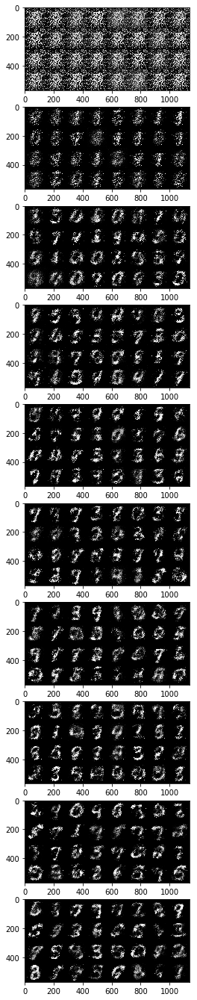

In [53]:
img_prefix = 'gan'
plot_samples(img_prefix)

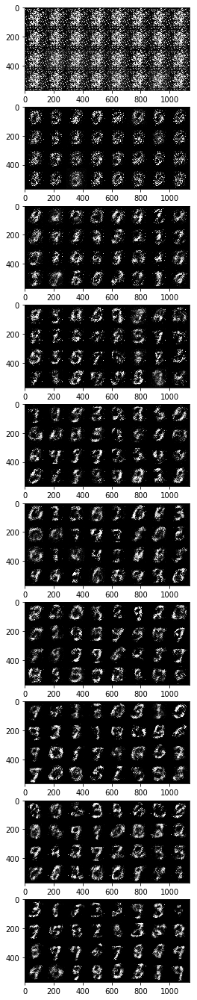

In [54]:
img_prefix = 'deeper_gan'
plot_samples(img_prefix)

not a huge improvment with deeper network